## Bounce-averaged advection and diffusion coefficients for monochromatic electromagnetic ion cyclotron wave: Comparison between test-particle and quasi-linear models

Su, Zhu, Xiao, Zheng, Shen, Wang, Wang  (2012)


In [1]:
import numpy as np
import os
import sys
import inspect
import matplotlib.pyplot as plt


#Define WPIT package location
current_dir =  os.path.abspath(os.path.dirname('__file__'))
fpath = os.path.abspath(current_dir + "/..")
sys.path.append(fpath)


import WPIT.Environment_mod as env
import WPIT.WaveProperties_mod as wave
import WPIT.WPI_mod.parallel_EMIC_mod as wpi


### 1. Define simulation parameters

Here we define all the initial parameters of the simulation in respect with the particle and the wave

In [14]:
L_sim=4  #L-shell of the simulation 
Bw_sim=10*10**(-9)

aeq0_deg=39.3   #initial equatorial pitch angle
aeq0=np.deg2rad(aeq0_deg) #convert pitch angle to rad

Ekev0=2000 #initial energy keV
lamda0_deg=0 # starting electron latitude
lamda0=np.deg2rad(lamda0_deg) #convert latitude to rad

f_wave=1.84 # wave frequency in Hz
w_wave=2*np.pi*f_wave #wave angular frequency

# eta0_deg=np.arange(0,361,30)#initial phases of electrons
eta0_deg=np.linspace(0,360,24)
eta0=np.deg2rad(eta0_deg) #convert initial phases to rad


B0=32200*10**(-9)
slat=np.sin(lamda0)
clat=np.cos(lamda0)
slat_term = np.sqrt(1 + 3*slat*slat)
B_sim=(B0/(L_sim**3))*slat_term/(clat**6)
    
wce_sim=env.omega_cyclotron(B_sim,env.const.qe,env.const.me)
wcHe_sim=env.omega_cyclotron(B_sim,env.const.qe,env.const.mHe)
wcO_sim=env.omega_cyclotron(B_sim,env.const.qe,env.const.mO)
wcH_sim=env.omega_cyclotron(B_sim,env.const.qe,env.const.mH)



slateq=np.sin(lamda0)
clateq=np.cos(lamda0)
slat_termeq = np.sqrt(1 + 3*slateq*slateq)
Beq=(B0/(L_sim**3))*slat_termeq/(clateq**6)

wce_sim_eq=env.omega_cyclotron(Beq,env.const.qe,env.const.me)
wcHe_sim_eq=env.omega_cyclotron(Beq,env.const.qe,env.const.mHe)
wmega_sim=0.96*wcHe_sim_eq

wpe_sim_eq=15*wce_sim_eq

ne_simeq=(wpe_sim_eq*wpe_sim_eq*env.const.me*env.const.epsilon0)/(env.const.qe*env.const.qe)

ne_sim=env.density_FL_denton(ne_simeq,lamda0)
nH_sim=0.77*ne_sim
nHe_sim=0.2*ne_sim
nO_sim=0.03*ne_sim
wpe_sim=env.omega_plasma(ne_sim,env.const.qe,env.const.mH)
wpH_sim=env.omega_plasma(nH_sim,env.const.qe,env.const.mH)
wpHe_sim=env.omega_plasma(nHe_sim,env.const.qe,env.const.mHe)
wpO_sim=env.omega_plasma(nO_sim,env.const.qe,env.const.mO)

alpha0=env.aeq2alpha(L_sim,lamda0,aeq0)
musq0=wave.refr_index_parallel_EMIC(w_wave,wpe_sim,wce_sim,wpH_sim,wcH_sim,wpO_sim,wcO_sim,wpHe_sim,wcHe_sim)
kappa0=np.sqrt(musq0)*w_wave/env.const.c_light
upar0,uper0,ppar0,pper0,gamma0=env.initial_velocity(Ekev0,alpha0,env.const.me)    


dwc_ds0=env.dwc_ds(wce_sim,lamda0,L_sim)
dk_dt=0

H0=wpi.nonlinear_H(pper0,ppar0,kappa0,gamma0,env.const.me,wce_sim,dk_dt,dwc_ds0,0)
thet0,wtsq0=wpi.nonlinear_theta(pper0,ppar0,Bw_sim,kappa0,gamma0,env.const.me,env.const.qe,wce_sim,wmega_sim)
S0=wpi.nonlinear_S(H0,wtsq0)

t=0.07 #simulation duration (s)
h=0.00001  #simulation stepsize
Nsteps=int(t/h) #number of simulation steps



### 2. Allocate outputs

In [15]:
pper=np.zeros((len(eta0),Nsteps+1))
ppar=np.zeros((len(eta0),Nsteps+1))
eta=np.zeros((len(eta0),Nsteps+1))
lamda=np.zeros((len(eta0),Nsteps+1))
time=np.zeros((len(eta0),Nsteps+1))
uper=np.zeros((len(eta0),Nsteps+1))
upar=np.zeros((len(eta0),Nsteps+1))
zeta=np.zeros((len(eta0),Nsteps+1))
alpha=np.zeros((len(eta0),Nsteps+1))
aeq=np.zeros((len(eta0),Nsteps+1))
vresz_o=np.zeros((len(eta0),Nsteps+1))
Eres_o=np.zeros((len(eta0),Nsteps+1))
mu_adiabatic=np.zeros((len(eta0),Nsteps+1))
deta_dt=np.zeros((len(eta0),Nsteps+1))
kappa_out=np.zeros((len(eta0),Nsteps+1))
kx_out=np.zeros((len(eta0),Nsteps+1))
kz_out=np.zeros((len(eta0),Nsteps+1))
gamma=np.zeros((len(eta0),Nsteps+1))
E_kin=np.zeros((len(eta0),Nsteps+1))
ref_sq=np.zeros((len(eta0),Nsteps+1))
u_res_out=np.zeros((len(eta0),Nsteps+1))
H_out=np.zeros((len(eta0),Nsteps+1))
S_out=np.zeros((len(eta0),Nsteps+1))
detadt_out=np.zeros((len(eta0),Nsteps+1))
wtrsq_out=np.zeros((len(eta0),Nsteps+1))
thet_out=np.zeros((len(eta0),Nsteps+1))

In [17]:
detasts_0=[]
for k in range(0,len(eta0)):
    eta0tmp=wpi.detadt(ppar0,pper0,eta0[k],Bw_sim,wmega_sim,kappa0,wce_sim,gamma0,env.const.qe,env.const.me,'electron')
    detasts_0.append(eta0tmp)

In [24]:
for k in range(0,len(eta0)):
    i=0
    time[k,0]=0
    pper[k,0]=pper0
    ppar[k,0]=ppar0
    eta[k,0]=eta0[k]
    lamda[k,0]=lamda0
    zeta[k,0]=0
    upar[k,0]=upar0
    uper[k,0]=uper0
    alpha[k,0]=alpha0
    aeq[k,0]=aeq0
    gamma[k,0]=gamma0
    E_kin[k,0]=1.602176487E-16*Ekev0
    ref_sq[k,0]=musq0
    kappa_out[k,0]=kappa0
    H_out[k,0]=H0
    S_out[k,0]=S0
    detadt_out[k,0]=detasts_0[k]
    wtrsq_out[k,0]=wtsq0
    thet_out[k,0]=thet0
    print(np.rad2deg(eta[k,0]))
##############################################
    while i<Nsteps:
##############################################################################################################        
        #First step of Runge-Kutta
        if lamda[k,i]<np.deg2rad(28) and lamda[k,i]>-np.deg2rad(28):
            Bw_sim=Bw_sim
        else:
            Bw_sim=0

        B0=32200*10**(-9)
        slat=np.sin(lamda[k,i])
        clat=np.cos(lamda[k,i])
        slat_term = np.sqrt(1 + 3*slat*slat)
        Bmagtmp=(B0/(L_sim**3))*slat_term/(clat**6)

        n_etmp=env.density_FL_denton(ne_simeq,lamda[k,i])
        n_Htmp=0.77*n_etmp
        n_Hetmp=0.2*n_etmp
        n_Otmp=0.03*n_etmp

        wcetmp=env.omega_cyclotron(Bmagtmp,env.const.qe,env.const.me)
        wcHtmp=env.omega_cyclotron(Bmagtmp,env.const.qe,env.const.mH)
        wcHetmp=env.omega_cyclotron(Bmagtmp,env.const.qe,env.const.mHe)
        wcOtmp=env.omega_cyclotron(Bmagtmp,env.const.qe,env.const.mO)
        
        wpetmp=env.omega_plasma(n_etmp,env.const.qe,env.const.me)
        wpHtmp=env.omega_plasma(n_Htmp,env.const.qe,env.const.mH)
        wpHetmp=env.omega_plasma(n_Hetmp,env.const.qe,env.const.mHe)
        wpOtmp=env.omega_plasma(n_Otmp,env.const.qe,env.const.mO)

        musqtmp=wave.refr_index_parallel_EMIC(w_wave,wpetmp,wcetmp,wpHtmp,wcHtmp,wpOtmp,wcOtmp,wpHetmp,wcHetmp)
        kappatmp=np.sqrt(musqtmp)*w_wave/env.const.c_light
        

        dwh_dstmp=env.dwc_ds(wcetmp,lamda[k,i],L_sim)
        
        p_mag=np.sqrt(ppar[k,i]*ppar[k,i]+pper[k,i]*pper[k,i])
        
        gammatmp=gamma[k,i]

        k1=wpi.dzdt(ppar[k,i],gammatmp,env.const.me)
        l1=wpi.dppardt(pper[k,i],eta[k,i],wcetmp,Bw_sim,gammatmp,dwh_dstmp,env.const.qe,env.const.me)
        m1=wpi.dpperdt(ppar[k,i],pper[k,i],eta[k,i],Bw_sim,gammatmp,wmega_sim,kappatmp,wcetmp,dwh_dstmp,env.const.qe,env.const.me)
        n1=wpi.detadt(ppar[k,i],pper[k,i],eta[k,i],Bw_sim,w_wave,kappatmp,wcetmp,gammatmp,env.const.qe,env.const.me,'electron')
        o1=wpi.dlamdadt(ppar[k,i],lamda[k,i],gammatmp,env.const.me,L_sim)
        p1=wpi.dalphadt(ppar[k,i],pper[k,i],eta[k,i],gammatmp,wcetmp,dwh_dstmp,w_wave,kappatmp,Bw_sim,env.const.me,env.const.qe)
        q1=wpi.daeqdt(ppar[k,i],pper[k,i],eta[k,i],gammatmp,w_wave,kappatmp,Bw_sim,aeq[k,i],alpha[k,i],env.const.me,env.const.qe)
        r1=wpi.dgammadt(pper[k,i],eta[k,i],gammatmp,Bw_sim,kappatmp,w_wave,env.const.qe,env.const.me)
        s1=wpi.dEkdt(pper[k,i],eta[k,i],gammatmp,Bw_sim,kappatmp,w_wave,env.const.qe,env.const.me)
        

        #Second step of Runge-Kutta
        if (lamda[k,i]+0.5*h*o1)<np.deg2rad(28) and (lamda[k,i]+0.5*h*o1)>-np.deg2rad(28):
            Bw_sim=Bw_sim
        else:
            Bw_sim=0
            
        B0=32200*10**(-9)
        slat=np.sin(lamda[k,i]+0.5*h*o1)
        clat=np.cos(lamda[k,i]+0.5*h*o1)
        slat_term = np.sqrt(1 + 3*slat*slat)
        Bmagtmp=(B0/(L_sim**3))*slat_term/(clat**6)
        
        n_etmp=env.density_FL_denton(ne_simeq,lamda[k,i]+0.5*h*o1)
        n_Htmp=0.77*n_etmp
        n_Hetmp=0.2*n_etmp
        n_Otmp=0.03*n_etmp

        wcetmp=env.omega_cyclotron(Bmagtmp,env.const.qe,env.const.me)
        wcHtmp=env.omega_cyclotron(Bmagtmp,env.const.qe,env.const.mH)
        wcHetmp=env.omega_cyclotron(Bmagtmp,env.const.qe,env.const.mHe)
        wcOtmp=env.omega_cyclotron(Bmagtmp,env.const.qe,env.const.mO)
        
        wpetmp=env.omega_plasma(n_etmp,env.const.qe,env.const.me)
        wpHtmp=env.omega_plasma(n_Htmp,env.const.qe,env.const.mH)
        wpHetmp=env.omega_plasma(n_Hetmp,env.const.qe,env.const.mHe)
        wpOtmp=env.omega_plasma(n_Otmp,env.const.qe,env.const.mO)

        musqtmp=wave.refr_index_parallel_EMIC(w_wave,wpetmp,wcetmp,wpHtmp,wcHtmp,wpOtmp,wcOtmp,wpHetmp,wcHetmp)
        kappatmp=np.sqrt(musqtmp)*w_wave/env.const.c_light
        

        dwh_dstmp=env.dwc_ds(wcetmp,lamda[k,i]+0.5*h*o1,L_sim)
        
        p_mag=np.sqrt((ppar[k,i]+0.5*h*l1)*(ppar[k,i]+0.5*h*l1)+(pper[k,i]+0.5*h*m1)*(pper[k,i]+0.5*h*m1))
        
        gammatmp=gamma[k,i]+0.5*h*r1

        k2=wpi.dzdt(ppar[k,i]+0.5*h*l1,gammatmp,env.const.me)
        l2=wpi.dppardt(pper[k,i]+0.5*h*m1,eta[k,i]+0.5*h*n1,wcetmp,Bw_sim,gammatmp,dwh_dstmp,env.const.qe,env.const.me)
        m2=wpi.dpperdt(ppar[k,i]+0.5*h*l1,pper[k,i]+0.5*h*m1,eta[k,i]+0.5*h*n1,Bw_sim,gammatmp,wmega_sim,kappatmp,wcetmp,dwh_dstmp,env.const.qe,env.const.me)
        n2=wpi.detadt(ppar[k,i]+0.5*h*l1,pper[k,i]+0.5*h*m1,eta[k,i]+0.5*h*n1,Bw_sim,w_wave,kappatmp,wcetmp,gammatmp,env.const.qe,env.const.me,'electron')
        o2=wpi.dlamdadt(ppar[k,i]+0.5*h*l1,lamda[k,i]+0.5*h*o1,gammatmp,env.const.me,L_sim)
        p2=wpi.dalphadt(ppar[k,i]+0.5*h*l1,pper[k,i]+0.5*h*m1,eta[k,i]+0.5*h*n1,gammatmp,wcetmp,dwh_dstmp,w_wave,kappatmp,Bw_sim,env.const.me,env.const.qe)
        q2=wpi.daeqdt(ppar[k,i]+0.5*h*l1,pper[k,i]+0.5*h*m1,eta[k,i]+0.5*h*n1,gammatmp,w_wave,kappatmp,Bw_sim,aeq[k,i]+0.5*h*q1,alpha[k,i]+0.5*h*p1,env.const.me,env.const.qe)
        r2=wpi.dgammadt(pper[k,i]+0.5*h*m1,eta[k,i]+0.5*h*n1,gammatmp,Bw_sim,kappatmp,w_wave,env.const.qe,env.const.me)
        s2=wpi.dEkdt(pper[k,i]+0.5*h*m1,eta[k,i]+0.5*h*n1,gammatmp,Bw_sim,kappatmp,w_wave,env.const.qe,env.const.me)
        
#             ##############################################################################################################        
        #Third step of Runge-Kutta
        if (lamda[k,i]+0.5*h*o2)<np.deg2rad(28) and (lamda[k,i]+0.5*h*o2)>-np.deg2rad(28):
            Bw_sim=Bw_sim
        else:
            Bw_sim=0
            
        B0=32200*10**(-9)
        slat=np.sin(lamda[k,i]+0.5*h*o2)
        clat=np.cos(lamda[k,i]+0.5*h*o2)
        slat_term = np.sqrt(1 + 3*slat*slat)
        Bmagtmp=(B0/(L_sim**3))*slat_term/(clat**6)
        
        n_etmp=env.density_FL_denton(ne_simeq,lamda[k,i]+0.5*h*o2)
        n_Htmp=0.77*n_etmp
        n_Hetmp=0.2*n_etmp
        n_Otmp=0.03*n_etmp
        
        wcetmp=env.omega_cyclotron(Bmagtmp,env.const.qe,env.const.me)
        wcHtmp=env.omega_cyclotron(Bmagtmp,env.const.qe,env.const.mH)
        wcHetmp=env.omega_cyclotron(Bmagtmp,env.const.qe,env.const.mHe)
        wcOtmp=env.omega_cyclotron(Bmagtmp,env.const.qe,env.const.mO)
        
        wpetmp=env.omega_plasma(n_etmp,env.const.qe,env.const.me)
        wpHtmp=env.omega_plasma(n_Htmp,env.const.qe,env.const.mH)
        wpHetmp=env.omega_plasma(n_Hetmp,env.const.qe,env.const.mHe)
        wpOtmp=env.omega_plasma(n_Otmp,env.const.qe,env.const.mO)

        musqtmp=wave.refr_index_parallel_EMIC(w_wave,wpetmp,wcetmp,wpHtmp,wcHtmp,wpOtmp,wcOtmp,wpHetmp,wcHetmp)
        kappatmp=np.sqrt(musqtmp)*w_wave/env.const.c_light
        

        dwh_dstmp=env.dwc_ds(wcetmp,lamda[k,i]+0.5*h*o2,L_sim)
        
        p_mag=np.sqrt((ppar[k,i]+0.5*h*l2)*(ppar[k,i]+0.5*h*l2)+(pper[k,i]+0.5*h*m2)*(pper[k,i]+0.5*h*m2))
        
        gammatmp=gamma[k,i]+0.5*h*r2

        k3=wpi.dzdt(ppar[k,i]+0.5*h*l2,gammatmp,env.const.me)
        l3=wpi.dppardt(pper[k,i]+0.5*h*m2,eta[k,i]+0.5*h*n2,wcetmp,Bw_sim,gammatmp,dwh_dstmp,env.const.qe,env.const.me)
        m3=wpi.dpperdt(ppar[k,i]+0.5*h*l2,pper[k,i]+0.5*h*m2,eta[k,i]+0.5*h*n2,Bw_sim,gammatmp,wmega_sim,kappatmp,wcetmp,dwh_dstmp,env.const.qe,env.const.me)
        n3=wpi.detadt(ppar[k,i]+0.5*h*l2,pper[k,i]+0.5*h*m2,eta[k,i]+0.5*h*n2,Bw_sim,w_wave,kappatmp,wcetmp,gammatmp,env.const.qe,env.const.me,'electron')
        o3=wpi.dlamdadt(ppar[k,i]+0.5*h*l2,lamda[k,i]+0.5*h*o2,gammatmp,env.const.me,L_sim)
        p3=wpi.dalphadt(ppar[k,i]+0.5*h*l2,pper[k,i]+0.5*h*m2,eta[k,i]+0.5*h*n2,gammatmp,wcetmp,dwh_dstmp,w_wave,kappatmp,Bw_sim,env.const.me,env.const.qe)
        q3=wpi.daeqdt(ppar[k,i]+0.5*h*l2,pper[k,i]+0.5*h*m2,eta[k,i]+0.5*h*n2,gammatmp,w_wave,kappatmp,Bw_sim,aeq[k,i]+0.5*h*q2,alpha[k,i]+0.5*h*p2,env.const.me,env.const.qe)
        r3=wpi.dgammadt(pper[k,i]+0.5*h*m2,eta[k,i]+0.5*h*n2,gammatmp,Bw_sim,kappatmp,w_wave,env.const.qe,env.const.me)
        s3=wpi.dEkdt(pper[k,i]+0.5*h*m2,eta[k,i]+0.5*h*n2,gammatmp,Bw_sim,kappatmp,w_wave,env.const.qe,env.const.me)
               
#             ##############################################################################################################        
        #Fourth step of Runge-Kutta
        if (lamda[k,i]+h*o3)<np.deg2rad(28) and (lamda[k,i]+h*o3)>-np.deg2rad(28):
            Bw_sim=Bw_sim
        else:
            Bw_sim=0

        B0=32200*10**(-9)
        slat=np.sin(lamda[k,i]+h*o3)
        clat=np.cos(lamda[k,i]+h*o3)
        slat_term = np.sqrt(1 + 3*slat*slat)
        Bmagtmp=(B0/(L_sim**3))*slat_term/(clat**6)
        
        n_etmp=env.density_FL_denton(ne_simeq,lamda[k,i]+h*o3)
        n_Htmp=0.77*n_etmp
        n_Hetmp=0.2*n_etmp
        n_Otmp=0.03*n_etmp

        wcetmp=env.omega_cyclotron(Bmagtmp,env.const.qe,env.const.me)
        wcHtmp=env.omega_cyclotron(Bmagtmp,env.const.qe,env.const.mH)
        wcHetmp=env.omega_cyclotron(Bmagtmp,env.const.qe,env.const.mHe)
        wcOtmp=env.omega_cyclotron(Bmagtmp,env.const.qe,env.const.mO)
        
        wpetmp=env.omega_plasma(n_etmp,env.const.qe,env.const.me)
        wpHtmp=env.omega_plasma(n_Htmp,env.const.qe,env.const.mH)
        wpHetmp=env.omega_plasma(n_Hetmp,env.const.qe,env.const.mHe)
        wpOtmp=env.omega_plasma(n_Otmp,env.const.qe,env.const.mO)

        musqtmp=wave.refr_index_parallel_EMIC(w_wave,wpetmp,wcetmp,wpHtmp,wcHtmp,wpOtmp,wcOtmp,wpHetmp,wcHetmp)
        kappatmp=np.sqrt(musqtmp)*w_wave/env.const.c_light
        

        dwh_dstmp=env.dwc_ds(wcetmp,lamda[k,i]+h*o3,L_sim)
        
        p_mag=np.sqrt((ppar[k,i]+h*l3)*(ppar[k,i]+h*l3)+(pper[k,i]+h*m3)*(pper[k,i]+h*m3))
        
        gammatmp=gamma[k,i]+h*r3

        k4=wpi.dzdt(ppar[k,i]+h*l3,gammatmp,env.const.me)
        l4=wpi.dppardt(pper[k,i]+h*m3,eta[k,i]+h*n3,wcetmp,Bw_sim,gammatmp,dwh_dstmp,env.const.qe,env.const.me)
        m4=wpi.dpperdt(ppar[k,i]+h*l3,pper[k,i]+h*m3,eta[k,i]+h*n3,Bw_sim,gammatmp,wmega_sim,kappatmp,wcetmp,dwh_dstmp,env.const.qe,env.const.me)
        n4=wpi.detadt(ppar[k,i]+h*l3,pper[k,i]+h*m3,eta[k,i]+h*n3,Bw_sim,w_wave,kappatmp,wcetmp,gammatmp,env.const.qe,env.const.me,'electron')
        o4=wpi.dlamdadt(ppar[k,i]+h*l3,lamda[k,i]+h*o3,gammatmp,env.const.me,L_sim)
        p4=wpi.dalphadt(ppar[k,i]+h*l3,pper[k,i]+h*m3,eta[k,i]+h*n3,gammatmp,wcetmp,dwh_dstmp,w_wave,kappatmp,Bw_sim,env.const.me,env.const.qe)
        q4=wpi.daeqdt(ppar[k,i]+h*l3,pper[k,i]+h*m3,eta[k,i]+h*n3,gammatmp,w_wave,kappatmp,Bw_sim,aeq[k,i]+h*q3,alpha[k,i]+h*p3,env.const.me,env.const.qe)
        r4=wpi.dgammadt(pper[k,i]+h*m3,eta[k,i]+h*n3,gammatmp,Bw_sim,kappatmp,w_wave,env.const.qe,env.const.me)
        s4=wpi.dEkdt(pper[k,i]+h*m3,eta[k,i]+h*n3,gammatmp,Bw_sim,kappatmp,w_wave,env.const.qe,env.const.me)
        
        zeta[k,i+1]=zeta[k,i]+(h/6)*(k1+2*k2+2*k3+k4)
        ppar[k,i+1]=ppar[k,i]+(h/6)*(l1+2*l2+2*l3+l4)
        pper[k,i+1]=pper[k,i]+(h/6)*(m1+2*m2+2*m3+m4)
        eta[k,i+1]=(eta[k,i]+(h/6)*(n1+2*n2+2*n3+n4))
        lamda[k,i+1]=lamda[k,i]+(h/6)*(o1+2*o2+2*o3+o4)
        alpha[k,i+1]=alpha[k,i]+(h/6)*(p1+2*p2+2*p3+p4)
        aeq[k,i+1]=aeq[k,i]+(h/6)*(q1+2*q2+2*q3+q4)
        gamma[k,i+1]=gamma[k,i]+(h/6)*(r1+2*r2+2*r3+r4)
        E_kin[k,i+1]=E_kin[k,i]+(h/6)*(s1+2*s2+2*s3+s4)
        deta_dt[k,i+1]=(1/6)*(n1+2*n2+2*n3+n4)
        
        B0=32200*10**(-9)
        slat=np.sin(lamda[k,i+1])
        clat=np.cos(lamda[k,i+1])
        slat_term = np.sqrt(1 + 3*slat*slat)
        Bmagtmp=(B0/(L_sim**3))*slat_term/(clat**6)
        
        n_etmp=env.density_FL_denton(ne_simeq,lamda[k,i+1])
        n_Htmp=0.77*n_etmp
        n_Hetmp=0.2*n_etmp
        n_Otmp=0.03*n_etmp

        wcetmp=env.omega_cyclotron(Bmagtmp,env.const.qe,env.const.me)
        wcHtmp=env.omega_cyclotron(Bmagtmp,env.const.qe,env.const.mH)
        wcHetmp=env.omega_cyclotron(Bmagtmp,env.const.qe,env.const.mHe)
        wcOtmp=env.omega_cyclotron(Bmagtmp,env.const.qe,env.const.mO)
        
        wpetmp=env.omega_plasma(n_etmp,env.const.qe,env.const.me)
        wpHtmp=env.omega_plasma(n_Htmp,env.const.qe,env.const.mH)
        wpHetmp=env.omega_plasma(n_Hetmp,env.const.qe,env.const.mHe)
        wpOtmp=env.omega_plasma(n_Otmp,env.const.qe,env.const.mO)

        musqtmp=wave.refr_index_parallel_EMIC(w_wave,wpetmp,wcetmp,wpHtmp,wcHtmp,wpOtmp,wcOtmp,wpHetmp,wcHetmp)
        kappatmp=np.sqrt(musqtmp)*w_wave/env.const.c_light
        kappa_out[k,i+1]=kappatmp        

        dwh_dstmp=env.dwc_ds(wcetmp,lamda[k,i+1],L_sim)
        
        ref_sq[k,i+1]=musqtmp

        upar[k,i+1]=ppar[k,i+1]/(env.const.me*gammatmp)
        uper[k,i+1]=pper[k,i+1]/(env.const.me*gammatmp)
        u_mag=np.sqrt(upar[k,i+1]**2+uper[k,i+1]**2)
        pmagnitude=np.sqrt(ppar[k,i+1]**2+pper[k,i+1]**2)


        
        dkpardt_run=(kappa_out[k,i]-kappa_out[k,i-1])/h
        #####################################
        Htmp=wpi.nonlinear_H(pper[k,i+1],ppar[k,i+1],kappatmp,gammatmp,env.const.me,wcetmp,dkpardt_run,dwh_dstmp,0)
        thetatmp,wtsqtmp=wpi.nonlinear_theta(pper[k,i+1],ppar[k,i+1],Bw_sim,kappatmp,gammatmp,env.const.me,env.const.qe,wcetmp,wmega_sim)
        Stmp=wpi.nonlinear_S(Htmp,wtsqtmp)
        H_out[k,i+1]=Htmp
        S_out[k,i+1]=Stmp
        wtrsq_out[k,i+1]=wtsqtmp
        thet_out[k,i+1]=thetatmp


        i=i+1
        time[k,i]=time[k,i-1]+h
        print(time[k,i])



0.0
wt2 7488127.5464975415
moms 8.320438053865839e-22 1.0168225188074826e-21
B k g 1e-08 0.00011254675398154517 4.913819458037203
ws 88490.6388263861 11.566592145387421
wt2 7484632.274112568
moms 8.316566453924347e-22 1.0171393437153189e-21
B k g 1e-08 0.00011254660744260322 4.913819855668332
ws 88490.64829873238 11.566592145387421
wt2 7478820.106774854
moms 8.310128527943962e-22 1.0176656342383086e-21
B k g 1e-08 0.0001125463630772526 4.913820516138329
ws 88490.66409470755 11.566592145387421
wt2 7470711.146601143
moms 8.30114657849715e-22 1.0183987598288314e-21
B k g 1e-08 0.00011254602068581294 4.913821436147951
ws 88490.68622734508 11.566592145387421
wt2 7460333.87836973
moms 8.289652209252368e-22 1.0193350299083133e-21
B k g 1e-08 0.00011254557999072332 4.913822611068568
ws 88490.7147147637 11.566592145387421
wt2 7447725.504289458
moms 8.275686697228573e-22 1.0204696867862153e-21
B k g 1e-08 0.00011254504063854257 4.913824034933239
ws 88490.74958003896 11.566592145387421
wt2 743293

B k g 1e-08 0.0001102923797729261 4.913861336421294
ws 88640.94240347383 11.566592145387421
wt2 6999282.980918258
moms 7.937839547447044e-22 1.0469766172601365e-21
B k g 1e-08 0.00011027166597426891 4.913857742468029
ws 88642.3670953247 11.566592145387421
wt2 7030246.644946528
moms 7.974443799995591e-22 1.044190046088201e-21
B k g 1e-08 0.00011025092196852131 4.913854180059979
ws 88643.79468414866 11.566592145387421
wt2 7060491.606558063
moms 8.010248700008698e-22 1.0414446577157283e-21
B k g 1e-08 0.00011023014793282203 4.913850669824302
ws 88645.2251619557 11.566592145387421
wt2 7089856.181343561
moms 8.045070438128985e-22 1.0387558483777206e-21
B k g 1e-08 0.00011020934371412476 4.913847231503562
ws 88646.65854349482 11.566592145387421
wt2 7118191.58118525
moms 8.078739723791087e-22 1.03613825621156e-21
B k g 1e-08 0.0001101885088376571 4.913843883879789
ws 88648.09486573632 11.566592145387421
wt2 7145361.739216924
moms 8.111101598989972e-22 1.0336057151669778e-21
B k g 1e-08 0.0001

B k g 1e-08 0.00010449575340760935 4.913801379544261
ws 89073.94850510253 11.566592145387421
wt2 7074608.733907274
moms 8.469241361997127e-22 1.0044560584825867e-21
B k g 1e-08 0.00010446260311220765 4.913802461421262
ws 89076.63797708983 11.566592145387421
wt2 7063131.5924107535
moms 8.458196120437707e-22 1.0053867828874306e-21
B k g 1e-08 0.00010442937997878845 4.913803734363961
ws 89079.33597661473 11.566592145387421
wt2 7050253.935115034
moms 8.445473072989207e-22 1.0064563162051616e-21
B k g 1e-08 0.00010439607942584552 4.91380519542873
ws 89082.04289692192 11.566592145387421
wt2 7035991.913176955
moms 8.4310902862471975e-22 1.0076620680486434e-21
B k g 1e-08 0.00010436269692843335 4.913806841226416
ws 89084.7591281969 11.566592145387421
wt2 7020363.871836503
moms 8.415068462021433e-22 1.0090011123928324e-21
B k g 1e-08 0.00010432922802987402 4.913808667910975
ws 89087.48505660336 11.566592145387421
wt2 7003390.550477908
moms 8.3974311799979115e-22 1.0104701785555885e-21
B k g 1e-

ws 89800.36182860777 11.566592145387421
wt2 6369180.161809581
moms 8.252030971929719e-22 1.022384610117733e-21
B k g 1e-08 9.652280747985105e-05 4.913826975232137
ws 89804.4815931966 11.566592145387421
wt2 6392137.551546836
moms 8.285177399902672e-22 1.0196989417786947e-21
B k g 1e-08 9.64830159101765e-05 4.913823067890821
ws 89808.59699949638 11.566592145387421
wt2 6414575.293288403
moms 8.317669559763325e-22 1.0170489074965391e-21
B k g 1e-08 9.644331568419796e-05 4.913819211316313
ws 89812.70813448745 11.566592145387421
wt2 6436477.748870108
moms 8.349486388440891e-22 1.0144371502646752e-21
B k g 1e-08 9.640370558545304e-05 4.913815409422052
ws 89816.81509731397 11.566592145387421
wt2 6457831.747864117
moms 8.380610004144556e-22 1.011866085857369e-21
B k g 1e-08 9.636418429454166e-05 4.9138116657930535
ws 89820.91799842755 11.566592145387421
wt2 6478626.405597133
moms 8.411025476118224e-22 1.0093379119155747e-21
B k g 1e-08 9.632475039774257e-05 4.91380798369868
ws 89825.0169587573 

B k g 1e-08 8.844545804174197e-05 4.913941413400161
ws 90759.69723582457 11.566592145387421
wt2 5191381.895833731
moms 7.344208677448204e-22 1.089466572908967e-21
B k g 1e-08 8.84025415656388e-05 4.913937407507521
ws 90765.49644048861 11.566592145387421
wt2 5215596.993183497
moms 7.382028099588481e-22 1.0869061848237804e-21
B k g 1e-08 8.835973300993099e-05 4.913933342142061
ws 90771.28964505244 11.566592145387421
wt2 5239939.287378817
moms 7.420054838921134e-22 1.0843123551182999e-21
B k g 1e-08 8.831703377134775e-05 4.913929221647529
ws 90777.07661202233 11.566592145387421
wt2 5264377.0269620605
moms 7.458243972105258e-22 1.0816877234673803e-21
B k g 1e-08 8.827444513831483e-05 4.913925050200456
ws 90782.85711744682 11.566592145387421
wt2 5288880.5314698275
moms 7.496553429783348e-22 1.0790348168049825e-21
B k g 1e-08 8.823196829539944e-05 4.913920831803005
ws 90788.63095042299 11.566592145387421
wt2 5313422.169102145
moms 7.534943972103662e-22 1.0763560458510361e-21
B k g 1e-08 8.81

B k g 1e-08 8.170397908739078e-05 4.91372360726068
ws 91788.1320372725 11.566592145387421
wt2 5949280.019669506
moms 9.109588798192905e-22 9.46737128486678e-22
B k g 1e-08 8.166862800724844e-05 4.91372719157964
ws 91794.21839957652 11.566592145387421
wt2 5933127.14513227
moms 9.088809432336918e-22 9.487335088295157e-22
B k g 1e-08 8.163321474195562e-05 4.913730694364886
ws 91800.32354247582 11.566592145387421
wt2 5917247.9847363625
moms 9.068437838851097e-22 9.506822289633685e-22
B k g 1e-08 8.159774118706069e-05 4.913734116028752
ws 91806.44719529166 11.566592145387421
wt2 5901644.208537777
moms 9.04847686203274e-22 9.525835729892132e-22
B k g 1e-08 8.156220922533518e-05 4.9137374569996455
ws 91812.58908806661 11.566592145387421
wt2 5886317.347949462
moms 9.028929143507335e-22 9.544378319425048e-22
B k g 1e-08 8.152662072646741e-05 4.913740717718303
ws 91818.74895161844 11.566592145387421
wt2 5871268.808458258
moms 9.009797141219577e-22 9.562453017519832e-22
B k g 1e-08 8.149097754683

ws 93097.28008055028 11.566592145387421
wt2 5568484.2278419165
moms 9.284868222390021e-22 9.295477726267503e-22
B k g 1e-08 7.49977713367937e-05 4.9137129678255045
ws 93104.38123289892 11.566592145387421
wt2 5555143.938855862
moms 9.266573297574098e-22 9.313729667574535e-22
B k g 1e-08 7.496592062539375e-05 4.913716471643918
ws 93111.50242937336 11.566592145387421
wt2 5542402.592287964
moms 9.249267081869332e-22 9.330929318021054e-22
B k g 1e-08 7.493402502583244e-05 4.913719778490333
ws 93118.64290487742 11.566592145387421
wt2 5530275.228236512
moms 9.232975457423913e-22 9.347062401091787e-22
B k g 1e-08 7.490208825535316e-05 4.9137228855226525
ws 93125.8018804675 11.566592145387421
wt2 5518775.989252144
moms 9.217722853591667e-22 9.362115664351898e-22
B k g 1e-08 7.48701140711504e-05 4.913725790088069
ws 93132.97856410698 11.566592145387421
wt2 5507918.123964314
moms 9.20353224989004e-22 9.37607681316759e-22
B k g 1e-08 7.483810626683235e-05 4.913728489710891
ws 93140.17215137224 11.

B k g 1e-08 6.909268799420152e-05 4.9134980064402844
ws 94600.42809720698 11.566592145387421
wt2 5696685.5122606475
moms 1.031330705724763e-21 8.138487380357406e-22
B k g 1e-08 6.906758462453704e-05 4.913502887212235
ws 94607.62930994535 11.566592145387421
wt2 5683638.592093576
moms 1.029345939981188e-21 8.16359950487881e-22
B k g 1e-08 6.904241854552257e-05 4.913508124070143
ws 94614.856483498 11.566592145387421
wt2 5669830.13478755
moms 1.0272228935405524e-21 8.190322598242847e-22
B k g 1e-08 6.901718470371382e-05 4.913513692025503
ws 94622.11114276896 11.566592145387421
wt2 5655306.184105349
moms 1.0249698096382251e-21 8.218527308760288e-22
B k g 1e-08 6.899187844573995e-05 4.91351956483008
ws 94629.3947042611 11.566592145387421
wt2 5640115.541611536
moms 1.0225954356676084e-21 8.248079210677508e-22
B k g 1e-08 6.896649553454267e-05 4.913525715171239
ws 94636.70847082144 11.566592145387421
wt2 5624309.562686188
moms 1.0201089871143526e-21 8.278839766234417e-22
B k g 1e-08 6.89410321

B k g 1e-08 6.390622591266971e-05 4.913645390363254
ws 96275.1118216231 11.566592145387421
wt2 5008062.038270629
moms 9.803190436868453e-22 8.746866141499178e-22
B k g 1e-08 6.388201173458655e-05 4.913651956768665
ws 96283.90633947916 11.566592145387421
wt2 4993504.791772614
moms 9.778436221567317e-22 8.774557091561095e-22
B k g 1e-08 6.385773182547283e-05 4.913658189672862
ws 96292.734820188 11.566592145387421
wt2 4979641.89447031
moms 9.755031157904398e-22 8.800594558127882e-22
B k g 1e-08 6.383339069863349e-05 4.913664058751347
ws 96301.59571697639 11.566592145387421
wt2 4966543.22215692
moms 9.733112828169117e-22 8.82485205376674e-22
B k g 1e-08 6.380899322136318e-05 4.91366953577956
ws 96310.48734690134 11.566592145387421
wt2 4954274.454696666
moms 9.712810773511305e-22 8.847212947798974e-22
B k g 1e-08 6.378454458692281e-05 4.913674594683648
ws 96319.4079002637 11.566592145387421
wt2 4942896.675483942
moms 9.694245697292787e-22 8.867570635993448e-22
B k g 1e-08 6.376005028607183e

B k g 1e-08 5.9403188960198996e-05 4.913499130402711
ws 98100.54266050509 11.566592145387421
wt2 4960172.358585642
moms 1.0444348528240772e-21 7.969595523164344e-22
B k g 1e-08 5.9383309093323314e-05 4.913497291174232
ws 98109.5322210183 11.566592145387421
wt2 4960324.686258724
moms 1.0448157945307144e-21 7.964595927247903e-22
B k g 1e-08 5.936345571881238e-05 4.9134962515993745
ws 98118.51877649546 11.566592145387421
wt2 4959243.150785285
moms 1.0449370373562094e-21 7.963004126325761e-22
B k g 1e-08 5.9343620371911805e-05 4.913496022560292
ws 98127.50613984106 11.566592145387421
wt2 4956925.113347759
moms 1.0447979157614558e-21 7.964832095124776e-22
B k g 1e-08 5.9323794535080396e-05 4.913496607371779
ws 98136.4981632 11.566592145387421
wt2 4953377.041185339
moms 1.0443996792975543e-21 7.970059723194369e-22
B k g 1e-08 5.930396971770608e-05 4.9134980017131324
ws 98145.49870189065 11.566592145387421
wt2 4948614.49945967
moms 1.0437454923534315e-21 7.978634997884822e-22
B k g 1e-08 5.92

B k g 1e-08 5.568005480213761e-05 4.913567125663993
ws 99954.42919746245 11.566592145387421
wt2 4597021.993787456
moms 1.0327148604963099e-21 8.121166482566258e-22
B k g 1e-08 5.566163050956594e-05 4.913558308203251
ws 99964.52792425528 11.566592145387421
wt2 4607396.474842202
moms 1.0353829856021222e-21 8.0870840789522685e-22
B k g 1e-08 5.5643294014936816e-05 4.913549829044923
ws 99974.58834530126 11.566592145387421
wt2 4617102.274852628
moms 1.037901147376455e-21 8.054703731162671e-22
B k g 1e-08 5.562504175548165e-05 4.913541780058336
ws 99984.61228961768 11.566592145387421
wt2 4626032.424441752
moms 1.0402452543293683e-21 8.024372889076918e-22
B k g 1e-08 5.560686937454515e-05 4.9135342497021375
ws 99994.60203075694 11.566592145387421
wt2 4634088.17509464
moms 1.0423930474828958e-21 7.9964207382042395e-22
B k g 1e-08 5.558877175959549e-05 4.9135273218716335
ws 100004.56026792372 11.566592145387421
wt2 4641179.80662898
moms 1.0443242838103483e-21 7.971153749087141e-22
B k g 1e-08 5

wt2 4281049.634097482
moms 1.0276222450083159e-21 8.185749089983144e-22
B k g 1e-08 5.20937859163568e-05 4.91361140368975
ws 102122.64593758488 11.566592145387421
wt2 4268097.927604118
moms 1.0248478646206997e-21 8.220500367008586e-22
B k g 1e-08 5.2076984515073274e-05 4.9136210157286815
ws 102133.84499493567 11.566592145387421
wt2 4255536.13756613
moms 1.022166379066421e-21 8.253860158885001e-22
B k g 1e-08 5.206012151516371e-05 4.913630252493633
ws 102145.09572058746 11.566592145387421
wt2 4243516.479330138
moms 1.019614331161457e-21 8.28540409993093e-22
B k g 1e-08 5.204320029634186e-05 4.913638998675135
ws 102156.39598574706 11.566592145387421
wt2 4232185.384041448
moms 1.0172269099405335e-21 8.314733810762726e-22
B k g 1e-08 5.202622507361187e-05 4.913647145914803
ws 102167.74309512285 11.566592145387421
wt2 4221681.287063276
moms 1.0150374186078307e-21 8.341481105620318e-22
B k g 1e-08 5.2009200837678285e-05 4.913654593955075
ws 102179.13382405133 11.566592145387421
wt2 4212132.4

B k g 1e-08 4.897247716285051e-05 4.913510828154429
ws 104398.44099985358 11.566592145387421
wt2 4167886.9302840712
moms 1.0644942788712286e-21 7.699697616095277e-22
B k g 1e-08 4.895811288849838e-05 4.913514769928476
ws 104409.89297340084 11.566592145387421
wt2 4161781.9663900607
moms 1.0632497257720158e-21 7.716899205412207e-22
B k g 1e-08 4.894372681787862e-05 4.913519965725041
ws 104421.37201638507 11.566592145387421
wt2 4154507.29070972
moms 1.0617066553682492e-21 7.738145492089712e-22
B k g 1e-08 4.892931115272128e-05 4.913526329558872
ws 104432.88441360525 11.566592145387421
wt2 4146153.8531281515
moms 1.0598881553900228e-21 7.763069765348793e-22
B k g 1e-08 4.8914858730855345e-05 4.913533756138272
ws 104444.43596256507 11.566592145387421
wt2 4136829.2253357074
moms 1.0578215651009316e-21 7.791245694681194e-22
B k g 1e-08 4.890036314270509e-05 4.91354212288091
ws 104456.03187825138 11.566592145387421
wt2 4126656.466967539
moms 1.0555381907489203e-21 7.822195404102852e-22
B k g 1

moms 1.0643746712620303e-21 7.701563432151955e-22
B k g 1e-08 4.617945485924083e-05 4.913559411306132
ws 106820.2329938591 11.566592145387421
wt2 3920331.784712583
moms 1.0618427616926948e-21 7.736486322786364e-22
B k g 1e-08 4.616624063703357e-05 4.9135703531539425
ws 106832.69040696377 11.566592145387421
wt2 3909415.2823561816
moms 1.059195308292549e-21 7.77274649047645e-22
B k g 1e-08 4.61529709929165e-05 4.913581705861173
ws 106845.21022830778 11.566592145387421
wt2 3898256.514827094
moms 1.0564820376633797e-21 7.809639897080273e-22
B k g 1e-08 4.613964431447167e-05 4.913593254195271
ws 106857.79411904614 11.566592145387421
wt2 3887046.7622875553
moms 1.0537546517294715e-21 7.846455474440846e-22
B k g 1e-08 4.6126260203268354e-05 4.913604780615124
ws 106870.44259840986 11.566592145387421
wt2 3875981.010957912
moms 1.051065892296768e-21 7.882488624446236e-22
B k g 1e-08 4.611281947270531e-05 4.913616069400362
ws 106883.15504108276 11.566592145387421
wt2 3865254.208226007
moms 1.0484

moms 1.0495842818392936e-21 7.902483971375586e-22
B k g 1e-08 4.374541525549545e-05 4.913675947659743
ws 109296.28012908019 11.566592145387421
wt2 3672517.3131879726
moms 1.0501120829469136e-21 7.895459780857001e-22
B k g 1e-08 4.373291331529118e-05 4.913673961003004
ws 109310.00073167146 11.566592145387421
wt2 3674733.595510063
moms 1.051044175040234e-21 7.883030157840685e-22
B k g 1e-08 4.372043189610123e-05 4.9136702286900436
ws 109323.70970354945 11.566592145387421
wt2 3678293.7864390654
moms 1.0523598800181772e-21 7.865432126203745e-22
B k g 1e-08 4.3707979344716536e-05 4.913664826538654
ws 109337.39782310562 11.566592145387421
wt2 3683093.36790227
moms 1.0540294653619316e-21 7.843011700132131e-22
B k g 1e-08 4.369556353326644e-05 4.913657865638475
ws 109351.05636205003 11.566592145387421
wt2 3688999.191101819
moms 1.056014995019241e-21 7.816217941121624e-22
B k g 1e-08 4.36831916926012e-05 4.913649490465764
ws 109364.67727110296 11.566592145387421
wt2 3695853.2430953127
moms 1.05

wt2 3651396.8050153307
moms 1.096728861884903e-21 7.23315091097377e-22
B k g 1e-08 4.1630459646501206e-05 4.913511234172537
ws 111781.6412990538 11.566592145387421
wt2 3651539.0874283724
moms 1.0970521346439244e-21 7.228240161888001e-22
B k g 1e-08 4.161979150696688e-05 4.913509909394394
ws 111795.06381742009 11.566592145387421
wt2 3650322.3998657553
moms 1.0969679526134303e-21 7.229521581677365e-22
B k g 1e-08 4.160912986441327e-05 4.913510685611378
ws 111808.4875615612 11.566592145387421
wt2 3647758.228492734
moms 1.096479685789096e-21 7.236939308292602e-22
B k g 1e-08 4.1598465611177764e-05 4.913513544630781
ws 111821.92400160943 11.566592145387421
wt2 3643888.414526405
moms 1.095599802136056e-21 7.250277576616882e-22
B k g 1e-08 4.158778985315158e-05 4.91351841396567
ws 111835.384370517 11.566592145387421
wt2 3638784.594085715
moms 1.0943497051467234e-21 7.2691667356764485e-22
B k g 1e-08 4.157709414102388e-05 4.9135251688315975
ws 111848.87937136435 11.566592145387421
wt2 3632547.

ws 114486.93574192449 11.566592145387421
wt2 3510785.021463017
moms 1.108281147649873e-21 7.054873451324137e-22
B k g 1e-08 3.961009439852679e-05 4.913512020026483
ws 114500.93639614522 11.566592145387421
wt2 3511140.2074573026
moms 1.108664413097236e-21 7.0488397368087115e-22
B k g 1e-08 3.960037863543313e-05 4.9135102510413535
ws 114514.92314639736 11.566592145387421
wt2 3510151.916104364
moms 1.1086244292965144e-21 7.049471722958531e-22
B k g 1e-08 3.9590669824516415e-05 4.913510859037479
ws 114528.9090805546 11.566592145387421
wt2 3507829.155967682
moms 1.1081639791018147e-21 7.056723117405586e-22
B k g 1e-08 3.9580958797341954e-05 4.913513828293818
ws 114542.90740676003 11.566592145387421
wt2 3504215.1592639703
moms 1.1072966223806e-21 7.070352539332189e-22
B k g 1e-08 3.957123659603225e-05 4.913519073477433
ws 114556.9310641097 11.566592145387421
wt2 3499386.7120074127
moms 1.1060464908849644e-21 7.089931040923055e-22
B k g 1e-08 3.956149473678009e-05 4.913526442271656
ws 114570.

wt2 3378575.381414673
moms 1.1144917767091689e-21 6.956503963024515e-22
B k g 1e-08 3.790649309768609e-05 4.913541869041558
ws 117100.86449531578 11.566592145387421
wt2 3383437.465262281
moms 1.1163563595416113e-21 6.926485235710532e-22
B k g 1e-08 3.7897473949214625e-05 4.913531103513674
ws 117115.45630024615 11.566592145387421
wt2 3387277.3343270198
moms 1.1178842217954713e-21 6.901752773129417e-22
B k g 1e-08 3.7888493247373515e-05 4.9135223071702745
ws 117129.99498238582 11.566592145387421
wt2 3389965.8476043427
moms 1.1190328468070302e-21 6.8830788003500575e-22
B k g 1e-08 3.7879543576677466e-05 4.9135157684375965
ws 117144.49244815682 11.566592145387421
wt2 3391408.4569332674
moms 1.1197710939009484e-21 6.871040415255626e-22
B k g 1e-08 3.787061665300843e-05 4.913511703149145
ws 117158.96204246725 11.566592145387421
wt2 3391547.0642408417
moms 1.1200798122938122e-21 6.8659989095276275e-22
B k g 1e-08 3.786170359214431e-05 4.913510246779021
ws 117173.41811723796 11.566592145387421

B k g 1e-08 3.642575636820291e-05 4.913609705260199
ws 119624.08109940503 11.566592145387421
wt2 3254579.8467997094
moms 1.117517799617886e-21 6.908066508242974e-22
B k g 1e-08 3.64172054578324e-05 4.91359431908848
ws 119639.42936156174 11.566592145387421
wt2 3261176.811462526
moms 1.1200372959385665e-21 6.8670589466102485e-22
B k g 1e-08 3.640870769798619e-05 4.913578865933838
ws 119654.69144326517 11.566592145387421
wt2 3267497.2966666245
moms 1.1224615629516651e-21 6.827280476369491e-22
B k g 1e-08 3.640026238937755e-05 4.913563888817438
ws 119669.86843567809 11.566592145387421
wt2 3273306.872100536
moms 1.1247102933903143e-21 6.790096151744475e-22
B k g 1e-08 3.6391867125068246e-05 4.913549917463314
ws 119684.96450534655 11.566592145387421
wt2 3278392.4250301407
moms 1.1267104729522215e-21 6.7567867180117045e-22
B k g 1e-08 3.638351786650369e-05 4.913537449148297
ws 119699.98676641079 11.566592145387421
wt2 3282568.28507501
moms 1.1283984815909694e-21 6.728501385846514e-22
B k g 1e

ws 122798.43205314968 11.566592145387421
wt2 3179008.1128207888
moms 1.1438230274938459e-21 6.462732231092856e-22
B k g 1e-08 3.475238025143952e-05 4.91351297300098
ws 122813.64324271047 11.566592145387421
wt2 3176198.739803003
moms 1.1430626484886994e-21 6.476205425174772e-22
B k g 1e-08 3.474485064265878e-05 4.9135189628630505
ws 122828.88136773722 11.566592145387421
wt2 3172245.3726671804
moms 1.141892088372425e-21 6.496872916086123e-22
B k g 1e-08 3.473730310033091e-05 4.913527877020197
ws 122844.16414376229 11.566592145387421
wt2 3167272.7733058603
moms 1.140356081728652e-21 6.52386038145835e-22
B k g 1e-08 3.4729729757337e-05 4.913539360759196
ws 122859.50757888996 11.566592145387421
wt2 3161444.553984624
moms 1.138513303753068e-21 6.556042711875038e-22
B k g 1e-08 3.472212392108741e-05 4.913552957236011
ws 122874.92533507325 11.566592145387421
wt2 3154958.713394538
moms 1.136434779637343e-21 6.592090837491759e-22
B k g 1e-08 3.4714480337110304e-05 4.913568126449504
ws 122890.428

ws 126127.41764020847 11.566592145387421
wt2 3065138.5751667786
moms 1.154488608326199e-21 6.270377622430723e-22
B k g 1e-08 3.319839260457556e-05 4.913540352105666
ws 126143.13165248603 11.566592145387421
wt2 3068867.8906981135
moms 1.156127540336352e-21 6.240034940111239e-22
B k g 1e-08 3.319149848373082e-05 4.913528011496662
ws 126158.76704553206 11.566592145387421
wt2 3071616.3792977673
moms 1.1573978027764316e-21 6.2163865063942545e-22
B k g 1e-08 3.3184635863934734e-05 4.913518519101324
ws 126174.33892768277 11.566592145387421
wt2 3073256.2495162166
moms 1.158251487518895e-21 6.200429119471386e-22
B k g 1e-08 3.317779677469846e-05 4.913512299692104
ws 126189.86529414642 11.566592145387421
wt2 3073705.0459423503
moms 1.1586577006356554e-21 6.192819178954142e-22
B k g 1e-08 3.3170972339684066e-05 4.913509633327974
ws 126205.36623510395 11.566592145387421
wt2 3072927.827693073
moms 1.1586033790484926e-21 6.193841342375304e-22
B k g 1e-08 3.3164153171132336e-05 4.913510641923468
ws 1

wt2 2981472.0029270835
moms 1.1645959000480297e-21 6.080703128603745e-22
B k g 1e-08 3.2012173334812586e-05 4.913557811245996
ws 128955.0205429955 11.566592145387421
wt2 2985800.617172954
moms 1.1665128303441257e-21 6.043752361632628e-22
B k g 1e-08 3.2005763464835733e-05 4.913542122557338
ws 128970.90278471478 11.566592145387421
wt2 2989370.4567867694
moms 1.1681337793575876e-21 6.012282003739309e-22
B k g 1e-08 3.199939131324956e-05 4.913528852365056
ws 128986.69915485002 11.566592145387421
wt2 2992005.18725397
moms 1.169390202137294e-21 5.987745314689114e-22
B k g 1e-08 3.199305027302607e-05 4.913518642432375
ws 129002.42591359685 11.566592145387421
wt2 2993572.0159376576
moms 1.1702305038907255e-21 5.971265093557054e-22
B k g 1e-08 3.198673237701718e-05 4.913511988894243
ws 129018.10272860607 11.566592145387421
wt2 2993985.796413779
moms 1.1706216331357863e-21 5.963576562834802e-22
B k g 1e-08 3.19804286800099e-05 4.913509216959166
ws 129033.75173400211 11.566592145387421
wt2 29932

wt2 2886494.282645935
moms 1.1636199581544481e-21 6.100008585198129e-22
B k g 1e-08 3.101975449771982e-05 4.913666058934755
ws 131507.80579526554 11.566592145387421
wt2 2883928.4674077607
moms 1.1628230913668038e-21 6.115230680383275e-22
B k g 1e-08 3.101351488862395e-05 4.913673619909346
ws 131524.47056138582 11.566592145387421
wt2 2882534.983301206
moms 1.1624971083551143e-21 6.121446080013656e-22
B k g 1e-08 3.100726563811779e-05 4.913677079779181
ws 131541.1690031543 11.566592145387421
wt2 2882369.219116235
moms 1.162664202902248e-21 6.118266958921146e-22
B k g 1e-08 3.1001016180314064e-05 4.9136762612329585
ws 131557.87593500313 11.566592145387421
wt2 2883417.816275394
moms 1.1633189419799983e-21 6.105778335065129e-22
B k g 1e-08 3.0994776096267664e-05 4.913671202280824
ws 131574.5657303581 11.566592145387421
wt2 2885599.571038222
moms 1.1644286181212486e-21 6.084534631296742e-22
B k g 1e-08 3.0988554631438435e-05 4.913662154814918
ws 131591.21361224595 11.566592145387421
wt2 2888

ws 134553.1982972316 11.566592145387421
wt2 2821451.112498898
moms 1.1791815654404801e-21 5.793396906241322e-22
B k g 1e-08 2.9920478878823143e-05 4.91365403973847
ws 134569.70292808444 11.566592145387421
wt2 2818065.4034035234
moms 1.1779971684252312e-21 5.817518123916359e-22
B k g 1e-08 2.9914768580116006e-05 4.913666112689893
ws 134586.29103492 11.566592145387421
wt2 2815681.2256029933
moms 1.1772298347236829e-21 5.833080773475311e-22
B k g 1e-08 2.990903980481916e-05 4.913674144994873
ws 134602.94013569513 11.566592145387421
wt2 2814420.29818316
moms 1.1769301485869887e-21 5.839147471392647e-22
B k g 1e-08 2.9903301473856324e-05 4.913677693546199
ws 134619.62436164415 11.566592145387421
wt2 2814336.7537023886
moms 1.1771205534063945e-21 5.835301077503273e-22
B k g 1e-08 2.9897563169330646e-05 4.913676560765748
ws 134636.31587473006 11.566592145387421
wt2 2815413.080251225
moms 1.177793650273696e-21 5.821667191074471e-22
B k g 1e-08 2.989183460964577e-05 4.9136708053611375
ws 134652

ws 137763.23012529564 11.566592145387421
wt2 2785941.6616518935
moms 1.2070482702155456e-21 5.186820120912538e-22
B k g 1e-08 2.8860127578714172e-05 4.913507948722888
ws 137778.743593772 11.566592145387421
wt2 2784750.5117340647
moms 1.2067401660029655e-21 5.194014601394075e-22
B k g 1e-08 2.8855204207770062e-05 4.913512255890303
ws 137794.26624966343 11.566592145387421
wt2 2782560.591056985
moms 1.2060019252245356e-21 5.211197508678114e-22
B k g 1e-08 2.885027003307543e-05 4.913521450951158
ws 137809.82891999162 11.566592145387421
wt2 2779474.4508941467
moms 1.2048778719738855e-21 5.237228863452556e-22
B k g 1e-08 2.8845316087405384e-05 4.91353497629413
ws 137825.45994584268 11.566592145387421
wt2 2775645.943047556
moms 1.2034344128673941e-21 5.270431164049026e-22
B k g 1e-08 2.884033475169826e-05 4.9135520110366215
ws 137841.18345581013 11.566592145387421
wt2 2771274.0379706565
moms 1.2017573844418755e-21 5.30869403868988e-22
B k g 1e-08 2.8835320216085145e-05 4.913571522154053
ws 13

wt2 2695447.16173864
moms 1.205769126874969e-21 5.217629189486066e-22
B k g 1e-08 2.795414816211223e-05 4.913670490243791
ws 140737.64358521107 11.566592145387421
wt2 2693805.0372620006
moms 1.2052452747416843e-21 5.229767208230328e-22
B k g 1e-08 2.7949339424253318e-05 4.913677420734566
ws 140753.91284357803 11.566592145387421
wt2 2693205.735893499
moms 1.205185465748515e-21 5.231155950687012e-22
B k g 1e-08 2.7944525189194528e-05 4.913678919575179
ws 140770.20682156496 11.566592145387421
wt2 2693669.664940158
moms 1.2055985944598192e-21 5.22159952518761e-22
B k g 1e-08 2.7939715487804567e-05 4.913674887477051
ws 140786.49157358747 11.566592145387421
wt2 2695141.725010178
moms 1.2064599344587797e-21 5.201601658306052e-22
B k g 1e-08 2.7934920202412567e-05 4.913665578733825
ws 140802.7336062595 11.566592145387421
wt2 2697496.1308741886
moms 1.2077132875987888e-21 5.172335404539402e-22
B k g 1e-08 2.7930148434532923e-05 4.9136515860559244
ws 140818.90202230212 11.566592145387421
wt2 270

ws 143791.64190333794 11.566592145387421
wt2 2640494.6078431797
moms 1.2194351159688493e-21 4.889734763228062e-22
B k g 1e-08 2.70773710109763e-05 4.9136722344514085
ws 143807.51196687363 11.566592145387421
wt2 2642191.8930393076
moms 1.2204097085430625e-21 4.865269682707678e-22
B k g 1e-08 2.7073007651079968e-05 4.913660333449088
ws 143823.32266298516 11.566592145387421
wt2 2644646.930852068
moms 1.2217311439832288e-21 4.831865323639124e-22
B k g 1e-08 2.706867090800218e-05 4.913643771707815
ws 143839.04227332197 11.566592145387421
wt2 2647656.3734676507
moms 1.2233058665477122e-21 4.791703773613335e-22
B k g 1e-08 2.7064367825693474e-05 4.913623687554133
ws 143854.6451558323 11.566592145387421
wt2 2650980.7558591226
moms 1.2250237922384936e-21 4.747440497356735e-22
B k g 1e-08 2.7060103270845412e-05 4.913601466510911
ws 143870.1135334239 11.566592145387421
wt2 2654364.169535219
moms 1.2267673623094925e-21 4.702024159006217e-22
B k g 1e-08 2.7055879589830365e-05 4.9135786473415966
ws 

wt2 2604696.801935217
moms 1.2323401461129275e-21 4.554469976867594e-22
B k g 1e-08 2.643023280654677e-05 4.913641124207389
ws 146212.56050511074 11.566592145387421
wt2 2601830.962595721
moms 1.2311796817328654e-21 4.585889047974041e-22
B k g 1e-08 2.642622788408051e-05 4.913658826741186
ws 146227.82815571464 11.566592145387421
wt2 2599657.600195558
moms 1.2303452544702867e-21 4.608331796475346e-22
B k g 1e-08 2.6422199732899892e-05 4.91367172971929
ws 146243.18920290016 11.566592145387421
wt2 2598328.969004432
moms 1.2299082165430676e-21 4.62004014757208e-22
B k g 1e-08 2.6418157042965607e-05 4.9136788936668525
ws 146258.6105779951 11.566592145387421
wt2 2597930.887675969
moms 1.229908663449534e-21 4.620035560967717e-22
B k g 1e-08 2.6414109704676677e-05 4.9136797956596485
ws 146274.0545891538 11.566592145387421
wt2 2598474.2039052118
moms 1.230351416723511e-21 4.60818869999021e-22
B k g 1e-08 2.6410068091124556e-05 4.913674366694859
ws 146289.48165389601 11.566592145387421
wt2 259989

wt2 2572646.57890891
moms 1.2472200451839176e-21 4.129008896950776e-22
B k g 1e-08 2.57928635278517e-05 4.913573836580144
ws 148703.7911925397 11.566592145387421
wt2 2575252.8833296197
moms 1.2486427948593476e-21 4.0855776134607815e-22
B k g 1e-08 2.578933552255947e-05 4.91355104951329
ws 148717.9306823727 11.566592145387421
wt2 2577431.6302439254
moms 1.249858513139991e-21 4.048056704449696e-22
B k g 1e-08 2.5785842865689883e-05 4.913531503694777
ws 148731.93236099064 11.566592145387421
wt2 2579009.931946961
moms 1.2507843526481715e-21 4.0192236217374526e-22
B k g 1e-08 2.5782379239858502e-05 4.913516719905315
ws 148745.82144892256 11.566592145387421
wt2 2579861.473498557
moms 1.251359930933425e-21 4.0011859344632775e-22
B k g 1e-08 2.5778936219717748e-05 4.9135078520974975
ws 148759.63165145097 11.566592145387421
wt2 2579912.3422601004
moms 1.251550090786207e-21 3.995212949237867e-22
B k g 1e-08 2.577550392446538e-05 4.91350559509275
ws 148773.40255118054 11.566592145387421
wt2 25791

wt2 2538596.9109758683
moms 1.2607886022672595e-21 3.693418870864041e-22
B k g 1e-08 2.5176970015381272e-05 4.913514300425101
ws 151232.4202291653 11.566592145387421
wt2 2539230.27556419
moms 1.261254735853084e-21 3.6773903134439216e-22
B k g 1e-08 2.517386313106638e-05 4.9135063780718715
ws 151245.48798160776 11.566592145387421
wt2 2539117.4874721263
moms 1.261353529865725e-21 3.6739916445239747e-22
B k g 1e-08 2.5170764766010263e-05 4.913505542433063
ws 151258.52306924903 11.566592145387421
wt2 2538252.2931087725
moms 1.261082318316005e-21 3.6833527972249456e-22
B k g 1e-08 2.5167664145460898e-05 4.913511865533519
ws 151271.57081351138 11.566592145387421
wt2 2536682.3328680615
moms 1.260464887685178e-21 3.704554616615081e-22
B k g 1e-08 2.5164550833481443e-05 4.913524830783211
ws 151284.6751536014 11.566592145387421
wt2 2534507.2971178945
moms 1.259550556810772e-21 3.7357055776908393e-22
B k g 1e-08 2.516141559054259e-05 4.913543375961599
ws 151297.87503400835 11.566592145387421
wt2 

ws 153576.6699723512 11.566592145387421
wt2 2497464.6159016024
moms 1.2680043365959615e-21 3.4380076324358097e-22
B k g 1e-08 2.462852932564336e-05 4.913558902616004
ws 153589.12561842953 11.566592145387421
wt2 2494912.4308370664
moms 1.2668691404120775e-21 3.479869905858282e-22
B k g 1e-08 2.4625659019372197e-05 4.913584008763457
ws 153601.7272624325 11.566592145387421
wt2 2492252.968365659
moms 1.2656813873322658e-21 3.523094750302282e-22
B k g 1e-08 2.4622753394889002e-05 4.913609889543322
ws 153614.486841358 11.566592145387421
wt2 2489698.5140021467
moms 1.2645477091281198e-21 3.5638232094839544e-22
B k g 1e-08 2.4619812935444458e-05 4.913634331767491
ws 153627.40233846064 11.566592145387421
wt2 2487459.443727038
moms 1.2635737319233255e-21 3.5984168574503037e-22
B k g 1e-08 2.461684125530093e-05 4.913655248802564
ws 153640.45797911074 11.566592145387421
wt2 2485723.4432637827
moms 1.262853624679376e-21 3.623765954681701e-22
B k g 1e-08 2.4613844785251948e-05 4.913670857335363
ws 1

B k g 1e-08 2.409120414259764e-05 4.9136821206047125
ws 155997.9799745983 11.566592145387421
wt2 2451697.30012392
moms 1.2727329363023361e-21 3.2599351884061917e-22
B k g 1e-08 2.408853422448638e-05 4.913677329179453
ws 156010.20244643776 11.566592145387421
wt2 2452560.070792639
moms 1.2733148297986441e-21 3.236992722473222e-22
B k g 1e-08 2.408587807660579e-05 4.913664990395813
ws 156022.3643936684 11.566592145387421
wt2 2453953.276509208
moms 1.2741676730095734e-21 3.203043190590371e-22
B k g 1e-08 2.408324552672055e-05 4.913646202307673
ws 156034.4207645952 11.566592145387421
wt2 2455722.5091179856
moms 1.2752118121258987e-21 3.1609442747181436e-22
B k g 1e-08 2.408064445441235e-05 4.913622641797468
ws 156046.33539605173 11.566592145387421
wt2 2457682.0636993516
moms 1.2763516704567124e-21 3.1142903590464504e-22
B k g 1e-08 2.4078080082291474e-05 4.913596417626647
ws 156058.08427093906 11.566592145387421
wt2 2459635.581985169
moms 1.2774863955263776e-21 3.067094473937873e-22
B k g 1

B k g 1e-08 2.3616990112710263e-05 4.913561647125725
ws 158208.9865209113 11.566592145387421
wt2 2427648.9669149085
moms 1.2854831475431821e-21 2.712724978892817e-22
B k g 1e-08 2.3614818053848496e-05 4.913588479543077
ws 158219.30120908658 11.566592145387421
wt2 2425658.2238019826
moms 1.2845633261871865e-21 2.7563153511131324e-22
B k g 1e-08 2.3612610957920455e-05 4.913615744060104
ws 158229.78405053585 11.566592145387421
wt2 2423782.018325837
moms 1.283704702080479e-21 2.796361166240568e-22
B k g 1e-08 2.3610369973082507e-05 4.91364087959995
ws 158240.42967572494 11.566592145387421
wt2 2422192.5555128115
moms 1.2829970326445447e-21 2.828920093155434e-22
B k g 1e-08 2.3608099590877207e-05 4.913661528863153
ws 158251.21682601326 11.566592145387421
wt2 2421038.4469493376
moms 1.2825176803884429e-21 2.8507565055811633e-22
B k g 1e-08 2.3605807219415004e-05 4.9136757575955725
ws 158262.11036789638 11.566592145387421
wt2 2420425.860064722
moms 1.2823217474728805e-21 2.8596404332468917e-22

B k g 1e-08 2.322069138410934e-05 4.913544694904806
ws 160119.74293020272 11.566592145387421
wt2 2404701.462111345
moms 1.2950096537447027e-21 2.212654427812905e-22
B k g 1e-08 2.3218909616202934e-05 4.913523747122046
ws 160128.46557238634 11.566592145387421
wt2 2405326.069009444
moms 1.2954365755448113e-21 2.1872831928591165e-22
B k g 1e-08 2.321715283906731e-05 4.913509591009291
ws 160137.06703655995 11.566592145387421
wt2 2405520.959430683
moms 1.295635585195204e-21 2.175362665079407e-22
B k g 1e-08 2.3215411142462293e-05 4.913503621311427
ws 160145.59580534187 11.566592145387421
wt2 2405261.47396161
moms 1.2955942887825534e-21 2.177867477989256e-22
B k g 1e-08 2.32136733003823e-05 4.913506428321347
ws 160154.10683196055 11.566592145387421
wt2 2404559.0861387383
moms 1.295319304526156e-21 2.1943517349587065e-22
B k g 1e-08 2.3211927875797218e-05 4.9135177380831605
ws 160162.65613266896 11.566592145387421
wt2 2403461.2320784717
moms 1.2948361292048465e-21 2.2229931486759852e-22
B k g

wt2 2382163.5566180116
moms 1.2998145714771473e-21 1.9109711059920955e-22
B k g 1e-08 2.291661564887598e-05 4.913561345659284
ws 161625.6558421888 11.566592145387421
wt2 2383145.272906632
moms 1.3004221458103798e-21 1.8686921719199288e-22
B k g 1e-08 2.2915117554225706e-05 4.913536587119446
ws 161633.161727572 11.566592145387421
wt2 2383863.1581516815
moms 1.3008871268131204e-21 1.8356622674621319e-22
B k g 1e-08 2.2913649607157805e-05 4.913517538407818
ws 161640.51739378503 11.566592145387421
wt2 2384248.4263537177
moms 1.3011734681260953e-21 1.8150233005848326e-22
B k g 1e-08 2.2912203154034716e-05 4.913506133792575
ws 161647.76615960954 11.566592145387421
wt2 2384262.47074056
moms 1.3012612895334785e-21 1.8086628342979262e-22
B k g 1e-08 2.2910767531400425e-05 4.913503533903616
ws 161654.9614372555 11.566592145387421
wt2 2383896.7523210924
moms 1.3011466931817602e-21 1.8170183232459152e-22
B k g 1e-08 2.2909331147581186e-05 4.913510005261449
ws 161662.16131546194 11.566592145387421


wt2 2360204.536199366
moms 1.3027884156934059e-21 1.6988422198672042e-22
B k g 1e-08 2.2654574967349722e-05 4.9136736948845225
ws 162951.60980916375 11.566592145387421
wt2 2359785.1151133026
moms 1.3026387112402788e-21 1.7104667405766545e-22
B k g 1e-08 2.2653230744423245e-05 4.9136822113326755
ws 162958.47971601423 11.566592145387421
wt2 2359720.870746911
moms 1.3026803559344823e-21 1.7072775895031182e-22
B k g 1e-08 2.2651883197782206e-05 4.913681490002825
ws 162965.3673089679 11.566592145387421
wt2 2360008.32892817
moms 1.3029108298852208e-21 1.689385286538744e-22
B k g 1e-08 2.2650544055881013e-05 4.913671603257484
ws 162972.2126375334 11.566592145387421
wt2 2360599.420715654
moms 1.3033035290060178e-21 1.6584200891522858e-22
B k g 1e-08 2.2649224354290296e-05 4.913653570902795
ws 162978.95926940482 11.566592145387421
wt2 2361410.083782288
moms 1.303812519841558e-21 1.61736716696368e-22
B k g 1e-08 2.2647933293926664e-05 4.913629257190097
ws 162985.56013068926 11.566592145387421
wt

B k g 1e-08 2.2437239919221038e-05 4.913503785976387
ws 164071.42669327656 11.566592145387421
wt2 2350417.9687299696
moms 1.309912640743203e-21 1.0063937990865923e-22
B k g 1e-08 2.243645569069159e-05 4.913511455626651
ws 164075.50063903807 11.566592145387421
wt2 2349993.6549239564
moms 1.3097314794411772e-21 1.0302849938836192e-22
B k g 1e-08 2.243565805985223e-05 4.9135278719520254
ws 164079.64445353902 11.566592145387421
wt2 2349394.5953102238
moms 1.3094579885727257e-21 1.0652855148919654e-22
B k g 1e-08 2.243483713396433e-05 4.9135512727054715
ws 164083.90954826114 11.566592145387421
wt2 2348665.6617940534
moms 1.3091162461882227e-21 1.1074130226359172e-22
B k g 1e-08 2.243398570182277e-05 4.913579148332836
ws 164088.33341469528 11.566592145387421
wt2 2347870.3845735295
moms 1.308740280573518e-21 1.151928318950848e-22
B k g 1e-08 2.2433100002829243e-05 4.913608513898045
ws 164092.9356244318 11.566592145387421
wt2 2347087.565137988
moms 1.3083723347090553e-21 1.1938456329417266e-22

ws 88537.62719740401 11.566592145387421
wt2 6769073.800877781
moms 7.570938016842805e-22 1.0738187021885426e-21
B k g 1e-08 0.00011181451748737932 4.9138913246346405
ws 88538.44511905356 11.566592145387421
wt2 6794709.716662661
moms 7.600451287024889e-22 1.071730890099183e-21
B k g 1e-08 0.00011180203220815659 4.913888690931352
ws 88539.26855765509 11.566592145387421
wt2 6822154.046206947
moms 7.631998798887179e-22 1.0694856541999115e-21
B k g 1e-08 0.00011178947012789867 4.913885858151891
ws 88540.09734491931 11.566592145387421
wt2 6851148.357461096
moms 7.66529204645989e-22 1.0671009291334188e-21
B k g 1e-08 0.00011177683373410019 4.9138828489075825
ws 88540.93132199357 11.566592145387421
wt2 6881429.745343549
moms 7.700037408707784e-22 1.064595385469823e-21
B k g 1e-08 0.0001117641253494326 4.913879686746594
ws 88541.7703407175 11.566592145387421
wt2 6912734.370347758
moms 7.735940105416432e-22 1.0619882246898427e-21
B k g 1e-08 0.0001117513471150124 4.913876395895403
ws 88542.61426

wt2 7265536.67167941
moms 8.435993804208515e-22 1.0072515256252847e-21
B k g 1e-08 0.00010770481483623836 4.913806668043169
ws 88825.4466778482 11.566592145387421
wt2 7260617.6803905
moms 8.432446443606493e-22 1.0075486657225184e-21
B k g 1e-08 0.00010767719148938981 4.913807068363971
ws 88827.48971461605 11.566592145387421
wt2 7253932.31308629
moms 8.426851761810252e-22 1.0080168629615722e-21
B k g 1e-08 0.00010764949508931186 4.913807693160745
ws 88829.53976260526 11.566592145387421
wt2 7245492.809059075
moms 8.419222737689714e-22 1.0086544543688482e-21
B k g 1e-08 0.00010762172103805377 4.913808540362407
ws 88831.59717698663 11.566592145387421
wt2 7235314.811579244
moms 8.409576305622081e-22 1.0094592459629551e-21
B k g 1e-08 0.0001075938647494003 4.913809607199976
ws 88833.66231320129 11.566592145387421
wt2 7223417.514205145
moms 8.3979335287883315e-22 1.010428508558464e-21
B k g 1e-08 0.00010756592166444275 4.913810890200393
ws 88835.73552581233 11.566592145387421
wt2 7209823.8523

wt2 6956271.133386847
moms 8.603387980258029e-22 9.929841319302717e-22
B k g 1e-08 0.0001011129999677089 4.913785916093197
ws 89362.44706990953 11.566592145387421
wt2 6963214.082396602
moms 8.61505935541012e-22 9.919711856181601e-22
B k g 1e-08 0.00010107674089008795 4.913784520238009
ws 89365.70025117075 11.566592145387421
wt2 6969102.337242544
moms 8.62543369295229e-22 9.910687844598664e-22
B k g 1e-08 0.00010104048865749698 4.913783278428884
ws 89368.95638693405 11.566592145387421
wt2 6973936.665437885
moms 8.634510879214343e-22 9.902776486252011e-22
B k g 1e-08 0.00010100423943887529 4.9137821917775
ws 89372.21582505324 11.566592145387421
wt2 6977718.415889636
moms 8.642291524124257e-22 9.895983489844414e-22
B k g 1e-08 0.00010096798936601787 4.913781261187869
ws 89375.47891824508 11.566592145387421
wt2 6980449.422898748
moms 8.648776842654879e-22 9.890313159872856e-22
B k g 1e-08 0.00010093173453898488 4.913780487368481
ws 89378.74602362522 11.566592145387421
wt2 6982131.923431046

wt2 6532950.164747141
moms 8.76453072286327e-22 9.787830793691186e-22
B k g 1e-08 9.32131745322776e-05 4.913766784317304
ws 90165.36671617656 11.566592145387421
wt2 6516848.501034889
moms 8.746577701222445e-22 9.803886448780178e-22
B k g 1e-08 9.317438242949278e-05 4.913769246434512
ws 90169.83055387337 11.566592145387421
wt2 6500351.778058703
moms 8.728085768920696e-22 9.820362268275285e-22
B k g 1e-08 9.313552301646855e-05 4.913771773183837
ws 90174.3078393434 11.566592145387421
wt2 6483456.63338939
moms 8.70904983912869e-22 9.837257605210155e-22
B k g 1e-08 9.30965947076359e-05 4.913774364519328
ws 90178.7987949769 11.566592145387421
wt2 6466159.759976394
moms 8.689464886714112e-22 9.854571580053274e-22
B k g 1e-08 9.305759592060721e-05 4.913777020359862
ws 90183.30364390774 11.566592145387421
wt2 6448457.92907435
moms 8.669325978957933e-22 9.87230305389576e-22
B k g 1e-08 9.301852507718976e-05 4.913779740585013
ws 90187.82260990284 11.566592145387421
wt2 6430348.014836734
moms 8.64

ws 91210.4534225528 11.566592145387421
wt2 7086354.993509977
moms 1.0392918472359268e-21 8.036451894613723e-22
B k g 1e-08 8.525711182707158e-05 4.913476075108534
ws 91215.14992028683 11.566592145387421
wt2 7102318.897826248
moms 1.0420090898168512e-21 8.001162081339239e-22
B k g 1e-08 8.522614995056717e-05 4.913470286543017
ws 91219.82987162625 11.566592145387421
wt2 7117972.585008986
moms 1.0446810398994125e-21 7.966217489034195e-22
B k g 1e-08 8.519533082577038e-05 4.9134645534334265
ws 91224.49340992457 11.566592145387421
wt2 7133295.150400889
moms 1.047304588142787e-21 7.931668352781884e-22
B k g 1e-08 8.516465295424493e-05 4.9134588841530675
ws 91229.14069819478 11.566592145387421
wt2 7148265.27937296
moms 1.0498765637881485e-21 7.897566877904615e-22
B k g 1e-08 8.51341146409884e-05 4.913453287410225
ws 91233.77193040938 11.566592145387421
wt2 7162861.309914013
moms 1.0523937438961182e-21 7.863967121560609e-22
B k g 1e-08 8.510371398728886e-05 4.9134477722288965
ws 91238.38733274

wt2 5609112.98509969
moms 8.846784127445887e-22 9.7135761269587e-22
B k g 1e-08 7.928784847543305e-05 4.913773877176405
ws 92223.39104085579 11.566592145387421
wt2 5616208.748758351
moms 8.861910723293787e-22 9.699768675112965e-22
B k g 1e-08 7.925256384091255e-05 4.913771469517591
ws 92230.04925235681 11.566592145387421
wt2 5623675.051108115
moms 8.877627851977438e-22 9.685376269419982e-22
B k g 1e-08 7.921734595089549e-05 4.913768956765918
ws 92236.70389810367 11.566592145387421
wt2 5631511.900756064
moms 8.893936033595911e-22 9.670392936084443e-22
B k g 1e-08 7.918219689077734e-05 4.913766337772518
ws 92243.35454806374 11.566592145387421
wt2 5639719.045965627
moms 8.910835370986895e-22 9.654812829641938e-22
B k g 1e-08 7.91471187634713e-05 4.913763611410279
ws 92250.00076669457 11.566592145387421
wt2 5648295.953937454
moms 8.928325515958036e-22 9.638630265124375e-22
B k g 1e-08 7.911211368884153e-05 4.913760776579647
ws 92256.64211303052 11.566592145387421
wt2 5657241.789265631
moms

ws 93472.76219510428 11.566592145387421
wt2 5941497.165349772
moms 1.012532384544667e-21 8.371377540776451e-22
B k g 1e-08 7.337427985187496e-05 4.913541965561629
ws 93479.44385015141 11.566592145387421
wt2 5955893.525126613
moms 1.015368649524091e-21 8.336924815177148e-22
B k g 1e-08 7.334641607215188e-05 4.913535418307801
ws 93486.10249426666 11.566592145387421
wt2 5969877.219341558
moms 1.0181349685695252e-21 8.303090502684054e-22
B k g 1e-08 7.331867895099049e-05 4.913528988175037
ws 93492.73852126996 11.566592145387421
wt2 5983404.67275238
moms 1.0208238564124469e-21 8.2699817015748595e-22
B k g 1e-08 7.329106609611584e-05 4.913522695882724
ws 93499.35241138599 11.566592145387421
wt2 5996432.981466955
moms 1.0234279373548222e-21 8.237706469699682e-22
B k g 1e-08 7.326357476162093e-05 4.913516562356328
ws 93505.94473249133 11.566592145387421
wt2 6008920.083211597
moms 1.0259399746707181e-21 8.206373282281124e-22
B k g 1e-08 7.323620184643577e-05 4.913510608622974
ws 93512.516140948

B k g 1e-08 6.820832298577905e-05 4.913703651889382
ws 94858.98519085093 11.566592145387421
wt2 5179100.273745165
moms 9.49899664343816e-22 9.076506375258079e-22
B k g 1e-08 6.81807565821583e-05 4.913702346522854
ws 94867.20837870834 11.566592145387421
wt2 5181522.953513701
moms 9.50727204159704e-22 9.067830959462034e-22
B k g 1e-08 6.815322858633947e-05 4.91370063868217
ws 94875.43016808065 11.566592145387421
wt2 5184934.461307917
moms 9.517361471797492e-22 9.057232254226053e-22
B k g 1e-08 6.812574481370995e-05 4.913698531808996
ws 94883.6487928594 11.566592145387421
wt2 5189315.398836718
moms 9.529230695956178e-22 9.044733518277403e-22
B k g 1e-08 6.809831100447983e-05 4.913696030439159
ws 94891.86250091216 11.566592145387421
wt2 5194642.610100707
moms 9.542838521697212e-22 9.03036339749466e-22
B k g 1e-08 6.807093280779476e-05 4.913693140231793
ws 94900.06955898779 11.566592145387421
wt2 5200889.229437504
moms 9.558136878137529e-22 9.01415606788152e-22
B k g 1e-08 6.804361576548943

wt2 4977848.672110568
moms 9.794042076691808e-22 8.757142419502623e-22
B k g 1e-08 6.355613487918493e-05 4.913660047967527
ws 96403.24752282558 11.566592145387421
wt2 4988049.488412705
moms 9.817805333228212e-22 8.730468234434294e-22
B k g 1e-08 6.353207833591706e-05 4.913654232896817
ws 96412.13054442038 11.566592145387421
wt2 4998963.197018087
moms 9.842974875588435e-22 8.702055383246814e-22
B k g 1e-08 6.350811055179522e-05 4.913648029743276
ws 96420.99086857263 11.566592145387421
wt2 5010515.077609196
moms 9.869404418869724e-22 8.67204114469989e-22
B k g 1e-08 6.348423598730332e-05 4.913641468785321
ws 96429.82674654669 11.566592145387421
wt2 5022626.541457263
moms 9.896939890864975e-22 8.640573885216527e-22
B k g 1e-08 6.346045870150016e-05 4.913634582801076
ws 96438.6365710786 11.566592145387421
wt2 5035215.603101616
moms 9.925420354450786e-22 8.60781278123207e-22
B k g 1e-08 6.343678232310325e-05 4.913627407009877
ws 96447.41888799446 11.566592145387421
wt2 5048197.375053512
mom

ws 98271.63024560857 11.566592145387421
wt2 4661693.287901543
moms 9.879183836166228e-22 8.661025346730262e-22
B k g 1e-08 5.900684355736151e-05 4.9136713670477095
ws 98281.47850348818 11.566592145387421
wt2 4653841.731634858
moms 9.866137389019105e-22 8.675899798873954e-22
B k g 1e-08 5.898544478158211e-05 4.913675062163319
ws 98291.3506481005 11.566592145387421
wt2 4647175.771886956
moms 9.855596645086534e-22 8.68788463243157e-22
B k g 1e-08 5.896402437703669e-05 4.913678066463864
ws 98301.243479375 11.566592145387421
wt2 4641740.859189761
moms 9.847659466454924e-22 8.696890001742785e-22
B k g 1e-08 5.8942589625740233e-05 4.913680357999931
ws 98311.15367614057 11.566592145387421
wt2 4637571.8186358
moms 9.842401301495428e-22 8.702846880856861e-22
B k g 1e-08 5.8921147989780987e-05 4.913681919788252
ws 98321.07781934168 11.566592145387421
wt2 4634692.469047906
moms 9.839874340852313e-22 8.705707341869989e-22
B k g 1e-08 5.889970705917862e-05 4.913682739885401
ws 98331.01241568918 11.5

ws 100113.66464912378 11.566592145387421
wt2 4509309.892050994
moms 1.018313949913962e-21 8.301275363507548e-22
B k g 1e-08 5.537301697405839e-05 4.913615039382699
ws 100124.02150671325 11.566592145387421
wt2 4495694.408876528
moms 1.015585325048332e-21 8.334673610133213e-22
B k g 1e-08 5.5354342725876805e-05 4.913623722369453
ws 100134.42598889064 11.566592145387421
wt2 4482573.70087942
moms 1.0129676482916698e-21 8.366504726305181e-22
B k g 1e-08 5.533560473788775e-05 4.913632007608418
ws 100144.87641095191 11.566592145387421
wt2 4470077.140359774
moms 1.0104901644640672e-21 8.396444607280939e-22
B k g 1e-08 5.53168069951123e-05 4.913639812163561
ws 100155.37066707302 11.566592145387421
wt2 4458328.263884231
moms 1.0081808302586283e-21 8.424190882423956e-22
B k g 1e-08 5.529795417700577e-05 4.913647058570552
ws 100165.90625484734 11.566592145387421
wt2 4447443.238346041
moms 1.006065966424802e-21 8.449465250333288e-22
B k g 1e-08 5.527905160426131e-05 4.913653675439628
ws 100176.4803

B k g 1e-08 5.178663266588372e-05 4.913527207287538
ws 102329.05806694814 11.566592145387421
wt2 4375196.164833263
moms 1.0567348009272723e-21 7.805875871140486e-22
B k g 1e-08 5.177075937538319e-05 4.913520105383397
ws 102339.82234131513 11.566592145387421
wt2 4381027.560573437
moms 1.0584639176574827e-21 7.782383999178145e-22
B k g 1e-08 5.1754944437530744e-05 4.913513902705876
ws 102350.55661712866 11.566592145387421
wt2 4385725.901980069
moms 1.0599196304379809e-21 7.762521664431638e-22
B k g 1e-08 5.1739180745646417e-05 4.9135086893046855
ws 102361.26562940372 11.566592145387421
wt2 4389220.561110931
moms 1.0610848051114489e-21 7.746567262424104e-22
B k g 1e-08 5.172346059060282e-05 4.913504541662402
ws 102371.95454024471 11.566592145387421
wt2 4391455.86613786
moms 1.061945908792284e-21 7.734744202469148e-22
B k g 1e-08 5.1707775768527614e-05 4.913501521307025
ws 102382.6288672476 11.566592145387421
wt2 4392391.577787754
moms 1.0624931271963786e-21 7.727216778059031e-22
B k g 1e-

ws 104527.08356785335 11.566592145387421
wt2 4018697.551132334
moms 1.0298480226526157e-21 8.157946687930675e-22
B k g 1e-08 4.8796638068907584e-05 4.913659850380184
ws 104539.29718836628 11.566592145387421
wt2 4024292.1489127385
moms 1.0315989874429338e-21 8.135765940436177e-22
B k g 1e-08 4.878150746426698e-05 4.913653649913829
ws 104551.48583810344 11.566592145387421
wt2 4030977.6927138832
moms 1.0336292343020695e-21 8.109923717725901e-22
B k g 1e-08 4.876642843815089e-05 4.913646388418555
ws 104563.64375337686 11.566592145387421
wt2 4038621.624348885
moms 1.0359049204825292e-21 8.08079819361647e-22
B k g 1e-08 4.875140737133394e-05 4.91363817489358
ws 104575.76568387082 11.566592145387421
wt2 4047076.0593215283
moms 1.0383882492077039e-21 8.048821115737965e-22
B k g 1e-08 4.873644988185185e-05 4.913629133947872
ws 104587.84697757111 11.566592145387421
wt2 4056180.6969288946
moms 1.0410382125523894e-21 8.014472380708969e-22
B k g 1e-08 4.872156073247522e-05 4.9136194042448755
ws 104

B k g 1e-08 4.6037667646231296e-05 4.913580244210588
ws 106954.42833953258 11.566592145387421
wt2 3922291.516086267
moms 1.065643705619762e-21 7.684039023922279e-22
B k g 1e-08 4.6024539525425e-05 4.913568709319517
ws 106966.9127132949 11.566592145387421
wt2 3931064.901703079
moms 1.0683255698540936e-21 7.646654980198351e-22
B k g 1e-08 4.601148154246205e-05 4.91355750292079
ws 106979.34038231833 11.566592145387421
wt2 3939298.7360439957
moms 1.0708609270652455e-21 7.61105712231255e-22
B k g 1e-08 4.599849117532108e-05 4.913546843152811
ws 106991.71359906212 11.566592145387421
wt2 3946826.458170526
moms 1.0732045327291734e-21 7.577927149523442e-22
B k g 1e-08 4.5985564720591756e-05 4.913536939550879
ws 107004.03575078616 11.566592145387421
wt2 3953496.349193278
moms 1.0753151521715573e-21 7.547903864451348e-22
B k g 1e-08 4.5972697356591235e-05 4.913527988623207
ws 107016.311303696 11.566592145387421
wt2 3959173.7780039445
moms 1.0771561734454653e-21 7.521569303606211e-22
B k g 1e-08 4

B k g 1e-08 4.346314088019939e-05 4.913669929892646
ws 109608.74763427832 11.566592145387421
wt2 3669448.3718461758
moms 1.056043214787213e-21 7.815933167478109e-22
B k g 1e-08 4.345088400533129e-05 4.91367007058921
ws 109622.44343407443 11.566592145387421
wt2 3669982.4394316073
moms 1.0564939640283245e-21 7.809831281601963e-22
B k g 1e-08 4.343863720851488e-05 4.913668375426888
ws 109636.13868930342 11.566592145387421
wt2 3671935.90031803
moms 1.0573524550293654e-21 7.798188029555488e-22
B k g 1e-08 4.3426409256179524e-05 4.913664878643834
ws 109649.82356911914 11.566592145387421
wt2 3675240.6583389686
moms 1.05859923851033e-21 7.78122998801977e-22
B k g 1e-08 4.341420863877421e-05 4.91365965316961
ws 109663.48852121955 11.566592145387421
wt2 3679795.8680018377
moms 1.0602054313935674e-21 7.759298776294608e-22
B k g 1e-08 4.340204338810708e-05 4.913652809409588
ws 109677.12447794432 11.566592145387421
wt2 3685470.9201624854
moms 1.0621335675572318e-21 7.732845009545806e-22
B k g 1e-08

ws 111978.57899369956 11.566592145387421
wt2 3623926.9017678164
moms 1.0928672269406545e-21 7.291570631362545e-22
B k g 1e-08 4.1463950352637974e-05 4.913551974717654
ws 111992.21801579926 11.566592145387421
wt2 3630696.1641380126
moms 1.0951853793088088e-21 7.256647369375489e-22
B k g 1e-08 4.1453277709768455e-05 4.913540420526354
ws 112005.79404598658 11.566592145387421
wt2 3636657.9317333344
moms 1.0972602007927282e-21 7.225183509030882e-22
B k g 1e-08 4.144265765191626e-05 4.913530043711612
ws 112019.31265974995 11.566592145387421
wt2 3641653.5429723063
moms 1.0990438918128013e-21 7.197976746338878e-22
B k g 1e-08 4.14320844598069e-05 4.91352111652721
ws 112032.78101263473 11.566592145387421
wt2 3645549.0397298792
moms 1.1004960772045487e-21 7.175717673262544e-22
B k g 1e-08 4.142155132985673e-05 4.913513874884979
ws 112046.20766352117 11.566592145387421
wt2 3648237.4913545726
moms 1.101584509102054e-21 7.158969844201963e-22
B k g 1e-08 4.141105054779062e-05 4.913508511526679
ws 11

B k g 1e-08 3.939990300667782e-05 4.9135131590406615
ws 114805.59130079673 11.566592145387421
wt2 3501408.991598131
moms 1.1114918239816838e-21 7.004225359716894e-22
B k g 1e-08 3.939033547449297e-05 4.9135206351487035
ws 114819.56226133907 11.566592145387421
wt2 3495542.4419100643
moms 1.1099041557274363e-21 7.029405884041539e-22
B k g 1e-08 3.9380740280576116e-05 4.9135300502817545
ws 114833.58273386407 11.566592145387421
wt2 3488721.7817683998
moms 1.1080143950588638e-21 7.059213310837355e-22
B k g 1e-08 3.9371110583115466e-05 4.913541125512929
ws 114847.66281166804 11.566592145387421
wt2 3481115.3602630836
moms 1.1058757996825186e-21 7.0927331694111635e-22
B k g 1e-08 3.936144070941741e-05 4.913553533394255
ws 114861.8109035734 11.566592145387421
wt2 3472915.871401082
moms 1.1035493595472215e-21 7.128944802468803e-22
B k g 1e-08 3.935172631896369e-05 4.9135669081964926
ws 114876.03348978446 11.566592145387421
wt2 3464335.9164729486
moms 1.101102399294911e-21 7.166752842586265e-22
B

ws 117762.27733034285 11.566592145387421
wt2 3341766.094927852
moms 1.1144858153967762e-21 6.956809592830669e-22
B k g 1e-08 3.749431408149139e-05 4.913581733982839
ws 117777.15308716703 11.566592145387421
wt2 3348527.495485463
moms 1.1169987154828602e-21 6.916311340251373e-22
B k g 1e-08 3.7485428898218154e-05 4.913566904814372
ws 117791.94650486253 11.566592145387421
wt2 3354914.808741267
moms 1.119386654782974e-21 6.877520408567934e-22
B k g 1e-08 3.747659732477032e-05 4.9135527180042375
ws 117806.65976217635 11.566592145387421
wt2 3360706.867343123
moms 1.1215760342286053e-21 6.841688133631851e-22
B k g 1e-08 3.746781632105903e-05 4.9135396452743
ws 117821.29777003576 11.566592145387421
wt2 3365704.8704261477
moms 1.1235006872558341e-21 6.809974463266512e-22
B k g 1e-08 3.7459081304517e-05 4.913528124149458
ws 117835.86802618153 11.566592145387421
wt2 3369737.566592367
moms 1.1251036075726298e-21 6.783407408458412e-22
B k g 1e-08 3.7450386295447706e-05 4.913518542642562
ws 117850.3

B k g 1e-08 3.570176170792174e-05 4.9135071142182305
ws 120957.23851793478 11.566592145387421
wt2 3253043.8120404496
moms 1.1395873095433931e-21 6.5371317115400585e-22
B k g 1e-08 3.569390405847716e-05 4.91351291087776
ws 120972.08875796097 11.566592145387421
wt2 3248975.431833764
moms 1.138417256357174e-21 6.557534366541287e-22
B k g 1e-08 3.5686028169745565e-05 4.913521470132862
ws 120986.98185744481 11.566592145387421
wt2 3243872.8979050927
moms 1.1368861982915487e-21 6.584103998185437e-22
B k g 1e-08 3.567812613087412e-05 4.913532470216804
ws 121001.93285232078 11.566592145387421
wt2 3237893.913837264
moms 1.135049189873243e-21 6.615794505258543e-22
B k g 1e-08 3.5670191161705886e-05 4.913545497722331
ws 121016.95467160232 11.566592145387421
wt2 3231229.2706660056
moms 1.1329728552635113e-21 6.651369943110153e-22
B k g 1e-08 3.566221786493871e-05 4.913560063890558
ws 121032.05765386896 11.566592145387421
wt2 3224097.5213929634
moms 1.1307335381560233e-21 6.68945278829518e-22
B k g 

B k g 1e-08 3.417781898617192e-05 4.913585700290704
ws 124000.73539528134 11.566592145387421
wt2 3116981.5349149765
moms 1.1406481162849492e-21 6.519108129232951e-22
B k g 1e-08 3.4170404804833046e-05 4.913602505549957
ws 124016.38115555092 11.566592145387421
wt2 3110363.0465173363
moms 1.1384820233424708e-21 6.556953309160122e-22
B k g 1e-08 3.4162948376639816e-05 4.913618666488632
ws 124032.12462484994 11.566592145387421
wt2 3104198.9824387473
moms 1.1364820336045918e-21 6.591639908631321e-22
B k g 1e-08 3.415545243350737e-05 4.913633522293881
ws 124047.96018174085 11.566592145387421
wt2 3098733.3995221006
moms 1.134737199629058e-21 6.62170342103006e-22
B k g 1e-08 3.414792145478628e-05 4.913646467165779
ws 124063.87849848098 11.566592145387421
wt2 3094183.634647761
moms 1.133326855572253e-21 6.645871051796927e-22
B k g 1e-08 3.414036147884272e-05 4.913656974299145
ws 124079.86692921484 11.566592145387421
wt2 3090729.2877116087
moms 1.1323165867759765e-21 6.663111410782751e-22
B k g 

ws 127303.76616214405 11.566592145387421
wt2 3027136.0688655125
moms 1.1579537906720293e-21 6.20642460897476e-22
B k g 1e-08 3.2689287413327545e-05 4.91358642673858
ws 127319.53884814837 11.566592145387421
wt2 3020904.7279011393
moms 1.1558168763790978e-21 6.24623430242332e-22
B k g 1e-08 3.268254588468592e-05 4.913604204147009
ws 127335.41753514633 11.566592145387421
wt2 3014886.401966292
moms 1.1537616284384796e-21 6.284215493444981e-22
B k g 1e-08 3.267576370643912e-05 4.9136211915567864
ws 127351.40002051875 11.566592145387421
wt2 3009343.161454921
moms 1.1518879400156268e-21 6.318583911460379e-22
B k g 1e-08 3.2668943862210584e-05 4.913636617717388
ws 127367.47941794388 11.566592145387421
wt2 3004519.121748405
moms 1.1502888890584384e-21 6.347723861438756e-22
B k g 1e-08 3.2662091177771123e-05 4.913649783923312
ws 127383.64448112517 11.566592145387421
wt2 3000627.2623216407
moms 1.1490457053261418e-21 6.370259353784928e-22
B k g 1e-08 3.265521209718632e-05 4.913660094808878
ws 127

wt2 2916466.9905655277
moms 1.1631872712029042e-21 6.108286155167048e-22
B k g 1e-08 3.1353580707667746e-05 4.913671182377258
ws 130627.6347303987 11.566592145387421
wt2 2916886.083712364
moms 1.1635872274229935e-21 6.10064690679016e-22
B k g 1e-08 3.134727156058037e-05 4.913668360480359
ws 130644.06378263427 11.566592145387421
wt2 2918488.538632738
moms 1.1644570532699213e-21 6.083986282889799e-22
B k g 1e-08 3.1340976388327626e-05 4.913661474864646
ws 130660.46427099164 11.566592145387421
wt2 2921164.303290502
moms 1.16575293204019e-21 6.059054757546983e-22
B k g 1e-08 3.133470414429094e-05 4.913650862979943
ws 130676.81280523546 11.566592145387421
wt2 2924746.1540376446
moms 1.1674083114758939e-21 6.027014627351498e-22
B k g 1e-08 3.132846278328249e-05 4.913637048003442
ws 130693.08855555585 11.566592145387421
wt2 2929020.5500208135
moms 1.1693382199376461e-21 5.989385387042259e-22
B k g 1e-08 3.132225886433829e-05 4.913620714323289
ws 130709.27429565096 11.566592145387421
wt2 29337

moms 1.180486648389021e-21 5.766711732267387e-22
B k g 1e-08 3.0210798295802415e-05 4.9136467879230405
ws 133735.858345812 11.566592145387421
wt2 2855540.8883375227
moms 1.1821727822783315e-21 5.731967176219528e-22
B k g 1e-08 3.0205086657969222e-05 4.913631227169529
ws 133752.08458143967 11.566592145387421
wt2 2859667.0990804415
moms 1.1840947416948136e-21 5.692042037635386e-22
B k g 1e-08 3.0199413360555213e-05 4.91361324548541
ws 133768.2089315865 11.566592145387421
wt2 2864112.2219717754
moms 1.1861471080156044e-21 5.6490227302611185e-22
B k g 1e-08 3.0193782506661034e-05 4.913593818186806
ws 133784.21958830173 11.566592145387421
wt2 2868608.3509567073
moms 1.1882194045703154e-21 5.605173129061304e-22
B k g 1e-08 3.0188196028665986e-05 4.9135740038996625
ws 133800.11090060664 11.566592145387421
wt2 2872890.952737229
moms 1.1902025785665405e-21 5.562812372223914e-22
B k g 1e-08 3.018265357417785e-05 4.9135548874309665
ws 133815.88371262365 11.566592145387421
wt2 2876713.082152976
mo

wt2 2786996.1312093246
moms 1.1923974175748393e-21 5.516320349980161e-22
B k g 1e-08 2.922761864614624e-05 4.9136619679762195
ws 136636.66728046097 11.566592145387421
wt2 2789337.6392828836
moms 1.1936092840265995e-21 5.489968918440919e-22
B k g 1e-08 2.922233199646735e-05 4.913649965322275
ws 136652.86755500216 11.566592145387421
wt2 2792483.7105361572
moms 1.1951628982864342e-21 5.455958661895784e-22
B k g 1e-08 2.921707539650411e-05 4.91363426281303
ws 136668.98231782098 11.566592145387421
wt2 2796215.8203668417
moms 1.1969650652950872e-21 5.41618208196167e-22
B k g 1e-08 2.9211855303973803e-05 4.913615774794843
ws 136684.9916504972 11.566592145387421
wt2 2800283.5562252784
moms 1.198909033651283e-21 5.372876107620492e-22
B k g 1e-08 2.920667618181555e-05 4.913595582375531
ws 136700.881724752 11.566592145387421
wt2 2804421.8329090024
moms 1.2008818405683034e-21 5.328493849461552e-22
B k g 1e-08 2.920154022963063e-05 4.913574871485226
ws 136716.64563964243 11.566592145387421
wt2 2808

ws 139457.74286163526 11.566592145387421
wt2 2741732.952706833
moms 1.2100256576705871e-21 5.117694300080238e-22
B k g 1e-08 2.8333429412490976e-05 4.913608102042596
ws 139473.47269694248 11.566592145387421
wt2 2745528.205229429
moms 1.211893232623496e-21 5.073156267004592e-22
B k g 1e-08 2.8328679926621235e-05 4.913586701935824
ws 139489.07303770693 11.566592145387421
wt2 2749281.7768528936
moms 1.213741188529393e-21 5.028627975920812e-22
B k g 1e-08 2.8323972883775626e-05 4.913565309272568
ws 139504.53966478189 11.566592145387421
wt2 2752741.0557396286
moms 1.2154586937193293e-21 4.98682402576073e-22
B k g 1e-08 2.8319306985340524e-05 4.913545277466663
ws 139519.87669637977 11.566592145387421
wt2 2755677.890823408
moms 1.2169457193652403e-21 4.950296236051156e-22
B k g 1e-08 2.8314678468591334e-05 4.913527879048544
ws 139535.0963621743 11.566592145387421
wt2 2757900.683646036
moms 1.2181183379857115e-21 4.921269211973907e-22
B k g 1e-08 2.8310081337650934e-05 4.9135142236181135
ws 13

wt2 2699011.3494141446
moms 1.2253014653090977e-21 4.739958953733856e-22
B k g 1e-08 2.754368652346471e-05 4.913561363699711
ws 142148.59408001666 11.566592145387421
wt2 2702107.355353034
moms 1.2268877147967066e-21 4.698589179801739e-22
B k g 1e-08 2.7539401288487078e-05 4.9135410180182175
ws 142163.56465656107 11.566592145387421
wt2 2704665.9902563733
moms 1.2282303641302046e-21 4.663243316481262e-22
B k g 1e-08 2.7535151652947934e-05 4.9135237642260225
ws 142178.41582460483 11.566592145387421
wt2 2706509.9869663687
moms 1.2292496716705464e-21 4.636204480022969e-22
B k g 1e-08 2.753093106405233e-05 4.913510773245952
ws 142193.1703731314 11.566592145387421
wt2 2707509.6757208197
moms 1.2298874097424939e-21 4.6191976860092865e-22
B k g 1e-08 2.7526731143736968e-05 4.913502929918712
ws 142207.85750614014 11.566592145387421
wt2 2707588.3755717822
moms 1.2301092705908716e-21 4.613268914284095e-22
B k g 1e-08 2.7522542254212996e-05 4.91350077087412
ws 142222.51087399296 11.566592145387421


wt2 2637776.9312036424
moms 1.2309733726662146e-21 4.59130324538869e-22
B k g 1e-08 2.6795648530223163e-05 4.913643709922721
ws 144839.52192130062 11.566592145387421
wt2 2635156.094494922
moms 1.2299454248262376e-21 4.61889246714605e-22
B k g 1e-08 2.6791565924877125e-05 4.913659142287586
ws 144854.64567755425 11.566592145387421
wt2 2633308.4271499473
moms 1.2292764158160002e-21 4.636749748061804e-22
B k g 1e-08 2.6787463594723577e-05 4.913669442810921
ws 144869.84738410218 11.566592145387421
wt2 2632357.556079449
moms 1.229023446404557e-21 4.643486007198439e-22
B k g 1e-08 2.678335083714762e-05 4.913673879289931
ws 144885.09264382956 11.566592145387421
wt2 2632357.306068927
moms 1.2292112215895188e-21 4.638499343898002e-22
B k g 1e-08 2.6779237831303143e-05 4.913672134443017
ws 144900.34374519732 11.566592145387421
wt2 2633286.43130984
moms 1.2298296061375253e-21 4.6220170701438905e-22
B k g 1e-08 2.6775134917847548e-05 4.913664328204889
ws 144915.56232883132 11.566592145387421
wt2 26

ws 147424.51135329474 11.566592145387421
wt2 2608113.5894020745
moms 1.248911684536397e-21 4.0772332779779654e-22
B k g 1e-08 2.6112651783928804e-05 4.913538142547549
ws 147438.2787035772 11.566592145387421
wt2 2605136.9658828243
moms 1.2476670563415641e-21 4.11535481021527e-22
B k g 1e-08 2.610909841886047e-05 4.913559739454869
ws 147452.16672811197 11.566592145387421
wt2 2601863.0079449983
moms 1.2462823416560462e-21 4.1573093379229945e-22
B k g 1e-08 2.6105510500923667e-05 4.913583405292782
ws 147466.1937319844 11.566592145387421
wt2 2598516.9567053975
moms 1.2448645561584003e-21 4.1997818569348276e-22
B k g 1e-08 2.610188614448336e-05 4.913607346793684
ws 147480.36720552677 11.566592145387421
wt2 2595336.659371739
moms 1.2435266753797218e-21 4.239425446068799e-22
B k g 1e-08 2.6098226370664618e-05 4.91362975328169
ws 147494.68327660015 11.566592145387421
wt2 2592553.8477704544
moms 1.2423787425221854e-21 4.273113683264699e-22
B k g 1e-08 2.609453502318156e-05 4.913648933230622
ws 1

ws 150110.66301275944 11.566592145387421
wt2 2563462.6833884213
moms 1.2598215152711071e-21 3.726508234595811e-22
B k g 1e-08 2.5443344448043727e-05 4.913538224115559
ws 150123.78078453484 11.566592145387421
wt2 2565266.186121239
moms 1.2608545286301266e-21 3.691221168660403e-22
B k g 1e-08 2.5440192573081427e-05 4.913519680267115
ws 150136.76386572619 11.566592145387421
wt2 2566472.738348094
moms 1.26159581706862e-21 3.665673614835659e-22
B k g 1e-08 2.543706700291518e-05 4.913506547041067
ws 150149.6417627874 11.566592145387421
wt2 2566981.4169531553
moms 1.2619966635476798e-21 3.6517825588404125e-22
B k g 1e-08 2.5433958581222972e-05 4.9134998880177685
ws 150162.45213621893 11.566592145387421
wt2 2566742.192570303
moms 1.2620331423332185e-21 3.6505250221891994e-22
B k g 1e-08 2.54308569173486e-05 4.913500244902294
ws 150175.23777247564 11.566592145387421
wt2 2565757.734994824
moms 1.2617069537640004e-21 3.6618562869680586e-22
B k g 1e-08 2.5427751225749944e-05 4.913507592057966
ws 1

B k g 1e-08 2.484358420842391e-05 4.913547671750643
ws 152652.94896079265 11.566592145387421
wt2 2524220.416595713
moms 1.2706215285908797e-21 3.339630064710554e-22
B k g 1e-08 2.4840779655287812e-05 4.913526561174968
ws 152665.0567743761 11.566592145387421
wt2 2525507.920706809
moms 1.271403392283662e-21 3.309562425141126e-22
B k g 1e-08 2.483800437697421e-05 4.913510570966359
ws 152677.0408162946 11.566592145387421
wt2 2526194.6136315763
moms 1.2718852236958082e-21 3.2908906119679427e-22
B k g 1e-08 2.4835249796045748e-05 4.9135010640363905
ws 152688.93805534387 11.566592145387421
wt2 2526216.5131431636
moms 1.2720356534561208e-21 3.285046251817079e-22
B k g 1e-08 2.4832505727700005e-05 4.91349885335343
ws 152700.7924373481 11.566592145387421
wt2 2525558.9553478183
moms 1.271847846761078e-21 3.2923684052830203e-22
B k g 1e-08 2.482976124604264e-05 4.913504130550687
ws 152712.65114863857 11.566592145387421
wt2 2524257.023877737
moms 1.2713396744709839e-21 3.3120731975042245e-22
B k g 

ws 155028.81983245825 11.566592145387421
wt2 2481970.7355013224
moms 1.2770819422090863e-21 3.084254810978848e-22
B k g 1e-08 2.4302174846560985e-05 4.913600621005578
ws 155040.15866423244 11.566592145387421
wt2 2479734.2302346127
moms 1.2760783678699165e-21 3.125813507374457e-22
B k g 1e-08 2.4299621403506815e-05 4.913625896296681
ws 155051.65780134604 11.566592145387421
wt2 2477753.508848405
moms 1.2752060841735751e-21 3.1614642986359953e-22
B k g 1e-08 2.429703616532125e-05 4.913647730955183
ws 155063.30245172128 11.566592145387421
wt2 2476201.8038285756
moms 1.274552972483061e-21 3.187882193572472e-22
B k g 1e-08 2.4294425407407798e-05 4.913664193226115
ws 155075.06442737984 11.566592145387421
wt2 2475214.700826985
moms 1.2741876972730855e-21 3.202561538638162e-22
B k g 1e-08 2.4291797816529084e-05 4.913673827734972
ws 155086.90465123998 11.566592145387421
wt2 2474873.5520207644
moms 1.2741512578827016e-21 3.204033677406906e-22
B k g 1e-08 2.4289163721571925e-05 4.913675782029413
w

ws 157097.21232560766 11.566592145387421
wt2 2446933.8393510594
moms 1.2829118998621125e-21 2.8329670933187917e-22
B k g 1e-08 2.3850966099163668e-05 4.913676045947633
ws 157107.94377164816 11.566592145387421
wt2 2447234.74744669
moms 1.2831898901909175e-21 2.8202663240388315e-22
B k g 1e-08 2.384866952479461e-05 4.913669668963954
ws 157118.6545279482 11.566592145387421
wt2 2448074.6177436267
moms 1.2837457228152157e-21 2.794673229893998e-22
B k g 1e-08 2.3846388744554195e-05 4.913655660538081
ws 157129.29350711562 11.566592145387421
wt2 2449349.486591301
moms 1.2845250981580486e-21 2.7583587870132423e-22
B k g 1e-08 2.384413341488327e-05 4.913635308067193
ws 157139.81561492002 11.566592145387421
wt2 2450913.757266001
moms 1.2854522823541048e-21 2.714487095748744e-22
B k g 1e-08 2.384191100827954e-05 4.9136104869434645
ws 157150.18591793132 11.566592145387421
wt2 2452598.6049141344
moms 1.2864397046746338e-21 2.6669283686509904e-22
B k g 1e-08 2.3839726118913223e-05 4.913583490521652
w

ws 158996.75809221686 11.566592145387421
wt2 2423714.521544932
moms 1.2924307958629972e-21 2.360359767593754e-22
B k g 1e-08 2.3450257513429025e-05 4.913635696333948
ws 159005.80563713543 11.566592145387421
wt2 2422390.946523479
moms 1.2918411392057627e-21 2.3927392149205414e-22
B k g 1e-08 2.3448347003186733e-05 4.913656397809145
ws 159014.99536976166 11.566592145387421
wt2 2421441.12730553
moms 1.2914484021476875e-21 2.4140603591998697e-22
B k g 1e-08 2.344641482933034e-05 4.913670432333412
ws 159024.2906788498 11.566592145387421
wt2 2420956.0280893724
moms 1.2912999070261998e-21 2.4220825311334213e-22
B k g 1e-08 2.3444470857727775e-05 4.913676452309178
ws 159033.64413759552 11.566592145387421
wt2 2420975.6133749904
moms 1.2914161175142032e-21 2.4158401718160054e-22
B k g 1e-08 2.3442526250154155e-05 4.913673878418487
ws 159043.00205443014 11.566592145387421
wt2 2421482.880151443
moms 1.2917875286090055e-21 2.395734156963497e-22
B k g 1e-08 2.3440592394762472e-05 4.913662954560009
w

B k g 1e-08 2.3138489726202097e-05 4.913640010359471
ws 160523.4009345369 11.566592145387421
wt2 2404189.565941834
moms 1.2993700586552705e-21 1.9419753890887297e-22
B k g 1e-08 2.3136923690652635e-05 4.913614834754599
ws 160531.11572315294 11.566592145387421
wt2 2405349.382007805
moms 1.3000680435726244e-21 1.8941445179762845e-22
B k g 1e-08 2.3135394319280862e-05 4.913586891660872
ws 160538.6507830402 11.566592145387421
wt2 2406479.663817011
moms 1.3007479864908578e-21 1.8463192971948127e-22
B k g 1e-08 2.3133903435784998e-05 4.913558963303056
ws 160545.99706424467 11.566592145387421
wt2 2407462.0919988346
moms 1.3013475044446613e-21 1.8030672333400546e-22
B k g 1e-08 2.313244919690192e-05 4.913533837723184
ws 160553.163586199 11.566592145387421
wt2 2408200.1851036856
moms 1.3018160608252089e-21 1.7685091108868134e-22
B k g 1e-08 2.3131026267837944e-05 4.913514029479447
ws 160560.17658309327 11.566592145387421
wt2 2408624.5482597663
moms 1.3021176404037834e-21 1.7459026442293221e-22


ws 161769.35444267775 11.566592145387421
wt2 2391048.290524141
moms 1.306334268641998e-21 1.3961935736936957e-22
B k g 1e-08 2.288686691211475e-05 4.913516150333261
ws 161774.8656453087 11.566592145387421
wt2 2390292.6032135105
moms 1.3059963502030075e-21 1.427993560398329e-22
B k g 1e-08 2.2885748638937923e-05 4.913537096863201
ws 161780.48111059677 11.566592145387421
wt2 2389346.1303538904
moms 1.3055585145641517e-21 1.4681348264244497e-22
B k g 1e-08 2.2884601636092213e-05 4.913563181164322
ws 161786.24133876886 11.566592145387421
wt2 2388287.6219208534
moms 1.305062626853039e-21 1.5122729032559136e-22
B k g 1e-08 2.2883420977023624e-05 4.913591720583678
ws 161792.17111191212 11.566592145387421
wt2 2387214.5107026976
moms 1.3045604348290062e-21 1.5556608234038712e-22
B k g 1e-08 2.2882205368451878e-05 4.9136197849798195
ws 161798.27697181609 11.566592145387421
wt2 2386234.1082010455
moms 1.3041089152351944e-21 1.593637467100895e-22
B k g 1e-08 2.2880957275960748e-05 4.91364449812486

wt2 2375645.105976763
moms 1.3095099165503764e-21 1.0592800126392227e-22
B k g 1e-08 2.2684714990866275e-05 4.913562761591975
ws 162797.75642205132 11.566592145387421
wt2 2374879.7429934707
moms 1.3091526208717394e-21 1.1035188282899313e-22
B k g 1e-08 2.268386232734723e-05 4.913591629139865
ws 162802.10413414758 11.566592145387421
wt2 2374095.592968096
moms 1.3087866902964924e-21 1.1470109594532582e-22
B k g 1e-08 2.2682974771783938e-05 4.913620018804919
ws 162806.63005746287 11.566592145387421
wt2 2373374.5640606442
moms 1.3084555441952163e-21 1.1849607845591826e-22
B k g 1e-08 2.2682054828650528e-05 4.913644945391753
ws 162811.3214553843 11.566592145387421
wt2 2372798.137681922
moms 1.308202367284524e-21 1.2131627188623917e-22
B k g 1e-08 2.2681108581854508e-05 4.91366379212798
ws 162816.14733319066 11.566592145387421
wt2 2372433.858336815
moms 1.308062841562676e-21 1.2284385599384257e-22
B k g 1e-08 2.2680145050834228e-05 4.913674582813237
ws 162821.06171533742 11.566592145387421
w

B k g 1e-08 0.00011183016761820334 4.91388291673766
ws 88537.41334619086 11.566592145387421
wt2 6882026.021133114
moms 7.697002818367058e-22 1.0648149073637908e-21
B k g 1e-08 0.0001118178905655361 4.913879980071676
ws 88538.22270341212 11.566592145387421
wt2 6911567.196058598
moms 7.730886410009527e-22 1.0623563382692236e-21
B k g 1e-08 0.00011180554025276993 4.913876878335108
ws 88539.03716407517 11.566592145387421
wt2 6942259.085124743
moms 7.766069157677728e-22 1.0597859955903629e-21
B k g 1e-08 0.00011179311888601139 4.913873635143397
ws 88539.85658763268 11.566592145387421
wt2 6973843.963468218
moms 7.802263146024875e-22 1.0571230258609729e-21
B k g 1e-08 0.00011178062849030387 4.913870274650426
ws 88540.68084532265 11.566592145387421
wt2 7006067.751942581
moms 7.839184428974019e-22 1.0543868058405398e-21
B k g 1e-08 0.00011176807089647939 4.9138668213085595
ws 88541.50982105426 11.566592145387421
wt2 7038682.57569699
moms 7.876555893772908e-22 1.05159676278527e-21
B k g 1e-08 0.

B k g 1e-08 0.0001077640192660599 4.913800491134925
ws 88821.07327597498 11.566592145387421
wt2 7316329.38660251
moms 8.492436910138224e-22 1.002495048600016e-21
B k g 1e-08 0.00010773666692418627 4.913800693189576
ws 88823.09286745658 11.566592145387421
wt2 7311252.20902268
moms 8.488705568964723e-22 1.0028111779354322e-21
B k g 1e-08 0.0001077092459918588 4.913801118386628
ws 88825.11909629992 11.566592145387421
wt2 7304448.469615436
moms 8.48297372169819e-22 1.0032963289556236e-21
B k g 1e-08 0.00010768175193663435 4.913801765329217
ws 88827.1523112707 11.566592145387421
wt2 7295930.010288984
moms 8.475253926226034e-22 1.0039488531059648e-21
B k g 1e-08 0.00010765418022297345 4.913802631963681
ws 88829.19286246953 11.566592145387421
wt2 7285711.821988876
moms 8.465562398344884e-22 1.0047665988504529e-21
B k g 1e-08 0.00010762652632672682 4.91380371557546
ws 88831.24110026968 11.566592145387421
wt2 7273812.190098391
moms 8.453919183606075e-22 1.0057469070013796e-21
B k g 1e-08 0.0001

ws 89350.03314750172 11.566592145387421
wt2 6967640.877224493
moms 8.608718602729905e-22 9.925219964275196e-22
B k g 1e-08 0.00010121554895361943 4.913785833585626
ws 89353.26560655725 11.566592145387421
wt2 6978605.469788612
moms 8.62533959503825e-22 9.91077180351156e-22
B k g 1e-08 0.00010117939518689722 4.913783836462057
ws 89356.49929570507 11.566592145387421
wt2 6988559.323237739
moms 8.640721361951928e-22 9.89735718773327e-22
B k g 1e-08 0.00010114326369922653 4.913781982999567
ws 89359.7345232176 11.566592145387421
wt2 6997500.807295854
moms 8.65486086217014e-22 9.884988779451745e-22
B k g 1e-08 0.00010110715095961972 4.913780275064153
ws 89362.97160437448 11.566592145387421
wt2 7005429.250320629
moms 8.667756243169405e-22 9.87367747952845e-22
B k g 1e-08 0.00010107105338069215 4.9137787142775275
ws 89366.21086089667 11.566592145387421
wt2 7012344.7969289385
moms 8.679406666211456e-22 9.86343254770925e-22
B k g 1e-08 0.00010103496732490714 4.91377730203364
ws 89369.45262041612 1

ws 90092.44576008755 11.566592145387421
wt2 6911186.614055171
moms 9.212064678462226e-22 9.367598577934347e-22
B k g 1e-08 9.381692494699593e-05 4.913704166874399
ws 90096.6185948028 11.566592145387421
wt2 6906073.114043177
moms 9.208887235447735e-22 9.370724169717953e-22
B k g 1e-08 9.377987688089529e-05 4.913704669034042
ws 90100.79825668146 11.566592145387421
wt2 6900728.803356328
moms 9.205401216686739e-22 9.374150851331329e-22
B k g 1e-08 9.374281187456478e-05 4.913705216754499
ws 90104.98488615431 11.566592145387421
wt2 6895154.188450792
moms 9.201607037860307e-22 9.377877540228217e-22
B k g 1e-08 9.370572881840668e-05 4.9137058099066495
ws 90109.17862384566 11.566592145387421
wt2 6889349.617659272
moms 9.197504903392098e-22 9.38190330420556e-22
B k g 1e-08 9.366862660627785e-05 4.913706448383913
ws 90113.37961063872 11.566592145387421
wt2 6883315.28263765
moms 9.193094807980796e-22 9.386227359540875e-22
B k g 1e-08 9.363150413492693e-05 4.913707132101998
ws 90117.5879877404 11.5

ws 91159.29615697292 11.566592145387421
wt2 6077564.53603527
moms 8.879540219548593e-22 9.683533979775898e-22
B k g 1e-08 8.559175823160724e-05 4.913745433951582
ws 91164.89719723907 11.566592145387421
wt2 6097598.935063073
moms 8.912689650542058e-22 9.653013092416993e-22
B k g 1e-08 8.555433810844059e-05 4.913740438979141
ws 91170.48662812919 11.566592145387421
wt2 6117569.1059140535
moms 8.945760527432777e-22 9.622354133524647e-22
B k g 1e-08 8.551704641407209e-05 4.913735419382353
ws 91176.06431570777 11.566592145387421
wt2 6137479.421876788
moms 8.978758940219452e-22 9.59155088673832e-22
B k g 1e-08 8.547988364243582e-05 4.913730374121531
ws 91181.63012225562 11.566592145387421
wt2 6157334.056165346
moms 9.011690694160766e-22 9.5605972318606e-22
B k g 1e-08 8.544285031003422e-05 4.913725302171716
ws 91187.18390629714 11.566592145387421
wt2 6177136.955787431
moms 9.044561270846666e-22 9.529487187795155e-22
B k g 1e-08 8.540594695546195e-05 4.9137202025298015
ws 91192.72552265265 11.

B k g 1e-08 7.846311743677238e-05 4.913858999431526
ws 92381.41598761143 11.566592145387421
wt2 5197781.719379448
moms 8.288355298437348e-22 1.0194534255467156e-21
B k g 1e-08 7.842644440776201e-05 4.913858584850377
ws 92388.56083378947 11.566592145387421
wt2 5197646.228478056
moms 8.292012114141539e-22 1.0191558344121867e-21
B k g 1e-08 7.838979893676868e-05 4.913858095885728
ws 92395.71050179724 11.566592145387421
wt2 5197829.348599517
moms 8.296177551056777e-22 1.0188165833595872e-21
B k g 1e-08 7.835318251679507e-05 4.91385753171597
ws 92402.86469587906 11.566592145387421
wt2 5198333.28840248
moms 8.300855682002406e-22 1.0184352360833325e-21
B k g 1e-08 7.831659665320026e-05 4.91385689149041
ws 92410.02311616956 11.566592145387421
wt2 5199160.2613204885
moms 8.306050591940612e-22 1.0180113409827894e-21
B k g 1e-08 7.828004286421237e-05 4.913856174329745
ws 92417.18545857139 11.566592145387421
wt2 5200312.479848957
moms 8.311766368699007e-22 1.0175444314943363e-21
B k g 1e-08 7.8243

wt2 5411724.29489277
moms 9.400879734555623e-22 9.178035292777453e-22
B k g 1e-08 7.19863088250986e-05 4.913688250400678
ws 93820.72588082546 11.566592145387421
wt2 5427449.707376095
moms 9.432083308607686e-22 9.145940079135797e-22
B k g 1e-08 7.195646493527728e-05 4.913682029799873
ws 93828.28470944848 11.566592145387421
wt2 5443376.505636655
moms 9.463646389123274e-22 9.113251212079168e-22
B k g 1e-08 7.192674200288695e-05 4.9136756906640535
ws 93835.822382012 11.566592145387421
wt2 5459467.281103534
moms 9.495504014713142e-22 9.080026510745683e-22
B k g 1e-08 7.189714170197458e-05 4.913669244267104
ws 93843.33837317713 11.566592145387421
wt2 5475683.574585727
moms 9.527589312787329e-22 9.046327438694578e-22
B k g 1e-08 7.186766550949609e-05 4.9136627026124495
ws 93850.83220574306 11.566592145387421
wt2 5491985.942768422
moms 9.559833614544917e-22 9.012219136545225e-22
B k g 1e-08 7.183831469394884e-05 4.913656078440493
ws 93858.30345387047 11.566592145387421
wt2 5508334.032689723
mo

ws 95416.50607025521 11.566592145387421
wt2 4890401.869280201
moms 9.212313244398454e-22 9.367542456611678e-22
B k g 1e-08 6.638499240656949e-05 4.913752282656876
ws 95425.37588140377 11.566592145387421
wt2 4892003.632112772
moms 9.219129882530695e-22 9.36082865078098e-22
B k g 1e-08 6.635759821519423e-05 4.913750943860411
ws 95434.24624402843 11.566592145387421
wt2 4894626.538297422
moms 9.22787049197209e-22 9.35220546224729e-22
B k g 1e-08 6.63302421036038e-05 4.91374919831919
ws 95443.11533139732 11.566592145387421
wt2 4898253.993738999
moms 9.23850538149893e-22 9.34169158069263e-22
B k g 1e-08 6.630292957702824e-05 4.913747049716097
ws 95451.9813271116 11.566592145387421
wt2 4902865.444292906
moms 9.25099734122274e-22 9.329311052339069e-22
B k g 1e-08 6.627566606574767e-05 4.913744502880088
ws 95460.84243019576 11.566592145387421
wt2 4908436.4226310635
moms 9.265301716774666e-22 9.31509340262273e-22
B k g 1e-08 6.624845690952101e-05 4.9137415638142015
ws 95469.69686032126 11.566592

B k g 1e-08 6.149789059482248e-05 4.9136201210029915
ws 97201.49212958147 11.566592145387421
wt2 4873775.243515856
moms 9.913674123504068e-22 8.621273525999272e-22
B k g 1e-08 6.147522778191867e-05 4.913612156680371
ws 97210.73075324939 11.566592145387421
wt2 4886744.893766335
moms 9.943672739366617e-22 8.586622717432118e-22
B k g 1e-08 6.145266873382336e-05 4.913604320660738
ws 97219.93722935153 11.566592145387421
wt2 4899275.321263576
moms 9.972783350122239e-22 8.552762598542345e-22
B k g 1e-08 6.143021151872815e-05 4.913596664308455
ws 97229.11222212864 11.566592145387421
wt2 4911281.644880205
moms 1.0000832624721136e-21 8.519915383005209e-22
B k g 1e-08 6.140785362616493e-05 4.913589238834234
ws 97238.25663634532 11.566592145387421
wt2 4922682.26156218
moms 1.0027653766355403e-21 8.48830061981084e-22
B k g 1e-08 6.138559197312563e-05 4.913582094885851
ws 97247.37161604804 11.566592145387421
wt2 4933399.327509374
moms 1.0053087504210974e-21 8.458133336383224e-22
B k g 1e-08 6.136342

moms 9.631060160776303e-22 8.936304042644274e-22
B k g 1e-08 5.732243410352681e-05 4.913715230598254
ws 99092.47548706425 11.566592145387421
wt2 4405715.099040526
moms 9.614802057162217e-22 8.953812457672096e-22
B k g 1e-08 5.730128441202173e-05 4.9137196810324095
ws 99103.11158913827 11.566592145387421
wt2 4397774.4374866905
moms 9.601035676253529e-22 8.968587800091308e-22
B k g 1e-08 5.728010823336231e-05 4.913723459094321
ws 99113.77270329441 11.566592145387421
wt2 4391038.30551911
moms 9.589890302721668e-22 8.980516847253542e-22
B k g 1e-08 5.7258912210860105e-05 4.913726536446252
ws 99124.4555398845 11.566592145387421
wt2 4385554.62350179
moms 9.581472313883293e-22 8.989507202977822e-22
B k g 1e-08 5.723770321582469e-05 4.9137288898580875
ws 99135.1566796035 11.566592145387421
wt2 4381360.208129026
moms 9.575863971729562e-22 8.995487692967534e-22
B k g 1e-08 5.72164882972943e-05 4.91373050131213
ws 99145.8725981809 11.566592145387421
wt2 4378480.349006097
moms 9.573122457495961e-2

ws 101169.37902121108 11.566592145387421
wt2 4171147.7858619085
moms 9.73768434785908e-22 8.820023782623982e-22
B k g 1e-08 5.35659136713594e-05 4.913721588762808
ws 101180.93804972104 11.566592145387421
wt2 4166099.595954067
moms 9.729332774918818e-22 8.829246282723283e-22
B k g 1e-08 5.354706614923124e-05 4.913724181895013
ws 101192.5172451546 11.566592145387421
wt2 4162412.60439964
moms 9.724152725458756e-22 8.834957966639925e-22
B k g 1e-08 5.352821265991512e-05 4.9137258497727805
ws 101204.11208329658 11.566592145387421
wt2 4160115.812945236
moms 9.722213897432532e-22 8.83709446789932e-22
B k g 1e-08 5.35093607810639e-05 4.913726574872516
ws 101215.71792384145 11.566592145387421
wt2 4159221.760525274
moms 9.723547614816362e-22 8.8356260070451e-22
B k g 1e-08 5.349051817465445e-05 4.913726348782661
ws 101227.33005522656 11.566592145387421
wt2 4159726.303614574
moms 9.72814625513396e-22 8.830557703395114e-22
B k g 1e-08 5.3471692512725004e-05 4.913725172298197
ws 101238.94374015075 

ws 103573.12881322704 11.566592145387421
wt2 4134197.375394174
moms 1.033390087666444e-21 8.112615337621988e-22
B k g 1e-08 5.0025144643977496e-05 4.913567747447779
ws 103584.83327672724 11.566592145387421
wt2 4125460.285685575
moms 1.0315319251016327e-21 8.136260109669891e-22
B k g 1e-08 5.0009486116657726e-05 4.913574633291622
ws 103596.57458870397 11.566592145387421
wt2 4115723.5135539593
moms 1.0294237553617184e-21 8.162951738741508e-22
B k g 1e-08 4.99937864073846e-05 4.913582380946465
ws 103608.35745942418 11.566592145387421
wt2 4105099.4053033157
moms 1.0270935060688806e-21 8.192290516576325e-22
B k g 1e-08 4.997804009507649e-05 4.913590877943168
ws 103620.18605950731 11.566592145387421
wt2 4093713.0992116793
moms 1.024572318802926e-21 8.223840724770889e-22
B k g 1e-08 4.996224257369376e-05 4.913600001547015
ws 103632.06396180399 11.566592145387421
wt2 4081701.2271530507
moms 1.021894229299757e-21 8.25713773990954e-22
B k g 1e-08 4.994639011285031e-05 4.9136096207538555
ws 10364

B k g 1e-08 4.693320711756786e-05 4.913570588981638
ws 106126.03667745089 11.566592145387421
wt2 3907423.7530851103
moms 1.0413658361820556e-21 8.0100263284911805e-22
B k g 1e-08 4.6919186561565915e-05 4.913578213557842
ws 106138.66101347224 11.566592145387421
wt2 3898203.3996791807
moms 1.0392235911470984e-21 8.037839677520313e-22
B k g 1e-08 4.690512627821666e-05 4.913586828544046
ws 106151.33189930793 11.566592145387421
wt2 3888127.68876243
moms 1.0368532939007381e-21 8.068435525382405e-22
B k g 1e-08 4.689102100592765e-05 4.913596282822053
ws 106164.05418575366 11.566592145387421
wt2 3877343.354507732
moms 1.0342938941991088e-21 8.101264335681637e-22
B k g 1e-08 4.6876866415366254e-05 4.913606411288804
ws 106176.83189843877 11.566592145387421
wt2 3866010.5314205643
moms 1.031587936812496e-21 8.135741014958109e-22
B k g 1e-08 4.6862659178903634e-05 4.913617038004047
ws 106189.66817160972 11.566592145387421
wt2 3854300.534738923
moms 1.0287809757394923e-21 8.171255821013038e-22
B k g

wt2 3597632.3914419445
moms 1.0189752248693266e-21 8.293611691296646e-22
B k g 1e-08 4.415106055146638e-05 4.913717900476848
ws 108856.95102725076 11.566592145387421
wt2 3599732.555477842
moms 1.0198757524025892e-21 8.282520738900696e-22
B k g 1e-08 4.413776808404237e-05 4.913714613214589
ws 108871.16906323859 11.566592145387421
wt2 3603223.703411012
moms 1.0211697462255767e-21 8.2665400293646475e-22
B k g 1e-08 4.412450309018728e-05 4.913709761062101
ws 108885.36963091989 11.566592145387421
wt2 3608009.6092477436
moms 1.0228301381987908e-21 8.245958781716008e-22
B k g 1e-08 4.411127314780862e-05 4.913703435875813
ws 108899.54454609721 11.566592145387421
wt2 3613966.165403121
moms 1.0248219424534587e-21 8.221156922128494e-22
B k g 1e-08 4.4098085285678446e-05 4.91369575862448
ws 108913.6861865431 11.566592145387421
wt2 3620944.653466385
moms 1.0271031741343197e-21 8.192598996209299e-22
B k g 1e-08 4.408494584423783e-05 4.913686877470363
ws 108927.78764402874 11.566592145387421
wt2 3628

B k g 1e-08 4.178466573083331e-05 4.9135650663567825
ws 111588.66715409687 11.566592145387421
wt2 3561485.7689659316
moms 1.0660921527126747e-21 7.677833621417243e-22
B k g 1e-08 4.177329462370741e-05 4.9135724131268885
ws 111602.83045934736 11.566592145387421
wt2 3554412.292472643
moms 1.0642690914432746e-21 7.703126464856744e-22
B k g 1e-08 4.176189364089767e-05 4.913581283220492
ws 111617.04157607062 11.566592145387421
wt2 3546368.9289445253
moms 1.0621560161583342e-21 7.732285123781054e-22
B k g 1e-08 4.1750456609736544e-05 4.913591461734308
ws 111631.3083002608 11.566592145387421
wt2 3537517.9573718403
moms 1.0598013171511834e-21 7.764580768472177e-22
B k g 1e-08 4.173897838062626e-05 4.913602702669899
ws 111645.63717384086 11.566592145387421
wt2 3528042.1508021206
moms 1.057259538481875e-21 7.799211933827166e-22
B k g 1e-08 4.172745494682337e-05 4.91361473529147
ws 111660.0333303831 11.566592145387421
wt2 3518141.34358074
moms 1.0545903595026443e-21 7.835324913751663e-22
B k g 1e

ws 114628.20918444384 11.566592145387421
wt2 3353696.6808953034
moms 1.061403092931235e-21 7.74294808795654e-22
B k g 1e-08 3.951130874552593e-05 4.9136613449164965
ws 114643.57739843427 11.566592145387421
wt2 3344883.9774017683
moms 1.058904978822024e-21 7.777135968686546e-22
B k g 1e-08 3.95006527515657e-05 4.913673912665904
ws 114659.0211866646 11.566592145387421
wt2 3336693.7228697613
moms 1.0566032501865552e-21 7.8084327773353e-22
B k g 1e-08 3.948995562943232e-05 4.91368544826682
ws 114674.53580769255 11.566592145387421
wt2 3329342.280329438
moms 1.0545663411934507e-21 7.835968091761697e-22
B k g 1e-08 3.947922199764511e-05 4.913695640072354
ws 114690.11469544476 11.566592145387421
wt2 3323024.259657466
moms 1.0528558582181214e-21 7.858975488174878e-22
B k g 1e-08 3.9468457592166194e-05 4.913704213430584
ws 114705.74964134188 11.566592145387421
wt2 3317905.8685831167
moms 1.051524469870643e-21 7.876811772441683e-22
B k g 1e-08 3.9457669108246123e-05 4.913710937598898
ws 114721.43

ws 117879.27037229748 11.566592145387421
wt2 3280185.7949142903
moms 1.095996969071687e-21 7.244455693660284e-22
B k g 1e-08 3.742382801537673e-05 4.913554627067364
ws 117894.76194812151 11.566592145387421
wt2 3279698.4811603855
moms 1.0961051290000687e-21 7.242818054212626e-22
B k g 1e-08 3.741457281887984e-05 4.913554423616036
ws 117910.24767922674 11.566592145387421
wt2 3277843.0174541925
moms 1.0957571262450313e-21 7.248094022285383e-22
B k g 1e-08 3.7405318265832896e-05 4.913556829724779
ws 117925.74235329512 11.566592145387421
wt2 3274655.614655365
moms 1.0949649483190157e-21 7.260080792056688e-22
B k g 1e-08 3.739605564026628e-05 4.913561769663915
ws 117941.26058316544 11.566592145387421
wt2 3270210.80596553
moms 1.0937533595780471e-21 7.2783577794119e-22
B k g 1e-08 3.738677663621955e-05 4.913569085424486
ws 117956.8163319653 11.566592145387421
wt2 3264620.0577834123
moms 1.0921594468684415e-21 7.302301048900307e-22
B k g 1e-08 3.737747362645004e-05 4.91357854210155
ws 117972.4

B k g 1e-08 3.555985845057233e-05 4.913555354438033
ws 121226.7150895468 11.566592145387421
wt2 3155845.1158032343
moms 1.109985991497753e-21 7.028239258566438e-22
B k g 1e-08 3.5551441275188474e-05 4.913554123853278
ws 121242.78575742326 11.566592145387421
wt2 3154520.5179378013
moms 1.1097835399010185e-21 7.031444650515158e-22
B k g 1e-08 3.554302721611757e-05 4.91355586313503
ws 121258.86018041213 11.566592145387421
wt2 3151874.4681582567
moms 1.1091174777471145e-21 7.041970389780519e-22
B k g 1e-08 3.553460739708372e-05 4.913560511071845
ws 121274.95532754675 11.566592145387421
wt2 3147975.8293107133
moms 1.1080118970729515e-21 7.0593916161349075e-22
B k g 1e-08 3.552617330073046e-05 4.913567899655286
ws 121291.08752218206 11.566592145387421
wt2 3142935.064906282
moms 1.1065054883453158e-21 7.083031103644417e-22
B k g 1e-08 3.551771708051265e-05 4.913577760477908
ws 121307.27184299796 11.566592145387421
wt2 3136901.746591784
moms 1.1046506765356737e-21 7.111985327636737e-22
B k g 1

ws 124738.15333171665 11.566592145387421
wt2 2974576.459297884
moms 1.0997170462988615e-21 7.188697631019524e-22
B k g 1e-08 3.3824576296359483e-05 4.913719061225651
ws 124755.68594326696 11.566592145387421
wt2 2974779.1691858144
moms 1.100054571474573e-21 7.183523061917142e-22
B k g 1e-08 3.381647937692494e-05 4.91371738894051
ws 124773.22104951322 11.566592145387421
wt2 2976352.4708945476
moms 1.1008973530717732e-21 7.170575371607018e-22
B k g 1e-08 3.380839498507499e-05 4.913712470755414
ws 124790.73943555716 11.566592145387421
wt2 2979204.727623346
moms 1.1022116532683195e-21 7.150315536543981e-22
B k g 1e-08 3.380033162573571e-05 4.913704498341682
ws 124808.2226142466 11.566592145387421
wt2 2983189.0746175237
moms 1.1039433362551635e-21 7.123495695401794e-22
B k g 1e-08 3.379229710994176e-05 4.913693785119778
ws 124825.65356064487 11.566592145387421
wt2 2988111.1114974217
moms 1.106020697490914e-21 7.091131528840257e-22
B k g 1e-08 3.378429824299793e-05 4.913680754808475
ws 124843

B k g 1e-08 3.227508476811252e-05 4.913655568234213
ws 128310.1267280161 11.566592145387421
wt2 2898587.186716446
moms 1.1233018450004819e-21 6.814028896843375e-22
B k g 1e-08 3.226783264766369e-05 4.913672189786655
ws 128327.74539103526 11.566592145387421
wt2 2892740.8948665853
moms 1.121296297844471e-21 6.847061816313964e-22
B k g 1e-08 3.226054504382789e-05 4.91368720088577
ws 128345.45990571653 11.566592145387421
wt2 2887686.994629906
moms 1.1195970635085682e-21 6.874879598228587e-22
B k g 1e-08 3.225322674287978e-05 4.913699929365572
ws 128363.25877558134 11.566592145387421
wt2 2883645.8964265743
moms 1.1182893545423285e-21 6.896183331355447e-22
B k g 1e-08 3.224588404137434e-05 4.913709806003455
ws 128381.12680316763 11.566592145387421
wt2 2880791.4257844742
moms 1.1174404098697103e-21 6.90996590528675e-22
B k g 1e-08 3.22385244620553e-05 4.913716389098109
ws 128399.04577148952 11.566592145387421
wt2 2879240.7358095744
moms 1.1170955781716909e-21 6.915555130539216e-22
B k g 1e-08

moms 1.1514946934456602e-21 6.325332493434937e-22
B k g 1e-08 3.095712714838519e-05 4.913564945544645
ws 131675.43022882997 11.566592145387421
wt2 2852683.559678927
moms 1.1525050320966355e-21 6.306859546347276e-22
B k g 1e-08 3.0950689898494744e-05 4.913557154731106
ws 131692.7050625616 11.566592145387421
wt2 2853417.893053119
moms 1.153039133070814e-21 6.297067298785141e-22
B k g 1e-08 3.094426853280627e-05 4.913553324901469
ws 131709.945700545 11.566592145387421
wt2 2852918.4462937084
moms 1.1530764919645455e-21 6.29638503990345e-22
B k g 1e-08 3.0937853945958114e-05 4.9135536526657395
ws 131727.1765497448 11.566592145387421
wt2 2851189.8212894155
moms 1.1526189991822017e-21 6.304781975746748e-22
B k g 1e-08 3.093143683690282e-05 4.913558124706932
ws 131744.42259093962 11.566592145387421
wt2 2848292.176270072
moms 1.151690896632814e-21 6.321768282353002e-22
B k g 1e-08 3.0925008178931104e-05 4.9135665181409385
ws 131761.7081159142 11.566592145387421
wt2 2844339.423410372
moms 1.1503

ws 135061.81755289235 11.566592145387421
wt2 2767601.2371638496
moms 1.1634210086902068e-21 6.103301877883602e-22
B k g 1e-08 2.974614535496966e-05 4.913582704735503
ws 135079.4316488093 11.566592145387421
wt2 2770780.791216875
moms 1.1649842787991374e-21 6.073327586755574e-22
B k g 1e-08 2.9740193639504188e-05 4.913569166551304
ws 135096.95473237426 11.566592145387421
wt2 2772983.099951737
moms 1.1661378855169548e-21 6.051087852424491e-22
B k g 1e-08 2.9734268748636518e-05 4.9135593018405705
ws 135114.4068189036 11.566592145387421
wt2 2774079.6871852684
moms 1.166828130787354e-21 6.037732829866799e-22
B k g 1e-08 2.972836251378542e-05 4.91355365735677
ws 135131.81188173272 11.566592145387421
wt2 2773998.1019238
moms 1.1670247674476986e-21 6.033924388180484e-22
B k g 1e-08 2.9722465883982686e-05 4.913552548091882
ws 135149.19654031273 11.566592145387421
wt2 2772724.3532442837
moms 1.1667220159356967e-21 6.039797451000982e-22
B k g 1e-08 2.9716569424679715e-05 4.913556038787594
ws 13516

ws 138808.18995039957 11.566592145387421
wt2 2685926.3724154467
moms 1.177136539352683e-21 5.834491012816148e-22
B k g 1e-08 2.853213099985896e-05 4.913598912307532
ws 138825.95303355448 11.566592145387421
wt2 2689537.3790752348
moms 1.1789362573208417e-21 5.797929530186482e-22
B k g 1e-08 2.852667416611347e-05 4.91358157241072
ws 138843.60210688142 11.566592145387421
wt2 2692377.836233579
moms 1.180399056352673e-21 5.768000719207934e-22
B k g 1e-08 2.8521249648002764e-05 4.913567517526826
ws 138861.15408941548 11.566592145387421
wt2 2694271.029032392
moms 1.1814479621440207e-21 5.746422252413266e-22
B k g 1e-08 2.8515850370946786e-05 4.913557598438434
ws 138878.6317576755 11.566592145387421
wt2 2695094.78659511
moms 1.1820298041845809e-21 5.73441112157816e-22
B k g 1e-08 2.85104678830702e-05 4.913552418223977
ws 138896.06238830482 11.566592145387421
wt2 2694786.2119207093
moms 1.1821172701911976e-21 5.732606966559563e-22
B k g 1e-08 2.8505092864080767e-05 4.9135522941661876
ws 138913.

B k g 1e-08 2.7490984667974734e-05 4.913695922241489
ws 142333.05864299973 11.566592145387421
wt2 2603041.675612071
moms 1.1842777451616715e-21 5.688654014044248e-22
B k g 1e-08 2.7485811276703103e-05 4.91367845196198
ws 142351.20735236828 11.566592145387421
wt2 2606856.896852994
moms 1.1862254994938572e-21 5.647795006958524e-22
B k g 1e-08 2.748067354421549e-05 4.913658257645718
ws 142369.23824297858 11.566592145387421
wt2 2610924.056072728
moms 1.188286228643355e-21 5.6041664151959345e-22
B k g 1e-08 2.747557513026176e-05 4.913636642711832
ws 142387.138315304 11.566592145387421
wt2 2614955.0162261357
moms 1.1903294443057574e-21 5.56049389212163e-22
B k g 1e-08 2.74705172970505e-05 4.913615007956616
ws 142404.90297293357 11.566592145387421
wt2 2618670.842717741
moms 1.1922288712137778e-21 5.519516091406598e-22
B k g 1e-08 2.7465498819150914e-05 4.913594761208539
ws 142422.5363561385 11.566592145387421
wt2 2621819.011855954
moms 1.1938702409269992e-21 5.483805650420832e-22
B k g 1e-08 

B k g 1e-08 2.650062769380109e-05 4.913564155432255
ws 145944.98194752078 11.566592145387421
wt2 2559277.334525784
moms 1.2078105713406526e-21 5.169548341588846e-22
B k g 1e-08 2.649610024416647e-05 4.913579042050681
ws 145962.14680916085 11.566592145387421
wt2 2555747.9381014463
moms 1.2063615410079115e-21 5.203406493684775e-22
B k g 1e-08 2.6491546908714457e-05 4.9135979857262795
ws 145979.41596620093 11.566592145387421
wt2 2551721.309865925
moms 1.2046800072288438e-21 5.242370820578271e-22
B k g 1e-08 2.6486962084844094e-05 4.913619648461953
ws 145996.81078625922 11.566592145387421
wt2 2547452.1657658615
moms 1.2028855039642049e-21 5.283575097788048e-22
B k g 1e-08 2.6482342545729803e-05 4.9136425022356125
ws 146014.34364985372 11.566592145387421
wt2 2543218.6320393537
moms 1.2011085539093247e-21 5.324001203113919e-22
B k g 1e-08 2.647768766248092e-05 4.913664937736955
ws 146032.01709086538 11.566592145387421
wt2 2539303.2061104793
moms 1.1994817421910026e-21 5.3606920205817195e-22


ws 149492.2872274559 11.566592145387421
wt2 2504025.6501077507
moms 1.2234002132595708e-21 4.788780741911612e-22
B k g 1e-08 2.559350028303201e-05 4.913556586604974
ws 149508.96889560114 11.566592145387421
wt2 2504686.268643478
moms 1.22391505062476e-21 4.775558556202895e-22
B k g 1e-08 2.5589417948142558e-05 4.91355027079818
ws 149525.5883871365 11.566592145387421
wt2 2504392.5811613
moms 1.223966606281888e-21 4.774238827772463e-22
B k g 1e-08 2.5585342353557314e-05 4.913550524606755
ws 149542.18574943862 11.566592145387421
wt2 2503147.1702526095
moms 1.2235564004996544e-21 4.784793920901248e-22
B k g 1e-08 2.5581263288878724e-05 4.913557332531251
ws 149558.8025583553 11.566592145387421
wt2 2501017.864291405
moms 1.2227175744564643e-21 4.806286835296104e-22
B k g 1e-08 2.5577170962885466e-05 4.913570177097062
ws 149575.4787345925 11.566592145387421
wt2 2498134.711301299
moms 1.2215134211840625e-21 4.836944028585264e-22
B k g 1e-08 2.557305675283023e-05 4.913588078923672
ws 149592.2494

B k g 1e-08 2.4768117774912257e-05 4.913587827702382
ws 152979.67957150203 11.566592145387421
wt2 2442795.1242679837
moms 1.2334706927510284e-21 4.523513796465884e-22
B k g 1e-08 2.4764364886728145e-05 4.913610443483405
ws 152995.9779862052 11.566592145387421
wt2 2439376.015192046
moms 1.2319449772800112e-21 4.5651005990284995e-22
B k g 1e-08 2.4760579100893327e-05 4.913635190487167
ws 153012.42411501778 11.566592145387421
wt2 2435907.1880059442
moms 1.2303954220494531e-21 4.606899153681549e-22
B k g 1e-08 2.4756758769884544e-05 4.913660052671615
ws 153029.02524638924 11.566592145387421
wt2 2432654.39523643
moms 1.2289551873204403e-21 4.645364117646082e-22
B k g 1e-08 2.475290521415851e-05 4.913683007803805
ws 153045.77577548815 11.566592145387421
wt2 2429872.1776250685
moms 1.227751799404175e-21 4.677227020417833e-22
B k g 1e-08 2.474902260864553e-05 4.913702191434221
ws 153062.65767841597 11.566592145387421
wt2 2427780.03644702
moms 1.2268951953136706e-21 4.699759143963877e-22
B k g 

ws 156359.5668673778 11.566592145387421
wt2 2398146.321993207
moms 1.2489971508992207e-21 4.074904977542684e-22
B k g 1e-08 2.4009112739837533e-05 4.913570254567732
ws 156374.9419712674 11.566592145387421
wt2 2399450.8689166848
moms 1.2498417700131928e-21 4.0487959574906585e-22
B k g 1e-08 2.4005800456641235e-05 4.91355602212799
ws 156390.20233734112 11.566592145387421
wt2 2400003.943633941
moms 1.2502978301978568e-21 4.034624768044538e-22
B k g 1e-08 2.4002505000644527e-05 4.913548816134463
ws 156405.38906654975 11.566592145387421
wt2 2399746.2058875933
moms 1.2503351158033687e-21 4.033473022315318e-22
B k g 1e-08 2.3999216121032625e-05 4.913549271903361
ws 156420.549358042 11.566592145387421
wt2 2398681.3874365543
moms 1.2499559350556757e-21 4.0452813734644363e-22
B k g 1e-08 2.399592315082959e-05 4.913557353405386
ws 156435.7323783279 11.566592145387421
wt2 2396876.0854011844
moms 1.2491949857790178e-21 4.0688539330191997e-22
B k g 1e-08 2.3992615942212134e-05 4.913572355790253
ws 1

moms 1.2573559773762842e-21 3.809889167766375e-22
B k g 1e-08 2.334389055844711e-05 4.9136441264680775
ws 159519.49851888092 11.566592145387421
wt2 2349563.1824861537
moms 1.2587529553496987e-21 3.763213476202083e-22
B k g 1e-08 2.3340855963803096e-05 4.913617053987865
ws 159534.2155311396 11.566592145387421
wt2 2351695.7744215457
moms 1.2600443466855466e-21 3.719495476154945e-22
B k g 1e-08 2.333785807752265e-05 4.913591779825057
ws 159548.7578809744 11.566592145387421
wt2 2353426.9288212117
moms 1.2611212847194426e-21 3.6826053000049483e-22
B k g 1e-08 2.333489294276335e-05 4.913570645365369
ws 159563.14464682242 11.566592145387421
wt2 2354592.10223343
moms 1.2618968874410203e-21 3.655788819327632e-22
B k g 1e-08 2.3331953731742925e-05 4.913555614038672
ws 159577.40886030116 11.566592145387421
wt2 2355078.4155151374
moms 1.2623117562211878e-21 3.641361864634277e-22
B k g 1e-08 2.3329031373867517e-05 4.913548086224864
ws 159591.5944719702 11.566592145387421
wt2 2354830.6348032467
moms

wt2 2312852.042966897
moms 1.269031101953771e-21 3.400623311742197e-22
B k g 1e-08 2.2790146196267976e-05 4.913624818326133
ws 162262.31946846863 11.566592145387421
wt2 2310440.641581388
moms 1.267872964208201e-21 3.443849812870318e-22
B k g 1e-08 2.2787440784811022e-05 4.9136528363246335
ws 162276.00567677087 11.566592145387421
wt2 2308124.6744489777
moms 1.2667679374249272e-21 3.4845553325107526e-22
B k g 1e-08 2.2784702105491226e-05 4.913679282123429
ws 162289.8630383588 11.566592145387421
wt2 2306119.9996898207
moms 1.2658329997100395e-21 3.5185999156435453e-22
B k g 1e-08 2.278193382243247e-05 4.913701590343688
ws 162303.8731125769 11.566592145387421
wt2 2304616.602154484
moms 1.2651710307832336e-21 3.542494287114884e-22
B k g 1e-08 2.2779142636761933e-05 4.913717599207016
ws 162318.00206943025 11.566592145387421
wt2 2303755.295583608
moms 1.2648581503732697e-21 3.5537340980737095e-22
B k g 1e-08 2.2776337634142135e-05 4.913725757733923
ws 162332.20397666364 11.566592145387421
wt2

ws 164847.3106002948 11.566592145387421
wt2 2278295.7382444274
moms 1.278339015613531e-21 3.0322621427617093e-22
B k g 1e-08 2.2286355642001586e-05 4.9136444865052225
ws 164859.66907570863 11.566592145387421
wt2 2276244.646296221
moms 1.2773394794933265e-21 3.0744295004719123e-22
B k g 1e-08 2.2283969486601557e-05 4.913672490344914
ws 164872.20627852622 11.566592145387421
wt2 2274415.6473130193
moms 1.2764642190573038e-21 3.110856502375298e-22
B k g 1e-08 2.2281552486932223e-05 4.913696845411387
ws 164884.9078182442 11.566592145387421
wt2 2272990.912798599
moms 1.2758138977242378e-21 3.137633978765787e-22
B k g 1e-08 2.22791107099624e-05 4.9137150753444
ws 164897.74189168535 11.566592145387421
wt2 2272112.2449755874
moms 1.275466736948337e-21 3.1518362484585263e-22
B k g 1e-08 2.2276652912758406e-05 4.91372532757944
ws 164910.66253015868 11.566592145387421
wt2 2271861.477459769
moms 1.2754676420955518e-21 3.151814396619678e-22
B k g 1e-08 2.2274189651653323e-05 4.913726559211997
ws 164

ws 167318.5327051733 11.566592145387421
wt2 2249451.6740505802
moms 1.2888593026588201e-21 2.5478635856201678e-22
B k g 1e-08 2.1824321601800688e-05 4.913613898492066
ws 167329.1644815917 11.566592145387421
wt2 2247715.734704174
moms 1.287997522692247e-21 2.591495018526851e-22
B k g 1e-08 2.182233332241073e-05 4.913643491394373
ws 167339.97459814104 11.566592145387421
wt2 2245989.654669152
moms 1.2871428094827778e-21 2.6340204815255616e-22
B k g 1e-08 2.1820311488161803e-05 4.913672355390353
ws 167350.96876764746 11.566592145387421
wt2 2244449.300442043
moms 1.2863941879177953e-21 2.6706859098875796e-22
B k g 1e-08 2.1818258822228437e-05 4.9136974141812555
ws 167362.13226025505 11.566592145387421
wt2 2243256.461846997
moms 1.2858426699862584e-21 2.697367557272608e-22
B k g 1e-08 2.1816181511079776e-05 4.913716000206055
ws 167373.43149886542 11.566592145387421
wt2 2242536.631275192
moms 1.285558695705047e-21 2.7110070022522124e-22
B k g 1e-08 2.1814088541950232e-05 4.913726136128603
ws 

B k g 1e-08 2.144507085006604e-05 4.913598628629411
ws 169419.78206820603 11.566592145387421
wt2 2223170.1992826886
moms 1.296433084561863e-21 2.1294607265679768e-22
B k g 1e-08 2.1443451836655284e-05 4.913628008349174
ws 169428.83084853826 11.566592145387421
wt2 2221735.565732973
moms 1.295712332591233e-21 2.173397539752601e-22
B k g 1e-08 2.144179937766715e-05 4.9136583484057805
ws 169438.0676491947 11.566592145387421
wt2 2220379.0272909673
moms 1.2950376995839368e-21 2.213704285433574e-22
B k g 1e-08 2.144011431016868e-05 4.913686282897329
ws 169447.4878572933 11.566592145387421
wt2 2219248.219270356
moms 1.2944934026951763e-21 2.2456805217580095e-22
B k g 1e-08 2.143840127254755e-05 4.913708717024277
ws 169457.06560414933 11.566592145387421
wt2 2218469.1257616836
moms 1.2941511862879531e-21 2.265553149749821e-22
B k g 1e-08 2.1436668185433286e-05 4.913723167815157
ws 169466.75665457765 11.566592145387421
wt2 2218126.430710893
moms 1.2940590457075795e-21 2.270889531541008e-22
B k g 

B k g 1e-08 2.11387337292011e-05 4.91369413512046
ws 171150.79743859931 11.566592145387421
wt2 2199519.1113277036
moms 1.3012610087208582e-21 1.8129577231908117e-22
B k g 1e-08 2.1137359088290177e-05 4.9137146305581005
ws 171158.65082033558 11.566592145387421
wt2 2199009.6220336948
moms 1.3010513629538581e-21 1.8281748521007964e-22
B k g 1e-08 2.113596758408233e-05 4.913726195382878
ws 171166.60132430078 11.566592145387421
wt2 2198866.6079254937
moms 1.3010534554032642e-21 1.8280532195399625e-22
B k g 1e-08 2.113457027820485e-05 4.913727506266986
ws 171174.58576791492 11.566592145387421
wt2 2199096.756444207
moms 1.3012704721806329e-21 1.8123577246270727e-22
B k g 1e-08 2.1133179087654705e-05 4.913718410912232
ws 171182.5360551813 11.566592145387421
wt2 2199655.3361415025
moms 1.301675827207712e-21 1.7826323549122748e-22
B k g 1e-08 2.1131805423926468e-05 4.913699945874408
ws 171190.38695245425 11.566592145387421
wt2 2200454.737438821
moms 1.3022182275969978e-21 1.7420272737055066e-22


ws 172487.37641596407 11.566592145387421
wt2 2185265.4693171275
moms 1.3071421301501863e-21 1.3231810426569802e-22
B k g 1e-08 2.0905664859689924e-05 4.913687425164454
ws 172493.30660173076 11.566592145387421
wt2 2185919.078115302
moms 1.3075796948505585e-21 1.2783924005277824e-22
B k g 1e-08 2.0904674708666363e-05 4.913658620694539
ws 172499.05716854602 11.566592145387421
wt2 2186612.468860732
moms 1.3080374612802984e-21 1.2297363335494644e-22
B k g 1e-08 2.0903720456362845e-05 4.9136272204317955
ws 172504.5996218614 11.566592145387421
46.95652173913044
wt2 7464539.029558067
moms 8.2942367285853165e-22 1.0189618579769968e-21
B k g 1e-08 0.00011254675387815135 4.913822142925805
ws 88490.63883306952 11.566592145387421
wt2 7438212.502198395
moms 8.26500478962706e-22 1.0213354195329992e-21
B k g 1e-08 0.0001125466066251804 4.913825121025641
ws 88490.64835157107 11.566592145387421
wt2 7410430.860851859
moms 8.234163573273731e-22 1.0238246303176992e-21
B k g 1e-08 0.0001125463603535857 4.91

ws 88617.74407094713 11.566592145387421
wt2 6824900.4022663385
moms 7.716337855730988e-22 1.0634142459086603e-21
B k g 1e-08 0.00011061181838693526 4.913878952603385
ws 88619.07452734452 11.566592145387421
wt2 6851119.619997405
moms 7.747343828639068e-22 1.0611564840495328e-21
B k g 1e-08 0.00011059224136350855 4.913876075437846
ws 88620.40916953667 11.566592145387421
wt2 6878809.025876687
moms 7.780026296694678e-22 1.0587615960747281e-21
B k g 1e-08 0.00011057261688488447 4.913873022737982
ws 88621.74777126117 11.566592145387421
wt2 6907738.086057603
moms 7.814125244392978e-22 1.0562463368583877e-21
B k g 1e-08 0.00011055294809725223 4.913869815842053
ws 88623.09012352573 11.566592145387421
wt2 6937675.760336534
moms 7.849379921525354e-22 1.0536279026881957e-21
B k g 1e-08 0.00011053323786945905 4.913866476663085
ws 88624.43603583425 11.566592145387421
wt2 6968393.127960271
moms 7.885531813653902e-22 1.0509237649326995e-21
B k g 1e-08 0.00011051348877869564 4.913863027476813
ws 88625.

wt2 7256661.865842901
moms 8.656031701264813e-22 9.883969599504059e-22
B k g 1e-08 0.00010483766616758403 4.91378191370988
ws 89046.36069955281 11.566592145387421
wt2 7260110.4742640685
moms 8.662799915495602e-22 9.878035227088972e-22
B k g 1e-08 0.00010480550684957603 4.913781129139815
ws 89048.9438152036 11.566592145387421
wt2 7262209.865250524
moms 8.667964844374506e-22 9.87350110494105e-22
B k g 1e-08 0.0001047733199248674 4.913780533072554
ws 89051.53157481267 11.566592145387421
wt2 7262959.922728706
moms 8.671525240315424e-22 9.870372778870788e-22
B k g 1e-08 0.00010474110104262155 4.913780126365815
ws 89054.12433795624 11.566592145387421
wt2 7262361.684385608
moms 8.673481231239575e-22 9.868653211883906e-22
B k g 1e-08 0.00010470884581238977 4.913779909529959
ws 89056.7224687476 11.566592145387421
wt2 7260417.268332309
moms 8.673834233735101e-22 9.86834284995293e-22
B k g 1e-08 0.00010467654981261116 4.913779882736478
ws 89059.32633517444 11.566592145387421
wt2 7257129.823945491

B k g 1e-08 9.701377879383425e-05 4.913901926039108
ws 89754.12732750982 11.566592145387421
wt2 5916914.944335715
moms 7.630761268475793e-22 1.0695782773421771e-21
B k g 1e-08 9.697222429083712e-05 4.913898464638611
ws 89758.35900034335 11.566592145387421
wt2 5941084.158549194
moms 7.665198474141775e-22 1.0671117887403686e-21
B k g 1e-08 9.693074840106353e-05 4.913894891027059
ws 89762.58820081894 11.566592145387421
wt2 5965800.103113158
moms 7.700363951078746e-22 1.0645757373145894e-21
B k g 1e-08 9.688935421017794e-05 4.91389121473114
ws 89766.81459183784 11.566592145387421
wt2 5990979.751747915
moms 7.736151128706112e-22 1.0619766679011332e-21
B k g 1e-08 9.684804454996267e-05 4.913887445211418
ws 89771.03786059914 11.566592145387421
wt2 6016543.036064578
moms 7.772457088967589e-22 1.0593210411780391e-21
B k g 1e-08 9.680682200043973e-05 4.913883591817726
ws 89775.25771855282 11.566592145387421
wt2 6042413.151643653
moms 7.809182970553673e-22 1.0566152057856906e-21
B k g 1e-08 9.676

ws 90485.00628631626 11.566592145387421
wt2 7907776.593493834
moms 1.0922320159493109e-21 7.300278544887571e-22
B k g 1e-08 9.052527405842364e-05 4.9133919436508515
ws 90488.65054421722 11.566592145387421
wt2 7924203.523704573
moms 1.0948469533801419e-21 7.260971938222958e-22
B k g 1e-08 9.049643930774743e-05 4.913385862721161
ws 90492.2786524453 11.566592145387421
wt2 7940581.9475535
moms 1.0974549161894324e-21 7.221462524567152e-22
B k g 1e-08 9.046776212433452e-05 4.913379748500496
ws 90495.89044309461 11.566592145387421
wt2 7956884.875698168
moms 1.100052148066198e-21 7.181805296901423e-22
B k g 1e-08 9.043924320886515e-05 4.913373609563417
ws 90499.48577458235 11.566592145387421
wt2 7973084.246582753
moms 1.1026347428216192e-21 7.142059317453991e-22
B k g 1e-08 9.04108830352241e-05 4.913367455127863
ws 90503.06453379604 11.566592145387421
wt2 7989150.980455983
moms 1.1051986519306346e-21 7.102287744030762e-22
B k g 1e-08 9.038268183440342e-05 4.913361295059957
ws 90506.6266382699 

B k g 1e-08 8.473020964599217e-05 4.91333303199868
ws 91295.50625810689 11.566592145387421
wt2 7569811.509427762
moms 1.1173871556208063e-21 6.908826339768479e-22
B k g 1e-08 8.470371339445925e-05 4.913339335317686
ws 91299.58752275616 11.566592145387421
wt2 7551456.379333353
moms 1.1150312699284713e-21 6.946818197646222e-22
B k g 1e-08 8.467707783163628e-05 4.913345737298966
ws 91303.69418074357 11.566592145387421
wt2 7532782.488591106
moms 1.112628696406382e-21 6.985268062405239e-22
B k g 1e-08 8.465030106975491e-05 4.913352217446312
ws 91307.82659050965 11.566592145387421
wt2 7513836.439461873
moms 1.110186273187102e-21 7.024055438462318e-22
B k g 1e-08 8.46233816921866e-05 4.913358755711925
ws 91311.98503930334 11.566592145387421
wt2 7494664.907685272
moms 1.1077108517627173e-21 7.063063078354059e-22
B k g 1e-08 8.45963187413319e-05 4.913365332572255
ws 91316.16974472077 11.566592145387421
wt2 7475314.469707099
moms 1.1052092718498117e-21 7.102177369254614e-22
B k g 1e-08 8.4569111

B k g 1e-08 7.900441344068055e-05 4.913275494346903
ws 92277.13192773309 11.566592145387421
wt2 7212758.683641476
moms 1.141798022816186e-21 6.497104575927216e-22
B k g 1e-08 7.898088068559055e-05 4.91327596391101
ws 92281.62035649904 11.566592145387421
wt2 7208798.337336833
moms 1.1415117540707392e-21 6.502138440160939e-22
B k g 1e-08 7.895734196839057e-05 4.91327695143934
ws 92286.11400760103 11.566592145387421
wt2 7203803.787749958
moms 1.1410619741290698e-21 6.510036856632288e-22
B k g 1e-08 7.893378687696484e-05 4.913278451627897
ws 92290.61487948566 11.566592145387421
wt2 7197787.577614653
moms 1.140450667128308e-21 6.520751283809872e-22
B k g 1e-08 7.891020515618565e-05 4.91328045607261
ws 92295.1249478361 11.566592145387421
wt2 7190766.70765454
moms 1.1396805207949645e-21 6.534216393350457e-22
B k g 1e-08 7.888658676947419e-05 4.913282953358603
ws 92299.64615368364 11.566592145387421
wt2 7182762.567514004
moms 1.1387549155852275e-21 6.550350772033269e-22
B k g 1e-08 7.886292195

B k g 1e-08 7.386961128817745e-05 4.9133993539090906
ws 93362.34672450225 11.566592145387421
wt2 6520132.775092358
moms 1.1039872163760747e-21 7.1213379902496515e-22
B k g 1e-08 7.384572822638511e-05 4.913406780524413
ws 93367.93791179768 11.566592145387421
wt2 6503635.967679884
moms 1.1015552767259365e-21 7.1589359432185e-22
B k g 1e-08 7.382172682250974e-05 4.91341406923568
ws 93373.5623527739 11.566592145387421
wt2 6487388.649448957
moms 1.0991656502954094e-21 7.195608072448428e-22
B k g 1e-08 7.379761001385699e-05 4.91342118281488
ws 93379.21944765231 11.566592145387421
wt2 6471470.057990863
moms 1.0968317291507311e-21 7.231169349733034e-22
B k g 1e-08 7.377338137090357e-05 4.913428085758407
ws 93384.90844578319 11.566592145387421
wt2 6455957.447444346
moms 1.0945665797836169e-21 7.2654444365805985e-22
B k g 1e-08 7.37490450642479e-05 4.913434744383732
ws 93390.62845263169 11.566592145387421
wt2 6440925.667184371
moms 1.092382871884063e-21 7.298268064656551e-22
B k g 1e-08 7.372460

ws 94577.8214999127 11.566592145387421
wt2 6309075.135466017
moms 1.1407212299193046e-21 6.51616442070699e-22
B k g 1e-08 6.915147663713781e-05 4.913306660624354
ws 94583.5948596442 11.566592145387421
wt2 6313981.435122762
moms 1.141938589509778e-21 6.494782976886737e-22
B k g 1e-08 6.913135741299282e-05 4.913302418535079
ws 94589.35080843647 11.566592145387421
wt2 6317844.24206949
moms 1.1429670442528445e-21 6.476646601040443e-22
B k g 1e-08 6.911130707230841e-05 4.913298838458827
ws 94595.09210694468 11.566592145387421
wt2 6320624.2173242625
moms 1.1437994960913164e-21 6.46191746857019e-22
B k g 1e-08 6.909131526157977e-05 4.9132959538796515
ws 94600.82167749146 11.566592145387421
wt2 6322289.749563906
moms 1.1444302432880057e-21 6.4507278195551265e-22
B k g 1e-08 6.907137118817685e-05 4.913293792187773
ws 94606.54257887708 11.566592145387421
wt2 6322817.1426434275
moms 1.1448550143261758e-21 6.443178036600453e-22
B k g 1e-08 6.905146371659487e-05 4.913292374280157
ws 94612.257979245

B k g 1e-08 6.53141108422836e-05 4.913447521988245
ws 95780.54919860468 11.566592145387421
wt2 5790618.416529591
moms 1.1088971086814106e-21 7.044817975740755e-22
B k g 1e-08 6.529391721143297e-05 4.913440979784477
ws 95787.41621965534 11.566592145387421
wt2 5799816.585326381
moms 1.1109972553080278e-21 7.011614168977528e-22
B k g 1e-08 6.527382396593676e-05 4.9134339330071475
ws 95794.2554708201 11.566592145387421
wt2 5809619.001689813
moms 1.1132124485750301e-21 6.976351363531345e-22
B k g 1e-08 6.525383725205524e-05 4.913426439180816
ws 95801.06476958627 11.566592145387421
wt2 5819917.953647351
moms 1.115522072782036e-21 6.939318896724768e-22
B k g 1e-08 6.523396241135236e-05 4.913418560694593
ws 95807.8422005184 11.566592145387421
wt2 5830601.378381838
moms 1.1179046683676243e-21 6.900826798692802e-22
B k g 1e-08 6.521420392119455e-05 4.913410364472108
ws 95814.58613691766 11.566592145387421
wt2 5841553.994023478
moms 1.1203381489970184e-21 6.861203931370033e-22
B k g 1e-08 6.51945

wt2 5509304.938080882
moms 1.1131215559643588e-21 6.977960917901167e-22
B k g 1e-08 6.18865166663325e-05 4.913456777350785
ws 97044.64282664626 11.566592145387421
wt2 5515605.409373707
moms 1.114724139128176e-21 6.952301038123047e-22
B k g 1e-08 6.186807394207898e-05 4.913451075734994
ws 97052.01952514201 11.566592145387421
wt2 5522822.867221864
moms 1.1165112851316569e-21 6.923529819960373e-22
B k g 1e-08 6.18497112572868e-05 4.913444662743238
ws 97059.37077130703 11.566592145387421
wt2 5530856.189717829
moms 1.1184625878499833e-21 6.891925447013928e-22
B k g 1e-08 6.183143638168804e-05 4.91343760153616
ws 97066.69337237737 11.566592145387421
wt2 5539595.172328206
moms 1.1205557952853805e-21 6.857798719920076e-22
B k g 1e-08 6.181325629332993e-05 4.913429962778268
ws 97073.98444240955 11.566592145387421
wt2 5548921.953657082
moms 1.1227670970373717e-21 6.82149105076302e-22
B k g 1e-08 6.179517709678996e-05 4.913421824187584
ws 97081.24143662781 11.566592145387421
wt2 5558712.524586157

B k g 1e-08 5.8525938141410435e-05 4.913330841013132
ws 98505.94487139047 11.566592145387421
wt2 5388576.297952293
moms 1.1514916768118536e-21 6.3240763987524885e-22
B k g 1e-08 5.851055340426888e-05 4.913338843355655
ws 98513.21675206425 11.566592145387421
wt2 5378131.594770812
moms 1.1495675328011536e-21 6.359035433749181e-22
B k g 1e-08 5.849509252412321e-05 4.913347468756424
ws 98520.53036648477 11.566592145387421
wt2 5367078.978849616
moms 1.147514218297e-21 6.396066290966044e-22
B k g 1e-08 5.847954993000504e-05 4.913356595993174
ws 98527.88844401608 11.566592145387421
wt2 5355544.436217468
moms 1.1453585878055928e-21 6.434642131947608e-22
B k g 1e-08 5.846392131625008e-05 4.91336609807598
ws 98535.29312330094 11.566592145387421
wt2 5343661.749033998
moms 1.1431291641465143e-21 6.4742207914704195e-22
B k g 1e-08 5.8448203687378006e-05 4.913375844223441
ws 98542.74592870567 11.566592145387421
wt2 5331570.901030503
moms 1.140855800653333e-21 6.514252870074864e-22
B k g 1e-08 5.8432

ws 100078.02658150965 11.566592145387421
wt2 5172969.139459143
moms 1.1665794382555487e-21 6.04102602222296e-22
B k g 1e-08 5.544220864670552e-05 4.91330479231573
ws 100085.56111026045 11.566592145387421
wt2 5168755.7824813705
moms 1.1659169760375887e-21 6.053822703814644e-22
B k g 1e-08 5.542860573533086e-05 4.913308268917086
ws 100093.11112810524 11.566592145387421
wt2 5163406.307671583
moms 1.1649990535998542e-21 6.071496962259071e-22
B k g 1e-08 5.5414973540829165e-05 4.913312988844296
ws 100100.6828932233 11.566592145387421
wt2 5156980.736927148
moms 1.1638392083157973e-21 6.093735795781348e-22
B k g 1e-08 5.540130147704154e-05 4.913318872837853
ws 100108.28233251265 11.566592145387421
wt2 5149554.930634678
moms 1.162454537957336e-21 6.120150361940278e-22
B k g 1e-08 5.5387579763200166e-05 4.91332582225735
ws 100115.9149420801 11.566592145387421
wt2 5141219.926554266
moms 1.1608655534758486e-21 6.150283857962246e-22
B k g 1e-08 5.537379958425521e-05 4.913333721073387
ws 100123.585

ws 101606.03567907734 11.566592145387421
wt2 4956837.969019006
moms 1.1721388116333845e-21 5.932496915402492e-22
B k g 1e-08 5.2874019609299396e-05 4.913314401088395
ws 101613.97891381732 11.566592145387421
wt2 4959930.2412313465
moms 1.1731428544981319e-21 5.912585820741999e-22
B k g 1e-08 5.2861614459743694e-05 4.91330932548454
ws 101621.89491900262 11.566592145387421
wt2 4961899.284366916
moms 1.1738813951967268e-21 5.897886366956445e-22
B k g 1e-08 5.28492499622723e-05 4.913305641520297
ws 101629.79039773686 11.566592145387421
wt2 4962698.298145615
moms 1.1743434574884619e-21 5.888666921864801e-22
B k g 1e-08 5.283691487419735e-05 4.913303421430581
ws 101637.67248789044 11.566592145387421
wt2 4962299.218987661
moms 1.1745224864832962e-21 5.885090850271765e-22
B k g 1e-08 5.282459751623945e-05 4.913302709427364
ws 101645.54862628908 11.566592145387421
wt2 4960692.968282056
moms 1.1744164063735036e-21 5.887212522054853e-22
B k g 1e-08 5.281228599739938e-05 4.913303520609854
ws 101653

ws 103264.89716010218 11.566592145387421
wt2 4711857.573734455
moms 1.1678782123063368e-21 6.016367538030918e-22
B k g 1e-08 5.0445649676687606e-05 4.913384940419871
ws 103273.4589653364 11.566592145387421
wt2 4702254.841907123
moms 1.165775918242855e-21 6.057073219171929e-22
B k g 1e-08 5.0433866580537184e-05 4.91339659967012
ws 103282.08180735621 11.566592145387421
wt2 4692760.594937405
moms 1.163701126637939e-21 6.096908322577419e-22
B k g 1e-08 5.042200893709807e-05 4.913408016792898
ws 103290.76509855564 11.566592145387421
wt2 4683553.212948893
moms 1.1616979261682864e-21 6.135056462833487e-22
B k g 1e-08 5.041007932603732e-05 4.913418963063301
ws 103299.50706460673 11.566592145387421
wt2 4674807.675462553
moms 1.1598095756307971e-21 6.170741608121406e-22
B k g 1e-08 5.039808187795896e-05 4.913429220920133
ws 103308.30478916722 11.566592145387421
wt2 4666691.477287527
moms 1.1580774941149869e-21 6.203242363747722e-22
B k g 1e-08 5.0386022178788965e-05 4.913438587976043
ws 103317.1

B k g 1e-08 4.816363480827786e-05 4.913304284295747
ws 105058.64701859439 11.566592145387421
wt2 4585733.835245692
moms 1.1906825902555343e-21 5.550891014561264e-22
B k g 1e-08 4.8153530116550556e-05 4.913306701522058
ws 105067.09652290952 11.566592145387421
wt2 4582347.191155508
moms 1.19005542256392e-21 5.564352146996411e-22
B k g 1e-08 4.8143409716405954e-05 4.913310952458636
ws 105075.56425468874 11.566592145387421
wt2 4577884.132825894
moms 1.1891498794271656e-21 5.583717463730066e-22
B k g 1e-08 4.813326254184639e-05 4.9133169357809345
ws 105084.05950881538 11.566592145387421
wt2 4572419.720127784
moms 1.18798546541217e-21 5.608498269989554e-22
B k g 1e-08 4.8123078303085946e-05 4.913324508665404
ws 105092.59095224847 11.566592145387421
wt2 4566050.63284607
moms 1.1865872740573592e-21 5.638077867919365e-22
B k g 1e-08 4.811284773085342e-05 4.913333490654476
ws 105101.16641742089 11.566592145387421
wt2 4558893.945865592
moms 1.184985672812457e-21 5.671728101322352e-22
B k g 1e-08 

B k g 1e-08 4.617110847355481e-05 4.913321403932446
ws 106828.10018860713 11.566592145387421
wt2 4424413.014142184
moms 1.1983642318782595e-21 5.38309930905151e-22
B k g 1e-08 4.6161873949409803e-05 4.9133141530926565
ws 106836.80922333103 11.566592145387421
wt2 4426646.493027732
moms 1.19920538753493e-21 5.364297517393228e-22
B k g 1e-08 4.615267949429126e-05 4.913308735333593
ws 106845.4853696977 11.566592145387421
wt2 4427803.02286056
moms 1.1997552693075615e-21 5.351964225527219e-22
B k g 1e-08 4.614351439634114e-05 4.913305296385467
ws 106854.13868373889 11.566592145387421
wt2 4427841.068704042
moms 1.2000027892784129e-21 5.346402705498187e-22
B k g 1e-08 4.6134367289683757e-05 4.913303929630199
ws 106862.77986236397 11.566592145387421
wt2 4426744.154870949
moms 1.1999436252391881e-21 5.34773552971107e-22
B k g 1e-08 4.612522645682151e-05 4.91330467318119
ws 106871.4199590738 11.566592145387421
wt2 4424521.052318337
moms 1.1995802685967494e-21 5.355900608763057e-22
B k g 1e-08 4.6

moms 1.2086002667592848e-21 5.149108497390684e-22
B k g 1e-08 4.436781749251899e-05 4.91330512292476
ws 108626.77739422054 11.566592145387421
wt2 4286530.525247056
moms 1.2081892480685143e-21 5.158769726877763e-22
B k g 1e-08 4.435949302437929e-05 4.913308565320824
ws 108635.55913282902 11.566592145387421
wt2 4283213.323786335
moms 1.2074841472750738e-21 5.175291954231033e-22
B k g 1e-08 4.4351149621346436e-05 4.913314192205167
ws 108644.36547028736 11.566592145387421
wt2 4278914.243826661
moms 1.2065037201617094e-21 5.198161343751077e-22
B k g 1e-08 4.4342776616729106e-05 4.913321840543083
ws 108653.20770857892 11.566592145387421
wt2 4273725.125184582
moms 1.2052738581480571e-21 5.226680528055522e-22
B k g 1e-08 4.433436433523668e-05 4.913331288783028
ws 108662.09612587452 11.566592145387421
wt2 4267761.948790112
moms 1.2038272196299222e-21 5.259990854457208e-22
B k g 1e-08 4.432590437052969e-05 4.913342263905357
ws 108671.03968053054 11.566592145387421
wt2 4261162.931483506
moms 1.20

wt2 4179306.7561162324
moms 1.2124315604390464e-21 5.05841468433626e-22
B k g 1e-08 4.3098920331921905e-05 4.913329805178649
ws 110020.34592415432 11.566592145387421
wt2 4173787.6172135207
moms 1.2110568973853407e-21 5.091318697146994e-22
B k g 1e-08 4.3091057104493454e-05 4.913340976295017
ws 110029.33843087465 11.566592145387421
wt2 4167633.029819647
moms 1.2094994266781774e-21 5.128297728898817e-22
B k g 1e-08 4.308314167033647e-05 4.913353483634378
ws 110038.39523110352 11.566592145387421
wt2 4161000.3281785515
moms 1.2078046674651655e-21 5.168181431608016e-22
B k g 1e-08 4.307516865598947e-05 4.913366943929341
ws 110047.52257186838 11.566592145387421
wt2 4154064.184485611
moms 1.206023139899206e-21 5.2097174676453785e-22
B k g 1e-08 4.306713457374819e-05 4.913380946871849
ws 110056.72455317184 11.566592145387421
wt2 4147012.20454028
moms 1.2042090960927784e-21 5.251611009436888e-22
B k g 1e-08 4.305903791564554e-05 4.913395068045009
ws 110066.00301490167 11.566592145387421
wt2 414

ws 111672.08127419057 11.566592145387421
wt2 4064728.574514817
moms 1.2184520292459223e-21 4.911780386835421e-22
B k g 1e-08 4.1710575950039525e-05 4.913350718730888
ws 111681.13980759404 11.566592145387421
wt2 4058650.9241746664
moms 1.216849901502715e-21 4.951441017669747e-22
B k g 1e-08 4.1703279457941905e-05 4.913364564342796
ws 111690.27100120261 11.566592145387421
wt2 4052249.948658783
moms 1.2151522702172923e-21 4.99306483044683e-22
B k g 1e-08 4.1695924489228565e-05 4.913379075490347
ws 111699.47979985506 11.566592145387421
wt2 4045712.2794687697
moms 1.2134148682885363e-21 5.035247169356596e-22
B k g 1e-08 4.1688509220223325e-05 4.913393776614357
ws 111708.76859717065 11.566592145387421
wt2 4039233.4358410565
moms 1.2116960738711797e-21 5.076573406584018e-22
B k g 1e-08 4.168103391838111e-05 4.913408188586228
ws 111718.13717082863 11.566592145387421
wt2 4033011.397506404
moms 1.210054993993719e-21 5.115664924854082e-22
B k g 1e-08 4.1673500920207405e-05 4.913421844280646
ws 11

B k g 1e-08 4.032823001030207e-05 4.913318276486251
ws 113492.08203620955 11.566592145387421
wt2 3973659.12103154
moms 1.2321594626393123e-21 4.556698130958353e-22
B k g 1e-08 4.0321779950001315e-05 4.913310734487472
ws 113500.9282461534 11.566592145387421
wt2 3974845.810638901
moms 1.2327213059991305e-21 4.541437168460536e-22
B k g 1e-08 4.0315358267421436e-05 4.913305847575018
ws 113509.73933325 11.566592145387421
wt2 3975066.314727216
moms 1.2329845306129376e-21 4.534269216392761e-22
B k g 1e-08 4.03089538528871e-05 4.91330379537866
ws 113518.5305024734 11.566592145387421
wt2 3974299.3238679445
moms 1.2329427777428399e-21 4.535411332575169e-22
B k g 1e-08 4.030255509083652e-05 4.913304654466693
ws 113527.31767991999 11.566592145387421
wt2 3972553.5797970477
moms 1.2325989562656072e-21 4.544777281999691e-22
B k g 1e-08 4.0296150283215636e-05 4.913308395164514
ws 113536.11693240881 11.566592145387421
wt2 3969867.774942961
moms 1.231965205592908e-21 4.5619806932749695e-22
B k g 1e-08 4

moms 1.2352998793511447e-21 4.471388751847648e-22
B k g 1e-08 3.900551491479628e-05 4.9133749261322315
ws 115389.10083976795 11.566592145387421
wt2 3848175.7997618425
moms 1.2337483500173009e-21 4.51415198766836e-22
B k g 1e-08 3.899945096372775e-05 4.913390893072657
ws 115398.19565529334 11.566592145387421
wt2 3842728.516547027
moms 1.2322031796284947e-21 4.556287287589422e-22
B k g 1e-08 3.8993330830432986e-05 4.913406632995894
ws 115407.37855379727 11.566592145387421
wt2 3837492.771040336
moms 1.2307266405964856e-21 4.596140631342806e-22
B k g 1e-08 3.898715652032861e-05 4.913421546879344
ws 115416.64663203407 11.566592145387421
wt2 3832660.146213977
moms 1.2293798008073284e-21 4.6321525616564485e-22
B k g 1e-08 3.8980932210438084e-05 4.913435069748554
ws 115425.9937209014 11.566592145387421
wt2 3828409.849327504
moms 1.2282197649745534e-21 4.662915407086997e-22
B k g 1e-08 3.8974664080290564e-05 4.9134466914197725
ws 115435.41063243986 11.566592145387421
wt2 3824900.0739327953
moms

ws 117121.02689224386 11.566592145387421
wt2 3754616.088876824
moms 1.2390736529444786e-21 4.366214194155562e-22
B k g 1e-08 3.7888384387153286e-05 4.91343331082574
ws 117130.17126966316 11.566592145387421
wt2 3750646.703380568
moms 1.2379558741546248e-21 4.3979094309081085e-22
B k g 1e-08 3.788269288609321e-05 4.9134456342974255
ws 117139.38989192326 11.566592145387421
wt2 3747364.2437404874
moms 1.237064443701906e-21 4.423003699544474e-22
B k g 1e-08 3.7876965524984686e-05 4.913455497299367
ws 117148.67027495276 11.566592145387421
wt2 3744898.8496470773
moms 1.2364419320375666e-21 4.440434038298963e-22
B k g 1e-08 3.787121161196872e-05 4.913462503162876
ws 117157.99739827367 11.566592145387421
wt2 3743344.6250528903
moms 1.2361190564415883e-21 4.449446185074704e-22
B k g 1e-08 3.7865441630244796e-05 4.913466370198591
ws 117167.3543117363 11.566592145387421
wt2 3742754.130992722
moms 1.2361128706866119e-21 4.449622790377843e-22
B k g 1e-08 3.7859666816822284e-05 4.913466942272721
ws 1

B k g 1e-08 3.683669305056558e-05 4.913308256050344
ws 118897.31942711023 11.566592145387421
wt2 3709849.297934815
moms 1.2593479835960271e-21 3.74018294015648e-22
B k g 1e-08 3.683200301712255e-05 4.913304044874634
ws 118905.49556988865 11.566592145387421
wt2 3709650.1820234316
moms 1.259440081726397e-21 3.737074310583609e-22
B k g 1e-08 3.682732352026848e-05 4.9133034178826955
ws 118913.65603822011 11.566592145387421
wt2 3708624.2495017205
moms 1.259253355893763e-21 3.743390635372271e-22
B k g 1e-08 3.682264276584283e-05 4.913306404927069
ws 118921.82139273164 11.566592145387421
wt2 3706796.6297313315
moms 1.2587965602681093e-21 3.7587858023419465e-22
B k g 1e-08 3.681794913644164e-05 4.913312873649279
ws 118930.01191271734 11.566592145387421
wt2 3704222.701176157
moms 1.2580886203205149e-21 3.7825069846328166e-22
B k g 1e-08 3.6813231712366215e-05 4.9133225356736805
ws 118938.24668623257 11.566592145387421
wt2 3700987.326717718
moms 1.2571583701300216e-21 3.81343029722882e-22
B k g 

B k g 1e-08 3.585932266991659e-05 4.913304711599353
ws 120661.21845302754 11.566592145387421
wt2 3634762.4051331277
moms 1.2674778443279227e-21 3.454727206301609e-22
B k g 1e-08 3.585515035278772e-05 4.913310133905379
ws 120669.0143426555 11.566592145387421
wt2 3632668.4090462234
moms 1.2669003843144543e-21 3.475938186243644e-22
B k g 1e-08 3.5850958324267175e-05 4.913319087406585
ws 120676.84940385658 11.566592145387421
wt2 3629933.6215693513
moms 1.2661019377998138e-21 3.5050359168426824e-22
B k g 1e-08 3.5846736361960694e-05 4.9133311470956675
ws 120684.74278524815 11.566592145387421
wt2 3626657.484835125
moms 1.2651171189709398e-21 3.540568561474872e-22
B k g 1e-08 3.5842475786650665e-05 4.913345741299169
ws 120692.71077240021 11.566592145387421
wt2 3622965.4717875975
moms 1.26398950892602e-21 3.5807841924706816e-22
B k g 1e-08 3.5838169869223164e-05 4.913362180011019
ws 120700.76602251835 11.566592145387421
wt2 3619005.633651358
moms 1.2627704645878937e-21 3.623716646831305e-22
B 

ws 122296.697120064 11.566592145387421
wt2 3561940.30398946
moms 1.2722233312099821e-21 3.2762269484255506e-22
B k g 1e-08 3.500645915411124e-05 4.913361082831155
ws 122304.29276736216 11.566592145387421
wt2 3558406.453949967
moms 1.2711110913085516e-21 3.31931664573622e-22
B k g 1e-08 3.500258607447759e-05 4.913379089850018
ws 122311.9870004792 11.566592145387421
wt2 3554770.383179825
moms 1.2699640591628352e-21 3.363134590533393e-22
B k g 1e-08 3.4998662288604945e-05 4.913397389768591
ws 122319.78416390755 11.566592145387421
wt2 3551199.0834425143
moms 1.2688413974324764e-21 3.405435837392228e-22
B k g 1e-08 3.499468828345732e-05 4.9134150768419165
ws 122327.68337607406 11.566592145387421
wt2 3547862.164740177
moms 1.2678031582917174e-21 3.444059503765075e-22
B k g 1e-08 3.499066714194743e-05 4.913431279086712
ws 122335.67859318189 11.566592145387421
wt2 3544922.0852945526
moms 1.2669068206612933e-21 3.477033592426178e-22
B k g 1e-08 3.498660438003834e-05 4.91344520058744
ws 122343.7

ws 123871.52077476637 11.566592145387421
wt2 3499312.3934099306
moms 1.2780124397180692e-21 3.043037442038851e-22
B k g 1e-08 3.4235699664073857e-05 4.913398813806969
ws 123878.8838904319 11.566592145387421
wt2 3502022.910000981
moms 1.2791215427282512e-21 2.9958446195372574e-22
B k g 1e-08 3.423224783464602e-05 4.913379999854468
ws 123886.13630330392 11.566592145387421
wt2 3504648.8795731454
moms 1.2801980766580717e-21 2.949271921138034e-22
B k g 1e-08 3.422885022428446e-05 4.913361443180744
ws 123893.27658654546 11.566592145387421
wt2 3507044.9151906474
moms 1.28118950169718e-21 2.9056827099493763e-22
B k g 1e-08 3.42255047473705e-05 4.91334411881613
ws 123900.3090404836 11.566592145387421
wt2 3509083.223364799
moms 1.2820497558263325e-21 2.8672940387444206e-22
B k g 1e-08 3.4222206691283906e-05 4.913328941536675
ws 123907.24349513935 11.566592145387421
wt2 3510658.1457944727
moms 1.2827408825928667e-21 2.836056893045666e-22
B k g 1e-08 3.4218948954213186e-05 4.913316716429073
ws 123

B k g 1e-08 3.358416711191318e-05 4.913372241303298
ws 125280.80186988965 11.566592145387421
wt2 3453208.9036527094
moms 1.2857520127629595e-21 2.6972753500759558e-22
B k g 1e-08 3.3581178066506516e-05 4.9133915415798
ws 125287.38938932405 11.566592145387421
wt2 3450417.608706483
moms 1.284838853653316e-21 2.7406968262529516e-22
B k g 1e-08 3.357814012761272e-05 4.913410482917907
ws 125294.08615157328 11.566592145387421
wt2 3447774.8154335595
moms 1.2839818662293016e-21 2.780800330622922e-22
B k g 1e-08 3.3575055650065397e-05 4.913428027308532
ws 125300.88703672211 11.566592145387421
wt2 3445424.5120861293
moms 1.2832340009301854e-21 2.8153077636371636e-22
B k g 1e-08 3.357192964990295e-05 4.913443216635383
ws 125307.78105162196 11.566592145387421
wt2 3443497.551225437
moms 1.2826433160148061e-21 2.842252852287985e-22
B k g 1e-08 3.356876952109832e-05 4.913455223839366
ws 125314.75194780418 11.566592145387421
wt2 3442101.4492931184
moms 1.2822492129474135e-21 2.8600846819663985e-22
B k

moms 1.2919128707343439e-21 2.384735194300798e-22
B k g 1e-08 3.3062645046145664e-05 4.913387852468823
ws 126452.47250097863 11.566592145387421
wt2 3413733.448173848
moms 1.2910996934328536e-21 2.42866928233082e-22
B k g 1e-08 3.306000447334981e-05 4.913407324549077
ws 126458.52075108374 11.566592145387421
wt2 3411389.9525148612
moms 1.2903277995585025e-21 2.4696209741154557e-22
B k g 1e-08 3.305731736505823e-05 4.913425520788731
ws 126464.6768075988 11.566592145387421
wt2 3409286.4401623076
moms 1.2896469675400653e-21 2.505163827059848e-22
B k g 1e-08 3.305458835855355e-05 4.913441404736168
ws 126470.9301075346 11.566592145387421
wt2 3407546.0980241923
moms 1.289103072388627e-21 2.5331862021618506e-22
B k g 1e-08 3.3051824589042236e-05 4.913454074351611
ws 126477.26435474241 11.566592145387421
wt2 3406271.6462928634
moms 1.2887342786220804e-21 2.5520075886953187e-22
B k g 1e-08 3.3049035277386835e-05 4.913462811721375
ws 126483.65845882594 11.566592145387421
wt2 3405536.2548078434
mom

B k g 1e-08 3.258640303116729e-05 4.913334818263378
ws 127562.73885722677 11.566592145387421
wt2 3387755.7197273644
moms 1.299932908737625e-21 1.8982529135662654e-22
B k g 1e-08 3.258433687260746e-05 4.913320548505442
ws 127567.64202663588 11.566592145387421
wt2 3388522.9530745056
moms 1.3003029431059909e-21 1.8725338758043673e-22
B k g 1e-08 3.258230357565242e-05 4.913310147491296
ws 127572.46795090231 11.566592145387421
wt2 3388890.8799896818
moms 1.3005212714422235e-21 1.857193094532787e-22
B k g 1e-08 3.2580292671416436e-05 4.913304245718932
ws 127577.24144760611 11.566592145387421
wt2 3388837.121815978
moms 1.3005799358307016e-21 1.8530595188040915e-22
B k g 1e-08 3.25782924554643e-05 4.913303202173248
ws 127581.9902832191 11.566592145387421
wt2 3388357.704040293
moms 1.3004779039136153e-21 1.8602828297290694e-22
B k g 1e-08 3.257629069604405e-05 4.913307081408478
ws 127586.74349314741 11.566592145387421
wt2 3387466.8855489353
moms 1.300220972945717e-21 1.8783236092559493e-22
B k 

wt2 3348428.7126625986
moms 1.300273819257825e-21 1.8773527995436162e-22
B k g 1e-08 3.219937579873611e-05 4.913453342934184
ws 128494.53055287262 11.566592145387421
wt2 3347497.835040367
moms 1.2999983039870944e-21 1.8965142177751807e-22
B k g 1e-08 3.2197366333907386e-05 4.913462485455977
ws 128499.43926511978 11.566592145387421
wt2 3346971.323780602
moms 1.2998778695228133e-21 1.9048360180740367e-22
B k g 1e-08 3.219534230275866e-05 4.913466872820058
ws 128504.38430772793 11.566592145387421
wt2 3346879.055738438
moms 1.2999235276496158e-21 1.9017056447299938e-22
B k g 1e-08 3.219331562937591e-05 4.9134662366918445
ws 128509.33655786922 11.566592145387421
wt2 3347216.8589227377
moms 1.300133216314092e-21 1.8872076774698973e-22
B k g 1e-08 3.2191298516741956e-05 4.913460614524294
ws 128514.26619339666 11.566592145387421
wt2 3347947.029140648
moms 1.300492024622138e-21 1.8621192996096165e-22
B k g 1e-08 3.218930270382182e-05 4.913450347593329
ws 128519.14450842231 11.566592145387421
wt

ws 129337.80822800293 11.566592145387421
wt2 3329884.870327608
moms 1.306923206496539e-21 1.3360474395100757e-22
B k g 1e-08 3.1857108042199356e-05 4.913374070151642
ws 129341.3940038172 11.566592145387421
wt2 3330951.2051512315
moms 1.3073877440266682e-21 1.289229676229568e-22
B k g 1e-08 3.1855727625744954e-05 4.913354091321467
ws 129344.85384953914 11.566592145387421
wt2 3331869.6714459276
moms 1.3077933933239162e-21 1.2468795705024875e-22
B k g 1e-08 3.1854394406826775e-05 4.91333609608105
ws 129348.19574178981 11.566592145387421
wt2 3332588.3278501728
moms 1.3081206286601744e-21 1.2116176091027067e-22
B k g 1e-08 3.185310227094307e-05 4.913321245864752
ws 129351.43497405532 11.566592145387421
wt2 3333070.3653795067
moms 1.3083558601942005e-21 1.1856141459768468e-22
B k g 1e-08 3.185184257172176e-05 4.913310502454723
ws 129354.59319484801 11.566592145387421
wt2 3333292.5646520746
moms 1.3084907718526005e-21 1.1704444439505198e-22
B k g 1e-08 3.1850604683850675e-05 4.913304563721728

wt2 3314019.9264847483
moms 1.3110214063789288e-21 8.411948604776927e-23
B k g 1e-08 3.160542429078446e-05 4.913312370238536
ws 129978.19670424523 11.566592145387421
wt2 3313519.136223378
moms 1.3108663857491105e-21 8.655100919605691e-23
B k g 1e-08 3.160453539867681e-05 4.913324034030976
ws 129980.46724883033 11.566592145387421
wt2 3312844.9200578406
moms 1.3106461546477894e-21 8.98884099870696e-23
B k g 1e-08 3.160361628333326e-05 4.913339743262804
ws 129982.81515452501 11.566592145387421
wt2 3312021.9692532634
moms 1.3103702576886414e-21 9.389764883530095e-23
B k g 1e-08 3.160265867839746e-05 4.913358451656498
ws 129985.26155630994 11.566592145387421
wt2 3311087.635841247
moms 1.310053033591739e-21 9.830072326283274e-23
B k g 1e-08 3.160165700311359e-05 4.913378916628478
ws 129987.82073433007 11.566592145387421
wt2 3310092.6492877784
moms 1.309713930204554e-21 1.0279447326511488e-22
B k g 1e-08 3.160060872400063e-05 4.913399783324499
ws 129990.49918769687 11.566592145387421
wt2 3309

ws 130422.17316613698 11.566592145387421
wt2 3296376.0228030076
moms 1.3113152118148675e-21 8.005836857649576e-23
B k g 1e-08 3.143192235898314e-05 4.913453807591492
ws 130424.28507844714 11.566592145387421
wt2 3296009.262494561
moms 1.3112089823970607e-21 8.181878236166512e-23
B k g 1e-08 3.1431082585225176e-05 4.913462497464345
ws 130426.45847282602 11.566592145387421
wt2 3295823.2874992923
moms 1.3111723965394093e-21 8.241852521560607e-23
B k g 1e-08 3.143023052841378e-05 4.913465971312222
ws 130428.66379778128 11.566592145387421
wt2 3295831.702092186
moms 1.3112102327445902e-21 8.18055955140726e-23
B k g 1e-08 3.142937855528935e-05 4.913463996296832
ws 130430.86904830737 11.566592145387421
wt2 3296026.9747281
moms 1.3113190495879304e-21 8.000902367809787e-23
B k g 1e-08 3.142853915080407e-05 4.913456703679647
ws 130433.0419051647 11.566592145387421
wt2 3296381.7567863828
moms 1.3114877395692832e-21 7.713704358270894e-23
B k g 1e-08 3.142772408359241e-05 4.913444580577423
ws 130435.

ws 130681.39745382857 11.566592145387421
wt2 3291974.4683503583
moms 1.3136374817499233e-21 1.4722160015563964e-23
B k g 1e-08 3.1332776256998585e-05 4.913321750872307
ws 130681.83938288898 11.566592145387421
wt2 3292032.0132116103
moms 1.3136605393164838e-21 1.2179886601158721e-23
B k g 1e-08 3.133263825371025e-05 4.913311107793044
ws 130682.19922681226 11.566592145387421
wt2 3292053.793346454
moms 1.3136712252611685e-21 1.0781501549480966e-23
B k g 1e-08 3.133252071074438e-05 4.913305622062772
ws 130682.50572335966 11.566592145387421
wt2 3292045.690956623
moms 1.3136726101245887e-21 1.0612848465833118e-23
B k g 1e-08 3.133241129774962e-05 4.913305679526579
ws 130682.7910232342 11.566592145387421
wt2 3292007.5673723714
moms 1.3136651720037089e-21 1.1673348430195654e-23
B k g 1e-08 3.133229724148967e-05 4.913311276467109
ws 130683.08843317318 11.566592145387421
wt2 3291933.231028127
moms 1.3136467461346205e-21 1.3876023199927308e-23
B k g 1e-08 3.133216622389132e-05 4.913322019792425
w

wt2 3289836.207713352
moms 1.3137444550354034e-21 -9.403892033272102e-25
B k g 1e-08 3.131100914106232e-05 4.91341075423078
ws 130738.64372067276 11.566592145387421
wt2 3289814.6962353443
moms 1.3137464665032217e-21 3.0786178416103163e-24
B k g 1e-08 3.1310997628921425e-05 4.913429676336088
ws 130738.67378801007 11.566592145387421
wt2 3289769.3793889927
moms 1.3137388871821995e-21 6.400442594357305e-24
B k g 1e-08 3.131094800196049e-05 4.913445450336424
ws 130738.80340369548 11.566592145387421
wt2 3289719.2643432403
moms 1.3137283589460855e-21 8.77979958907638e-24
B k g 1e-08 3.1310868771916633e-05 4.913456970685075
ws 130739.01033771624 11.566592145387421
wt2 3289682.267239113
moms 1.3137211562174423e-21 1.0037840640662531e-23
B k g 1e-08 3.1310770651487195e-05 4.913463431667712
ws 130739.26661160469 11.566592145387421
wt2 3289669.9562149537
moms 1.3137211472277618e-21 1.0074255719429444e-23
B k g 1e-08 3.131066580181774e-05 4.913464381919713
ws 130739.54046323044 11.566592145387421
w

B k g 1e-08 0.00011144846176753652 4.913788412009846
ws 88562.70457027279 11.566592145387421
wt2 7668259.010683841
moms 8.605536407132396e-22 9.927991707466515e-22
B k g 1e-08 0.00011143443516158299 4.913789228859618
ws 88563.63899315527 11.566592145387421
wt2 7658772.172897352
moms 8.595983062525574e-22 9.936268347181162e-22
B k g 1e-08 0.00011142031312424619 4.913790282802372
ws 88564.58013637307 11.566592145387421
wt2 7647367.80053232
moms 8.584283207508656e-22 9.946382742650879e-22
B k g 1e-08 0.00011140609290718291 4.9137915698192005
ws 88565.52819076412 11.566592145387421
wt2 7634073.6945313215
moms 8.570467388097568e-22 9.958295421393871e-22
B k g 1e-08 0.00011139177175110858 4.913793084964431
ws 88566.48334824167 11.566592145387421
wt2 7618923.282871785
moms 8.55457246688742e-22 9.97195949932348e-22
B k g 1e-08 0.00011137734689804794 4.913794822351544
ws 88567.44580098371 11.566592145387421
wt2 7601956.001919653
moms 8.536642054277116e-22 9.987320560439416e-22
B k g 1e-08 0.000

B k g 1e-08 0.00010652912971027412 4.9138829093403515
ws 88913.8379289392 11.566592145387421
wt2 6546935.824821538
moms 7.688059015095585e-22 1.0654626777284185e-21
B k g 1e-08 0.00010649738671094477 4.913885327521515
ws 88916.26587352455 11.566592145387421
wt2 6525485.487410222
moms 7.665169667582259e-22 1.0671113260099154e-21
B k g 1e-08 0.00010646552978386863 4.913887523838524
ws 88918.70475625609 11.566592145387421
wt2 6506060.362930193
moms 7.644653295106461e-22 1.0685827254094466e-21
B k g 1e-08 0.00010643356399867147 4.913889485658872
ws 88921.15421511476 11.566592145387421
wt2 6488785.38571366
moms 7.626658407406831e-22 1.069868381977576e-21
B k g 1e-08 0.00010640149473581337 4.913891201579441
ws 88923.613862946 11.566592145387421
wt2 6473771.63128755
moms 7.611317400786223e-22 1.0709608229335977e-21
B k g 1e-08 0.00010636932765956903 4.913892661541804
ws 88926.08328940903 11.566592145387421
wt2 6461114.641719069
moms 7.598744566516295e-22 1.071853673203252e-21
B k g 1e-08 0.00

B k g 1e-08 9.981060072696803e-05 4.91373906977423
ws 89481.57510595272 11.566592145387421
wt2 7177135.079703952
moms 8.995438344776855e-22 9.575945705621392e-22
B k g 1e-08 9.977474565700017e-05 4.913739738447655
ws 89484.92210863924 11.566592145387421
wt2 7169934.141052485
moms 8.989650116954545e-22 9.581382782537015e-22
B k g 1e-08 9.973885034938096e-05 4.913740530490197
ws 89488.27655310054 11.566592145387421
wt2 7161991.420363082
moms 8.982931694773534e-22 9.58768535701961e-22
B k g 1e-08 9.970291164223402e-05 4.913741445380848
ws 89491.6387531138 11.566592145387421
wt2 7153308.266871415
moms 8.975284035433383e-22 9.594848871977535e-22
B k g 1e-08 9.966692638273554e-05 4.9137424825583595
ws 89495.00902297522 11.566592145387421
wt2 7143885.8773667
moms 8.966707901306387e-22 9.60286846639726e-22
B k g 1e-08 9.963089142835723e-05 4.913743641418012
ws 89498.38767738789 11.566592145387421
wt2 7133725.324525617
moms 8.95720389474523e-22 9.611738948326544e-22
B k g 1e-08 9.95948036482098

B k g 1e-08 9.20101152721589e-05 4.9134776881554
ws 90306.49458735841 11.566592145387421
wt2 7768869.824196939
moms 1.056120503143433e-21 7.813962192079165e-22
B k g 1e-08 9.197906364577052e-05 4.913472576055552
ws 90310.2120932667 11.566592145387421
wt2 7784755.002411821
moms 1.058633585477626e-21 7.779856640377454e-22
B k g 1e-08 9.19481460712225e-05 4.913467384400741
ws 90313.91736589112 11.566592145387421
wt2 7800784.500382022
moms 1.0611663764232376e-21 7.745248988014632e-22
B k g 1e-08 9.19173645962907e-05 4.91346211414259
ws 90317.61011508289 11.566592145387421
wt2 7816949.26150386
moms 1.0637176289876487e-21 7.7101477414916e-22
B k g 1e-08 9.188672123792974e-05 4.9134567665457425
ws 90321.29005348231 11.566592145387421
wt2 7833239.206753528
moms 1.066285955556928e-21 7.674563573823625e-22
B k g 1e-08 9.185621797394773e-05 4.913451343209473
ws 90324.95689754767 11.566592145387421
wt2 7849643.205131732
moms 1.0688698237758475e-21 7.63850946558274e-22
B k g 1e-08 9.182585673412978

B k g 1e-08 8.598003522228306e-05 4.91327884404379
ws 91107.33858076244 11.566592145387421
wt2 7837930.534696412
moms 1.1400970204310219e-21 6.526907568497849e-22
B k g 1e-08 8.595466746771631e-05 4.913276012765535
ws 91111.0748724649 11.566592145387421
wt2 7841704.75146114
moms 1.1409806901075546e-21 6.511433712212593e-22
B k g 1e-08 8.592936838582897e-05 4.913273537468148
ws 91114.80440864166 11.566592145387421
wt2 7844586.098112489
moms 1.141734298985751e-21 6.498198750365049e-22
B k g 1e-08 8.590412940221165e-05 4.913271429557783
ws 91118.52843168413 11.566592145387421
wt2 7846558.6026192745
moms 1.1423555278993624e-21 6.48726181369415e-22
B k g 1e-08 8.587894170108637e-05 4.913269698957381
ws 91122.24822419933 11.566592145387421
wt2 7847608.99738729
moms 1.1428424514398104e-21 6.478672360260926e-22
B k g 1e-08 8.58537962619145e-05 4.913268354006773
ws 91125.96510374462 11.566592145387421
wt2 7847726.795405979
moms 1.143193548938634e-21 6.472469663639881e-22
B k g 1e-08 8.582868389

wt2 6806918.232127096
moms 1.0603387085783696e-21 7.756738971102068e-22
B k g 1e-08 8.027027949853798e-05 4.913496583020592
ws 92041.57826771997 11.566592145387421
wt2 6815559.870428201
moms 1.0620600836341537e-21 7.733133631585968e-22
B k g 1e-08 8.02417859917046e-05 4.91349250164925
ws 92046.75589187814 11.566592145387421
wt2 6824867.263391596
moms 1.0638850245061975e-21 7.707987033472071e-22
B k g 1e-08 8.021339163600864e-05 4.913488147847709
ws 92051.9210866759 11.566592145387421
wt2 6834809.019689235
moms 1.0658086684986221e-21 7.681344166799119e-22
B k g 1e-08 8.018510193579144e-05 4.913483529364564
ws 92057.0727986858 11.566592145387421
wt2 6845351.455811494
moms 1.0678257899747568e-21 7.653254914925967e-22
B k g 1e-08 8.015692221383296e-05 4.9134786548192455
ws 92062.21000333992 11.566592145387421
wt2 6856458.6158041805
moms 1.0699308031011661e-21 7.6237743093860525e-22
B k g 1e-08 8.012885759325157e-05 4.913473533748101
ws 92067.33170843897 11.566592145387421
wt2 6868092.30090

B k g 1e-08 7.510147300658888e-05 4.913456581176253
ws 93081.25927875991 11.566592145387421
wt2 6524048.604816689
moms 1.0865662345666632e-21 7.384633278902104e-22
B k g 1e-08 7.507609355540526e-05 4.913450346712658
ws 93086.90904357126 11.566592145387421
wt2 6536082.928423281
moms 1.088933913031459e-21 7.349642455180977e-22
B k g 1e-08 7.505084163595893e-05 4.91344385557268
ws 93092.53619637324 11.566592145387421
wt2 6548510.4558213
moms 1.091366685931987e-21 7.31343515230838e-22
B k g 1e-08 7.502572152112291e-05 4.913437133798493
ws 93098.13970392325 11.566592145387421
wt2 6561261.986310101
moms 1.0938530253857944e-21 7.27616012679528e-22
B k g 1e-08 7.50007369846438e-05 4.913430209261683
ws 93103.71864083434 11.566592145387421
wt2 6574266.216426246
moms 1.0963810451136764e-21 7.237975564184094e-22
B k g 1e-08 7.497589126961453e-05 4.913423111636814
ws 93109.27219723015 11.566592145387421
wt2 6587450.073819888
moms 1.0989385562837318e-21 7.199048826882558e-22
B k g 1e-08 7.4951187057

B k g 1e-08 7.031324955492444e-05 4.913359283991861
ws 94259.64773386192 11.566592145387421
wt2 6305772.726740053
moms 1.1216575027708747e-21 6.839425970859809e-22
B k g 1e-08 7.029168732848778e-05 4.913366832664987
ws 94265.5125173416 11.566592145387421
wt2 6290754.7306004055
moms 1.1193347725652318e-21 6.877415049139483e-22
B k g 1e-08 7.027001519688794e-05 4.913374580559029
ws 94271.4127010348 11.566592145387421
wt2 6275390.816077899
moms 1.1169508753005656e-21 6.916106120819877e-22
B k g 1e-08 7.024823064379212e-05 4.913382471490587
ws 94277.34906178387 11.566592145387421
wt2 6259773.024462283
moms 1.1145221293840557e-21 6.955219402294643e-22
B k g 1e-08 7.022633204209631e-05 4.913390449302342
ws 94283.3221370121 11.566592145387421
wt2 6243995.384439565
moms 1.1120652135107466e-21 6.994477676464228e-22
B k g 1e-08 7.02043186474947e-05 4.913398458304828
ws 94289.33222536968 11.566592145387421
wt2 6228153.254561837
moms 1.10959705090688e-21 7.033608310260598e-22
B k g 1e-08 7.0182190

B k g 1e-08 6.590477127919046e-05 4.913323726380245
ws 95582.49234991305 11.566592145387421
wt2 6000333.804803791
moms 1.1386824982058821e-21 6.551851359141898e-22
B k g 1e-08 6.588583031006186e-05 4.913329143080007
ws 95588.76040630449 11.566592145387421
wt2 5990221.169250109
moms 1.1370942898062092e-21 6.579410335989009e-22
B k g 1e-08 6.586682136125956e-05 4.913335189875946
ws 95595.05643525644 11.566592145387421
wt2 5979246.194762872
moms 1.135342987189294e-21 6.6096216277291875e-22
B k g 1e-08 6.584773643652002e-05 4.9133418067400445
ws 95601.3831538404 11.566592145387421
wt2 5967487.930191003
moms 1.1334435467542148e-21 6.642180571146538e-22
B k g 1e-08 6.582856840145632e-05 4.913348928628211
ws 95607.7430027193 11.566592145387421
wt2 5955032.611486924
moms 1.1314122883167677e-21 6.676763260672932e-22
B k g 1e-08 6.580931104329323e-05 4.913356486318278
ws 95614.13812516196 11.566592145387421
wt2 5941973.035656095
moms 1.1292667780086005e-21 6.713030571075754e-22
B k g 1e-08 6.578

ws 96988.52598772863 11.566592145387421
wt2 5530074.921521064
moms 1.1151066150897003e-21 6.9461332889411325e-22
B k g 1e-08 6.200895105426776e-05 4.913445130534012
ws 96995.83857368029 11.566592145387421
wt2 5518524.624530772
moms 1.113112799199618e-21 6.97807841498538e-22
B k g 1e-08 6.199046348135836e-05 4.9134525598195635
ws 97003.18945970257 11.566592145387421
wt2 5507711.01999199
moms 1.1112674721855398e-21 7.007463978330039e-22
B k g 1e-08 6.197190249749676e-05 4.913459407690825
ws 97010.57616019157 11.566592145387421
wt2 5497740.880682229
moms 1.1095921522126342e-21 7.033993957927158e-22
B k g 1e-08 6.195327539187916e-05 4.913465606394082
ws 97017.99585689185 11.566592145387421
wt2 5488711.883211999
moms 1.1081065390143271e-21 7.057403044447744e-22
B k g 1e-08 6.193459018569631e-05 4.913471095118517
ws 97025.44542955013 11.566592145387421
wt2 5480711.337170622
moms 1.1068282561180518e-21 7.077458270162517e-22
B k g 1e-08 6.191585554680112e-05 4.913475820375557
ws 97032.92148853

ws 98482.72017708846 11.566592145387421
wt2 5373888.972794956
moms 1.147398860409607e-21 6.398098932752418e-22
B k g 1e-08 5.85594860878735e-05 4.913350208081885
ws 98490.10755577224 11.566592145387421
wt2 5381149.891139231
moms 1.1492511975316232e-21 6.364721230869531e-22
B k g 1e-08 5.85439088376528e-05 4.913342344788763
ws 98497.4579004693 11.566592145387421
wt2 5387564.764113439
moms 1.1509224690975202e-21 6.334408605404767e-22
B k g 1e-08 5.852841550099164e-05 4.913335219497254
ws 98504.77443407408 11.566592145387421
wt2 5393040.674639454
moms 1.1523928793307794e-21 6.307581916400248e-22
B k g 1e-08 5.8512997989480096e-05 4.913328934092677
ws 98512.06089281879 11.566592145387421
wt2 5397496.828844949
moms 1.153645218911591e-21 6.28461635254336e-22
B k g 1e-08 5.849764725619616e-05 4.913323579506344
ws 98519.3214787517 11.566592145387421
wt2 5400865.250354983
moms 1.1546650134575253e-21 6.265834646419254e-22
B k g 1e-08 5.848235341710651e-05 4.913319234066795
ws 98526.56080390966 1

B k g 1e-08 5.5440875073600656e-05 4.913415938895908
ws 100086.30104075704 11.566592145387421
wt2 5069425.488128294
moms 1.1436042522555155e-21 6.465994179476165e-22
B k g 1e-08 5.5426284138301545e-05 4.913405642857094
ws 100094.4002300322 11.566592145387421
wt2 5078525.567933502
moms 1.1459518827462063e-21 6.424236348668367e-22
B k g 1e-08 5.5411792336067276e-05 4.913395211213154
ws 100102.45063009622 11.566592145387421
wt2 5087515.380942329
moms 1.1482737855065697e-21 6.382581976687167e-22
B k g 1e-08 5.5397400030820425e-05 4.913384804241101
ws 100110.45191705639 11.566592145387421
wt2 5096240.808252254
moms 1.1505352321348638e-21 6.341666965910314e-22
B k g 1e-08 5.538310616444321e-05 4.913374584071792
ws 100118.40455851106 11.566592145387421
wt2 5104553.678481585
moms 1.1527028324954307e-21 6.302123933525029e-22
B k g 1e-08 5.536890825541357e-05 4.913364712108572
ws 100126.30981732042 11.566592145387421
wt2 5112313.861037867
moms 1.1547450082621865e-21 6.264571646084522e-22
B k g 1

B k g 1e-08 5.262606043583035e-05 4.913324561537533
ws 101773.24529415854 11.566592145387421
wt2 4924080.308330999
moms 1.1701581964624641e-21 5.971503626656474e-22
B k g 1e-08 5.261362262993619e-05 4.913320089978123
ws 101781.29210489699 11.566592145387421
wt2 4925548.04414056
moms 1.1707815215799092e-21 5.959254623344481e-22
B k g 1e-08 5.260122027775293e-05 4.9133170463943
ws 101789.32152107949 11.566592145387421
wt2 4925824.604821627
moms 1.1711221085064503e-21 5.952548978203876e-22
B k g 1e-08 5.2588842039857815e-05 4.913315490686799
ws 101797.34084892247 11.566592145387421
wt2 4924890.249290112
moms 1.1711753381256126e-21 5.951501375249839e-22
B k g 1e-08 5.257647624350178e-05 4.913315454213789
ws 101805.35763106894 11.566592145387421
wt2 4922744.372743838
moms 1.1709411267447085e-21 5.956117228413348e-22
B k g 1e-08 5.256411110750167e-05 4.913316939002072
ws 101813.3795013523 11.566592145387421
wt2 4919405.533275055
moms 1.1704239320137723e-21 5.966292393768328e-22
B k g 1e-08 5

wt2 4600827.803542474
moms 1.149560022626122e-21 6.35993071570161e-22
B k g 1e-08 5.004378078901003e-05 4.9134792091960495
ws 103570.87308939827 11.566592145387421
wt2 4602108.745180771
moms 1.1501604480453256e-21 6.34904965809989e-22
B k g 1e-08 5.003152454708754e-05 4.913476397279687
ws 103580.05244911698 11.566592145387421
wt2 4604609.473334786
moms 1.1510646465716023e-21 6.332616687443157e-22
B k g 1e-08 5.001929914956758e-05 4.913472017976722
ws 103589.21518958357 11.566592145387421
wt2 4608253.092149854
moms 1.152253408580798e-21 6.310926597441286e-22
B k g 1e-08 5.000711499206605e-05 4.913466153917221
ws 103598.35346795834 11.566592145387421
wt2 4612937.614955978
moms 1.1537012568428391e-21 6.284377192747897e-22
B k g 1e-08 4.999498178758989e-05 4.91345891687709
ws 103607.45993202132 11.566592145387421
wt2 4618538.723083264
moms 1.1553771328557596e-21 6.253463260371079e-22
B k g 1e-08 4.9982908375153834e-05 4.913450446100809
ws 103616.5278659156 11.566592145387421
wt2 4624913.07

B k g 1e-08 4.783924786196953e-05 4.913360658742149
ws 105332.45374675487 11.566592145387421
wt2 4511020.521177848
moms 1.1792660902498134e-21 5.789891157329088e-22
B k g 1e-08 4.782884007177595e-05 4.913372127751161
ws 105341.32675405982 11.566592145387421
wt2 4502515.9374335455
moms 1.1773064388256303e-21 5.8297109480073835e-22
B k g 1e-08 4.7818365530098664e-05 4.913384185072113
ws 105350.26224482343 11.566592145387421
wt2 4493745.967112481
moms 1.175278352271123e-21 5.870567342439647e-22
B k g 1e-08 4.7807821575380845e-05 4.913396549964904
ws 105359.26260304809 11.566592145387421
wt2 4484891.8910462875
moms 1.1732290830983045e-21 5.911492328893373e-22
B k g 1e-08 4.779720728172736e-05 4.91340893660858
ws 105368.32873638713 11.566592145387421
wt2 4476140.203922667
moms 1.1712072496339831e-21 5.951523885412276e-22
B k g 1e-08 4.7786523465592e-05 4.913421060792956
ws 105377.46006579672 11.566592145387421
wt2 4467678.200820674
moms 1.1692616874243727e-21 5.989727781671422e-22
B k g 1e-

wt2 4304022.9019117225
moms 1.1767574351837389e-21 5.841219176379574e-22
B k g 1e-08 4.573291036129514e-05 4.913453364490921
ws 107246.85782911145 11.566592145387421
wt2 4298066.082021957
moms 1.17538703125152e-21 5.868801298457013e-22
B k g 1e-08 4.57230269986381e-05 4.913462205922492
ws 107256.4336462617 11.566592145387421
wt2 4293050.031932173
moms 1.17427357286226e-21 5.891093473500153e-22
B k g 1e-08 4.571310460781543e-05 4.913469414519285
ws 107266.05315541386 11.566592145387421
wt2 4289095.332275434
moms 1.1734498904135321e-21 5.907516907634773e-22
B k g 1e-08 4.570315265358457e-05 4.91347481096531
ws 107275.7072462941 11.566592145387421
wt2 4286293.335252845
moms 1.1729408457477155e-21 5.917638964292307e-22
B k g 1e-08 4.569318144260992e-05 4.913478261005581
ws 107285.38596888928 11.566592145387421
wt2 4284702.932705129
moms 1.1727624458261702e-21 5.921182511010109e-22
B k g 1e-08 4.5683201867455934e-05 4.913479678369722
ws 107295.07877947042 11.566592145387421
wt2 4284348.4375

ws 109175.75916044973 11.566592145387421
wt2 4206147.0599548295
moms 1.1994181732550087e-21 5.359983802977705e-22
B k g 1e-08 4.384711209804523e-05 4.913373882431798
ws 109185.07435919366 11.566592145387421
wt2 4211715.515685706
moms 1.20123211486365e-21 5.319118755963061e-22
B k g 1e-08 4.3838632596662685e-05 4.913361089509654
ws 109194.31927836976 11.566592145387421
wt2 4216728.1560965935
moms 1.2028869221098977e-21 5.281508086712407e-22
B k g 1e-08 4.3830217862940015e-05 4.91334934406847
ws 109203.49850733613 11.566592145387421
wt2 4221034.559804538
moms 1.2043399176901713e-21 5.248218684976904e-22
B k g 1e-08 4.3821861821509305e-05 4.913338990134754
ws 109212.61856866244 11.566592145387421
wt2 4224505.643175073
moms 1.2055545090676563e-21 5.220197387145279e-22
B k g 1e-08 4.381355680270873e-05 4.913330333198462
ws 109221.68774107573 11.566592145387421
wt2 4227035.998001739
moms 1.2065008503417035e-21 5.198240699001595e-22
B k g 1e-08 4.380529375947447e-05 4.913323630428276
ws 10923

ws 110986.77621565535 11.566592145387421
wt2 4106623.996683079
moms 1.2147550811729713e-21 5.00234752005437e-22
B k g 1e-08 4.2268351371112994e-05 4.913328210650475
ws 110995.85622654023 11.566592145387421
wt2 4102486.7633765526
moms 1.213752531087496e-21 5.026686444284602e-22
B k g 1e-08 4.226079299937552e-05 4.913336748913218
ws 111004.97678708733 11.566592145387421
wt2 4097514.1127478927
moms 1.212504480892925e-21 5.056792746916863e-22
B k g 1e-08 4.225319540993447e-05 4.9133472149096145
ws 111014.14919160184 11.566592145387421
wt2 4091831.1562267616
moms 1.2110478792391265e-21 5.091664955612262e-22
B k g 1e-08 4.224555068119658e-05 4.913359274398491
ws 111023.38308373888 11.566592145387421
wt2 4085586.136196046
moms 1.2094264759841977e-21 5.130154126856892e-22
B k g 1e-08 4.22378525233946e-05 4.913372543709728
ws 111032.68615423697 11.566592145387421
wt2 4078947.2175444067
moms 1.2076898806654462e-21 5.1710025572945665e-22
B k g 1e-08 4.2230096469886144e-05 4.9133866026549455
ws 11

wt2 3944149.438554318
moms 1.2079701207650816e-21 5.164993432915452e-22
B k g 1e-08 4.082630224978472e-05 4.913462753182763
ws 112820.36373658916 11.566592145387421
wt2 3947706.056235164
moms 1.2092734711612774e-21 5.1343314273783825e-22
B k g 1e-08 4.081890586986544e-05 4.913452570528913
ws 112830.17655845461 11.566592145387421
wt2 3951970.517623115
moms 1.2107917651503161e-21 5.098337024268064e-22
B k g 1e-08 4.081155929770203e-05 4.913440542741196
ws 112839.92807748955 11.566592145387421
wt2 3956767.832531925
moms 1.2124714793457432e-21 5.058163064828373e-22
B k g 1e-08 4.080426934042164e-05 4.913427068316756
ws 112849.60915760025 11.566592145387421
wt2 3961907.1181933815
moms 1.2142542580752722e-21 5.015109278385081e-22
B k g 1e-08 4.0797041035208755e-05 4.913412596754659
ws 112859.21299801566 11.566592145387421
wt2 3967189.410315259
moms 1.2160793035590763e-21 4.970581014652383e-22
B k g 1e-08 4.078987746988188e-05 4.913397614297616
ws 112868.73537778683 11.566592145387421
wt2 397

B k g 1e-08 3.946468532040093e-05 4.913465791760107
ws 114711.23144393032 11.566592145387421
wt2 3848791.901465025
moms 1.219639140393951e-21 4.8830184518410215e-22
B k g 1e-08 3.945796948209431e-05 4.913455843722731
ws 114720.99426062658 11.566592145387421
wt2 3852551.615086422
moms 1.2210309674423295e-21 4.84801872865225e-22
B k g 1e-08 3.9451299215330646e-05 4.913443777147174
ws 114730.69523353352 11.566592145387421
wt2 3856863.7086426676
moms 1.2225958777560296e-21 4.808312779372753e-22
B k g 1e-08 3.94446817898241e-05 4.913430025767465
ws 114740.32369516717 11.566592145387421
wt2 3861540.971996345
moms 1.2242746706627792e-21 4.765290930503878e-22
B k g 1e-08 3.943812268135979e-05 4.913415087013369
ws 114749.87157164032 11.566592145387421
wt2 3866386.2645396646
moms 1.226005042828396e-21 4.720473026891698e-22
B k g 1e-08 3.94316253629905e-05 4.913399504875352
ws 114759.33369294998 11.566592145387421
wt2 3871200.85057657
moms 1.2277242258382034e-21 4.675454717265284e-22
B k g 1e-08 

B k g 1e-08 3.8462879313113735e-05 4.913467077734277
ws 116218.09203089625 11.566592145387421
wt2 3776856.051080609
moms 1.2280062464238745e-21 4.668617618664207e-22
B k g 1e-08 3.84566751299689e-05 4.913457093815845
ws 116227.74995282279 11.566592145387421
wt2 3780307.5397615624
moms 1.2293192560569566e-21 4.63383651068944e-22
B k g 1e-08 3.8450514301614994e-05 4.913444809682788
ws 116237.34446804671 11.566592145387421
wt2 3784301.659824372
moms 1.2308066179272882e-21 4.594071870284066e-22
B k g 1e-08 3.844440426896662e-05 4.913430695229289
ws 116246.8638973623 11.566592145387421
wt2 3788653.7163849026
moms 1.2324084168995884e-21 4.550803188352382e-22
B k g 1e-08 3.843835063530594e-05 4.913415293599809
ws 116256.29940754113 11.566592145387421
wt2 3793168.635161372
moms 1.2340614164916645e-21 4.5056544941893915e-22
B k g 1e-08 3.843235694021347e-05 4.9133992012232195
ws 116265.64537023686 11.566592145387421
wt2 3797649.7782199923
moms 1.2357019202870522e-21 4.460333194521721e-22
B k g 

B k g 1e-08 3.734308542909444e-05 4.913329273563327
ws 118030.19809747077 11.566592145387421
wt2 3733594.6950006937
moms 1.2502441618965274e-21 4.0342211594897534e-22
B k g 1e-08 3.733793127745861e-05 4.9133215568824955
ws 118038.86957492244 11.566592145387421
wt2 3734364.015118187
moms 1.2506713544846503e-21 4.0209170033493955e-22
B k g 1e-08 3.733280050306318e-05 4.913317067962073
ws 118047.50482849743 11.566592145387421
wt2 3734261.0312791197
moms 1.250807817673629e-21 4.0166601694820066e-22
B k g 1e-08 3.7327681859212976e-05 4.913316001358737
ws 118056.12275587406 11.566592145387421
wt2 3733275.9678281993
moms 1.250650571615352e-21 4.021575454855343e-22
B k g 1e-08 3.732256369939146e-05 4.91331840471217
ws 118064.74295545061 11.566592145387421
wt2 3731430.534826514
moms 1.2502071021844156e-21 4.0353930784476497e-22
B k g 1e-08 3.7317434477979285e-05 4.913324176384509
ws 118073.38488371427 11.566592145387421
wt2 3728777.6504632216
moms 1.249495260323175e-21 4.0574608175974353e-22
B 

wt2 3653367.5212510396
moms 1.254078371840203e-21 3.9138657152857985e-22
B k g 1e-08 3.642464364061594e-05 4.913370823832525
ws 119626.07783794221 11.566592145387421
wt2 3656686.75023719
moms 1.2553753145819982e-21 3.871915802556202e-22
B k g 1e-08 3.641983926426859e-05 4.913355127391025
ws 119634.70087898921 11.566592145387421
wt2 3659528.4395397697
moms 1.2565078783343442e-21 3.834870728086747e-22
B k g 1e-08 3.641508459420773e-05 4.913341333210168
ws 119643.23759778815 11.566592145387421
wt2 3661764.0222674725
moms 1.2574324138072085e-21 3.804337552491079e-22
B k g 1e-08 3.6410372539671175e-05 4.913330064693205
ws 119651.70064267873 11.566592145387421
wt2 3663292.24421042
moms 1.2581146371952498e-21 3.781635064637043e-22
B k g 1e-08 3.640569420340947e-05 4.913321833578258
ws 119660.10592587621 11.566592145387421
wt2 3664041.2724980353
moms 1.2585303330295429e-21 3.767730633582788e-22
B k g 1e-08 3.6401039278911435e-05 4.913317015403227
ws 119668.47191446602 11.566592145387421
wt2 36

wt2 3579068.3046091036
moms 1.2564624641003289e-21 3.837303457493729e-22
B k g 1e-08 3.561716616275709e-05 4.913440224171091
ws 121117.55671490308 11.566592145387421
wt2 3582278.6240269607
moms 1.2577428903118945e-21 3.794968362888941e-22
B k g 1e-08 3.5612586850113335e-05 4.913424025024087
ws 121126.26279809767 11.566592145387421
wt2 3585713.7561763735
moms 1.2591000470886154e-21 3.749524219991116e-22
B k g 1e-08 3.5608061104433364e-05 4.913406593748307
ws 121134.86985015245 11.566592145387421
wt2 3589191.5345749073
moms 1.2604703093927937e-21 3.7030225335794317e-22
B k g 1e-08 3.5603591409615987e-05 4.913388743823655
ws 121143.37304681605 11.566592145387421
wt2 3592533.715409903
moms 1.2617915019642359e-21 3.657575477580934e-22
B k g 1e-08 3.5599177742765916e-05 4.913371312969376
ws 121151.772330176 11.566592145387421
wt2 3595574.33012669
moms 1.263005815810019e-21 3.61525677060372e-22
B k g 1e-08 3.559481756251257e-05 4.9133551238244815
ws 121160.07243854192 11.566592145387421
wt2 3

B k g 1e-08 3.48833489405309e-05 4.913433086024902
ws 122549.92063895919 11.566592145387421
wt2 3531309.627537668
moms 1.265912442147929e-21 3.5127576438296526e-22
B k g 1e-08 3.487921477282886e-05 4.913415756378102
ws 122558.20712387652 11.566592145387421
wt2 3534483.6402426492
moms 1.2671891122560815e-21 3.466228064240122e-22
B k g 1e-08 3.487513451672663e-05 4.913397537180867
ws 122566.3879822722 11.566592145387421
wt2 3537610.15177032
moms 1.2684470289784946e-21 3.4197133950364372e-22
B k g 1e-08 3.487110943258887e-05 4.913379325078747
ws 122574.46059103253 11.566592145387421
wt2 3540523.7688539643
moms 1.2696273851250982e-21 3.3754388771489993e-22
B k g 1e-08 3.486713817562305e-05 4.9133620212092355
ws 122582.42755243847 11.566592145387421
wt2 3543075.2720978805
moms 1.2706772231344381e-21 3.335529559026209e-22
B k g 1e-08 3.486321684990974e-05 4.913346486284413
ws 122590.29659324387 11.566592145387421
wt2 3545137.269097516
moms 1.2715514369199891e-21 3.301902405025316e-22
B k g 1

B k g 1e-08 3.421637278835282e-05 4.913337343636412
ws 123919.51388571212 11.566592145387421
wt2 3498136.3797613746
moms 1.2783965391555325e-21 3.025981046335973e-22
B k g 1e-08 3.4212900337979874e-05 4.913326223705599
ws 123926.81994041058 11.566592145387421
wt2 3499048.1008818955
moms 1.2788546339340981e-21 3.006471770693879e-22
B k g 1e-08 3.420945586149578e-05 4.913318833826371
ws 123934.06896994355 11.566592145387421
wt2 3499311.3924529017
moms 1.2790773112097275e-21 2.996943913109942e-22
B k g 1e-08 3.420602844456672e-05 4.913315564719064
ws 123941.28390865332 11.566592145387421
wt2 3498904.56357074
moms 1.279057099909852e-21 2.9978188180550523e-22
B k g 1e-08 3.420260639370963e-05 4.913316590436797
ws 123948.48935487123 11.566592145387421
wt2 3497834.223223521
moms 1.278796758290533e-21 3.008969066776313e-22
B k g 1e-08 3.4199177852466616e-05 4.91332185848931
ws 123955.71027489606 11.566592145387421
wt2 3496135.2343698815
moms 1.278309239667826e-21 3.0297252304645905e-22
B k g 1

B k g 1e-08 3.350769646378843e-05 4.9134805271646504
ws 125449.79187747616 11.566592145387421
wt2 3423242.0791512234
moms 1.27756541316834e-21 3.062715766035019e-22
B k g 1e-08 3.350428027494014e-05 4.913479439834053
ws 125457.36346233473 11.566592145387421
wt2 3423834.9329737714
moms 1.277913691257879e-21 3.0480852397241633e-22
B k g 1e-08 3.350087500074051e-05 4.913473940574944
ws 125464.91275538258 11.566592145387421
wt2 3425047.992636738
moms 1.2784905559395956e-21 3.0236813856155933e-22
B k g 1e-08 3.349749195988476e-05 4.913464322249315
ws 125472.41463663414 11.566592145387421
wt2 3426789.556413786
moms 1.2792617137827028e-21 2.9907251793105905e-22
B k g 1e-08 3.349414139452065e-05 4.913451099496666
ws 125479.84634933822 11.566592145387421
wt2 3428937.295259886
moms 1.280181584634554e-21 2.9509015733280762e-22
B k g 1e-08 3.349083191744447e-05 4.913434982641967
ws 125487.18872998666 11.566592145387421
wt2 3431347.987665652
moms 1.2811969315713349e-21 2.9062727753729575e-22
B k g 

B k g 1e-08 3.291299520414363e-05 4.913315552765239
ws 126797.1238219871 11.566592145387421
wt2 3401985.1908918107
moms 1.2924564799794024e-21 2.3539856739361293e-22
B k g 1e-08 3.2910427445901735e-05 4.913316556810049
ws 126803.07100010375 11.566592145387421
wt2 3401160.402991496
moms 1.292247199384897e-21 2.365535275396341e-22
B k g 1e-08 3.290785322358476e-05 4.9133222381301795
ws 126809.03428917407 11.566592145387421
wt2 3399836.4141963986
moms 1.2918511946951574e-21 2.38722083939211e-22
B k g 1e-08 3.290526100819786e-05 4.913332268314807
ws 126815.04041311886 11.566592145387421
wt2 3398065.379359834
moms 1.291288337158941e-21 2.4176907207232956e-22
B k g 1e-08 3.2902640435372775e-05 4.913346067201524
ws 126821.11341736789 11.566592145387421
wt2 3395923.076516385
moms 1.2905872969401265e-21 2.4550880755011473e-22
B k g 1e-08 3.28999829033597e-05 4.913362837791335
ws 126827.27328045819 11.566592145387421
wt2 3393507.8479139167
moms 1.2897851512935632e-21 2.497161850369079e-22
B k g 

wt2 3369481.9667526106
moms 1.2963708080381547e-21 2.1281514577852017e-22
B k g 1e-08 3.2497777202984706e-05 4.913332004659411
ws 127773.73655388335 11.566592145387421
wt2 3367926.4421776594
moms 1.29587160671596e-21 2.158577529886742e-22
B k g 1e-08 3.24954724465012e-05 4.913345969380576
ws 127779.2423031348 11.566592145387421
wt2 3366034.538192759
moms 1.2952459690136474e-21 2.196091106127696e-22
B k g 1e-08 3.2493131155893284e-05 4.913363012381608
ws 127784.83629830834 11.566592145387421
wt2 3363894.8333433014
moms 1.2945276673426463e-21 2.2383566738460692e-22
B k g 1e-08 3.2490746944190814e-05 4.913382118562672
ws 127790.53384971531 11.566592145387421
wt2 3361614.9631600785
moms 1.293757649406512e-21 2.2827641359239026e-22
B k g 1e-08 3.248831609895534e-05 4.913402153466462
ws 127796.3438864007 11.566592145387421
wt2 3359317.2472867873
moms 1.2929823871372872e-21 2.3265860345471993e-22
B k g 1e-08 3.2485837792686955e-05 4.913421931593296
ws 127802.26844770375 11.566592145387421
wt2

ws 128732.53906093736 11.566592145387421
wt2 3340036.1972603807
moms 1.300950468052141e-21 1.8273748418998842e-22
B k g 1e-08 3.210033549311038e-05 4.9133285890653235
ws 128737.34850152374 11.566592145387421
wt2 3340623.311124461
moms 1.3012525469937234e-21 1.8055590346987004e-22
B k g 1e-08 3.209840949464523e-05 4.913319758173136
ws 128742.0884013698 11.566592145387421
wt2 3340813.932862931
moms 1.3014020439717137e-21 1.794669510389716e-22
B k g 1e-08 3.2096501049808617e-05 4.9133157352943835
ws 128746.7857776892 11.566592145387421
wt2 3340593.6626606
moms 1.3013939407953154e-21 1.795277909467532e-22
B k g 1e-08 3.2094598202999656e-05 4.913316771550869
ws 128751.47004539992 11.566592145387421
wt2 3339966.012849378
moms 1.3012300375221311e-21 1.8072415431974623e-22
B k g 1e-08 3.2092688773079204e-05 4.913322803770381
ws 128756.1711916349 11.566592145387421
wt2 3338952.5174169485
moms 1.3009189680976765e-21 1.8297123451752386e-22
B k g 1e-08 3.209076111030955e-05 4.913333458418843
ws 12

wt2 3302159.4531284305
moms 1.3012732774048202e-21 1.8070480701681735e-22
B k g 1e-08 3.173022126045233e-05 4.913466680457505
ws 129660.92849453825 11.566592145387421
wt2 3303088.458777895
moms 1.3017092108265742e-21 1.775095436503358e-22
B k g 1e-08 3.172834493660652e-05 4.913453219007831
ws 129665.67654068903 11.566592145387421
wt2 3304269.419767877
moms 1.3022410832598717e-21 1.7352879629701872e-22
B k g 1e-08 3.172650648710059e-05 4.91343626369792
ws 129670.32939730606 11.566592145387421
wt2 3305605.2005736586
moms 1.30283089834156e-21 1.6900154780247707e-22
B k g 1e-08 3.172471291438348e-05 4.913416878527346
ws 129674.86929878322 11.566592145387421
wt2 3306993.2181326114
moms 1.3034386989397784e-21 1.6420211074644335e-22
B k g 1e-08 3.172296851903053e-05 4.913396284729047
ws 129679.28531131285 11.566592145387421
wt2 3308334.4174426035
moms 1.3040260773733864e-21 1.5942312687692343e-22
B k g 1e-08 3.172127461805513e-05 4.913375785086456
ws 129683.57405112896 11.566592145387421
wt2 

ws 130442.58309794485 11.566592145387421
wt2 3282501.828083407
moms 1.3061470734582055e-21 1.411770286911005e-22
B k g 1e-08 3.1423371918098316e-05 4.91344585927422
ws 130446.42068652705 11.566592145387421
wt2 3283506.3923436273
moms 1.3065969169321478e-21 1.36901858926519e-22
B k g 1e-08 3.142193091078637e-05 4.913427427523579
ws 130450.15261497737 11.566592145387421
wt2 3284591.2191128028
moms 1.3070757579716945e-21 1.3219552087309619e-22
B k g 1e-08 3.1420536738130165e-05 4.913407061148997
ws 130453.76363815289 11.566592145387421
wt2 3285671.7850956907
moms 1.307550544084203e-21 1.273534076078009e-22
B k g 1e-08 3.141919234704632e-05 4.913386087952004
ws 130457.2460837643 11.566592145387421
wt2 3286671.5307719638
moms 1.3079915425296064e-21 1.2268097817281423e-22
B k g 1e-08 3.1417897555458546e-05 4.913365880874134
ws 130460.60038420555 11.566592145387421
wt2 3287526.7813689006
moms 1.3083742520902223e-21 1.1847374852079932e-22
B k g 1e-08 3.141664905201414e-05 4.913347768050049
ws 

moms 1.310372715086177e-21 9.394574722197703e-23
B k g 1e-08 3.120754419282101e-05 4.913379553339513
ws 131009.93516549558 11.566592145387421
wt2 3269653.8438731534
moms 1.3100499021251872e-21 9.842334203215434e-23
B k g 1e-08 3.120655520639857e-05 4.913400619789508
ws 131012.53863249722 11.566592145387421
wt2 3268681.483580037
moms 1.3097148768122167e-21 1.0285985707209899e-22
B k g 1e-08 3.120552015816846e-05 4.913421496666745
ws 131015.26356455019 11.566592145387421
wt2 3267739.4133380894
moms 1.3093929604767916e-21 1.0694591935692951e-22
B k g 1e-08 3.1204441078488676e-05 4.913440784073935
ws 131018.10464434535 11.566592145387421
wt2 3266897.2328522215
moms 1.3091111431176214e-21 1.103965912316273e-22
B k g 1e-08 3.1203323069571765e-05 4.9134571928311646
ws 131021.04846520546 11.566592145387421
wt2 3266221.1721264464
moms 1.3088950598573622e-21 1.1297009307486997e-22
B k g 1e-08 3.1202173955190574e-05 4.9134696291879125
ws 131024.07444984384 11.566592145387421
wt2 3265765.731215332

ws 131419.89673073616 11.566592145387421
wt2 3260035.5756732943
moms 1.3126592791833422e-21 5.2918016840493265e-23
B k g 1e-08 3.105215756505288e-05 4.913341571591516
ws 131421.39057460873 11.566592145387421
wt2 3260289.9769869614
moms 1.312776803629046e-21 4.981996770187947e-23
B k g 1e-08 3.1051632982136315e-05 4.91332830680743
ws 131422.78788229832 11.566592145387421
wt2 3260431.402706928
moms 1.312850293671619e-21 4.777931601143915e-23
B k g 1e-08 3.105113483016399e-05 4.913319853163615
ws 131424.1148386467 11.566592145387421
wt2 3260459.0227046814
moms 1.3128802169102053e-21 4.692592902428683e-23
B k g 1e-08 3.105065156224276e-05 4.913316800380164
ws 131425.4021954887 11.566592145387421
wt2 3260372.936963445
moms 1.3128672525966726e-21 4.730697835354057e-23
B k g 1e-08 3.105017072136142e-05 4.913319362002308
ws 131426.68313396603 11.566592145387421
wt2 3260172.8849509773
moms 1.3128117266587622e-21 4.8883496987145045e-23
B k g 1e-08 3.104967980910758e-05 4.913327359806801
ws 13142

B k g 1e-08 3.0957876266621894e-05 4.913317348979234
ws 131673.42046437325 11.566592145387421
wt2 3252603.6131186057
moms 1.3136495862221955e-21 1.3553586505129684e-23
B k g 1e-08 3.095774129371692e-05 4.91332010543479
ws 131673.78256663863 11.566592145387421
wt2 3252539.016420231
moms 1.313634086069416e-21 1.5181095731736525e-23
B k g 1e-08 3.095759580383799e-05 4.9133283627179205
ws 131674.1728877683 11.566592145387421
wt2 3252428.7532090205
moms 1.3136037118667427e-21 1.7886093748322557e-23
B k g 1e-08 3.095742808733745e-05 4.913341533057957
ws 131674.62284397346 11.566592145387421
wt2 3252264.218473546
moms 1.3135549109849335e-21 2.146356367279269e-23
B k g 1e-08 3.095722814614976e-05 4.913358680323693
ws 131675.1592612959 11.566592145387421
wt2 3252040.6798975347
moms 1.313485442266799e-21 2.5647093154544492e-23
B k g 1e-08 3.095698840045406e-05 4.913378588534267
ws 131675.8024799164 11.566592145387421
wt2 3251761.8088338342
moms 1.3133962308986059e-21 3.01281959668203e-23
B k g 1

B k g 1e-08 3.093191961565359e-05 4.913324355637519
ws 131743.12482553185 11.566592145387421
wt2 3249531.1200797963
moms 1.313493267159115e-21 -2.4360203105245474e-23
B k g 1e-08 3.0932161597317736e-05 4.913318753407262
ws 131742.47436862305 11.566592145387421
wt2 3249549.98813747
moms 1.313490336331551e-21 -2.451911265883112e-23
B k g 1e-08 3.0932411609210537e-05 4.913318863593635
ws 131741.8023387008 11.566592145387421
wt2 3249621.3130140807
moms 1.3135118619787843e-21 -2.342839985024693e-23
B k g 1e-08 3.0932656837186666e-05 4.9133246782949005
ws 131741.1431803273 11.566592145387421
wt2 3249732.6890758444
moms 1.3135531272460187e-21 -2.1180371939584268e-23
B k g 1e-08 3.09328849472151e-05 4.913335774823358
ws 131740.53004503183 11.566592145387421
wt2 3249862.8418095787
moms 1.3136055675983003e-21 -1.795125987863129e-23
B k g 1e-08 3.0933084981379454e-05 4.913351347497487
ws 131739.99238340653 11.566592145387421
wt2 3249987.2107635643
moms 1.3136590258700376e-21 -1.3988020646685646e-

B k g 1e-08 0.00011160137579449221 4.913780151759292
ws 88552.54101376794 11.566592145387421
wt2 7766800.6977517605
moms 8.704056637440122e-22 9.841690838516315e-22
B k g 1e-08 0.00011158841868077113 4.913778377571083
ws 88553.4005702019 11.566592145387421
wt2 7778334.851292536
moms 8.717994684542472e-22 9.82934051349308e-22
B k g 1e-08 0.00011157539436864115 4.9137768194463405
ws 88554.2648916728 11.566592145387421
wt2 7788069.560578798
moms 8.729925102307387e-22 9.81874105672434e-22
B k g 1e-08 0.00011156230097663522 4.913775482786745
ws 88555.13410802044 11.566592145387421
wt2 7795982.752878677
moms 8.7398226395321e-22 9.80992798212087e-22
B k g 1e-08 0.00011154913651113857 4.913774372136541
ws 88556.00835674284 11.566592145387421
wt2 7802056.998703247
moms 8.747667236341155e-22 9.802930179590535e-22
B k g 1e-08 0.00011153589887412953 4.913773491203356
ws 88556.8877824983 11.566592145387421
wt2 7806279.211618574
moms 8.753443689545965e-22 9.79777006329149e-22
B k g 1e-08 0.000111522

B k g 1e-08 0.00010763853129536907 4.913761949230038
ws 88830.35173224047 11.566592145387421
wt2 7613923.245516722
moms 8.847986444896887e-22 9.71243327218716e-22
B k g 1e-08 0.00010761174850063654 4.913761244921319
ws 88832.33630704336 11.566592145387421
wt2 7615739.504686872
moms 8.852302142860573e-22 9.708498028370058e-22
B k g 1e-08 0.0001075849209109512 4.913760740368735
ws 88834.32571442671 11.566592145387421
wt2 7616106.095312594
moms 8.854939262430083e-22 9.706091672981411e-22
B k g 1e-08 0.00010755804453072366 4.913760436429021
ws 88836.3202601515 11.566592145387421
wt2 7615023.660763174
moms 8.855897632129427e-22 9.705216869731568e-22
B k g 1e-08 0.00010753111531624007 4.913760333547495
ws 88838.32025449204 11.566592145387421
wt2 7612494.246618228
moms 8.855178707699485e-22 9.705873202035922e-22
B k g 1e-08 0.00010750412918443591 4.913760431765522
ws 88840.3260116041 11.566592145387421
wt2 7608521.264111477
moms 8.852785530273122e-22 9.708057212153512e-22
B k g 1e-08 0.000107

B k g 1e-08 0.00010167973569285206 4.913891366032221
ws 89312.05926533077 11.566592145387421
wt2 6263653.860305182
moms 7.706828263632899e-22 1.0641071510213172e-21
B k g 1e-08 0.00010164132608983604 4.913889166368318
ws 89315.4471087267 11.566592145387421
wt2 6280753.080130959
moms 7.730779168807139e-22 1.0623675542837802e-21
B k g 1e-08 0.00010160294157208326 4.913886763882555
ws 89318.83665162853 11.566592145387421
wt2 6299283.009665159
moms 7.756506872090579e-22 1.0604896954433179e-21
B k g 1e-08 0.00010156458761640504 4.913884168423394
ws 89322.2274079063 11.566592145387421
wt2 6319136.285723179
moms 7.783880735833514e-22 1.0584811535753607e-21
B k g 1e-08 0.00010152626944848038 4.913881390392604
ws 89325.6189114261 11.566592145387421
wt2 6340202.77725724
moms 7.81276652752331e-22 1.0563498352264643e-21
B k g 1e-08 0.00010148799202836363 4.913878440659192
ws 89329.01071745946 11.566592145387421
wt2 6362370.677664257
moms 7.843027760480784e-22 1.0541039119963333e-21
B k g 1e-08 0.0

B k g 1e-08 9.464945596888321e-05 4.9138730647490725
ws 90004.01006768012 11.566592145387421
wt2 6030431.849167774
moms 7.971392361262246e-22 1.044428193999461e-21
B k g 1e-08 9.460822752054005e-05 4.913868937748492
ws 90008.53763634748 11.566592145387421
wt2 6055621.8491183305
moms 8.008157489607909e-22 1.0416104274163026e-21
B k g 1e-08 9.456710208819245e-05 4.913864754120913
ws 90013.05990766342 11.566592145387421
wt2 6080911.020158911
moms 8.04507663524195e-22 1.0387600593275202e-21
B k g 1e-08 9.452608122066036e-05 4.913860520231288
ws 90017.57667640393 11.566592145387421
wt2 6106255.310480678
moms 8.082091469507677e-22 1.0358812090083215e-21
B k g 1e-08 9.448516629944335e-05 4.913856242197809
ws 90022.08775487775 11.566592145387421
wt2 6131613.667239437
moms 8.119147544480492e-22 1.0329778171368209e-21
B k g 1e-08 9.444435854544997e-05 4.913851925879546
ws 90026.59297230738 11.566592145387421
wt2 6156948.013746095
moms 8.156194271398653e-22 1.030053639419771e-21
B k g 1e-08 9.440

ws 90711.35428988247 11.566592145387421
wt2 7464406.530932235
moms 1.0513653715096402e-21 7.877908845098651e-22
B k g 1e-08 8.877473329925189e-05 4.913490379018682
ws 90715.48785151058 11.566592145387421
wt2 7443902.515306277
moms 1.048847206216611e-21 7.911429123403185e-22
B k g 1e-08 8.87436247846357e-05 4.913495762667694
ws 90719.64311941992 11.566592145387421
wt2 7423587.694900757
moms 1.0463553906155588e-21 7.944380710641101e-22
B k g 1e-08 8.871238916366528e-05 4.913501057505813
ws 90723.81984938073 11.566592145387421
wt2 7403475.759374205
moms 1.0438918437848892e-21 7.976747997900313e-22
B k g 1e-08 8.868102878953736e-05 4.913506260996019
ws 90728.01778752578 11.566592145387421
wt2 7383579.581179196
moms 1.0414583722120416e-21 8.008517175948896e-22
B k g 1e-08 8.864954607311656e-05 4.913511370884863
ws 90732.23667127837 11.566592145387421
wt2 7363911.241952635
moms 1.0390566734128758e-21 8.039676118215623e-22
B k g 1e-08 8.861794347601279e-05 4.913516385184192
ws 90736.476230223

ws 91531.63319591353 11.566592145387421
wt2 7038177.751795344
moms 1.0576482324383622e-21 7.793330729837503e-22
B k g 1e-08 8.32081426151293e-05 4.913485197305363
ws 91536.43363808616 11.566592145387421
wt2 7018525.474635822
moms 1.055073438817623e-21 7.828181431709791e-22
B k g 1e-08 8.317850156103677e-05 4.913491176574471
ws 91541.25969668457 11.566592145387421
wt2 6999099.132778933
moms 1.0525322745480703e-21 7.862342637509289e-22
B k g 1e-08 8.314873786361214e-05 4.913497040644019
ws 91546.11101444086 11.566592145387421
wt2 6979929.34565672
moms 1.0500293320098563e-21 7.895765432544185e-22
B k g 1e-08 8.311885435847816e-05 4.913502781136518
ws 91550.98720165681 11.566592145387421
wt2 6961045.6096457355
moms 1.0475690399207893e-21 7.92840422324313e-22
B k g 1e-08 8.308885405811492e-05 4.913508390229552
ws 91555.88783815874 11.566592145387421
wt2 6942476.286061745
moms 1.0451556614500921e-21 7.960216600408866e-22
B k g 1e-08 8.305874013923331e-05 4.913513860633247
ws 91560.8124751781

B k g 1e-08 7.768131635899386e-05 4.913407573414645
ws 92535.96749752894 11.566592145387421
wt2 6802578.097751791
moms 1.0953014853388457e-21 7.254189554045894e-22
B k g 1e-08 7.765542500041737e-05 4.913400889949085
ws 92541.1672300005 11.566592145387421
wt2 6815242.14995008
moms 1.0977016464204892e-21 7.217785723225562e-22
B k g 1e-08 7.762967379147137e-05 4.913394353773905
ws 92546.34406477574 11.566592145387421
wt2 6827406.603353603
moms 1.1000210338033783e-21 7.182355276319717e-22
B k g 1e-08 7.76040594121076e-05 4.9133879929434165
ws 92551.49859176554 11.566592145387421
wt2 6839018.687768555
moms 1.1022511187320213e-21 7.1480522127803875e-22
B k g 1e-08 7.757857800007698e-05 4.913381835598434
ws 92556.6315130848 11.566592145387421
wt2 6850027.208949678
moms 1.1043836244486887e-21 7.1150298529099725e-22
B k g 1e-08 7.755322515241964e-05 4.9133759097811245
ws 92561.74364327255 11.566592145387421
wt2 6860382.806403496
moms 1.1064105681641832e-21 7.083439755580854e-22
B k g 1e-08 7.75

B k g 1e-08 7.255940636610358e-05 4.913382710602732
ws 93677.40112457202 11.566592145387421
wt2 6429710.144984805
moms 1.108318479074553e-21 7.053583708279502e-22
B k g 1e-08 7.253614805505674e-05 4.913376720376806
ws 93683.15078286293 11.566592145387421
wt2 6438483.301968109
moms 1.110182513055877e-21 7.024179300516776e-22
B k g 1e-08 7.251299883226622e-05 4.913371099389867
ws 93688.87904465133 11.566592145387421
wt2 6446433.311428142
moms 1.1119043636836125e-21 6.996863743543102e-22
B k g 1e-08 7.248995201712987e-05 4.913365883846756
ws 93694.58749390816 11.566592145387421
wt2 6453509.672578531
moms 1.1134753033763414e-21 6.971811696386001e-22
B k g 1e-08 7.246700034899372e-05 4.913361108013272
ws 93700.27786504557 11.566592145387421
wt2 6459666.289963485
moms 1.1148873629357255e-21 6.949185897913463e-22
B k g 1e-08 7.244413602438681e-05 4.9133568038606805
ws 93705.95203431592 11.566592145387421
wt2 6464861.73156156
moms 1.1161333764340368e-21 6.929135413485123e-22
B k g 1e-08 7.2421

wt2 6028127.490582118
moms 1.1058214337004768e-21 7.092796647142539e-22
B k g 1e-08 6.815999208616488e-05 4.913401823059548
ws 94873.40918057466 11.566592145387421
wt2 6013763.863555323
moms 1.1035390826591733e-21 7.128293349059283e-22
B k g 1e-08 6.813842332411542e-05 4.913409299015964
ws 94879.85621971432 11.566592145387421
wt2 5998903.57167841
moms 1.101165828857537e-21 7.164939935807244e-22
B k g 1e-08 6.811675439853153e-05 4.9134170152107
ws 94886.3394275276 11.566592145387421
wt2 5983634.650036216
moms 1.0987177605560741e-21 7.202464167451257e-22
B k g 1e-08 6.80949823773934e-05 4.9134249153456615
ws 94892.8597770257 11.566592145387421
wt2 5968048.209057922
moms 1.0962115371821669e-21 7.240592310088662e-22
B k g 1e-08 6.807310516184617e-05 4.91343294276395
ws 94899.41799539118 11.566592145387421
wt2 5952237.820760589
moms 1.0936642781092856e-21 7.279051373612194e-22
B k g 1e-08 6.805112148554722e-05 4.91344104091315
ws 94906.01456300548 11.566592145387421
wt2 5936298.879037872
mo

B k g 1e-08 6.425632108261548e-05 4.913475270568515
ws 96149.07214827271 11.566592145387421
wt2 5612314.302563559
moms 1.0924661221741957e-21 7.297151797664382e-22
B k g 1e-08 6.423587319845896e-05 4.913466988177309
ws 96156.37681989862 11.566592145387421
wt2 5623928.526688883
moms 1.0950696996015068e-21 7.257979124221333e-22
B k g 1e-08 6.421554279282153e-05 4.913458512151023
ws 96163.64647642174 11.566592145387421
wt2 5635628.460503977
moms 1.0976895091859106e-21 7.218252505338458e-22
B k g 1e-08 6.41953317092208e-05 4.913449912358888
ws 96170.88034605542 11.566592145387421
wt2 5647300.204649134
moms 1.1003033756669996e-21 7.178301253958287e-22
B k g 1e-08 6.417524088493548e-05 4.9134412611920215
ws 96178.07797974942 11.566592145387421
wt2 5658830.556066054
moms 1.1028892490259788e-21 7.138463316415838e-22
B k g 1e-08 6.41552703253456e-05 4.91343263300422
ws 96185.23926195291 11.566592145387421
wt2 5670108.001964158
moms 1.105425399098047e-21 7.0990824306369625e-22
B k g 1e-08 6.4135

B k g 1e-08 6.041790982748291e-05 4.913400736667664
ws 97653.36897420918 11.566592145387421
wt2 5417257.302621361
moms 1.1214253979761169e-21 6.843371009883164e-22
B k g 1e-08 6.040037224920158e-05 4.913392960245507
ws 97660.90722801432 11.566592145387421
wt2 5424950.860007624
moms 1.1233392209128134e-21 6.811871305430933e-22
B k g 1e-08 6.038292584399222e-05 4.913385761046202
ws 97668.41279613902 11.566592145387421
wt2 5431761.927431245
moms 1.1250700848746698e-21 6.783210323844768e-22
B k g 1e-08 6.036556371334112e-05 4.91337922435286
ws 97675.88855570632 11.566592145387421
wt2 5437608.352822463
moms 1.126600987659061e-21 6.757722127760029e-22
B k g 1e-08 6.034827807969504e-05 4.913373428651525
ws 97683.33777332457 11.566592145387421
wt2 5442418.139375518
moms 1.1279170257063814e-21 6.735706326438271e-22
B k g 1e-08 6.033106036960261e-05 4.9133684444237815
ws 97690.76407074215 11.566592145387421
wt2 5446129.99328231
moms 1.1290055081859344e-21 6.71742332732096e-22
B k g 1e-08 6.03139

ws 99315.73138857938 11.566592145387421
wt2 4981788.981432486
moms 1.0954294588650862e-21 7.252902350701951e-22
B k g 1e-08 5.686635920585911e-05 4.913528571616447
ws 99324.44532384565 11.566592145387421
wt2 4977276.131272144
moms 1.0947648187940944e-21 7.262944147445377e-22
B k g 1e-08 5.684940030643793e-05 4.913531245294648
ws 99333.17767848985 11.566592145387421
wt2 4974055.370202462
moms 1.0943837980669573e-21 7.2686922287305605e-22
B k g 1e-08 5.683243052467332e-05 4.913532852971398
ws 99341.92337713977 11.566592145387421
wt2 4972154.418821603
moms 1.0942925487905449e-21 7.270068536797656e-22
B k g 1e-08 5.681545999942463e-05 4.913533374714426
ws 99350.67721129925 11.566592145387421
wt2 4971582.302325184
moms 1.0944931176767252e-21 7.267045784572958e-22
B k g 1e-08 5.679849897437775e-05 4.91353280319516
ws 99359.43389981886 11.566592145387421
wt2 4972329.17149329
moms 1.0949834022719813e-21 7.259647797152059e-22
B k g 1e-08 5.678155767899093e-05 4.913531143788167
ws 99368.18815016

B k g 1e-08 5.3926782963412934e-05 4.913369857179389
ws 100961.52141672943 11.566592145387421
wt2 4922801.203794123
moms 1.141689344907297e-21 6.499573186726913e-22
B k g 1e-08 5.391278026151708e-05 4.91337508121973
ws 100969.95497268619 11.566592145387421
wt2 4915760.785346952
moms 1.1403565244695703e-21 6.522965027149108e-22
B k g 1e-08 5.389873715768958e-05 4.913381429066904
ws 100978.41933128322 11.566592145387421
wt2 4907727.568416917
moms 1.1387941430605367e-21 6.550244513302763e-22
B k g 1e-08 5.38846448842133e-05 4.913388796653567
ws 100986.91984554441 11.566592145387421
wt2 4898800.454425336
moms 1.1370250766668375e-21 6.580951059622773e-22
B k g 1e-08 5.387049561478432e-05 4.913397063711976
ws 100995.46131657813 11.566592145387421
wt2 4889092.355539408
moms 1.1350754471941463e-21 6.614571378550768e-22
B k g 1e-08 5.385628258595986e-05 4.913406096078614
ws 101004.04791816826 11.566592145387421
wt2 4878728.969961846
moms 1.1329743418788253e-21 6.650549103516937e-22
B k g 1e-08 

B k g 1e-08 5.113937565281825e-05 4.913419956905516
ws 102775.90934147728 11.566592145387421
wt2 4657589.227563597
moms 1.1390779051958264e-21 6.545544222240728e-22
B k g 1e-08 5.112637406128588e-05 4.91343085037016
ws 102785.05433043643 11.566592145387421
wt2 4647072.396989884
moms 1.1368017431565422e-21 6.58505842608247e-22
B k g 1e-08 5.111329961263633e-05 4.9134420094264755
ws 102794.25738537978 11.566592145387421
wt2 4636425.088421753
moms 1.1344941373786888e-21 6.624797578010009e-22
B k g 1e-08 5.110015121942301e-05 4.913453232427849
ws 102803.51939344243 11.566592145387421
wt2 4625820.84445534
moms 1.1321974277282394e-21 6.664033993932011e-22
B k g 1e-08 5.108692924845853e-05 4.913464318310435
ws 102812.84021936222 11.566592145387421
wt2 4615434.89739393
moms 1.1299543834415244e-21 6.702055516422657e-22
B k g 1e-08 5.1073635499855346e-05 4.913475070166955
ws 102822.2187164319 11.566592145387421
wt2 4605440.826636152
moms 1.1278073885174064e-21 6.738177682998008e-22
B k g 1e-08 5

B k g 1e-08 4.863188620449864e-05 4.913510436225408
ws 104672.60233716723 11.566592145387421
wt2 4413828.700397953
moms 1.1351509834402602e-21 6.6138082495448265e-22
B k g 1e-08 4.861963660110487e-05 4.913502276239529
ws 104682.56567593783 11.566592145387421
wt2 4420165.389895997
moms 1.1370613849596756e-21 6.580858128210888e-22
B k g 1e-08 4.860744888257683e-05 4.913492973448301
ws 104692.48583668694 11.566592145387421
wt2 4427192.879059849
moms 1.1391484294068878e-21 6.544607408071304e-22
B k g 1e-08 4.859532966738569e-05 4.913482710545539
ws 104702.3573242023 11.566592145387421
wt2 4434739.700590967
moms 1.1413680735075036e-21 6.505757808883729e-22
B k g 1e-08 4.8583284334079975e-05 4.913471691092198
ws 104712.1756393019 11.566592145387421
wt2 4442625.457897977
moms 1.143673970471042e-21 6.465070012423488e-22
B k g 1e-08 4.8571316903220306e-05 4.91346013592064
ws 104721.9373789458 11.566592145387421
wt2 4450665.0895610545
moms 1.1460185667914518e-21 6.423349625465713e-22
B k g 1e-08

B k g 1e-08 4.6256530291010274e-05 4.91351585720606
ws 106747.77251965321 11.566592145387421
wt2 4239589.068955408
moms 1.1463184518290921e-21 6.418339084646318e-22
B k g 1e-08 4.624549228669745e-05 4.913508286084327
ws 106758.12863765848 11.566592145387421
wt2 4244880.535452876
moms 1.1480176881305057e-21 6.387844241826403e-22
B k g 1e-08 4.623450647854558e-05 4.913499275268394
ws 106768.44273684693 11.566592145387421
wt2 4250963.287526915
moms 1.149929709354953e-21 6.353300737177593e-22
B k g 1e-08 4.6223580337051196e-05 4.913489026871631
ws 106778.70770335314 11.566592145387421
wt2 4257665.830839048
moms 1.1520082053825651e-21 6.315468964114191e-22
B k g 1e-08 4.621272010089919e-05 4.913477772774834
ws 106788.91756334262 11.566592145387421
wt2 4264803.67925755
moms 1.1542033512737497e-21 6.275190921187329e-22
B k g 1e-08 4.6201930625872744e-05 4.91346576993675
ws 106799.06762926053 11.566592145387421
wt2 4272184.472367997
moms 1.1564631903450953e-21 6.233372518405813e-22
B k g 1e-08

B k g 1e-08 4.425489197899131e-05 4.913526912473525
ws 108746.29973754095 11.566592145387421
wt2 4088765.3875785116
moms 1.1555355099984582e-21 6.250962422458297e-22
B k g 1e-08 4.4244820961666085e-05 4.9135231084878646
ws 108757.00049180715 11.566592145387421
wt2 4091503.954644576
moms 1.1565692335358504e-21 6.231781379501078e-22
B k g 1e-08 4.4234779137839834e-05 4.9135173193521915
ws 108767.67700294965 11.566592145387421
wt2 4095324.7953346632
moms 1.1579075400136899e-21 6.20683428793298e-22
B k g 1e-08 4.422477613286444e-05 4.913509688957835
ws 108778.31897382635 11.566592145387421
wt2 4100097.909291241
moms 1.1595137234220613e-21 6.176721715757214e-22
B k g 1e-08 4.421482071195044e-05 4.913500408481066
ws 108788.91699752447 11.566592145387421
wt2 4105667.677890505
moms 1.1613438439627032e-21 6.142178933274992e-22
B k g 1e-08 4.4204920554314646e-05 4.913489712231508
ws 108799.46280111453 11.566592145387421
wt2 4111858.1094034063
moms 1.163348207754383e-21 6.104059397092517e-22
B k 

B k g 1e-08 4.23341327327568e-05 4.913373778033123
ws 110916.66795120083 11.566592145387421
wt2 4025339.8350723973
moms 1.1891229932793283e-21 5.5847137364041605e-22
B k g 1e-08 4.232571308614764e-05 4.913381477916892
ws 110926.78472079537 11.566592145387421
wt2 4020120.7258489626
moms 1.1878231423547254e-21 5.612370264128575e-22
B k g 1e-08 4.2317258286923596e-05 4.913391093711138
ws 110936.94930063949 11.566592145387421
wt2 4014087.2893762775
moms 1.1862840976905198e-21 5.644901234553254e-22
B k g 1e-08 4.230876033659419e-05 4.913402336926087
ws 110947.17138813178 11.566592145387421
wt2 4007386.5667918227
moms 1.1845491895778066e-21 5.6812979772075e-22
B k g 1e-08 4.2300212663991226e-05 4.913414871346969
ws 110957.45898409079 11.566592145387421
wt2 4000186.8629533565
moms 1.1826680057497332e-21 5.720441424445246e-22
B k g 1e-08 4.2291610314560675e-05 4.913428323748749
ws 110967.81816026548 11.566592145387421
wt2 3992673.9573450526
moms 1.1806952804893268e-21 5.7611371424842495e-22
B 

B k g 1e-08 4.067492735288276e-05 4.913500712389203
ws 113022.15864002454 11.566592145387421
wt2 3854430.0108243963
moms 1.1851344957862723e-21 5.669556649857337e-22
B k g 1e-08 4.066680096249195e-05 4.913488821235829
ws 113033.0493942468 11.566592145387421
wt2 3859773.311426816
moms 1.1870065798646e-21 5.630170093662869e-22
B k g 1e-08 4.065873035150597e-05 4.9134755556294625
ws 113043.87123231261 11.566592145387421
wt2 3865488.0984486863
moms 1.1889914236471895e-21 5.588038495993323e-22
B k g 1e-08 4.065072027119089e-05 4.913461335950719
ws 113054.6176613244 11.566592145387421
wt2 3871365.119862215
moms 1.1910248383282568e-21 5.54446922194126e-22
B k g 1e-08 4.0642773666531096e-05 4.913446616133102
ws 113065.28460080558 11.566592145387421
wt2 3877194.0256595034
moms 1.1930423141748981e-21 5.500825200217747e-22
B k g 1e-08 4.063489157016673e-05 4.913431869622369
ws 113075.87053180151 11.566592145387421
wt2 3882770.4388616616
moms 1.1949811921101128e-21 5.458481568581427e-22
B k g 1e-0

ws 115151.3204303944 11.566592145387421
wt2 3732317.0062589496
moms 1.1918417069510792e-21 5.527428395815679e-22
B k g 1e-08 3.9157447612856216e-05 4.913528110885215
ws 115162.4537721745 11.566592145387421
wt2 3733181.48868702
moms 1.192344225218298e-21 5.516556926993881e-22
B k g 1e-08 3.914995500048034e-05 4.913524633926504
ws 115173.57598903729 11.566592145387421
wt2 3735141.3134434153
moms 1.1931948473438057e-21 5.498092907949825e-22
B k g 1e-08 3.914248425158744e-05 4.9135184182783815
ws 115184.6714067291 11.566592145387421
wt2 3738099.0594614036
moms 1.1943624399613766e-21 5.472624177780153e-22
B k g 1e-08 3.9135045270468686e-05 4.9135096753784575
ws 115195.72525827067 11.566592145387421
wt2 3741919.624364403
moms 1.1958038728604432e-21 5.4409819661980435e-22
B k g 1e-08 3.912764698757868e-05 4.913498704585616
ws 115206.72419516671 11.566592145387421
wt2 3746436.6327818027
moms 1.1974660618661196e-21 5.404214852594362e-22
B k g 1e-08 3.912029704795006e-05 4.913485883835455
ws 115

B k g 1e-08 3.785338473946383e-05 4.91348599516524
ws 117186.91852205101 11.566592145387421
wt2 3652279.70919814
moms 1.2066622597396293e-21 5.195732612583867e-22
B k g 1e-08 3.784666737795439e-05 4.91349932688822
ws 117197.82561059325 11.566592145387421
wt2 3647827.6664990727
moms 1.2054121274256798e-21 5.224749590416153e-22
B k g 1e-08 3.7839910327289e-05 4.913510638708027
ws 117208.80227842597 11.566592145387421
wt2 3644214.853588334
moms 1.2044387223920582e-21 5.247212096445984e-22
B k g 1e-08 3.783312139545712e-05 4.91351950487063
ws 117219.83592639815 11.566592145387421
wt2 3641572.906583795
moms 1.203785258828208e-21 5.262228627476431e-22
B k g 1e-08 3.78263097027602e-05 4.913525592121404
ws 117230.91179758319 11.566592145387421
wt2 3639993.4435191466
moms 1.2034817720002298e-21 5.269187191286805e-22
B k g 1e-08 3.781948533737549e-05 4.913528671420177
ws 117242.01353239034 11.566592145387421
wt2 3639523.18436261
moms 1.20354350693989e-21 5.267776659513969e-22
B k g 1e-08 3.78126

ws 119278.26329089506 11.566592145387421
wt2 3564685.7126019644
moms 1.217386521634854e-21 4.939272240945538e-22
B k g 1e-08 3.661364968179359e-05 4.9135045484025515
ws 119289.16192065706 11.566592145387421
wt2 3568280.535963948
moms 1.2188112515692987e-21 4.9039123703287825e-22
B k g 1e-08 3.6607534756968e-05 4.9134914335821005
ws 119299.99179303546 11.566592145387421
wt2 3572410.696768219
moms 1.2204167868104681e-21 4.863705519005932e-22
B k g 1e-08 3.6601468198605534e-05 4.9134764490967235
ws 119310.7406337239 11.566592145387421
wt2 3576876.7859531767
moms 1.222135207896481e-21 4.820239341907265e-22
B k g 1e-08 3.6595455025639005e-05 4.913460207183589
ws 119321.39943648642 11.566592145387421
wt2 3581469.481629028
moms 1.2238952607356138e-21 4.775244383069099e-22
B k g 1e-08 3.658949818736963e-05 4.91344337542694
ws 119331.96285174772 11.566592145387421
wt2 3585979.3126264643
moms 1.225625684152671e-21 4.730524460863779e-22
B k g 1e-08 3.65835984309277e-05 4.913426649912583
ws 119342

B k g 1e-08 3.546137460025284e-05 4.913503557167493
ws 121415.35671679216 11.566592145387421
wt2 3481814.8942248165
moms 1.227920635972242e-21 4.67132260355568e-22
B k g 1e-08 3.545581574836487e-05 4.913514931867443
ws 121426.04429669703 11.566592145387421
wt2 3479152.2445016997
moms 1.2271790987290652e-21 4.690833728274135e-22
B k g 1e-08 3.545023004892533e-05 4.913523264434194
ws 121436.78779537303 11.566592145387421
wt2 3477411.0221141814
moms 1.2267612742348812e-21 4.701788409038885e-22
B k g 1e-08 3.544462720776581e-05 4.913528188621358
ws 121447.56859765983 11.566592145387421
wt2 3476658.4521859945
moms 1.2266905650451897e-21 4.703643070028523e-22
B k g 1e-08 3.543901779742345e-05 4.9135294873706234
ws 121458.36638984959 11.566592145387421
wt2 3476912.378106361
moms 1.226973025014248e-21 4.696251434941225e-22
B k g 1e-08 3.5433412794634274e-05 4.913527101867224
ws 121469.16004696068 11.566592145387421
wt2 3478140.1183187305
moms 1.2275969586208615e-21 4.679870892657814e-22
B k g 

ws 123492.48871101935 11.566592145387421
wt2 3410682.8819983657
moms 1.2391801697987254e-21 4.363865391151051e-22
B k g 1e-08 3.441587072847366e-05 4.913513653821416
ws 123502.8643590481 11.566592145387421
wt2 3408169.0440054154
moms 1.2384525189282462e-21 4.384549376543391e-22
B k g 1e-08 3.441083796220297e-05 4.91352274273064
ws 123513.30085607203 11.566592145387421
wt2 3406511.490855151
moms 1.2380346623305567e-21 4.396379811638322e-22
B k g 1e-08 3.4405787314363315e-05 4.91352819820621
ws 123523.77828401863 11.566592145387421
wt2 3405780.247220256
moms 1.237951682425792e-21 4.398728953992837e-22
B k g 1e-08 3.4400729373618234e-05 4.91352976218725
ws 123534.27470749908 11.566592145387421
wt2 3405995.544699402
moms 1.2382106479760408e-21 4.391413976784731e-22
B k g 1e-08 3.4395675188619545e-05 4.913527359178189
ws 123544.76720369025 11.566592145387421
wt2 3407126.421540077
moms 1.2388001107552425e-21 4.374705446442421e-22
B k g 1e-08 3.4390635749645556e-05 4.913521099807976
ws 123555

B k g 1e-08 3.350309572897291e-05 4.913526733786321
ws 125459.98931611703 11.566592145387421
wt2 3344372.9904649523
moms 1.2483708200491453e-21 4.093689371746916e-22
B k g 1e-08 3.3498537276355625e-05 4.913529889297513
ws 125470.09645113036 11.566592145387421
wt2 3344275.6616457053
moms 1.2485038503117806e-21 4.0896208069476555e-22
B k g 1e-08 3.349397848113154e-05 4.913528811917615
ws 125480.20774578961 11.566592145387421
wt2 3345049.2642899593
moms 1.2489595731009952e-21 4.075634713180058e-22
B k g 1e-08 3.348943050017168e-05 4.913523553430149
ws 125490.29844406506 11.566592145387421
wt2 3346630.620883562
moms 1.249714256217178e-21 4.0523518152925557e-22
B k g 1e-08 3.3484904067387013e-05 4.91351437522399
ws 125500.34469562868 11.566592145387421
wt2 3348911.0736555294
moms 1.250727301089856e-21 4.0208609853074434e-22
B k g 1e-08 3.348040895491486e-05 4.913501736180468
ws 125510.3247541514 11.566592145387421
wt2 3351744.378431933
moms 1.2519441886044552e-21 3.9826677682541946e-22
B k 

B k g 1e-08 3.269203807082514e-05 4.9134926758457995
ws 127313.06236746175 11.566592145387421
wt2 3299062.5136449356
moms 1.2619626510017292e-21 3.652710173486936e-22
B k g 1e-08 3.268805943941536e-05 4.913475303190293
ws 127322.4305671924 11.566592145387421
wt2 3302092.479789475
moms 1.2632638401547843e-21 3.607259723274793e-22
B k g 1e-08 3.268412878470284e-05 4.91345635417652
ws 127331.68852826608 11.566592145387421
wt2 3305175.922520725
moms 1.264583539037264e-21 3.560518623509221e-22
B k g 1e-08 3.268024877502383e-05 4.913436849086801
ws 127340.82986475051 11.566592145387421
wt2 3308131.170114602
moms 1.2658527719733454e-21 3.514929286579945e-22
B k g 1e-08 3.267641946671536e-05 4.913417843285826
ws 127349.85434121512 11.566592145387421
wt2 3310789.853632078
moms 1.2670077165878844e-21 3.4728828190055643e-22
B k g 1e-08 3.2672638289569455e-05 4.913400370130052
ws 127358.76791593246 11.566592145387421
wt2 3313004.7049760353
moms 1.2679926575829831e-21 3.436587441870479e-22
B k g 1e

ws 129134.25994593342 11.566592145387421
wt2 3239049.930203696
moms 1.2681939156020057e-21 3.4306537569920537e-22
B k g 1e-08 3.193640328374706e-05 4.913525822397133
ws 129143.25238323933 11.566592145387421
wt2 3238131.767429302
moms 1.2679804597693342e-21 3.438579845217272e-22
B k g 1e-08 3.19327799436518e-05 4.913530039667025
ws 129152.2805700886 11.566592145387421
wt2 3237961.1444066647
moms 1.2680573390649511e-21 3.4357379647676496e-22
B k g 1e-08 3.192915436134362e-05 4.9135294949031145
ws 129161.31680731352 11.566592145387421
wt2 3238532.485487118
moms 1.2684220318751191e-21 3.422193096350179e-22
B k g 1e-08 3.192553790669159e-05 4.913524216740185
ws 129170.33275092918 11.566592145387421
wt2 3239791.432472771
moms 1.269053056243923e-21 3.3986134034030055e-22
B k g 1e-08 3.192194155585361e-05 4.913514500619202
ws 129179.3010080616 11.566592145387421
wt2 3241639.569303588
moms 1.269911826855025e-21 3.36623486093992e-22
B k g 1e-08 3.191837527186104e-05 4.913500893210469
ws 129188.1

ws 130841.13513874054 11.566592145387421
wt2 3193170.604808802
moms 1.27693241626111e-21 3.089605846533467e-22
B k g 1e-08 3.126864387366439e-05 4.913530401124041
ws 130849.47082969273 11.566592145387421
wt2 3193141.4721128936
moms 1.277049969725065e-21 3.084726156227951e-22
B k g 1e-08 3.126546178071362e-05 4.913528944440702
ws 130857.80953074846 11.566592145387421
wt2 3193776.0753251375
moms 1.2774299963220869e-21 3.068874252037741e-22
B k g 1e-08 3.1262290761059984e-05 4.913522532399912
ws 130866.12121551321 11.566592145387421
wt2 3195014.3728098124
moms 1.2780483053282572e-21 3.0428895449321837e-22
B k g 1e-08 3.1259141733251695e-05 4.9135115442209365
ws 130874.37723428167 11.566592145387421
wt2 3196755.598564984
moms 1.2788645914603114e-21 3.0082165566133507e-22
B k g 1e-08 3.1256024429664374e-05 4.913496632523086
ws 130882.55202118399 11.566592145387421
wt2 3198867.3722280725
moms 1.2798260777747825e-21 2.9668226939006446e-22
B k g 1e-08 3.12529468136783e-05 4.913478686228947
ws 

B k g 1e-08 3.0705557550138916e-05 4.913530562756549
ws 132356.8760721802 11.566592145387421
wt2 3155286.0386751173
moms 1.285035931314594e-21 2.733018091228356e-22
B k g 1e-08 3.070279101176291e-05 4.913527890784323
ws 132364.44287142658 11.566592145387421
wt2 3155978.097233189
moms 1.2854289617480214e-21 2.714367320501468e-22
B k g 1e-08 3.0700038007777705e-05 4.913520092195351
ws 132371.97423786926 11.566592145387421
wt2 3157186.830363424
moms 1.2860290717740626e-21 2.6856215005166645e-22
B k g 1e-08 3.0697309318670796e-05 4.913507651326141
ws 132379.4406472351 11.566592145387421
wt2 3158810.195196062
moms 1.2867947529670776e-21 2.6484658859590475e-22
B k g 1e-08 3.0694614331616666e-05 4.913491343628046
ws 132386.81636460932 11.566592145387421
wt2 3160719.6360700377
moms 1.2876738905611188e-21 2.6051173464256626e-22
B k g 1e-08 3.069196045024654e-05 4.913472189169407
ws 132394.08106479785 11.566592145387421
wt2 3162771.7032489646
moms 1.288608482351618e-21 2.5581896793783104e-22
B k

B k g 1e-08 3.022057268597337e-05 4.913457212781799
ws 133708.10668497105 11.566592145387421
wt2 3131109.190508574
moms 1.2955824053692691e-21 2.1773800983975597e-22
B k g 1e-08 3.0218384976517432e-05 4.913435606595247
ws 133714.31627092793 11.566592145387421
wt2 3132768.545848884
moms 1.2963497948024518e-21 2.130856290528905e-22
B k g 1e-08 3.021624463883597e-05 4.913414695522102
ws 133720.392404978 11.566592145387421
wt2 3134216.9977660207
moms 1.2970291945531483e-21 2.0887731181175794e-22
B k g 1e-08 3.021414870656634e-05 4.913395863087528
ws 133726.34344425824 11.566592145387421
wt2 3135361.725220279
moms 1.2975830813708042e-21 2.0538070906868876e-22
B k g 1e-08 3.0212091398655637e-05 4.913380360020591
ws 133732.1857463743 11.566592145387421
wt2 3136132.1724905157
moms 1.297983129249931e-21 2.0281693066643932e-22
B k g 1e-08 3.0210064494382163e-05 4.9133692194768805
ws 133737.9426100938 11.566592145387421
wt2 3136480.902676287
moms 1.2982105037816159e-21 2.0134538688413088e-22
B k 

ws 134926.77077214184 11.566592145387421
wt2 3095157.8082283707
moms 1.298897912283893e-21 1.9715056453462623e-22
B k g 1e-08 2.979617036677094e-05 4.913518155102404
ws 134932.46464809973 11.566592145387421
wt2 3096073.462040827
moms 1.299358461332211e-21 1.9406603435741736e-22
B k g 1e-08 2.9794253781026246e-05 4.91350437371252
ws 134938.08490693252 11.566592145387421
wt2 3097270.2205415457
moms 1.2999334322059179e-21 1.9014230760291021e-22
B k g 1e-08 2.979237181782234e-05 4.91348661741305
ws 134943.60444442695 11.566592145387421
wt2 3098643.0389239895
moms 1.3005790833556213e-21 1.856341306316561e-22
B k g 1e-08 2.979053148069221e-05 4.91346609411175
ws 134949.00267178315 11.566592145387421
wt2 3100079.0383096277
moms 1.3012485954402642e-21 1.8083702105336698e-22
B k g 1e-08 2.978873706292666e-05 4.913444204927582
ws 134954.26694116188 11.566592145387421
wt2 3101467.9245493426
moms 1.3018964090465944e-21 1.7606738342550558e-22
B k g 1e-08 2.9786989844663296e-05 4.913422449920702
ws 

B k g 1e-08 2.9469347772947517e-05 4.913459352381147
ws 135902.9482856602 11.566592145387421
wt2 3075458.088131382
moms 1.3049884999898015e-21 1.515970622714142e-22
B k g 1e-08 2.9467899914443377e-05 4.913480745448279
ws 135907.3022929786 11.566592145387421
wt2 3074245.83173449
moms 1.304550003088245e-21 1.5537001766471672e-22
B k g 1e-08 2.9466412882285434e-05 4.913499692544739
ws 135911.7746102033 11.566592145387421
wt2 3073232.6371636605
moms 1.3041953760641323e-21 1.583543548299868e-22
B k g 1e-08 2.9464893005840953e-05 4.913514856838152
ws 135916.34623878862 11.566592145387421
wt2 3072497.5555684296
moms 1.3039572283584052e-21 1.6032716723080805e-22
B k g 1e-08 2.9463349057232807e-05 4.913525170594294
ws 135920.9908232592 11.566592145387421
wt2 3072097.171816353
moms 1.3038587429663726e-21 1.6113695591179256e-22
B k g 1e-08 2.9461791629561922e-05 4.913529908394748
ws 135925.6765171389 11.566592145387421
wt2 3072058.2868262357
moms 1.303910625809655e-21 1.6071395005145868e-22
B k g

ws 136691.46927056598 11.566592145387421
wt2 3055652.9806497837
moms 1.3081215261090908e-21 1.2177549399190271e-22
B k g 1e-08 2.920857082003406e-05 4.913527757045191
ws 136695.06804298423 11.566592145387421
wt2 3055929.2985166186
moms 1.3082876070271064e-21 1.1995387168704713e-22
B k g 1e-08 2.9207409560742007e-05 4.913519823471447
ws 136698.63125644127 11.566592145387421
wt2 3056438.217963871
moms 1.3085493958925928e-21 1.1702193131255057e-22
B k g 1e-08 2.9206271289272908e-05 4.913506523540818
ws 136702.12424473278 11.566592145387421
wt2 3057122.409109971
moms 1.3088824313046558e-21 1.131789061385327e-22
B k g 1e-08 2.9205165763636472e-05 4.91348882145524
ws 136705.5170411681 11.566592145387421
wt2 3057911.509380521
moms 1.309256940187021e-21 1.0869080545079372e-22
B k g 1e-08 2.9204100494691592e-05 4.91346800417249
ws 136708.786566682 11.566592145387421
wt2 3058731.4842709005
moms 1.3096418222936922e-21 1.0387151924524816e-22
B k g 1e-08 2.920308019294331e-05 4.913445590002644
ws 1

ws 137222.563767689 11.566592145387421
wt2 3045470.739131812
moms 1.311452191009128e-21 7.801860260260627e-23
B k g 1e-08 2.9037024997653273e-05 4.913503896382786
ws 137224.9272803962 11.566592145387421
wt2 3045939.534997186
moms 1.311677050496096e-21 7.405121886658799e-23
B k g 1e-08 2.9036298671207674e-05 4.91348549356293
ws 137227.18571057622 11.566592145387421
wt2 3046461.391720057
moms 1.3119213403200738e-21 6.947672925339246e-23
B k g 1e-08 2.9035613368860056e-05 4.91346414250736
ws 137229.31669750714 11.566592145387421
wt2 3046983.5374015924
moms 1.3121629958673564e-21 6.462391306447313e-23
B k g 1e-08 2.9034973340727143e-05 4.91344144279951
ws 137231.30700388082 11.566592145387421
wt2 3047460.8675178485
moms 1.3123834582654089e-21 5.984357553218218e-23
B k g 1e-08 2.903437957371348e-05 4.91341910085414
ws 137233.15353954167 11.566592145387421
wt2 3047860.0969973155
moms 1.3125693986718224e-21 5.548225038832746e-23
B k g 1e-08 2.9033829706230243e-05 4.9133988019847346
ws 137234.

wt2 3039876.0045260265
moms 1.3130967981212087e-21 4.213205939781359e-23
B k g 1e-08 2.8947455075592406e-05 4.913510183399812
ws 137504.396066478 11.566592145387421
wt2 3039654.1214675764
moms 1.3130260081253142e-21 4.43816220108819e-23
B k g 1e-08 2.8947042573156896e-05 4.913522052419217
ws 137505.68761794732 11.566592145387421
wt2 3039521.52614646
moms 1.312991405128824e-21 4.544294092632158e-23
B k g 1e-08 2.8946614212197054e-05 4.913528122153288
ws 137507.02886643138 11.566592145387421
wt2 3039493.983544007
moms 1.3129990178540794e-21 4.5221060944319805e-23
B k g 1e-08 2.8946181826802123e-05 4.91352793069062
ws 137508.38276108212 11.566592145387421
wt2 3039571.062563031
moms 1.3130481126758167e-21 4.3718561285748376e-23
B k g 1e-08 2.894575769256078e-05 4.913521492019909
ws 137509.71086364856 11.566592145387421
wt2 3039736.299540455
moms 1.3131313054474505e-21 4.1035395401674514e-23
B k g 1e-08 2.8945353593634077e-05 4.913509295165323
ws 137510.976269753 11.566592145387421
wt2 3039

B k g 1e-08 0.00011224139307388302 4.913795109977999
ws 88510.45951571889 11.566592145387421
wt2 7646344.817835481
moms 8.51985977803033e-22 1.0001647829566603e-21
B k g 1e-08 0.00011223380662951367 4.913798690560989
ws 88510.9540418438 11.566592145387421
wt2 7615141.542509012
moms 8.4856866925138e-22 1.0030670928113374e-21
B k g 1e-08 0.00011222610607600445 4.913802344837795
ws 88511.45611061607 11.566592145387421
wt2 7583247.262736499
moms 8.450747633099734e-22 1.0060137893497024e-21
B k g 1e-08 0.00011221829027352592 4.913806055224427
ws 88511.96580108024 11.566592145387421
wt2 7550806.989367836
moms 8.415203952823912e-22 1.0089902243042378e-21
B k g 1e-08 0.00011221035817596836 4.913809803298543
ws 88512.48318630329 11.566592145387421
wt2 7517976.4803851945
moms 8.379229014743129e-22 1.0119811369987971e-21
B k g 1e-08 0.00011220230884262547 4.913813569863492
ws 88513.00833260808 11.566592145387421
wt2 7484922.004281222
moms 8.34300793397291e-22 1.014970717612545e-21
B k g 1e-08 0.0

moms 8.314341852173831e-22 1.0173219102380932e-21
B k g 1e-08 0.0001092160346407514 4.913821837293113
ws 88716.0696948911 11.566592145387421
wt2 7227996.187713521
moms 8.278157076609932e-22 1.0202698804564466e-21
B k g 1e-08 0.00010919211548428402 4.913825657539699
ws 88717.76495350817 11.566592145387421
wt2 7195005.919176871
moms 8.242202547423081e-22 1.0231779956069877e-21
B k g 1e-08 0.0001091680535746787 4.913829427033968
ws 88719.4714745244 11.566592145387421
wt2 7162380.951761862
moms 8.206661066769621e-22 1.026032209059173e-21
B k g 1e-08 0.0001091438495455165 4.91383312758776
ws 88721.18923443521 11.566592145387421
wt2 7130286.461881285
moms 8.171721942747048e-22 1.0288183548231401e-21
B k g 1e-08 0.00010911950438008137 4.913836740846512
ws 88722.91818492902 11.566592145387421
wt2 7098892.093843037
moms 8.137579754856579e-22 1.0315222400827456e-21
B k g 1e-08 0.00010909501941828 4.913840248408734
ws 88724.65825230873 11.566592145387421
wt2 7068370.679435832
moms 8.1044328947730

B k g 1e-08 0.00010337645694628542 4.913731000183034
ws 89166.22008426487 11.566592145387421
wt2 7506222.516805695
moms 9.08296113666002e-22 9.492941550901817e-22
B k g 1e-08 0.00010334383028729854 4.913732581266935
ws 89168.95563915643 11.566592145387421
wt2 7493080.970952163
moms 9.0699355848332e-22 9.505394095595893e-22
B k g 1e-08 0.00010331112774844138 4.913734301294656
ws 89171.70020632955 11.566592145387421
wt2 7479041.594673583
moms 9.055822109640114e-22 9.518848173453565e-22
B k g 1e-08 0.00010327834586436309 4.9137361587624095
ws 89174.45409893616 11.566592145387421
wt2 7464108.203759759
moms 9.040624553552448e-22 9.53329106208985e-22
B k g 1e-08 0.00010324548119780962 4.913738152014694
ws 89177.2176289941 11.566592145387421
wt2 7448285.1489480445
moms 9.024347401176358e-22 9.548708853110199e-22
B k g 1e-08 0.00010321253034388963 4.913740279232596
ws 89179.99110702766 11.566592145387421
wt2 7431577.42402533
moms 9.006995910570057e-22 9.56508636180124e-22
B k g 1e-08 0.0001031

B k g 1e-08 9.63038601442598e-05 4.913701217968562
ws 89827.1904783317 11.566592145387421
wt2 7162801.228451267
moms 9.30438805471992e-22 9.275901017951554e-22
B k g 1e-08 9.626767599159737e-05 4.913703321982723
ws 89830.958660113 11.566592145387421
wt2 7148940.682593162
moms 9.289889693850195e-22 9.290429734509496e-22
B k g 1e-08 9.623142599030496e-05 4.913705482229973
ws 89834.73804499971 11.566592145387421
wt2 7134754.742934167
moms 9.274964073561437e-22 9.305339283047391e-22
B k g 1e-08 9.61951087072993e-05 4.913707699133503
ws 89838.52881304409 11.566592145387421
wt2 7120238.726065536
moms 9.259604726029463e-22 9.320632210530414e-22
B k g 1e-08 9.615872269845495e-05 4.913709973108908
ws 89842.33114627458 11.566592145387421
wt2 7105387.885614785
moms 9.243805089864887e-22 9.33631099040164e-22
B k g 1e-08 9.612226650887398e-05 4.913712304561575
ws 89846.14522868079 11.566592145387421
wt2 7090197.423835724
moms 9.227558524851771e-22 9.352378003778665e-22
B k g 1e-08 9.60857386732327e

ws 90701.33939711355 11.566592145387421
wt2 7297467.103177195
moms 1.0270134971909376e-21 8.193009029520283e-22
B k g 1e-08 8.884853712678494e-05 4.913527297001989
ws 90705.64742062152 11.566592145387421
wt2 7315735.745780586
moms 1.0299556003048962e-21 8.155966358576147e-22
B k g 1e-08 8.881631720580036e-05 4.913521457387652
ws 90709.94030006368 11.566592145387421
wt2 7333933.001234406
moms 1.0328880138159376e-21 8.118771217883162e-22
B k g 1e-08 8.878424752588376e-05 4.913515591738706
ws 90714.21789354809 11.566592145387421
wt2 7352047.854507725
moms 1.0358091553596241e-21 8.081442852242819e-22
B k g 1e-08 8.875232863282875e-05 4.913509703107771
ws 90718.48006867277 11.566592145387421
wt2 7370068.4111449
moms 1.0387173175161659e-21 8.044002698339737e-22
B k g 1e-08 8.87205609912121e-05 4.91350379489954
ws 90722.7267037091 11.566592145387421
wt2 7387981.896294553
moms 1.041610667602721e-21 8.006474462062506e-22
B k g 1e-08 8.868894497566936e-05 4.913497870883552
ws 90726.95768883373 1

B k g 1e-08 8.241078129011598e-05 4.913789076600724
ws 91668.11127154384 11.566592145387421
wt2 5846996.704616812
moms 8.876495476383256e-22 9.686487216037842e-22
B k g 1e-08 8.237429933314172e-05 4.913788277488488
ws 91674.2293052725 11.566592145387421
wt2 5848231.515963851
moms 8.88229722324402e-22 9.681164137412943e-22
B k g 1e-08 8.233785003036963e-05 4.913787411389606
ws 91680.35013558684 11.566592145387421
wt2 5849743.57632753
moms 8.888521447187652e-22 9.675446294789707e-22
B k g 1e-08 8.230143486487996e-05 4.91378647729724
ws 91686.47350547112 11.566592145387421
wt2 5851535.631522853
moms 8.895172708719073e-22 9.66932797269256e-22
B k g 1e-08 8.226505533853184e-05 4.9137854741753655
ws 91692.59915336907 11.566592145387421
wt2 5853610.444277254
moms 8.90225559827696e-22 9.662803295386552e-22
B k g 1e-08 8.222871297252494e-05 4.913784400959245
ws 91698.72681306498 11.566592145387421
wt2 5855970.788207006
moms 8.909774726966766e-22 9.655866230323077e-22
B k g 1e-08 8.2192409307948

B k g 1e-08 7.685478022317545e-05 4.913716691752855
ws 92704.60686972321 11.566592145387421
wt2 5786553.112677615
moms 9.419305041083808e-22 9.15923403426158e-22
B k g 1e-08 7.682253818504357e-05 4.9137155789632025
ws 92711.29762519743 11.566592145387421
wt2 5788642.182649417
moms 9.426652013743366e-22 9.15166706486614e-22
B k g 1e-08 7.679033550078391e-05 4.913714252097636
ws 92717.98876687839 11.566592145387421
wt2 5791414.9591713175
moms 9.435112852977745e-22 9.142937750140239e-22
B k g 1e-08 7.67581762311222e-05 4.913712711046812
ws 92724.67943243374 11.566592145387421
wt2 5794866.492214012
moms 9.4446803754549e-22 9.133047090067943e-22
B k g 1e-08 7.672606442694416e-05 4.9137109558315775
ws 92731.36875722652 11.566592145387421
wt2 5798990.90414093
moms 9.455345868834567e-22 9.121996856208977e-22
B k g 1e-08 7.669400412671523e-05 4.913708986615285
ws 92738.0558748641 11.566592145387421
wt2 5803781.363705465
moms 9.467099046049876e-22 9.109789664273917e-22
B k g 1e-08 7.666199935366

wt2 6003126.422328627
moms 1.0390298166602583e-21 8.040029811083567e-22
B k g 1e-08 7.224405139730603e-05 4.913517833293237
ws 93755.83968615573 11.566592145387421
wt2 6016308.564486219
moms 1.0416871065461259e-21 8.005540890430904e-22
B k g 1e-08 7.221779963462329e-05 4.913511183417542
ws 93762.41632314846 11.566592145387421
wt2 6028991.212196612
moms 1.044258091876152e-21 7.971945594594006e-22
B k g 1e-08 7.219167110971073e-05 4.913504706416581
ws 93768.96930935499 11.566592145387421
wt2 6041122.697642606
moms 1.0467337739086178e-21 7.939382419384791e-22
B k g 1e-08 7.216566252621883e-05 4.913498429506449
ws 93775.4993812233 11.566592145387421
wt2 6052652.874973716
moms 1.049105412674318e-21 7.907989140837057e-22
B k g 1e-08 7.213977014263386e-05 4.9134923797888055
ws 93782.00739097591 11.566592145387421
wt2 6063533.351810657
moms 1.051364567584214e-21 7.877901913979482e-22
B k g 1e-08 7.211398977703619e-05 4.913486584074042
ws 93788.494305995 11.566592145387421
wt2 6073717.716230663

wt2 5375006.415265956
moms 9.863592130659716e-22 8.678745529959687e-22
B k g 1e-08 6.81431627478061e-05 4.913663733795748
ws 94878.43904602346 11.566592145387421
wt2 5365796.21621493
moms 9.850510635826953e-22 8.693603785739695e-22
B k g 1e-08 6.811682506649751e-05 4.913666909511539
ws 94886.31827395527 11.566592145387421
wt2 5357566.683240374
moms 9.839222325220891e-22 8.706389150577822e-22
B k g 1e-08 6.80904592692242e-05 4.913669656471941
ws 94894.21516336822 11.566592145387421
wt2 5350346.876995246
moms 9.82978170932754e-22 8.717056202500741e-22
B k g 1e-08 6.806407176357284e-05 4.913671964960301
ws 94902.12783553987 11.566592145387421
wt2 5344161.3499138
moms 9.82223509263094e-22 8.725566549004822e-22
B k g 1e-08 6.803766907061349e-05 4.913673826707555
ws 94910.0543687596 11.566592145387421
wt2 5339030.030671334
moms 9.81662034655012e-22 8.731888802197671e-22
B k g 1e-08 6.801125780332377e-05 4.913675234889337
ws 94917.99280456676 11.566592145387421
wt2 5334968.125681564
moms 9.81

B k g 1e-08 6.409721604664036e-05 4.913655822616024
ws 96206.09526173492 11.566592145387421
wt2 5114838.816395561
moms 9.982319075343878e-22 8.54189929699316e-22
B k g 1e-08 6.407344871303736e-05 4.913659152674818
ws 96214.65011125324 11.566592145387421
wt2 5107646.008445561
moms 9.971995380504362e-22 8.553961023729707e-22
B k g 1e-08 6.404965684502361e-05 4.913661925568494
ws 96223.22337499916 11.566592145387421
wt2 5101586.192831736
moms 9.96387720224328e-22 8.563425341002934e-22
B k g 1e-08 6.402584762940416e-05 4.913664126587318
ws 96231.81250252317 11.566592145387421
wt2 5096688.160818207
moms 9.958022073417733e-22 8.570240221973998e-22
B k g 1e-08 6.400202840054528e-05 4.913665743881946
ws 96240.41487854926 11.566592145387421
wt2 5092973.183173096
moms 9.954472910257187e-22 8.57436675794178e-22
B k g 1e-08 6.39782066036011e-05 4.9136667684852195
ws 96249.02783591993 11.566592145387421
wt2 5090454.839501837
moms 9.95325765442223e-22 8.575779237100197e-22
B k g 1e-08 6.395438975765

wt2 4893430.326917677
moms 1.0086450046555311e-21 8.418672780871441e-22
B k g 1e-08 6.066694864134875e-05 4.913656263175979
ws 97547.02667829719 11.566592145387421
wt2 4897297.6460788185
moms 1.0098009496404646e-21 8.404790472688058e-22
B k g 1e-08 6.064531584256941e-05 4.91365316382031
ws 97556.2122870516 11.566592145387421
wt2 4902318.102714242
moms 1.011194449065004e-21 8.3880033611532285e-22
B k g 1e-08 6.0623733772790134e-05 4.9136493872825415
ws 97565.38613940639 11.566592145387421
wt2 4908436.333853144
moms 1.0128142164635682e-21 8.368418805119671e-22
B k g 1e-08 6.060220968826687e-05 4.913644958158533
ws 97574.54509053602 11.566592145387421
wt2 4915587.722046201
moms 1.014647044082971e-21 8.346164636329916e-22
B k g 1e-08 6.0580750528441885e-05 4.9136399058410225
ws 97583.68611751619 11.566592145387421
wt2 4923698.981447604
moms 1.016677921341345e-21 8.321388905275849e-22
B k g 1e-08 6.0559362864637705e-05 4.913634264466793
ws 97592.80634197773 11.566592145387421
wt2 4932688.82

wt2 4744280.652629881
moms 1.0384834598078502e-21 8.047454286372257e-22
B k g 1e-08 5.712651238649235e-05 4.91359877534129
ws 99191.45199062789 11.566592145387421
wt2 4730934.492038779
moms 1.0359096142406103e-21 8.080597119362242e-22
B k g 1e-08 5.7107542277538094e-05 4.913607129122222
ws 99201.08897310217 11.566592145387421
wt2 4718150.664840262
moms 1.0334582294044554e-21 8.111961043172278e-22
B k g 1e-08 5.708850573544621e-05 4.913615044995953
ws 99210.7692647554 11.566592145387421
wt2 4706050.764509671
moms 1.0311559487627304e-21 8.141239885775982e-22
B k g 1e-08 5.7069407409748304e-05 4.913622446980898
ws 99220.49061023377 11.566592145387421
wt2 4694749.9237022605
moms 1.0290280274861679e-21 8.168150203817306e-22
B k g 1e-08 5.7050252633551595e-05 4.913629264649695
ws 99230.25039688915 11.566592145387421
wt2 4684355.421972529
moms 1.0270980261921381e-21 8.192433260310394e-22
B k g 1e-08 5.7031047366023325e-05 4.913635433625376
ws 99240.04568228508 11.566592145387421
wt2 4674965.3

B k g 1e-08 5.409004501464984e-05 4.913537595188482
ws 100863.66512371253 11.566592145387421
wt2 4595423.756081114
moms 1.062674264749638e-21 7.72495106044307e-22
B k g 1e-08 5.4073341406724196e-05 4.913547200457314
ws 100873.63707593452 11.566592145387421
wt2 4582377.771582672
moms 1.0599904953877872e-21 7.761782164313618e-22
B k g 1e-08 5.4056566566654065e-05 4.913557008929459
ws 100883.6606757699 11.566592145387421
wt2 4569153.05320841
moms 1.0572651268172065e-21 7.798911311404185e-22
B k g 1e-08 5.40397194443879e-05 4.913566897356939
ws 100893.7366786965 11.566592145387421
wt2 4555898.312452863
moms 1.0545324776431539e-21 7.835867518819313e-22
B k g 1e-08 5.4022800013544755e-05 4.913576742707543
ws 100903.86523020339 11.566592145387421
wt2 4542764.253329396
moms 1.0518273528653205e-21 7.8721868800572785e-22
B k g 1e-08 5.400580925998437e-05 4.913586423696486
ws 100914.04586984079 11.566592145387421
wt2 4529901.651184849
moms 1.0491846014382827e-21 7.907418079747586e-22
B k g 1e-08 

ws 102988.71903713793 11.566592145387421
wt2 4431280.878132636
moms 1.0901824529740052e-21 7.331283087771406e-22
B k g 1e-08 5.082480827949278e-05 4.913478483100118
ws 102999.0789401204 11.566592145387421
wt2 4429412.897801592
moms 1.0900336450824274e-21 7.333499630245273e-22
B k g 1e-08 5.081033633840206e-05 4.913479326466672
ws 103009.44270203315 11.566592145387421
wt2 4426234.311871222
moms 1.0895627864182281e-21 7.340504369050083e-22
B k g 1e-08 5.079586147068757e-05 4.913481500886435
ws 103019.81713495136 11.566592145387421
wt2 4421774.388953732
moms 1.0887769908176104e-21 7.35217191332405e-22
B k g 1e-08 5.078137435811874e-05 4.913484972109356
ws 103030.20893991731 11.566592145387421
wt2 4416080.084791028
moms 1.08768771811641e-21 7.368300597521912e-22
B k g 1e-08 5.076686602112587e-05 4.913489684649287
ws 103040.6245969395 11.566592145387421
wt2 4409215.664011258
moms 1.086310684233424e-21 7.38861635294407e-22
B k g 1e-08 5.0752327964783896e-05 4.913495562839647
ws 103051.070259

B k g 1e-08 4.821951510049767e-05 4.913595672308609
ws 105012.01169089126 11.566592145387421
wt2 4141128.359920579
moms 1.0741995443566043e-21 7.564048481953935e-22
B k g 1e-08 4.8205678828624514e-05 4.913584927319672
ws 105023.54443188837 11.566592145387421
wt2 4150436.275642329
moms 1.0769165402833312e-21 7.525261246282621e-22
B k g 1e-08 4.819191808913585e-05 4.913573809042491
ws 105035.02362625716 11.566592145387421
wt2 4159826.5134242508
moms 1.0796546250692118e-21 7.485869420551626e-22
B k g 1e-08 4.817823450001927e-05 4.91356251189158
ws 105046.44777764793 11.566592145387421
wt2 4169115.196390788
moms 1.0823661447361364e-21 7.446554770340681e-22
B k g 1e-08 4.816462844982265e-05 4.913551235639929
ws 105057.81641356261 11.566592145387421
wt2 4178122.6114147753
moms 1.0850045033475188e-21 7.408004947705772e-22
B k g 1e-08 4.815109907857145e-05 4.913540181931605
ws 105069.13010551005 11.566592145387421
wt2 4186676.267580469
moms 1.0875249582755134e-21 7.370900994347933e-22
B k g 1e

ws 107290.93606088033 11.566592145387421
wt2 4048669.063625789
moms 1.108343453437247e-21 7.053734296934918e-22
B k g 1e-08 4.567557841890565e-05 4.9134811938071365
ws 107302.4871932165 11.566592145387421
wt2 4046427.2801558618
moms 1.1080189641380441e-21 7.058840069978242e-22
B k g 1e-08 4.566369114263165e-05 4.913483063886352
ws 107314.04612836974 11.566592145387421
wt2 4042887.023675794
moms 1.1073396447671703e-21 7.069510588853732e-22
B k g 1e-08 4.565179507848796e-05 4.913486655257708
ws 107325.62211030565 11.566592145387421
wt2 4038098.727461448
moms 1.106319218515053e-21 7.085495844170155e-22
B k g 1e-08 4.5639881070519685e-05 4.913491891262924
ws 107337.22408511168 11.566592145387421
wt2 4032136.526811675
moms 1.1049778866975248e-21 7.106430599638512e-22
B k g 1e-08 4.562794049520273e-05 4.9134986595421015
ws 107348.8605061845 11.566592145387421
wt2 4025097.392173685
moms 1.1033420963038518e-21 7.131843284200679e-22
B k g 1e-08 4.56159654471305e-05 4.9135068147536485
ws 107360.

wt2 3820441.8130619694
moms 1.0971016395732564e-21 7.227888450198732e-22
B k g 1e-08 4.354435581988791e-05 4.913588718280066
ws 109518.26861497553 11.566592145387421
wt2 3811217.0218298016
moms 1.0947443123289907e-21 7.263603336380643e-22
B k g 1e-08 4.353296313407631e-05 4.913600611809335
ws 109530.93258243223 11.566592145387421
wt2 3802540.8790294207
moms 1.0925442393040849e-21 7.296709060751368e-22
B k g 1e-08 4.352152055723939e-05 4.913611660518911
ws 109543.6612789594 11.566592145387421
wt2 3794608.2899535294
moms 1.0905573239672495e-21 7.32642181068933e-22
B k g 1e-08 4.351003286948069e-05 4.91362160975877
ws 109556.44951132135 11.566592145387421
wt2 3787597.984776799
moms 1.0888348649666126e-21 7.352039186407614e-22
B k g 1e-08 4.349850601222649e-05 4.913630231133367
ws 109569.29077713132 11.566592145387421
wt2 3781667.310007714
moms 1.0874220577370757e-21 7.372954889676073e-22
B k g 1e-08 4.348694694640339e-05 4.913637327293675
ws 109582.1774180634 11.566592145387421
wt2 377694

ws 112031.61555983951 11.566592145387421
wt2 3677633.040629448
moms 1.1101834891379386e-21 7.025297804762356e-22
B k g 1e-08 4.1422729508375716e-05 4.913588377879831
ws 112044.70536871231 11.566592145387421
wt2 3669128.868882452
moms 1.1078980246501924e-21 7.061350498125734e-22
B k g 1e-08 4.1412409181972237e-05 4.913601018539862
ws 112057.86877532772 11.566592145387421
wt2 3661176.50106142
moms 1.1057788783916478e-21 7.094549817493877e-22
B k g 1e-08 4.140204163888859e-05 4.913612687599674
ws 112071.10142167553 11.566592145387421
wt2 3653980.0514869806
moms 1.1038875687319322e-21 7.123995750408114e-22
B k g 1e-08 4.1391631775084326e-05 4.9136230777409065
ws 112084.39718345104 11.566592145387421
wt2 3647724.714958873
moms 1.1022799450777724e-21 7.148890291178821e-22
B k g 1e-08 4.1381185724221324e-05 4.913631916257409
ws 112097.74833742045 11.566592145387421
wt2 3642570.587713298
moms 1.1010043200047064e-21 7.168556784000494e-22
B k g 1e-08 4.13707106917314e-05 4.913638971685138
ws 112

B k g 1e-08 3.9420813280635164e-05 4.91352091235954
ws 114775.08870708737 11.566592145387421
wt2 3583933.036649171
moms 1.1370640539734868e-21 6.580903266081115e-22
B k g 1e-08 3.9411781733522566e-05 4.913509340962481
ws 114788.25804880726 11.566592145387421
wt2 3588341.739924395
moms 1.1387178460302003e-21 6.552190164915252e-22
B k g 1e-08 3.9402795582072626e-05 4.913499457951018
ws 114801.36921254544 11.566592145387421
wt2 3591714.86673041
moms 1.1400434983314796e-21 6.529052998451666e-22
B k g 1e-08 3.9393847733018766e-05 4.913491572697922
ws 114814.43244183894 11.566592145387421
wt2 3593942.2767429203
moms 1.1410061732080407e-21 6.5121830776127935e-22
B k g 1e-08 3.9384930037388846e-05 4.913485933622019
ws 114827.45954838705 11.566592145387421
wt2 3594946.3158038347
moms 1.1415813097887714e-21 6.502077559288073e-22
B k g 1e-08 3.9376033541843874e-05 4.913482719653549
ws 114840.46354902303 11.566592145387421
wt2 3594683.193953061
moms 1.1417550610312803e-21 6.499022143327687e-22
B k

B k g 1e-08 3.759412299311533e-05 4.913545714155721
ws 117611.60458079242 11.566592145387421
wt2 3447284.1344047124
moms 1.1468524989826142e-21 6.40892266801432e-22
B k g 1e-08 3.758585952901985e-05 4.913531166348605
ws 117625.26709709437 11.566592145387421
wt2 3452707.1147771585
moms 1.148901371546287e-21 6.372043297933277e-22
B k g 1e-08 3.757764788387963e-05 4.913517758513509
ws 117638.85173760571 11.566592145387421
wt2 3457377.54352818
moms 1.1506999625227865e-21 6.339437354776448e-22
B k g 1e-08 3.756948330949646e-05 4.913505956039768
ws 117652.36622219012 11.566592145387421
wt2 3461129.309972218
moms 1.1521931960367546e-21 6.312200294097473e-22
B k g 1e-08 3.7561359561373244e-05 4.913496171124579
ws 117665.8207681161 11.566592145387421
wt2 3463827.593423034
moms 1.1533363777438397e-21 6.291245031093253e-22
B k g 1e-08 3.7553269109582e-05 4.913488747531076
ws 117679.22774730377 11.566592145387421
wt2 3465371.8755120975
moms 1.154096194063096e-21 6.277267663450529e-22
B k g 1e-08 3

B k g 1e-08 3.599161716140561e-05 4.913510575815852
ws 120415.22954939507 11.566592145387421
wt2 3350331.602168643
moms 1.1641938595929762e-21 6.088044743308602e-22
B k g 1e-08 3.5984198826446524e-05 4.9134993589381395
ws 120428.96184881007 11.566592145387421
wt2 3353176.270069335
moms 1.1654173466975434e-21 6.064538227347433e-22
B k g 1e-08 3.597681492506126e-05 4.913490635277663
ws 120442.63762519138 11.566592145387421
wt2 3354927.3005105285
moms 1.1662616492541136e-21 6.048249945294438e-22
B k g 1e-08 3.596945716487151e-05 4.91348474475633
ws 120456.2721527833 11.566592145387421
wt2 3355508.097311592
moms 1.166700312399869e-21 6.039766663998959e-22
B k g 1e-08 3.596211637805033e-05 4.913481918398954
ws 120469.88236188247 11.566592145387421
wt2 3354882.310948263
moms 1.1667208157749558e-21 6.039372679294161e-22
B k g 1e-08 3.595478287570246e-05 4.9134822685549455
ws 120483.48618533969 11.566592145387421
wt2 3353054.602684321
moms 1.1663248375228524e-21 6.047037563761293e-22
B k g 1e-

moms 1.1577758295140023e-21 6.210058415732943e-22
B k g 1e-08 3.467850362640184e-05 4.913639685687578
ws 122963.51244299892 11.566592145387421
wt2 3213605.333770047
moms 1.159030540722945e-21 6.186555575216995e-22
B k g 1e-08 3.4671307026151e-05 4.913630633981303
ws 122978.15478146914 11.566592145387421
wt2 3217394.5884830044
moms 1.1606314340812529e-21 6.1563994868138145e-22
B k g 1e-08 3.4664143463464306e-05 4.91361887242796
ws 122992.73750446884 11.566592145387421
wt2 3221959.2652766486
moms 1.1625103548206455e-21 6.120762110691846e-22
B k g 1e-08 3.4657019974353284e-05 4.913604877863698
ws 123007.24617747877 11.566592145387421
wt2 3227078.804665007
moms 1.1645879476130375e-21 6.081044702652422e-22
B k g 1e-08 3.464994209157241e-05 4.913589220766366
ws 123021.66940091444 11.566592145387421
wt2 3232512.5828959863
moms 1.1667776421229343e-21 6.0388230673286e-22
B k g 1e-08 3.464291361164311e-05 4.913572542999433
ws 123035.99929348004 11.566592145387421
wt2 3238011.346547397
moms 1.168

B k g 1e-08 3.343724871932315e-05 4.9135894993642175
ws 125606.31790933301 11.566592145387421
wt2 3152388.6205698834
moms 1.1791128650898664e-21 5.794276397397847e-22
B k g 1e-08 3.3430784475594005e-05 4.913572029374556
ws 125620.7214578741 11.566592145387421
wt2 3157482.322825135
moms 1.1812361989994916e-21 5.75075233521397e-22
B k g 1e-08 3.342436976705014e-05 4.9135542230125315
ws 125635.02143063828 11.566592145387421
wt2 3162383.155367265
moms 1.1832866311323401e-21 5.708331764547563e-22
B k g 1e-08 3.3418004391022164e-05 4.913536883158421
ws 125649.21812659458 11.566592145387421
wt2 3166857.1446814085
moms 1.1851770109301685e-21 5.668874859324378e-22
B k g 1e-08 3.341168604993094e-05 4.913520795961407
ws 125663.31652215247 11.566592145387421
wt2 3170693.8148681396
moms 1.1868289685659954e-21 5.6341159527276e-22
B k g 1e-08 3.34054104459385e-05 4.91350669466925
ws 125677.3260706353 11.566592145387421
wt2 3173713.8712967425
moms 1.1881757763670492e-21 5.605582370439337e-22
B k g 1e-

B k g 1e-08 3.223472248031463e-05 4.913648634969221
ws 128408.30663951805 11.566592145387421
wt2 3051638.1655097255
moms 1.1840407576124218e-21 5.6933941747728e-22
B k g 1e-08 3.2228654052168765e-05 4.9136488997694645
ws 128423.09358742675 11.566592145387421
wt2 3052319.8453306304
moms 1.184526182293299e-21 5.68326325152448e-22
B k g 1e-08 3.222259274477087e-05 4.913645073488665
ws 128437.86990049462 11.566592145387421
wt2 3054100.9865588616
moms 1.1854360335598271e-21 5.664210731418455e-22
B k g 1e-08 3.221654831194617e-05 4.91363733762755
ws 128452.61176444289 11.566592145387421
wt2 3056864.475472947
moms 1.1867249209536102e-21 5.637083657168165e-22
B k g 1e-08 3.2210529824875824e-05 4.91362606284363
ws 128467.29698798066 11.566592145387421
wt2 3060442.317104456
moms 1.188327783238153e-21 5.6031221608415355e-22
B k g 1e-08 3.2204545232529026e-05 4.91361179226597
ws 128481.90608015307 11.566592145387421
wt2 3064626.3489169227
moms 1.1901640354463226e-21 5.563902566868013e-22
B k g 1e-

B k g 1e-08 3.120103314953705e-05 4.913496992132412
ws 131027.07881590902 11.566592145387421
wt2 3019505.553850948
moms 1.2102945491598321e-21 5.11063012174403e-22
B k g 1e-08 3.1195794505585896e-05 4.913510374413242
ws 131040.87837358296 11.566592145387421
wt2 3015347.430964908
moms 1.2088400841993536e-21 5.145054691483471e-22
B k g 1e-08 3.1190524585033966e-05 4.913526648866927
ws 131054.765854709 11.566592145387421
wt2 3010678.1062203874
moms 1.2071825533251372e-21 5.183955300472652e-22
B k g 1e-08 3.1185217800649356e-05 4.913544949056248
ws 131068.75609324475 11.566592145387421
wt2 3005717.257556447
moms 1.20540959507973e-21 5.225184595904989e-22
B k g 1e-08 3.1179870664501766e-05 4.9135643028705465
ws 131082.8584099796 11.566592145387421
wt2 3000705.2478566403
moms 1.2036170945909e-21 5.266478277502107e-22
B k g 1e-08 3.117448196626287e-05 4.913583684958013
ws 131097.07613114335 11.566592145387421
wt2 2995891.1203858103
moms 1.2019044020160724e-21 5.305575719856615e-22
B k g 1e-08

B k g 1e-08 3.0149101044073796e-05 4.913555784819165
ws 133911.51136592656 11.566592145387421
wt2 2942942.9465644485
moms 1.2207674331306425e-21 4.855347287642381e-22
B k g 1e-08 3.0144266415065835e-05 4.913535921924759
ws 133925.3107810538 11.566592145387421
wt2 2946344.3631270463
moms 1.2223636295073844e-21 4.8148821079185395e-22
B k g 1e-08 3.0139474609692253e-05 4.913517707490853
ws 133938.99301676863 11.566592145387421
wt2 2949168.4661165266
moms 1.2237205563713867e-21 4.7801710981273e-22
B k g 1e-08 3.0134720995394162e-05 4.9135021907013225
ws 133952.57117508893 11.566592145387421
wt2 2951249.1101475083
moms 1.2247698729832883e-21 4.753129155503651e-22
B k g 1e-08 3.0129998875699716e-05 4.913490269092011
ws 133966.06427681952 11.566592145387421
wt2 2952462.159782056
moms 1.2254606017967503e-21 4.7352330211725e-22
B k g 1e-08 3.0125299870953034e-05 4.913482635041619
ws 133979.4961833438 11.566592145387421
wt2 2952729.750493885
moms 1.2257608678139493e-21 4.727432322051796e-22
B k 

B k g 1e-08 2.9252622363024178e-05 4.913568092026236
ws 136560.13624498958 11.566592145387421
wt2 2873348.921840376
moms 1.228442846915517e-21 4.658155683026802e-22
B k g 1e-08 2.9248164020192988e-05 4.913589020657728
ws 136573.77143730046 11.566592145387421
wt2 2869451.734750854
moms 1.2269750274540304e-21 4.696834278371832e-22
B k g 1e-08 2.9243667522641828e-05 4.913608475489869
ws 136587.52808433946 11.566592145387421
wt2 2866017.767866732
moms 1.2257049338583852e-21 4.730010323237873e-22
B k g 1e-08 2.9239137016587718e-05 4.913625271394635
ws 136601.39361812072 11.566592145387421
wt2 2863251.786827541
moms 1.2247194732988762e-21 4.755569340685692e-22
B k g 1e-08 2.923457885063097e-05 4.913638387045563
ws 136615.34870993413 11.566592145387421
wt2 2861317.7081781356
moms 1.2240881717306815e-21 4.771862074051018e-22
B k g 1e-08 2.9230001185484226e-05 4.913647025608018
ws 136629.36845353144 11.566592145387421
wt2 2860325.403305453
moms 1.2238575551790086e-21 4.77780168134971e-22
B k g 

ws 139096.1373765406 11.566592145387421
wt2 2836055.693728713
moms 1.2466867076035814e-21 4.1443491047348927e-22
B k g 1e-08 2.844495586327611e-05 4.913490816223986
ws 139108.80255486997 11.566592145387421
wt2 2837127.4905568347
moms 1.2473230296005364e-21 4.1250806944919083e-22
B k g 1e-08 2.844108824316747e-05 4.913482108912574
ws 139121.3959970381 11.566592145387421
wt2 2837371.65683536
moms 1.2475977746563622e-21 4.1167344091491786e-22
B k g 1e-08 2.8437234097101362e-05 4.91347882579809
ws 139133.94933850676 11.566592145387421
wt2 2836759.6964039654
moms 1.2474988373279618e-21 4.1197524170509653e-22
B k g 1e-08 2.843338294411032e-05 4.913481186444209
ws 139146.4966939154 11.566592145387421
wt2 2835312.1295288224
moms 1.2470354727277019e-21 4.1338266141080453e-22
B k g 1e-08 2.8429524245546546e-05 4.913489037831048
ws 139159.07240690518 11.566592145387421
wt2 2833097.8680042243
moms 1.2462380101230803e-21 4.1579190997862354e-22
B k g 1e-08 2.8425648100870452e-05 4.913501864431126
ws

B k g 1e-08 2.765831148554599e-05 4.913651379034135
ws 141750.0061202921 11.566592145387421
wt2 2760166.9571676916
moms 1.2480859730596958e-21 4.1034425784266916e-22
B k g 1e-08 2.765456856607738e-05 4.913650338176229
ws 141762.96508743224 11.566592145387421
wt2 2760907.791258274
moms 1.2485860086203814e-21 4.0881402221669034e-22
B k g 1e-08 2.765083481986233e-05 4.913643392610312
ws 141775.8960748312 11.566592145387421
wt2 2762413.887917986
moms 1.249428667927674e-21 4.062202187623378e-22
B k g 1e-08 2.7647120412582393e-05 4.913631016695768
ws 141788.76383389733 11.566592145387421
wt2 2764550.977683597
moms 1.2505533666548449e-21 4.027290841788946e-22
B k g 1e-08 2.7643434318702045e-05 4.91361405964826
ws 141801.53720381117 11.566592145387421
wt2 2767139.929269073
moms 1.251879432879272e-21 3.9856918343911505e-22
B k g 1e-08 2.7639783700845628e-05 4.91359368918546
ws 141814.1912696179 11.566592145387421
wt2 2769972.9052675944
moms 1.2533133905972233e-21 3.9401605323676144e-22
B k g 1e

B k g 1e-08 2.703186467507922e-05 4.9136071234529775
ws 143972.67109241697 11.566592145387421
wt2 2723138.9730931227
moms 1.2598498022964604e-21 3.726413850664523e-22
B k g 1e-08 2.7028551212106733e-05 4.913625992113729
ws 143984.71989451803 11.566592145387421
wt2 2721138.297830709
moms 1.2590871801137712e-21 3.7522417254428107e-22
B k g 1e-08 2.7025211071572702e-05 4.913640407542382
ws 143996.8688737273 11.566592145387421
wt2 2719808.2144133532
moms 1.2586327110105778e-21 3.7675450115926245e-22
B k g 1e-08 2.7021852812417904e-05 4.91364932119309
ws 144009.08696372798 11.566592145387421
wt2 2719239.239055882
moms 1.2585276106814017e-21 3.7710813886790883e-22
B k g 1e-08 2.701848644851953e-05 4.913652084179434
ws 144021.3377703477 11.566592145387421
wt2 2719459.7356320247
moms 1.2587845372821258e-21 3.762461497356898e-22
B k g 1e-08 2.701512272174696e-05 4.913648493365953
ws 144033.58221073815 11.566592145387421
wt2 2720432.946144019
moms 1.2593862404457465e-21 3.742176962574988e-22
B k

B k g 1e-08 2.651607034017261e-05 4.913608355981405
ws 145886.4803163275 11.566592145387421
wt2 2693915.2909196015
moms 1.2705385928516641e-21 3.3434345627290327e-22
B k g 1e-08 2.6513113192720515e-05 4.913585931057895
ws 145897.6774367742 11.566592145387421
wt2 2696230.920243353
moms 1.2717581847022819e-21 3.2964732822936154e-22
B k g 1e-08 2.6510196475027506e-05 4.913561894372399
ws 145908.72401833598 11.566592145387421
wt2 2698488.576022048
moms 1.2729487960161267e-21 3.249925288271026e-22
B k g 1e-08 2.6507321335752758e-05 4.9135380830883175
ws 145919.61560457735 11.566592145387421
wt2 2700505.5055758087
moms 1.274025233100913e-21 3.2072188320368677e-22
B k g 1e-08 2.6504485884797138e-05 4.9135163235161325
ws 145930.35925186696 11.566592145387421
wt2 2702123.618533881
moms 1.2749139694447543e-21 3.1714974337651726e-22
B k g 1e-08 2.6501685329123396e-05 4.913498290255989
ws 145940.97302735632 11.566592145387421
wt2 2703218.345614497
moms 1.2755572455791146e-21 3.1453747092271677e-22

ws 147818.15697937855 11.566592145387421
wt2 2668500.7192080314
moms 1.282686332069721e-21 2.840876622359753e-22
B k g 1e-08 2.6013339924397495e-05 4.913498853792623
ws 147827.89369345116 11.566592145387421
wt2 2669481.4671274237
moms 1.2832713298246995e-21 2.8141577773407364e-22
B k g 1e-08 2.6010895156360895e-05 4.913485396864029
ws 147837.52324683042 11.566592145387421
wt2 2669916.316818916
moms 1.2835964191795718e-21 2.7991995202185034e-22
B k g 1e-08 2.600846870143016e-05 4.913478327997544
ws 147847.08249577894 11.566592145387421
wt2 2669765.070382844
moms 1.2836430308535478e-21 2.7970595310465073e-22
B k g 1e-08 2.6006049859124914e-05 4.913478220485434
ws 147856.61356696504 11.566592145387421
wt2 2669027.1102379137
moms 1.283411346571337e-21 2.8077603710501645e-22
B k g 1e-08 2.6003627461915587e-05 4.913485085526851
ws 147866.16046007877 11.566592145387421
wt2 2667741.3594832346
moms 1.2829202423996109e-21 2.8302869993657453e-22
B k g 1e-08 2.6001190777550954e-05 4.91349837086981

ws 149685.0986590477 11.566592145387421
wt2 2633210.057019978
moms 1.2887947340545277e-21 2.5501037000709117e-22
B k g 1e-08 2.554810818199439e-05 4.9135426120162204
ws 149694.06335650233 11.566592145387421
wt2 2634771.521508128
moms 1.2896554991162396e-21 2.505867192759037e-22
B k g 1e-08 2.5545952972796365e-05 4.91351923636333
ws 149702.86801229566 11.566592145387421
wt2 2636032.91170095
moms 1.2903697375444245e-21 2.4685340464502242e-22
B k g 1e-08 2.5543832903077355e-05 4.913499683093015
ws 149711.53056572075 11.566592145387421
wt2 2636890.5790622053
moms 1.2908879037449966e-21 2.4410804989506787e-22
B k g 1e-08 2.5541740763847708e-05 4.9134855968039295
ws 149720.08040839992 11.566592145387421
wt2 2637273.92444645
moms 1.2911764895425345e-21 2.425657162121591e-22
B k g 1e-08 2.553966714726155e-05 4.913478165445048
ws 149728.5559403298 11.566592145387421
wt2 2637147.0820035846
moms 1.2912187585307244e-21 2.4234034820944466e-22
B k g 1e-08 2.5537601235553985e-05 4.913478017745626
ws 

B k g 1e-08 2.5156812956174124e-05 4.913570423483538
ws 151317.2587434349 11.566592145387421
wt2 2606376.235367591
moms 1.2955997910859788e-21 2.1781830987340434e-22
B k g 1e-08 2.5154957126646314e-05 4.9135445883454825
ws 151325.07643163434 11.566592145387421
wt2 2607700.962403579
moms 1.2963392008343544e-21 2.1333226763547437e-22
B k g 1e-08 2.5153140787186676e-05 4.913520517478521
ws 151332.7288682581 11.566592145387421
wt2 2608772.4871302187
moms 1.2969530457611732e-21 2.095326893671823e-22
B k g 1e-08 2.5151359691936765e-05 4.913500307673567
ws 151340.23387447142 11.566592145387421
wt2 2609500.9882103256
moms 1.2973979465405826e-21 2.067341547155604e-22
B k g 1e-08 2.5149606675768913e-05 4.913485724237857
ws 151347.62158621935 11.566592145387421
wt2 2609825.936660209
moms 1.2976449388762307e-21 2.0516433686117762e-22
B k g 1e-08 2.5147872273839206e-05 4.913478044217332
ws 151354.93185059135 11.566592145387421
wt2 2609716.9090341683
moms 1.2976797772958053e-21 2.0494363348308675e-2

B k g 1e-08 2.4846599769920888e-05 4.913627552316366
ws 152639.9331436909 11.566592145387421
wt2 2580188.4433332602
moms 1.2986380088284201e-21 1.9908568534106132e-22
B k g 1e-08 2.4844946989322714e-05 4.913643103953586
ws 152647.06652299647 11.566592145387421
wt2 2579609.4581889086
moms 1.298438350125618e-21 2.0039946177164052e-22
B k g 1e-08 2.4843278063972075e-05 4.913651676387777
ws 152654.2705181943 11.566592145387421
wt2 2579449.9738337193
moms 1.2984460140496425e-21 2.0035136925618225e-22
B k g 1e-08 2.4841603884296225e-05 4.913652505309381
ws 152661.4981383897 11.566592145387421
wt2 2579714.986429684
moms 1.2986629167030088e-21 1.9892774339061636e-22
B k g 1e-08 2.4839935962703223e-05 4.913645514960042
ws 152668.69968249742 11.566592145387421
wt2 2580363.4742185385
moms 1.2990681914670212e-21 1.9623727260311682e-22
B k g 1e-08 2.483828540995485e-05 4.913631325157409
ws 152675.8271580559 11.566592145387421
wt2 2581314.6155981864
moms 1.2996213363705076e-21 1.9250161839267068e-22

wt2 2568039.389940706
moms 1.3069740790197112e-21 1.334502072306174e-22
B k g 1e-08 2.456880326032946e-05 4.91349906438161
ws 153851.9264271338 11.566592145387421
wt2 2567226.991262622
moms 1.3066310705236563e-21 1.3682293571841084e-22
B k g 1e-08 2.4567684274969393e-05 4.913519638753939
ws 153856.86177380616 11.566592145387421
wt2 2566237.2969168094
moms 1.3062016731897718e-21 1.4092769036919781e-22
B k g 1e-08 2.4566534099727883e-05 4.913544413541081
ws 153861.93513417864 11.566592145387421
wt2 2565144.7995927744
moms 1.3057228012082987e-21 1.453648778139429e-22
B k g 1e-08 2.456534829548201e-05 4.913571090650916
ws 153867.1661287346 11.566592145387421
wt2 2564040.7856842964
moms 1.3052396521829919e-21 1.4970497379929739e-22
B k g 1e-08 2.4564125884617943e-05 4.913597200522239
ws 153872.55911433435 11.566592145387421
wt2 2563025.727120597
moms 1.304801955121259e-21 1.5352835735002637e-22
B k g 1e-08 2.4562869433654333e-05 4.91362033112456
ws 153878.10281270152 11.566592145387421
wt2 

B k g 1e-08 2.436478477230819e-05 4.913563638304655
ws 154758.91579585325 11.566592145387421
wt2 2552448.411322753
moms 1.3099822055324372e-21 9.982366183573091e-23
B k g 1e-08 2.436394285124297e-05 4.913536961244596
ws 154762.68860851816 11.566592145387421
wt2 2553007.7931819116
moms 1.3102997198685867e-21 9.547339163132515e-23
B k g 1e-08 2.436313895361372e-05 4.913512944798014
ws 154766.29126155056 11.566592145387421
wt2 2553423.7878955184
moms 1.3105445442059645e-21 9.197568906149149e-23
B k g 1e-08 2.4362367640060188e-05 4.913493878813599
ws 154769.7481015862 11.566592145387421
wt2 2553666.1521086097
moms 1.3107025740603592e-21 8.964517779312884e-23
B k g 1e-08 2.4361620524532043e-05 4.913481585224778
ws 154773.09668987128 11.566592145387421
wt2 2553718.6136653423
moms 1.3107666461060623e-21 8.868532177218896e-23
B k g 1e-08 2.436088707051966e-05 4.9134772410551655
ws 154776.38423640982 11.566592145387421
wt2 2553576.057939055
moms 1.3107349782366546e-21 8.916853994762876e-23
B k 

B k g 1e-08 0.00011250447178704805 4.913821749884518
ws 88493.3735301897 11.566592145387421
wt2 7495720.017583601
moms 8.332217051523186e-22 1.0158570935099925e-21
B k g 1e-08 0.00011250154857096202 4.913818251153477
ws 88493.56271228424 11.566592145387421
wt2 7526899.701599747
moms 8.367088030005005e-22 1.0129855778975732e-21
B k g 1e-08 0.00011249853648669599 4.913814647817693
ws 88493.75766137052 11.566592145387421
wt2 7558573.916047107
moms 8.402516792154293e-22 1.0100474315217548e-21
B k g 1e-08 0.00011249543660171874 4.913810960791543
ws 88493.95830976313 11.566592145387421
wt2 7590552.142551665
moms 8.438291658193131e-22 1.0070592273735451e-21
B k g 1e-08 0.00011249224995671443 4.913807210871311
ws 88494.16459152853 11.566592145387421
wt2 7622651.30600985
moms 8.47420920386002e-22 1.0040373256646343e-21
B k g 1e-08 0.00011248897755797993 4.913803418587739
ws 88494.37644297659 11.566592145387421
wt2 7654696.825922011
moms 8.5100754289233e-22 1.0009977684207174e-21
B k g 1e-08 0.0

ws 88611.12215392121 11.566592145387421
wt2 7080166.678860953
moms 7.997761426725734e-22 1.04240479187846e-21
B k g 1e-08 0.00011071001839319746 4.913853140680628
ws 88612.39072027632 11.566592145387421
wt2 7083114.839237828
moms 8.002445640033175e-22 1.0420450729032936e-21
B k g 1e-08 0.00011069126645378292 4.913852687404903
ws 88613.66563872086 11.566592145387421
wt2 7088716.274803905
moms 8.010134377751224e-22 1.0414538970972192e-21
B k g 1e-08 0.00011067243513815018 4.913851938799158
ws 88614.94661778232 11.566592145387421
wt2 7096911.502787739
moms 8.020761653989827e-22 1.0406352917349373e-21
B k g 1e-08 0.00011065352888586573 4.913850899905889
ws 88616.23336410511 11.566592145387421
wt2 7107620.0602359
moms 8.034237737918513e-22 1.0395947554938224e-21
B k g 1e-08 0.00011063455212647742 4.913849577647422
ws 88617.52558443004 11.566592145387421
wt2 7120741.96104549
moms 8.050450781080825e-22 1.0383391869678904e-21
B k g 1e-08 0.00011061550925065561 4.913847980735982
ws 88618.822987

B k g 1e-08 0.00010649359050483597 4.913759610719975
ws 88916.5563841146 11.566592145387421
wt2 7535321.979178433
moms 8.851002811967498e-22 9.709691149111102e-22
B k g 1e-08 0.00010646461506251126 4.913763002156689
ws 88918.77481785594 11.566592145387421
wt2 7508678.25415375
moms 8.822131303999918e-22 9.735944155223557e-22
B k g 1e-08 0.0001064355107817574 4.91376649803461
ws 88921.00497367393 11.566592145387421
wt2 7481207.597635305
moms 8.792283264425218e-22 9.762921068869273e-22
B k g 1e-08 0.00010640627514640856 4.913770090868913
ws 88923.2470714296 11.566592145387421
wt2 7452954.150251115
moms 8.761509825432718e-22 9.790561187251772e-22
B k g 1e-08 0.00010637690580240148 4.913773772657585
ws 88925.50131935581 11.566592145387421
wt2 7423966.659095867
moms 8.729867566919747e-22 9.81879987208254e-22
B k g 1e-08 0.00010634740057109615 4.913777534870103
ws 88927.76791299073 11.566592145387421
wt2 7394298.750717114
moms 8.697418844880632e-22 9.847568492535187e-22
B k g 1e-08 0.00010631

wt2 6220942.452592218
moms 7.750689131060652e-22 1.060917207072468e-21
B k g 1e-08 0.00010037703962844636 4.913890656811351
ws 89429.18313091462 11.566592145387421
wt2 6224782.274881874
moms 7.758510389441349e-22 1.060345098161978e-21
B k g 1e-08 0.00010033771294933927 4.913889867894299
ws 89432.79141073053 11.566592145387421
wt2 6230398.10752808
moms 7.768551871406627e-22 1.0596092828894577e-21
B k g 1e-08 0.00010029838171642253 4.913888848303107
ws 89436.40443549573 11.566592145387421
wt2 6237745.661159267
moms 7.780760468644171e-22 1.058712692641721e-21
B k g 1e-08 0.00010025905218320476 4.9138876019940545
ws 89440.02163812706 11.566592145387421
wt2 6246772.816039665
moms 7.795073224752851e-22 1.057658809722439e-21
B k g 1e-08 0.00010021973050030879 4.913886133704074
ws 89443.64245827644 11.566592145387421
wt2 6257420.271824142
moms 7.811418127418761e-22 1.0564516347215653e-21
B k g 1e-08 0.00010018042269485551 4.913884448906015
ws 89447.26634427956 11.566592145387421
wt2 6269622.26

ws 90053.43236986914 11.566592145387421
wt2 8825840.493905917
moms 1.1716604400370932e-21 5.941334414793299e-22
B k g 1e-08 9.417890458496987e-05 4.913216403788848
ws 90056.04524660387 11.566592145387421
wt2 8821306.608072525
moms 1.1713510338035293e-21 5.94743807556421e-22
B k g 1e-08 9.415542542515345e-05 4.913217369399814
ws 90058.66250458635 11.566592145387421
wt2 8815876.654984657
moms 1.1709230052054723e-21 5.955868710651492e-22
B k g 1e-08 9.413191560418004e-05 4.913218684287411
ws 90061.28518112772 11.566592145387421
wt2 8809559.296309454
moms 1.1703775259972992e-21 5.966590887193482e-22
B k g 1e-08 9.410836601195389e-05 4.913220343300409
ws 90063.91430355381 11.566592145387421
wt2 8802365.659436813
moms 1.1697160935764037e-21 5.979559731692812e-22
B k g 1e-08 9.408476769430459e-05 4.913222339867691
ws 90066.5508849123 11.566592145387421
wt2 8794309.285183435
moms 1.1689405239246402e-21 5.994721365900794e-22
B k g 1e-08 9.40611118895887e-05 4.913224666062398
ws 90069.1959198342

ws 90658.09631308255 11.566592145387421
wt2 8138358.5383006595
moms 1.1409689020699025e-21 6.511824560639188e-22
B k g 1e-08 8.918220909250709e-05 4.913306272628039
ws 90661.4685358522 11.566592145387421
wt2 8120418.944635275
moms 1.138785775745205e-21 6.549962252501682e-22
B k g 1e-08 8.915643499161967e-05 4.913312371067571
ws 90664.8630725079 11.566592145387421
wt2 8102109.341151135
moms 1.1365514187418517e-21 6.588691160445222e-22
B k g 1e-08 8.913051152266118e-05 4.913318564740764
ws 90668.28030988369 11.566592145387421
wt2 8083474.239606935
moms 1.1342720372529777e-21 6.627889423782357e-22
B k g 1e-08 8.910443665588375e-05 4.913324834399938
ws 90671.7205720124 11.566592145387421
wt2 8064558.28659419
moms 1.1319538572856297e-21 6.667438343812924e-22
B k g 1e-08 8.907820883781101e-05 4.91333116128291
ws 90675.18412140184 11.566592145387421
wt2 8045406.085968282
moms 1.1296031001247889e-21 6.707222820133951e-22
B k g 1e-08 8.905182697768918e-05 4.913337527182517
ws 90678.67116056025 

B k g 1e-08 8.420868442830566e-05 4.913446595132545
ws 91376.56094730781 11.566592145387421
wt2 7359660.551344731
moms 1.0931614321431947e-21 7.286605707555626e-22
B k g 1e-08 8.418073056133975e-05 4.913441994562895
ws 91380.94888664845 11.566592145387421
wt2 7370314.849783915
moms 1.0951039462994187e-21 7.257354482997576e-22
B k g 1e-08 8.41528925478304e-05 4.9134371531082595
ws 91385.3230683577 11.566592145387421
wt2 7381504.6432195
moms 1.097125647886374e-21 7.226729459966239e-22
B k g 1e-08 8.412517568838413e-05 4.913432079784857
ws 91389.68260899634 11.566592145387421
wt2 7393192.814883674
moms 1.0992210250689909e-21 7.194790681155015e-22
B k g 1e-08 8.409758505935203e-05 4.9134267845374495
ws 91394.02665719595 11.566592145387421
wt2 7405340.088996157
moms 1.1013842401799236e-21 7.161603936718607e-22
B k g 1e-08 8.407012549166056e-05 4.913421278286505
ws 91398.35439720082 11.566592145387421
wt2 7417905.0711372625
moms 1.1036091355970884e-21 7.127241025959397e-22
B k g 1e-08 8.4042

ws 92271.85508953656 11.566592145387421
wt2 7049370.05831468
moms 1.115622162401155e-21 6.937613280540317e-22
B k g 1e-08 7.900689922824881e-05 4.913400324165615
ws 92276.65804894318 11.566592145387421
wt2 7061905.343365654
moms 1.117957622871145e-21 6.899880132569863e-22
B k g 1e-08 7.898183396898859e-05 4.913393662533774
ws 92281.43845635981 11.566592145387421
wt2 7074706.9542651
moms 1.1203345739374874e-21 6.861181640455092e-22
B k g 1e-08 7.895691507423257e-05 4.913386826586611
ws 92286.1955414416 11.566592145387421
wt2 7087705.295020374
moms 1.12274198569326e-21 6.821678730356002e-22
B k g 1e-08 7.893214562457674e-05 4.913379845018397
ws 92290.92864033327 11.566592145387421
wt2 7100829.188075903
moms 1.1251685725767515e-21 6.7815415140390695e-22
B k g 1e-08 7.89075280981895e-05 4.91337274819345
ws 92295.63720249524 11.566592145387421
wt2 7114006.21572181
moms 1.1276028478255278e-21 6.740948914140345e-22
B k g 1e-08 7.888306433921515e-05 4.913365568080719
ws 92300.32079733131 11.56

B k g 1e-08 7.413686970911647e-05 4.913337965317276
ws 93300.15326361588 11.566592145387421
wt2 6757959.764202886
moms 1.1400720638741641e-21 6.527734414269117e-22
B k g 1e-08 7.411489002052518e-05 4.913345621596167
ws 93305.24237980013 11.566592145387421
wt2 6742302.224802879
moms 1.1377735727907702e-21 6.5677579266332e-22
B k g 1e-08 7.409278358700833e-05 4.913353351880108
ws 93310.36547967375 11.566592145387421
wt2 6726493.830785021
moms 1.135450191839972e-21 6.607886885396401e-22
B k g 1e-08 7.407054973912246e-05 4.913361104192609
ws 93315.52280418575 11.566592145387421
wt2 6710626.242539001
moms 1.133117336276483e-21 6.647853746494161e-22
B k g 1e-08 7.404818872139397e-05 4.913368827545958
ws 93320.71438322151 11.566592145387421
wt2 6694791.584637572
moms 1.1307905056723509e-21 6.687398072695495e-22
B k g 1e-08 7.402570166950701e-05 4.913376472264519
ws 93325.94003993734 11.566592145387421
wt2 6679081.8088759985
moms 1.1284851773805101e-21 6.726268018095713e-22
B k g 1e-08 7.40030

B k g 1e-08 6.97191596431254e-05 4.913270768387468
ws 94423.25622465482 11.566592145387421
wt2 6499009.752575464
moms 1.1657948071429656e-21 6.055956265181426e-22
B k g 1e-08 6.970023651594584e-05 4.913272135524507
ws 94428.53719519968 11.566592145387421
wt2 6494332.342109146
moms 1.1652734694630586e-21 6.065994735120469e-22
B k g 1e-08 6.968129488502012e-05 4.913274297039306
ws 94433.82768867898 11.566592145387421
wt2 6488538.394125613
moms 1.1645523299681763e-21 6.07984541118135e-22
B k g 1e-08 6.966232269492217e-05 4.913277231690941
ws 94439.13109390119 11.566592145387421
wt2 6481660.451984806
moms 1.1636372459681088e-21 6.097363269943799e-22
B k g 1e-08 6.96433083010433e-05 4.913280910455745
ws 94444.45069590524 11.566592145387421
wt2 6473739.7478143
moms 1.1625356276731937e-21 6.118367095711799e-22
B k g 1e-08 6.962424058538389e-05 4.913285296950586
ws 94449.78964313185 11.566592145387421
wt2 6464825.989990887
moms 1.1612564004484804e-21 6.142642107328125e-22
B k g 1e-08 6.9605109

wt2 6130340.857258204
moms 1.159420320569313e-21 6.17738883912138e-22
B k g 1e-08 6.610904777126463e-05 4.913317428922769
ws 95515.23646757638 11.566592145387421
wt2 6138742.585418794
moms 1.1613205279982366e-21 6.141546472290794e-22
B k g 1e-08 6.609113014006187e-05 4.913309915815579
ws 95521.11053482398 11.566592145387421
wt2 6146409.224629725
moms 1.163081004125787e-21 6.10809906971749e-22
B k g 1e-08 6.607332005713305e-05 4.913302912991002
ws 95526.95411544935 11.566592145387421
wt2 6153253.137293058
moms 1.1646852132067795e-21 6.077415701237905e-22
B k g 1e-08 6.60556099070862e-05 4.913296499582805
ws 95532.76962996517 11.566592145387421
wt2 6159195.133053066
moms 1.1661182187813802e-21 6.049839214071104e-22
B k g 1e-08 6.603799105114054e-05 4.913290749174098
ws 95538.55984375386 11.566592145387421
wt2 6164165.071526656
moms 1.1673667979301247e-21 6.025681065416628e-22
B k g 1e-08 6.602045391258187e-05 4.913285728686317
ws 95544.32784021395 11.566592145387421
wt2 6168102.367830913

B k g 1e-08 6.29123445159215e-05 4.913319034937309
ws 96644.5071794614 11.566592145387421
wt2 5869826.9700015625
moms 1.1668602003536138e-21 6.035639435259919e-22
B k g 1e-08 6.289592932696011e-05 4.913311090207799
ws 96650.75607191025 11.566592145387421
wt2 5876996.721038841
moms 1.1685850911858225e-21 6.002130028067008e-22
B k g 1e-08 6.287961473608492e-05 4.913303729912241
ws 96656.97153118196 11.566592145387421
wt2 5883330.4238807075
moms 1.1701431818971576e-21 5.971656385350473e-22
B k g 1e-08 6.286339298396556e-05 4.9132970501034015
ws 96663.1564320327 11.566592145387421
wt2 5888743.127120564
moms 1.1715176456731638e-21 5.944610479137011e-22
B k g 1e-08 6.284725521374238e-05 4.913291139147549
ws 96669.31407767805 11.566592145387421
wt2 5893160.694579271
moms 1.1726938069663694e-21 5.921343210137658e-22
B k g 1e-08 6.283119157526819e-05 4.913286076240537
ws 96675.44816148165 11.566592145387421
wt2 5896520.382285049
moms 1.173659256021525e-21 5.902158328189508e-22
B k g 1e-08 6.281

B k g 1e-08 5.966037066970798e-05 4.91344331483454
ws 97985.05208322905 11.566592145387421
wt2 5457751.549430367
moms 1.1441560444308647e-21 6.456440563579779e-22
B k g 1e-08 5.964416860674947e-05 4.913443575052107
ws 97992.28392779575 11.566592145387421
wt2 5457446.411354725
moms 1.1444023261414874e-21 6.452069345942117e-22
B k g 1e-08 5.9627978080639284e-05 4.9134427165965775
ws 97999.51648969919 11.566592145387421
wt2 5458399.517064183
moms 1.1449116964061172e-21 6.443015114336535e-22
B k g 1e-08 5.961181088343281e-05 4.913440748933687
ws 98006.74448842728 11.566592145387421
wt2 5460577.087337148
moms 1.1456770686108154e-21 6.42937824416108e-22
B k g 1e-08 5.959567860972928e-05 4.913437695331871
ws 98013.96271475646 11.566592145387421
wt2 5463926.8213719325
moms 1.146687472360717e-21 6.411316748934174e-22
B k g 1e-08 5.957959251196817e-05 4.913433592737002
ws 98021.16609596559 11.566592145387421
wt2 5468378.820278332
moms 1.1479282444618095e-21 6.389045228823312e-22
B k g 1e-08 5.95

ws 99438.78425143777 11.566592145387421
wt2 5233614.297795403
moms 1.1555436086425077e-21 6.250312805364421e-22
B k g 1e-08 5.663095102402211e-05 4.913437887885685
ws 99446.35448984342 11.566592145387421
wt2 5236307.037013095
moms 1.1564323212512472e-21 6.233831521951066e-22
B k g 1e-08 5.6616455064131134e-05 4.913433979736471
ws 99453.91058736567 11.566592145387421
wt2 5240127.762202326
moms 1.1575691065100475e-21 6.212666977008743e-22
B k g 1e-08 5.660200838083267e-05 4.913428902837247
ws 99461.44670895046 11.566592145387421
wt2 5244989.057465225
moms 1.1589346538641445e-21 6.187119601417757e-22
B k g 1e-08 5.658762144811027e-05 4.913422731652842
ws 99468.95733182404 11.566592145387421
wt2 5250785.7450550385
moms 1.1605057290549423e-21 6.1575580762549185e-22
B k g 1e-08 5.6573303947964686e-05 4.913415557734987
ws 99476.43733078284 11.566592145387421
wt2 5257397.069210414
moms 1.1622556548354696e-21 6.124415388413671e-22
B k g 1e-08 5.655906461828879e-05 4.913407488753574
ws 99483.882

B k g 1e-08 5.409249580256135e-05 4.913427818613433
ws 100862.2027801587 11.566592145387421
wt2 5053671.265679408
moms 1.168450356166025e-21 6.005469733326402e-22
B k g 1e-08 5.4079448617485474e-05 4.913421203215769
ws 100869.99005764392 11.566592145387421
wt2 5059212.683355908
moms 1.1700087418341671e-21 5.975004438370069e-22
B k g 1e-08 5.4066467624452995e-05 4.913413475559564
ws 100877.74331406083 11.566592145387421
wt2 5065536.490961991
moms 1.1717467602113638e-21 5.9407944131928595e-22
B k g 1e-08 5.405356142908724e-05 4.913404768722758
ws 100885.45732521864 11.566592145387421
wt2 5072498.709703756
moms 1.1736311280382513e-21 5.903421358760687e-22
B k g 1e-08 5.404073744109948e-05 4.913395234310387
ws 100893.12756837315 11.566592145387421
wt2 5079944.561471087
moms 1.175626066297376e-21 5.863529142230325e-22
B k g 1e-08 5.402800173272485e-05 4.913385040271468
ws 100900.7503096589 11.566592145387421
wt2 5087711.901816119
moms 1.1776940942883978e-21 5.821814006424908e-22
B k g 1e-08

ws 102289.52403136625 11.566592145387421
wt2 4942019.800965061
moms 1.1920996058658153e-21 5.520606795015666e-22
B k g 1e-08 5.183378183951401e-05 4.913338771744603
ws 102297.14109409355 11.566592145387421
wt2 4948837.431035037
moms 1.1939963745733233e-21 5.479389369913236e-22
B k g 1e-08 5.1822600215139403e-05 4.913327802884415
ws 102304.70267990617 11.566592145387421
wt2 4955137.795124473
moms 1.195767474011035e-21 5.440560655753666e-22
B k g 1e-08 5.181150366193337e-05 4.913317483687606
ws 102312.21144085484 11.566592145387421
wt2 4960781.663390024
moms 1.1973794520557464e-21 5.404927131597877e-22
B k g 1e-08 5.180048642124071e-05 4.91330803419908
ws 102319.67117319215 11.566592145387421
wt2 4965644.684216515
moms 1.1988024511298014e-21 5.373234276942967e-22
B k g 1e-08 5.1789541163662454e-05 4.913299657950394
ws 102327.08674796767 11.566592145387421
wt2 4969619.133089023
moms 1.2000106286355781e-21 5.346148631436325e-22
B k g 1e-08 5.17786591336054e-05 4.913292537054043
ws 102334.4

B k g 1e-08 4.979765676858652e-05 4.913337010758861
ws 103756.46194598175 11.566592145387421
wt2 4773494.502806617
moms 1.198780492434237e-21 5.374059997510597e-22
B k g 1e-08 4.978740723647447e-05 4.913348901982036
ws 103764.24812267217 11.566592145387421
wt2 4765009.926910061
moms 1.1969038762296482e-21 5.415809090007685e-22
B k g 1e-08 4.97770816260139e-05 4.913361029663261
ws 103772.09677698057 11.566592145387421
wt2 4756478.67352387
moms 1.1950165537401496e-21 5.45740843842645e-22
B k g 1e-08 4.976667936061978e-05 4.913373116282973
ws 103780.00845508122 11.566592145387421
wt2 4748078.848520328
moms 1.1931631022505149e-21 5.4978911878913645e-22
B k g 1e-08 4.975620172819635e-05 4.913384887488589
ws 103787.98228577305 11.566592145387421
wt2 4739988.6685903
moms 1.19138812755066e-21 5.536323682417063e-22
B k g 1e-08 4.9745651835074475e-05 4.913396078202563
ws 103796.01601124227 11.566592145387421
wt2 4732381.915316862
moms 1.189735126694402e-21 5.571825508978434e-22
B k g 1e-08 4.973

ws 105354.80806120441 11.566592145387421
wt2 4628194.781090015
moms 1.2105087309709428e-21 5.104259008782604e-22
B k g 1e-08 4.7803875173798994e-05 4.9133299577817535
ws 105362.63272552806 11.566592145387421
wt2 4620780.360668875
moms 1.208808924741909e-21 5.1444719222027885e-22
B k g 1e-08 4.779464339553585e-05 4.913342153918436
ws 105370.51952704121 11.566592145387421
wt2 4613059.953453946
moms 1.2070303927350785e-21 5.186152932619239e-22
B k g 1e-08 4.77853403808008e-05 4.9133547850266615
ws 105378.47159308493 11.566592145387421
wt2 4605206.9148680195
moms 1.205218330060651e-21 5.228214927620305e-22
B k g 1e-08 4.777596452649686e-05 4.9133675299799835
ws 105386.49039985042 11.566592145387421
wt2 4597401.592512433
moms 1.2034197491680624e-21 5.269569590063355e-22
B k g 1e-08 4.776651619314646e-05 4.913380067140903
ws 105394.57574672584 11.566592145387421
wt2 4589826.71244614
moms 1.2016822794164778e-21 5.309154727492674e-22
B k g 1e-08 4.775699767940102e-05 4.913392082437234
ws 10540

ws 106983.08724483877 11.566592145387421
wt2 4435539.744765175
moms 1.205697555677543e-21 5.217600309797011e-22
B k g 1e-08 4.599868000968628e-05 4.913431060512077
ws 106991.53366512839 11.566592145387421
wt2 4432212.516747913
moms 1.205028668084128e-21 5.233065681348211e-22
B k g 1e-08 4.598978403203388e-05 4.913436144477153
ws 107000.01261280388 11.566592145387421
wt2 4429964.3462849185
moms 1.2046524005816483e-21 5.241742558028129e-22
B k g 1e-08 4.598086998882841e-05 4.913439144481207
ws 107008.51343161147 11.566592145387421
wt2 4428844.023073502
moms 1.2045818466144375e-21 5.2433695818716965e-22
B k g 1e-08 4.5971949688820854e-05 4.913439979678695
ws 107017.024882453 11.566592145387421
wt2 4428865.281149266
moms 1.2048205931805843e-21 5.237871884415401e-22
B k g 1e-08 4.596303521372776e-05 4.9134386264706995
ws 107025.53544088872 11.566592145387421
wt2 4430006.246801649
moms 1.2053625691749548e-21 5.225363025077006e-22
B k g 1e-08 4.595413859866572e-05 4.913435119140452
ws 107034.

B k g 1e-08 4.4591181513084017e-05 4.913295525584461
ws 108392.85374849624 11.566592145387421
wt2 4386215.349356961
moms 1.2300670871622216e-21 4.612835229737809e-22
B k g 1e-08 4.458369938876585e-05 4.91330477465429
ws 108400.63653242038 11.566592145387421
wt2 4381004.50424781
moms 1.2288187638250941e-21 4.646073255049328e-22
B k g 1e-08 4.4576169146375645e-05 4.913315678776134
ws 108408.4730614433 11.566592145387421
wt2 4375185.5074010575
moms 1.2274015919366824e-21 4.683479648785194e-22
B k g 1e-08 4.4568583169325524e-05 4.9133279041343645
ws 108416.37134083139 11.566592145387421
wt2 4368904.3052282985
moms 1.2258563988449413e-21 4.723877987599836e-22
B k g 1e-08 4.4560935667122605e-05 4.913341078297305
ws 108424.33748897928 11.566592145387421
wt2 4362323.618234684
moms 1.2242286790089523e-21 4.766008255196978e-22
B k g 1e-08 4.455322284014036e-05 4.913354802197006
ws 108432.37556135611 11.566592145387421
wt2 4355618.958315136
moms 1.2225674849903557e-21 4.80856644922102e-22
B k g 1

B k g 1e-08 4.3162879990253014e-05 4.9134399565891655
ws 109947.36912048756 11.566592145387421
wt2 4220801.429702607
moms 1.2229205541710529e-21 4.800118169989239e-22
B k g 1e-08 4.3155422305972956e-05 4.913439091582482
ws 109955.86277830825 11.566592145387421
wt2 4221640.190723958
moms 1.223372903213965e-21 4.788551757593922e-22
B k g 1e-08 4.314797843304836e-05 4.913435696963042
ws 109964.34476122214 11.566592145387421
wt2 4223475.410734106
moms 1.2241122827841862e-21 4.769574337066202e-22
B k g 1e-08 4.314056013779519e-05 4.9134298767788955
ws 109972.80163224279 11.566592145387421
wt2 4226220.183298811
moms 1.2251134184195762e-21 4.743737709282211e-22
B k g 1e-08 4.3133178497781946e-05 4.913421811113758
ws 109981.22071463669 11.566592145387421
wt2 4229755.832211605
moms 1.2263418690560682e-21 4.711810780849952e-22
B k g 1e-08 4.312584355365154e-05 4.913411751207582
ws 109989.59049140083 11.566592145387421
wt2 4233937.247392898
moms 1.22775557278539e-21 4.674758132529843e-22
B k g 1e

B k g 1e-08 4.181053785575161e-05 4.913413062082507
ws 111556.48136536073 11.566592145387421
wt2 4127231.1540758004
moms 1.2344628814616134e-21 4.494839247941629e-22
B k g 1e-08 4.180388569639236e-05 4.913423252616277
ws 111564.75166524676 11.566592145387421
wt2 4123829.387938368
moms 1.2336468110758294e-21 4.517253745729699e-22
B k g 1e-08 4.1797196827686616e-05 4.91343124691946
ws 111573.07123835669 11.566592145387421
wt2 4121310.5607160223
moms 1.2330941884058053e-21 4.532361920084198e-22
B k g 1e-08 4.179048154558313e-05 4.913436773120352
ws 111581.4273321889 11.566592145387421
wt2 4119753.9294268168
moms 1.2328284333477092e-21 4.539608843140996e-22
B k g 1e-08 4.1783751146575125e-05 4.913439643218831
ws 111589.80592613356 11.566592145387421
wt2 4119201.103549131
moms 1.2328617394338193e-21 4.538705209314251e-22
B k g 1e-08 4.177701754440647e-05 4.913439758915329
ws 111598.1922059881 11.566592145387421
wt2 4119653.919437604
moms 1.2331944407559213e-21 4.5296363397030735e-22
B k g 1

B k g 1e-08 4.059994795715649e-05 4.913422703861481
ws 113122.86808078884 11.566592145387421
wt2 4035419.3741543423
moms 1.2429829445132915e-21 4.253628699245105e-22
B k g 1e-08 4.0593901030560116e-05 4.913431110250208
ws 113131.01203963737 11.566592145387421
wt2 4033112.6757277427
moms 1.2424612276027885e-21 4.268893267815843e-22
B k g 1e-08 4.058782809875909e-05 4.9134368721764465
ws 113139.1943287642 11.566592145387421
wt2 4031718.0177999553
moms 1.242219368004124e-21 4.275951073963978e-22
B k g 1e-08 4.058174046931661e-05 4.913439779005155
ws 113147.3997480071 11.566592145387421
wt2 4031275.477025337
moms 1.2422694239749023e-21 4.274496172339804e-22
B k g 1e-08 4.057565009012605e-05 4.913439723788958
ws 113155.61220895864 11.566592145387421
wt2 4031784.4633237273
moms 1.2426109735130254e-21 4.264531120680473e-22
B k g 1e-08 4.0569569115765545e-05 4.913436706912756
ws 113163.81531818912 11.566592145387421
wt2 4033203.758565746
moms 1.2432311296021883e-21 4.246367215435667e-22
B k g 

wt2 3978251.523897136
moms 1.2598743619841947e-21 3.7227779961359243e-22
B k g 1e-08 3.9480837947507986e-05 4.9133410476180135
ws 114687.76856645328 11.566592145387421
wt2 3981822.1641788934
moms 1.2611595163463604e-21 3.6788542326149775e-22
B k g 1e-08 3.947576096738397e-05 4.913325831592487
ws 114695.14048344908 11.566592145387421
wt2 3985002.015515893
moms 1.2623200120059621e-21 3.6386951875463794e-22
B k g 1e-08 3.947074270781117e-05 4.913311962429926
ws 114702.42963138649 11.566592145387421
wt2 3987660.79888794
moms 1.26331501811224e-21 3.6038761592544817e-22
B k g 1e-08 3.94657768774818e-05 4.913300003893342
ws 114709.64506712146 11.566592145387421
wt2 3989690.79369234
moms 1.264110859693522e-21 3.5757627324040544e-22
B k g 1e-08 3.946085516666263e-05 4.913290444839396
ws 114716.79879492077 11.566592145387421
wt2 3991008.945413225
moms 1.2646816678893456e-21 3.5554517385655546e-22
B k g 1e-08 3.945596757771456e-05 4.913283678061316
ws 114723.90529038083 11.566592145387421
wt2 399

ws 116178.53204860592 11.566592145387421
wt2 3883138.7404423365
moms 1.2616660677185249e-21 3.6624188935128205e-22
B k g 1e-08 3.8483483075586664e-05 4.9134232148886525
ws 116186.04816121867 11.566592145387421
wt2 3880620.588520459
moms 1.261012019052508e-21 3.6849629746311615e-22
B k g 1e-08 3.847861204205716e-05 4.913432000430809
ws 116193.6197039713 11.566592145387421
wt2 3878840.9433721188
moms 1.2605970173043667e-21 3.699191827559851e-22
B k g 1e-08 3.847371737404817e-05 4.913437734347114
ws 116201.23054134745 11.566592145387421
wt2 3877869.1143610175
moms 1.2604431851870535e-21 3.7044542687331115e-22
B k g 1e-08 3.8468810570708466e-05 4.913440177280404
ws 116208.8628221706 11.566592145387421
wt2 3877735.0258391225
moms 1.2605599026533095e-21 3.700471272806914e-22
B k g 1e-08 3.846390374143263e-05 4.913439226425456
ws 116216.49772152657 11.566592145387421
wt2 3878427.277887068
moms 1.2609431856568816e-21 3.6873469261913884e-22
B k g 1e-08 3.845900910365795e-05 4.913434919604347
ws

ws 117612.79038982993 11.566592145387421
wt2 3832478.7470526197
moms 1.2747891257101971e-21 3.1748296095372748e-22
B k g 1e-08 3.758935228841287e-05 4.91335278669901
ws 117619.49133314058 11.566592145387421
wt2 3828725.7158620255
moms 1.2736888603359136e-21 3.2188813485865504e-22
B k g 1e-08 3.758524324382962e-05 4.913369887726642
ws 117626.28635644888 11.566592145387421
wt2 3825015.785638523
moms 1.2726043101321351e-21 3.2616828361855637e-22
B k g 1e-08 3.758107877606305e-05 4.913386518538864
ws 117633.17501822545 11.566592145387421
wt2 3821508.6197182555
moms 1.2715881188916182e-21 3.3012488500224757e-22
B k g 1e-08 3.757686180250943e-05 4.913401933165999
ws 117640.15257109459 11.566592145387421
wt2 3818359.293434699
moms 1.2706913771572573e-21 3.335747541478442e-22
B k g 1e-08 3.757259769929222e-05 4.913415443126419
ws 117647.21019294314 11.566592145387421
wt2 3815709.3321346017
moms 1.269960662554972e-21 3.3635796459723397e-22
B k g 1e-08 3.756829405045493e-05 4.9134264472097895
ws

B k g 1e-08 3.679118430855298e-05 4.913403527615477
ws 118976.76914565839 11.566592145387421
wt2 3760784.900123365
moms 1.2782448768592512e-21 3.033479191509769e-22
B k g 1e-08 3.67874125780028e-05 4.91341711526541
ws 118983.3653258946 11.566592145387421
wt2 3758507.03567261
moms 1.2776086044531196e-21 3.060296550156038e-22
B k g 1e-08 3.678360324521987e-05 4.913427980161856
ws 118990.02904784781 11.566592145387421
wt2 3756809.1389174787
moms 1.2771686473069938e-21 3.0786968674172123e-22
B k g 1e-08 3.6779766052295994e-05 4.913435613358292
ws 118996.7433162191 11.566592145387421
wt2 3755769.8468322246
moms 1.276951233488465e-21 3.0877502437725936e-22
B k g 1e-08 3.6775912150006426e-05 4.913439657642067
ws 119003.48865175075 11.566592145387421
wt2 3755431.577986619
moms 1.2769703424130036e-21 3.0869631238754727e-22
B k g 1e-08 3.67720535753909e-05 4.913439923283695
ws 119010.24400232048 11.566592145387421
wt2 3755797.330173285
moms 1.2772266319854714e-21 3.076300029444831e-22
B k g 1e-0

wt2 3716507.1298746187
moms 1.2864529961138703e-21 2.6636368516343803e-22
B k g 1e-08 3.612195734170989e-05 4.9133911988120245
ws 120175.13386780833 11.566592145387421
wt2 3713840.868950251
moms 1.2856549029205667e-21 2.702107772737332e-22
B k g 1e-08 3.6118680258986404e-05 4.913406837677651
ws 120181.14320146925 11.566592145387421
wt2 3711507.5016366746
moms 1.2849722091678628e-21 2.7345669113757903e-22
B k g 1e-08 3.6115360068460436e-05 4.913420125257063
ws 120187.23301387989 11.566592145387421
wt2 3709625.848874651
moms 1.2844454483489822e-21 2.7593400309877644e-22
B k g 1e-08 3.611200518074735e-05 4.913430406862605
ws 120193.38792946117 11.566592145387421
wt2 3708291.2559282063
moms 1.2841070551131144e-21 2.7751346714161057e-22
B k g 1e-08 3.61086258201234e-05 4.9134371770043925
ws 120199.58922991427 11.566592145387421
wt2 3707568.1707963864
moms 1.2839788204019252e-21 2.7811003857398225e-22
B k g 1e-08 3.610523351868175e-05 4.913440102980777
ws 120205.8157784365 11.566592145387421

ws 121287.78406357169 11.566592145387421
wt2 3669546.7417951226
moms 1.2915542653091798e-21 2.4044905348183005e-22
B k g 1e-08 3.552500420302002e-05 4.913414641015016
ws 121293.32446764165 11.566592145387421
wt2 3671287.159442393
moms 1.2922628837835372e-21 2.365882770847879e-22
B k g 1e-08 3.5522150756754915e-05 4.913399913911614
ws 121298.78502524197 11.566592145387421
wt2 3673270.749712503
moms 1.2930542877223391e-21 2.3219742334768587e-22
B k g 1e-08 3.551934713236227e-05 4.91338308082509
ws 121304.15132978425 11.566592145387421
wt2 3675372.18859208
moms 1.2938846462169742e-21 2.2749573850959273e-22
B k g 1e-08 3.551659836518483e-05 4.913365013410321
ws 121309.4136831224 11.566592145387421
wt2 3677465.728017956
moms 1.2947101026535386e-21 2.227197255881759e-22
B k g 1e-08 3.5513906753246866e-05 4.913346652005444
ws 121314.56762260494 11.566592145387421
wt2 3679432.8904638537
moms 1.2954894645241052e-21 2.1811097635770024e-22
B k g 1e-08 3.5511271724169416e-05 4.9133289572505525
ws 

wt2 3646936.3163432674
moms 1.3016641303844435e-21 1.775006288682691e-22
B k g 1e-08 3.503010074293845e-05 4.913288903675892
ws 122257.37323665738 11.566592145387421
wt2 3647431.657086634
moms 1.3019144112320804e-21 1.7564119371404572e-22
B k g 1e-08 3.502802607648876e-05 4.913282068148303
ws 122261.48744879814 11.566592145387421
wt2 3647523.0933767445
moms 1.3020222031596198e-21 1.7483489339941257e-22
B k g 1e-08 3.5025967289958e-05 4.9132794788856575
ws 122265.57077988955 11.566592145387421
wt2 3647201.327279607
moms 1.3019847091803245e-21 1.7511764096022964e-22
B k g 1e-08 3.502391173423799e-05 4.913281280492319
ws 122269.64830939636 11.566592145387421
wt2 3646472.4488709867
moms 1.301804497136877e-21 1.764649631152081e-22
B k g 1e-08 3.502184669629293e-05 4.913287374110336
ws 122273.74525857279 11.566592145387421
wt2 3645358.20620809
moms 1.3014895741248167e-21 1.7879340605662786e-22
B k g 1e-08 3.501976010398882e-05 4.913297423074558
ws 122277.88559195332 11.566592145387421
wt2 36

B k g 1e-08 3.461129607769821e-05 4.913438219866725
ws 123100.55274447058 11.566592145387421
wt2 3601343.4324625507
moms 1.301103618306167e-21 1.8186751249544255e-22
B k g 1e-08 3.4609189261752436e-05 4.913439529863852
ws 123104.85950038138 11.566592145387421
wt2 3601488.4379469734
moms 1.301233364197193e-21 1.809304652878785e-22
B k g 1e-08 3.460708710834779e-05 4.913436360320698
ws 123109.15738260215 11.566592145387421
wt2 3602038.930600434
moms 1.3015067116744086e-21 1.789382788310903e-22
B k g 1e-08 3.4605002140296646e-05 4.913428885795051
ws 123113.42077796599 11.566592145387421
wt2 3602944.216134533
moms 1.3019051455799501e-21 1.7599230948246354e-22
B k g 1e-08 3.460294603901667e-05 4.913417520085369
ws 123117.62577875944 11.566592145387421
wt2 3604130.059459609
moms 1.302401809228533e-21 1.7224723532301954e-22
B k g 1e-08 3.460092899399084e-05 4.913402894606228
ws 123121.75151514845 11.566592145387421
wt2 3605506.1295660133
moms 1.302964197213126e-21 1.679028638974006e-22
B k g 

ws 123776.86006999193 11.566592145387421
wt2 3588066.1139941467
moms 1.3085664846448783e-21 1.1618172878682573e-22
B k g 1e-08 3.428300005831689e-05 4.9133003952721825
ws 123779.68812787792 11.566592145387421
wt2 3588621.2352253497
moms 1.3088131903019235e-21 1.1333300108966288e-22
B k g 1e-08 3.4281686804318095e-05 4.9132893531678254
ws 123782.43758894039 11.566592145387421
wt2 3588926.793262761
moms 1.3089700519454453e-21 1.1148388077277518e-22
B k g 1e-08 3.428040063002717e-05 4.913282429973026
ws 123785.13061081913 11.566592145387421
wt2 3588969.7970287525
moms 1.3090330025603047e-21 1.1073431282694152e-22
B k g 1e-08 3.4279129455266834e-05 4.913280037005045
ws 123787.79247485034 11.566592145387421
wt2 3588745.9519277895
moms 1.3090010324879488e-21 1.1111908137067385e-22
B k g 1e-08 3.427786042667886e-05 4.913282317131677
ws 123790.45009122124 11.566592145387421
wt2 3588258.9578112517
moms 1.3088758995318947e-21 1.1260561447006487e-22
B k g 1e-08 3.427658068044288e-05 4.91328913573

B k g 1e-08 3.402820387616752e-05 4.913438773722204
ws 124318.10876423772 11.566592145387421
wt2 3561085.945640064
moms 1.3085753432457723e-21 1.1651340205696508e-22
B k g 1e-08 3.402687749926783e-05 4.913437285867537
ws 124320.93793786195 11.566592145387421
wt2 3561347.226502333
moms 1.3087186294416126e-21 1.148732661321341e-22
B k g 1e-08 3.402556350510383e-05 4.9134311596224585
ws 124323.74097011177 11.566592145387421
wt2 3561849.9156115316
moms 1.3089474153268117e-21 1.1220232593800144e-22
B k g 1e-08 3.402427414244264e-05 4.913420756290412
ws 124326.49172039519 11.566592145387421
wt2 3562543.985205807
moms 1.3092432310036362e-21 1.0864876364172154e-22
B k g 1e-08 3.4023020317741836e-05 4.913406691282756
ws 124329.16690256272 11.566592145387421
wt2 3563366.5350090447
moms 1.3095830658352087e-21 1.0441362419513064e-22
B k g 1e-08 3.402181094518604e-05 4.913389799389907
ws 124331.74747371931 11.566592145387421
wt2 3564249.2961983825
moms 1.3099421216500284e-21 9.973932040250385e-23
B

B k g 1e-08 3.385615184821023e-05 4.913386460946196
ws 124687.40384940352 11.566592145387421
wt2 3552288.8411449627
moms 1.3119190349470594e-21 6.900770340411513e-23
B k g 1e-08 3.385534642035295e-05 4.913367417663969
ws 124689.14361891647 11.566592145387421
wt2 3552890.133928873
moms 1.312159778475702e-21 6.415613913008122e-23
B k g 1e-08 3.385459534202168e-05 4.913347882330296
ws 124690.76608311308 11.566592145387421
wt2 3553427.077840211
moms 1.3123750482562835e-21 5.947456618865938e-23
B k g 1e-08 3.385389831953742e-05 4.913329059007205
ws 124692.27185702276 11.566592145387421
wt2 3553871.7071602065
moms 1.3125552726069812e-21 5.524236413292627e-23
B k g 1e-08 3.3853251839144275e-05 4.913312112946113
ws 124693.66851402013 11.566592145387421
wt2 3554207.5462478553
moms 1.3126951807740326e-21 5.1712113990188934e-23
B k g 1e-08 3.385264937148738e-05 4.913298097474109
ws 124694.97014553928 11.566592145387421
wt2 3554427.215937045
moms 1.3127928678022016e-21 4.909350974127407e-23
B k g 

moms 1.312720282358454e-21 5.2042436686384267e-23
B k g 1e-08 3.374419305076425e-05 4.913434726141301
ws 124930.23130455658 11.566592145387421
wt2 3542847.195120621
moms 1.3127962497554948e-21 5.003312993432209e-23
B k g 1e-08 3.374361853586058e-05 4.91342701166687
ws 124931.48253067056 11.566592145387421
wt2 3543099.455868329
moms 1.3129045869459991e-21 4.701170001829255e-23
B k g 1e-08 3.3743072433414266e-05 4.913415062938927
ws 124932.67192679128 11.566592145387421
wt2 3543414.14045141
moms 1.3130326813880137e-21 4.3155743025818535e-23
B k g 1e-08 3.3742565171181356e-05 4.9133996237777895
ws 124933.77677278727 11.566592145387421
wt2 3543753.3260340993
moms 1.3131666792339676e-21 3.869554476381935e-23
B k g 1e-08 3.374210487344843e-05 4.913381658423447
ws 124934.7793631003 11.566592145387421
wt2 3544081.5105200764
moms 1.3132938195798807e-21 3.390014160305382e-23
B k g 1e-08 3.374169684482639e-05 4.913362293169563
ws 124935.6681326434 11.566592145387421
wt2 3544370.8738485044
moms 1.

B k g 1e-08 3.370599562816245e-05 4.9132821733692476
ws 125013.5360232752 11.566592145387421
wt2 3541342.504156823
moms 1.313620328943691e-21 -1.5308242185684197e-23
B k g 1e-08 3.370617050893293e-05 4.913284368426866
ws 125013.15409233725 11.566592145387421
wt2 3541400.0952548436
moms 1.3136390632820148e-21 -1.379461595268061e-23
B k g 1e-08 3.370633485655661e-05 4.91329143131179
ws 125012.7951697493 11.566592145387421
wt2 3541472.910197525
moms 1.313666698443203e-21 -1.1228826729616565e-23
B k g 1e-08 3.370647617811725e-05 4.9133029008001285
ws 125012.48653778517 11.566592145387421
wt2 3541540.884033602
moms 1.3136958154146047e-21 -7.789171298167454e-24
B k g 1e-08 3.370658360692458e-05 4.913318029162038
ws 125012.25192630579 11.566592145387421
wt2 3541583.563214668
moms 1.3137186339625245e-21 -3.710311393304733e-24
B k g 1e-08 3.3706648606737206e-05 4.913335832689379
ws 125012.10997550283 11.566592145387421
wt2 3541585.5910765706
moms 1.3137290611027472e-21 7.324266895505198e-25
B k

B k g 1e-08 0.00011249642222916572 4.913788433298616
ws 88493.89451054532 11.566592145387421
wt2 7780286.647665099
moms 8.649054147166096e-22 9.890085759919569e-22
B k g 1e-08 0.000112493322954388 4.913784561621524
ws 88494.09513095081 11.566592145387421
wt2 7811626.119482312
moms 8.684125010499574e-22 9.859291222080948e-22
B k g 1e-08 0.00011249014145481504 4.913780697185185
ws 88494.30109143625 11.566592145387421
wt2 7842532.994353571
moms 8.718723216466646e-22 9.828694445893016e-22
B k g 1e-08 0.00011248687856976488 4.913776857508036
ws 88494.51233904055 11.566592145387421
wt2 7872879.428700643
moms 8.752706670475342e-22 9.798429285391811e-22
B k g 1e-08 0.0001124835350841521 4.913773059392195
ws 88494.72882434155 11.566592145387421
wt2 7902547.228502185
moms 8.78594398946833e-22 9.768623467097132e-22
B k g 1e-08 0.00011248011172432732 4.91376931887208
ws 88494.9505017259 11.566592145387421
wt2 7931427.732147422
moms 8.818314372404243e-22 9.73939828252178e-22
B k g 1e-08 0.000112476

wt2 7385517.607240808
moms 8.365023446139308e-22 1.0131566234607379e-21
B k g 1e-08 0.00011041272431298012 4.9138161670814915
ws 88632.68126546958 11.566592145387421
wt2 7413143.149625379
moms 8.397783998773646e-22 1.0104415934466625e-21
B k g 1e-08 0.00011039322591664204 4.913812701173963
ws 88634.01788014745 11.566592145387421
wt2 7441568.176791904
moms 8.431463535567506e-22 1.0076316639530432e-21
B k g 1e-08 0.00011037370026479801 4.913809113341936
ws 88635.35708588193 11.566592145387421
wt2 7470628.504206853
moms 8.4658763720136255e-22 1.0047407670308874e-21
B k g 1e-08 0.00011035414986470322 4.913805421369082
ws 88636.69871411852 11.566592145387421
wt2 7500164.349754163
moms 8.500841700592574e-22 1.0017827955856003e-21
B k g 1e-08 0.00011033457697568938 4.913801642998136
ws 88638.04261296616 11.566592145387421
wt2 7530021.4416815555
moms 8.536184850918898e-22 9.987715086448701e-22
B k g 1e-08 0.00011031498360510135 4.913797795809647
ws 88639.38864752067 11.566592145387421
wt2 7560

ws 88951.4859289405 11.566592145387421
wt2 7518220.087945017
moms 8.868744609627865e-22 9.693484962075998e-22
B k g 1e-08 0.00010601044731809182 4.913762029465535
ws 88953.7895436181 11.566592145387421
wt2 7489207.623239722
moms 8.837021486579331e-22 9.722428538350864e-22
B k g 1e-08 0.00010598061237664019 4.913765899351728
ws 88956.10577438612 11.566592145387421
wt2 7459589.892288096
moms 8.804577754492528e-22 9.751833897654283e-22
B k g 1e-08 0.00010595063859936894 4.913769831798199
ws 88958.4347908534 11.566592145387421
wt2 7429418.306746093
moms 8.771473469239817e-22 9.781635819164182e-22
B k g 1e-08 0.00010592052437391331 4.913773818149582
ws 88960.77674875529 11.566592145387421
wt2 7398749.080062464
moms 8.73777440094665e-22 9.81176539866956e-22
B k g 1e-08 0.00010589026828794037 4.913777849252509
ws 88963.13178888634 11.566592145387421
wt2 7367643.4137497535
moms 8.703552262318143e-22 9.84215006550561e-22
B k g 1e-08 0.00010585986914224795 4.913781915457234
ws 88965.50003601839 

moms 7.767899351183403e-22 1.0596586230750278e-21
B k g 1e-08 9.934562159509575e-05 4.91389319387192
ws 89525.26710042212 11.566592145387421
wt2 6168301.0227103075
moms 7.768025096707522e-22 1.059649406488104e-21
B k g 1e-08 9.93056381299957e-05 4.913893197865435
ws 89529.05340085333 11.566592145387421
wt2 6167650.065055888
moms 7.770334822289149e-22 1.059479970112137e-21
B k g 1e-08 9.926563368781958e-05 4.913892974026579
ws 89532.84635548278 11.566592145387421
wt2 6168718.936627175
moms 7.774814455604409e-22 1.0591511275099124e-21
B k g 1e-08 9.922561447961294e-05 4.913892523338905
ws 89536.6453893346 11.566592145387421
wt2 6171486.814330539
moms 7.781439888772471e-22 1.0586642272807344e-21
B k g 1e-08 9.918558668955588e-05 4.913891847548611
ws 89540.44992711782 11.566592145387421
wt2 6175925.206331282
moms 7.790177306455355e-22 1.058021138777182e-21
B k g 1e-08 9.914555645460101e-05 4.913890949145453
ws 89544.25939516691 11.566592145387421
wt2 6181998.313302225
moms 7.80098362234355

ws 90181.53723838834 11.566592145387421
wt2 8256217.1979877865
moms 1.1094716245311624e-21 7.035457689242409e-22
B k g 1e-08 9.30450897702942e-05 4.913381702252545
ws 90184.74948407811 11.566592145387421
wt2 8235165.215302356
moms 1.1069778745325212e-21 7.074661248491279e-22
B k g 1e-08 9.301714067130449e-05 4.913387700141874
ws 90187.98283793195 11.566592145387421
wt2 8214081.571114329
moms 1.1044801931250846e-21 7.1136221969369775e-22
B k g 1e-08 9.29890354329522e-05 4.9133936628329415
ws 90191.23725276417 11.566592145387421
wt2 8192991.568031043
moms 1.1019819515274931e-21 7.152292108242745e-22
B k g 1e-08 9.296077512602553e-05 4.913399582959764
ws 90194.5126582312 11.566592145387421
wt2 8171919.501640645
moms 1.0994863877715169e-21 7.190626073513602e-22
B k g 1e-08 9.293236100727104e-05 4.913405453684036
ws 90197.80896234985 11.566592145387421
wt2 8150888.640534589
moms 1.0969966040396418e-21 7.2285826047182425e-22
B k g 1e-08 9.290379450569085e-05 4.9134112686809965
ws 90201.12605

B k g 1e-08 8.721303892093878e-05 4.9134697348483245
ws 90929.72091957027 11.566592145387421
wt2 7481630.290837149
moms 1.0730184801453858e-21 7.580261147108437e-22
B k g 1e-08 8.718345201996064e-05 4.913474869803993
ws 90933.89327490349 11.566592145387421
wt2 7464051.112145614
moms 1.0708642750354454e-21 7.610687283679765e-22
B k g 1e-08 8.715374925808351e-05 4.913479855125946
ws 90938.08632610262 11.566592145387421
wt2 7446862.522381304
moms 1.068765955094556e-21 7.6401490832560365e-22
B k g 1e-08 8.712393443108329e-05 4.913484685702599
ws 90942.29959363799 11.566592145387421
wt2 7430086.569343525
moms 1.0667266858587244e-21 7.668618192041821e-22
B k g 1e-08 8.709401144887912e-05 4.913489356844207
ws 90946.53257991972 11.566592145387421
wt2 7413744.158832303
moms 1.0647494729259468e-21 7.696068717795496e-22
B k g 1e-08 8.706398432541454e-05 4.913493864254848
ws 90950.78477061937 11.566592145387421
wt2 7397855.080590758
moms 1.0628371655258732e-21 7.722477056866775e-22
B k g 1e-08 8.7

ws 91797.26675741392 11.566592145387421
wt2 7429872.770552832
moms 1.1380661621476262e-21 6.5624675419814445e-22
B k g 1e-08 8.162636757389831e-05 4.91331413460288
ws 91801.50490764726 11.566592145387421
wt2 7437510.324645934
moms 1.1395755090745575e-21 6.536197488069095e-22
B k g 1e-08 8.160190345534353e-05 4.913309668265373
ws 91805.72825905855 11.566592145387421
wt2 7444312.56479796
moms 1.1409564947704243e-21 6.512037976543215e-22
B k g 1e-08 8.157753989455426e-05 4.913305566116095
ws 91809.93809627714 11.566592145387421
wt2 7450244.484894086
moms 1.1422037581990014e-21 6.490115246489425e-22
B k g 1e-08 8.155326871114854e-05 4.913301850214059
ws 91814.1357918192 11.566592145387421
wt2 7455274.313389497
moms 1.1433124348128392e-21 6.470545836859653e-22
B k g 1e-08 8.152908127987186e-05 4.913298540955667
ws 91818.3228004648 11.566592145387421
wt2 7459373.686893868
moms 1.144278183191991e-21 6.453435384181142e-22
B k g 1e-08 8.150496856958955e-05 4.913295656864553
ws 91822.50065281651

B k g 1e-08 7.640487335323905e-05 4.913299699619687
ws 92798.749634108 11.566592145387421
wt2 7002254.7695360845
moms 1.1461946799845442e-21 6.419352302565744e-22
B k g 1e-08 7.638241720222892e-05 4.913298714098347
ws 92803.49292220655 11.566592145387421
wt2 7001119.645708129
moms 1.1463453721336757e-21 6.416658614876978e-22
B k g 1e-08 7.635998332843964e-05 4.91329831290921
ws 92808.2357519346 11.566592145387421
wt2 6998897.757631759
moms 1.1463182630226418e-21 6.417143965094805e-22
B k g 1e-08 7.633756064006323e-05 4.9132984996287865
ws 92812.98046375578 11.566592145387421
wt2 6995590.326714181
moms 1.1461135621897228e-21 6.42080366369003e-22
B k g 1e-08 7.631513803709092e-05 4.913299273703949
ws 92817.729408271 11.566592145387421
wt2 6991204.116720274
moms 1.145732384414481e-21 6.427610693992572e-22
B k g 1e-08 7.6292704489413e-05 4.913300630449406
ws 92822.4849296824 11.566592145387421
wt2 6985751.417725542
moms 1.145176747036261e-21 6.43751600079196e-22
B k g 1e-08 7.6270249114261

ws 93975.39411316469 11.566592145387421
wt2 6232261.97654112
moms 1.0920473469364486e-21 7.3035230171519e-22
B k g 1e-08 7.135946356728688e-05 4.913488020842679
ws 93981.5175299923 11.566592145387421
wt2 6237823.554559076
moms 1.0933802155408507e-21 7.283534672783953e-22
B k g 1e-08 7.133596457478721e-05 4.9134841700268606
ws 93987.62889043696 11.566592145387421
wt2 6244338.167679121
moms 1.0948796316304661e-21 7.260953523137159e-22
B k g 1e-08 7.131254398150592e-05 4.91347980495471
ws 93993.7259520224 11.566592145387421
wt2 6251750.279341457
moms 1.0965358974030917e-21 7.2358920149675835e-22
B k g 1e-08 7.128920986689754e-05 4.913474947595723
ws 93999.80655514181 11.566592145387421
wt2 6259998.205640551
moms 1.0983382293543425e-21 7.208477901315412e-22
B k g 1e-08 7.126596991086514e-05 4.913469622973818
ws 94005.8686361633 11.566592145387421
wt2 6269014.497397546
moms 1.1002748243841995e-21 7.178854276147664e-22
B k g 1e-08 7.124283134540332e-05 4.913463859177982
ws 94011.9102406322 1

B k g 1e-08 6.753322937728246e-05 4.913322219456686
ws 95063.30318900543 11.566592145387421
wt2 6194279.762758938
moms 1.1471370570146288e-21 6.402658237549851e-22
B k g 1e-08 6.751408228881273e-05 4.913326904658104
ws 95069.18847397741 11.566592145387421
wt2 6184987.308878421
moms 1.1457446476876678e-21 6.427572434167192e-22
B k g 1e-08 6.749487268752458e-05 4.91333224972352
ws 95075.09805396048 11.566592145387421
wt2 6174771.251570246
moms 1.1441817903984247e-21 6.455385867130415e-22
B k g 1e-08 6.747559159796797e-05 4.913338202647836
ws 95081.03474914152 11.566592145387421
wt2 6163701.001668095
moms 1.142461308614503e-21 6.485822716531389e-22
B k g 1e-08 6.745623084661159e-05 4.913344706015845
ws 95087.00114236085 11.566592145387421
wt2 6151853.35954914
moms 1.1405973918569004e-21 6.518585129884553e-22
B k g 1e-08 6.743678313178106e-05 4.913351697756395
ws 95092.99955657455 11.566592145387421
wt2 6139311.995710108
moms 1.138605500931756e-21 6.553357008149901e-22
B k g 1e-08 6.741724

wt2 5856211.051045482
moms 1.1492407119405774e-21 6.364908175069314e-22
B k g 1e-08 6.371287999584952e-05 4.913341938143959
ws 96345.61553534944 11.566592145387421
wt2 5845767.941425892
moms 1.147511931316663e-21 6.396063778235702e-22
B k g 1e-08 6.369526209189207e-05 4.913348997947752
ws 96352.07198114491 11.566592145387421
wt2 5834559.120419959
moms 1.1456335729565164e-21 6.429690869925834e-22
B k g 1e-08 6.367756170472896e-05 4.913356607233996
ws 96358.56407324898 11.566592145387421
wt2 5822681.526622593
moms 1.1436246126326932e-21 6.4654017278642855e-22
B k g 1e-08 6.365977265294374e-05 4.913364680288373
ws 96365.09416359404 11.566592145387421
wt2 5810239.693948834
moms 1.1415055162852867e-21 6.5027901662236455e-22
B k g 1e-08 6.364188986123913e-05 4.9133731272373335
ws 96371.66420576871 11.566592145387421
wt2 5797344.833986263
moms 1.1392980620724253e-21 6.541436910688697e-22
B k g 1e-08 6.36239094018043e-05 4.9133818552358015
ws 96378.27573819188 11.566592145387421
wt2 5784113.80

wt2 5404958.978646896
moms 1.1232587299067164e-21 6.813688274674522e-22
B k g 1e-08 6.016694451065028e-05 4.913476783827571
ws 97761.86961410768 11.566592145387421
wt2 5409774.723030074
moms 1.1245803440842404e-21 6.79182643505789e-22
B k g 1e-08 6.0149659300757045e-05 4.913471819448788
ws 97769.3924874417 11.566592145387421
wt2 5415619.972072407
moms 1.1261151309926873e-21 6.766316995296551e-22
B k g 1e-08 6.0132441578726336e-05 4.913465997727128
ws 97776.89242136508 11.566592145387421
wt2 5422399.078709688
moms 1.1278432354340746e-21 6.737436690234047e-22
B k g 1e-08 6.01153001783456e-05 4.913459383240262
ws 97784.36549456537 11.566592145387421
wt2 5430004.461163864
moms 1.1297423129512299e-21 6.705503896382269e-22
B k g 1e-08 6.009824316377207e-05 4.913452050401671
ws 97791.808108732 11.566592145387421
wt2 5438318.2222529175
moms 1.131787865280578e-21 6.670876290264049e-22
B k g 1e-08 6.008127772857363e-05 4.9134440829205115
ws 97799.21703420414 11.566592145387421
wt2 5447213.903282

wt2 5236115.67978376
moms 1.1474867765512663e-21 6.396897584041189e-22
B k g 1e-08 5.7055315342112274e-05 4.913415743285569
ws 99227.6698878627 11.566592145387421
wt2 5224743.538808909
moms 1.1453016485630417e-21 6.435994585525281e-22
B k g 1e-08 5.704024785791915e-05 4.913425616870968
ws 99235.3519226914 11.566592145387421
wt2 5213678.278633741
moms 1.1431841480287075e-21 6.473585566387089e-22
B k g 1e-08 5.70250962550336e-05 4.913435119430244
ws 99243.08292227959 11.566592145387421
wt2 5203070.439874294
moms 1.1411671903207736e-21 6.509125422991389e-22
B k g 1e-08 5.700986481534847e-05 4.913444115815337
ws 99250.86080695307 11.566592145387421
wt2 5193065.086010967
moms 1.139282505948084e-21 6.542103625620939e-22
B k g 1e-08 5.699455905308232e-05 4.913452479343931
ws 99258.68286080098 11.566592145387421
wt2 5183799.294047586
moms 1.1375600911593981e-21 6.572050282404999e-22
B k g 1e-08 5.6979185623914735e-05 4.9134600933094355
ws 99266.54577554081 11.566592145387421
wt2 5175399.716739

B k g 1e-08 5.4303469291649396e-05 4.913357201506298
ws 100737.04541049189 11.566592145387421
wt2 5064544.923633406
moms 1.1663902209889334e-21 6.0450543857503775e-22
B k g 1e-08 5.429032800553938e-05 4.913366760359427
ws 100744.79953518568 11.566592145387421
wt2 5054699.557680724
moms 1.1644110674832253e-21 6.083151080935515e-22
B k g 1e-08 5.42771107961487e-05 4.91337689648962
ws 100752.60403374264 11.566592145387421
wt2 5044431.554936149
moms 1.1623354489096853e-21 6.122780697524192e-22
B k g 1e-08 5.426381366618261e-05 4.913387433099043
ws 100760.46137053704 11.566592145387421
wt2 5033893.539361272
moms 1.1601984262788848e-21 6.16324288074562e-22
B k g 1e-08 5.425043413016957e-05 4.91339818809494
ws 100768.37312322529 11.566592145387421
wt2 5023244.962757008
moms 1.1580366357039096e-21 6.203830090864837e-22
B k g 1e-08 5.423697124115681e-05 4.913408977397439
ws 100776.33996379861 11.566592145387421
wt2 5012649.499500589
moms 1.1558876920579241e-21 6.243839950846988e-22
B k g 1e-08 

B k g 1e-08 5.1750351251124945e-05 4.9134743667585905
ws 102353.67600157998 11.566592145387421
wt2 4773384.007828239
moms 1.1536276450766842e-21 6.285844124397619e-22
B k g 1e-08 5.173761772941267e-05 4.913478770473846
ws 102362.32797763885 11.566592145387421
wt2 4769977.496944999
moms 1.1530899997296627e-21 6.2957185069839575e-22
B k g 1e-08 5.1724863424765314e-05 4.913481709090648
ws 102371.00029913342 11.566592145387421
wt2 4767826.355144757
moms 1.1528551367299949e-21 6.300026492459901e-22
B k g 1e-08 5.17120994557657e-05 4.913483128485144
ws 102379.68543393794 11.566592145387421
wt2 4766955.771959077
moms 1.1529291072143354e-21 6.2986719719692895e-22
B k g 1e-08 5.169933722074709e-05 4.913483001812557
ws 102388.37563766533 11.566592145387421
wt2 4767363.566188944
moms 1.1533113570184029e-21 6.291660362246337e-22
B k g 1e-08 5.168658819306187e-05 4.9134813299433
ws 102397.06309247339 11.566592145387421
wt2 4769020.224796082
moms 1.1539947318742628e-21 6.279098734193619e-22
B k g 1e

B k g 1e-08 4.94205974308568e-05 4.913319864164875
ws 104045.9754451831 11.566592145387421
wt2 4708633.783726153
moms 1.1915077498550329e-21 5.533256317242165e-22
B k g 1e-08 4.9410129590723185e-05 4.913321747002976
ws 104054.10391053071 11.566592145387421
wt2 4705471.600669417
moms 1.1909619655524476e-21 5.545017983085943e-22
B k g 1e-08 4.9399648624901943e-05 4.913325396876573
ws 104062.24754469772 11.566592145387421
wt2 4701214.706885336
moms 1.1901402223319825e-21 5.56266850271687e-22
B k g 1e-08 4.938914311391752e-05 4.913330730671994
ws 104070.41525124497 11.566592145387421
wt2 4695929.657877422
moms 1.1890593906178348e-21 5.585779967045708e-22
B k g 1e-08 4.937860233551942e-05 4.91333762658933
ws 104078.61541305235 11.566592145387421
wt2 4689703.922349775
moms 1.1877416094855738e-21 5.61380056105671e-22
B k g 1e-08 4.936801650899116e-05 4.913345927331006
ws 104086.85570060523 11.566592145387421
wt2 4682644.874213053
moms 1.1862140338883976e-21 5.646068910419329e-22
B k g 1e-08 4

B k g 1e-08 4.730361123703687e-05 4.913335882550011
ws 105796.36727117751 11.566592145387421
wt2 4535766.206615004
moms 1.1991215243403458e-21 5.366310984451862e-22
B k g 1e-08 4.729407229067491e-05 4.913329091854206
ws 105804.76502481039 11.566592145387421
wt2 4537874.3435745835
moms 1.1999174109930084e-21 5.348456751127127e-22
B k g 1e-08 4.728457318506452e-05 4.913324079505232
ws 105813.13250299671 11.566592145387421
wt2 4538897.257756444
moms 1.2004268004341901e-21 5.336992679140559e-22
B k g 1e-08 4.7275102923374e-05 4.913320975199593
ws 105821.47934397758 11.566592145387421
wt2 4538797.427613582
moms 1.2006399302494655e-21 5.332188580089033e-22
B k g 1e-08 4.7265649898207484e-05 4.913319860097196
ws 105829.81574682727 11.566592145387421
wt2 4537561.357391224
moms 1.2005533696281492e-21 5.334143425476362e-22
B k g 1e-08 4.725620218849964e-05 4.913320764354006
ws 105838.15221084286 11.566592145387421
wt2 4535199.7252581185
moms 1.2001700558339348e-21 5.342782210051708e-22
B k g 1e-

B k g 1e-08 4.537601038055469e-05 4.913337588312531
ws 107596.38884580847 11.566592145387421
wt2 4375286.118586479
moms 1.2058285911728674e-21 5.213978608828463e-22
B k g 1e-08 4.53673337101893e-05 4.913346774516631
ws 107604.98295355572 11.566592145387421
wt2 4369220.912398862
moms 1.2043938924056703e-21 5.24710862287758e-22
B k g 1e-08 4.5358608036102e-05 4.913357436333316
ws 107613.630267062 11.566592145387421
wt2 4362509.022573397
moms 1.2027823961868122e-21 5.284026178162665e-22
B k g 1e-08 4.53498262785148e-05 4.913369278282936
ws 107622.33789030925 11.566592145387421
wt2 4355304.051348139
moms 1.2010363299740738e-21 5.323681633963858e-22
B k g 1e-08 4.5340983036795754e-05 4.913381973851934
ws 107631.11127690168 11.566592145387421
wt2 4347775.61999539
moms 1.1992023135593878e-21 5.364956828728418e-22
B k g 1e-08 4.533207472716481e-05 4.913395175035643
ws 107639.95408901118 11.566592145387421
wt2 4340105.534619589
moms 1.1973303095672627e-21 5.406696986657811e-22
B k g 1e-08 4.532

B k g 1e-08 4.3736561024922654e-05 4.913387574293211
ws 109305.9963235839 11.566592145387421
wt2 4223222.258650663
moms 1.2075700268843039e-21 5.173906245957768e-22
B k g 1e-08 4.372840714778382e-05 4.913401477317979
ws 109314.9488269023 11.566592145387421
wt2 4216125.297064409
moms 1.2057741677035131e-21 5.215719127621012e-22
B k g 1e-08 4.3720189100651406e-05 4.913415354512269
ws 109323.97648599991 11.566592145387421
wt2 4209170.688934119
moms 1.2040198518986519e-21 5.2561835694648075e-22
B k g 1e-08 4.3711908071976854e-05 4.913428797219457
ws 109333.07810795272 11.566592145387421
wt2 4202551.753520028
moms 1.202362127070513e-21 5.294081854436922e-22
B k g 1e-08 4.37035672159697e-05 4.913441411945576
ws 109342.25033580264 11.566592145387421
wt2 4196455.04484992
moms 1.200854111977396e-21 5.328278217823325e-22
B k g 1e-08 4.369517154719635e-05 4.913452831496078
ws 109351.48775872165 11.566592145387421
wt2 4191053.7422843757
moms 1.1995451125811705e-21 5.357750131357849e-22
B k g 1e-08

B k g 1e-08 4.2172637320056594e-05 4.913365752103775
ws 111111.68473945065 11.566592145387421
wt2 4124946.8327392614
moms 1.2231665007203346e-21 4.793190764239014e-22
B k g 1e-08 4.2165406273874704e-05 4.913353211213526
ws 111120.46476379439 11.566592145387421
wt2 4128736.8849830683
moms 1.2244932292047796e-21 4.759110525845376e-22
B k g 1e-08 4.215823174957952e-05 4.913342211139864
ws 111129.18024724968 11.566592145387421
wt2 4131752.241815942
moms 1.2255901370378558e-21 4.730720283467536e-22
B k g 1e-08 4.215110596105069e-05 4.913333116585989
ws 111137.84056092058 11.566592145387421
wt2 4133890.5398096144
moms 1.2264271611521975e-21 4.708924457129737e-22
B k g 1e-08 4.214401963015827e-05 4.913326230964665
ws 111146.45690858547 11.566592145387421
wt2 4135075.925166019
moms 1.2269820844752862e-21 4.694411351180997e-22
B k g 1e-08 4.213696228895825e-05 4.913321785383491
ws 111155.0419629226 11.566592145387421
wt2 4135260.1467149025
moms 1.2272408515402837e-21 4.687627804657857e-22
B k g

B k g 1e-08 4.0753018358538784e-05 4.913429353761941
ws 112917.8032347369 11.566592145387421
wt2 3994661.6955047
moms 1.2258210927803878e-21 4.725365620702073e-22
B k g 1e-08 4.074621725568957e-05 4.9134146938892265
ws 112926.87020612074 11.566592145387421
wt2 3999632.296362433
moms 1.2275417546064048e-21 4.680366251564636e-22
B k g 1e-08 4.073948129873112e-05 4.9133995382453
ws 112935.8543734221 11.566592145387421
wt2 4004534.1643157527
moms 1.22923989132899e-21 4.635463762485836e-22
B k g 1e-08 4.073281140159734e-05 4.913384415774208
ws 112944.7544022101 11.566592145387421
wt2 4009181.215323733
moms 1.230858659543862e-21 4.592191620299417e-22
B k g 1e-08 4.072620628215224e-05 4.913369858127147
ws 112953.57188919537 11.566592145387421
wt2 4013400.764720733
moms 1.2323453540476646e-21 4.552036068170161e-22
B k g 1e-08 4.071966249309433e-05 4.913356380768098
ws 112962.31132738537 11.566592145387421
wt2 4017038.5691357385
moms 1.233652947446723e-21 4.516381972530578e-22
B k g 1e-08 4.071

ws 114705.01163554819 11.566592145387421
wt2 3916787.1143750986
moms 1.2409788776776007e-21 4.3111463745913725e-22
B k g 1e-08 3.946302518868617e-05 4.913360477218778
ws 114713.64436423236 11.566592145387421
wt2 3920299.2606714508
moms 1.2422703624487705e-21 4.273678420077498e-22
B k g 1e-08 3.9457140503444476e-05 4.913347551070341
ws 114722.19965561613 11.566592145387421
wt2 3923166.176950636
moms 1.2433572151015635e-21 4.241860012988734e-22
B k g 1e-08 3.945130462176161e-05 4.913336646765537
ws 114730.68736885583 11.566592145387421
wt2 3925276.343389004
moms 1.2442044822793353e-21 4.21687002646576e-22
B k g 1e-08 3.944550894053628e-05 4.913328186604253
ws 114739.11994102316 11.566592145387421
wt2 3926545.5908441693
moms 1.2447858608305062e-21 4.199627480523785e-22
B k g 1e-08 3.943974342179766e-05 4.91332249998219
ws 114747.51191828855 11.566592145387421
wt2 3926918.4720185287
moms 1.2450841186187009e-21 4.1907530402817677e-22
B k g 1e-08 3.943399697752635e-05 4.913319809564022
ws 11

B k g 1e-08 3.8317374383035315e-05 4.9133377744047095
ws 116445.68685713013 11.566592145387421
wt2 3833086.600988341
moms 1.2509370429951204e-21 4.0129388350518377e-22
B k g 1e-08 3.83121054337163e-05 4.913349412967593
ws 116453.97131082915 11.566592145387421
wt2 3829004.32506674
moms 1.2497850402892095e-21 4.0487984317687107e-22
B k g 1e-08 3.8306793791948977e-05 4.913363147144493
ws 116462.32593920347 11.566592145387421
wt2 3824465.791546348
moms 1.2484861405653455e-21 4.088812575390893e-22
B k g 1e-08 3.830143297983759e-05 4.9133784128933184
ws 116470.76101208894 11.566592145387421
wt2 3819629.4996357975
moms 1.2470918452570161e-21 4.131286881689393e-22
B k g 1e-08 3.829601865580896e-05 4.913394585743424
ws 116479.28345188209 11.566592145387421
wt2 3814670.531620378
moms 1.2456590088825452e-21 4.174434784128728e-22
B k g 1e-08 3.829054878142912e-05 4.913411007061687
ws 116487.89656484696 11.566592145387421
wt2 3809774.2056174106
moms 1.2442477830993299e-21 4.2164512792356813e-22
B k

B k g 1e-08 3.727587437411901e-05 4.913455956936591
ws 118143.52164610985 11.566592145387421
wt2 3731885.3158815093
moms 1.251984544654899e-21 3.9809937575415386e-22
B k g 1e-08 3.727078865999711e-05 4.913442298917755
ws 118152.11831356028 11.566592145387421
wt2 3735366.94510578
moms 1.2533139716835923e-21 3.9387964473102585e-22
B k g 1e-08 3.7265754631168985e-05 4.913426848047209
ws 118160.63063056763 11.566592145387421
wt2 3739083.9220942776
moms 1.2547202353157268e-21 3.8936109140036336e-22
B k g 1e-08 3.72607771841089e-05 4.913410265178885
ws 118169.05022189429 11.566592145387421
wt2 3742853.8074934776
moms 1.2561424057827462e-21 3.847320096957341e-22
B k g 1e-08 3.725585890037582e-05 4.913393263803326
ws 118177.37261956738 11.566592145387421
wt2 3746497.4900713796
moms 1.2575207344079403e-21 3.8018657489815697e-22
B k g 1e-08 3.725099992271817e-05 4.913376579882128
ws 118185.59747962913 11.566592145387421
wt2 3749846.999748645
moms 1.2587992629164026e-21 3.75916447885063e-22
B k g

ws 119786.43011577331 11.566592145387421
wt2 3655416.1131324745
moms 1.2580752921914837e-21 3.7844907545668017e-22
B k g 1e-08 3.6330918774979355e-05 4.9134815058004975
ws 119794.82966861803 11.566592145387421
wt2 3654787.768918818
moms 1.2580209691488574e-21 3.7863085085530474e-22
B k g 1e-08 3.6326261035703074e-05 4.913482775918298
ws 119803.24524508498 11.566592145387421
wt2 3655001.5296409847
moms 1.2582544650675474e-21 3.7785179507995706e-22
B k g 1e-08 3.632160773303874e-05 4.913480311022762
ws 119811.65558456836 11.566592145387421
wt2 3656028.0999774435
moms 1.2587654539942418e-21 3.761400653362776e-22
B k g 1e-08 3.631697054759008e-05 4.91347422021523
ws 119820.0395583499 11.566592145387421
wt2 3657795.6221405705
moms 1.2595290502829621e-21 3.735658821468048e-22
B k g 1e-08 3.631236054579651e-05 4.9134647761835275
ws 119828.37712090154 11.566592145387421
wt2 3660194.6260467316
moms 1.26050751596267e-21 3.702386138851735e-22
B k g 1e-08 3.630778767974448e-05 4.913452403924327
ws

wt2 3597073.594200858
moms 1.2671197222342141e-21 3.4696183815393114e-22
B k g 1e-08 3.549582912647724e-05 4.91347845184583
ws 121349.2087613186 11.566592145387421
wt2 3595993.558975549
moms 1.2668894740579646e-21 3.4780579663219163e-22
B k g 1e-08 3.549167765036427e-05 4.913482404689791
ws 121357.17035310763 11.566592145387421
wt2 3595686.176704474
moms 1.2669295103902814e-21 3.4765995446464613e-22
B k g 1e-08 3.548752258560921e-05 4.913482419291902
ws 121365.14120446413 11.566592145387421
wt2 3596151.7551887003
moms 1.2672396099945055e-21 3.465237743447894e-22
B k g 1e-08 3.548337580283288e-05 4.913478493234511
ws 121373.09854024918 11.566592145387421
wt2 3597346.95874665
moms 1.2678042743147582e-21 3.44443973388704e-22
B k g 1e-08 3.547924888914784e-05 4.913470812159901
ws 121381.02010247165 11.566592145387421
wt2 3599188.07392469
moms 1.268593885075922e-21 3.4151247586267936e-22
B k g 1e-08 3.5475152594540724e-05 4.91345974168259
ws 121388.88521443009 11.566592145387421
wt2 3601557

wt2 3552097.950303482
moms 1.2781868227189908e-21 3.036100224167052e-22
B k g 1e-08 3.47478523219485e-05 4.913431599944407
ws 122822.80568975103 11.566592145387421
wt2 3554736.438861026
moms 1.2792560676320368e-21 2.9905082226410034e-22
B k g 1e-08 3.474434486412663e-05 4.913413705260819
ws 122829.90524079805 11.566592145387421
wt2 3557438.3006244763
moms 1.2803459596685767e-21 2.94326508021087e-22
B k g 1e-08 3.47408920650407e-05 4.913395140809523
ws 122836.89592059993 11.566592145387421
wt2 3560050.537691104
moms 1.2814019058065225e-21 2.8967157398170465e-22
B k g 1e-08 3.4737494465669937e-05 4.913376859738529
ws 122843.7765507991 11.566592145387421
wt2 3562431.2872025804
moms 1.2823733986882948e-21 2.8531811133497726e-22
B k g 1e-08 3.4734149881729515e-05 4.913359805546126
ws 122850.55147431672 11.566592145387421
wt2 3564456.0795744658
moms 1.2832162427931579e-21 2.814836988542037e-22
B k g 1e-08 3.4730853503753995e-05 4.913344862840061
ws 122857.23035918629 11.566592145387421
wt2 3

wt2 3512782.3599027256
moms 1.2884155636062508e-21 2.5667668929867207e-22
B k g 1e-08 3.408963031257841e-05 4.913372999621054
ws 124187.3862923845 11.566592145387421
wt2 3510102.597062956
moms 1.2875535823877293e-21 2.609922566244589e-22
B k g 1e-08 3.4086686688163165e-05 4.913391548144997
ws 124193.63725692854 11.566592145387421
wt2 3507309.1810743636
moms 1.2866518796044243e-21 2.6542812669880953e-22
B k g 1e-08 3.4083693385092e-05 4.913410593527144
ws 124199.99509861277 11.566592145387421
wt2 3504541.1720149834
moms 1.2857609178943208e-21 2.69736145447634e-22
B k g 1e-08 3.408065046348647e-05 4.9134291076764445
ws 124206.45975942547 11.566592145387421
wt2 3501942.6214182843
moms 1.2849329243787888e-21 2.7367602110114425e-22
B k g 1e-08 3.40775607721639e-05 4.91344609497984
ws 124213.02525586629 11.566592145387421
wt2 3499653.391732137
moms 1.2842185571004666e-21 2.770280767350227e-22
B k g 1e-08 3.407442978427977e-05 4.9134606451442275
ws 124219.68002151109 11.566592145387421
wt2 34

wt2 3468721.533428552
moms 1.2936662209341537e-21 2.287800082269269e-22
B k g 1e-08 3.352569628833444e-05 4.9133933513575245
ws 125409.92885720367 11.566592145387421
wt2 3470669.97481333
moms 1.2944803524907799e-21 2.24096507215241e-22
B k g 1e-08 3.3523171542893406e-05 4.913374319119638
ws 125415.5170534106 11.566592145387421
wt2 3472414.794326925
moms 1.2952174722686583e-21 2.197668395272942e-22
B k g 1e-08 3.352069748823866e-05 4.913356779393971
ws 125420.99406165848 11.566592145387421
wt2 3473858.827725223
moms 1.2958420494808688e-21 2.160280270033636e-22
B k g 1e-08 3.351826882238244e-05 4.913341730633054
ws 125426.37156132924 11.566592145387421
wt2 3474924.9731336115
moms 1.2963260523516606e-21 2.1308427625248534e-22
B k g 1e-08 3.351587777427523e-05 4.913330033070031
ws 125431.66670968135 11.566592145387421
wt2 3475557.2870344664
moms 1.2966493151531751e-21 2.1109491132557622e-22
B k g 1e-08 3.351351453967224e-05 4.9133223578575995
ws 125436.9011807315 11.566592145387421
wt2 347

ws 126489.4876685245 11.566592145387421
wt2 3425698.4561033817
moms 1.296281752473028e-21 2.1359952811890317e-22
B k g 1e-08 3.3044139909152315e-05 4.91347322279645
ws 126494.88360099387 11.566592145387421
wt2 3426678.2987667476
moms 1.2967378963161332e-21 2.1079302112047654e-22
B k g 1e-08 3.30418125688855e-05 4.913461932841076
ws 126500.22165238758 11.566592145387421
wt2 3428001.618106185
moms 1.297320798190863e-21 2.071490305101726e-22
B k g 1e-08 3.303952093293961e-05 4.913447065115726
ws 126505.47871227785 11.566592145387421
wt2 3429566.159247498
moms 1.2979919155098031e-21 2.0286960030610098e-22
B k g 1e-08 3.303727310453346e-05 4.913429483334359
ws 126510.63614541705 11.566592145387421
wt2 3431258.1894113645
moms 1.2987085319229865e-21 1.9819462626116947e-22
B k g 1e-08 3.3035074751547825e-05 4.9134102130289685
ws 126515.68089403724 11.566592145387421
wt2 3432962.0228538015
moms 1.299427345486149e-21 1.933881992712843e-22
B k g 1e-08 3.3032928765728e-05 4.913390383179408
ws 1265

B k g 1e-08 3.264558073782499e-05 4.913479267311269
ws 127422.62554057011 11.566592145387421
wt2 3398074.268976175
moms 1.3016033958858793e-21 1.7832104050291045e-22
B k g 1e-08 3.2643641012416696e-05 4.913471365106523
ws 127427.20837320782 11.566592145387421
wt2 3398941.126069106
moms 1.3020052649592626e-21 1.7533726971272289e-22
B k g 1e-08 3.2641728447490114e-05 4.913459181566044
ws 127431.72768513978 11.566592145387421
wt2 3400078.6420757202
moms 1.302507505237195e-21 1.715329074125674e-22
B k g 1e-08 3.263985287252915e-05 4.913443449765384
ws 127436.16021742988 11.566592145387421
wt2 3401394.4719458837
moms 1.3030749468637081e-21 1.6712745687151685e-22
B k g 1e-08 3.263802200293714e-05 4.913425119624589
ws 127440.48769596728 11.566592145387421
wt2 3402788.869396885
moms 1.3036697656388001e-21 1.6237770216129495e-22
B k g 1e-08 3.263624096602902e-05 4.913405302353582
ws 127444.6979560978 11.566592145387421
wt2 3404163.5282894336
moms 1.304254849011825e-21 1.575624602526738e-22
B k 

ws 128113.00800962264 11.566592145387421
wt2 3385499.3675455
moms 1.3082841074192712e-21 1.194779270551956e-22
B k g 1e-08 3.235519073047416e-05 4.913351970439932
ws 128116.14864979025 11.566592145387421
wt2 3386196.9715694943
moms 1.3085968351100782e-21 1.159564021826364e-22
B k g 1e-08 3.235393152946894e-05 4.913337362864427
ws 128119.18883694288 11.566592145387421
wt2 3386665.702928083
moms 1.3088219347459785e-21 1.1335311587578834e-22
B k g 1e-08 3.235270532165022e-05 4.913326765214022
ws 128122.14964145595 11.566592145387421
wt2 3386884.059622404
moms 1.308951881648257e-21 1.1182313616351678e-22
B k g 1e-08 3.235150139039182e-05 4.9133208538467015
ws 128125.05692132546 11.566592145387421
wt2 3386841.2571985344
moms 1.3089831858051249e-21 1.1145326756987798e-22
B k g 1e-08 3.235030771948914e-05 4.913320007099679
ws 128127.93968292038 11.566592145387421
wt2 3386535.7125973008
moms 1.308915761491344e-21 1.1225624256303514e-22
B k g 1e-08 3.234911175917089e-05 4.913324279953735
ws 128

wt2 3367946.5117773567
moms 1.3112780562118121e-21 8.010359032325244e-23
B k g 1e-08 3.21136695037392e-05 4.913330748656495
ws 128704.55216979866 11.566592145387421
wt2 3368167.970048702
moms 1.311394336962067e-21 7.813993686914348e-23
B k g 1e-08 3.2112830748995996e-05 4.913322893005286
ws 128706.6142034832 11.566592145387421
wt2 3368206.4912123224
moms 1.3114415019450284e-21 7.733109267363426e-23
B k g 1e-08 3.2112006801150985e-05 4.913320116686713
ws 128708.63996161768 11.566592145387421
wt2 3368059.7939708326
moms 1.31141926807227e-21 7.771889583072701e-23
B k g 1e-08 3.2111185113362144e-05 4.913322602949095
ws 128710.66028796368 11.566592145387421
wt2 3367729.6693547894
moms 1.3113287533323924e-21 7.926648927703331e-23
B k g 1e-08 3.211035311362504e-05 4.913330188961005
ws 128712.7060958102 11.566592145387421
wt2 3367222.7813394107
moms 1.3111727607127107e-21 8.186082530112563e-23
B k g 1e-08 3.2109499031370304e-05 4.913342376863619
ws 128714.80633536962 11.566592145387421
wt2 336

B k g 1e-08 3.194941720591127e-05 4.913321869108289
ws 129110.84619868686 11.566592145387421
wt2 3355094.195035788
moms 1.3130032758025967e-21 4.3380579770722887e-23
B k g 1e-08 3.194895836448897e-05 4.913320871881881
ws 129111.9882279442 11.566592145387421
wt2 3354974.3138444894
moms 1.3129776295561201e-21 4.418596606690106e-23
B k g 1e-08 3.1948497391976774e-05 4.913325221466012
ws 129113.13560104732 11.566592145387421
wt2 3354746.928304322
moms 1.3129132113578725e-21 4.613501428415407e-23
B k g 1e-08 3.194802180196224e-05 4.913334625090258
ws 129114.31939920524 11.566592145387421
wt2 3354411.9148678826
moms 1.3128100993169656e-21 4.9084734505295006e-23
B k g 1e-08 3.194752021824634e-05 4.913348449914602
ws 129115.56794455259 11.566592145387421
wt2 3353973.2636914453
moms 1.3126697457818664e-21 5.282515696403799e-23
B k g 1e-08 3.194698313863053e-05 4.913365767158477
ws 129116.90489874048 11.566592145387421
wt2 3353442.936138277
moms 1.3124964957854604e-21 5.709387248785459e-23
B k g

ws 129343.67634661224 11.566592145387421
wt2 3345377.238303666
moms 1.3131097066091217e-21 4.136981048591916e-23
B k g 1e-08 3.185577563290543e-05 4.913469658612348
ws 129344.73351940229 11.566592145387421
wt2 3345190.3396268515
moms 1.313058993890535e-21 4.301825837900995e-23
B k g 1e-08 3.185533085744723e-05 4.913477731397706
ws 129345.8483674937 11.566592145387421
wt2 3345100.7108145608
moms 1.3130441432217994e-21 4.349351481816459e-23
B k g 1e-08 3.185487484761689e-05 4.913480602164575
ws 129346.99141376778 11.566592145387421
wt2 3345116.677764796
moms 1.3130678004714895e-21 4.275183736782677e-23
B k g 1e-08 3.185442024348494e-05 4.913478077897536
ws 129348.13097554886 11.566592145387421
wt2 3345231.1994476314
moms 1.313126771181955e-21 4.0831102406066805e-23
B k g 1e-08 3.18539797153634e-05 4.913470327425241
ws 129349.23529003694 11.566592145387421
wt2 3345423.4043246014
moms 1.3132126525703924e-21 3.784839798279367e-23
B k g 1e-08 3.1853565113631415e-05 4.913457870704871
ws 12935

ws 129392.8352729543 11.566592145387421
wt2 3344648.7256437894
moms 1.3135293420141123e-21 -2.2499368046592375e-23
B k g 1e-08 3.183684256617493e-05 4.91332913460867
ws 129392.2230851323 11.566592145387421
wt2 3344761.6370616895
moms 1.3135703561654472e-21 -2.0165227862239235e-23
B k g 1e-08 3.1837067715933786e-05 4.913340281999959
ws 129391.65794699987 11.566592145387421
wt2 3344890.0677133044
moms 1.3136209411575608e-21 -1.6881669415095786e-23
B k g 1e-08 3.183726315672967e-05 4.913355638054351
ws 129391.16738774885 11.566592145387421
wt2 3345009.6785508776
moms 1.313671326121568e-21 -1.2890563123030187e-23
B k g 1e-08 3.1837420128673374e-05 4.91337412913919
ws 129390.77339110714 11.566592145387421
wt2 3345099.5694459877
moms 1.3137128592775494e-21 -8.48241003920231e-24
B k g 1e-08 3.1837532686862536e-05 4.913394466176942
ws 129390.49087502585 11.566592145387421
wt2 3345147.330733469
moms 1.313740023857084e-21 -3.9757202248855766e-24
B k g 1e-08 3.183759810646389e-05 4.91341523614345

B k g 1e-08 0.00011130357634181248 4.913718600060536
ws 88572.37386456899 11.566592145387421
wt2 8185484.428348919
moms 9.197686082379359e-22 9.38178195858036e-22
B k g 1e-08 0.00011128952923264134 4.913720850033637
ws 88573.31337845055 11.566592145387421
wt2 8167155.171446684
moms 9.17826624929054e-22 9.400790815944764e-22
B k g 1e-08 0.00011127537954292815 4.913723268217061
ws 88574.2601193983 11.566592145387421
wt2 8147578.451920608
moms 9.157448597239818e-22 9.421080817094899e-22
B k g 1e-08 0.0001112611249438326 4.913725849302674
ws 88575.21425150857 11.566592145387421
wt2 8126781.245381672
moms 9.13526301162403e-22 9.442605523033796e-22
B k g 1e-08 0.00011124676313298161 4.91372858743835
ws 88576.17593741743 11.566592145387421
wt2 8104794.297362565
moms 9.111743616678808e-22 9.46531401732661e-22
B k g 1e-08 0.0001112322918428729 4.913731476201875
ws 88577.14533773894 11.566592145387421
wt2 8081652.506139257
moms 9.086929208031789e-22 9.489150705384376e-22
B k g 1e-08 0.0001112177

ws 88894.5756965263 11.566592145387421
wt2 8074416.369721027
moms 9.458109294339503e-22 9.119039030921576e-22
B k g 1e-08 0.00010675522696613628 4.913685968936302
ws 88896.60805987661 11.566592145387421
wt2 8078411.035283233
moms 9.465160101449314e-22 9.111716555334634e-22
B k g 1e-08 0.00010672843699919445 4.9136850151500235
ws 88898.64378191366 11.566592145387421
wt2 8081500.514790568
moms 9.471156526649778e-22 9.10548016103741e-22
B k g 1e-08 0.00010670162038776919 4.913684204894371
ws 88900.68309279095 11.566592145387421
wt2 8083687.797524423
moms 9.476101550500546e-22 9.100331062445945e-22
B k g 1e-08 0.00010667477415448553 4.913683538398761
ws 88902.72622545637 11.566592145387421
wt2 8084975.802928924
moms 9.479998075053435e-22 9.09626979682256e-22
B k g 1e-08 0.00010664789529676423 4.913683015803224
ws 88904.77341549273 11.566592145387421
wt2 8085367.338054174
moms 9.48284887340368e-22 9.093296277919007e-22
B k g 1e-08 0.00010662098078889524 4.91368263716543
ws 88906.82490097088

B k g 1e-08 0.00010062717525220267 4.913655392319956
ws 89406.33364833675 11.566592145387421
wt2 7770375.657298842
moms 9.65930162974383e-22 8.905531095208426e-22
B k g 1e-08 0.00010059433666655734 4.913657164124101
ws 89409.32349761056 11.566592145387421
wt2 7758245.40954174
moms 9.647385677033658e-22 8.91844585247276e-22
B k g 1e-08 0.00010056143014844485 4.913659001935174
ws 89412.32252663642 11.566592145387421
wt2 7745741.038062594
moms 9.635003460348033e-22 8.931829307381961e-22
B k g 1e-08 0.00010052845398513296 4.913660906150939
ws 89415.33091431252 11.566592145387421
wt2 7732857.891854583
moms 9.622148872071659e-22 8.945683991265891e-22
B k g 1e-08 0.0001004954064507529 4.913662877169466
ws 89418.34884146077 11.566592145387421
wt2 7719591.19625438
moms 9.608815640896674e-22 8.960012412128753e-22
B k g 1e-08 0.00010046228580635302 4.913664915386084
ws 89421.37649083372 11.566592145387421
wt2 7705936.066491619
moms 9.594997348259825e-22 8.974817031426925e-22
B k g 1e-08 0.0001004

wt2 8138761.707049039
moms 1.0886062470396022e-21 7.354384030531571e-22
B k g 1e-08 9.34809499056253e-05 4.913421621539092
ws 90134.70795153957 11.566592145387421
wt2 8156004.137110348
moms 1.091248796522914e-21 7.315086804404536e-22
B k g 1e-08 9.345191903417452e-05 4.913415729514032
ws 90138.01884193842 11.566592145387421
wt2 8173117.093132999
moms 1.0938738462115495e-21 7.275744412730706e-22
B k g 1e-08 9.342304178534537e-05 4.913409829099743
ws 90141.3153342752 11.566592145387421
wt2 8190081.32724425
moms 1.0964787908922176e-21 7.236397529536869e-22
B k g 1e-08 9.339431832872734e-05 4.913403926448701
ws 90144.59736334458 11.566592145387421
wt2 8206876.620136864
moms 1.0990608944807333e-21 7.197090080768881e-22
B k g 1e-08 9.336574866504746e-05 4.913398028210598
ws 90147.86488333705 11.566592145387421
wt2 8223481.815755398
moms 1.101617294694626e-21 7.157869276194135e-22
B k g 1e-08 9.333733261319754e-05 4.913392141537698
ws 90151.11786941678 11.566592145387421
wt2 8239874.863008676

ws 90909.21666865572 11.566592145387421
wt2 6791259.171063252
moms 9.72508554713411e-22 8.833667614313968e-22
B k g 1e-08 8.732428432634345e-05 4.913662350986162
ws 90914.07171285932 11.566592145387421
wt2 6796942.6874182895
moms 9.737067885798136e-22 8.820449423659183e-22
B k g 1e-08 8.728974024445429e-05 4.913660259415798
ws 90918.92459943579 11.566592145387421
wt2 6802940.588138389
moms 9.749503276213702e-22 8.806693199576288e-22
B k g 1e-08 8.725525548164291e-05 4.9136580801250656
ws 90923.77501318345 11.566592145387421
wt2 6809255.30598192
moms 9.762395471812496e-22 8.792390320806959e-22
B k g 1e-08 8.722083216864056e-05 4.913655811655293
ws 90928.6226329982 11.566592145387421
wt2 6815889.136686095
moms 9.775748028554522e-22 8.77753213575015e-22
B k g 1e-08 8.718647246786938e-05 4.913653452541474
ws 90933.46713183103 11.566592145387421
wt2 6822844.220850047
moms 9.789564278389988e-22 8.762109986032041e-22
B k g 1e-08 8.715217857346856e-05 4.913651001316087
ws 90938.30817665833 11.

wt2 7074927.745832733
moms 1.0870268783020552e-21 7.37776422906242e-22
B k g 1e-08 8.138030777526388e-05 4.913432911896348
ws 91844.16015793235 11.566592145387421
wt2 7089119.5282289395
moms 1.089571557917385e-21 7.34009921495676e-22
B k g 1e-08 8.135289275258582e-05 4.913426447969211
ws 91848.9370544219 11.566592145387421
wt2 7102943.022791431
moms 1.0920593823959119e-21 7.303001994379579e-22
B k g 1e-08 8.132562509842052e-05 4.91342008082883
ws 91853.69315266369 11.566592145387421
wt2 7116354.131692416
moms 1.0944835415052615e-21 7.266589782022817e-22
B k g 1e-08 8.129850236995501e-05 4.913413830900173
ws 91858.42880701684 11.566592145387421
wt2 7129309.150869249
moms 1.096837283642493e-21 7.230981848195971e-22
B k g 1e-08 8.127152168723932e-05 4.913407718983984
ws 91863.14445023795 11.566592145387421
wt2 7141764.959384163
moms 1.0991139452607275e-21 7.196298924532417e-22
B k g 1e-08 8.124467972724951e-05 4.913401766153764
ws 91867.84059489095 11.566592145387421
wt2 7153679.212196854

ws 92893.79519953995 11.566592145387421
wt2 6273351.751992975
moms 1.0331124929010919e-21 8.116219480805322e-22
B k g 1e-08 7.59304856057996e-05 4.9135830982910145
ws 92899.86293563384 11.566592145387421
wt2 6278010.410637162
moms 1.034262087932567e-21 8.1015529454787015e-22
B k g 1e-08 7.59023302455492e-05 4.913580450147201
ws 92905.92473897467 11.566592145387421
wt2 6283528.037468271
moms 1.0355530512954425e-21 8.0850315421256535e-22
B k g 1e-08 7.587424077505086e-05 4.913577456122733
ws 92911.97918993449 11.566592145387421
wt2 6289880.537445513
moms 1.0369814794386228e-21 8.0666872934224005e-22
B k g 1e-08 7.584622350926516e-05 4.9135741219471605
ws 92918.02488714195 11.566592145387421
wt2 6297040.870687316
moms 1.0385429782044888e-21 8.046557156054961e-22
B k g 1e-08 7.581828463308855e-05 4.913570454275876
ws 92924.06045119799 11.566592145387421
wt2 6304979.0752966115
moms 1.0402326659020156e-21 8.024683238053812e-22
B k g 1e-08 7.579043018418552e-05 4.913566460731942
ws 92930.0845

ws 94085.14430309208 11.566592145387421
wt2 6078996.613742096
moms 1.071501505840246e-21 7.6018449718738225e-22
B k g 1e-08 7.093978170289826e-05 4.913507186783372
ws 94091.59174612016 11.566592145387421
wt2 6091783.813759324
moms 1.0741193826747456e-21 7.564774699371981e-22
B k g 1e-08 7.091553352185667e-05 4.913499909607947
ws 94098.0121118543 11.566592145387421
wt2 6104800.301726144
moms 1.0767774226194426e-21 7.52685546229217e-22
B k g 1e-08 7.089141581770841e-05 4.913492461447432
ws 94104.40454910358 11.566592145387421
wt2 6117965.126651135
moms 1.079461350202245e-21 7.488276060136041e-22
B k g 1e-08 7.086743084493096e-05 4.913484879820827
ws 94110.76836112252 11.566592145387421
wt2 6131196.190597427
moms 1.0821566780682777e-21 7.449234094359275e-22
B k g 1e-08 7.084358023780164e-05 4.9134772040376555
ws 94117.10301383013 11.566592145387421
wt2 6144410.712568017
moms 1.0848487892569207e-21 7.409935215341273e-22
B k g 1e-08 7.081986498485406e-05 4.91346947504969
ws 94123.4081434722

wt2 5975225.805760008
moms 1.1190286899567883e-21 6.8824190185678775e-22
B k g 1e-08 6.676382557305847e-05 4.913379235538389
ws 95303.83422411182 11.566592145387421
wt2 5969270.09911188
moms 1.1182548254924856e-21 6.895000483849482e-22
B k g 1e-08 6.674351213003293e-05 4.913382027520394
ws 95310.29852587207 11.566592145387421
wt2 5962213.177147713
moms 1.1172750059147813e-21 6.910884839397912e-22
B k g 1e-08 6.672316524618054e-05 4.9133855190879405
ws 95316.77943799774 11.566592145387421
wt2 5954092.452447812
moms 1.116096197084021e-21 6.929928291719895e-22
B k g 1e-08 6.670277545042523e-05 4.913389680184826
ws 95323.2800180633 11.566592145387421
wt2 5944952.89352695
moms 1.1147267779739908e-21 6.951960216858215e-22
B k g 1e-08 6.668233375117504e-05 4.9133944750503495
ws 95329.80318189388 11.566592145387421
wt2 5934846.790776316
moms 1.1131764978036464e-21 6.976785313836991e-22
B k g 1e-08 6.666183171129191e-05 4.913399862668936
ws 95336.35167899576 11.566592145387421
wt2 5923833.47105

B k g 1e-08 6.278289807692519e-05 4.913434611790206
ws 96693.91801931147 11.566592145387421
wt2 5579414.163780261
moms 1.1115143113497525e-21 7.003376399662494e-22
B k g 1e-08 6.276391593333248e-05 4.9134266239248685
ws 96701.18944699779 11.566592145387421
wt2 5588559.587029124
moms 1.1136677786762033e-21 6.96904152269158e-22
B k g 1e-08 6.274503736223948e-05 4.913419047415393
ws 96708.42776145453 11.566592145387421
wt2 5596954.176919446
moms 1.115671341413048e-21 6.936883876859248e-22
B k g 1e-08 6.272625681618531e-05 4.9134119593407934
ws 96715.63499244385 11.566592145387421
wt2 5604510.98193393
moms 1.117507668169325e-21 6.907227716244811e-22
B k g 1e-08 6.270756785849706e-05 4.91340543296714
ws 96722.81351941588 11.566592145387421
wt2 5611150.86421299
moms 1.1191609804278558e-21 6.880375803732698e-22
B k g 1e-08 6.268896321729682e-05 4.913399536777639
ws 96729.96605218884 11.566592145387421
wt2 5616803.083894724
moms 1.120617169864113e-21 6.85660524796334e-22
B k g 1e-08 6.26704348

ws 98239.3556021112 11.566592145387421
wt2 5331602.230669655
moms 1.1283253677264857e-21 6.728985594834589e-22
B k g 1e-08 5.908177671204543e-05 4.913390805396044
ws 98246.99278575613 11.566592145387421
wt2 5325126.52036853
moms 1.1272748887197945e-21 6.746592822422917e-22
B k g 1e-08 5.906511195594076e-05 4.913395190532634
ws 98254.65094730651 11.566592145387421
wt2 5317557.381145332
moms 1.1259934808368152e-21 6.767986277396067e-22
B k g 1e-08 5.904840592465846e-05 4.913400481882969
ws 98262.33455164236 11.566592145387421
wt2 5308960.868655622
moms 1.1244950735778957e-21 6.792886177481925e-22
B k g 1e-08 5.9031649659907316e-05 4.913406612972776
ws 98270.04777931423 11.566592145387421
wt2 5299414.488240144
moms 1.1227960169088893e-21 6.820970282629032e-22
B k g 1e-08 5.9014834962971974e-05 4.913413507122031
ws 98277.79447503663 11.566592145387421
wt2 5289006.610793368
moms 1.1209149597503083e-21 6.851878984127609e-22
B k g 1e-08 5.8997954491866504e-05 4.913421078651992
ws 98285.578101

ws 99859.2791112706 11.566592145387421
wt2 4890585.689889376
moms 1.0951916631905578e-21 7.256629231667602e-22
B k g 1e-08 5.583802343067423e-05 4.913555616137991
ws 99868.24747914518 11.566592145387421
wt2 4892808.270268351
moms 1.09601163311818e-21 7.244223866035825e-22
B k g 1e-08 5.5821538961497413e-05 4.913552665651766
ws 99877.207083579 11.566592145387421
wt2 4896271.270265288
moms 1.0971087556335542e-21 7.227577202902263e-22
B k g 1e-08 5.5805094814377126e-05 4.9135486416600775
ws 99886.15257405832 11.566592145387421
wt2 4900905.333927414
moms 1.098467563122262e-21 7.206883202221465e-22
B k g 1e-08 5.5788700359635034e-05 4.913543592721131
ws 99895.07879788674 11.566592145387421
wt2 4906624.091983658
moms 1.1000687687433903e-21 7.182387751150232e-22
B k g 1e-08 5.57723644518642e-05 4.913537580579019
ws 99903.9808658466 11.566592145387421
wt2 4913325.645095253
moms 1.101889595563565e-21 7.154386720239249e-22
B k g 1e-08 5.575609531549725e-05 4.913530679685902
ws 99912.85421595063 

wt2 4717753.532581831
moms 1.1149051216752422e-21 6.949764032442216e-22
B k g 1e-08 5.2911540517847205e-05 4.91352040271952
ws 101590.06904730933 11.566592145387421
wt2 4708422.210198368
moms 1.1130109105716334e-21 6.980103451010545e-22
B k g 1e-08 5.289693593104039e-05 4.913528717790112
ws 101599.36978739213 11.566592145387421
wt2 4699951.639005946
moms 1.1113198895313216e-21 7.007034061925896e-22
B k g 1e-08 5.2882277347365214e-05 4.913536124334307
ws 101608.71247953699 11.566592145387421
wt2 4692469.032418537
moms 1.1098621031648599e-21 7.030134812362802e-22
B k g 1e-08 5.286757242691845e-05 4.913542509505108
ws 101618.09232721818 11.566592145387421
wt2 4686085.405997775
moms 1.108663789780482e-21 7.049044663319796e-22
B k g 1e-08 5.285282963646689e-05 4.913547776401166
ws 101627.504003233 11.566592145387421
wt2 4680893.269410924
moms 1.107746832783942e-21 7.063466882528535e-22
B k g 1e-08 5.2838058117450696e-05 4.913551845230035
ws 101636.94173180644 11.566592145387421
wt2 4676964.

B k g 1e-08 5.026372602553875e-05 4.913552160819845
ws 103407.24375028204 11.566592145387421
wt2 4494631.197379873
moms 1.1184435095071346e-21 6.892856881162192e-22
B k g 1e-08 5.025035169396083e-05 4.913554508847
ws 103417.13448750436 11.566592145387421
wt2 4492905.685134144
moms 1.1183122494726525e-21 6.894990755334464e-22
B k g 1e-08 5.023697333923552e-05 4.913555351420553
ws 103427.03582840395 11.566592145387421
wt2 4492522.002294359
moms 1.1185141618419173e-21 6.891711218887096e-22
B k g 1e-08 5.022360142551385e-05 4.9135546724653905
ws 103436.94003380433 11.566592145387421
wt2 4493467.816716917
moms 1.119046212917374e-21 6.883056978287095e-22
B k g 1e-08 5.021024641603463e-05 4.913552482221681
ws 103446.8393413145 11.566592145387421
wt2 4495703.579778372
moms 1.11989859987899e-21 6.869160062817035e-22
B k g 1e-08 5.019691859189599e-05 4.913548817186009
ws 103456.7260998148 11.566592145387421
wt2 4499163.498815863
moms 1.1210549874343676e-21 6.850244276694871e-22
B k g 1e-08 5.018

ws 105344.07678535147 11.566592145387421
wt2 4442350.86792106
moms 1.1616699762157733e-21 6.135410482713156e-22
B k g 1e-08 4.781454674480134e-05 4.913389632864847
ws 105353.52131851016 11.566592145387421
wt2 4442174.32813229
moms 1.1618919273360546e-21 6.131200555192689e-22
B k g 1e-08 4.780349464707309e-05 4.913388682164315
ws 105362.95772732269 11.566592145387421
wt2 4440764.053742982
moms 1.161791922893289e-21 6.133100409491465e-22
B k g 1e-08 4.779244841391195e-05 4.913389536348501
ws 105372.39536288897 11.566592145387421
wt2 4438131.033752624
moms 1.1613728722136649e-21 6.141047676448635e-22
B k g 1e-08 4.778139707950173e-05 4.913392177624213
ws 105381.84359866442 11.566592145387421
wt2 4434309.446905806
moms 1.1606437300281263e-21 6.154843208036264e-22
B k g 1e-08 4.777032992883352e-05 4.913396547763753
ws 105391.3116182698 11.566592145387421
wt2 4429356.329968
moms 1.1596194110001626e-21 6.174156125079062e-22
B k g 1e-08 4.775923673936145e-05 4.91340254956527
ws 105400.80820794

B k g 1e-08 4.5665640809365644e-05 4.913520598628846
ws 107312.14973182835 11.566592145387421
wt2 4200730.231192482
moms 1.1505045274177396e-21 6.343005563821413e-22
B k g 1e-08 4.565492694496642e-05 4.913509788805126
ws 107322.57368636712 11.566592145387421
wt2 4207564.189611757
moms 1.1526395248187025e-21 6.304057302741329e-22
B k g 1e-08 4.5644279892131335e-05 4.913498053249538
ws 107332.93947583501 11.566592145387421
wt2 4214754.360294994
moms 1.1548710020491065e-21 6.2630116252106615e-22
B k g 1e-08 4.563370387245442e-05 4.913485667566723
ws 107343.24286332139 11.566592145387421
wt2 4222104.234332945
moms 1.157145226554188e-21 6.220817946252234e-22
B k g 1e-08 4.562320155131139e-05 4.913472925352921
ws 107353.48111940754 11.566592145387421
wt2 4229416.630208386
moms 1.1594082796481497e-21 6.178461738781905e-22
B k g 1e-08 4.561277396152673e-05 4.913460131535144
ws 107363.65310171216 11.566592145387421
wt2 4236498.625626343
moms 1.161607407539828e-21 6.136941353677411e-22
B k g 1e-

B k g 1e-08 4.369903923094323e-05 4.913519213069334
ws 109347.23168571509 11.566592145387421
wt2 4061172.704667201
moms 1.162323094542114e-21 6.123735097249989e-22
B k g 1e-08 4.368933193009956e-05 4.913507640671131
ws 109357.91577062121 11.566592145387421
wt2 4067595.6081294683
moms 1.164412425838874e-21 6.083837544449185e-22
B k g 1e-08 4.3679688460409016e-05 4.913495090895217
ws 109368.53614120379 11.566592145387421
wt2 4074322.4641250847
moms 1.1665875744290011e-21 6.041943773812137e-22
B k g 1e-08 4.3670112732406e-05 4.913481894680196
ws 109379.08836230784 11.566592145387421
wt2 4081149.353868916
moms 1.168790291026603e-21 5.999139750976482e-22
B k g 1e-08 4.366060698343237e-05 4.913468403009941
ws 109389.56983449492 11.566592145387421
wt2 4087873.3040564954
moms 1.1709625999521716e-21 5.956544865771324e-22
B k g 1e-08 4.3651171705175346e-05 4.913454977865886
ws 109399.97987973587 11.566592145387421
wt2 4094297.8431504914
moms 1.1730483888892311e-21 5.915282123976115e-22
B k g 1e-

ws 111457.77267593503 11.566592145387421
wt2 3988147.1769755795
moms 1.1906255593446355e-21 5.552677924470983e-22
B k g 1e-08 4.1881898359328504e-05 4.9133920758772565
ws 111467.98860207805 11.566592145387421
wt2 3985271.8227037494
moms 1.1900045496738835e-21 5.566006651680994e-22
B k g 1e-08 4.1873626455944e-05 4.913396967846604
ws 111478.22526159862 11.566592145387421
wt2 3981338.811299069
moms 1.189069141281981e-21 5.586008784833699e-22
B k g 1e-08 4.186533199500479e-05 4.913404110794486
ws 111488.49540147748 11.566592145387421
wt2 3976437.107974849
moms 1.1878458777160226e-21 5.612034041297121e-22
B k g 1e-08 4.1857005535490404e-05 4.913413285976261
ws 111498.81077025991 11.566592145387421
wt2 3970683.1556672673
moms 1.1863694690193675e-21 5.64324891732427e-22
B k g 1e-08 4.18486387526668e-05 4.913424212736302
ws 111509.18175820973 11.566592145387421
wt2 3964218.8119531972
moms 1.1846821815187235e-21 5.678664279185792e-22
B k g 1e-08 4.184022468900065e-05 4.913436557776905
ws 11151

B k g 1e-08 4.0521659991427064e-05 4.913522081303972
ws 113228.56030927722 11.566592145387421
wt2 3834433.694521615
moms 1.183456688979421e-21 5.704630037025037e-22
B k g 1e-08 4.051352494242582e-05 4.913509651405544
ws 113239.57469783322 11.566592145387421
wt2 3839957.3791780863
moms 1.1853912711367451e-21 5.664232399652103e-22
B k g 1e-08 4.05054471325921e-05 4.9134959835287715
ws 113250.51751021192 11.566592145387421
wt2 3845783.114754282
moms 1.1874176798206014e-21 5.621533563995444e-22
B k g 1e-08 4.0497430681793474e-05 4.913481512690688
ws 113261.38303923483 11.566592145387421
wt2 3851699.067909158
moms 1.1894706968581186e-21 5.577864688188917e-22
B k g 1e-08 4.0489477870115025e-05 4.913466702878894
ws 113272.16806221369 11.566592145387421
wt2 3857494.784422459
moms 1.1914855444454396e-21 5.534597760411919e-22
B k g 1e-08 4.048158905249018e-05 4.913452032532151
ws 113282.87196360905 11.566592145387421
wt2 3862968.0833013575
moms 1.1934000101907221e-21 5.493101462459087e-22
B k g 

wt2 3772983.2347674584
moms 1.2064895664640807e-21 5.1991201654211355e-22
B k g 1e-08 3.910164892669368e-05 4.913411220098667
ws 115245.41922473679 11.566592145387421
wt2 3768120.5925070546
moms 1.2051579505885368e-21 5.229994324203712e-22
B k g 1e-08 3.9094588233361816e-05 4.9134228335409444
ws 115255.94007936373 11.566592145387421
wt2 3762574.361714349
moms 1.203609346053598e-21 5.2656282535513385e-22
B k g 1e-08 3.9087484115079405e-05 4.913436166799072
ws 115266.53075415704 11.566592145387421
wt2 3756510.706425367
moms 1.2018967236196052e-21 5.3047037633297035e-22
B k g 1e-08 3.908033104102165e-05 4.913450744028926
ws 115277.19959750523 11.566592145387421
wt2 3750116.932937774
moms 1.2000797802592098e-21 5.3457861508179e-22
B k g 1e-08 3.907312535348222e-05 4.91346604709849
ws 115287.95217887887 11.566592145387421
wt2 3743596.033014654
moms 1.198223206236106e-21 5.387376716074751e-22
B k g 1e-08 3.9065865387892706e-05 4.913481534538943
ws 115298.79110298844 11.566592145387421
wt2 37

B k g 1e-08 3.773596245177798e-05 4.913417328503091
ws 117378.31432774881 11.566592145387421
wt2 3665680.9225946744
moms 1.2148160538403044e-21 5.001616912363183e-22
B k g 1e-08 3.772952378989896e-05 4.913430564422029
ws 117388.85446926698 11.566592145387421
wt2 3660273.313950508
moms 1.2132397707888178e-21 5.039840032232104e-22
B k g 1e-08 3.7723039774075416e-05 4.913445370666996
ws 117399.4736283818 11.566592145387421
wt2 3654482.5586848315
moms 1.2115379937000684e-21 5.0807272500410485e-22
B k g 1e-08 3.7716505995977055e-05 4.91346117459959
ws 117410.17913286641 11.566592145387421
wt2 3648506.99717616
moms 1.2097761877380533e-21 5.122652172007212e-22
B k g 1e-08 3.7709920095041614e-05 4.91347736749301
ws 117420.97496700723 11.566592145387421
wt2 3642556.8482565465
moms 1.2080237314373658e-21 5.16395628553805e-22
B k g 1e-08 3.770328183882006e-05 4.913493328369755
ws 117431.86163232727 11.566592145387421
wt2 3636846.2718791286
moms 1.2063513007698532e-21 5.203012661440975e-22
B k g 1

ws 119478.22432451646 11.566592145387421
wt2 3546864.3492297833
moms 1.2150469617421081e-21 4.996726725790956e-22
B k g 1e-08 3.6501111745802785e-05 4.913528938056978
ws 119489.22505113536 11.566592145387421
wt2 3543020.036769977
moms 1.2139416319389246e-21 5.023600540615359e-22
B k g 1e-08 3.6494911112406265e-05 4.913539858689347
ws 119500.29454924696 11.566592145387421
wt2 3540036.957159037
moms 1.213130576917959e-21 5.043213900177671e-22
B k g 1e-08 3.6488682974733626e-05 4.91354797014908
ws 119511.41804290452 11.566592145387421
wt2 3538031.4362416575
moms 1.2126533418267595e-21 5.054714466334091e-22
B k g 1e-08 3.648243688660246e-05 4.913552942079085
ws 119522.57852520791 11.566592145387421
wt2 3537075.6270027217
moms 1.2125343907947536e-21 5.057579074195361e-22
B k g 1e-08 3.647618324628502e-05 4.9135545714164195
ws 119533.75744941014 11.566592145387421
wt2 3537193.3063325775
moms 1.2127816689808079e-21 5.051633709790834e-22
B k g 1e-08 3.646993287512251e-05 4.913552790195346
ws 1

ws 121554.67398292248 11.566592145387421
wt2 3493489.1456022887
moms 1.2345102996779971e-21 4.493667041385613e-22
B k g 1e-08 3.5383711636546224e-05 4.913439160435629
ws 121565.06100847085 11.566592145387421
wt2 3497072.4920377973
moms 1.2359547770866457e-21 4.453657124075021e-22
B k g 1e-08 3.537838800043873e-05 4.913423771243322
ws 121575.35357954813 11.566592145387421
wt2 3500078.5426490703
moms 1.2371950901791332e-21 4.418975111078275e-22
B k g 1e-08 3.537310993638212e-05 4.913410509089798
ws 121585.56193481217 11.566592145387421
wt2 3502369.929104917
moms 1.2381831432801063e-21 4.391126022453122e-22
B k g 1e-08 3.5367870162352786e-05 4.91339997507575
ws 121595.70006783151 11.566592145387421
wt2 3503840.737791702
moms 1.2388819316788853e-21 4.371310522901713e-22
B k g 1e-08 3.5362659786870285e-05 4.9133926489402
ws 121605.78510983597 11.566592145387421
wt2 3504418.9730184814
moms 1.2392663937839472e-21 4.3603672329056845e-22
B k g 1e-08 3.5357468707975535e-05 4.9133888659724745
ws 

B k g 1e-08 3.43484215928286e-05 4.9135149387373875
ws 123643.05305998403 11.566592145387421
wt2 3405217.693663161
moms 1.2397972210857686e-21 4.34617572863692e-22
B k g 1e-08 3.434340940241194e-05 4.913498431719704
ws 123653.49812928165 11.566592145387421
wt2 3409021.524477285
moms 1.2413524922267116e-21 4.301401201917421e-22
B k g 1e-08 3.4338447831638156e-05 4.913480630189427
ws 123663.84147318093 11.566592145387421
wt2 3412882.804568205
moms 1.2429269681735767e-21 4.255534085664785e-22
B k g 1e-08 3.4333539297884804e-05 4.913462380097232
ws 123674.07793648147 11.566592145387421
wt2 3416600.6093293633
moms 1.2444479060360334e-21 4.210694585988053e-22
B k g 1e-08 3.432868381273523e-05 4.9134445534461815
ws 123684.20737772781 11.566592145387421
wt2 3419986.6847185334
moms 1.2458472215661851e-21 4.1689644465891933e-22
B k g 1e-08 3.43238789697724e-05 4.913428006630463
ws 123694.23470367516 11.566592145387421
wt2 3422873.3555088625
moms 1.2470643494623455e-21 4.132285587824883e-22
B k g

ws 125583.81581754741 11.566592145387421
wt2 3330944.1191463647
moms 1.2454461596286234e-21 4.1820317365238535e-22
B k g 1e-08 3.344269958241236e-05 4.913553610303492
ws 125594.17770444902 11.566592145387421
wt2 3331860.0654702447
moms 1.2459586066421328e-21 4.166688183533512e-22
B k g 1e-08 3.3438057833445925e-05 4.913547768208972
ws 125604.51553522587 11.566592145387421
wt2 3333586.482204434
moms 1.246771500792545e-21 4.1422152765609156e-22
B k g 1e-08 3.343343904591866e-05 4.9135380711088725
ws 125614.80574492732 11.566592145387421
wt2 3336007.005715664
moms 1.2478413217559062e-21 4.1097579893846123e-22
B k g 1e-08 3.342885275507641e-05 4.913525002274638
ws 125625.02702819492 11.566592145387421
wt2 3338968.460080492
moms 1.249110893728501e-21 4.070865701351754e-22
B k g 1e-08 3.342430698791451e-05 4.913509215928284
ws 125635.1614143409 11.566592145387421
wt2 3342291.386670344
moms 1.2505133173356238e-21 4.0274180403612827e-22
B k g 1e-08 3.341980785479721e-05 4.91349150597131
ws 125

B k g 1e-08 3.259863841075319e-05 4.9134128620408175
ws 127533.71875458643 11.566592145387421
wt2 3300467.484859919
moms 1.266072338838867e-21 3.5068315350819756e-22
B k g 1e-08 3.25948376874721e-05 4.913400570353667
ws 127542.73054429394 11.566592145387421
wt2 3301609.5507011563
moms 1.2666526914511434e-21 3.4857223925030995e-22
B k g 1e-08 3.259106515846918e-05 4.913392130877332
ws 127551.67801136758 11.566592145387421
wt2 3302029.6816086206
moms 1.2669577041410359e-21 3.4745761332790237e-22
B k g 1e-08 3.2587310597910935e-05 4.913388008901511
ws 127560.58536340154 11.566592145387421
wt2 3301696.5536998482
moms 1.2669758124878805e-21 3.473920137184778e-22
B k g 1e-08 3.258356291771999e-05 4.913388433108321
ws 127569.47888186217 11.566592145387421
wt2 3300613.306535625
moms 1.2667085514442632e-21 3.483704747109141e-22
B k g 1e-08 3.257981077673293e-05 4.913393382136354
ws 127578.38547856006 11.566592145387421
wt2 3298817.482454663
moms 1.266170514994248e-21 3.5033057281195407e-22
B k 

ws 129319.08446496518 11.566592145387421
wt2 3234355.614133683
moms 1.2692749080871824e-21 3.3900317073453064e-22
B k g 1e-08 3.186246878672099e-05 4.913488051412833
ws 129327.9613599361 11.566592145387421
wt2 3231141.8387075127
moms 1.2681663816863081e-21 3.431471561935357e-22
B k g 1e-08 3.185888049425935e-05 4.913507142393292
ws 129336.95209587524 11.566592145387421
wt2 3228208.549216485
moms 1.2671682641563843e-21 3.468328768096092e-22
B k g 1e-08 3.1855251284449126e-05 4.913524200505772
ws 129346.04782444375 11.566592145387421
wt2 3225721.1625184864
moms 1.2663447963342875e-21 3.4984228574197855e-22
B k g 1e-08 3.185158716600808e-05 4.913538259139145
ws 129355.2335648952 11.566592145387421
wt2 3223820.979529243
moms 1.26575078893068e-21 3.5199608157185626e-22
B k g 1e-08 3.184789624263162e-05 4.913548523312755
ws 129364.48906650615 11.566592145387421
wt2 3222614.0073131365
moms 1.2654272669105882e-21 3.531635028756934e-22
B k g 1e-08 3.1844188250676036e-05 4.913554413147315
ws 129

B k g 1e-08 3.1201641781918064e-05 4.913389237054042
ws 131025.47592116629 11.566592145387421
wt2 3200885.587044464
moms 1.2828114645145208e-21 2.833776579217019e-22
B k g 1e-08 3.119872636763329e-05 4.913387345752144
ws 131033.15463054575 11.566592145387421
wt2 3200290.1307294155
moms 1.2826943343779523e-21 2.8391148461917376e-22
B k g 1e-08 3.119581153389872e-05 4.913390544489373
ws 131040.83350896997 11.566592145387421
wt2 3199090.4211123195
moms 1.2823379711107926e-21 2.8552712874111923e-22
B k g 1e-08 3.119288588677342e-05 4.913398639856489
ws 131048.54258218175 11.566592145387421
wt2 3197336.07334016
moms 1.2817623709428442e-21 2.8811594079206764e-22
B k g 1e-08 3.1189938818663484e-05 4.913411139879094
ws 131056.30982991852 11.566592145387421
wt2 3195106.5539050736
moms 1.2809993043661605e-21 2.915101796858771e-22
B k g 1e-08 3.1186961153733395e-05 4.913427285027181
ws 131064.15948235111 11.566592145387421
wt2 3192509.6107576117
moms 1.280091695903872e-21 2.9549355489804444e-22
B

ws 132596.32685127642 11.566592145387421
wt2 3158100.7912131175
moms 1.2897654991824304e-21 2.498292988632373e-22
B k g 1e-08 3.0615767450219955e-05 4.913389454408475
ws 132603.27947848506 11.566592145387421
wt2 3158153.903595571
moms 1.2898918874625548e-21 2.491726467712097e-22
B k g 1e-08 3.0613254879359006e-05 4.913387242160717
ws 132610.19883273038 11.566592145387421
wt2 3157655.420811335
moms 1.2897957525174988e-21 2.4967437139496025e-22
B k g 1e-08 3.061074330207495e-05 4.913390373542552
ws 132617.11677752621 11.566592145387421
wt2 3156621.486427568
moms 1.2894840127338663e-21 2.5129149318795226e-22
B k g 1e-08 3.060822120833157e-05 4.913398649979364
ws 132624.06502422207 11.566592145387421
wt2 3155095.888041564
moms 1.2889746728867857e-21 2.539097713756792e-22
B k g 1e-08 3.060567788809836e-05 4.913411544139286
ws 132631.07310402734 11.566592145387421
wt2 3153149.8212146754
moms 1.2882967224225459e-21 2.573512490814622e-22
B k g 1e-08 3.060310411434773e-05 4.913428234712737
ws 1

ws 133941.37075709816 11.566592145387421
wt2 3112935.5908163604
moms 1.2916073597436935e-21 2.40293805329432e-22
B k g 1e-08 3.0136239123049968e-05 4.913499818123658
ws 133948.2342779399 11.566592145387421
wt2 3114783.3625155366
moms 1.2924640471284224e-21 2.356095991175972e-22
B k g 1e-08 3.013388105423156e-05 4.913478690117269
ws 133954.97088631787 11.566592145387421
wt2 3116638.2195104645
moms 1.2933215100182154e-21 2.3082206219440182e-22
B k g 1e-08 3.013157033811745e-05 4.913457081228399
ws 133961.57339842472 11.566592145387421
wt2 3118368.9191050236
moms 1.2941260476258015e-21 2.262343213036807e-22
B k g 1e-08 3.0129306484441642e-05 4.913436412106599
ws 133968.0431437542 11.566592145387421
wt2 3119859.438224827
moms 1.2948303608464926e-21 2.2213748270002324e-22
B k g 1e-08 3.0127086044129705e-05 4.913418047052011
ws 133974.3899121941 11.566592145387421
wt2 3121014.4961789353
moms 1.2953957894333275e-21 2.1879118306607594e-22
B k g 1e-08 3.0124902826648177e-05 4.913403202839596
ws

ws 135095.16294667634 11.566592145387421
wt2 3082962.200490186
moms 1.2962858034846762e-21 2.1367443186837714e-22
B k g 1e-08 2.9738729785125992e-05 4.91353121527638
ws 135101.26585388833 11.566592145387421
wt2 3081694.8986255853
moms 1.2958516061398205e-21 2.1631476728985895e-22
B k g 1e-08 2.9736627471561178e-05 4.913544591082563
ws 135107.45811875394 11.566592145387421
wt2 3080833.665144013
moms 1.2955863933994545e-21 2.1791178226765653e-22
B k g 1e-08 2.9734504478790072e-05 4.913553010320875
ws 135113.7123108445 11.566592145387421
wt2 3080437.2775643365
moms 1.2955141522910266e-21 2.1834574153712083e-22
B k g 1e-08 2.9732371651840026e-05 4.9135559048406225
ws 135119.99650364523 11.566592145387421
wt2 3080526.353508867
moms 1.295642987184064e-21 2.175752072747714e-22
B k g 1e-08 2.9730240624204703e-05 4.91355307836374
ws 135126.27642607095 11.566592145387421
wt2 3081080.9809802203
moms 1.2959641570128255e-21 2.1563976237131783e-22
B k g 1e-08 2.972812303514428e-05 4.913544719445184


B k g 1e-08 2.9391939777224028e-05 4.913554482728963
ws 136136.41412603797 11.566592145387421
wt2 3058255.1274127257
moms 1.301156177822756e-21 1.8170974942259535e-22
B k g 1e-08 2.9390175889915796e-05 4.913547739711042
ws 136141.75037053396 11.566592145387421
wt2 3058958.923854218
moms 1.3015263943147995e-21 1.790140218425722e-22
B k g 1e-08 2.9388432873403504e-05 4.913535644924171
ws 136147.0241895732 11.566592145387421
wt2 3059953.1326301685
moms 1.302016467158677e-21 1.7537938670059484e-22
B k g 1e-08 2.9386720695696866e-05 4.913519041063552
ws 136152.20539165748 11.566592145387421
wt2 3061144.6569259404
moms 1.3025870592333e-21 1.7104718686273503e-22
B k g 1e-08 2.9385047299936836e-05 4.913499088434743
ws 136157.26989849404 11.566592145387421
wt2 3062429.425702738
moms 1.3031943958047433e-21 1.6630844263531838e-22
B k g 1e-08 2.9383418042704636e-05 4.913477185998151
ws 136162.20144994423 11.566592145387421
wt2 3063703.016916386
moms 1.3037947519824995e-21 1.6148379955780568e-22
B 

B k g 1e-08 2.9107127649056314e-05 4.913409259333467
ws 137007.54802189153 11.566592145387421
wt2 3045429.047441311
moms 1.3082852718776464e-21 1.1969377499137786e-22
B k g 1e-08 2.9105999321125338e-05 4.913426573929483
ws 137011.0374817274 11.566592145387421
wt2 3044416.401095129
moms 1.3079135202311336e-21 1.2375082267327316e-22
B k g 1e-08 2.9104835229570546e-05 4.913447163479972
ws 137014.63786353485 11.566592145387421
wt2 3043285.711006355
moms 1.3074937894968036e-21 1.281734131508147e-22
B k g 1e-08 2.9103630368661796e-05 4.9134695222915585
ws 137018.36468146878 11.566592145387421
wt2 3042108.4659395763
moms 1.307056002655014e-21 1.326255468643394e-22
B k g 1e-08 2.9102382843498714e-05 4.913492019852554
ws 137022.2238329243 11.566592145387421
wt2 3040967.2599902935
moms 1.3066347132871904e-21 1.3677009215255456e-22
B k g 1e-08 2.9101093998483383e-05 4.913513020356893
ws 137026.2111967478 11.566592145387421
wt2 3039948.829767963
moms 1.3062661833072421e-21 1.4029319987004803e-22
B

B k g 1e-08 2.8902967697108953e-05 4.913549656876727
ws 137643.92508830832 11.566592145387421
wt2 3025884.618173961
moms 1.3091360881314558e-21 1.1042524079421384e-22
B k g 1e-08 2.8901921673240258e-05 4.913554812554548
ws 137647.21160686895 11.566592145387421
wt2 3025852.325552014
moms 1.3091690464948229e-21 1.1003040504744402e-22
B k g 1e-08 2.8900873389298903e-05 4.913553772055398
ws 137650.50549396584 11.566592145387421
wt2 3026065.407434883
moms 1.30930446995765e-21 1.0838288890537348e-22
B k g 1e-08 2.8899834892588873e-05 4.913546611248382
ws 137653.76889206262 11.566592145387421
wt2 3026493.6315792482
moms 1.3095290491824453e-21 1.0559060969453268e-22
B k g 1e-08 2.8898817640094848e-05 4.9135338585638175
ws 137656.9657867252 11.566592145387421
wt2 3027085.830613837
moms 1.3098206991578927e-21 1.0184642757700621e-22
B k g 1e-08 2.8897831650270742e-05 4.9135164574283285
ws 137660.06467375392 11.566592145387421
wt2 3027777.8022208093
moms 1.3101519749769793e-21 9.741430872554732e-2

ws 138093.2779179082 11.566592145387421
wt2 3018348.7561661596
moms 1.3122854027053847e-21 6.245681580118697e-23
B k g 1e-08 2.876016071675456e-05 4.913504106967539
ws 138095.08985946013 11.566592145387421
wt2 3017841.6459817863
moms 1.312103238346268e-21 6.628251439745843e-23
B k g 1e-08 2.8759551518143756e-05 4.913523802240268
ws 138097.02521267242 11.566592145387421
wt2 3017407.122497563
moms 1.311951973012447e-21 6.929517333799558e-23
B k g 1e-08 2.875890978514685e-05 4.91353950088052
ws 138099.0640228873 11.566592145387421
wt2 3017090.134453026
moms 1.311850111108736e-21 7.125170084981998e-23
B k g 1e-08 2.8758244413290583e-05 4.913550010150384
ws 138101.17804196314 11.566592145387421
wt2 3016923.7146513546
moms 1.3118111010210874e-21 7.198947447881407e-23
B k g 1e-08 2.8757566227086996e-05 4.913554532644301
ws 138103.3328872017 11.566592145387421
wt2 3016922.83640189
moms 1.3118407312738596e-21 7.143832630112946e-23
B k g 1e-08 2.875688715724903e-05 4.9135527250805175
ws 138105.4

B k g 1e-08 0.00011254087324351415 4.913818074355045
ws 88491.0189896316 11.566592145387421
wt2 7515778.828951369
moms 8.351671573823642e-22 1.0142575558467392e-21
B k g 1e-08 0.00011253975036633431 4.913816241419415
ws 88491.09158548347 11.566592145387421
wt2 7533850.176797553
moms 8.371836294041788e-22 1.0125930128983263e-21
B k g 1e-08 0.00011253853216758051 4.91381415318815
ws 88491.17034653257 11.566592145387421
wt2 7553934.75457306
moms 8.394244827409158e-22 1.0107353105121413e-21
B k g 1e-08 0.00011253721937234255 4.913811822600419
ws 88491.25522650783 11.566592145387421
wt2 7575882.726026385
moms 8.41873077979922e-22 1.0086957789335698e-21
B k g 1e-08 0.00011253581276572417 4.9138092638661846
ws 88491.34617529847 11.566592145387421
wt2 7599534.912902983
moms 8.44511737720859e-22 1.006486634970544e-21
B k g 1e-08 0.00011253431318585026 4.913806492307822
ws 88491.44313940409 11.566592145387421
wt2 7624725.0270922035
moms 8.473219944355549e-22 1.0041208506886282e-21
B k g 1e-08 0.

ws 88615.68831331168 11.566592145387421
wt2 7301828.270918604
moms 8.25306862471336e-22 1.0223012998243556e-21
B k g 1e-08 0.00011064292336398204 4.9138282346633115
ws 88616.95546250888 11.566592145387421
wt2 7300672.0766931735
moms 8.2531566091140295e-22 1.0222941956936908e-21
B k g 1e-08 0.00011062422433978318 4.9138282316585675
ws 88618.22913840016 11.566592145387421
wt2 7301986.354245042
moms 8.256043026382938e-22 1.0220609983602321e-21
B k g 1e-08 0.00011060544335246329 4.913827940062559
ws 88619.50905914744 11.566592145387421
wt2 7305749.583549581
moms 8.261704653541912e-22 1.0216031944899567e-21
B k g 1e-08 0.00011058658473636241 4.913827361679668
ws 88620.794938283 11.566592145387421
wt2 7311921.8063822845
moms 8.270097409627721e-22 1.020923592313693e-21
B k g 1e-08 0.0001105676528601602 4.913826500002257
ws 88622.08648642756 11.566592145387421
wt2 7320445.330258905
moms 8.281157134725437e-22 1.0200262850983666e-21
B k g 1e-08 0.00011054865210127627 4.9138253601651956
ws 88623.

B k g 1e-08 0.00010590206305719747 4.913686755887973
ws 88962.21347601879 11.566592145387421
wt2 7995550.810667022
moms 9.443707825329987e-22 9.133964591410158e-22
B k g 1e-08 0.00010587385271518058 4.9136890018157
ws 88964.41038693013 11.566592145387421
wt2 7978963.826695015
moms 9.426645973947574e-22 9.151581602580296e-22
B k g 1e-08 0.00010584554640509371 4.91369136789143
ws 88966.61657002027 11.566592145387421
wt2 7961593.607178046
moms 9.408658607506459e-22 9.170083181369443e-22
B k g 1e-08 0.00010581714125053778 4.913693852603404
ws 88968.83227004512 11.566592145387421
wt2 7943442.483184827
moms 9.389747926645463e-22 9.189456294879542e-22
B k g 1e-08 0.00010578863439799702 4.913696454275
ws 88971.05773081777 11.566592145387421
wt2 7924513.574685668
moms 9.369917056554956e-22 9.20968656854255e-22
B k g 1e-08 0.0001057600230211761 4.913699171049543
ws 88973.29319487103 11.566592145387421
wt2 7904810.921370425
moms 9.34917020229567e-22 9.230758168864617e-22
B k g 1e-08 0.00010573130

B k g 1e-08 9.948680663556564e-05 4.913570369129858
ws 89511.93454863859 11.566592145387421
wt2 8119494.105270978
moms 1.0208484518123805e-21 8.269887673993765e-22
B k g 1e-08 9.945566524987323e-05 4.913569969270219
ws 89514.87035490292 11.566592145387421
wt2 8118932.576948069
moms 1.0210974452260006e-21 8.266811305114899e-22
B k g 1e-08 9.942452013081136e-05 4.913569561804804
ws 89517.80932562664 11.566592145387421
wt2 8118405.506140706
moms 1.0213509614823567e-21 8.263677104122246e-22
B k g 1e-08 9.939337158351853e-05 4.91356914605276
ws 89520.75143656977 11.566592145387421
wt2 8117915.905872012
moms 1.0216093804273644e-21 8.260480262774578e-22
B k g 1e-08 9.936221993127704e-05 4.913568721325965
ws 89523.69666167379 11.566592145387421
wt2 8117466.810060447
moms 1.0218730848189231e-21 8.257215922372119e-22
B k g 1e-08 9.933106551573799e-05 4.913568286928502
ws 89526.64497303184 11.566592145387421
wt2 8117061.275388655
moms 1.0221424605639012e-21 8.253879170056605e-22
B k g 1e-08 9.929

B k g 1e-08 9.389817170557625e-05 4.913486376282303
ws 90087.47020849236 11.566592145387421
wt2 8041205.874686375
moms 1.071150067909026e-21 7.606700195131298e-22
B k g 1e-08 9.386811003728654e-05 4.913487275671314
ws 90090.85233043143 11.566592145387421
wt2 8036127.246183105
moms 1.0708170813085632e-21 7.611390632965265e-22
B k g 1e-08 9.383802508192596e-05 4.913488024003572
ws 90094.24039040357 11.566592145387421
wt2 8031584.042486921
moms 1.0705554031111479e-21 7.615073616898101e-22
B k g 1e-08 9.380792085850108e-05 4.913488620970074
ws 90097.63394717187 11.566592145387421
wt2 8027578.150500152
moms 1.0703653074771898e-21 7.617747489168009e-22
B k g 1e-08 9.377780139364018e-05 4.913489066229862
ws 90101.03255689013 11.566592145387421
wt2 8024111.253206649
moms 1.0702470416928827e-21 7.619410372662851e-22
B k g 1e-08 9.37476707223868e-05 4.9134893594085485
ws 90104.43577300072 11.566592145387421
wt2 8021184.830485493
moms 1.0702008261951368e-21 7.620060165800823e-22
B k g 1e-08 9.371

ws 90750.8819119764 11.566592145387421
wt2 8323480.4586091535
moms 1.176041675392053e-21 5.8541901053120825e-22
B k g 1e-08 8.848775898237224e-05 4.913225551548588
ws 90753.98962152305 11.566592145387421
wt2 8322877.4851156995
moms 1.1762623481328534e-21 5.849750903957662e-22
B k g 1e-08 8.846472597827593e-05 4.9132249077010055
ws 90757.09640170408 11.566592145387421
wt2 8321277.377015173
moms 1.1763422035387827e-21 5.848143700987482e-22
B k g 1e-08 8.844170712734137e-05 4.9132247158488225
ws 90760.20374509775 11.566592145387421
wt2 8318677.777605754
moms 1.1762809474395835e-21 5.849377333379808e-22
B k g 1e-08 8.841869127439075e-05 4.913224977622609
ws 90763.3131573998 11.566592145387421
wt2 8315080.15769886
moms 1.1760788253567719e-21 5.853444623139247e-22
B k g 1e-08 8.839566726533098e-05 4.913225692096182
ws 90766.42614895692 11.566592145387421
wt2 8310489.819274569
moms 1.1757366227138478e-21 5.860322433346738e-22
B k g 1e-08 8.837262401017575e-05 4.913226855793185
ws 90769.544226

ws 91487.93805723178 11.566592145387421
wt2 7713835.760202675
moms 1.1552644216572443e-21 6.254655019036281e-22
B k g 1e-08 8.348392158661647e-05 4.913298567664984
ws 91491.7828954168 11.566592145387421
wt2 7725562.053058112
moms 1.1573464560374779e-21 6.216006921167102e-22
B k g 1e-08 8.346019768935457e-05 4.9132921054882255
ws 91495.6062614287 11.566592145387421
wt2 7736780.473825578
moms 1.1593515660281975e-21 6.178491622209597e-22
B k g 1e-08 8.343662380645725e-05 4.913285833489126
ws 91499.40874215613 11.566592145387421
wt2 7747430.463473826
moms 1.1612706817846298e-21 6.142309093842639e-22
B k g 1e-08 8.341319516654536e-05 4.913279785623877
ws 91503.1910492968 11.566592145387421
wt2 7757453.682818604
moms 1.1630950679363298e-21 6.107657684564353e-22
B k g 1e-08 8.338990624486925e-05 4.9132739955997
ws 91506.95401922085 11.566592145387421
wt2 7766794.352047188
moms 1.1648163748505285e-21 6.074732436848916e-22
B k g 1e-08 8.336675077341012e-05 4.913268496589267
ws 91510.69861182242

ws 92331.4076998625 11.566592145387421
wt2 7382500.649578538
moms 1.1728293392000553e-21 5.918451557089358e-22
B k g 1e-08 7.869994276508417e-05 4.9132527033198805
ws 92335.52071974022 11.566592145387421
wt2 7373745.721133776
moms 1.1717588922068128e-21 5.939640577928181e-22
B k g 1e-08 7.867854721692852e-05 4.913256598824959
ws 92339.64972756483 11.566592145387421
wt2 7364043.778931348
moms 1.1705386982769084e-21 5.963678320062867e-22
B k g 1e-08 7.865707597244925e-05 4.9132610065906706
ws 92343.7967898734 11.566592145387421
wt2 7353440.019551706
moms 1.1691759467703373e-21 5.990380823392242e-22
B k g 1e-08 7.863551915881514e-05 4.913265893847775
ws 92347.96385626945 11.566592145387421
wt2 7341985.031224621
moms 1.1676786788156547e-21 6.019546745995762e-22
B k g 1e-08 7.861386760981647e-05 4.9132712246819015
ws 92352.1527462212 11.566592145387421
wt2 7329734.51940594
moms 1.1660557442119153e-21 6.0509597104604575e-22
B k g 1e-08 7.859211292346628e-05 4.91327696045166
ws 92356.36513741

ws 93279.89209269722 11.566592145387421
wt2 6743662.361990307
moms 1.1363439355881672e-21 6.592694102581045e-22
B k g 1e-08 7.420222392062986e-05 4.913395013144049
ws 93285.048436709 11.566592145387421
wt2 6753011.514056921
moms 1.1382575116263692e-21 6.559565417203299e-22
B k g 1e-08 7.417999007612396e-05 4.913388810647166
ws 93290.18263002866 11.566592145387421
wt2 6762954.180308358
moms 1.1402702287905547e-21 6.5244779897885435e-22
B k g 1e-08 7.415787943820096e-05 4.9133822337985364
ws 93295.29302195001 11.566592145387421
wt2 6773403.681289912
moms 1.1423674698570979e-21 6.487648434877951e-22
B k g 1e-08 7.413589813987011e-05 4.913375323657481
ws 93300.37812101805 11.566592145387421
wt2 6784269.451340717
moms 1.1445339565884345e-21 6.449310055384519e-22
B k g 1e-08 7.41140515463759e-05 4.913368124498682
ws 93305.43660878687 11.566592145387421
wt2 6795457.723800779
moms 1.146753865531512e-21 6.409712128771259e-22
B k g 1e-08 7.409234420146881e-05 4.913360683679375
ws 93310.467353135

B k g 1e-08 7.013463736563377e-05 4.913423923512998
ws 94308.39435268681 11.566592145387421
wt2 6371865.817046557
moms 1.1363144041553195e-21 6.593353598346337e-22
B k g 1e-08 7.011384704456598e-05 4.913422081124266
ws 94314.09293028695 11.566592145387421
wt2 6374302.905949176
moms 1.1370842850139274e-21 6.5800531423048915e-22
B k g 1e-08 7.00931010550958e-05 4.913419520968701
ws 94319.78447227862 11.566592145387421
wt2 6377853.673578593
moms 1.1380521204133209e-21 6.563281540194107e-22
B k g 1e-08 7.007241042715059e-05 4.913416260908444
ws 94325.46592182202 11.566592145387421
wt2 6382469.0124340635
moms 1.1392091539034341e-21 6.543155903563731e-22
B k g 1e-08 7.005178584711908e-05 4.913412324179547
ws 94331.13430569395 11.566592145387421
wt2 6388089.77976619
moms 1.1405448344650735e-21 6.519819837090796e-22
B k g 1e-08 7.003123757513114e-05 4.913407739380352
ws 94336.78675752228 11.566592145387421
wt2 6394647.370024481
moms 1.1420469173742997e-21 6.493443255216643e-22
B k g 1e-08 7.00

wt2 6185904.16385017
moms 1.1653118093391636e-21 6.065665755785769e-22
B k g 1e-08 6.637163581538239e-05 4.913341724902074
ws 95429.69942303323 11.566592145387421
wt2 6195926.888164428
moms 1.1675067001554697e-21 6.023256739275865e-22
B k g 1e-08 6.635395513931617e-05 4.91333284473263
ws 95435.42672261878 11.566592145387421
wt2 6205820.479023043
moms 1.1696761195293958e-21 5.980964751202424e-22
B k g 1e-08 6.633640488485837e-05 4.913323987754333
ws 95441.11633957314 11.566592145387421
wt2 6215461.316666526
moms 1.1717967964954013e-21 5.939254845789455e-22
B k g 1e-08 6.63189838944448e-05 4.913315252996705
ws 95446.76855291158 11.566592145387421
wt2 6224729.57391624
moms 1.1738461763910103e-21 5.898594117368833e-22
B k g 1e-08 6.630168965041269e-05 4.91330673999474
ws 95452.38408519022 11.566592145387421
wt2 6233510.483959939
moms 1.1758026608410825e-21 5.859445939318307e-22
B k g 1e-08 6.628451827976607e-05 4.913298547561115
ws 95457.96410267123 11.566592145387421
wt2 6241695.503005824

B k g 1e-08 6.300147642330704e-05 4.913334582643942
ws 96610.66211978305 11.566592145387421
wt2 5905107.433416869
moms 1.1722214930765673e-21 5.931045834292364e-22
B k g 1e-08 6.298541641756908e-05 4.913343987129639
ws 96616.74976623937 11.566592145387421
wt2 5893162.279573511
moms 1.1701550147793282e-21 5.9717696924766e-22
B k g 1e-08 6.296925094796437e-05 4.913353282157921
ws 96622.88210680256 11.566592145387421
wt2 5881388.196073522
moms 1.1681232422455128e-21 6.011470958589579e-22
B k g 1e-08 6.295298220138544e-05 4.9133623496520515
ws 96629.05840833097 11.566592145387421
wt2 5869923.8689766545
moms 1.1661536252093696e-21 6.049643468534343e-22
B k g 1e-08 6.293661376425046e-05 4.913371075975191
ws 96635.27740393877 11.566592145387421
wt2 5858905.165176238
moms 1.1642730614860819e-21 6.085806817663458e-22
B k g 1e-08 6.292015055737699e-05 4.913379353188359
ws 96641.53731563107 11.566592145387421
wt2 5848463.121901474
moms 1.1625074990702509e-21 6.119511324391811e-22
B k g 1e-08 6.29

B k g 1e-08 5.990862061477382e-05 4.913258054288137
ws 97874.97488298987 11.566592145387421
wt2 5731599.901268846
moms 1.1964456447105719e-21 5.425249546169875e-22
B k g 1e-08 5.989493847581895e-05 4.913261105861571
ws 97881.00622400471 11.566592145387421
wt2 5726560.174425383
moms 1.1956694606260859e-21 5.442362973756631e-22
B k g 1e-08 5.988122400389021e-05 4.913265333564793
ws 97887.05595369912 11.566592145387421
wt2 5720475.851135451
moms 1.1946761886415411e-21 5.4641680237148295e-22
B k g 1e-08 5.986746501398476e-05 4.9132706684353336
ws 97893.12948561496 11.566592145387421
wt2 5713413.2422828525
moms 1.19347970914344e-21 5.490294717271538e-22
B k g 1e-08 5.985365017678216e-05 4.913277023632483
ws 97899.23187014773 11.566592145387421
wt2 5705452.734594808
moms 1.1920968257098462e-21 5.52030494739806e-22
B k g 1e-08 5.9839769198804424e-05 4.913284296190853
ws 97905.36771374036 11.566592145387421
wt2 5696688.121046682
moms 1.1905471265385019e-21 5.553701174698734e-22
B k g 1e-08 5.9

B k g 1e-08 5.710640769744908e-05 4.91328263831216
ws 99201.66565108026 11.566592145387421
wt2 5469920.140886145
moms 1.1978565902391407e-21 5.39422807179956e-22
B k g 1e-08 5.709376224551936e-05 4.913290934305516
ws 99208.09531354171 11.566592145387421
wt2 5461291.346833502
moms 1.1962379470104539e-21 5.430090337256492e-22
B k g 1e-08 5.708104033041109e-05 4.913300019176116
ws 99214.56812258379 11.566592145387421
wt2 5452070.595698796
moms 1.1944909207282116e-21 5.468478738385384e-22
B k g 1e-08 5.706823531592096e-05 4.913309730403446
ws 99221.08753888638 11.566592145387421
wt2 5442391.121207606
moms 1.1926446327006875e-21 5.508696672655993e-22
B k g 1e-08 5.705534216858514e-05 4.913319895852388
ws 99227.65621597391 11.566592145387421
wt2 5432395.978638963
moms 1.1907303446632568e-21 5.550022633000842e-22
B k g 1e-08 5.704235752950333e-05 4.913330337123203
ws 99234.27596099842 11.566592145387421
wt2 5422235.902496494
moms 1.1887809931845132e-21 5.591723717752327e-22
B k g 1e-08 5.7029

ws 100532.40511488674 11.566592145387421
wt2 5192681.876738867
moms 1.188227058458852e-21 5.603789890601749e-22
B k g 1e-08 5.464140355656928e-05 4.913387463118668
ws 100539.52709639669 11.566592145387421
wt2 5185301.235129237
moms 1.1868106330072594e-21 5.633777841785152e-22
B k g 1e-08 5.462903652518547e-05 4.913395443990258
ws 100546.69207644873 11.566592145387421
wt2 5178777.012761851
moms 1.1855903198182956e-21 5.659457896229104e-22
B k g 1e-08 5.461661239564175e-05 4.913402312446513
ws 100553.89495169531 11.566592145387421
wt2 5173225.372448783
moms 1.184592573373785e-21 5.680348652152322e-22
B k g 1e-08 5.460414124413192e-05 4.913407943609187
ws 100561.12994527546 11.566592145387421
wt2 5168742.817153598
moms 1.1838393617050952e-21 5.696057289220025e-22
B k g 1e-08 5.459163409495834e-05 4.913412235431029
ws 100568.39071434809 11.566592145387421
wt2 5165403.690392207
moms 1.1833475931966838e-21 5.706285158827493e-22
B k g 1e-08 5.457910271777077e-05 4.913415110161177
ws 100575.67

B k g 1e-08 5.236746375178905e-05 4.913273183881609
ws 101941.69959211837 11.566592145387421
wt2 5093895.752274102
moms 1.2164154396974375e-21 4.961383091748452e-22
B k g 1e-08 5.2357195812431625e-05 4.913266873373994
ws 101948.43854957598 11.566592145387421
wt2 5096096.791341314
moms 1.2171762724555145e-21 4.9426526873735775e-22
B k g 1e-08 5.23469754626096e-05 4.913262088158579
ws 101955.1501098466 11.566592145387421
wt2 5097257.547531687
moms 1.2176888723860702e-21 4.929987157883037e-22
B k g 1e-08 5.233679054991594e-05 4.913258938622472
ws 101961.84220934832 11.566592145387421
wt2 5097340.852776259
moms 1.2179445493701869e-21 4.923656578443061e-22
B k g 1e-08 5.232662823605227e-05 4.9132574981343184
ws 101968.52325382881 11.566592145387421
wt2 5096329.647372289
moms 1.217939401906147e-21 4.923786150545294e-22
B k g 1e-08 5.231647528934104e-05 4.913257800999188
ws 101975.20192707551 11.566592145387421
wt2 5094227.116155782
moms 1.2176743460455673e-21 4.930352616549414e-22
B k g 1e-0

B k g 1e-08 5.0456215936678856e-05 4.913380299702829
ws 103265.73156363498 11.566592145387421
wt2 4863061.469554042
moms 1.2053484838855926e-21 5.225370131637523e-22
B k g 1e-08 5.044604476450663e-05 4.913389840599104
ws 103273.16994213434 11.566592145387421
wt2 4857043.311358575
moms 1.204105046897955e-21 5.2540177029603135e-22
B k g 1e-08 5.043581632244653e-05 4.913398140114925
ws 103280.65458772404 11.566592145387421
wt2 4851895.096732982
moms 1.2030772494500965e-21 5.277557719007677e-22
B k g 1e-08 5.042553999214812e-05 4.913405010525212
ws 103288.1787064702 11.566592145387421
wt2 4847729.659505541
moms 1.202292880951929e-21 5.295438874668622e-22
B k g 1e-08 5.041522633574641e-05 4.91341029699417
ws 103295.73462355083 11.566592145387421
wt2 4844634.996239896
moms 1.2017735889370906e-21 5.307238171816492e-22
B k g 1e-08 5.0404886853638474e-05 4.913413880541839
ws 103303.31395809828 11.566592145387421
wt2 4842671.38199963
moms 1.2015341636776547e-21 5.312668855217278e-22
B k g 1e-08 

ws 104641.16448745705 11.566592145387421
wt2 4784137.822965171
moms 1.2292028883762982e-21 4.635603666761101e-22
B k g 1e-08 4.8662043332907496e-05 4.913278081460616
ws 104648.10442013289 11.566592145387421
wt2 4778729.12944583
moms 1.2280349677084768e-21 4.666528509833634e-22
B k g 1e-08 4.8653440230430855e-05 4.913287371999568
ws 104655.08863991109 11.566592145387421
wt2 4772626.563038314
moms 1.2266904069985435e-21 4.701841727113104e-22
B k g 1e-08 4.864477802581679e-05 4.913297937088774
ws 104662.12442498647 11.566592145387421
wt2 4765958.137304807
moms 1.225202052757647e-21 4.740579250165629e-22
B k g 1e-08 4.863604953274865e-05 4.913309497202414
ws 104669.217692834 11.566592145387421
wt2 4758868.472166612
moms 1.2236069845811728e-21 4.781693383006957e-22
B k g 1e-08 4.8627249435979034e-05 4.913321748414581
ws 104676.37285194277 11.566592145387421
wt2 4751516.000295141
moms 1.2219458027264665e-21 4.824082077963677e-22
B k g 1e-08 4.86183744165252e-05 4.913334370883566
ws 104683.59

ws 106089.13352419993 11.566592145387421
wt2 4604785.536081699
moms 1.2258911424272509e-21 4.723184177182507e-22
B k g 1e-08 4.696600317233345e-05 4.913367860357632
ws 106096.5484296409 11.566592145387421
wt2 4598503.386954051
moms 1.2244414913657692e-21 4.76072828988937e-22
B k g 1e-08 4.6957679780941726e-05 4.913379483714839
ws 106104.02677765265 11.566592145387421
wt2 4592756.832352728
moms 1.2231349226786094e-21 4.794276886394161e-22
B k g 1e-08 4.694929606937919e-05 4.913389906455946
ws 106111.5631344359 11.566592145387421
wt2 4587700.669903482
moms 1.222012397820207e-21 4.822885049551402e-22
B k g 1e-08 4.694085993951868e-05 4.913398844070161
ws 106119.15047638613 11.566592145387421
wt2 4583470.651588867
moms 1.2211098171019954e-21 4.845746639070591e-22
B k g 1e-08 4.693238082305204e-05 4.91340605366688
ws 106126.78038900664 11.566592145387421
wt2 4580178.326306656
moms 1.2204566501463086e-21 4.862213828923995e-22
B k g 1e-08 4.6923869418393905e-05 4.913411339879566
ws 106134.443

B k g 1e-08 4.540993679050213e-05 4.9133190543412395
ws 107562.82963886831 11.566592145387421
wt2 4509109.592419521
moms 1.2417207227305668e-21 4.289266106507592e-22
B k g 1e-08 4.540273492080147e-05 4.913305921317106
ws 107569.94765510471 11.566592145387421
wt2 4513457.19452743
moms 1.2431070059312925e-21 4.248816396174051e-22
B k g 1e-08 4.539560490232288e-05 4.913293709765786
ws 107576.99778969958 11.566592145387421
wt2 4517241.536108411
moms 1.2443374091211648e-21 4.2125508549086434e-22
B k g 1e-08 4.538854070575728e-05 4.913282799259163
ws 107583.98591579155 11.566592145387421
wt2 4520343.065699595
moms 1.2453793125067664e-21 4.181566761924652e-22
B k g 1e-08 4.538153436891249e-05 4.913273531464122
ws 107590.91983104643 11.566592145387421
wt2 4522663.391510319
moms 1.2462059305596057e-21 4.1568021127252275e-22
B k g 1e-08 4.5374576234156646e-05 4.913266198599294
ws 107597.80902642828 11.566592145387421
wt2 4524126.690683304
moms 1.2467966911154719e-21 4.139003274911822e-22
B k g 1

wt2 4392423.120757805
moms 1.246304144272173e-21 4.1544709680758847e-22
B k g 1e-08 4.4065689771847176e-05 4.913335847935607
ws 108948.4747625043 11.566592145387421
wt2 4386647.899550225
moms 1.244861400997067e-21 4.1976282771924414e-22
B k g 1e-08 4.405900982967213e-05 4.913350071100257
ws 108955.65702798177 11.566592145387421
wt2 4380979.451472339
moms 1.2434501568294533e-21 4.239369574160119e-22
B k g 1e-08 4.405226329485993e-05 4.913363841090591
ws 108962.91397729985 11.566592145387421
wt2 4375592.520379849
moms 1.2421197045529545e-21 4.278304740016048e-22
B k g 1e-08 4.404545359652093e-05 4.913376712216722
ws 108970.24201296421 11.566592145387421
wt2 4370656.184463167
moms 1.2409177172899678e-21 4.313142358141248e-22
B k g 1e-08 4.403858630900409e-05 4.913388270272958
ws 108977.63522202666 11.566592145387421
wt2 4366327.003840747
moms 1.239888313509147e-21 4.342729136570049e-22
B k g 1e-08 4.40316689595822e-05 4.913398145192067
ws 108985.08557804987 11.566592145387421
wt2 4362742.

ws 110364.46154255826 11.566592145387421
wt2 4308984.650187345
moms 1.2589046900386406e-21 3.7549078235568746e-22
B k g 1e-08 4.279508229464904e-05 4.913286790370027
ws 110371.14938607474 11.566592145387421
wt2 4304682.05241715
moms 1.2578240879946833e-21 3.7910680494663656e-22
B k g 1e-08 4.278929462557353e-05 4.913299148723177
ws 110377.89856068742 11.566592145387421
wt2 4299921.756204651
moms 1.256611782671912e-21 3.831191105750892e-22
B k g 1e-08 4.278344940382846e-05 4.913312815236798
ws 110384.71740831828 11.566592145387421
wt2 4294844.840635992
moms 1.2553088423982205e-21 3.8738063808570664e-22
B k g 1e-08 4.277754170203766e-05 4.913327304738176
ws 110391.6117575434 11.566592145387421
wt2 4289607.612531338
moms 1.2539607283755932e-21 3.9173638141971505e-22
B k g 1e-08 4.277156891908075e-05 4.9133421056866675
ws 110398.58473029375 11.566592145387421
wt2 4284376.876512204
moms 1.252615923413853e-21 3.9602897565902427e-22
B k g 1e-08 4.2765530856830175e-05 4.913356698600278
ws 1104

B k g 1e-08 4.163624305532359e-05 4.913375012763896
ws 111774.36861721775 11.566592145387421
wt2 4188158.6819816376
moms 1.2578801455451665e-21 3.7900630253438905e-22
B k g 1e-08 4.163067483432738e-05 4.9133875630722965
ws 111781.37064920056 11.566592145387421
wt2 4184555.4940316034
moms 1.2569729649405274e-21 3.8201441312506983e-22
B k g 1e-08 4.1625058984082825e-05 4.913398209350894
ws 111788.4351688581 11.566592145387421
wt2 4181614.250497248
moms 1.2562643825062578e-21 3.8434616473314184e-22
B k g 1e-08 4.1619404688128185e-05 4.913406561315717
ws 111795.55068470932 11.566592145387421
wt2 4179441.608342559
moms 1.2557860499146016e-21 3.859116358770943e-22
B k g 1e-08 4.161372263797112e-05 4.913412313524815
ws 111802.7037898606 11.566592145387421
wt2 4178112.395411964
moms 1.255560086948207e-21 3.8664896542326813e-22
B k g 1e-08 4.160802463897656e-05 4.913415255663577
ws 111809.87965459801 11.566592145387421
wt2 4177665.410886786
moms 1.2555978282494215e-21 3.8652641433972175e-22
B k

B k g 1e-08 4.0755912926729925e-05 4.9133733673089095
ws 112913.9455513243 11.566592145387421
wt2 4129202.7381353406
moms 1.2669325238333404e-21 3.4751861889296853e-22
B k g 1e-08 4.075090220534122e-05 4.913358836255338
ws 112920.62396985556 11.566592145387421
wt2 4132783.9774223883
moms 1.268177282304973e-21 3.429318909928085e-22
B k g 1e-08 4.074595637593755e-05 4.913343410998601
ws 112927.21808280468 11.566592145387421
wt2 4136385.908961331
moms 1.2694264325115828e-21 3.3826160216361916e-22
B k g 1e-08 4.074107786184496e-05 4.913327696269614
ws 112933.72457309597 11.566592145387421
wt2 4139851.9412608645
moms 1.2706322316621889e-21 3.336867252784016e-22
B k g 1e-08 4.073626654661433e-05 4.913312312390362
ws 112940.14350950609 11.566592145387421
wt2 4143036.4042512868
moms 1.2717503444359615e-21 3.293836214370367e-22
B k g 1e-08 4.073151976259106e-05 4.913297870771556
ws 112946.47836741565 11.566592145387421
wt2 4145809.416534577
moms 1.2727413242007579e-21 3.2551889961207947e-22
B k

wt2 4080769.5957209445
moms 1.276898034726866e-21 3.0883632331200984e-22
B k g 1e-08 3.995775034762341e-05 4.913306037350357
ws 114006.44830505486 11.566592145387421
wt2 4077025.0606307336
moms 1.2758728095495799e-21 3.1306286098538507e-22
B k g 1e-08 3.995341443572217e-05 4.913321471661182
ws 114012.54434671297 11.566592145387421
wt2 4073089.785458346
moms 1.274789871569555e-21 3.174623263833907e-22
B k g 1e-08 3.994901883026284e-05 4.913337516982123
ws 114018.72613119539 11.566592145387421
wt2 4069110.2547129984
moms 1.2736947354961696e-21 3.21846222199749e-22
B k g 1e-08 3.994456245944653e-05 4.9133535070901
ws 114024.99524172032 11.566592145387421
wt2 4065240.49624127
moms 1.2726352192885795e-21 3.2602771252638636e-22
B k g 1e-08 3.994004687660833e-05 4.913368781497157
ws 114031.34956975801 11.566592145387421
wt2 4061635.1363788387
moms 1.2716592885772399e-21 3.298292603209205e-22
B k g 1e-08 3.9935476181315254e-05 4.913382712449382
ws 114037.78342048441 11.566592145387421
wt2 4058

ws 115155.7536563625 11.566592145387421
wt2 3996724.5691020195
moms 1.2762060080175511e-21 3.118101141804693e-22
B k g 1e-08 3.915773980466986e-05 4.913413559798007
ws 115162.02015053794 11.566592145387421
wt2 3995971.520301301
moms 1.2761045959814793e-21 3.122272599959222e-22
B k g 1e-08 3.915350518261457e-05 4.913415571566221
ws 115168.30530405979 11.566592145387421
wt2 3995946.0044834516
moms 1.2762337039551137e-21 3.1169746571674497e-22
B k g 1e-08 3.914927193596978e-05 4.913414168102408
ws 115174.59022916167 11.566592145387421
wt2 3996632.809163968
moms 1.2765881608302547e-21 3.1023693966638515e-22
B k g 1e-08 3.914505284044874e-05 4.913409407583343
ws 115180.85594894328 11.566592145387421
wt2 3997980.152177891
moms 1.277151198903123e-21 3.0790145442153314e-22
B k g 1e-08 3.91408601748968e-05 4.913401490925643
ws 115187.08420292413 11.566592145387421
wt2 3999903.3105107415
moms 1.2778956200431478e-21 3.047841955356477e-22
B k g 1e-08 3.913670519827435e-05 4.913390754069688
ws 1151

ws 116255.91705328866 11.566592145387421
wt2 3969911.373105589
moms 1.2913864658762634e-21 2.411124681037848e-22
B k g 1e-08 3.843540766246811e-05 4.913259302315079
ws 116260.8879000681 11.566592145387421
wt2 3968817.0212379037
moms 1.2911407812628752e-21 2.424328053032132e-22
B k g 1e-08 3.843220866510006e-05 4.913264703912983
ws 116265.87662437152 11.566592145387421
wt2 3967190.310314476
moms 1.2907243671998711e-21 2.4465316387488e-22
B k g 1e-08 3.842898649798516e-05 4.913273412224754
ws 116270.90259223494 11.566592145387421
wt2 3965080.9733845694
moms 1.2901535212630795e-21 2.4766300132748324e-22
B k g 1e-08 3.842572994970966e-05 4.913285021175309
ws 116275.98332154808 11.566592145387421
wt2 3962559.036108703
moms 1.2894510201001933e-21 2.5131529388521564e-22
B k g 1e-08 3.842242952472621e-05 4.913298990585321
ws 116281.13366829086 11.566592145387421
wt2 3959714.3232298703
moms 1.288645961704707e-21 2.554337326085608e-22
B k g 1e-08 3.841907787913056e-05 4.9133146725890615
ws 11628

B k g 1e-08 3.7764844996897045e-05 4.913318998403376
ws 117331.09140986254 11.566592145387421
wt2 3905905.558194986
moms 1.2932680398604463e-21 2.3092932318439258e-22
B k g 1e-08 3.77618874273379e-05 4.913336171952688
ws 117335.92267322351 11.566592145387421
wt2 3903161.995718285
moms 1.2924718565838172e-21 2.3537134026399793e-22
B k g 1e-08 3.7758872498724074e-05 4.9133533459257075
ws 117340.84865691935 11.566592145387421
wt2 3900489.0304276133
moms 1.291700393785502e-21 2.3959393164326954e-22
B k g 1e-08 3.775580165213403e-05 4.913369698362929
ws 117345.86706488542 11.566592145387421
wt2 3898012.9156607124
moms 1.2909949160178605e-21 2.433887944129589e-22
B k g 1e-08 3.775267910579739e-05 4.913384450187976
ws 117350.97106024074 11.566592145387421
wt2 3895854.519571618
moms 1.2903948743532702e-21 2.465688137548906e-22
B k g 1e-08 3.774951164129255e-05 4.913396901484722
ws 117356.14960977594 11.566592145387421
wt2 3894121.016488136
moms 1.2899351813739797e-21 2.4897661556132987e-22
B k

B k g 1e-08 3.7232803492504483e-05 4.913261113672961
ws 118216.42372299539 11.566592145387421
wt2 3874475.410942611
moms 1.3011301822517562e-21 1.8131049547051366e-22
B k g 1e-08 3.723049639081449e-05 4.913257933619466
ws 118220.33495062774 11.566592145387421
wt2 3874215.8757584896
moms 1.3011238441692241e-21 1.8135751556861113e-22
B k g 1e-08 3.722819550603939e-05 4.913258704809167
ws 118224.23626859109 11.566592145387421
wt2 3873523.257129522
moms 1.3009743653582885e-21 1.8243611335023854e-22
B k g 1e-08 3.722588762386229e-05 4.91326338883858
ws 118228.15008316739 11.566592145387421
wt2 3872415.215132923
moms 1.3006879681882019e-21 1.844835152186722e-22
B k g 1e-08 3.722355999878309e-05 4.913271747527259
ws 118232.09801991833 11.566592145387421
wt2 3870925.1383796334
moms 1.3002760200899306e-21 1.8738766254511233e-22
B k g 1e-08 3.7221201003824135e-05 4.913283355726305
ws 118236.09982099594 11.566592145387421
wt2 3869103.0364977513
moms 1.2997553267860219e-21 1.9099322757077152e-22
B

wt2 3834642.2594660637
moms 1.3035111037226614e-21 1.634124221563354e-22
B k g 1e-08 3.6781072806112565e-05 4.913300948083364
ws 118994.45657198616 11.566592145387421
wt2 3835916.5871781236
moms 1.3040078472700346e-21 1.5936561538731448e-22
B k g 1e-08 3.6779056429425336e-05 4.913286015123715
ws 118997.98520385115 11.566592145387421
wt2 3836917.1540581584
moms 1.3044113061510534e-21 1.559999184029054e-22
B k g 1e-08 3.677708669968638e-05 4.913273698596163
ws 119001.43268879202 11.566592145387421
wt2 3837599.799823771
moms 1.3047071386961196e-21 1.5348443188304627e-22
B k g 1e-08 3.677515399963987e-05 4.913264647692052
ws 119004.81582875177 11.566592145387421
wt2 3837934.9982950287
moms 1.3048859512976593e-21 1.519438906274748e-22
B k g 1e-08 3.677324687060728e-05 4.913259341245908
ws 119008.15465946584 11.566592145387421
wt2 3837906.5142645147
moms 1.3049428067766688e-21 1.514517008429461e-22
B k g 1e-08 3.67713526134654e-05 4.913258060989158
ws 119011.47139988399 11.566592145387421
wt

ws 119674.39325434726 11.566592145387421
wt2 3807199.30130194
moms 1.3078491578928438e-21 1.2389965076314984e-22
B k g 1e-08 3.639622845986784e-05 4.913267880750831
ws 119677.12098438937 11.566592145387421
wt2 3806320.747825635
moms 1.3076083686593754e-21 1.26446004485751e-22
B k g 1e-08 3.639468584532471e-05 4.913278383124402
ws 119679.89497920923 11.566592145387421
wt2 3805189.4048923175
moms 1.3072836830164356e-21 1.2979829560228537e-22
B k g 1e-08 3.639310677655215e-05 4.913292011429731
ws 119682.73484190897 11.566592145387421
wt2 3803843.642401692
moms 1.3068881903440756e-21 1.3376554404055523e-22
B k g 1e-08 3.6391482461859646e-05 4.913308024475869
ws 119685.6564086001 11.566592145387421
wt2 3802335.8607568843
moms 1.3064396429527564e-21 1.38124122698225e-22
B k g 1e-08 3.6389806679451726e-05 4.913325554412843
ws 119688.67090023283 11.566592145387421
wt2 3800732.439497533
moms 1.3059604543432684e-21 1.426302100142857e-22
B k g 1e-08 3.638807610375248e-05 4.91334365504232
ws 11969

ws 120239.20630127279 11.566592145387421
wt2 3773555.120214404
moms 1.3075283301651187e-21 1.2764061787599398e-22
B k g 1e-08 3.6085487986288935e-05 4.913406835104132
ws 120242.0884574341 11.566592145387421
wt2 3774128.4598020753
moms 1.3077777646237771e-21 1.2503099395487534e-22
B k g 1e-08 3.60839460284971e-05 4.9133972379367075
ws 120244.92319245216 11.566592145387421
wt2 3774924.197194262
moms 1.308101142586135e-21 1.2156206503920393e-22
B k g 1e-08 3.608244138075014e-05 4.913384279071046
ws 120247.68963685088 11.566592145387421
wt2 3775876.099439791
moms 1.3084755536584059e-21 1.1741472372942596e-22
B k g 1e-08 3.608098345737836e-05 4.913368666673294
ws 120250.37045669834 11.566592145387421
wt2 3776911.1494548013
moms 1.308875900474819e-21 1.1280783284303591e-22
B k g 1e-08 3.607957922295563e-05 4.913351257505295
ws 120252.95281689934 11.566592145387421
wt2 3777956.722470318
moms 1.309277376247895e-21 1.079865959997321e-22
B k g 1e-08 3.607823279893644e-05 4.913333011404008
ws 120

B k g 1e-08 3.586061658270418e-05 4.913265139113864
ws 120658.80127545293 11.566592145387421
wt2 3763697.639659608
moms 1.3122465327599235e-21 6.192146727494631e-23
B k g 1e-08 3.585988116580935e-05 4.913274249330682
ws 120660.17509119425 11.566592145387421
wt2 3763184.2845517183
moms 1.3121023806578022e-21 6.497582801799255e-23
B k g 1e-08 3.58591141158642e-05 4.913286920520415
ws 120661.60807684508 11.566592145387421
wt2 3762536.672050239
moms 1.3119144364624998e-21 6.874871974602603e-23
B k g 1e-08 3.5858305567361596e-05 4.913302419577533
ws 120663.11867421251 11.566592145387421
wt2 3761773.143286469
moms 1.3116888819660604e-21 7.301322611807254e-23
B k g 1e-08 3.5857448167550426e-05 4.9133198526398205
ws 120664.72063499536 11.566592145387421
wt2 3760923.3434600136
moms 1.3114356765812441e-21 7.751506402609908e-23
B k g 1e-08 3.5856537490688334e-05 4.9133382181539975
ws 120666.42224579841 11.566592145387421
wt2 3760028.778447298
moms 1.3111687748868153e-21 8.198745397342473e-23
B k 

B k g 1e-08 3.5710765462900146e-05 4.913361128366866
ws 120940.2325135202 11.566592145387421
wt2 3749676.9070475497
moms 1.3128758637309634e-21 4.72511069956244e-23
B k g 1e-08 3.5710167788166663e-05 4.913342997890865
ws 120941.36104271444 11.566592145387421
wt2 3750106.497442397
moms 1.3130362140385783e-21 4.2403000528132433e-23
B k g 1e-08 3.5709628150377965e-05 4.913324466678906
ws 120942.3800280637 11.566592145387421
wt2 3750476.307097208
moms 1.3131738837728384e-21 3.7727694635113707e-23
B k g 1e-08 3.570914611956487e-05 4.91330662135718
ws 120943.29026881013 11.566592145387421
wt2 3750771.1868362296
moms 1.3132842657177547e-21 3.34910643398745e-23
B k g 1e-08 3.570871799565465e-05 4.913290513236349
ws 120944.09874104064 11.566592145387421
wt2 3750986.2472572275
moms 1.3133664055787958e-21 2.993418710985314e-23
B k g 1e-08 3.5708337012155065e-05 4.913277095435902
ws 120944.81821382702 11.566592145387421
wt2 3751123.797065355
moms 1.3134218846794592e-21 2.725868886220213e-23
B k g 

moms 1.3134759591690114e-21 2.629432775697455e-23
B k g 1e-08 3.563933649670705e-05 4.913390437873759
ws 121075.44738181781 11.566592145387421
wt2 3744059.9768292047
moms 1.3135429779281708e-21 2.2465065116442832e-23
B k g 1e-08 3.56390430015801e-05 4.913375901014636
ws 121076.00439624637 11.566592145387421
wt2 3744241.317138197
moms 1.3136065374011635e-21 1.803618488231181e-23
B k g 1e-08 3.563879933278345e-05 4.913358990496571
ws 121076.46685587845 11.566592145387421
wt2 3744396.989621624
moms 1.3136583140950915e-21 1.326175200541411e-23
B k g 1e-08 3.56386111940889e-05 4.913340713332154
ws 121076.82393031352 11.566592145387421
wt2 3744510.7706740974
moms 1.3136931081779303e-21 8.417633425279129e-24
B k g 1e-08 3.56384810918911e-05 4.913322162788098
ws 121077.0708582448 11.566592145387421
wt2 3744577.339883708
moms 1.313709680730332e-21 3.785161385108848e-24
B k g 1e-08 3.563840817043223e-05 4.913304453632506
ws 121077.20926079525 11.566592145387421
wt2 3744602.1553157885
moms 1.3137

B k g 1e-08 3.5648620085967973e-05 4.913397936578914
ws 121057.83441886706 11.566592145387421
wt2 3745590.8819432356
moms 1.3137421736089697e-21 -1.9497865725876093e-24
B k g 1e-08 3.564865463002421e-05 4.913406580438003
ws 121057.7689032538 11.566592145387421
wt2 3745592.4801792176
moms 1.3137444558791298e-21 -1.0072067711759678e-24
B k g 1e-08 3.564867126582432e-05 4.913410946465623
ws 121057.73735216324 11.566592145387421
wt2 3745593.4049868993
moms 1.3137442384981198e-21 -1.210799647902884e-24
B k g 1e-08 3.5648683430468103e-05 4.9134107717068725
ws 121057.71428099266 11.566592145387421
wt2 3745593.594997876
moms 1.3137409959934387e-21 -2.5581432499767917e-24
B k g 1e-08 3.564870494812074e-05 4.913406066456466
ws 121057.67347117986 11.566592145387421
wt2 3745584.9914161814
moms 1.313731560121878e-21 -4.9779609028826925e-24
B k g 1e-08 3.5648749198264924e-05 4.9133971137538515
ws 121057.58954772071 11.566592145387421
wt2 3745554.0585518503
moms 1.3137110251592742e-21 -8.334170389175

ws 88527.23736362332 11.566592145387421
wt2 7564671.855423444
moms 8.448397564088713e-22 1.0062113392675735e-21
B k g 1e-08 0.0001119745701161862 4.913806562800268
ws 88527.91402571608 11.566592145387421
wt2 7587574.518468896
moms 8.474751534407822e-22 1.0039916769672457e-21
B k g 1e-08 0.00011196419286220945 4.913803766946131
ws 88528.59543185381 11.566592145387421
wt2 7611960.60899608
moms 8.50277178059798e-22 1.0016186656844694e-21
B k g 1e-08 0.00011195374859454587 4.913800777477868
ws 88529.28143307385 11.566592145387421
wt2 7637667.567304509
moms 8.532277091680218e-22 9.9910529232255e-22
B k g 1e-08 0.00011194323956250289 4.913797610740618
ws 88529.97188540896 11.566592145387421
wt2 7664530.5867102165
moms 8.563083691058314e-22 9.964649748448618e-22
B k g 1e-08 0.0001119326679256988 4.913794283627503
ws 88530.66665064357 11.566592145387421
wt2 7692384.426805385
moms 8.59500726066851e-22 9.937114401611366e-22
B k g 1e-08 0.00011192203574374529 4.913790813425836
ws 88531.3655969980

wt2 7395897.183125225
moms 8.519690149801276e-22 1.0001805198090949e-21
B k g 1e-08 0.0001085600279668724 4.9138022013752725
ws 88762.9781558755 11.566592145387421
wt2 7367203.99727365
moms 8.488632902167731e-22 1.0028189832940194e-21
B k g 1e-08 0.00010853465579903875 4.913805643384381
ws 88764.80983557267 11.566592145387421
wt2 7339496.121226641
moms 8.458706446351018e-22 1.0053457461490139e-21
B k g 1e-08 0.00010850915090719292 4.913808940817152
ws 88766.65241568857 11.566592145387421
wt2 7312905.325446591
moms 8.430063127595008e-22 1.0077499069503756e-21
B k g 1e-08 0.00010848351591923006 4.913812079424131
ws 88768.5057280838 11.566592145387421
wt2 7287562.221510151
moms 8.40285408905359e-22 1.0100208536457036e-21
B k g 1e-08 0.00010845775377094263 4.91381504532221
ws 88770.36958193182 11.566592145387421
wt2 7263594.960748555
moms 8.377227771867182e-22 1.0121483489244123e-21
B k g 1e-08 0.0001084318677011267 4.91381782510602
ws 88772.24376398462 11.566592145387421
wt2 7241127.86887

B k g 1e-08 0.0001025146968896909 4.913697066855511
ws 89239.36932882278 11.566592145387421
wt2 7708534.437730886
moms 9.406037720723595e-22 9.172769510179405e-22
B k g 1e-08 0.00010248227145809831 4.9136933575276664
ws 89242.15847560507 11.566592145387421
wt2 7727303.577086519
moms 9.431904251791327e-22 9.146155523508036e-22
B k g 1e-08 0.00010244991165166698 4.913689710720261
ws 89244.94466813681 11.566592145387421
wt2 7745575.451872313
moms 9.457174212735892e-22 9.120009420295425e-22
B k g 1e-08 0.00010241761620364076 4.913686127412615
ws 89247.72800273461 11.566592145387421
wt2 7763353.433800412
moms 9.48185123687129e-22 9.094336423930152e-22
B k g 1e-08 0.00010238538381719018 4.913682608365226
ws 89250.50857872798 11.566592145387421
wt2 7780641.911770593
moms 9.505940209695032e-22 9.069140273809916e-22
B k g 1e-08 0.0001023532131708876 4.913679154134436
ws 89253.28649799807 11.566592145387421
wt2 7797446.180844945
moms 9.529447134657003e-22 9.044423329909794e-22
B k g 1e-08 0.0001

B k g 1e-08 9.690585593723315e-05 4.913310002430484
ws 89765.12908616103 11.566592145387421
wt2 8869965.460037377
moms 1.1447238053353952e-21 6.445643111679866e-22
B k g 1e-08 9.68808954400838e-05 4.913315976086262
ws 89767.67892087362 11.566592145387421
wt2 8849911.931328882
moms 1.1424348032851106e-21 6.486160834016253e-22
B k g 1e-08 9.685577161850465e-05 4.913321924642434
ws 89770.24746947594 11.566592145387421
wt2 8829818.755358439
moms 1.1401413788096781e-21 6.526423792638731e-22
B k g 1e-08 9.683048525099147e-05 4.913327837471098
ws 89772.83469415997 11.566592145387421
wt2 8809718.478631135
moms 1.1378477036242902e-21 6.566363866260081e-22
B k g 1e-08 9.680503739133327e-05 4.913333704628223
ws 89775.44052900588 11.566592145387421
wt2 8789642.512424648
moms 1.135557804627651e-21 6.605917611915506e-22
B k g 1e-08 9.677942935059839e-05 4.913339516844467
ws 89778.06488171151 11.566592145387421
wt2 8769621.0851483
moms 1.1332755578471931e-21 6.645026167903136e-22
B k g 1e-08 9.675366

ws 90385.51525562828 11.566592145387421
wt2 8042580.037051552
moms 1.1011005541647544e-21 7.166024802547917e-22
B k g 1e-08 9.132843735640244e-05 4.913432994799522
ws 90388.99652900337 11.566592145387421
wt2 8050692.23576284
moms 1.1025521040500835e-21 7.14365384996373e-22
B k g 1e-08 9.130007118244195e-05 4.91342958576431
ws 90392.47050904906 11.566592145387421
wt2 8059385.878539154
moms 1.1040830020882095e-21 7.11995167560912e-22
B k g 1e-08 9.12717969499509e-05 4.913425969930417
ws 90395.93651560466 11.566592145387421
wt2 8068643.815240754
moms 1.105690903982449e-21 7.094936349371894e-22
B k g 1e-08 9.12436199244714e-05 4.913422149977021
ws 90399.39387437195 11.566592145387421
wt2 8078447.4041960975
moms 1.1073732583443777e-21 7.068628661297155e-22
B k g 1e-08 9.121554529349207e-05 4.913418129007504
ws 90402.84191823864 11.566592145387421
wt2 8088776.4617976155
moms 1.1091272996151801e-21 7.041052371092089e-22
B k g 1e-08 9.11875781551437e-05 4.9134139105886145
ws 90406.27998872817 

wt2 7764508.449535935
moms 1.1233831269649015e-21 6.81118570040854e-22
B k g 1e-08 8.642046560269856e-05 4.913392916152974
ws 91043.00322964355 11.566592145387421
wt2 7749537.340196148
moms 1.1215642036443676e-21 6.841122185178739e-22
B k g 1e-08 8.639389277604313e-05 4.9133978721914575
ws 91046.85642276648 11.566592145387421
wt2 7735139.22542631
moms 1.1198284049036062e-21 6.869523892202382e-22
B k g 1e-08 8.636721096436853e-05 4.913402578707139
ws 91050.72906671779 11.566592145387421
wt2 7721353.795735878
moms 1.1181814650494616e-21 6.896323024482327e-22
B k g 1e-08 8.634042634785852e-05 4.913407024475454
ws 91054.62031260642 11.566592145387421
wt2 7708218.327973755
moms 1.1166287741905455e-21 6.92145752821403e-22
B k g 1e-08 8.631354535548748e-05 4.91341119920017
ws 91058.52927222509 11.566592145387421
wt2 7695767.641819979
moms 1.1151753716663923e-21 6.9448708298203025e-22
B k g 1e-08 8.628657464289923e-05 4.913415093471463
ws 91062.45502105747 11.566592145387421
wt2 7684034.065189

B k g 1e-08 8.19269608587682e-05 4.91333737635644
ws 91749.92617743324 11.566592145387421
wt2 7503364.4712945325
moms 1.1454563596996137e-21 6.432777488005004e-22
B k g 1e-08 8.190292989980895e-05 4.913344335050267
ws 91754.02838851807 11.566592145387421
wt2 7486660.325753081
moms 1.1432469268835798e-21 6.472001353997918e-22
B k g 1e-08 8.187875672629942e-05 4.9133511773118395
ws 91758.1585876265 11.566592145387421
wt2 7470159.882836879
moms 1.141069162075719e-21 6.510358109222791e-22
B k g 1e-08 8.185444436879199e-05 4.913357871774274
ws 91762.31632642777 11.566592145387421
wt2 7453935.144662506
moms 1.138934019573327e-21 6.547675444345965e-22
B k g 1e-08 8.18299965181797e-05 4.913364388637294
ws 91766.50104216696 11.566592145387421
wt2 7438056.283422486
moms 1.136852180149927e-21 6.583790596950012e-22
B k g 1e-08 8.180541748959844e-05 4.913370699721937
ws 91770.71206330339 11.566592145387421
wt2 7422591.310662363
moms 1.1348340008166466e-21 6.6185505482428625e-22
B k g 1e-08 8.178071

wt2 7047993.653124329
moms 1.1403855789626068e-21 6.522439404176149e-22
B k g 1e-08 7.727548364340683e-05 4.913378280897186
ws 92618.08269969698 11.566592145387421
wt2 7058234.886930705
moms 1.142380160818107e-21 6.487406015002242e-22
B k g 1e-08 7.725245386571748e-05 4.913371970941192
ws 92622.78198131477 11.566592145387421
wt2 7068970.3545814585
moms 1.1444538073077343e-21 6.450716495609857e-22
B k g 1e-08 7.7229558404402e-05 4.913365356736719
ws 92627.45809273767 11.566592145387421
wt2 7080117.988026645
moms 1.1465932232578588e-21 6.412572686804385e-22
B k g 1e-08 7.720680264640078e-05 4.913358475038791
ws 92632.10986289327 11.566592145387421
wt2 7091592.710120059
moms 1.148784621542918e-21 6.373190601500127e-22
B k g 1e-08 7.718419123346553e-05 4.913351365227145
ws 92636.73626957448 11.566592145387421
wt2 7103306.99507976
moms 1.1510138142050347e-21 6.332799862352753e-22
B k g 1e-08 7.716172801426038e-05 4.913344069205881
ws 92641.33644998293 11.566592145387421
wt2 7115171.45855601

ws 93501.1216183329 11.566592145387421
wt2 6802753.397545845
moms 1.1609612169512083e-21 6.14845239701239e-22
B k g 1e-08 7.326327478202476e-05 4.913329446665396
ws 93506.01670802177 11.566592145387421
wt2 6788153.857379294
moms 1.1587982758792722e-21 6.18916802170805e-22
B k g 1e-08 7.324273535239183e-05 4.913337406100842
ws 93510.94696482162 11.566592145387421
wt2 6773636.571359023
moms 1.156650109790303e-21 6.229267421748045e-22
B k g 1e-08 7.322206841637277e-05 4.913345248570723
ws 93515.9120767349 11.566592145387421
wt2 6759306.7138946
moms 1.1545346133398187e-21 6.268434007417583e-22
B k g 1e-08 7.320127669358431e-05 4.913352912965956
ws 93520.91147327489 11.566592145387421
wt2 6745268.227076209
moms 1.1524694770430797e-21 6.30636482718089e-22
B k g 1e-08 7.318036393134852e-05 4.913360340759013
ws 93525.94433491594 11.566592145387421
wt2 6731622.9100097045
moms 1.1504720326749308e-21 6.342772288539542e-22
B k g 1e-08 7.315933485455059e-05 4.913367476338214
ws 93531.0096040571 11.

ws 94517.5751909985 11.566592145387421
wt2 6477262.062669413
moms 1.1675378520846807e-21 6.022624522199551e-22
B k g 1e-08 6.936487195719863e-05 4.913328194769262
ws 94522.85551792885 11.566592145387421
wt2 6463740.189584068
moms 1.1654198309985385e-21 6.063559354849528e-22
B k g 1e-08 6.934610516492983e-05 4.9133366580485704
ws 94528.17443736368 11.566592145387421
wt2 6450300.825615579
moms 1.1633174689512202e-21 6.103846981528696e-22
B k g 1e-08 6.93272189752969e-05 4.913344991369533
ws 94533.53160678991 11.566592145387421
wt2 6437063.098303533
moms 1.1612521753391612e-21 6.1430965744648445e-22
B k g 1e-08 6.930821614205806e-05 4.913353115067385
ws 94538.92633285072 11.566592145387421
wt2 6424144.83096771
moms 1.1592451306727997e-21 6.180933942267793e-22
B k g 1e-08 6.928910060283206e-05 4.913360952805454
ws 94544.35758378172 11.566592145387421
wt2 6411661.261420697
moms 1.1573170566769017e-21 6.217004355482085e-22
B k g 1e-08 6.926987742079115e-05 4.913368432153763
ws 94549.82400453

B k g 1e-08 6.599650515001883e-05 4.913375730293421
ws 95552.21211428194 11.566592145387421
wt2 6125255.925741354
moms 1.1607781109955195e-21 6.152224812055268e-22
B k g 1e-08 6.597869498678656e-05 4.91338251111321
ws 95558.08108204516 11.566592145387421
wt2 6115744.858565237
moms 1.159292915161757e-21 6.180201921696607e-22
B k g 1e-08 6.596080591641327e-05 4.913388643452452
ws 95563.98087327488 11.566592145387421
wt2 6107129.016746389
moms 1.15797753461409e-21 6.204845080541155e-22
B k g 1e-08 6.594284727575509e-05 4.913394063308954
ws 95569.90847402182 11.566592145387421
wt2 6099496.838793189
moms 1.1568486758129623e-21 6.225893891419058e-22
B k g 1e-08 6.592482919661091e-05 4.913398714580309
ws 95575.86059785573 11.566592145387421
wt2 6092924.91725286
moms 1.1559208096710446e-21 6.243126621575067e-22
B k g 1e-08 6.59067624942129e-05 4.913402549402106
ws 95581.83372154138 11.566592145387421
wt2 6087476.9092063615
moms 1.155205963623732e-21 6.256361439601843e-22
B k g 1e-08 6.58886585

ws 96688.48007219238 11.566592145387421
wt2 5979158.589856804
moms 1.1907355551342437e-21 5.549583593290839e-22
B k g 1e-08 6.278204531049803e-05 4.91328078717778
ws 96694.24454393292 11.566592145387421
wt2 5985924.378040205
moms 1.1923632436069238e-21 5.514473435101261e-22
B k g 1e-08 6.276708926989108e-05 4.91327306074071
ws 96699.97338698311 11.566592145387421
wt2 5991898.235401238
moms 1.1938324390378898e-21 5.482547251841421e-22
B k g 1e-08 6.275222903122642e-05 4.913266049420556
ws 96705.66960048507 11.566592145387421
wt2 5996989.805711436
moms 1.1951252459429971e-21 5.454266606911807e-22
B k g 1e-08 6.273745526790015e-05 4.913259857387962
ws 96711.33668861163 11.566592145387421
wt2 6001120.611519353
moms 1.1962261389770738e-21 5.430043725198906e-22
B k g 1e-08 6.272275748497397e-05 4.9132545777705605
ws 96716.97861461808 11.566592145387421
wt2 6004224.693691442
moms 1.1971220894299803e-21 5.410233668437806e-22
B k g 1e-08 6.270812416488008e-05 4.913250290881367
ws 96722.59974631

B k g 1e-08 5.980472087793362e-05 4.913351012140159
ws 97920.87916293243 11.566592145387421
wt2 5669387.476258505
moms 1.1855666926587657e-21 5.659558033767455e-22
B k g 1e-08 5.9790414836356084e-05 4.913341354533762
ws 97927.21844778406 11.566592145387421
wt2 5677779.41986246
moms 1.1875987361534632e-21 5.616727848757634e-22
B k g 1e-08 5.977622032868377e-05 4.913331427454471
ws 97933.51279282098 11.566592145387421
wt2 5686197.353998651
moms 1.189634852709902e-21 5.573406746694687e-22
B k g 1e-08 5.976213929053209e-05 4.913321382856274
ws 97939.76123759207 11.566592145387421
wt2 5694492.042110678
moms 1.1916438735683887e-21 5.530255439630527e-22
B k g 1e-08 5.9748172013625414e-05 4.913311376836352
ws 97945.96355012643 11.566592145387421
wt2 5702518.234015646
moms 1.1935954705557371e-21 5.487941632203974e-22
B k g 1e-08 5.973431711816639e-05 4.913301567242661
ws 97952.12024179444 11.566592145387421
wt2 5710136.855587832
moms 1.1954606150654548e-21 5.447129198724537e-22
B k g 1e-08 5.97

wt2 5514407.957898351
moms 1.2083093816276353e-21 5.155606155819077e-22
B k g 1e-08 5.705946357567281e-05 4.913259465365031
ws 99225.55600180812 11.566592145387421
wt2 5517678.061327792
moms 1.209279283763157e-21 5.132776450434973e-22
B k g 1e-08 5.704738266128672e-05 4.913254034045821
ws 99231.71355007336 11.566592145387421
wt2 5519922.39402873
moms 1.210024279536977e-21 5.1151591616013505e-22
B k g 1e-08 5.703535310693913e-05 4.9132498923711525
ws 99237.84876851433 11.566592145387421
wt2 5521090.411862795
moms 1.210533453140952e-21 5.103077654551788e-22
B k g 1e-08 5.7023362237713654e-05 4.913247120853407
ws 99243.96808143599 11.566592145387421
wt2 5521148.506294161
moms 1.2107995947637722e-21 5.096750039344643e-22
B k g 1e-08 5.7011396758382286e-05 4.913245773980334
ws 99250.07824624085 11.566592145387421
wt2 5520080.239261987
moms 1.2108192493277839e-21 5.0962838410986e-22
B k g 1e-08 5.699944300784845e-05 4.913245878875878
ws 99256.18622428653 11.566592145387421
wt2 5517886.461356

moms 1.1968942661088042e-21 5.41610948776958e-22
B k g 1e-08 5.4436883248286296e-05 4.9133740153933845
ws 100658.63512155123 11.566592145387421
wt2 5217021.17519035
moms 1.198530731826138e-21 5.379736460035654e-22
B k g 1e-08 5.4425069075133723e-05 4.913364815455052
ws 100665.5557361056 11.566592145387421
wt2 5223576.297535157
moms 1.200290420512496e-21 5.3402915166735e-22
B k g 1e-08 5.4413341788074563e-05 4.913354817303686
ws 100672.42983042811 11.566592145387421
wt2 5230516.808476966
moms 1.2021370849665973e-21 5.298517553350425e-22
B k g 1e-08 5.4401707219789875e-05 4.913344213478918
ws 100679.25388895397 11.566592145387421
wt2 5237679.1862334525
moms 1.2040331886004216e-21 5.255211385139357e-22
B k g 1e-08 5.439016951116755e-05 4.913333210628077
ws 100686.02538135229 11.566592145387421
wt2 5244898.0121943345
moms 1.205940771599924e-21 5.211209463461634e-22
B k g 1e-08 5.437873101161528e-05 4.913322025806527
ws 100692.74282432557 11.566592145387421
wt2 5252009.587696216
moms 1.2078

B k g 1e-08 5.235516375085388e-05 4.913251188248722
ws 101949.7726709608 11.566592145387421
wt2 5121638.101922963
moms 1.2233128745302897e-21 4.78870997659747e-22
B k g 1e-08 5.2345298678351475e-05 4.913256078084127
ws 101956.25159620457 11.566592145387421
wt2 5116904.930288002
moms 1.2224168308606368e-21 4.811586381070261e-22
B k g 1e-08 5.23353950618398e-05 4.913262519551042
ws 101962.75942528593 11.566592145387421
wt2 5111285.621843606
moms 1.2213105652387798e-21 4.839656981043492e-22
B k g 1e-08 5.23254416314598e-05 4.913270363308352
ws 101969.30361451514 11.566592145387421
wt2 5104874.9306403
moms 1.2200167384655629e-21 4.872248940386666e-22
B k g 1e-08 5.2315428399042596e-05 4.913279428190353
ws 101975.89079359212 11.566592145387421
wt2 5097785.256497659
moms 1.2185621961328511e-21 4.908589433751759e-22
B k g 1e-08 5.2305346881149254e-05 4.913289505957491
ws 101982.52661664035 11.566592145387421
wt2 5090145.159562144
moms 1.2169776165121906e-21 4.947825501110055e-22
B k g 1e-08 5

B k g 1e-08 5.0296097322266275e-05 4.913262365449538
ws 103383.33567968523 11.566592145387421
wt2 4943042.306148834
moms 1.2289850149824678e-21 4.64131737398223e-22
B k g 1e-08 5.028710572823354e-05 4.913270557392486
ws 103389.97202049039 11.566592145387421
wt2 4937130.077979391
moms 1.2277407419018946e-21 4.674206833900009e-22
B k g 1e-08 5.027805716768317e-05 4.913280089039163
ws 103396.6538759919 11.566592145387421
wt2 4930568.134180649
moms 1.2263365550345721e-21 4.711007031456568e-22
B k g 1e-08 5.026894324610076e-05 4.913290720024121
ws 103403.38751799619 11.566592145387421
wt2 4923488.117581238
moms 1.2248051347854002e-21 4.750768417569102e-22
B k g 1e-08 5.025975733596224e-05 4.913302183909837
ws 103410.17792539224 11.566592145387421
wt2 4916036.630542283
moms 1.2231828506065016e-21 4.792474773652016e-22
B k g 1e-08 5.0250494729064385e-05 4.913314195409104
ws 103417.02866823957 11.566592145387421
wt2 4908372.425232032
moms 1.221509067523553e-21 4.835070005904851e-22
B k g 1e-08

B k g 1e-08 4.859552166398871e-05 4.913261236455498
ws 104702.20088173363 11.566592145387421
wt2 4811235.839738105
moms 1.2380527955999275e-21 4.393586781352582e-22
B k g 1e-08 4.858738949642223e-05 4.913254631479204
ws 104708.82868056608 11.566592145387421
wt2 4812822.194094521
moms 1.2386649245058127e-21 4.376260045833651e-22
B k g 1e-08 4.857929740865246e-05 4.913249917899299
ws 104715.4269762382 11.566592145387421
wt2 4813446.0130222095
moms 1.2390298061793933e-21 4.365896019857259e-22
B k g 1e-08 4.8571232918631125e-05 4.913247228038361
ws 104722.00590891835 11.566592145387421
wt2 4813078.389914453
moms 1.2391402494576977e-21 4.362755426596857e-22
B k g 1e-08 4.856318289620229e-05 4.913246638180521
ws 104728.57616739439 11.566592145387421
wt2 4811712.755869634
moms 1.2389947873791073e-21 4.366897552613e-22
B k g 1e-08 4.855513392834159e-05 4.913248166064137
ws 104735.14869191992 11.566592145387421
wt2 4809364.93574055
moms 1.2385976857645716e-21 4.37817815195317e-22
B k g 1e-08 4.

B k g 1e-08 4.7073402738047835e-05 4.913292438584502
ws 106000.39000011933 11.566592145387421
wt2 4675172.156038215
moms 1.2419457899555172e-21 4.282530200961465e-22
B k g 1e-08 4.706582612292487e-05 4.913280837170374
ws 106007.15313055704 11.566592145387421
wt2 4679035.008014482
moms 1.2431650320874385e-21 4.24691787757482e-22
B k g 1e-08 4.7058317845137575e-05 4.9132704969520535
ws 106013.85831874564 11.566592145387421
wt2 4682192.609130157
moms 1.2441964562929979e-21 4.2165288512627514e-22
B k g 1e-08 4.705086954216388e-05 4.9132617236151965
ws 106020.5129563984 11.566592145387421
wt2 4684550.121993333
moms 1.2450151655955467e-21 4.1922323504871433e-22
B k g 1e-08 4.7043471195211216e-05 4.913254778390736
ws 106027.125930029 11.566592145387421
wt2 4686034.34439868
moms 1.2456020093090536e-21 4.174720549012806e-22
B k g 1e-08 4.70361114179681e-05 4.913249869453288
ws 106033.70736574387 11.566592145387421
wt2 4686594.475675313
moms 1.245943778177826e-21 4.164485373044923e-22
B k g 1e-0

B k g 1e-08 4.5570800856359696e-05 4.913388207187165
ws 107404.66373972129 11.566592145387421
wt2 4508132.060342522
moms 1.2371191166774695e-21 4.42097522873024e-22
B k g 1e-08 4.5563394259010256e-05 4.913395327481722
ws 107411.91155859435 11.566592145387421
wt2 4505451.675114332
moms 1.2365878736331571e-21 4.435853995637462e-22
B k g 1e-08 4.555595854701577e-05 4.913400298964061
ws 107419.19120997269 11.566592145387421
wt2 4503736.141138063
moms 1.236320621483866e-21 4.443319249576035e-22
B k g 1e-08 4.554850580860827e-05 4.913402972761608
ws 107426.49089240907 11.566592145387421
wt2 4503025.625837253
moms 1.2363281346568298e-21 4.443112659295755e-22
B k g 1e-08 4.5541048740040246e-05 4.9134032682766975
ws 107433.79818678708 11.566592145387421
wt2 4503324.816603962
moms 1.2366114797808346e-21 4.435203189147837e-22
B k g 1e-08 4.5533600268628375e-05 4.913401175360434
ws 107441.10042447588 11.566592145387421
wt2 4504602.707923954
moms 1.2371619590384428e-21 4.419788152084173e-22
B k g 1

wt2 4413398.65314136
moms 1.249013262337851e-21 4.0725725786487037e-22
B k g 1e-08 4.418063212697414e-05 4.913366248149823
ws 108825.36317204316 11.566592145387421
wt2 4408748.8525813585
moms 1.2478886220661384e-21 4.1070055788360097e-22
B k g 1e-08 4.4174065057863205e-05 4.913377644596614
ws 108832.37290518916 11.566592145387421
wt2 4404700.266700755
moms 1.24693434798675e-21 4.1359735330287417e-22
B k g 1e-08 4.416744838363989e-05 4.91338729452446
ws 108839.43852997952 11.566592145387421
wt2 4401384.006966043
moms 1.246187210101279e-21 4.1584978513850273e-22
B k g 1e-08 4.4160791715777495e-05 4.913394884730714
ws 108846.54984430503 11.566592145387421
wt2 4398905.468144255
moms 1.2456767147907029e-21 4.173811280003237e-22
B k g 1e-08 4.4154106061039154e-05 4.913400169479294
ws 108853.69513768797 11.566592145387421
wt2 4397339.259420836
moms 1.2454236765843114e-21 4.1813802890853044e-22
B k g 1e-08 4.414740346210161e-05 4.91340297769483
ws 108860.86157219733 11.566592145387421
wt2 4396

B k g 1e-08 4.2960819989620694e-05 4.913368451731466
ws 110178.9425891025 11.566592145387421
wt2 4314730.083076315
moms 1.255940735955898e-21 3.8537708096212793e-22
B k g 1e-08 4.2954900600362815e-05 4.9133799117031955
ws 110185.77205086716 11.566592145387421
wt2 4311196.224444535
moms 1.2550912590221606e-21 3.8814370328093317e-22
B k g 1e-08 4.2948935003666176e-05 4.9133894228457144
ws 110192.65745769396 11.566592145387421
wt2 4308379.850624793
moms 1.2544503393238823e-21 3.9021693206645982e-22
B k g 1e-08 4.294293317007729e-05 4.9133966544677845
ws 110199.58735775875 11.566592145387421
wt2 4306376.588487753
moms 1.2540454550644493e-21 3.9152056700490426e-22
B k g 1e-08 4.2936906427306006e-05 4.913401355619779
ws 110206.5487139143 11.566592145387421
wt2 4305249.626686952
moms 1.2538946693829123e-21 3.9200509015368e-22
B k g 1e-08 4.293086706509513e-05 4.913403363025259
ws 110213.52735705997 11.566592145387421
wt2 4305026.325490485
moms 1.2540056501602049e-21 3.9164921815054253e-22
B k

ws 111502.37624383766 11.566592145387421
wt2 4231805.941739166
moms 1.2643581935864223e-21 3.5678770851852787e-22
B k g 1e-08 4.184879856669107e-05 4.913375076135833
ws 111508.98360862564 11.566592145387421
wt2 4234917.252095568
moms 1.2654407984507661e-21 3.5291563139967745e-22
B k g 1e-08 4.184352301940481e-05 4.913362453205825
ws 111515.52572879235 11.566592145387421
wt2 4238383.5142819835
moms 1.266627133668413e-21 3.4861907183838492e-22
B k g 1e-08 4.183830927165683e-05 4.91334839772595
ws 111521.99343254545 11.566592145387421
wt2 4242047.7306833975
moms 1.2678704215276875e-21 3.4405403342983207e-22
B k g 1e-08 4.183316245611895e-05 4.913333436068856
ws 111528.38027194915 11.566592145387421
wt2 4245749.9303968735
moms 1.269123065810346e-21 3.3938769407930524e-22
B k g 1e-08 4.182808529502458e-05 4.913318132465147
ws 111534.68278413713 11.566592145387421
wt2 4249334.124871352
moms 1.2703387249221073e-21 3.347922358921208e-22
B k g 1e-08 4.182307798154284e-05 4.913303068181512
ws 11

wt2 4180837.9394989144
moms 1.279210439614572e-21 2.990735322980309e-22
B k g 1e-08 4.0863041678452056e-05 4.913273111659577
ws 112771.6927383835 11.566592145387421
wt2 4177629.658926424
moms 1.2783708330133394e-21 3.0265784607816593e-22
B k g 1e-08 4.0858715683797864e-05 4.9132859787314125
ws 112777.41748198724 11.566592145387421
wt2 4174025.6795564773
moms 1.2774124520895004e-21 3.0669490637812664e-22
B k g 1e-08 4.085433535161769e-05 4.913300410431298
ws 112783.21580910186 11.566592145387421
wt2 4170146.6515311524
moms 1.2763720377987599e-21 3.1101455948368633e-22
B k g 1e-08 4.0849895405279214e-05 4.913315818793431
ws 112789.09477098084 11.566592145387421
wt2 4166128.906134294
moms 1.2752910495532686e-21 3.1543609449674067e-22
B k g 1e-08 4.0845393101515104e-05 4.913331579242027
ws 112795.05807211192 11.566592145387421
wt2 4162119.896228728
moms 1.2742142836470844e-21 3.1977570090967806e-22
B k g 1e-08 4.0840828326766683e-05 4.91334705635665
ws 112801.10593775386 11.566592145387421

ws 113939.65100043618 11.566592145387421
wt2 4095771.5370753715
moms 1.280226282719239e-21 2.9479789926709325e-22
B k g 1e-08 4.0001197156371495e-05 4.91335599425359
ws 113945.46275073107 11.566592145387421
wt2 4098656.400346554
moms 1.2812508511883713e-21 2.9029312221730592e-22
B k g 1e-08 3.999711121094951e-05 4.91334058623825
ws 113951.19052914807 11.566592145387421
wt2 4101632.700648745
moms 1.2823017619268064e-21 2.855945267622905e-22
B k g 1e-08 3.999309029502149e-05 4.9133244943803245
ws 113956.82868540735 11.566592145387421
wt2 4104557.86044092
moms 1.2833347513732928e-21 2.8089527935038443e-22
B k g 1e-08 3.998913574583243e-05 4.913308400699477
ws 113962.37527014148 11.566592145387421
wt2 4107297.613278185
moms 1.2843082288522768e-21 2.7638979034219e-22
B k g 1e-08 3.9985246186120566e-05 4.913292991725722
ws 113967.83214199328 11.566592145387421
wt2 4109731.2203335133
moms 1.2851848931372603e-21 2.7226534930400845e-22
B k g 1e-08 3.998141756676838e-05 4.913278928953131
ws 1139

B k g 1e-08 3.9257875131373564e-05 4.913353166922566
ws 115013.92328655953 11.566592145387421
wt2 4036875.764810589
moms 1.2858341917835347e-21 2.69303241043804e-22
B k g 1e-08 3.9254234814214494e-05 4.913367858930436
ws 115019.28953238469 11.566592145387421
wt2 4034231.830552347
moms 1.285119527321405e-21 2.727104190230739e-22
B k g 1e-08 3.9250544757432643e-05 4.913380631127463
ws 115024.73045684033 11.566592145387421
wt2 4032021.0212232163
moms 1.2845427635736845e-21 2.7542804855851058e-22
B k g 1e-08 3.924681333365655e-05 4.913390922161096
ws 115030.23376560357 11.566592145387421
wt2 4030343.8713761386
moms 1.284135401531823e-21 2.773308345845423e-22
B k g 1e-08 3.9243050831690985e-05 4.913398281071485
ws 115035.78432526723 11.566592145387421
wt2 4029274.394783556
moms 1.2839205240314602e-21 2.783293436243964e-22
B k g 1e-08 3.923926900070514e-05 4.91340238586405
ws 115041.36483206358 11.566592145387421
wt2 4028854.7447598786
moms 1.2839111127083048e-21 2.7837364596559245e-22
B k g

ws 116028.39934258362 11.566592145387421
wt2 3984806.0526651437
moms 1.291365423155729e-21 2.414037376668752e-22
B k g 1e-08 3.85820882099847e-05 4.913376871259959
ws 116033.32037683883 11.566592145387421
wt2 3982755.234401347
moms 1.2908148715934896e-21 2.443474657273043e-22
B k g 1e-08 3.857885653007008e-05 4.913388180684971
ws 116038.30947656353 11.566592145387421
wt2 3981157.456831529
moms 1.2904106396732106e-21 2.464857653124363e-22
B k g 1e-08 3.857559128267101e-05 4.913396541491451
ws 116043.35152354537 11.566592145387421
wt2 3980088.943892334
moms 1.290176890509757e-21 2.477138157051779e-22
B k g 1e-08 3.85723039294993e-05 4.913401569866497
ws 116048.42884833777 11.566592145387421
wt2 3979596.705988227
moms 1.2901283679282425e-21 2.4796858050088876e-22
B k g 1e-08 3.856900704687795e-05 4.913403034914442
ws 116053.52204363029 11.566592145387421
wt2 3979694.8056203164
moms 1.2902692051500108e-21 2.4723150617555893e-22
B k g 1e-08 3.8565713749643204e-05 4.9134008685721735
ws 11605

moms 1.2965404965132624e-21 2.1186110665269654e-22
B k g 1e-08 3.801991065252805e-05 4.91337954316999
ws 116918.14674452422 11.566592145387421
wt2 3940793.5054775593
moms 1.296087917459066e-21 2.1463096478836894e-22
B k g 1e-08 3.801712761576465e-05 4.913390384345584
ws 116922.61309586838 11.566592145387421
wt2 3939528.5569701204
moms 1.2957718204532428e-21 2.1654410723481934e-22
B k g 1e-08 3.801431417694545e-05 4.913398042717925
ws 116927.12911337278 11.566592145387421
wt2 3938744.3833112163
moms 1.2956125800475252e-21 2.175017734630791e-22
B k g 1e-08 3.801148220951744e-05 4.913402151389507
ws 116931.67576140397 11.566592145387421
wt2 3938476.0286934264
moms 1.2956212189322023e-21 2.1745093025494556e-22
B k g 1e-08 3.8008644575680184e-05 4.913402513300211
ws 116936.23240167124 11.566592145387421
wt2 3938726.891389461
moms 1.2957984322186347e-21 2.1638665241652317e-22
B k g 1e-08 3.800581451185649e-05 4.913399110103649
ws 116940.77777858866 11.566592145387421
wt2 3939468.4600917916
m

B k g 1e-08 3.754806469764192e-05 4.913402349380955
ws 117687.85616566434 11.566592145387421
wt2 3904768.847808256
moms 1.3003720612738658e-21 1.869520785114654e-22
B k g 1e-08 3.7545661741205724e-05 4.913401581527801
ws 117691.84109532529 11.566592145387421
wt2 3905118.3047461445
moms 1.3005688278158849e-21 1.8556915005678868e-22
B k g 1e-08 3.7543270173045045e-05 4.913396947210305
ws 117695.80780262419 11.566592145387421
wt2 3905878.4949564687
moms 1.3008996528397615e-21 1.8321904672653606e-22
B k g 1e-08 3.754090284402768e-05 4.913388675488084
ws 117699.73495820076 11.566592145387421
wt2 3906988.9227614505
moms 1.3013442186741954e-21 1.8001090024475826e-22
B k g 1e-08 3.753857150606883e-05 4.913377176914724
ws 117703.60304225232 11.566592145387421
wt2 3908368.94661964
moms 1.3018756350531623e-21 1.7609701194152395e-22
B k g 1e-08 3.753628622400292e-05 4.913363024467371
ws 117707.39532247407 11.566592145387421
wt2 3909924.9518695152
moms 1.3024628307247247e-21 1.7166566593889877e-22


ws 118344.11557651054 11.566592145387421
wt2 3886739.9923158493
moms 1.3078749763994874e-21 1.236643040073316e-22
B k g 1e-08 3.7156082021692005e-05 4.91328047780983
ws 118346.82942678298 11.566592145387421
wt2 3887601.6173947947
moms 1.3082121115991155e-21 1.2000467441567527e-22
B k g 1e-08 3.7154540096039524e-05 4.913267167538962
ws 118349.45748143639 11.566592145387421
wt2 3888222.674697604
moms 1.3084684714413806e-21 1.1714424372257931e-22
B k g 1e-08 3.7153039701556355e-05 4.913256896038033
ws 118352.01502337762 11.566592145387421
wt2 3888579.4641086482
moms 1.3086367549135869e-21 1.1522782956334106e-22
B k g 1e-08 3.7151569748789906e-05 4.913250213546012
ws 118354.52093607804 11.566592145387421
wt2 3888658.311199554
moms 1.3087129858525745e-21 1.1434998210412636e-22
B k g 1e-08 3.715011762829094e-05 4.913247479220933
ws 118356.99670285366 11.566592145387421
wt2 3888453.8710601944
moms 1.3086959075692901e-21 1.145496000969492e-22
B k g 1e-08 3.7148669884463585e-05 4.91324884067535

ws 118854.82867380009 11.566592145387421
wt2 3864070.5917468364
moms 1.3106835405135651e-21 8.903678997296668e-23
B k g 1e-08 3.685999187878322e-05 4.913265626851219
ws 118856.74257406464 11.566592145387421
wt2 3863281.079958718
moms 1.3104630517369413e-21 9.227690654715986e-23
B k g 1e-08 3.685885652569845e-05 4.913278650649263
ws 118858.71834263085 11.566592145387421
wt2 3862320.3134662146
moms 1.3101873833129343e-21 9.61708848345634e-23
B k g 1e-08 3.68576763046851e-05 4.9132941780211326
ws 118860.77235897745 11.566592145387421
wt2 3861221.2262546164
moms 1.3098674881232728e-21 1.0049664797316699e-22
B k g 1e-08 3.685644438953027e-05 4.913311357975421
ws 118862.9165242306 11.566592145387421
wt2 3860029.33738361
moms 1.3095184392996667e-21 1.0500947489225618e-22
B k g 1e-08 3.685515689368712e-05 4.913329252807951
ws 118865.15762733204 11.566592145387421
wt2 3858802.1535916
moms 1.3091592496382954e-21 1.0945558276704896e-22
B k g 1e-08 3.685381306893666e-05 4.91334689013418
ws 118867.

moms 1.3104398453303045e-21 9.308811794713804e-23
B k g 1e-08 3.664056729836084e-05 4.9134007429986895
ws 119241.54494519511 11.566592145387421
wt2 3840066.2909580395
moms 1.310455044527741e-21 9.287304061514333e-23
B k g 1e-08 3.663940980309383e-05 4.9134005142172335
ws 119243.5906783544 11.566592145387421
wt2 3840218.4343726905
moms 1.3105456624756046e-21 9.156773747282049e-23
B k g 1e-08 3.6638261841871404e-05 4.913396083727797
ws 119245.61972653632 11.566592145387421
wt2 3840578.2329851207
moms 1.3107042273214825e-21 8.923489898558843e-23
B k g 1e-08 3.6637136640824e-05 4.913387693496758
ws 119247.60870534318 11.566592145387421
wt2 3841107.5610342785
moms 1.3109175446573618e-21 8.599370579403349e-23
B k g 1e-08 3.663604628857515e-05 4.913375803215503
ws 119249.53623404636 11.566592145387421
wt2 3841756.1527068093
moms 1.3111684425246175e-21 8.201366419540122e-23
B k g 1e-08 3.6635001069606776e-05 4.913361066536663
ws 119251.38411542178 11.566592145387421
wt2 3842467.977954826
moms 

wt2 3834382.828661639
moms 1.3134623132895283e-21 2.510945666392636e-23
B k g 1e-08 3.649930758466664e-05 4.913258509956137
ws 119492.44537528754 11.566592145387421
wt2 3834460.727981132
moms 1.3134960331481437e-21 2.3170138071195863e-23
B k g 1e-08 3.6499009912268615e-05 4.913251633313334
ws 119492.97674298781 11.566592145387421
wt2 3834476.2447903035
moms 1.3135100130783878e-21 2.231972127170998e-23
B k g 1e-08 3.649872958037476e-05 4.913248970363957
ws 119493.47716682064 11.566592145387421
wt2 3834431.962968461
moms 1.3135057175496362e-21 2.2598628029381697e-23
B k g 1e-08 3.649845279535448e-05 4.913250676948432
ws 119493.97126883341 11.566592145387421
wt2 3834325.7608938674
moms 1.3134828658427272e-21 2.3981325734261806e-23
B k g 1e-08 3.649816567148241e-05 4.913256653720518
ws 119494.48383745312 11.566592145387421
wt2 3834151.6203128505
moms 1.3134396830570995e-21 2.6377884555371102e-23
B k g 1e-08 3.649785504177468e-05 4.913266552206518
ws 119495.03838002504 11.566592145387421
wt

moms 1.3134337415828975e-21 2.8371509050677854e-23
B k g 1e-08 3.6434509309313586e-05 4.913394074475614
ws 119608.37983964366 11.566592145387421
wt2 3827400.6140386364
moms 1.313482109134193e-21 2.5910318712763132e-23
B k g 1e-08 3.6434173168395636e-05 4.9133851446453205
ws 119608.98263835505 11.566592145387421
wt2 3827559.5951962927
moms 1.3135408211468338e-21 2.253837182793025e-23
B k g 1e-08 3.6433873208142676e-05 4.913372686221441
ws 119609.52056670756 11.566592145387421
wt2 3827730.546951464
moms 1.3136004696515786e-21 1.8441369128636245e-23
B k g 1e-08 3.643361957618845e-05 4.913357419405661
ws 119609.97542195847 11.566592145387421
wt2 3827886.8781587556
moms 1.313652129124883e-21 1.3847794604096403e-23
B k g 1e-08 3.64334198511846e-05 4.913340230141149
ws 119610.33360800268 11.566592145387421
wt2 3828008.0518817026
moms 1.313689122754687e-21 9.016074500326641e-24
B k g 1e-08 3.643327859168063e-05 4.913322120316926
ws 119610.58694530853 11.566592145387421
wt2 3828083.2794269486
m

ws 119583.84757897384 11.566592145387421
wt2 3829000.0619106987
moms 1.3134719245643642e-21 -2.532668642989696e-23
B k g 1e-08 3.6448535661066434e-05 4.913307920522771
ws 119583.23929781756 11.566592145387421
wt2 3829247.29935354
moms 1.3135561240063003e-21 -2.0820672716651387e-23
B k g 1e-08 3.64488208343044e-05 4.913325998499893
ws 119582.7284183931 11.566592145387421
wt2 3829442.837208257
moms 1.3136245512496253e-21 -1.6337628307328522e-23
B k g 1e-08 3.6449050193875324e-05 4.913343984729623
ws 119582.31753499397 11.566592145387421
wt2 3829580.988685314
moms 1.3136746093522507e-21 -1.2154687374013815e-23
B k g 1e-08 3.6449225745801206e-05 4.9133608056035785
ws 119582.0030491547 11.566592145387421
wt2 3829666.6097628833
moms 1.3137072374029226e-21 -8.529965937559101e-24
B k g 1e-08 3.644935281906094e-05 4.913375461357488
ws 119581.7754110241 11.566592145387421
wt2 3829711.9228522056
moms 1.313725864042684e-21 -5.6875384414687274e-24
B k g 1e-08 3.644943973590206e-05 4.913387084253269

B k g 1e-08 0.00011217300504196854 4.913813079128282
ws 88514.92111293341 11.566592145387421
wt2 7504678.400548707
moms 8.3672308248404285e-22 1.0129739153637884e-21
B k g 1e-08 0.00011216451500306968 4.913815014035427
ws 88515.47557799156 11.566592145387421
wt2 7489656.328190001
moms 8.351127896875287e-22 1.0143024829979564e-21
B k g 1e-08 0.000112155918900909 4.9138166893830775
ws 88516.03710036745 11.566592145387421
wt2 7476924.379484783
moms 8.337583071805018e-22 1.0154166703610569e-21
B k g 1e-08 0.00011214721821594711 4.9138180949577634
ws 88516.60558822368 11.566592145387421
wt2 7466575.938614536
moms 8.326700908020463e-22 1.016309635731242e-21
B k g 1e-08 0.00011213841457258963 4.913819222105876
ws 88517.18094028466 11.566592145387421
wt2 7458686.837768115
moms 8.318566430555956e-22 1.0169758593319529e-21
B k g 1e-08 0.00011212950973145003 4.913820063835802
ws 88517.76304632831 11.566592145387421
wt2 7453314.081771186
moms 8.313243702024107e-22 1.0174112092415801e-21
B k g 1e-0

wt2 7865474.661021981
moms 9.022124329570653e-22 9.550821514297638e-22
B k g 1e-08 0.00010902061427880347 4.913743447013217
ws 88729.95331319576 11.566592145387421
wt2 7835735.458324689
moms 8.989923845960586e-22 9.581152180844191e-22
B k g 1e-08 0.00010899760239264792 4.913747386129464
ws 88731.59319578079 11.566592145387421
wt2 7805435.9513725955
moms 8.957078178851992e-22 9.611880724287083e-22
B k g 1e-08 0.00010897445293934969 4.913751377590376
ws 88733.24394910007 11.566592145387421
wt2 7774642.490882259
moms 8.923663016202394e-22 9.642926666761675e-22
B k g 1e-08 0.00010895116457545502 4.913755410992343
ws 88734.9056890661 11.566592145387421
wt2 7743427.301752271
moms 8.889760831631125e-22 9.67420522434084e-22
B k g 1e-08 0.00010892773614946988 4.913759475367335
ws 88736.5785182804 11.566592145387421
wt2 7711868.631148911
moms 8.855461062117406e-22 9.705627399061941e-22
B k g 1e-08 0.00010890416671501473 4.9137635591942805
ws 88738.26252505285 11.566592145387421
wt2 7680050.84156

B k g 1e-08 0.00010334799400542528 4.913776615235703
ws 89168.60638875786 11.566592145387421
wt2 7274377.719807294
moms 8.805067793532815e-22 9.751400791362744e-22
B k g 1e-08 0.00010331437276039188 4.9137723184812145
ws 89171.42774937271 11.566592145387421
wt2 7300900.933436119
moms 8.840027143335408e-22 9.719703692831246e-22
B k g 1e-08 0.00010328082387933727 4.913768002761666
ws 89174.2458361269 11.566592145387421
wt2 7327267.761488434
moms 8.874813351684854e-22 9.687935304714795e-22
B k g 1e-08 0.00010324734821211073 4.913763676066371
ws 89177.0605631201 11.566592145387421
wt2 7353429.990725541
moms 8.909367733101477e-22 9.65615097057045e-22
B k g 1e-08 0.00010321394640924557 4.913759345961785
ws 89179.87186095049 11.566592145387421
wt2 7379343.673886416
moms 8.943636712102114e-22 9.62440284278106e-22
B k g 1e-08 0.0001031806189318831 4.913755019584851
ws 89182.67967596157 11.566592145387421
wt2 7404968.998191556
moms 8.97757167179156e-22 9.592739864575307e-22
B k g 1e-08 0.0001031

ws 89698.84801391081 11.566592145387421
wt2 9234404.672681633
moms 1.1836551708859864e-21 5.698553354943256e-22
B k g 1e-08 9.753962574318551e-05 4.913205402375431
ws 89701.05342760631 11.566592145387421
wt2 9239866.324228197
moms 1.1846206000500016e-21 5.678438143955029e-22
B k g 1e-08 9.751766249546813e-05 4.913202533759812
ws 89703.25268727065 11.566592145387421
wt2 9244490.577456802
moms 1.1854783958140422e-21 5.660491703156136e-22
B k g 1e-08 9.749576777127502e-05 4.913199978684424
ws 89705.44659352794 11.566592145387421
wt2 9248257.603760624
moms 1.1862260495684422e-21 5.6447924173139145e-22
B k g 1e-08 9.747393311248841e-05 4.9131977486377405
ws 89707.63598200516 11.566592145387421
wt2 9251149.941310931
moms 1.1868613576946635e-21 5.631409977234342e-22
B k g 1e-08 9.745214976641685e-05 4.913195853855342
ws 89709.8217202357 11.566592145387421
wt2 9253152.595441319
moms 1.1873824342253596e-21 5.620404643915142e-22
B k g 1e-08 9.743040872066705e-05 4.913194303212257
ws 89712.004704

B k g 1e-08 9.22764294306716e-05 4.913399102076546
ws 90274.76835905031 11.566592145387421
wt2 8209436.022835513
moms 1.1127178737210557e-21 6.984118157519129e-22
B k g 1e-08 9.224879722928808e-05 4.913403791048409
ws 90278.04718711978 11.566592145387421
wt2 8193412.551143268
moms 1.1108822519750808e-21 7.013302113924663e-22
B k g 1e-08 9.222104667274836e-05 4.9134083083168
ws 90281.34308364397 11.566592145387421
wt2 8177852.3416960025
moms 1.1091096354803056e-21 7.04132404002791e-22
B k g 1e-08 9.219318233105034e-05 4.9134126488755205
ws 90284.65554760516 11.566592145387421
wt2 8162777.859663862
moms 1.10740306491157e-21 7.068154833590521e-22
B k g 1e-08 9.216520889631212e-05 4.913416808170806
ws 90287.9840616953 11.566592145387421
wt2 8148210.223664989
moms 1.1057654015837849e-21 7.093768153960598e-22
B k g 1e-08 9.21371311713388e-05 4.913420782067297
ws 90291.32809358533 11.566592145387421
wt2 8134169.241622913
moms 1.1041993321604842e-21 7.118140203711954e-22
B k g 1e-08 9.21089540

B k g 1e-08 8.721668812158903e-05 4.913223160844133
ws 90929.20660777646 11.566592145387421
wt2 8229654.893457561
moms 1.180034822472224e-21 5.773251152368983e-22
B k g 1e-08 8.719408580233485e-05 4.913221501925659
ws 90932.39319678415 11.566592145387421
wt2 8230164.403192776
moms 1.1804127695310662e-21 5.765512081137603e-22
B k g 1e-08 8.717152235100922e-05 4.913220316989846
ws 90935.5768261266 11.566592145387421
wt2 8229658.580945093
moms 1.1806451118712879e-21 5.76074826948485e-22
B k g 1e-08 8.714898621875643e-05 4.913219613846562
ws 90938.75911686406 11.566592145387421
wt2 8228130.444881411
moms 1.18073089526631e-21 5.758988458218629e-22
B k g 1e-08 8.712646571468704e-05 4.9132193973851965
ws 90941.94171529039 11.566592145387421
wt2 8225577.332824487
moms 1.1806697841188157e-21 5.760242946199967e-22
B k g 1e-08 8.710394907741827e-05 4.9132196695092025
ws 90945.12628289148 11.566592145387421
wt2 8222000.927271004
moms 1.1804620646571553e-21 5.764503429829584e-22
B k g 1e-08 8.70814

ws 91688.06732598205 11.566592145387421
wt2 7764943.201101318
moms 1.180040743988101e-21 5.773179336053914e-22
B k g 1e-08 8.227026179909115e-05 4.913229253553154
ws 91691.72197303298 11.566592145387421
wt2 7759784.1901230225
moms 1.1795690946626905e-21 5.782820928901042e-22
B k g 1e-08 8.224853361476768e-05 4.913230991349735
ws 91695.38384364262 11.566592145387421
wt2 7753585.614224473
moms 1.1789399284380702e-21 5.795651379017151e-22
B k g 1e-08 8.222676796206657e-05 4.913233277119332
ws 91699.0549931332 11.566592145387421
wt2 7746369.136434756
moms 1.1781565742467457e-21 5.811576864876623e-22
B k g 1e-08 8.220495306161489e-05 4.913236095016617
ws 91702.73742921272 11.566592145387421
wt2 7738161.756151184
moms 1.1772231677171873e-21 5.830482186887607e-22
B k g 1e-08 8.218307753776468e-05 4.9132394255128675
ws 91706.43309788629 11.566592145387421
wt2 7728995.687492119
moms 1.1761446326114482e-21 5.852232189845015e-22
B k g 1e-08 8.216113049596957e-05 4.913243245636812
ws 91710.1438701

ws 92542.57198263846 11.566592145387421
wt2 7009594.391586772
moms 1.129087701990596e-21 6.716303727420251e-22
B k g 1e-08 7.762456437575471e-05 4.9134123372044725
ws 92547.37184726121 11.566592145387421
wt2 7002127.869152436
moms 1.1282338963799185e-21 6.730651166149362e-22
B k g 1e-08 7.760064587243079e-05 4.913415037065991
ws 92552.18590968619 11.566592145387421
wt2 6995692.126307224
moms 1.1275460196032103e-21 6.7421803154001155e-22
B k g 1e-08 7.757668918985767e-05 4.913417224769054
ws 92557.01219574621 11.566592145387421
wt2 6990315.3107525995
moms 1.1270286110675986e-21 6.750834845973202e-22
B k g 1e-08 7.755270449686536e-05 4.913418889770905
ws 92561.84868131294 11.566592145387421
wt2 6986019.001014177
moms 1.1266851555502338e-21 6.756571566375542e-22
B k g 1e-08 7.752870212577425e-05 4.913420023911283
ws 92566.69330158387 11.566592145387421
wt2 6982818.082008842
moms 1.1265180619376071e-21 6.759360379499359e-22
B k g 1e-08 7.750469252547986e-05 4.913420621407595
ws 92571.54396

ws 93421.94996480178 11.566592145387421
wt2 6964807.814249705
moms 1.1831847269383367e-21 5.708553149485153e-22
B k g 1e-08 7.359707050836085e-05 4.913242529458783
ws 93426.47890998435 11.566592145387421
wt2 6966782.687356842
moms 1.183826096800864e-21 5.695224925589937e-22
B k g 1e-08 7.357798128533565e-05 4.9132400861643255
ws 93430.99795683338 11.566592145387421
wt2 6967651.748537024
moms 1.184279494814674e-21 5.685779890593698e-22
B k g 1e-08 7.355893617409864e-05 4.9132383877404795
ws 93435.51011880965 11.566592145387421
wt2 6967395.649532327
moms 1.1845417062002767e-21 5.680309071342448e-22
B k g 1e-08 7.353992198841766e-05 4.913237452010932
ws 93440.01850265391 11.566592145387421
wt2 6966003.492207681
moms 1.1846109501412935e-21 5.678863816066269e-22
B k g 1e-08 7.352092532016298e-05 4.913237289191538
ws 93444.52627762513 11.566592145387421
wt2 6963472.898310355
moms 1.1844868908962719e-21 5.681454917764354e-22
B k g 1e-08 7.350193267392716e-05 4.913237901714929
ws 93449.0366437

moms 1.1866033209865374e-21 5.637180199537795e-22
B k g 1e-08 6.965313367666394e-05 4.913247382657201
ws 94441.7013287704 11.566592145387421
wt2 6613120.5286462745
moms 1.1873524336099024e-21 5.621364527174768e-22
B k g 1e-08 6.963555664956336e-05 4.913244308464433
ws 94446.62061784769 11.566592145387421
wt2 6614525.937993056
moms 1.1879027020470159e-21 5.609712362671438e-22
B k g 1e-08 6.96180283601997e-05 4.913242078093264
ws 94451.5300202631 11.566592145387421
wt2 6614798.079639319
moms 1.1882494877781107e-21 5.602354103380176e-22
B k g 1e-08 6.960053556206107e-05 4.9132407183730775
ws 94456.43322287023 11.566592145387421
wt2 6613920.765903769
moms 1.1883899682708876e-21 5.5993704730050545e-22
B k g 1e-08 6.958306469651316e-05 4.913240246071575
ws 94461.33401144821 11.566592145387421
wt2 6611888.034771104
moms 1.1883231537207432e-21 5.600791057981929e-22
B k g 1e-08 6.956560205064525e-05 4.913240667588739
ws 94466.23622668874 11.566592145387421
wt2 6608704.198508741
moms 1.188049894

ws 95494.6352623934 11.566592145387421
wt2 6278012.658250523
moms 1.1864910427744799e-21 5.639698074355636e-22
B k g 1e-08 6.615562012962425e-05 4.913271242195617
ws 95499.99079898863 11.566592145387421
wt2 6268084.532624785
moms 1.1849131900919801e-21 5.672820855035418e-22
B k g 1e-08 6.61391499854914e-05 4.913278463049494
ws 95505.37866559657 11.566592145387421
wt2 6257440.166797196
moms 1.183201062794334e-21 5.708495182049006e-22
B k g 1e-08 6.612258534517901e-05 4.913286230124088
ws 95510.80153649367 11.566592145387421
wt2 6246181.021136607
moms 1.181373812307971e-21 5.7462672016219835e-22
B k g 1e-08 6.610591954515736e-05 4.91329444673639
ws 95516.26166996104 11.566592145387421
wt2 6234416.541761046
moms 1.1794520924363067e-21 5.785663260989989e-22
B k g 1e-08 6.608914728218268e-05 4.91330301190931
ws 95521.76088534833 11.566592145387421
wt2 6222263.092683724
moms 1.1774578596137336e-21 5.826196705331162e-22
B k g 1e-08 6.60722646586805e-05 4.913311821819118
ws 95527.30054657657 1

ws 96644.66243419424 11.566592145387421
wt2 5887345.7906967085
moms 1.1703764769358322e-21 5.967551018759287e-22
B k g 1e-08 6.289570906065398e-05 4.913373263906611
ws 96650.83995568294 11.566592145387421
wt2 5895043.7191919545
moms 1.172203583343817e-21 5.931531834049059e-22
B k g 1e-08 6.287958145227471e-05 4.9133653403597375
ws 96656.9842164559 11.566592145387421
wt2 5903286.565621228
moms 1.174137743358138e-21 5.893100130451504e-22
B k g 1e-08 6.286356072983446e-05 4.913356873585693
ws 96663.09245065661 11.566592145387421
wt2 5911940.490289043
moms 1.176152343058073e-21 5.852733292773245e-22
B k g 1e-08 6.284765267385164e-05 4.913347970601399
ws 96669.1623627716 11.566592145387421
wt2 5920867.132817371
moms 1.178219869637034e-21 5.810941223527975e-22
B k g 1e-08 6.283186171994243e-05 4.9133387458072795
ws 96675.1921648049 11.566592145387421
wt2 5929925.725005931
moms 1.1803123324718015e-21 5.768260800632707e-22
B k g 1e-08 6.281619088071624e-05 4.913329319747299
ws 96681.1806081718

ws 97826.83833859269 11.566592145387421
wt2 5643225.101916457
moms 1.1759286524042342e-21 5.857459826498092e-22
B k g 1e-08 6.000336172728518e-05 4.913385276801103
ws 97833.32401144497 11.566592145387421
wt2 5635753.8846980585
moms 1.1746655896286505e-21 5.882786843135876e-22
B k g 1e-08 5.998850509473576e-05 4.913391421708896
ws 97839.84240404246 11.566592145387421
wt2 5629267.521815814
moms 1.1736077888495042e-21 5.903893582681627e-22
B k g 1e-08 5.997359510489047e-05 4.913396574235755
ws 97846.38906316477 11.566592145387421
wt2 5623854.599138913
moms 1.1727736239967329e-21 5.92047177716277e-22
B k g 1e-08 5.995864289090733e-05 4.913400661378674
ws 97852.95915193122 11.566592145387421
wt2 5619586.0716590695
moms 1.1721778049761157e-21 5.93227781822493e-22
B k g 1e-08 5.994366026755397e-05 4.913403625312358
ws 97859.54751926327 11.566592145387421
wt2 5616513.819934029
moms 1.171831074966219e-21 5.939135111665274e-22
B k g 1e-08 5.992865956339841e-05 4.9134054239584275
ws 97866.1487725

B k g 1e-08 5.743046655334902e-05 4.913327881911528
ws 99038.32780685891 11.566592145387421
wt2 5479209.964534338
moms 1.1931490860117367e-21 5.497884925227667e-22
B k g 1e-08 5.7417477922700936e-05 4.9133383316627395
ws 99044.8219185076 11.566592145387421
wt2 5469315.77813169
moms 1.1912708994411123e-21 5.538530996147905e-22
B k g 1e-08 5.740439604134743e-05 4.913348538085885
ws 99051.36706864637 11.566592145387421
wt2 5459706.434930017
moms 1.189455557090788e-21 5.577474944902651e-22
B k g 1e-08 5.739122420917972e-05 4.913358327374161
ws 99057.96170322002 11.566592145387421
wt2 5450536.680291818
moms 1.187736634609049e-21 5.614046918989434e-22
B k g 1e-08 5.737796735357186e-05 4.913367534553975
ws 99064.60344882078 11.566592145387421
wt2 5441955.152451312
moms 1.1861463837444272e-21 5.64762347883734e-22
B k g 1e-08 5.736463192829251e-05 4.913376005971034
ws 99071.28916048557 11.566592145387421
wt2 5434101.25827778
moms 1.184715053630173e-21 5.6776365222076475e-22
B k g 1e-08 5.735122

wt2 5373609.953592026
moms 1.2153325984307336e-21 4.987702126563133e-22
B k g 1e-08 5.528097576716169e-05 4.913246838188359
ws 100175.4034432916 11.566592145387421
wt2 5373298.741335884
moms 1.215507297981308e-21 4.983436892810169e-22
B k g 1e-08 5.526981016798541e-05 4.9132459860183575
ws 100181.65382506189 11.566592145387421
wt2 5371876.204479611
moms 1.2154312624269486e-21 4.985296300423653e-22
B k g 1e-08 5.525865064982814e-05 4.913246698692359
ws 100187.90452975134 11.566592145387421
wt2 5369350.343740614
moms 1.2151064434836628e-21 4.99322476654499e-22
B k g 1e-08 5.5247483543294904e-05 4.913248962513713
ws 100194.16321750573 11.566592145387421
wt2 5365747.535675429
moms 1.2145389303353465e-21 5.0070405834733985e-22
B k g 1e-08 5.523629546153885e-05 4.91325273154087
ws 100200.4374082737 11.566592145387421
wt2 5361112.3807983
moms 1.2137389134592262e-21 5.02644036223366e-22
B k g 1e-08 5.522507357757707e-05 4.913257928701052
ws 100206.73432576889 11.566592145387421
wt2 5355507.402

ws 101415.77000027105 11.566592145387421
wt2 5165271.055684134
moms 1.2144606875420308e-21 5.009250731554147e-22
B k g 1e-08 5.317689287369301e-05 4.913295456002457
ws 101422.38395767927 11.566592145387421
wt2 5157118.906814491
moms 1.212791713200804e-21 5.049603906047882e-22
B k g 1e-08 5.316626678874706e-05 4.913306428794499
ws 101429.05183012369 11.566592145387421
wt2 5148636.962515479
moms 1.2110465769376617e-21 5.091397165610905e-22
B k g 1e-08 5.3155557019581795e-05 4.913317785432481
ws 101435.77616864124 11.566592145387421
wt2 5139983.303367121
moms 1.2092623388918675e-21 5.133712964534256e-22
B k g 1e-08 5.314476157087268e-05 4.913329282290053
ws 101442.55832322649 11.566592145387421
wt2 5131322.77264504
moms 1.2074776368185261e-21 5.175631386218157e-22
B k g 1e-08 5.313388039248454e-05 4.91334067498449
ws 101449.39842460905 11.566592145387421
wt2 5122823.477622059
moms 1.2057318682035853e-21 5.216249700018891e-22
B k g 1e-08 5.3122915360680324e-05 4.913351723571488
ws 101456.2

B k g 1e-08 5.1137837962322674e-05 4.913271429109347
ws 102776.99056145006 11.566592145387421
wt2 5016082.063153225
moms 1.2266190880220971e-21 4.7034316678833815e-22
B k g 1e-08 5.11284375296708e-05 4.913263238430537
ws 102783.6024878841 11.566592145387421
wt2 5019139.353519709
moms 1.227587646120153e-21 4.678041455656599e-22
B k g 1e-08 5.111909562668345e-05 4.913256510515309
ws 102790.17674869866 11.566592145387421
wt2 5021259.799817339
moms 1.228327056018996e-21 4.658551829543962e-22
B k g 1e-08 5.110980103855785e-05 4.913251412071292
ws 102796.7211791632 11.566592145387421
wt2 5022384.836470331
moms 1.2288232224021867e-21 4.64542188236683e-22
B k g 1e-08 5.110054150458649e-05 4.913248070396985
ws 102803.2443685013 11.566592145387421
wt2 5022476.471836176
moms 1.2290670715402456e-21 4.638954499965881e-22
B k g 1e-08 5.109130401765613e-05 4.913246569677589
ws 102809.75545051009 11.566592145387421
wt2 5021517.582164674
moms 1.2290546180624619e-21 4.639287413880686e-22
B k g 1e-08 5.1

B k g 1e-08 4.92501265770658e-05 4.9132597320419835
ws 104178.96960688996 11.566592145387421
wt2 4865446.759671123
moms 1.2353660671191401e-21 4.468564453061383e-22
B k g 1e-08 4.924169075496704e-05 4.913253582730831
ws 104185.58535422113 11.566592145387421
wt2 4866901.114155394
moms 1.2359439472042715e-21 4.452520812377957e-22
B k g 1e-08 4.923329346830863e-05 4.9132492940687
ws 104192.1741241191 11.566592145387421
wt2 4867371.445277811
moms 1.236272434475893e-21 4.443372909911365e-22
B k g 1e-08 4.922492206750866e-05 4.913246983040281
ws 104198.74580656995 11.566592145387421
wt2 4866832.494292283
moms 1.2363453499480852e-21 4.441341427805537e-22
B k g 1e-08 4.921656332460684e-05 4.913246713444458
ws 104205.31076547637 11.566592145387421
wt2 4865281.025001774
moms 1.2361620829832321e-21 4.446454424873521e-22
B k g 1e-08 4.920820379049731e-05 4.91324849383676
ws 104211.87955890922 11.566592145387421
wt2 4862735.859228355
moms 1.2357275950205706e-21 4.458546268762376e-22
B k g 1e-08 4.9

ws 105538.54906779525 11.566592145387421
wt2 4732767.048502053
moms 1.2433397739001672e-21 4.241594996950787e-22
B k g 1e-08 4.7591568040341244e-05 4.9132468656350925
ws 105545.1160210686 11.566592145387421
wt2 4731191.977693689
moms 1.2431255274343329e-21 4.247889048652538e-22
B k g 1e-08 4.758397168880787e-05 4.913249072334991
ws 105551.68839934464 11.566592145387421
wt2 4728667.933535355
moms 1.2426633335368857e-21 4.261428434666141e-22
B k g 1e-08 4.757635934455876e-05 4.913253429437134
ws 105558.27762038259 11.566592145387421
wt2 4725240.040756648
moms 1.2419651952171063e-21 4.281787183124725e-22
B k g 1e-08 4.756871841286183e-05 4.913259810988381
ws 105564.89461432384 11.566592145387421
wt2 4720975.777273683
moms 1.2410489425441177e-21 4.308342021745523e-22
B k g 1e-08 4.7561037251623695e-05 4.913268032420113
ws 105571.54950589982 11.566592145387421
wt2 4715964.325663163
moms 1.2399380612379646e-21 4.340292545164186e-22
B k g 1e-08 4.755330550592815e-05 4.913277856504779
ws 10557

ws 106979.83465366815 11.566592145387421
wt2 4548898.689736132
moms 1.2363588357176162e-21 4.44205118349059e-22
B k g 1e-08 4.600337042142061e-05 4.913378164070517
ws 106987.06499922078 11.566592145387421
wt2 4552916.799349751
moms 1.2376481821768058e-21 4.405910362943303e-22
B k g 1e-08 4.599583746427419e-05 4.913367423762511
ws 106994.24245224564 11.566592145387421
wt2 4557440.240409312
moms 1.2390728764593647e-21 4.365582136407244e-22
B k g 1e-08 4.5988371525070895e-05 4.9133553973034685
ws 107001.35933020167 11.566592145387421
wt2 4562304.047807712
moms 1.2405881314256795e-21 4.322224605531422e-22
B k g 1e-08 4.598097871177485e-05 4.913342440038357
ws 107008.40972061935 11.566592145387421
wt2 4567336.117390756
moms 1.242147260521446e-21 4.277095402557504e-22
B k g 1e-08 4.597366306804339e-05 4.913328938019361
ws 107015.3896712493 11.566592145387421
wt2 4572363.329123692
moms 1.2437033413275931e-21 4.2315158579692294e-22
B k g 1e-08 4.5966426436433e-05 4.913315297012304
ws 107022.29

B k g 1e-08 4.459770205738935e-05 4.913385840399201
ws 108386.07416589712 11.566592145387421
wt2 4434370.0595150795
moms 1.2434180154499772e-21 4.240570503218697e-22
B k g 1e-08 4.459081903772516e-05 4.913393709034202
ws 108393.23070517986 11.566592145387421
wt2 4431647.99539274
moms 1.242850315565882e-21 4.257228966121453e-22
B k g 1e-08 4.4583904681690526e-05 4.913399363798945
ws 108400.42294126353 11.566592145387421
wt2 4429843.232583326
moms 1.242539064858854e-21 4.266332831937369e-22
B k g 1e-08 4.457697086932141e-05 4.913402626072409
ws 108407.63855274179 11.566592145387421
wt2 4429003.0767754195
moms 1.242497252710732e-21 4.267556999207215e-22
B k g 1e-08 4.4570030193210984e-05 4.913403392384516
ws 108414.86445481979 11.566592145387421
wt2 4429138.895153189
moms 1.2427278225192076e-21 4.260822986219119e-22
B k g 1e-08 4.456309556338396e-05 4.913401637365349
ws 108422.08720919584 11.566592145387421
wt2 4430225.566081861
moms 1.2432235202406635e-21 4.246301342257808e-22
B k g 1e-0

ws 109731.46210956611 11.566592145387421
wt2 4359109.308911592
moms 1.2573369250587361e-21 3.8075457013423984e-22
B k g 1e-08 4.3347744189143255e-05 4.913335674454849
ws 109738.11764835173 11.566592145387421
wt2 4354011.937505157
moms 1.2560472690659824e-21 3.850011556153241e-22
B k g 1e-08 4.334176194998362e-05 4.913349920509276
ws 109744.85034127707 11.566592145387421
wt2 4349146.153304575
moms 1.2548254390080327e-21 3.88977571569928e-22
B k g 1e-08 4.3335716496716407e-05 4.91336328677294
ws 109751.65679750235 11.566592145387421
wt2 4344675.357144227
moms 1.2537182221903643e-21 3.925428294784418e-22
B k g 1e-08 4.332961320252064e-05 4.913375313689221
ws 109758.53104780956 11.566592145387421
wt2 4340751.7282572705
moms 1.2527691608070545e-21 3.955707523675519e-22
B k g 1e-08 4.3323459527249326e-05 4.913385589825293
ws 109765.46476272601 11.566592145387421
wt2 4337509.16985586
moms 1.2520165276821345e-21 3.9795401933227923e-22
B k g 1e-08 4.3317264751651916e-05 4.913393765074904
ws 109

ws 111043.85543372511 11.566592145387421
wt2 4261470.734290518
moms 1.2619309213528795e-21 3.6527573412974835e-22
B k g 1e-08 4.222314374794405e-05 4.913370889830656
ws 111050.47438177845 11.566592145387421
wt2 4257708.841604588
moms 1.2609876928838412e-21 3.685299868797839e-22
B k g 1e-08 4.221762032913373e-05 4.91338220762339
ws 111057.15859153419 11.566592145387421
wt2 4254544.034799397
moms 1.260221275357575e-21 3.7115145057617097e-22
B k g 1e-08 4.221205358977653e-05 4.913391409050803
ws 111063.89765809226 11.566592145387421
wt2 4252091.454938944
moms 1.2596653716065293e-21 3.730404359011995e-22
B k g 1e-08 4.220645385372621e-05 4.913398160314907
ws 111070.67913472495 11.566592145387421
wt2 4250437.42318933
moms 1.2593451717208913e-21 3.7412395165089585e-22
B k g 1e-08 4.220083273920802e-05 4.9134022168438145
ws 111077.48898844667 11.566592145387421
wt2 4249634.63296652
moms 1.2592759383676004e-21 3.7435811408081407e-22
B k g 1e-08 4.219520273680558e-05 4.913403431392319
ws 111084

ws 112306.01097234746 11.566592145387421
wt2 4181245.345257593
moms 1.2684926418660986e-21 3.4180638740627153e-22
B k g 1e-08 4.121416846521896e-05 4.913383363193191
ws 112312.46831819075 11.566592145387421
wt2 4183824.658448329
moms 1.2694216642317809e-21 3.3832739414047284e-22
B k g 1e-08 4.120921918958939e-05 4.913371901059058
ws 112318.86737998656 11.566592145387421
wt2 4186846.0267843325
moms 1.270482372176696e-21 3.343075953128034e-22
B k g 1e-08 4.120432544377272e-05 4.9133585858267645
ws 112325.19670403351 11.566592145387421
wt2 4190162.9684422393
moms 1.2716304079345988e-21 3.29897544393011e-22
B k g 1e-08 4.119949399374507e-05 4.913343933261174
ws 112331.44746647142 11.566592145387421
wt2 4193620.9605950555
moms 1.2728190526180239e-21 3.252639528216486e-22
B k g 1e-08 4.1194729287809795e-05 4.913328514635714
ws 112337.61383307501 11.566592145387421
wt2 4197064.966706445
moms 1.2740015058704274e-21 3.2058340517909453e-22
B k g 1e-08 4.119003326851629e-05 4.913312935202527
ws 1

wt2 4141532.9874658496
moms 1.2842464041695972e-21 2.766243414391866e-22
B k g 1e-08 4.0319823886966176e-05 4.913253357786062
ws 113503.61172735153 11.566592145387421
wt2 4139611.5867297743
moms 1.2837796339960181e-21 2.7879317634360636e-22
B k g 1e-08 4.031590406113683e-05 4.913261451828069
ws 113508.99031112857 11.566592145387421
wt2 4137135.993141961
moms 1.2831434058097794e-21 2.817208977820969e-22
B k g 1e-08 4.031194865932331e-05 4.913272203822407
ws 113514.4191420271 11.566592145387421
wt2 4134181.71524166
moms 1.2823611585884767e-21 2.852770898988014e-22
B k g 1e-08 4.030794787342151e-05 4.913285157135051
ws 113519.91172643605 11.566592145387421
wt2 4130844.7620410216
moms 1.2814625862279491e-21 2.8930521419495993e-22
B k g 1e-08 4.030389393286032e-05 4.913299763545274
ws 113525.4787872885 11.566592145387421
wt2 4127239.9528024616
moms 1.280483119940021e-21 2.9362955541177395e-22
B k g 1e-08 4.029978142388479e-05 4.913315407553241
ws 113531.12782203352 11.566592145387421
wt2 41

B k g 1e-08 3.955728638053022e-05 4.9133947662166895
ws 114577.06950009201 11.566592145387421
wt2 4052754.4638795736
moms 1.281148620174592e-21 2.908196053580126e-22
B k g 1e-08 3.955329529385009e-05 4.913400612278528
ws 114582.83450726446 11.566592145387421
wt2 4051927.6428244603
moms 1.2810182884135962e-21 2.9139639163014076e-22
B k g 1e-08 3.9549290438631516e-05 4.9134031735887564
ws 114588.62096960472 11.566592145387421
wt2 4051786.80892306
moms 1.2811030842884043e-21 2.910223237940826e-22
B k g 1e-08 3.954528472691428e-05 4.913402339847475
ws 114594.41024010697 11.566592145387421
wt2 4052323.3976930617
moms 1.2813999598512559e-21 2.897070542398579e-22
B k g 1e-08 3.954129120967787e-05 4.913398145271406
ws 114600.18345064683 11.566592145387421
wt2 4053493.446531302
moms 1.2818947573799358e-21 2.875003650395667e-22
B k g 1e-08 3.9537322521080295e-05 4.913390767400258
ws 114605.92231552376 11.566592145387421
wt2 4055220.770460069
moms 1.2825632220370884e-21 2.8449024700228117e-22
B k

wt2 4024271.7730192333
moms 1.2944453514885936e-21 2.241170134419651e-22
B k g 1e-08 3.886970215634656e-05 4.9132633733843285
ws 115593.70089571044 11.566592145387421
wt2 4022272.8381543257
moms 1.293909475659883e-21 2.2720938021432555e-22
B k g 1e-08 3.8866671095454724e-05 4.913275148587797
ws 115598.28885972658 11.566592145387421
wt2 4019895.824565946
moms 1.2932545969254147e-21 2.309300441903655e-22
B k g 1e-08 3.886359441169263e-05 4.913289205975642
ws 115602.94685410161 11.566592145387421
wt2 4017224.788711054
moms 1.29250762239144e-21 2.350993057871758e-22
B k g 1e-08 3.8860464861449956e-05 4.913304892694258
ws 115607.68589279443 11.566592145387421
wt2 4014360.987823451
moms 1.2917008790399139e-21 2.3951751540944253e-22
B k g 1e-08 3.885727776178785e-05 4.913321483331309
ws 115612.51312112687 11.566592145387421
wt2 4011420.037173902
moms 1.2908712137272616e-21 2.4397454429233673e-22
B k g 1e-08 3.885403119397982e-05 4.913338214313344
ws 115617.43150350984 11.566592145387421
wt2 4

B k g 1e-08 3.8251575275622695e-05 4.913309893119131
ws 116549.36023752445 11.566592145387421
wt2 3966721.7164247106
moms 1.2966788862966986e-21 2.109210210293566e-22
B k g 1e-08 3.8248830732645594e-05 4.913326943928788
ws 116553.69479084625 11.566592145387421
wt2 3964186.546302136
moms 1.295954073739682e-21 2.1535846382228217e-22
B k g 1e-08 3.824602765990128e-05 4.913343879382475
ws 116558.122630313 11.566592145387421
wt2 3961728.6053031734
moms 1.2952558242724014e-21 2.1954571268518806e-22
B k g 1e-08 3.8243167931655594e-05 4.913359890121658
ws 116562.64084828162 11.566592145387421
wt2 3959465.3396601314
moms 1.294621983581383e-21 2.232765004166188e-22
B k g 1e-08 3.82402562292402e-05 4.9133742145214665
ws 116567.24209952442 11.566592145387421
wt2 3957508.6618935596
moms 1.294088558460725e-21 2.2636707263902295e-22
B k g 1e-08 3.823729980535998e-05 4.9133861740117935
ws 116571.91496914696 11.566592145387421
wt2 3955956.9647397297
moms 1.2936871325347061e-21 2.286645519410522e-22
B k

B k g 1e-08 3.7739425489239605e-05 4.913353158078531
ws 117372.64725974273 11.566592145387421
wt2 3922624.2394835055
moms 1.2996782523740385e-21 1.9165267988360178e-22
B k g 1e-08 3.7736974217466667e-05 4.913368523679703
ws 117376.65848835219 11.566592145387421
wt2 3920840.3795508402
moms 1.2991801997153228e-21 1.9502509747451529e-22
B k g 1e-08 3.7734475624679874e-05 4.9133817078857875
ws 117380.7478564781 11.566592145387421
wt2 3919375.7025608355
moms 1.2987876777210686e-21 1.9764145445232596e-22
B k g 1e-08 3.773193840538935e-05 4.913392061871657
ws 117384.90117087349 11.566592145387421
wt2 3918308.634611623
moms 1.2985260631693173e-21 1.993659671767861e-22
B k g 1e-08 3.7729373255364656e-05 4.913399077487266
ws 117389.10095200571 11.566592145387421
wt2 3917694.3038984835
moms 1.298413054986359e-21 2.001067566611926e-22
B k g 1e-08 3.772679234223937e-05 4.913402410863964
ws 117393.3272977492 11.566592145387421
wt2 3917559.599992596
moms 1.2984570620324931e-21 1.998200778518169e-22
B

B k g 1e-08 3.7315405264474625e-05 4.913402340494926
ws 118076.80464465576 11.566592145387421
wt2 3887845.8791817585
moms 1.302800281159278e-21 1.6920116686054774e-22
B k g 1e-08 3.731324540691693e-05 4.913400248432804
ws 118080.44510901454 11.566592145387421
wt2 3888293.84484752
moms 1.3030221015199262e-21 1.6747130555100311e-22
B k g 1e-08 3.731110126419646e-05 4.913394277162215
ws 118084.05963025373 11.566592145387421
wt2 3889098.085742045
moms 1.3033604593849697e-21 1.6479609354169062e-22
B k g 1e-08 3.7308985426349925e-05 4.913384728597167
ws 118087.6269679517 11.566592145387421
wt2 3890194.498297029
moms 1.3037937507169457e-21 1.6130353687912947e-22
B k g 1e-08 3.730690915258627e-05 4.913372087330828
ws 118091.12811361307 11.566592145387421
wt2 3891502.533870566
moms 1.3042950050509835e-21 1.57163783185133e-22
B k g 1e-08 3.730488179428798e-05 4.913356997491024
ws 118094.54726594868 11.566592145387421
wt2 3892932.578470953
moms 1.3048343589034032e-21 1.525808641676765e-22
B k g 1

wt2 3872398.2671677903
moms 1.3094619234526495e-21 1.0552954222410503e-22
B k g 1e-08 3.697405819179716e-05 4.913276650648151
ws 118659.04459200073 11.566592145387421
wt2 3873081.0351436553
moms 1.3097323248564017e-21 1.0207356307430415e-22
B k g 1e-08 3.697275295143232e-05 4.913264056997868
ws 118661.29785016438 11.566592145387421
wt2 3873547.220367058
moms 1.3099298827685654e-21 9.947175957148646e-23
B k g 1e-08 3.697148604051912e-05 4.9132547270342
ws 118663.48513741225 11.566592145387421
wt2 3873780.947773234
moms 1.3100499059220038e-21 9.785750812404359e-23
B k g 1e-08 3.697024581708267e-05 4.913249169941042
ws 118665.62653826829 11.566592145387421
wt2 3873774.004846135
moms 1.3100902321755574e-21 9.731053162368623e-23
B k g 1e-08 3.696901929430605e-05 4.9132476899433986
ws 118667.74446695851 11.566592145387421
wt2 3873524.1658525947
moms 1.3100506272458757e-21 9.785227283880428e-23
B k g 1e-08 3.696779284817195e-05 4.913250368641065
ws 118669.86244602253 11.566592145387421
wt2 38

B k g 1e-08 3.671560515525195e-05 4.913389209149298
ws 119109.2809075068 11.566592145387421
wt2 3845273.581873662
moms 1.309553224752024e-21 1.0481243770009327e-22
B k g 1e-08 3.671430902014256e-05 4.913397088871301
ws 119111.55957129046 11.566592145387421
wt2 3844929.8489525453
moms 1.3094850896232306e-21 1.0567388564517341e-22
B k g 1e-08 3.671299568587024e-05 4.9134009999353205
ws 119113.86868466398 11.566592145387421
wt2 3844845.4649480213
moms 1.3095031917949824e-21 1.0544842293737947e-22
B k g 1e-08 3.671167842049021e-05 4.913400730013111
ws 119116.18492481456 11.566592145387421
wt2 3845019.329778793
moms 1.3096066886158952e-21 1.0413958914770174e-22
B k g 1e-08 3.6710370813498084e-05 4.913396293023091
ws 119118.48439500213 11.566592145387421
wt2 3845428.835425785
moms 1.3097875454844311e-21 1.0180958735112811e-22
B k g 1e-08 3.670908604048154e-05 4.913387928541879
ws 119120.74391765695 11.566592145387421
wt2 3846032.806486792
moms 1.3100315552873064e-21 9.857614198144451e-23
B k

B k g 1e-08 3.6533503833410184e-05 4.91337876903985
ws 119431.47697170825 11.566592145387421
wt2 3833132.8420825843
moms 1.3119055428467046e-21 6.938193596198292e-23
B k g 1e-08 3.653266007867758e-05 4.913389866793249
ws 119432.97952459336 11.566592145387421
wt2 3832760.2021753807
moms 1.3118132619009903e-21 7.114362847134126e-23
B k g 1e-08 3.653178848408186e-05 4.913397281977208
ws 119434.53174875221 11.566592145387421
wt2 3832552.9034028687
moms 1.3117759299298854e-21 7.184566752160103e-23
B k g 1e-08 3.6530901574105896e-05 4.91340060032458
ws 119436.11134639908 11.566592145387421
wt2 3832525.1223174417
moms 1.3117978203856922e-21 7.143997043717419e-23
B k g 1e-08 3.6530012838178855e-05 4.913399636370714
ws 119437.6942955612 11.566592145387421
wt2 3832673.107354552
moms 1.3118771897695713e-21 6.99401851649006e-23
B k g 1e-08 3.6529135978300155e-05 4.9133944432882455
ws 119439.25618960135 11.566592145387421
wt2 3832975.8148007668
moms 1.3120065204221604e-21 6.742099859916226e-23
B k 

B k g 1e-08 3.644143973766573e-05 4.913311051333374
ws 119595.95476011881 11.566592145387421
wt2 3828436.6491099414
moms 1.3135540970697256e-21 2.1003698085072788e-23
B k g 1e-08 3.644120832461907e-05 4.913329198007772
ws 119596.36954587513 11.566592145387421
wt2 3828163.6591250105
moms 1.313480337270603e-21 2.545643418589048e-23
B k g 1e-08 3.644092120598726e-05 4.913347070274798
ws 119596.8841880222 11.566592145387421
wt2 3827864.3634671513
moms 1.3133987640839664e-21 2.957123682528525e-23
B k g 1e-08 3.644058091745108e-05 4.913363630616389
ws 119597.49414745065 11.566592145387421
wt2 3827567.5494979373
moms 1.3133185361736025e-21 3.3101012544577054e-23
B k g 1e-08 3.644019318926282e-05 4.91337792172459
ws 119598.18915930204 11.566592145387421
wt2 3827305.42589204
moms 1.313249955986227e-21 3.5833289290009896e-23
B k g 1e-08 3.64397666026155e-05 4.913389120550735
ws 119598.95384791694 11.566592145387421
wt2 3827108.0156064895
moms 1.3132025884590536e-21 3.7602027344314106e-23
B k g 1

B k g 1e-08 3.643129143127011e-05 4.913259612388613
ws 119614.15102296027 11.566592145387421
wt2 3827180.287463595
moms 1.3134365711394122e-21 -2.6585381862728077e-23
B k g 1e-08 3.643163675466917e-05 4.913270364915852
ws 119613.53163107827 11.566592145387421
wt2 3827392.4230910256
moms 1.3135057627547744e-21 -2.3136052236938974e-23
B k g 1e-08 3.643194446227563e-05 4.913284361388432
ws 119612.97972181605 11.566592145387421
wt2 3827598.1149278805
moms 1.3135757085833977e-21 -1.9066780948003835e-23
B k g 1e-08 3.643220551134807e-05 4.913300758554593
ws 119612.51150948142 11.566592145387421
wt2 3827772.4976461236
moms 1.3136375699249624e-21 -1.4631412910821944e-23
B k g 1e-08 3.643241378379815e-05 4.913318572179448
ws 119612.13796244221 11.566592145387421
wt2 3827899.191498149
moms 1.313685258705263e-21 -1.0104618443019296e-23
B k g 1e-08 3.643256644131496e-05 4.913336737479763
ws 119611.86416706524 11.566592145387421
wt2 3827972.83482216
moms 1.313716335323144e-21 -5.765299746895702e-24

B k g 1e-08 0.00011245841695838566 4.9136986365430255
ws 88496.35581087128 11.566592145387421
wt2 8429392.911681544
moms 9.373538818920588e-22 9.205998650445555e-22
B k g 1e-08 0.00011245462189691442 4.913698745710039
ws 88496.60172641197 11.566592145387421
wt2 8426939.17908589
moms 9.371134365302954e-22 9.208447454497218e-22
B k g 1e-08 0.00011245074666309268 4.913699054943766
ws 88496.85286317513 11.566592145387421
wt2 8423074.049103891
moms 9.36716765195741e-22 9.212484534383603e-22
B k g 1e-08 0.00011244679054892591 4.913699563669918
ws 88497.1092686937 11.566592145387421
wt2 8417800.688501514
moms 9.361642084924418e-22 9.218102323740065e-22
B k g 1e-08 0.00011244275279472706 4.913700270952037
ws 88497.37099390612 11.566592145387421
wt2 8411123.47612796
moms 9.354562413862343e-22 9.225290312359902e-22
B k g 1e-08 0.00011243863259068366 4.913701175484276
ws 88497.63809305745 11.566592145387421
wt2 8403048.108773721
moms 9.345934849772149e-22 9.234034965895335e-22
B k g 1e-08 0.00011

ws 88679.96107768021 11.566592145387421
wt2 8284428.144525323
moms 9.442817204037828e-22 9.134886432268087e-22
B k g 1e-08 0.00010970940847142693 4.913689277701614
ws 88681.35345229875 11.566592145387421
wt2 8277725.10357225
moms 9.436900655293473e-22 9.141001660038045e-22
B k g 1e-08 0.00010968940435299466 4.9136900747918055
ws 88682.75177188069 11.566592145387421
wt2 8269889.7097085975
moms 9.429698047441916e-22 9.148435438285636e-22
B k g 1e-08 0.00010966932335319524 4.913691041807643
ws 88684.1562491745 11.566592145387421
wt2 8260925.327914535
moms 9.421212739724093e-22 9.157178060302091e-22
B k g 1e-08 0.00010964916254719437 4.913692177559326
ws 88685.5670985226 11.566592145387421
wt2 8250835.813815544
moms 9.411448646765134e-22 9.167218195059547e-22
B k g 1e-08 0.000109628918998475 4.91369348064758
ws 88686.98453559606 11.566592145387421
wt2 8239625.614589927
moms 9.40041035350888e-22 9.178542801295605e-22
B k g 1e-08 0.00010960858976296484 4.913694949452452
ws 88688.40877711344 

ws 89110.7852954063 11.566592145387421
wt2 7117432.358429126
moms 8.557502338695395e-22 9.969468202821049e-22
B k g 1e-08 0.00010401093461005016 4.9138010418532545
ws 89113.54310380515 11.566592145387421
wt2 7143763.6437913645
moms 8.591913556112438e-22 9.939812363391629e-22
B k g 1e-08 0.00010397744610899105 4.913797030558455
ws 89116.29892409152 11.566592145387421
wt2 7170362.545772876
moms 8.626663627496026e-22 9.909653060880772e-22
B k g 1e-08 0.00010394401714748797 4.913792949749148
ws 89119.05255156694 11.566592145387421
wt2 7197147.424990405
moms 8.661654426485762e-22 9.87906818250677e-22
B k g 1e-08 0.00010391064982237083 4.913788809967623
ws 89121.80380233527 11.566592145387421
wt2 7224041.119879347
moms 8.6967931090252e-22 9.848133225766616e-22
B k g 1e-08 0.00010387734597481364 4.91378462144138
ws 89124.55251292653 11.566592145387421
wt2 7250971.097830548
moms 8.731992304070191e-22 9.816921045852657e-22
B k g 1e-08 0.00010384410719719864 4.913780394048354
ws 89127.2985398339

B k g 1e-08 9.702386303139123e-05 4.913912106387924
ws 89753.101242046 11.566592145387421
wt2 5959636.035969033
moms 7.685083971699354e-22 1.065686463306854e-21
B k g 1e-08 9.698250805250695e-05 4.913912003745742
ws 89757.31124457538 11.566592145387421
wt2 5959557.800563636
moms 7.688261256827586e-22 1.0654571563819445e-21
B k g 1e-08 9.694114358405036e-05 4.913911688750134
ws 89761.52770842964 11.566592145387421
wt2 5961029.977662845
moms 7.693441884152807e-22 1.0650829533537892e-21
B k g 1e-08 9.68997754273816e-05 4.913911162566519
ws 89765.75005441187 11.566592145387421
wt2 5964031.921701439
moms 7.700601309526141e-22 1.0645651849824671e-21
B k g 1e-08 9.685840934795787e-05 4.913910426964191
ws 89769.97770393406 11.566592145387421
wt2 5968537.02207053
moms 7.70970724494224e-22 1.0639055827831433e-21
B k g 1e-08 9.681705105922323e-05 4.913909484299059
ws 89774.21008067735 11.566592145387421
wt2 5974513.006059299
moms 7.720720033594079e-22 1.0631062636340944e-21
B k g 1e-08 9.67757062

wt2 7594024.6439236915
moms 1.0487232187443504e-21 7.913162283428878e-22
B k g 1e-08 9.05447456209947e-05 4.913515118908384
ws 90486.2025497027 11.566592145387421
wt2 7572902.327619238
moms 1.046171401007826e-21 7.9468928200191525e-22
B k g 1e-08 9.051333864700679e-05 4.913520427299768
ws 90490.15187856449 11.566592145387421
wt2 7551923.70600408
moms 1.043639134698678e-21 7.980143172070577e-22
B k g 1e-08 9.048180086292771e-05 4.913525662428365
ws 90494.12187580277 11.566592145387421
wt2 7531098.011842785
moms 1.0411276826484868e-21 8.012904756468332e-22
B k g 1e-08 9.045013425014278e-05 4.913530822913011
ws 90498.11235022797 11.566592145387421
wt2 7510433.750924747
moms 1.0386382090650648e-21 8.045170458301079e-22
B k g 1e-08 9.041834082159003e-05 4.9135359076000045
ws 90502.12310597152 11.566592145387421
wt2 7489938.729100446
moms 1.0361717831714599e-21 8.076934531590992e-22
B k g 1e-08 9.038642261611673e-05 4.913540915547908
ws 90506.1539431648 11.566592145387421
wt2 7469620.0799915

ws 91478.85946967901 11.566592145387421
wt2 7219370.855809756
moms 1.0806009599268989e-21 7.471587826440751e-22
B k g 1e-08 8.353574986764783e-05 4.913437271495654
ws 91483.44173979686 11.566592145387421
wt2 7232805.9451776
moms 1.0829772395665057e-21 7.437074355062305e-22
B k g 1e-08 8.350737585933129e-05 4.91343150262323
ws 91488.00624482441 11.566592145387421
wt2 7245764.893887989
moms 1.085282085547786e-21 7.403371631641596e-22
B k g 1e-08 8.347913893819221e-05 4.913425869249542
ws 91492.55340440561 11.566592145387421
wt2 7258215.055495041
moms 1.0875105736777923e-21 7.370570211977554e-22
B k g 1e-08 8.34510357650921e-05 4.913420386787527
ws 91497.08369506725 11.566592145387421
wt2 7270124.209363736
moms 1.0896578426313394e-21 7.33876139683761e-22
B k g 1e-08 8.342306265831613e-05 4.913415070790164
ws 91501.59765100988 11.566592145387421
wt2 7281460.699740487
moms 1.091719114971297e-21 7.3080367539304965e-22
B k g 1e-08 8.339521559206442e-05 4.913409936869601
ws 91506.0958646172 11

ws 92514.75941320953 11.566592145387421
wt2 6458394.465654639
moms 1.0385674410799232e-21 8.046150839190982e-22
B k g 1e-08 7.775857020976257e-05 4.913550578089901
ws 92520.48407143919 11.566592145387421
wt2 6439381.859534062
moms 1.0358955154383945e-21 8.080549985630002e-22
B k g 1e-08 7.772983523419264e-05 4.913556901374898
ws 92526.2377300684 11.566592145387421
wt2 6420629.652872848
moms 1.0332649079835773e-21 8.114188599943815e-22
B k g 1e-08 7.77009903395978e-05 4.913563088478618
ws 92532.01992766674 11.566592145387421
wt2 6402179.262166135
moms 1.0306822769559e-21 8.146995813503819e-22
B k g 1e-08 7.767203851135724e-05 4.9135691264343135
ws 92537.8301493799 11.566592145387421
wt2 6384070.844112334
moms 1.028154085642494e-21 8.178904872841874e-22
B k g 1e-08 7.764298297586889e-05 4.913575003009083
ws 92543.6678296907 11.566592145387421
wt2 6366343.232280251
moms 1.02568659209446e-21 8.209853044772897e-22
B k g 1e-08 7.761382718553515e-05 4.913580706687581
ws 92549.53235513078 11.5

ws 93740.55804891269 11.566592145387421
wt2 6238683.905307363
moms 1.079228523449897e-21 7.491516621436496e-22
B k g 1e-08 7.228067775519353e-05 4.913461464358749
ws 93746.67612191083 11.566592145387421
wt2 6222669.530372821
moms 1.0768274754566945e-21 7.526021679466363e-22
B k g 1e-08 7.225609184352966e-05 4.913468305650054
ws 93752.82572310003 11.566592145387421
wt2 6206175.673941321
moms 1.074343404303837e-21 7.561473654263858e-22
B k g 1e-08 7.223140189943365e-05 4.91347533395633
ws 93759.00775284112 11.566592145387421
wt2 6189267.3592943335
moms 1.0717874968937652e-21 7.597693170597906e-22
B k g 1e-08 7.220660526731307e-05 4.913482514329506
ws 93765.22296707283 11.566592145387421
wt2 6172011.343545461
moms 1.0691712463067768e-21 7.634500970117759e-22
B k g 1e-08 7.218169988349538e-05 4.913489811811542
ws 93771.47197651264 11.566592145387421
wt2 6154475.793341859
moms 1.0665063965478843e-21 7.671718985913666e-22
B k g 1e-08 7.215668427284793e-05 4.91349719164435
ws 93777.7552467655

B k g 1e-08 6.720012239297148e-05 4.9136097798860074
ws 95166.41631012589 11.566592145387421
wt2 5557270.823993938
moms 1.0344648229450044e-21 8.099082951350604e-22
B k g 1e-08 6.717600280153824e-05 4.913606700651571
ws 95173.94266636285 11.566592145387421
wt2 5562707.409128903
moms 1.0358462861497138e-21 8.08139060400077e-22
B k g 1e-08 6.715194393036003e-05 4.913603090740257
ws 95181.45822725946 11.566592145387421
wt2 5569137.025010834
moms 1.0374124491254424e-21 8.061257071661542e-22
B k g 1e-08 6.712795307676905e-05 4.913598966485734
ws 95188.9606593845 11.566592145387421
wt2 5576508.782313409
moms 1.0391539198021033e-21 8.038774714170887e-22
B k g 1e-08 6.71040372691356e-05 4.913594346996514
ws 95196.44770369597 11.566592145387421
wt2 5584765.80042303
moms 1.0410601798344776e-21 8.014049074668955e-22
B k g 1e-08 6.70802032285787e-05 4.913589254176457
ws 95203.91718804032 11.566592145387421
wt2 5593845.539513277
moms 1.0431196451669626e-21 7.987198922737553e-22
B k g 1e-08 6.705645

B k g 1e-08 6.272521435981909e-05 4.913584920798358
ws 96716.03523606839 11.566592145387421
wt2 5273717.488458328
moms 1.0516884958726486e-21 7.874059750606292e-22
B k g 1e-08 6.270398694136091e-05 4.91359026441074
ws 96724.18970299409 11.566592145387421
wt2 5264246.358119446
moms 1.0501581033051322e-21 7.894480923677046e-22
B k g 1e-08 6.268271111984902e-05 4.91359499717912
ws 96732.37109685066 11.566592145387421
wt2 5255831.118193874
moms 1.0488377816724813e-21 7.912032846875569e-22
B k g 1e-08 6.266139451256537e-05 4.9135990847634865
ws 96740.57655201337 11.566592145387421
wt2 5248531.692388447
moms 1.0477395614200332e-21 7.926585923955473e-22
B k g 1e-08 6.264004509991238e-05 4.913602497574581
ws 96748.80305112929 11.566592145387421
wt2 5242398.400841224
moms 1.046873569686105e-21 7.938032196501293e-22
B k g 1e-08 6.26186711666862e-05 4.913605210872668
ws 96757.04744697169 11.566592145387421
wt2 5237471.4531927565
moms 1.0462479265161978e-21 7.946285679554005e-22
B k g 1e-08 6.2597

ws 98375.5987257475 11.566592145387421
wt2 4979703.460675603
moms 1.0592705446887744e-21 7.771816704441987e-22
B k g 1e-08 5.878466803013319e-05 4.913601954627497
ws 98384.50014180724 11.566592145387421
wt2 4982100.96205057
moms 1.0601232151771542e-21 7.76016924779863e-22
B k g 1e-08 5.8765602978540515e-05 4.913599312914704
ws 98393.39467226426 11.566592145387421
wt2 4985730.727176132
moms 1.0612375939707037e-21 7.744906026982947e-22
B k g 1e-08 5.874658012044628e-05 4.913595801738568
ws 98402.27809919053 11.566592145387421
wt2 4990535.789938146
moms 1.0626016586336647e-21 7.726159788044172e-22
B k g 1e-08 5.8727608109753994e-05 4.913591452532164
ws 98411.14632906562 11.566592145387421
wt2 4996445.983762914
moms 1.0642005676461195e-21 7.704097046895186e-22
B k g 1e-08 5.870869521718837e-05 4.91358630487923
ws 98419.99543217433 11.566592145387421
wt2 5003378.83416493
moms 1.0660168473829975e-21 7.678917354480729e-22
B k g 1e-08 5.86898492494613e-05 4.913580406347314
ws 98428.82168140703

ws 100124.82091119155 11.566592145387421
wt2 4943120.251203989
moms 1.1165361989786952e-21 6.923034970726241e-22
B k g 1e-08 5.535603062129659e-05 4.913427091964385
ws 100133.48514043205 11.566592145387421
wt2 4942614.80929036
moms 1.1167350866136324e-21 6.919823024579757e-22
B k g 1e-08 5.534049865444604e-05 4.913426471950088
ws 100142.14600094015 11.566592145387421
wt2 4940837.195987594
moms 1.116646936122292e-21 6.921248393331827e-22
B k g 1e-08 5.532497523495156e-05 4.913427035280401
ws 100150.80927241806 11.566592145387421
wt2 4937794.469416992
moms 1.1162733070199687e-21 6.927281952088485e-22
B k g 1e-08 5.530944998466647e-05 4.9134287750730685
ws 100159.4807496279 11.566592145387421
wt2 4933508.60500468
moms 1.1156191218668543e-21 6.937827784363304e-22
B k g 1e-08 5.529391268318958e-05 4.913431667387031
ws 100168.1661583424 11.566592145387421
wt2 4928016.365092366
moms 1.114692638281729e-21 6.952724836763526e-22
B k g 1e-08 5.527835341552683e-05 4.913435671628161
ws 100176.87107

B k g 1e-08 5.223144799469288e-05 4.9134763587291514
ws 102031.28238623522 11.566592145387421
wt2 4660290.882869716
moms 1.115946682247113e-21 6.932744692668968e-22
B k g 1e-08 5.2217155333215066e-05 4.913467006932958
ws 102040.73542638669 11.566592145387421
wt2 4667485.087872675
moms 1.1179698528765639e-21 6.900025881912771e-22
B k g 1e-08 5.220293863233909e-05 4.913458383236428
ws 102050.14572658684 11.566592145387421
wt2 4673800.167696281
moms 1.1197823858980338e-21 6.87053044900937e-22
B k g 1e-08 5.218879171584469e-05 4.913450630168036
ws 102059.51726745536 11.566592145387421
wt2 4679129.494558607
moms 1.1213587666178367e-21 6.84473551507229e-22
B k g 1e-08 5.217470738698442e-05 4.913443877224022
ws 102068.85471976383 11.566592145387421
wt2 4683381.583060021
moms 1.1226770976805506e-21 6.823060349005755e-22
B k g 1e-08 5.216067753970849e-05 4.913438238329857
ws 102078.16337315047 11.566592145387421
wt2 4686481.025739895
moms 1.1237193241485268e-21 6.805857943389197e-22
B k g 1e-08

B k g 1e-08 4.969750660365065e-05 4.913588451713257
ws 103832.74107141343 11.566592145387421
wt2 4367836.23927831
moms 1.099299414457023e-21 7.194386687558133e-22
B k g 1e-08 4.968375398709456e-05 4.913582537568712
ws 103843.25040776288 11.566592145387421
wt2 4373362.3914334215
moms 1.1009906678129112e-21 7.168441388693927e-22
B k g 1e-08 4.96700524971583e-05 4.9135754032863845
ws 103853.72903094743 11.566592145387421
wt2 4379849.806519339
moms 1.1029231087988503e-21 7.138631163209804e-22
B k g 1e-08 4.965640985665534e-05 4.913567169082909
ws 103864.17094263867 11.566592145387421
wt2 4387154.609078095
moms 1.1050605955430563e-21 7.105450526515871e-22
B k g 1e-08 4.964283289941714e-05 4.91355797512472
ws 103874.57080720777 11.566592145387421
wt2 4395118.665489107
moms 1.107363382549151e-21 7.069456851150849e-22
B k g 1e-08 4.962932744568415e-05 4.913547979562707
ws 103884.92405013481 11.566592145387421
wt2 4403573.036878253
moms 1.1097889883205343e-21 7.031262153743453e-22
B k g 1e-08 4

moms 1.1409210090597813e-21 6.513390599267672e-22
B k g 1e-08 4.721215183052838e-05 4.91343541186184
ws 105877.08410701524 11.566592145387421
wt2 4309517.438303246
moms 1.1416110819255299e-21 6.501269184706514e-22
B k g 1e-08 4.720064360410132e-05 4.913432075560591
ws 105887.2721852923 11.566592145387421
wt2 4309829.492296747
moms 1.1419709352152686e-21 6.49493708958661e-22
B k g 1e-08 4.718915584829564e-05 4.913430471016122
ws 105897.44920102014 11.566592145387421
wt2 4308871.573877587
moms 1.1419949564138467e-21 6.494515637196772e-22
B k g 1e-08 4.717767819116347e-05 4.913430635178871
ws 105907.62432067672 11.566592145387421
wt2 4306645.89907949
moms 1.1416837393577396e-21 6.499995908066042e-22
B k g 1e-08 4.7166200176156096e-05 4.91343256603512
ws 105917.80681129856 11.566592145387421
wt2 4303178.181249788
moms 1.1410440858531543e-21 6.511238768201412e-22
B k g 1e-08 4.715471149266079e-05 4.913436222583223
ws 105928.00583604023 11.566592145387421
wt2 4298517.385282031
moms 1.1400889

ws 108031.89449310783 11.566592145387421
wt2 4064756.1273806454
moms 1.131214541007574e-21 6.68114678986552e-22
B k g 1e-08 4.4931084652775574e-05 4.913544835892945
ws 108043.11453669173 11.566592145387421
wt2 4072155.0986119653
moms 1.1335445015386402e-21 6.641472051756119e-22
B k g 1e-08 4.492012687884938e-05 4.913532677223164
ws 108054.27373119265 11.566592145387421
wt2 4079795.994181604
moms 1.1359409432095797e-21 6.6003300396225235e-22
B k g 1e-08 4.4909239513144764e-05 4.913520055966483
ws 108065.3687929654 11.566592145387421
wt2 4087476.393970838
moms 1.1383476251563639e-21 6.558663741024736e-22
B k g 1e-08 4.489842412394305e-05 4.913507268495517
ws 108076.39798212325 11.566592145387421
wt2 4094996.190884798
moms 1.140708941238776e-21 6.517437008034892e-22
B k g 1e-08 4.4887680708971096e-05 4.913494617923394
ws 108087.36115840657 11.566592145387421
wt2 4102162.3176406254
moms 1.1429712361044593e-21 6.477611747407947e-22
B k g 1e-08 4.487700768244402e-05 4.913482406930537
ws 1080

B k g 1e-08 4.288919974447271e-05 4.913543736935884
ws 110261.74909537459 11.566592145387421
wt2 3929034.7919848743
moms 1.1457591353083874e-21 6.428446735035595e-22
B k g 1e-08 4.287927673266806e-05 4.913530795154349
ws 110273.25213051049 11.566592145387421
wt2 3936141.000501716
moms 1.148089041539914e-21 6.386665717979689e-22
B k g 1e-08 4.286942025514155e-05 4.913517384431676
ws 110284.68532219152 11.566592145387421
wt2 3943246.0679102624
moms 1.1504177902044367e-21 6.344544339217037e-22
B k g 1e-08 4.2859631605704286e-05 4.913503860419148
ws 110296.0470268227 11.566592145387421
wt2 3950142.8311654874
moms 1.1526850973140683e-21 6.303180566867902e-22
B k g 1e-08 4.284991040008219e-05 4.9134905848609955
ws 110307.33754740348 11.566592145387421
wt2 3956633.256300465
moms 1.15483333522516e-21 6.2636607820349055e-22
B k g 1e-08 4.284025457362142e-05 4.913477915880158
ws 110318.55914232726 11.566592145387421
wt2 3962533.246015845
moms 1.1568089342924383e-21 6.227029731011409e-22
B k g 1e

ws 112518.24909906441 11.566592145387421
wt2 3848814.836573083
moms 1.172413739768871e-21 5.927798379638853e-22
B k g 1e-08 4.104722689389024e-05 4.9134334858460695
ws 112529.47243983048 11.566592145387421
wt2 3849256.6793843163
moms 1.172792168209804e-21 5.920294267859181e-22
B k g 1e-08 4.103865631406013e-05 4.913431304752743
ws 112540.67802218322 11.566592145387421
wt2 3848498.6488679773
moms 1.1728060567806474e-21 5.920021013657099e-22
B k g 1e-08 4.1030093846441955e-05 4.91343161177787
ws 112551.87935442521 11.566592145387421
wt2 3846544.7069694325
moms 1.1724566795213842e-21 5.926954624528828e-22
B k g 1e-08 4.1021529024897943e-05 4.913434399357788
ws 112563.09012626363 11.566592145387421
wt2 3843430.457033609
moms 1.171754913109943e-21 5.940848416544727e-22
B k g 1e-08 4.1012951591478385e-05 4.913439583265089
ws 112574.32378577912 11.566592145387421
wt2 3839222.6339633907
moms 1.1707210832178598e-21 5.9612411544255165e-22
B k g 1e-08 4.100435181286408e-05 4.913447005359655
ws 11

ws 114846.72146583495 11.566592145387421
wt2 3654259.7667264408
moms 1.160842808731412e-21 6.152259366809089e-22
B k g 1e-08 3.936333864482713e-05 4.913593135216222
ws 114859.03328163519 11.566592145387421
wt2 3656282.0072512412
moms 1.161730320149181e-21 6.135450511885321e-22
B k g 1e-08 3.935494359599384e-05 4.913587522332296
ws 114871.32211859895 11.566592145387421
wt2 3659407.9555073017
moms 1.1629669412493814e-21 6.111929979284558e-22
B k g 1e-08 3.934657855835809e-05 4.913579500900258
ws 114883.57399809822 11.566592145387421
wt2 3663504.1344750915
moms 1.1645103218238374e-21 6.082411026602739e-22
B k g 1e-08 3.933825220342077e-05 4.9135693262557
ws 114895.7761384577 11.566592145387421
wt2 3668404.0008819536
moms 1.1663076260483755e-21 6.047803331045323e-22
B k g 1e-08 3.932997208319002e-05 4.913557324375017
ws 114907.91737149643 11.566592145387421
wt2 3673915.020171303
moms 1.1682977754818313e-21 6.009186155949109e-22
B k g 1e-08 3.9321744381588336e-05 4.913543882288866
ws 114919

ws 117219.58796562927 11.566592145387421
wt2 3551453.1082196143
moms 1.1740471177943853e-21 5.89636826302256e-22
B k g 1e-08 3.7825641525504734e-05 4.9135921106198746
ws 117231.99854190456 11.566592145387421
wt2 3549361.824813614
moms 1.1735948629703575e-21 5.905388453366877e-22
B k g 1e-08 3.781799453100401e-05 4.91359593648565
ws 117244.43944568526 11.566592145387421
wt2 3548471.742492879
moms 1.1735384146284502e-21 5.906515616883729e-22
B k g 1e-08 3.781034296981903e-05 4.913596815326064
ws 117256.8943973671 11.566592145387421
wt2 3548797.1731884205
moms 1.1738824128159096e-21 5.899662882386945e-22
B k g 1e-08 3.780269714891339e-05 4.91359471397529
ws 117269.34662235143 11.566592145387421
wt2 3550303.591921133
moms 1.17461539296227e-21 5.885024628563074e-22
B k g 1e-08 3.77950672946413e-05 4.913589704317495
ws 117281.77944175346 11.566592145387421
wt2 3552909.3571003308
moms 1.175710348403185e-21 5.863070629454336e-22
B k g 1e-08 3.7787463191896055e-05 4.913581961169895
ws 117294.17

B k g 1e-08 3.6364916201851446e-05 4.913443774450194
ws 119733.48750340709 11.566592145387421
wt2 3506052.1073505147
moms 1.2057321685497656e-21 5.216836979658241e-22
B k g 1e-08 3.635847901942069e-05 4.91343623144225
ws 119745.09087177682 11.566592145387421
wt2 3507039.5550324195
moms 1.206282411637477e-21 5.2040698918512305e-22
B k g 1e-08 3.635206399425747e-05 4.913431801614679
ws 119756.65957427511 11.566592145387421
wt2 3506959.188196087
moms 1.2064667195279529e-21 5.199787594967494e-22
B k g 1e-08 3.634566092601612e-05 4.913430667861109
ws 119768.21196681166 11.566592145387421
wt2 3505798.1826969986
moms 1.2062808607083535e-21 5.204113351359332e-22
B k g 1e-08 3.6339259257598183e-05 4.9134328786892
ws 119779.76708289675 11.566592145387421
wt2 3503581.6988939093
moms 1.2057336002566295e-21 5.216818596783213e-22
B k g 1e-08 3.6332848506304e-05 4.9134383459058295
ws 119791.34385629665 11.566592145387421
wt2 3500372.417254159
moms 1.204846538436031e-21 5.237332594095721e-22
B k g 1e-

B k g 1e-08 3.518930045422421e-05 4.913454278616858
ws 121943.5005306636 11.566592145387421
wt2 3419433.5255858055
moms 1.2152231188336231e-21 4.9918135609159445e-22
B k g 1e-08 3.518338406390159e-05 4.913443461692263
ws 121955.10067087083 11.566592145387421
wt2 3421262.226629955
moms 1.216072611915786e-21 4.971025574055169e-22
B k g 1e-08 3.5177498031748504e-05 4.913435687031374
ws 121966.6462018122 11.566592145387421
wt2 3422112.7060696515
moms 1.216575578934994e-21 4.958671072316608e-22
B k g 1e-08 3.51716328498434e-05 4.9134312979976915
ws 121978.155711881 11.566592145387421
wt2 3421937.220282044
moms 1.2167153257146183e-21 4.955235071736982e-22
B k g 1e-08 3.516577822437664e-05 4.913430489862827
ws 121989.64936440297 11.566592145387421
wt2 3420727.0608439455
moms 1.2164889602995168e-21 4.960810372729487e-22
B k g 1e-08 3.515992352754921e-05 4.913433300460276
ws 122001.14801300113 11.566592145387421
wt2 3418512.7289660936
moms 1.2159074481535605e-21 4.975092804478117e-22
B k g 1e-0

B k g 1e-08 3.40304142611352e-05 4.9135856267156885
ws 124313.39460441038 11.566592145387421
wt2 3302245.953244913
moms 1.213606629937863e-21 5.0319422681840145e-22
B k g 1e-08 3.4024687094545286e-05 4.9135746832675435
ws 124325.61069241259 11.566592145387421
wt2 3305586.530108331
moms 1.2150307272169105e-21 4.997356552284565e-22
B k g 1e-08 3.4018996576736775e-05 4.913560918823858
ws 124337.75368637248 11.566592145387421
wt2 3309485.485765025
moms 1.2166579219695284e-21 4.957491277070519e-22
B k g 1e-08 3.4013349560171696e-05 4.913544963250539
ws 124349.80885938845 11.566592145387421
wt2 3313732.4394566487
moms 1.2184111329957573e-21 4.914114789816921e-22
B k g 1e-08 3.40077510223107e-05 4.913527550411115
ws 124361.76546623981 11.566592145387421
wt2 3318105.0363165974
moms 1.2202089372977644e-21 4.869166609748045e-22
B k g 1e-08 3.4002203827795006e-05 4.9135094854785395
ws 124373.61726021054 11.566592145387421
wt2 3322380.534940098
moms 1.2219698179926766e-21 4.824669321188485e-22
B k

ws 126583.55493646266 11.566592145387421
wt2 3230898.7690095617
moms 1.2242491126313471e-21 4.767262414568265e-22
B k g 1e-08 3.3000325810259674e-05 4.913586059882574
ws 126595.5317017263 11.566592145387421
wt2 3228653.8597087585
moms 1.2235962247771097e-21 4.784054919361639e-22
B k g 1e-08 3.29950974480333e-05 4.913593876154285
ws 126607.56397681811 11.566592145387421
wt2 3227362.7816406307
moms 1.2233031496778013e-21 4.791573509632716e-22
B k g 1e-08 3.2989856685942155e-05 4.913597723188505
ws 126619.62947704176 11.566592145387421
wt2 3227077.341647083
moms 1.223389220479461e-21 4.7893731838419685e-22
B k g 1e-08 3.298461395966623e-05 4.913597410028416
ws 126631.70419836654 11.566592145387421
wt2 3227793.2829292933
moms 1.223852615425665e-21 4.777485228374287e-22
B k g 1e-08 3.29793799243201e-05 4.91359294957103
ws 126643.7635936907 11.566592145387421
wt2 3229450.588193316
moms 1.2246704740709437e-21 4.756416279527221e-22
B k g 1e-08 3.297416493210014e-05 4.913584558258982
ws 126655.

ws 128835.27659299318 11.566592145387421
wt2 3166378.9619335774
moms 1.2351553074513065e-21 4.477171385836356e-22
B k g 1e-08 3.2055850788365144e-05 4.913593474669689
ws 128847.0008925463 11.566592145387421
wt2 3167876.2551404424
moms 1.2359174399496258e-21 4.456018611735449e-22
B k g 1e-08 3.205111963289128e-05 4.913584829013496
ws 128858.68450333693 11.566592145387421
wt2 3170154.226271037
moms 1.236981436510087e-21 4.426293715361509e-22
B k g 1e-08 3.204641629484223e-05 4.913572407275411
ws 128870.30353558373 11.566592145387421
wt2 3173060.6034474517
moms 1.238288002347569e-21 4.389479065652267e-22
B k g 1e-08 3.2041749084597466e-05 4.913556862351058
ws 128881.83737749518 11.566592145387421
wt2 3176409.906921587
moms 1.2397649981319003e-21 4.347437265730162e-22
B k g 1e-08 3.203712453028865e-05 4.913539014871726
ws 128893.26979571521 11.566592145387421
wt2 3179996.104296744
moms 1.2413323662453066e-21 4.3023160742349e-22
B k g 1e-08 3.203254702572544e-05 4.913519811353689
ws 128904.

ws 130820.30377321923 11.566592145387421
wt2 3125609.974942975
moms 1.2496382494124056e-21 4.054872710104513e-22
B k g 1e-08 3.1275622283625936e-05 4.913534074683625
ws 130831.19088952486 11.566592145387421
wt2 3121901.0022324882
moms 1.2483326144922421e-21 4.0950604820001704e-22
B k g 1e-08 3.1271422028496906e-05 4.91355294438446
ws 130842.19229639402 11.566592145387421
wt2 3118559.74259486
moms 1.2471740738764049e-21 4.130357968481043e-22
B k g 1e-08 3.126718331852668e-05 4.913569604350812
ws 130853.2979768283 11.566592145387421
wt2 3115771.4132285365
moms 1.2462360526269963e-21 4.158693984743755e-22
B k g 1e-08 3.126291230330191e-05 4.913583119070029
ws 130864.49190916448 11.566592145387421
wt2 3113690.7627990944
moms 1.2455798445302682e-21 4.1783915712469043e-22
B k g 1e-08 3.1258617067388185e-05 4.913592730909065
ws 130875.7529777649 11.566592145387421
wt2 3112430.3011056148
moms 1.245249931455592e-21 4.188258796595847e-22
B k g 1e-08 3.1254307174058666e-05 4.9135979011928
ws 1308

ws 132954.47005170627 11.566592145387421
wt2 3086436.440521956
moms 1.265915585862076e-21 3.512865895838971e-22
B k g 1e-08 3.0485331107602643e-05 4.913437004451763
ws 132964.2481645602 11.566592145387421
wt2 3084545.730299673
moms 1.2652925306032366e-21 3.535357987353674e-22
B k g 1e-08 3.0481797659523666e-05 4.913448213384989
ws 132974.0767498352 11.566592145387421
wt2 3082052.979281756
moms 1.2644254737928583e-21 3.5663999413373234e-22
B k g 1e-08 3.047823766706387e-05 4.913463382012664
ws 132983.98185619107 11.566592145387421
wt2 3079079.566558374
moms 1.2633639631583379e-21 3.6040075910655016e-22
B k g 1e-08 3.047464352728893e-05 4.91348159107505
ws 132993.98470739982 11.566592145387421
wt2 3075777.6137062693
moms 1.2621699997120342e-21 3.645804064130751e-22
B k g 1e-08 3.047100983777622e-05 4.913501739240223
ws 133004.10042439605 11.566592145387421
wt2 3072323.6192653975
moms 1.2609154573059372e-21 3.6891664871488415e-22
B k g 1e-08 3.0467333716774173e-05 4.913522611039184
ws 133

B k g 1e-08 2.979542632984463e-05 4.913438895807641
ws 134934.6463878917 11.566592145387421
wt2 3037914.1719827023
moms 1.2749950868969299e-21 3.167455883816429e-22
B k g 1e-08 2.9792316122697425e-05 4.9134310850963265
ws 134943.76780269947 11.566592145387421
wt2 3038019.782045931
moms 1.2751706712912511e-21 3.1603501430890725e-22
B k g 1e-08 2.9789218709398525e-05 4.913428551345206
ws 134952.8538672693 11.566592145387421
wt2 3037444.037282421
moms 1.2750630257968322e-21 3.1647238954671574e-22
B k g 1e-08 2.9786122960217175e-05 4.913431459679444
ws 134961.93721535167 11.566592145387421
wt2 3036206.305492945
moms 1.2746805699151393e-21 3.180187335040118e-22
B k g 1e-08 2.978301777033303e-05 4.913439625130408
ws 134971.0504387442 11.566592145387421
wt2 3034361.924300795
moms 1.2740466182427185e-21 3.205637755315313e-22
B k g 1e-08 2.977989277408844e-05 4.913452524716083
ws 134980.22399035376 11.566592145387421
wt2 3032001.097289239
moms 1.2731989150696452e-21 3.239332628833329e-22
B k g 

ws 136867.16015024055 11.566592145387421
wt2 2973172.5042074434
moms 1.275424422448752e-21 3.152077705508532e-22
B k g 1e-08 2.9149583164906317e-05 4.913599043103745
ws 136876.47169615355 11.566592145387421
wt2 2973568.0155292177
moms 1.2757234043647356e-21 3.1398963007049267e-22
B k g 1e-08 2.914656824346759e-05 4.913593976202923
ws 136885.76569828976 11.566592145387421
wt2 2974593.2735682046
moms 1.2762891184523923e-21 3.116699557250185e-22
B k g 1e-08 2.914357065435133e-05 4.913583573403688
ws 136895.00842173107 11.566592145387421
wt2 2976154.3005836667
moms 1.2770812353451184e-21 3.083902811755421e-22
B k g 1e-08 2.914060031733114e-05 4.913568520750182
ws 136904.16923273265 11.566592145387421
wt2 2978119.055446129
moms 1.2780433058585499e-21 3.0435611778918766e-22
B k g 1e-08 2.9137665478119726e-05 4.913549814364806
ws 136913.22263454032 11.566592145387421
wt2 2980329.944173617
moms 1.2791081159290687e-21 2.9982375831856173e-22
B k g 1e-08 2.91347721568868e-05 4.913528696538282
ws 

ws 138557.59850798873 11.566592145387421
wt2 2953638.75823512
moms 1.2907147815770318e-21 2.449414057126535e-22
B k g 1e-08 2.8613074983042082e-05 4.913431987246625
ws 138565.03317265055 11.566592145387421
wt2 2953810.4195148726
moms 1.2908915765607026e-21 2.440023294141752e-22
B k g 1e-08 2.8610775654465044e-05 4.913428266834322
ws 138572.4223285119 11.566592145387421
wt2 2953450.2498200545
moms 1.2908389754370393e-21 2.4428388341158594e-22
B k g 1e-08 2.860847960435124e-05 4.9134305716493065
ws 138579.80226696978 11.566592145387421
wt2 2952569.6084538866
moms 1.2905623155266783e-21 2.457534595169486e-22
B k g 1e-08 2.8606175437478442e-05 4.913438740127162
ws 138587.20961884933 11.566592145387421
wt2 2951209.671301607
moms 1.2900797156982155e-21 2.4829425045095257e-22
B k g 1e-08 2.8603852469100257e-05 4.913452195081098
ws 138594.6787566377 11.566592145387421
wt2 2949441.122510037
moms 1.2894219354352035e-21 2.5171375782685978e-22
B k g 1e-08 2.8601501481159637e-05 4.913469985682767
w

B k g 1e-08 2.8161047193090937e-05 4.913595250479297
ws 140043.40084638644 11.566592145387421
wt2 2907872.7437399547
moms 1.2913031846038842e-21 2.420741184786221e-22
B k g 1e-08 2.815880585511217e-05 4.91359954705271
ws 140050.86169129045 11.566592145387421
wt2 2907880.372410393
moms 1.2914083662188418e-21 2.4150946999696486e-22
B k g 1e-08 2.8156564151284444e-05 4.9135976174256255
ws 140058.32505866134 11.566592145387421
wt2 2908400.531267547
moms 1.2917374908080387e-21 2.397306431272724e-22
B k g 1e-08 2.8154333525203798e-05 4.913589598942233
ws 140065.75283992253 11.566592145387421
wt2 2909374.801705133
moms 1.2922644683164769e-21 2.3685261598404583e-22
B k g 1e-08 2.815212475460908e-05 4.913576068997283
ws 140073.10911785642 11.566592145387421
wt2 2910707.468858915
moms 1.2929469067413952e-21 2.330701154199703e-22
B k g 1e-08 2.814994717146881e-05 4.913558004997123
ws 140080.3627671281 11.566592145387421
wt2 2912276.385378277
moms 1.2937309292161677e-21 2.286439634599345e-22
B k g

moms 1.3015508593515795e-21 1.7869486821472623e-22
B k g 1e-08 2.7780679404774032e-05 4.913466870945128
ws 141328.4186670939 11.566592145387421
wt2 2890328.205174846
moms 1.301000674760979e-21 1.8270021725568575e-22
B k g 1e-08 2.7779026001445303e-05 4.9134881975139955
ws 141334.08820770856 11.566592145387421
wt2 2888753.606643863
moms 1.3003834326323494e-21 1.8708851057025932e-22
B k g 1e-08 2.7777334030395156e-05 4.913511466043244
ws 141339.8907561391 11.566592145387421
wt2 2887129.687182365
moms 1.2997458860418502e-21 1.91512415069129e-22
B k g 1e-08 2.7775601572132282e-05 4.913534910544194
ws 141345.83294911953 11.566592145387421
wt2 2885573.552192678
moms 1.299139752056453e-21 1.956228531775851e-22
B k g 1e-08 2.7773829913820287e-05 4.913556756329049
ws 141351.91042740474 11.566592145387421
wt2 2884203.839364826
moms 1.2986173760719673e-21 1.9909533216163615e-22
B k g 1e-08 2.777202344286728e-05 4.91357535386075
ws 141358.1081932973 11.566592145387421
wt2 2883128.780622503
moms 1.

wt2 2871512.0243736687
moms 1.306932534240341e-21 1.336646045732638e-22
B k g 1e-08 2.747226080560704e-05 4.913429115795685
ws 142398.77844302563 11.566592145387421
wt2 2871142.089660066
moms 1.3068253903990226e-21 1.3472562096008464e-22
B k g 1e-08 2.7471045876719326e-05 4.913435572545708
ws 142403.04611026964 11.566592145387421
wt2 2870490.6882656706
moms 1.3065941093391945e-21 1.3698415781226255e-22
B k g 1e-08 2.7469815848934855e-05 4.913448183334777
ws 142407.3672287603 11.566592145387421
wt2 2869589.225165207
moms 1.3062529135485768e-21 1.4024681492858202e-22
B k g 1e-08 2.746856068622647e-05 4.9134659527668445
ws 142411.77707582686 11.566592145387421
wt2 2868487.1034973445
moms 1.305823903366787e-21 1.4424130059228237e-22
B k g 1e-08 2.7467272477896393e-05 4.913487480057457
ws 142416.3034748895 11.566592145387421
wt2 2867252.263840253
moms 1.3053373363545475e-21 1.4863832511010137e-22
B k g 1e-08 2.746594605765063e-05 4.913511071624025
ws 142420.96461681684 11.566592145387421
wt

wt2 2853598.737773773
moms 1.3099473418137923e-21 9.995744679155851e-23
B k g 1e-08 2.7238269560170273e-05 4.913449007413013
ws 143228.25431804216 11.566592145387421
wt2 2853954.733156783
moms 1.3101464666014994e-21 9.726386275112175e-23
B k g 1e-08 2.7237383704450012e-05 4.913436060160225
ws 143231.4235678112 11.566592145387421
wt2 2854105.1824429957
moms 1.3102536870744487e-21 9.578310004027453e-23
B k g 1e-08 2.7236516756445043e-05 4.913429404076078
ws 143234.52538608765 11.566592145387421
wt2 2854040.937080759
moms 1.3102656359725406e-21 9.562009849374407e-23
B k g 1e-08 2.723565726101588e-05 4.913429581750819
ws 143237.60074811475 11.566592145387421
wt2 2853762.221945419
moms 1.310182973432e-21 9.67725711949934e-23
B k g 1e-08 2.723479329953549e-05 4.913436579726218
ws 143240.69229888188 11.566592145387421
wt2 2853278.613007966
moms 1.3100103308295466e-21 9.913116290410317e-23
B k g 1e-08 2.7233913460111115e-05 4.913449829422853
ws 143243.84088149955 11.566592145387421
wt2 2852610

ws 143820.90155035403 11.566592145387421
wt2 2841263.9508780385
moms 1.3122453951051193e-21 6.300371677006627e-23
B k g 1e-08 2.7073095037430728e-05 4.913454307114862
ws 143823.00596422798 11.566592145387421
wt2 2841521.5558082927
moms 1.312383107524643e-21 5.997657305021454e-23
B k g 1e-08 2.707254586553156e-05 4.913439547387544
ws 143824.9962659751 11.566592145387421
wt2 2841650.9354576124
moms 1.3124638265424203e-21 5.812908708205045e-23
B k g 1e-08 2.707201864242795e-05 4.913430944848846
ws 143826.90710181178 11.566592145387421
wt2 2841648.2394395485
moms 1.3124866999792764e-21 5.759917396779776e-23
B k g 1e-08 2.7071502121929138e-05 4.913429217240046
ws 143828.77922437174 11.566592145387421
wt2 2841512.890422035
moms 1.3124521167814886e-21 5.841494877434367e-23
B k g 1e-08 2.70709843107261e-05 4.913434509392383
ws 143830.65610117928 11.566592145387421
wt2 2841246.8679141873
moms 1.3123613208141672e-21 6.049228593871201e-23
B k g 1e-08 2.707045346857511e-05 4.913446380637588
ws 143

ws 88493.59929498287 11.566592145387421
wt2 8317619.933810239
moms 9.24572459496459e-22 9.33442010621389e-22
B k g 1e-08 0.00011249819641328086 4.913714849269584
ws 88493.77967271263 11.566592145387421
wt2 8327307.249006445
moms 9.256723466080363e-22 9.32350751188404e-22
B k g 1e-08 0.00011249533103656377 4.913713480747775
ws 88493.96514304893 11.566592145387421
wt2 8335529.887324806
moms 9.266101923745563e-22 9.314182253296669e-22
B k g 1e-08 0.00011249238701884554 4.9137123114784
ws 88494.15571868944 11.566592145387421
wt2 8342278.931124928
moms 9.27384998062009e-22 9.30646396303263e-22
B k g 1e-08 0.00011248936412004871 4.913711343935093
ws 88494.35141639889 11.566592145387421
wt2 8347547.3787563285
moms 9.279959774106014e-22 9.300368570016542e-22
B k g 1e-08 0.00011248626203834083 4.9137105801271534
ws 88494.55225697858 11.566592145387421
wt2 8351329.975909001
moms 9.2844253790369e-22 9.29590842097058e-22
B k g 1e-08 0.00011248308041076495 4.913710021614748
ws 88494.75826522757 11.

B k g 1e-08 0.00011017027767531904 4.9137076472904715
ws 88649.35237279668 11.566592145387421
wt2 8202349.593572997
moms 9.311801154885405e-22 9.268470225600756e-22
B k g 1e-08 0.000110151515791191 4.913706108519218
ws 88650.6471504829 11.566592145387421
wt2 8210319.334658576
moms 9.322435253388613e-22 9.257768740794797e-22
B k g 1e-08 0.00011013271055967159 4.913704745364877
ws 88651.94559566278 11.566592145387421
wt2 8217051.745360314
moms 9.331672360109565e-22 9.248453121124414e-22
B k g 1e-08 0.00011011385952073354 4.913703559737211
ws 88653.24788347927 11.566592145387421
wt2 8222544.090451891
moms 9.339508886344127e-22 9.240535380880256e-22
B k g 1e-08 0.00011009496014721645 4.913702553234739
ws 88654.55419409096 11.566592145387421
wt2 8226794.582676622
moms 9.34594231854138e-22 9.23402523094697e-22
B k g 1e-08 0.0001100760098494764 4.91370172716151
ws 88655.86471236552 11.566592145387421
wt2 8229802.253768237
moms 9.350971072016488e-22 9.228930194073091e-22
B k g 1e-08 0.00011005

ws 89035.70702482265 11.566592145387421
wt2 6916243.284755788
moms 8.242297587652037e-22 1.0231723043521703e-21
B k g 1e-08 0.00010493748084476781 4.913834908552005
ws 89038.35873953695 11.566592145387421
wt2 6936453.821093533
moms 8.2689833634807125e-22 1.0210158091337654e-21
B k g 1e-08 0.00010490435885062592 4.913832019582504
ws 89041.01148991368 11.566592145387421
wt2 6957842.544938469
moms 8.297088443011137e-22 1.0187321189705232e-21
B k g 1e-08 0.00010487126062882772 4.9138289585845225
ws 89043.66489441707 11.566592145387421
wt2 6980298.350452841
moms 8.326481291062586e-22 1.0163299795917334e-21
B k g 1e-08 0.00010483819066368513 4.913825737233198
ws 89046.31859080124 11.566592145387421
wt2 7003709.752863214
moms 8.35702977018066e-22 1.0138183256767246e-21
B k g 1e-08 0.0001048051531713164 4.91382236746915
ws 89048.97223697965 11.566592145387421
wt2 7027965.840008613
moms 8.38860227618305e-22 1.0112062157650902e-21
B k g 1e-08 0.00010477215209217503 4.913818861411091
ws 89051.625

B k g 1e-08 9.810113377716825e-05 4.913775553833067
ws 89645.33783605928 11.566592145387421
wt2 6926220.653014287
moms 8.832531471008919e-22 9.726527220341904e-22
B k g 1e-08 9.806375220304631e-05 4.913771059947589
ws 89649.01673601009 11.566592145387421
wt2 6950551.431977163
moms 8.866913265560747e-22 9.695177344850032e-22
B k g 1e-08 9.802647463592032e-05 4.913766568635066
ws 89652.68967298292 11.566592145387421
wt2 6974633.849752018
moms 8.900994711740715e-22 9.663880113545966e-22
B k g 1e-08 9.798930119724686e-05 4.9137620834236095
ws 89656.35660584555 11.566592145387421
wt2 6998452.591919068
moms 8.934755818423895e-22 9.63265778259038e-22
B k g 1e-08 9.795223191547168e-05 4.9137576075299
ws 89660.01750260334 11.566592145387421
wt2 7021994.599349465
moms 8.968179453489558e-22 9.601530475005438e-22
B k g 1e-08 9.791526673418071e-05 4.913753143866548
ws 89663.67233964648 11.566592145387421
wt2 7045248.9368578475
moms 9.001251180996938e-22 9.570516240996978e-22
B k g 1e-08 9.787840552

B k g 1e-08 9.222653802077384e-05 4.913563402619699
ws 90280.69064285721 11.566592145387421
wt2 7559268.952662963
moms 1.0252700626741248e-21 8.21498866101028e-22
B k g 1e-08 9.219399907017757e-05 4.913566022146256
ws 90284.55841153272 11.566592145387421
wt2 7546983.167035931
moms 1.0239669182528368e-21 8.231237420830597e-22
B k g 1e-08 9.216139406720042e-05 4.913568553317379
ws 90288.4382215219 11.566592145387421
wt2 7535010.831869489
moms 1.0227060624543094e-21 8.246908790841321e-22
B k g 1e-08 9.212872535768487e-05 4.913570996842095
ws 90292.3298247615 11.566592145387421
wt2 7523352.009580219
moms 1.0214875209216412e-21 8.262007678749519e-22
B k g 1e-08 9.209599526839559e-05 4.913573353415705
ws 90296.23297438434 11.566592145387421
wt2 7512006.696613138
moms 1.0203113108577644e-21 8.276538877582214e-22
B k g 1e-08 9.20632061073967e-05 4.913575623716425
ws 90300.14742467707 11.566592145387421
wt2 7500974.837839865
moms 1.0191774429487659e-21 8.290507045661167e-22
B k g 1e-08 9.203036

ws 91052.49555797972 11.566592145387421
wt2 7156561.863522113
moms 1.0366554479958947e-21 8.070805613500751e-22
B k g 1e-08 8.632364953847846e-05 4.913558469679879
ws 91057.05951333279 11.566592145387421
wt2 7153481.58821886
moms 1.0365863788995951e-21 8.071693601989967e-22
B k g 1e-08 8.62922511437621e-05 4.91355866958393
ws 91061.62846065288 11.566592145387421
wt2 7151052.226916441
moms 1.036611468006596e-21 8.071371400226884e-22
B k g 1e-08 8.62608580718193e-05 4.913558671535076
ws 91066.20171759387 11.566592145387421
wt2 7149274.841152617
moms 1.0367309149564332e-21 8.069836207975054e-22
B k g 1e-08 8.622947506074647e-05 4.913558474940691
ws 91070.77859767337 11.566592145387421
wt2 7148149.891974689
moms 1.0369448323805664e-21 8.067085463303018e-22
B k g 1e-08 8.619810685508392e-05 4.913558079246649
ws 91075.35841039542 11.566592145387421
wt2 7147677.226916367
moms 1.0372532438154714e-21 8.063116865143184e-22
B k g 1e-08 8.61667582047985e-05 4.913557483941111
ws 91079.9404613857 11

B k g 1e-08 8.087072486217319e-05 4.913337873874426
ws 91933.76199989946 11.566592145387421
wt2 7303197.108535649
moms 1.1294751349327337e-21 6.709410558425632e-22
B k g 1e-08 8.08459292744525e-05 4.913343579683446
ws 91938.16596025624 11.566592145387421
wt2 7287982.59094791
moms 1.1274722694177299e-21 6.743045522719983e-22
B k g 1e-08 8.082101867379416e-05 4.913349535056197
ws 91942.5945038502 11.566592145387421
wt2 7272186.791187746
moms 1.125379974582598e-21 6.77794061377111e-22
B k g 1e-08 8.079598821118983e-05 4.913355712223209
ws 91947.0485568551 11.566592145387421
wt2 7255862.533650026
moms 1.1232063800381653e-21 6.813934076453411e-22
B k g 1e-08 8.077083363921633e-05 4.913362083045137
ws 91951.52894194605 11.566592145387421
wt2 7239064.374138863
moms 1.1209598840749469e-21 6.850863295888851e-22
B k g 1e-08 8.074555131650807e-05 4.9133686192085175
ws 91956.03637704157 11.566592145387421
wt2 7221848.334990736
moms 1.1186491133279809e-21 6.888565852114429e-22
B k g 1e-08 8.0720138

B k g 1e-08 7.567777645384729e-05 4.913399668603327
ws 92954.51710787803 11.566592145387421
wt2 6732539.074341468
moms 1.112709609038247e-21 6.98426717728316e-22
B k g 1e-08 7.565368426661653e-05 4.913407097774313
ws 92959.7566700833 11.566592145387421
wt2 6715409.6210811455
moms 1.1102373451103761e-21 7.023539248246539e-22
B k g 1e-08 7.562946494982658e-05 4.913414522452051
ws 92965.02900838786 11.566592145387421
wt2 6698251.7162286965
moms 1.1077606095318596e-21 7.062576325871909e-22
B k g 1e-08 7.560511912348703e-05 4.913421905258742
ws 92970.33407524104 11.566592145387421
wt2 6681142.23308443
moms 1.1052920678208265e-21 7.101184496941708e-22
B k g 1e-08 7.558064808868614e-05 4.9134292099579815
ws 92975.67167457406 11.566592145387421
wt2 6664157.540508807
moms 1.1028443099428437e-21 7.139176906968953e-22
B k g 1e-08 7.55560538032223e-05 4.9134364015988465
ws 92981.04146638047 11.566592145387421
wt2 6647373.105641731
moms 1.1004297851594464e-21 7.176374396541524e-22
B k g 1e-08 7.553

ws 94073.57082991858 11.566592145387421
wt2 6230879.202427569
moms 1.0975608809078935e-21 7.22032658232605e-22
B k g 1e-08 7.098481276687355e-05 4.913473228981133
ws 94079.68621768766 11.566592145387421
wt2 6240705.864585215
moms 1.0996462171189704e-21 7.188495526852653e-22
B k g 1e-08 7.096175667166963e-05 4.913467003705747
ws 94085.77903121033 11.566592145387421
wt2 6251141.319713525
moms 1.1018382649841914e-21 7.154817151349189e-22
B k g 1e-08 7.093881496639374e-05 4.91346040923875
ws 94091.84758831855 11.566592145387421
wt2 6262103.213109121
moms 1.1041225267056796e-21 7.119480418379129e-22
B k g 1e-08 7.091599312629086e-05 4.91345348299396
ws 94097.89035706475 11.566592145387421
wt2 6273505.4634187585
moms 1.1064838382831483e-21 7.082688695274644e-22
B k g 1e-08 7.089329599121407e-05 4.913446265289494
ws 94103.90596856839 11.566592145387421
wt2 6285258.847096827
moms 1.1089064725562769e-21 7.044659229661558e-22
B k g 1e-08 7.087072772181493e-05 4.913438799246469
ws 94109.893229519

B k g 1e-08 6.676282120851775e-05 4.913498342355463
ws 95304.15370100157 11.566592145387421
wt2 5861397.500109053
moms 1.0981314780434552e-21 7.211785116679867e-22
B k g 1e-08 6.674157011577645e-05 4.913500700790791
ws 95310.91684044345 11.566592145387421
wt2 5857016.404047717
moms 1.0976611947387316e-21 7.218949328351313e-22
B k g 1e-08 6.672030223433654e-05 4.913502342144374
ws 95317.69184753216 11.566592145387421
wt2 5853844.196380975
moms 1.0974170242087229e-21 7.222665272187484e-22
B k g 1e-08 6.669902767280047e-05 4.91350325407927
ws 95324.47552112445 11.566592145387421
wt2 5851894.6926103085
moms 1.0974016029214872e-21 7.222900469668337e-22
B k g 1e-08 6.667775665281497e-05 4.913503429307107
ws 95331.26461158342 11.566592145387421
wt2 5851170.755630487
moms 1.097615517299404e-21 7.219646480885943e-22
B k g 1e-08 6.66564994382645e-05 4.91350286562461
ws 95338.05584319525 11.566592145387421
wt2 5851664.245495512
moms 1.098057291844261e-21 7.212919020193404e-22
B k g 1e-08 6.663526

ws 96633.39324521236 11.566592145387421
wt2 5591952.832065136
moms 1.1112323256541622e-21 7.008177207551176e-22
B k g 1e-08 6.29225313485904e-05 4.913489202652279
ws 96640.63174726402 11.566592145387421
wt2 5596970.416942717
moms 1.1125629169547548e-21 6.987010377258946e-22
B k g 1e-08 6.290355208765007e-05 4.913484599559336
ws 96647.85364873632 11.566592145387421
wt2 5603015.485838284
moms 1.1140970268482194e-21 6.962494323190876e-22
B k g 1e-08 6.28846430114279e-05 4.913479243584089
ws 96655.05536445751 11.566592145387421
wt2 5610003.749595964
moms 1.115817934401106e-21 6.934849323269817e-22
B k g 1e-08 6.286581281634895e-05 4.913473183807524
ws 96662.23351293888 11.566592145387421
wt2 5617840.613014084
moms 1.1177068607678914e-21 6.904328132713439e-22
B k g 1e-08 6.284706954356369e-05 4.913466476649716
ws 96669.3849510215 11.566592145387421
wt2 5626422.345569707
moms 1.1197432007295214e-21 6.871214700937439e-22
B k g 1e-08 6.28284204942653e-05 4.913459185589546
ws 96676.50680744542 

B k g 1e-08 5.9538700288805465e-05 4.9133272796027185
ws 98039.50388867214 11.566592145387421
wt2 5523993.544879559
moms 1.1603392707057739e-21 6.160160944273848e-22
B k g 1e-08 5.952328127819163e-05 4.913325946632301
ws 98046.42819552937 11.566592145387421
wt2 5522969.166488534
moms 1.1604242908303559e-21 6.158558048839836e-22
B k g 1e-08 5.950787817374659e-05 4.913325750070167
ws 98053.35071189096 11.566592145387421
wt2 5520730.340621004
moms 1.1602545856264316e-21 6.161760262015837e-22
B k g 1e-08 5.949247895850894e-05 4.913326693866521
ws 98060.27683348014 11.566592145387421
wt2 5517288.339391306
moms 1.1598325530249617e-21 6.169712847851025e-22
B k g 1e-08 5.947707168415131e-05 4.91332876552923
ws 98067.21194182671 11.566592145387421
wt2 5512668.300496409
moms 1.1591634955211054e-21 6.182292717675318e-22
B k g 1e-08 5.9461644642999645e-05 4.91333193632855
ws 98074.16132667568 11.566592145387421
wt2 5506909.088437938
moms 1.1582555913435694e-21 6.19931064557757e-22
B k g 1e-08 5.94

wt2 5112038.183311259
moms 1.129634867640667e-21 6.707545517868056e-22
B k g 1e-08 5.6585411652369006e-05 4.913494445493419
ws 99470.1114457756 11.566592145387421
wt2 5113059.001387728
moms 1.1301700173826836e-21 6.698513447674826e-22
B k g 1e-08 5.656986442839855e-05 4.913492384566672
ws 99478.235101023 11.566592145387421
wt2 5115330.801457664
moms 1.1309808547417173e-21 6.684796406841772e-22
B k g 1e-08 5.6554349982476574e-05 4.913489153777696
ws 99486.34823058144 11.566592145387421
wt2 5118797.498565633
moms 1.1320550065481017e-21 6.666565762327537e-22
B k g 1e-08 5.6538878943644964e-05 4.913484795383873
ws 99494.44523438165 11.566592145387421
wt2 5123383.899877765
moms 1.1333758735019268e-21 6.644055072682235e-22
B k g 1e-08 5.652346145458333e-05 4.913479367210424
ws 99502.52074919535 11.566592145387421
wt2 5128997.1346816225
moms 1.1349229433427406e-21 6.6175580892994235e-22
B k g 1e-08 5.650810703097535e-05 4.913472942167027
ws 99510.56972350925 11.566592145387421
wt2 5135528.408

ws 101037.21354504224 11.566592145387421
wt2 4906985.049262338
moms 1.140726994498221e-21 6.517107262591428e-22
B k g 1e-08 5.3787467410757375e-05 4.913492185671344
ws 101045.71597870115 11.566592145387421
wt2 4908676.59517337
moms 1.1414158400583207e-21 6.50501853274114e-22
B k g 1e-08 5.377347249123742e-05 4.913489231246104
ws 101054.20917698715 11.566592145387421
wt2 4911582.033022045
moms 1.1423859911600279e-21 6.487941906125344e-22
B k g 1e-08 5.375951440024214e-05 4.913484966491818
ws 101062.68649617306 11.566592145387421
wt2 4915626.68786435
moms 1.1436200987921312e-21 6.466132426859133e-22
B k g 1e-08 5.374560354482564e-05 4.9134794578533265
ws 101071.1415635104 11.566592145387421
wt2 4920714.946528909
moms 1.1450959438790954e-21 6.439922423614343e-22
B k g 1e-08 5.3731749685277965e-05 4.913472792131433
ws 101079.56838064906 11.566592145387421
wt2 4926732.39374367
moms 1.1467869312840159e-21 6.4097176649488165e-22
B k g 1e-08 5.371796177468416e-05 4.913465075491757
ws 101087.96

B k g 1e-08 5.125846450240287e-05 4.913371561214664
ws 102692.4588602598 11.566592145387421
wt2 4820960.203202504
moms 1.1762304516735288e-21 5.851250256666118e-22
B k g 1e-08 5.1246730636421885e-05 4.913361832424016
ws 102700.65622576475 11.566592145387421
wt2 4826520.880380626
moms 1.1778509706859351e-21 5.818505270658368e-22
B k g 1e-08 5.1235069831749615e-05 4.913353069197232
ws 102708.80796028761 11.566592145387421
wt2 4831200.442366986
moms 1.1792561913752504e-21 5.7899239596182655e-22
B k g 1e-08 5.122347434364366e-05 4.913345452535179
ws 102716.91938641758 11.566592145387421
wt2 4834899.167897365
moms 1.1804219020615509e-21 5.766080680286157e-22
B k g 1e-08 5.121193520825434e-05 4.91333914119745
ws 102724.9966950531 11.566592145387421
wt2 4837535.80810749
moms 1.1813283938928395e-21 5.747454937578399e-22
B k g 1e-08 5.120044242035028e-05 4.913334267875767
ws 102733.0468235018 11.566592145387421
wt2 4839048.463219543
moms 1.1819606732741548e-21 5.734419583508654e-22
B k g 1e-08 

B k g 1e-08 4.8968875778525874e-05 4.91348500237435
ws 104401.3113097443 11.566592145387421
wt2 4553835.207114616
moms 1.1630698936844775e-21 6.109429091474006e-22
B k g 1e-08 4.8957480915422664e-05 4.913489282468467
ws 104410.39703840234 11.566592145387421
wt2 4551125.773679411
moms 1.1626501138581679e-21 6.117429400661972e-22
B k g 1e-08 4.894606955401726e-05 4.9134918668282666
ws 104419.50202093415 11.566592145387421
wt2 4549666.169119899
moms 1.1625487959899709e-21 6.119359617026814e-22
B k g 1e-08 4.8934652876217514e-05 4.913492700272473
ws 104428.61735808631 11.566592145387421
wt2 4549471.0591122005
moms 1.1627696325325289e-21 6.115156748599804e-22
B k g 1e-08 4.892324228376879e-05 4.913491763992474
ws 104437.73395098666 11.566592145387421
wt2 4550524.066109993
moms 1.1633083995425006e-21 6.104885229447757e-22
B k g 1e-08 4.891184916127423e-05 4.9134890759511105
ws 104446.8426900338 11.566592145387421
wt2 4552778.253907078
moms 1.1641530762246296e-21 6.088736074252989e-22
B k g 1

B k g 1e-08 4.685361508004237e-05 4.9134769748550715
ws 106197.84530196259 11.566592145387421
wt2 4402887.183098197
moms 1.1752656400381767e-21 5.871365361582993e-22
B k g 1e-08 4.684336420188444e-05 4.913483584033446
ws 106207.11895633554 11.566592145387421
wt2 4399099.96870815
moms 1.1745147592639256e-21 5.886401857925993e-22
B k g 1e-08 4.683308515950439e-05 4.913488425419225
ws 106216.42388428841 11.566592145387421
wt2 4396479.895102903
moms 1.1740747682462295e-21 5.895191237185172e-22
B k g 1e-08 4.6822788583131866e-05 4.9134913837041765
ws 106225.75050620586 11.566592145387421
wt2 4395077.70389237
moms 1.1739591142393787e-21 5.8975002720316105e-22
B k g 1e-08 4.681248562603321e-05 4.9134923879308605
ws 106235.08874432849 11.566592145387421
wt2 4394910.711184382
moms 1.1741723406151683e-21 5.893247811074336e-22
B k g 1e-08 4.680218770191508e-05 4.9134914129782965
ws 106244.42825938309 11.566592145387421
wt2 4395962.194051432
moms 1.1747099192094659e-21 5.882506606584748e-22
B k g 

wt2 4267445.835355027
moms 1.1869233325266434e-21 5.631949280699723e-22
B k g 1e-08 4.49563616835844e-05 4.913479322912768
ws 108017.4019909997 11.566592145387421
wt2 4271158.590567258
moms 1.1881965442224695e-21 5.604984721428461e-22
B k g 1e-08 4.494711091372012e-05 4.913471193565371
ws 108026.80743903463 11.566592145387421
wt2 4275727.194073017
moms 1.1897062528282591e-21 5.572803920160619e-22
B k g 1e-08 4.493791165644693e-05 4.9134614247442725
ws 108036.16590380654 11.566592145387421
wt2 4280996.025111456
moms 1.1914091997409581e-21 5.5362292880836e-22
B k g 1e-08 4.492877178768228e-05 4.91345027442101
ws 108045.4692797167 11.566592145387421
wt2 4286791.19803494
moms 1.1932570626611399e-21 5.49620633292321e-22
B k g 1e-08 4.491969771820281e-05 4.9134380393912185
ws 108054.7109359584 11.566592145387421
wt2 4292926.488221139
moms 1.1951981029751373e-21 5.453780592985382e-22
B k g 1e-08 4.4910694212066334e-05 4.913425048048329
ws 108063.88590609099 11.566592145387421
wt2 4299209.3846

ws 109838.10980848208 11.566592145387421
wt2 4211232.105298778
moms 1.2173852904027627e-21 4.938008389972842e-22
B k g 1e-08 4.325144105221531e-05 4.913330249642039
ws 109846.81573533628 11.566592145387421
wt2 4209420.656610107
moms 1.2170795937025703e-21 4.945559311318586e-22
B k g 1e-08 4.324374575766632e-05 4.913333106585883
ws 109855.53043958532 11.566592145387421
wt2 4206581.148740671
moms 1.2164780995397304e-21 4.960374703626101e-22
B k g 1e-08 4.323603496099194e-05 4.913338336038986
ws 109864.26701191602 11.566592145387421
wt2 4202772.965654648
moms 1.215598048054932e-21 4.981957221272835e-22
B k g 1e-08 4.322829773054485e-05 4.913345776127592
ws 109873.03787610939 11.566592145387421
wt2 4198082.086751302
moms 1.2144643220668514e-21 5.009599863423757e-22
B k g 1e-08 4.322052408531472e-05 4.913355196426604
ws 109881.85440226072 11.566592145387421
wt2 4192619.838335611
moms 1.2131090882818908e-21 5.042409956296665e-22
B k g 1e-08 4.321270530206609e-05 4.913366305754804
ws 109890.7

moms 1.213873320025703e-21 5.024507160601405e-22
B k g 1e-08 4.170344021700673e-05 4.913437892681925
ws 111690.0697722124 11.566592145387421
wt2 4053861.133118529
moms 1.2156541055645693e-21 4.981162475746691e-22
B k g 1e-08 4.169603966525672e-05 4.913423627912321
ws 111699.33555930128 11.566592145387421
wt2 4059222.4716723207
moms 1.2174686861125147e-21 4.936536448499779e-22
B k g 1e-08 4.1688706140988176e-05 4.913408928587746
ws 111708.52186434569 11.566592145387421
wt2 4064506.1395364106
moms 1.2192586257167929e-21 4.892050516077731e-22
B k g 1e-08 4.1681440442610256e-05 4.913394276119678
ws 111717.62756791957 11.566592145387421
wt2 4069523.7371095386
moms 1.2209676570487165e-21 4.849131922058421e-22
B k g 1e-08 4.167424125796118e-05 4.913380154077527
ws 111726.65419661705 11.566592145387421
wt2 4074099.8311681193
moms 1.222543422138308e-21 4.809166060087913e-22
B k g 1e-08 4.166710519333667e-05 4.913367032036849
ws 111735.60589287164 11.566592145387421
wt2 4078076.8045363724
moms 1

B k g 1e-08 4.0270660630620784e-05 4.913400251823568
ws 113571.17336458857 11.566592145387421
wt2 3961351.6158711673
moms 1.2301391596425068e-21 4.611552961953365e-22
B k g 1e-08 4.0264130367895345e-05 4.913385240785853
ws 113580.16420678572 11.566592145387421
wt2 3965710.8066787687
moms 1.2316836366781672e-21 4.570028802968546e-22
B k g 1e-08 4.0257662030005744e-05 4.913371132341607
ws 113589.07367163268 11.566592145387421
wt2 3969545.2409419273
moms 1.2330645451946113e-21 4.532534951368942e-22
B k g 1e-08 4.02512509135565e-05 4.913358437341405
ws 113597.90813285565 11.566592145387421
wt2 3972713.14531048
moms 1.2342381963528101e-21 4.500389352734545e-22
B k g 1e-08 4.024489036074886e-05 4.913347618433891
ws 113606.67667105063 11.566592145387421
wt2 3975097.4231502884
moms 1.235168564059067e-21 4.47472142270256e-22
B k g 1e-08 4.023857199170725e-05 4.913339072266664
ws 113615.39075868332 11.566592145387421
wt2 3976607.98579431
moms 1.2358279977398326e-21 4.456427807546744e-22
B k g 1e

ws 115401.23172588208 11.566592145387421
wt2 3882177.4831458116
moms 1.2448645001833181e-21 4.197371263840395e-22
B k g 1e-08 3.899176687332453e-05 4.913331143693675
ws 115409.72579492207 11.566592145387421
wt2 3880323.8601601357
moms 1.2444535687610084e-21 4.2095819021950927e-22
B k g 1e-08 3.898609688694358e-05 4.913336063387783
ws 115418.23761006592 11.566592145387421
wt2 3877611.9735098467
moms 1.243769360128388e-21 4.229822669997981e-22
B k g 1e-08 3.898040605063034e-05 4.913343891829273
ws 115426.78404089628 11.566592145387421
wt2 3874118.6668269644
moms 1.2428365713628704e-21 4.257242303995545e-22
B k g 1e-08 3.897468409216663e-05 4.913354321087084
ws 115435.38056122455 11.566592145387421
wt2 3869949.048711702
moms 1.2416888857357196e-21 4.290708865628891e-22
B k g 1e-08 3.896892208874529e-05 4.913366941450344
ws 115444.04064076972 11.566592145387421
wt2 3865234.459782275
moms 1.2403683255939433e-21 4.328856978472605e-22
B k g 1e-08 3.89631128132855e-05 4.913381258499436
ws 1154

B k g 1e-08 3.7864737132737515e-05 4.913467158699663
ws 117168.49701970618 11.566592145387421
wt2 3756217.250306538
moms 1.2405820055101243e-21 4.323549626102176e-22
B k g 1e-08 3.785914405422724e-05 4.913477961056411
ws 117177.57108030302 11.566592145387421
wt2 3753516.086438251
moms 1.2398780980482966e-21 4.343762591325469e-22
B k g 1e-08 3.7853520952182764e-05 4.913486011373398
ws 117186.69740389084 11.566592145387421
wt2 3751683.0881112395
moms 1.2394598920089574e-21 4.355723340709495e-22
B k g 1e-08 3.784787801188514e-05 4.913490983295641
ws 117195.85950876078 11.566592145387421
wt2 3750784.677593058
moms 1.2393490007783447e-21 4.358891841794035e-22
B k g 1e-08 3.784222632985508e-05 4.913492674871924
ws 117205.0394071155 11.566592145387421
wt2 3750843.6729751355
moms 1.2395526906183784e-21 4.35308214736569e-22
B k g 1e-08 3.78365774658471e-05 4.913491016219988
ws 117214.21833007743 11.566592145387421
wt2 3751837.9055419676
moms 1.2400634283770837e-21 4.338469629201625e-22
B k g 1e

ws 118879.48521895286 11.566592145387421
wt2 3718232.382390393
moms 1.261853848007055e-21 3.6550278190330363e-22
B k g 1e-08 3.684234016772792e-05 4.913331847477278
ws 118887.47838405281 11.566592145387421
wt2 3718508.641729302
moms 1.2621027837548458e-21 3.6463950025150547e-22
B k g 1e-08 3.683776910009502e-05 4.913329105326121
ws 118895.44392937413 11.566592145387421
wt2 3717974.6540836776
moms 1.2620784162893604e-21 3.6472472302606444e-22
B k g 1e-08 3.683320364222538e-05 4.913329999274883
ws 118903.4022608565 11.566592145387421
wt2 3716637.6388360886
moms 1.261783480083502e-21 3.657482606623802e-22
B k g 1e-08 3.682863193984297e-05 4.9133344906117555
ws 118911.37404394837 11.566592145387421
wt2 3714534.729173328
moms 1.2612307678542434e-21 3.676575442391375e-22
B k g 1e-08 3.6824042540475684e-05 4.9133423781247405
ws 118919.37926978256 11.566592145387421
wt2 3711732.5458789053
moms 1.2604429791781267e-21 3.7036012975321233e-22
B k g 1e-08 3.681942490985188e-05 4.913353307651577
ws 

ws 120470.78245360272 11.566592145387421
wt2 3617709.006803361
moms 1.2580500877487647e-21 3.785435456000197e-22
B k g 1e-08 3.5957032341553285e-05 4.913492535397692
ws 120479.31261507346 11.566592145387421
wt2 3618172.5673071165
moms 1.2583700968971031e-21 3.774748827836988e-22
B k g 1e-08 3.595244152075077e-05 4.913488912206154
ws 120487.83095464758 11.566592145387421
wt2 3619429.3700069534
moms 1.2589635700831683e-21 3.7548369983179937e-22
B k g 1e-08 3.5947870068086094e-05 4.9134816658016645
ws 120496.316129898 11.566592145387421
wt2 3621394.7810801105
moms 1.2598009578736312e-21 3.726541329915197e-22
B k g 1e-08 3.5943328698918755e-05 4.913471126356908
ws 120504.74820800195 11.566592145387421
wt2 3623948.1931017926
moms 1.2608402992725059e-21 3.691090776714412e-22
B k g 1e-08 3.593882686164206e-05 4.913457776401355
ws 120513.10958414171 11.566592145387421
wt2 3626941.1108703637
moms 1.2620300335496905e-21 3.6500489005605877e-22
B k g 1e-08 3.593437229912578e-05 4.913442230054602
w

B k g 1e-08 3.5124412814286116e-05 4.913471958007605
ws 122070.99538935394 11.566592145387421
wt2 3565363.1240377747
moms 1.2693647704985396e-21 3.386344218021953e-22
B k g 1e-08 3.512039759869587e-05 4.913458337006977
ws 122078.90434159544 11.566592145387421
wt2 3568040.484899235
moms 1.2704533102261682e-21 3.345098963597418e-22
B k g 1e-08 3.511642829784428e-05 4.913442364791503
ws 122086.72510719454 11.566592145387421
wt2 3570968.004215434
moms 1.2716284822707459e-21 3.2999489015469903e-22
B k g 1e-08 3.5112510665927397e-05 4.913424823312231
ws 122094.44626674062 11.566592145387421
wt2 3573979.0752061773
moms 1.2728312979660282e-21 3.2530406180506833e-22
B k g 1e-08 3.5108648033831576e-05 4.913406575789421
ws 122102.0611670415 11.566592145387421
wt2 3576908.950097329
moms 1.2740035218934647e-21 3.206618719152385e-22
B k g 1e-08 3.510484113327584e-05 4.913388525014441
ws 122109.56827495452 11.566592145387421
wt2 3579603.245659767
moms 1.2750906822094772e-21 3.1629152297766467e-22
B k

ws 123551.91829961451 11.566592145387421
wt2 3531506.076301998
moms 1.283988860566202e-21 2.7793121530967154e-22
B k g 1e-08 3.4389021019399416e-05 4.913339625585581
ws 123558.58716701485 11.566592145387421
wt2 3532356.981585816
moms 1.2844131870662722e-21 2.759537009683448e-22
B k g 1e-08 3.438583885725832e-05 4.913332167790329
ws 123565.1985312752 11.566592145387421
wt2 3532606.870167583
moms 1.2846205450482366e-21 2.7498234603654873e-22
B k g 1e-08 3.438267405851993e-05 4.913328842587655
ws 123571.77534244787 11.566592145387421
wt2 3532235.5600604606
moms 1.2846040725561582e-21 2.7506058987573273e-22
B k g 1e-08 3.437951475654911e-05 4.913329828441232
ws 123578.34224469958 11.566592145387421
wt2 3531248.81399897
moms 1.2843662260995987e-21 2.7617600958610923e-22
B k g 1e-08 3.437634891094981e-05 4.91333507438466
ws 123584.924266278 11.566592145387421
wt2 3529678.326985707
moms 1.283918757271613e-21 2.7826098528402776e-22
B k g 1e-08 3.437316494851799e-05 4.913344302713757
ws 123591.

wt2 3471724.8795548286
moms 1.2859971537930802e-21 2.686136114567329e-22
B k g 1e-08 3.3755379984115073e-05 4.9134335057192935
ws 124905.87800816925 11.566592145387421
wt2 3469084.7783322283
moms 1.2851443190754514e-21 2.7268851705604746e-22
B k g 1e-08 3.375233727725704e-05 4.913451227073324
ws 124912.4998188809 11.566592145387421
wt2 3466712.6915332796
moms 1.2843910825534329e-21 2.7623517453597332e-22
B k g 1e-08 3.3749251872784936e-05 4.913466736918072
ws 124919.21606499559 11.566592145387421
wt2 3464740.0500734095
moms 1.283785461919177e-21 2.790525971175349e-22
B k g 1e-08 3.3746130881535195e-05 4.913479194303529
ws 124926.0113261432 11.566592145387421
wt2 3463276.807761008
moms 1.2833675461318637e-21 2.8097973962312146e-22
B k g 1e-08 3.3742983453656114e-05 4.91348792532223
ws 124932.86572678483 11.566592145387421
wt2 3462402.381614312
moms 1.2831661701409804e-21 2.8190385436461067e-22
B k g 1e-08 3.373982027958586e-05 4.913492458109678
ws 124939.75601780399 11.566592145387421
w

ws 126130.5588742613 11.566592145387421
wt2 3440972.8357750815
moms 1.2958243676483547e-21 2.161493298869008e-22
B k g 1e-08 3.3201535922641174e-05 4.913350726845623
ws 126136.0054721342 11.566592145387421
wt2 3442007.4016157864
moms 1.2963002441582998e-21 2.1325688799830337e-22
B k g 1e-08 3.319916968431913e-05 4.913339140855711
ws 126141.36978954049 11.566592145387421
wt2 3442606.050919567
moms 1.2966131292053791e-21 2.1133323529467957e-22
B k g 1e-08 3.3196830303728846e-05 4.913331676873365
ws 126146.67414404839 11.566592145387421
wt2 3442735.060446724
moms 1.2967509592463514e-21 2.1048076781470726e-22
B k g 1e-08 3.319450647867544e-05 4.913328770292577
ws 126151.94413761643 11.566592145387421
wt2 3442381.5988338334
moms 1.2967094270589939e-21 2.1073963296414373e-22
B k g 1e-08 3.319218612115328e-05 4.913330591708644
ws 126157.2071725713 11.566592145387421
wt2 3441553.4405463357
moms 1.296491842736561e-21 2.120852426285541e-22
B k g 1e-08 3.318985706089156e-05 4.91333703631789
ws 12

ws 127196.91845591202 11.566592145387421
wt2 3392977.87966592
moms 1.2958723127918742e-21 2.161023656022537e-22
B k g 1e-08 3.273911668289551e-05 4.9134925267370955
ws 127202.42035301962 11.566592145387421
wt2 3393230.865153827
moms 1.2960593308280258e-21 2.1497080493433573e-22
B k g 1e-08 3.273677769572911e-05 4.913488358588682
ws 127207.90817720542 11.566592145387421
wt2 3393944.6441400866
moms 1.2964192408638613e-21 2.127744642558891e-22
B k g 1e-08 3.273445702407603e-05 4.913479598065268
ws 127213.35397390049 11.566592145387421
wt2 3395055.1457906417
moms 1.2969274370539245e-21 2.0963214482048925e-22
B k g 1e-08 3.273216561903539e-05 4.913466757878308
ws 127218.73201602255 11.566592145387421
wt2 3396471.855709538
moms 1.297549393259354e-21 2.0571858878653792e-22
B k g 1e-08 3.2729912829560805e-05 4.913450592098752
ws 127224.0203205521 11.566592145387421
wt2 3398086.6265074355
moms 1.2982440267090669e-21 2.0125462481449955e-22
B k g 1e-08 3.272770584741375e-05 4.9134320536608405
ws 

B k g 1e-08 3.2351386784091154e-05 4.9134680496524625
ws 128125.33368881578 11.566592145387421
wt2 3367217.217793845
moms 1.3015168697334059e-21 1.7897043322193535e-22
B k g 1e-08 3.234948533826966e-05 4.913480666776577
ws 128129.92591536744 11.566592145387421
wt2 3366390.0201303293
moms 1.3012789913597693e-21 1.8070881498333768e-22
B k g 1e-08 3.234756002905152e-05 4.913488989700158
ws 128134.57644097078 11.566592145387421
wt2 3365956.2502936833
moms 1.301191137719909e-21 1.8134746557339475e-22
B k g 1e-08 3.2345622060766555e-05 4.913492510803318
ws 128139.25822105451 11.566592145387421
wt2 3365939.254769187
moms 1.3012617624773292e-21 1.8083699355813126e-22
B k g 1e-08 3.234368352552018e-05 4.9134910148148885
ws 128143.94205033586 11.566592145387421
wt2 3366329.322956625
moms 1.3014866943908646e-21 1.7919786958024428e-22
B k g 1e-08 3.2341756667592665e-05 4.913484591480104
ws 128148.59833884423 11.566592145387421
wt2 3367084.8511826815
moms 1.3018496105131748e-21 1.765192772947583e-2

moms 1.3065219750208962e-21 1.376745825837496e-22
B k g 1e-08 3.204211325301535e-05 4.913449821801409
ws 128880.93728092477 11.566592145387421
wt2 3346939.3067986476
moms 1.3061415423354103e-21 1.412814520356275e-22
B k g 1e-08 3.204063608682981e-05 4.91346647423226
ws 128884.58847016787 11.566592145387421
wt2 3345988.168841138
moms 1.3058389194575629e-21 1.4408509181531538e-22
B k g 1e-08 3.20391248820772e-05 4.913479584212549
ws 128888.32421367955 11.566592145387421
wt2 3345306.4726074818
moms 1.305640100288219e-21 1.4589771486261185e-22
B k g 1e-08 3.203758918980724e-05 4.913488324460481
ws 128892.1209256222 11.566592145387421
wt2 3344942.3965898217
moms 1.3055631566491964e-21 1.465942328191362e-22
B k g 1e-08 3.203604022300135e-05 4.9134921440803145
ws 128895.95090017292 11.566592145387421
wt2 3344917.6680631046
moms 1.305615964287508e-21 1.4611983058089976e-22
B k g 1e-08 3.203449014890988e-05 4.913490801952533
ws 128899.78405884605 11.566592145387421
wt2 3345224.841772846
moms 1.

B k g 1e-08 3.181399133330216e-05 4.913369173815598
ws 129449.63079804559 11.566592145387421
wt2 3334763.478632144
moms 1.3106573650484125e-21 8.99226469332311e-23
B k g 1e-08 3.181306893995725e-05 4.913388225941633
ws 129451.95014428523 11.566592145387421
wt2 3333853.0323309544
moms 1.3103503354188402e-21 9.437084950405449e-23
B k g 1e-08 3.1812101352298603e-05 4.91340875197853
ws 129454.38330426002 11.566592145387421
wt2 3332893.5095253764
moms 1.3100259969586397e-21 9.884780055907899e-23
B k g 1e-08 3.181108666753599e-05 4.913429402204112
ws 129456.93508825991 11.566592145387421
wt2 3331946.254015268
moms 1.3097076834135303e-21 1.0304866637379399e-22
B k g 1e-08 3.181002619773961e-05 4.913448823477651
ws 129459.60222340927 11.566592145387421
wt2 3331078.6254093223
moms 1.3094210148902399e-21 1.0668769424700186e-22
B k g 1e-08 3.1808924372405366e-05 4.913465747490745
ws 129462.37359554946 11.566592145387421
wt2 3330356.9488745104
moms 1.309191182715373e-21 1.0951658897518887e-22
B k 

wt2 3320747.452012276
moms 1.311834210438275e-21 7.10765647363522e-23
B k g 1e-08 3.165185340428814e-05 4.913459205050491
ws 129859.81194633471 11.566592145387421
wt2 3320213.609421179
moms 1.3116627630955646e-21 7.424700166258442e-23
B k g 1e-08 3.16510938373641e-05 4.913474125946086
ws 129861.74535017171 11.566592145387421
wt2 3319801.46426062
moms 1.3115382868971378e-21 7.646552847142983e-23
B k g 1e-08 3.165030598630057e-05 4.913484797338719
ws 129863.75086565342 11.566592145387421
wt2 3319548.736378232
moms 1.3114748606469453e-21 7.757282629675678e-23
B k g 1e-08 3.164950068558869e-05 4.913490509075858
ws 129865.800923369 11.566592145387421
wt2 3319476.8395224703
moms 1.3114802452742515e-21 7.74835703538628e-23
B k g 1e-08 3.164869005255755e-05 4.913490881222118
ws 129867.86468144806 11.566592145387421
wt2 3319587.339343859
moms 1.3115545293686999e-21 7.619188933142337e-23
B k g 1e-08 3.164788668181201e-05 4.913485888391148
ws 129869.91007535202 11.566592145387421
wt2 3319861.7479

wt2 3314905.491853606
moms 1.3132515488127936e-21 3.651351275334845e-23
B k g 1e-08 3.156210348986843e-05 4.913461807809599
ws 130089.03085375752 11.566592145387421
wt2 3315153.4505215194
moms 1.3133552357098617e-21 3.237101345930991e-23
B k g 1e-08 3.1561744349417096e-05 4.913444055428003
ws 130089.95121383421 11.566592145387421
wt2 3315402.3162651276
moms 1.3134561403032712e-21 2.771519161070538e-23
B k g 1e-08 3.156143126372672e-05 4.913424009876985
ws 130090.75357092534 11.566592145387421
wt2 3315624.42780774
moms 1.3135438813939548e-21 2.2853143364175446e-23
B k g 1e-08 3.156116799966677e-05 4.9134030455786
ws 130091.42826284225 11.566592145387421
wt2 3315802.0116655794
moms 1.3136121690677745e-21 1.810732643585502e-23
B k g 1e-08 3.156095502852585e-05 4.913382605443847
ws 130091.97407411838 11.566592145387421
wt2 3315928.7726184125
moms 1.313659383723379e-21 1.379339992109533e-23
B k g 1e-08 3.156078948094167e-05 4.913364101698259
ws 130092.3983524028 11.566592145387421
wt2 33160

ws 88491.31625611238 11.566592145387421
wt2 7974049.720026732
moms 8.861095528327507e-22 9.700472955672516e-22
B k g 1e-08 0.00011253486112438884 4.913760772490594
ws 88491.4077087764 11.566592145387421
wt2 8000806.618531536
moms 8.890934917913545e-22 9.673118119344752e-22
B k g 1e-08 0.00011253336211433422 4.913757340590401
ws 88491.50463853881 11.566592145387421
wt2 8026470.081462182
moms 8.919567010831236e-22 9.646710281624806e-22
B k g 1e-08 0.00011253177907871353 4.913754027513393
ws 88491.60700588557 11.566592145387421
wt2 8050969.013415279
moms 8.946912818892604e-22 9.621341514731868e-22
B k g 1e-08 0.0001125301125875616 4.913750844813997
ws 88491.71477465311 11.566592145387421
wt2 8074239.820305425
moms 8.97290168103919e-22 9.597097160814243e-22
B k g 1e-08 0.00011252836315673472 4.9137478032028845
ws 88491.82791221201 11.566592145387421
wt2 8096225.902335773
moms 8.997470700151032e-22 9.57405595983874e-22
B k g 1e-08 0.0001125265312454385 4.913744912563017
ws 88491.94638962692

B k g 1e-08 0.00011050716795997834 4.913738873607713
ws 88626.21734504272 11.566592145387421
wt2 8013566.887967405
moms 9.069789729640383e-22 9.505540390621592e-22
B k g 1e-08 0.00011048920620949108 4.913736148297728
ws 88627.44538548589 11.566592145387421
wt2 8030880.413514442
moms 9.090856298969476e-22 9.4853849300372e-22
B k g 1e-08 0.00011047121180144234 4.913733579911942
ws 88628.67627021065 11.566592145387421
wt2 8046932.5075182915
moms 9.110504981643262e-22 9.466505062196841e-22
B k g 1e-08 0.00011045318292879899 4.913731174240971
ws 88629.9101266564 11.566592145387421
wt2 8061701.744835368
moms 9.128711027358852e-22 9.448941210537746e-22
B k g 1e-08 0.0001104351176631665 4.913728936503228
ws 88631.14709083235 11.566592145387421
wt2 8075169.956761496
moms 9.145453363228523e-22 9.432729529013122e-22
B k g 1e-08 0.00011041701396195497 4.913726871373774
ws 88632.38730684922 11.566592145387421
wt2 8087321.882378747
moms 9.160714201067938e-22 9.417902125227019e-22
B k g 1e-08 0.00011

B k g 1e-08 0.00010577697207978505 4.913852353193909
ws 88971.96870797728 11.566592145387421
wt2 6830564.993499561
moms 8.078104082255682e-22 1.036190190064029e-21
B k g 1e-08 0.00010574470266506793 4.913850599390967
ws 88974.49096478152 11.566592145387421
wt2 6844673.990838905
moms 8.097255200544709e-22 1.0346936217447725e-21
B k g 1e-08 0.00010571242275226887 4.913848612563692
ws 88977.01639635311 11.566592145387421
wt2 6860508.08024217
moms 8.118459024577398e-22 1.0330299697428112e-21
B k g 1e-08 0.0001056801380810053 4.913846402002232
ws 88979.54455824647 11.566592145387421
wt2 6877961.623614663
moms 8.141591988812417e-22 1.0312069186087625e-21
B k g 1e-08 0.00010564785419363926 4.913843977845807
ws 88982.0750198149 11.566592145387421
wt2 6896922.933573809
moms 8.166523228206966e-22 1.0292327081277098e-21
B k g 1e-08 0.00010561557641436041 4.913841350984987
ws 88984.6073659192 11.566592145387421
wt2 6917275.6116133295
moms 8.193116152753868e-22 1.0271160569663824e-21
B k g 1e-08 0.

ws 89519.89064720838 11.566592145387421
wt2 7292592.39790067
moms 9.1775875374994e-22 9.401448672640235e-22
B k g 1e-08 9.93669864002323e-05 4.913722051061562
ws 89523.24583412704 11.566592145387421
wt2 7312468.769882637
moms 9.20586744349223e-22 9.373743529988349e-22
B k g 1e-08 9.933157673082786e-05 4.913718137203598
ws 89526.59657115678 11.566592145387421
wt2 7331919.392340166
moms 9.233623567114353e-22 9.346388368504063e-22
B k g 1e-08 9.929625176527855e-05 4.913714271897973
ws 89529.9429338983 11.566592145387421
wt2 7350946.881151932
moms 9.26085867830485e-22 9.319388200461569e-22
B k g 1e-08 9.926101045460869e-05 4.913710455893458
ws 89533.28500096625 11.566592145387421
wt2 7369554.915541769
moms 9.287576896031118e-22 9.292746586576595e-22
B k g 1e-08 9.922585172816021e-05 4.913706689732909
ws 89536.62285346289 11.566592145387421
wt2 7387748.135096941
moms 9.313783560317633e-22 9.26646572464346e-22
B k g 1e-08 9.919077449895303e-05 4.913702973765592
ws 89539.95657447889 11.566592

moms 1.0675183893722844e-21 7.657562869082345e-22
B k g 1e-08 9.365388978794244e-05 4.913482988197758
ws 90115.04963471043 11.566592145387421
wt2 7982015.516078272
moms 1.066042341727863e-21 7.678113257341958e-22
B k g 1e-08 9.362355389667936e-05 4.913486129912278
ws 90118.4899275314 11.566592145387421
wt2 7968771.412849386
moms 1.064620716778779e-21 7.697827275060606e-22
B k g 1e-08 9.359313593005905e-05 4.913489146408416
ws 90121.94295302163 11.566592145387421
wt2 7955939.872323
moms 1.063254139770521e-21 7.7167057253673e-22
B k g 1e-08 9.356263922165286e-05 4.913492037732972
ws 90125.40836449631 11.566592145387421
wt2 7943525.114609077
moms 1.0619431879439095e-21 7.734749719422672e-22
B k g 1e-08 9.353206710279551e-05 4.913494803978906
ws 90128.88581416491 11.566592145387421
wt2 7931531.022444772
moms 1.0606883946756422e-21 7.751960608812435e-22
B k g 1e-08 9.350142290146214e-05 4.913497445275204
ws 90132.37495324653 11.566592145387421
wt2 7919961.171238137
moms 1.0594902534149343e-

B k g 1e-08 8.812031952344503e-05 4.913441558749101
ws 90803.84785714807 11.566592145387421
wt2 7704372.614224792
moms 1.0935554575054554e-21 7.280664512909834e-22
B k g 1e-08 8.80916503422042e-05 4.913436746672305
ws 90807.76477496765 11.566592145387421
wt2 7716599.895266687
moms 1.095643782543479e-21 7.249174696110737e-22
B k g 1e-08 8.806310649869127e-05 4.9134317549583795
ws 90811.66844294501 11.566592145387421
wt2 7729234.403219448
moms 1.097789599905095e-21 7.216611690865983e-22
B k g 1e-08 8.803469226170552e-05 4.913426589785658
ws 90815.55823052998 11.566592145387421
wt2 7742247.16022558
moms 1.0999887897641107e-21 7.183018874547911e-22
B k g 1e-08 8.800641173532593e-05 4.913421258015194
ws 90819.4335275547 11.566592145387421
wt2 7755607.514001906
moms 1.1022369907556754e-21 7.148444091180343e-22
B k g 1e-08 8.797826884197722e-05 4.913415767232072
ws 90823.29374668837 11.566592145387421
wt2 7769283.136414845
moms 1.1045295997052505e-21 7.112939897493723e-22
B k g 1e-08 8.795026

B k g 1e-08 8.285356776185604e-05 4.913469581309237
ws 91594.51075815501 11.566592145387421
wt2 7203509.145339879
moms 1.0874850169994806e-21 7.371197614618232e-22
B k g 1e-08 8.282569998113498e-05 4.9134707179029915
ws 91599.10755333987 11.566592145387421
wt2 7199179.742014176
moms 1.0871977384211882e-21 7.375438041684376e-22
B k g 1e-08 8.27978198479836e-05 4.913471509603137
ws 91603.71111743976 11.566592145387421
wt2 7195764.707233745
moms 1.0870483050593397e-21 7.377642537355688e-22
B k g 1e-08 8.276993506603122e-05 4.913471954313906
ws 91608.32018919854 11.566592145387421
wt2 7193268.284635346
moms 1.0870373956358479e-21 7.377803756731504e-22
B k g 1e-08 8.274205336529511e-05 4.913472050565802
ws 91612.93349777166 11.566592145387421
wt2 7191691.949999181
moms 1.0871652713690208e-21 7.375918040878873e-22
B k g 1e-08 8.271418248818554e-05 4.913471797517091
ws 91617.54976500454 11.566592145387421
wt2 7191034.394368663
moms 1.0874317727731322e-21 7.371985448314089e-22
B k g 1e-08 8.26

wt2 6873126.134327911
moms 1.1022683366002765e-21 7.148150032145298e-22
B k g 1e-08 7.796650693318047e-05 4.9134526743972575
ws 92479.04110231844 11.566592145387421
wt2 6877648.032690543
moms 1.1033533086952562e-21 7.131376339175875e-22
B k g 1e-08 7.794099008802113e-05 4.913449720385984
ws 92484.1086038724 11.566592145387421
wt2 6883098.463335968
moms 1.1045867726802076e-21 7.112238675215152e-22
B k g 1e-08 7.791554613498653e-05 4.913446337283361
ws 92489.16667185632 11.566592145387421
wt2 6889440.987221808
moms 1.1059629076859549e-21 7.090800998562912e-22
B k g 1e-08 7.78901833417775e-05 4.9134425364287475
ws 92494.2136235683 11.566592145387421
wt2 6896634.525689194
moms 1.1074751431306534e-21 7.06713707894323e-22
B k g 1e-08 7.786490971914507e-05 4.913438330952449
ws 92499.2478210093 11.566592145387421
wt2 6904633.492126351
moms 1.1091161791488488e-21 7.041330764901508e-22
B k g 1e-08 7.783973298590134e-05 4.913433735826512
ws 92504.26767814984 11.566592145387421
wt2 6913387.9474894

moms 1.1645546712038807e-21 6.079775550298567e-22
B k g 1e-08 7.34002902202212e-05 4.9132730827858335
ws 93473.2350594601 11.566592145387421
wt2 6829112.2648509545
moms 1.1635812594420763e-21 6.098406777477711e-22
B k g 1e-08 7.337997082936943e-05 4.913276778842607
ws 93478.08481603436 11.566592145387421
wt2 6820488.57452487
moms 1.1624367937846027e-21 6.12021943667869e-22
B k g 1e-08 7.335959078797933e-05 4.913281088061687
ws 93482.95315575467 11.566592145387421
wt2 6810903.538601247
moms 1.1611291904432627e-21 6.145020294846849e-22
B k g 1e-08 7.33391398750605e-05 4.913285973554456
ws 93487.84256460573 11.566592145387421
wt2 6800410.379814949
moms 1.1596675140434118e-21 6.172592423094327e-22
B k g 1e-08 7.331860856806747e-05 4.913291393842564
ws 93492.75536990227 11.566592145387421
wt2 6789068.795801698
moms 1.1580619279672012e-21 6.202697955637244e-22
B k g 1e-08 7.329798811627286e-05 4.913297303384457
ws 93497.69372209508 11.566592145387421
wt2 6776944.611084973
moms 1.156323635863

ws 94560.43246165029 11.566592145387421
wt2 6441029.947650183
moms 1.1635274456818257e-21 6.099543094710321e-22
B k g 1e-08 6.921367534676103e-05 4.913295019519363
ws 94565.83239041013 11.566592145387421
wt2 6447627.388290871
moms 1.1650336537205979e-21 6.070689747758902e-22
B k g 1e-08 6.919483337508154e-05 4.91328926156782
ws 94571.20809572576 11.566592145387421
wt2 6453295.513864744
moms 1.1663714685165416e-21 6.044915133169443e-22
B k g 1e-08 6.917608279577675e-05 4.913284130813708
ws 94576.56213582716 11.566592145387421
wt2 6457974.116532443
moms 1.1675300594582362e-21 6.022480298635746e-22
B k g 1e-08 6.915741358300462e-05 4.913279680857138
ws 94581.89731738892 11.566592145387421
wt2 6461611.412744156
moms 1.1685001190026335e-21 6.003614509722859e-22
B k g 1e-08 6.913881496653574e-05 4.91327595884568
ws 94587.21666960426 11.566592145387421
wt2 6464164.3692417275
moms 1.1692739213748849e-21 5.988511755648961e-22
B k g 1e-08 6.912027553670859e-05 4.913273004754117
ws 94592.52341492

ws 95722.16768984318 11.566592145387421
wt2 6150114.764146181
moms 1.1744985309699025e-21 5.885381515794589e-22
B k g 1e-08 6.546964835542812e-05 4.913272625300728
ws 95727.87144810242 11.566592145387421
wt2 6149719.737164167
moms 1.1747256231986357e-21 5.880842267909794e-22
B k g 1e-08 6.54527656616791e-05 4.9132717971883775
ws 95733.57103033943 11.566592145387421
wt2 6148145.280852305
moms 1.174727715300782e-21 5.880801361742216e-22
B k g 1e-08 6.543589564597679e-05 4.9132719395463536
ws 95739.27076859727 11.566592145387421
wt2 6145392.655738361
moms 1.1745051050845747e-21 5.885252966725833e-22
B k g 1e-08 6.54190253998634e-05 4.913273051553407
ws 95744.97502373945 11.566592145387421
wt2 6141474.504451019
moms 1.1740602580813406e-21 5.894135166608103e-22
B k g 1e-08 6.540214213074281e-05 4.913275120280468
ws 95750.68813100264 11.566592145387421
wt2 6136414.805651171
moms 1.1733977983790386e-21 5.907330952460216e-22
B k g 1e-08 6.53852333212081e-05 4.913278120893991
ws 95756.414345913

ws 96969.657868812 11.566592145387421
wt2 5685823.368929496
moms 1.1455988024190503e-21 6.430693655961073e-22
B k g 1e-08 6.205786217075396e-05 4.9134238353889375
ws 96976.42261732522 11.566592145387421
wt2 5677893.235021743
moms 1.1443193140689828e-21 6.453464582490111e-22
B k g 1e-08 6.204073522382575e-05 4.9134291791944165
ws 96983.21617016676 11.566592145387421
wt2 5671011.198686247
moms 1.143250893370497e-21 6.472398455078272e-22
B k g 1e-08 6.202355970044003e-05 4.9134336507160485
ws 96990.03464982336 11.566592145387421
wt2 5665252.161079814
moms 1.1424086016737686e-21 6.487273786765057e-22
B k g 1e-08 6.200634615642669e-05 4.913437199109018
ws 96996.8739147241 11.566592145387421
wt2 5660676.01565716
moms 1.1418044865175615e-21 6.497915322233515e-22
B k g 1e-08 6.198910565752482e-05 4.9134397840176
ws 97003.72960666173 11.566592145387421
wt2 5657326.683409913
moms 1.1414473847859158e-21 6.504195231906316e-22
B k g 1e-08 6.197184965394505e-05 4.913441375858487
ws 97010.59719978349

B k g 1e-08 5.896216731970932e-05 4.913289351740668
ws 98302.10165064853 11.566592145387421
wt2 5573795.939588135
moms 1.1822104485040937e-21 5.729042074231279e-22
B k g 1e-08 5.89480704505599e-05 4.913295569734593
ws 98308.61863469268 11.566592145387421
wt2 5565799.048794018
moms 1.1808013480976608e-21 5.758074278070091e-22
B k g 1e-08 5.893391173478958e-05 4.913302719688984
ws 98315.16889258652 11.566592145387421
wt2 5556966.977677494
moms 1.1792161411205452e-21 5.790519431648654e-22
B k g 1e-08 5.891968224167108e-05 4.913310688712258
ws 98321.75662626997 11.566592145387421
wt2 5547404.8802071735
moms 1.177477104206013e-21 5.825855141368624e-22
B k g 1e-08 5.890537428087664e-05 4.913319351936727
ws 98328.38547516945 11.566592145387421
wt2 5537229.483093847
moms 1.1756089593716504e-21 5.863518987228638e-22
B k g 1e-08 5.889098151092141e-05 4.913328574820726
ws 98335.05846399201 11.566592145387421
wt2 5526567.789037917
moms 1.1736386016935012e-21 5.9029185648738165e-22
B k g 1e-08 5.88

ws 99673.36388028112 11.566592145387421
wt2 5359307.35647122
moms 1.192556066775601e-21 5.510333486698372e-22
B k g 1e-08 5.618754197174979e-05 4.913277766178858
ws 99680.10523528414 11.566592145387421
wt2 5355901.349082974
moms 1.192068102469304e-21 5.520900934164524e-22
B k g 1e-08 5.617488414761577e-05 4.9132806426900695
ws 99686.85838756194 11.566592145387421
wt2 5351380.5739669595
moms 1.1913329459271296e-21 5.536774611783425e-22
B k g 1e-08 5.6162200229948414e-05 4.913284853628921
ws 99693.62998299682 11.566592145387421
wt2 5345797.023253777
moms 1.1903622162787482e-21 5.55764988735038e-22
B k g 1e-08 5.6149478414617195e-05 4.913290322892906
ws 99700.42636165288 11.566592145387421
wt2 5339219.233611421
moms 1.189171197553306e-21 5.583132198134197e-22
B k g 1e-08 5.613670771637296e-05 4.913296951718999
ws 99707.25344277023 11.566592145387421
wt2 5331731.719634671
moms 1.1877787135218785e-21 5.612745664218807e-22
B k g 1e-08 5.612387816410738e-05 4.91330462083202
ws 99714.116618975

B k g 1e-08 5.37048276929311e-05 4.913328879975466
ws 101095.96235077536 11.566592145387421
wt2 5105955.586184581
moms 1.188998650973427e-21 5.587085690609386e-22
B k g 1e-08 5.369288959341105e-05 4.913339599592201
ws 101103.23970654685 11.566592145387421
wt2 5096478.612207211
moms 1.1870628949961564e-21 5.628168793226752e-22
B k g 1e-08 5.368086863661631e-05 4.913350645625374
ws 101110.57237514314 11.566592145387421
wt2 5086835.14239101
moms 1.1850893851097691e-21 5.6696780181363495e-22
B k g 1e-08 5.3668763128131056e-05 4.913361805343197
ws 101117.96149492619 11.566592145387421
wt2 5077190.406242893
moms 1.1831164848368813e-21 5.710804079675092e-22
B k g 1e-08 5.365657311208185e-05 4.91337286585315
ws 101125.40714562515 11.566592145387421
wt2 5067712.359318161
moms 1.1811831933352414e-21 5.75075296855142e-22
B k g 1e-08 5.3644300351819015e-05 4.913383618156963
ws 101132.90835663532 11.566592145387421
wt2 5058568.272792237
moms 1.1793283548524156e-21 5.788760450027601e-22
B k g 1e-08 

B k g 1e-08 5.138670153426685e-05 4.913376011864284
ws 102603.22620639845 11.566592145387421
wt2 4903269.422909252
moms 1.193312196145065e-21 5.494518084843982e-22
B k g 1e-08 5.137563181176368e-05 4.913364442039788
ws 102610.90342898648 11.566592145387421
wt2 4910452.331563265
moms 1.1953100336104742e-21 5.450840324806826e-22
B k g 1e-08 5.1364652785665093e-05 4.91335270159696
ws 102618.52250715776 11.566592145387421
wt2 4917506.587558437
moms 1.1972753040349715e-21 5.407457583949448e-22
B k g 1e-08 5.1353764694805397e-05 4.913341040944043
ws 102626.08316130753 11.566592145387421
wt2 4924265.947743657
moms 1.1991676529754832e-21 5.365284350954801e-22
B k g 1e-08 5.134296594599231e-05 4.913329711597945
ws 102633.58638553975 11.566592145387421
wt2 4930573.334641275
moms 1.2009489670855637e-21 5.325218462507453e-22
B k g 1e-08 5.133225312987347e-05 4.9133189606293515
ws 102641.03444050965 11.566592145387421
wt2 4936283.736790124
moms 1.2025840796434378e-21 5.288120497986921e-22
B k g 1e-

ws 104140.03182611571 11.566592145387421
wt2 4694482.467002484
moms 1.1908924722841335e-21 5.547247876919968e-22
B k g 1e-08 4.928939558792421e-05 4.913436981633347
ws 104148.21603000467 11.566592145387421
wt2 4695149.01718385
moms 1.1913130474747827e-21 5.538194675383667e-22
B k g 1e-08 4.9278944340287627e-05 4.9134346737557
ws 104156.39404244564 11.566592145387421
wt2 4696962.219614652
moms 1.1920232958131733e-21 5.522863675207194e-22
B k g 1e-08 4.926851940656341e-05 4.9134305666937115
ws 104164.5564450527 11.566592145387421
wt2 4699852.984816313
moms 1.193005624995357e-21 5.501573277070459e-22
B k g 1e-08 4.9258132308490324e-05 4.913424751132361
ws 104172.69417456127 11.566592145387421
wt2 4703724.417675143
moms 1.1942354022224676e-21 5.474777527730543e-22
B k g 1e-08 4.924779382521876e-05 4.9134173566974395
ws 104180.79872816917 11.566592145387421
wt2 4708454.957955161
moms 1.1956817492982315e-21 5.443057811270469e-22
B k g 1e-08 4.923751374670906e-05 4.9134085496024085
ws 104188.

B k g 1e-08 4.747176936101766e-05 4.913400652084326
ws 105649.11597759282 11.566592145387421
wt2 4572054.694776905
moms 1.204467301447917e-21 5.245796581280598e-22
B k g 1e-08 4.746244461637045e-05 4.913410843267425
ws 105657.24243881805 11.566592145387421
wt2 4566412.045908123
moms 1.2032228296161853e-21 5.274339580826999e-22
B k g 1e-08 4.745306746012575e-05 4.913419651716584
ws 105665.41917144108 11.566592145387421
wt2 4561640.083781767
moms 1.2022076368395631e-21 5.297488456309477e-22
B k g 1e-08 4.744364690491622e-05 4.9134268558238325
ws 105673.63839046456 11.566592145387421
wt2 4557855.047820521
moms 1.2014521553143777e-21 5.314637663593251e-22
B k g 1e-08 4.743419315613022e-05 4.9134322748840145
ws 105681.89125197775 11.566592145387421
wt2 4555145.559650448
moms 1.2009795595796595e-21 5.325332670310966e-22
B k g 1e-08 4.7424717352473096e-05 4.91343577305684
ws 105690.16807664908 11.566592145387421
wt2 4553569.401743006
moms 1.200804917392815e-21 5.32927975419211e-22
B k g 1e-08

wt2 4431001.934918397
moms 1.2104212802963643e-21 5.107099594371842e-22
B k g 1e-08 4.5772399297807074e-05 4.913436796382078
ws 107208.6559188493 11.566592145387421
wt2 4431593.588646824
moms 1.2108098110263544e-21 5.09786330734743e-22
B k g 1e-08 4.576377474526403e-05 4.913434288490723
ws 107216.99143746779 11.566592145387421
wt2 4433259.0713123735
moms 1.2114902400129133e-21 5.081638332702832e-22
B k g 1e-08 4.575517411063668e-05 4.913429623953179
ws 107225.30825722564 11.566592145387421
wt2 4435924.419047184
moms 1.2124422700200418e-21 5.058833038465122e-22
B k g 1e-08 4.5746608856278897e-05 4.913422928235137
ws 107233.5952513164 11.566592145387421
wt2 4439484.677961548
moms 1.2136371640337263e-21 5.030037227310331e-22
B k g 1e-08 4.57380895881241e-05 4.913414382871566
ws 107241.84209886489 11.566592145387421
wt2 4443808.04946974
moms 1.2150388768613869e-21 4.996008298369688e-22
B k g 1e-08 4.572962576187745e-05 4.913404221230426
ws 107250.0395719728 11.566592145387421
wt2 4448740.9

moms 1.2388564395111678e-21 4.371073923526811e-22
B k g 1e-08 4.421873076263752e-05 4.913278329546957
ws 108784.75376618316 11.566592145387421
wt2 4381251.123974342
moms 1.2389990290695177e-21 4.367022902764859e-22
B k g 1e-08 4.4211708235442014e-05 4.913277424712171
ws 108792.2317457663 11.566592145387421
wt2 4380082.658575221
moms 1.2388661262289658e-21 4.370805124528726e-22
B k g 1e-08 4.420468752651346e-05 4.913279021883711
ws 108799.7111054398 11.566592145387421
wt2 4377951.91584733
moms 1.2384625011808733e-21 4.38226257693368e-22
B k g 1e-08 4.419765614669682e-05 4.913283071102099
ws 108807.20515835843 11.566592145387421
wt2 4374900.648444355
moms 1.2378001063579106e-21 4.400990647242531e-22
B k g 1e-08 4.419060207139344e-05 4.91328944360165
ws 108814.726745898 11.566592145387421
wt2 4370995.776588796
moms 1.236897959904278e-21 4.4263523580403635e-22
B k g 1e-08 4.418351412575259e-05 4.913297936319983
ws 108822.28782572482 11.566592145387421
wt2 4366328.616666288
moms 1.235781926

ws 110303.5975222046 11.566592145387421
wt2 4213663.211371863
moms 1.229667382684977e-21 4.624528213348365e-22
B k g 1e-08 4.284602032039525e-05 4.9134369874501305
ws 110311.85759383107 11.566592145387421
wt2 4214096.329340116
moms 1.2299963683049563e-21 4.615751213304797e-22
B k g 1e-08 4.283891979521444e-05 4.913434494447078
ws 110320.11091534853 11.566592145387421
wt2 4215518.645548729
moms 1.2306123542070182e-21 4.599263017811071e-22
B k g 1e-08 4.283184038573164e-05 4.913429459495567
ws 110328.34345615239 11.566592145387421
wt2 4217856.522855905
moms 1.2314937290386017e-21 4.575551650003955e-22
B k g 1e-08 4.282479357290662e-05 4.913422042961379
ws 110336.54182456568 11.566592145387421
wt2 4221002.914089872
moms 1.2326091736544076e-21 4.545339931014276e-22
B k g 1e-08 4.281778989566223e-05 4.913412482700946
ws 110344.69370149495 11.566592145387421
wt2 4224822.407721955
moms 1.233919133836625e-21 4.509564760358169e-22
B k g 1e-08 4.2810838606820716e-05 4.9134010872701195
ws 110352.

B k g 1e-08 4.1603585333029504e-05 4.913360958315215
ws 111815.47222635332 11.566592145387421
wt2 4142349.2798514664
moms 1.2451098072230404e-21 4.1904804758997823e-22
B k g 1e-08 4.159743860737459e-05 4.9133759255251
ws 111823.21847346092 11.566592145387421
wt2 4137127.762781186
moms 1.2437331458899185e-21 4.2312886761934627e-22
B k g 1e-08 4.159123136193024e-05 4.913390215215611
ws 111831.04416454902 11.566592145387421
wt2 4132251.7020342373
moms 1.2424610127086182e-21 4.268611254453206e-22
B k g 1e-08 4.158496768661184e-05 4.913403321912507
ws 111838.94423510382 11.566592145387421
wt2 4127889.905737892
moms 1.241343799816002e-21 4.301090160650665e-22
B k g 1e-08 4.157865377027815e-05 4.91341478425289
ws 111846.91096410088 11.566592145387421
wt2 4124194.4164540037
moms 1.24042686478138e-21 4.327543122746756e-22
B k g 1e-08 4.157229767220418e-05 4.913424200414398
ws 111854.93425680387 11.566592145387421
wt2 4121293.2279352257
moms 1.2397483506820132e-21 4.3470023459553755e-22
B k g 1e

B k g 1e-08 4.0415223010725675e-05 4.9134346630984025
ws 113373.14417334246 11.566592145387421
wt2 4036696.456548205
moms 1.2490510106516892e-21 4.0719817400367906e-22
B k g 1e-08 4.040944278592361e-05 4.913429188169613
ws 113381.02551167904 11.566592145387421
wt2 4038732.1195275653
moms 1.2498545467822853e-21 4.047176503075783e-22
B k g 1e-08 4.040369335806659e-05 4.913420979805955
ws 113388.86788165037 11.566592145387421
wt2 4041476.7068391624
moms 1.2508752123322173e-21 4.015422406981108e-22
B k g 1e-08 4.0397985194644425e-05 4.91341034276069
ws 113396.65695007592 11.566592145387421
wt2 4044795.0879463935
moms 1.2520711834344575e-21 3.977856618406785e-22
B k g 1e-08 4.039232732894344e-05 4.9133976741734955
ws 113404.38032045745 11.566592145387421
wt2 4048530.84891958
moms 1.2533941170871919e-21 3.9358409573115444e-22
B k g 1e-08 4.03867270148089e-05 4.913383449848237
ws 113412.02800860474 11.566592145387421
wt2 4052514.2413911656
moms 1.2547916096445608e-21 3.8909137029574877e-22
B 

B k g 1e-08 3.9366578594863965e-05 4.913281854224088
ws 114854.29245330549 11.566592145387421
wt2 3997546.351310785
moms 1.2697754003969141e-21 3.368950398797611e-22
B k g 1e-08 3.9361967018511434e-05 4.913277874623951
ws 114861.04061614041 11.566592145387421
wt2 3997363.629473994
moms 1.2698653932899984e-21 3.365548882401271e-22
B k g 1e-08 3.935736707173107e-05 4.913277163562014
ws 114867.77386770814 11.566592145387421
wt2 3996410.5964955213
moms 1.2697124048083998e-21 3.3713441379853497e-22
B k g 1e-08 3.9352766203666146e-05 4.913279752327114
ws 114874.51057299082 11.566592145387421
wt2 3994707.281783874
moms 1.2693230565568696e-21 3.3860362819181945e-22
B k g 1e-08 3.934815201776239e-05 4.913285533651375
ws 114881.26889391933 11.566592145387421
wt2 3992299.416196495
moms 1.2687120474900508e-21 3.408952609723927e-22
B k g 1e-08 3.934351279180923e-05 4.913294266450685
ws 114888.0660270732 11.566592145387421
wt2 3989258.0885408293
moms 1.2679020393197258e-21 3.439077698306476e-22
B k 

B k g 1e-08 3.8411097713920263e-05 4.913391554337188
ws 116298.82598827212 11.566592145387421
wt2 3901997.1823626296
moms 1.2703054668200366e-21 3.3499805052100465e-22
B k g 1e-08 3.840663810373926e-05 4.913375817932083
ws 116305.79255140542 11.566592145387421
wt2 3905297.347415074
moms 1.2715169043478209e-21 3.303517750208398e-22
B k g 1e-08 3.840223932610696e-05 4.913359260217904
ws 116312.6661823292 11.566592145387421
wt2 3908570.3253607065
moms 1.27271762618923e-21 3.256764634656992e-22
B k g 1e-08 3.8397903029900394e-05 4.9133425962141075
ws 116319.44421765048 11.566592145387421
wt2 3911662.262472993
moms 1.2738579263373186e-21 3.2116900847517136e-22
B k g 1e-08 3.839362826837072e-05 4.913326550021328
ws 116326.12805107843 11.566592145387421
wt2 3914432.772881472
moms 1.2748925395683954e-21 3.1702012734286773e-22
B k g 1e-08 3.838941152561458e-05 4.913311823167299
ws 116332.72309801949 11.566592145387421
wt2 3916759.71536971
moms 1.2757821792992615e-21 3.134058407528766e-22
B k g 

ws 117645.68681651667 11.566592145387421
wt2 3829310.4778438616
moms 1.2744502451680387e-21 3.1892660482809286e-22
B k g 1e-08 3.756940788493898e-05 4.913427558453862
ws 117652.49110523467 11.566592145387421
wt2 3830959.677071697
moms 1.2751325047119403e-21 3.1617641767737303e-22
B k g 1e-08 3.7565328311029706e-05 4.913417767027447
ws 117659.24677537078 11.566592145387421
wt2 3833137.837629263
moms 1.2759881705395152e-21 3.126906097411695e-22
B k g 1e-08 3.756128948917101e-05 4.913405210759318
ws 117665.93685481137 11.566592145387421
wt2 3835717.1128470916
moms 1.2769747330253413e-21 3.0861941458109885e-22
B k g 1e-08 3.7557299914031476e-05 4.913390454268036
ws 117672.54721031421 11.566592145387421
wt2 3838553.0937084476
moms 1.2780442742720163e-21 3.0414026830109587e-22
B k g 1e-08 3.755336596550925e-05 4.913374164560192
ws 117679.06719910736 11.566592145387421
wt2 3841493.713116675
moms 1.279146427057614e-21 2.994501020471235e-22
B k g 1e-08 3.754949160936456e-05 4.913357082071754
ws

ws 118880.73874027387 11.566592145387421
wt2 3775037.16551968
moms 1.2811783198538506e-21 2.9073371102260263e-22
B k g 1e-08 3.684256362868452e-05 4.913436247281295
ws 118887.08904663105 11.566592145387421
wt2 3775611.7482140595
moms 1.2814971661737338e-21 2.893189214106139e-22
B k g 1e-08 3.683893040434442e-05 4.913431394390315
ws 118893.4199967143 11.566592145387421
wt2 3776798.300674678
moms 1.2820211155482394e-21 2.8697757289100096e-22
B k g 1e-08 3.683532123641121e-05 4.913422990121129
ws 118899.71063328264 11.566592145387421
wt2 3778514.5825297995
moms 1.2827221284194818e-21 2.8381285654161076e-22
B k g 1e-08 3.683174711165328e-05 4.913411429902991
ws 118905.94176806117 11.566592145387421
wt2 3780650.714864432
moms 1.2835629012298491e-21 2.799672995556601e-22
B k g 1e-08 3.6828217468228694e-05 4.913397260045384
ws 118912.09689468407 11.566592145387421
wt2 3783077.2111917683
moms 1.2844995931252604e-21 2.7561639709171916e-22
B k g 1e-08 3.6824739742560696e-05 4.913381153355034
ws 

ws 120029.77190964374 11.566592145387421
wt2 3740145.1137721064
moms 1.2918789390788357e-21 2.386089193468717e-22
B k g 1e-08 3.619851021892879e-05 4.9133563236312385
ws 120035.15345664468 11.566592145387421
wt2 3742365.753412655
moms 1.2927398726920589e-21 2.3387159936471807e-22
B k g 1e-08 3.619561738609387e-05 4.913338449094279
ws 120040.42928439008 11.566592145387421
wt2 3744417.0687939376
moms 1.2935408894307618e-21 2.293727235723425e-22
B k g 1e-08 3.6192781612523587e-05 4.9133215061579065
ws 120045.60210346777 11.566592145387421
wt2 3746194.264255818
moms 1.2942463765305624e-21 2.2533327594866157e-22
B k g 1e-08 3.6189998593333825e-05 4.913306357039433
ws 120050.67970616701 11.566592145387421
wt2 3747610.581721915
moms 1.2948269909944714e-21 2.219518042264621e-22
B k g 1e-08 3.618726144676035e-05 4.913293776472906
ws 120055.67459499589 11.566592145387421
wt2 3748598.948808116
moms 1.2952601971764887e-21 2.1939391370874273e-22
B k g 1e-08 3.61845610554577e-05 4.913284410693603
ws

ws 121035.76353624417 11.566592145387421
wt2 3708408.3474996993
moms 1.3002909897518284e-21 1.8727181914759112e-22
B k g 1e-08 3.565800773332068e-05 4.913277217333724
ws 121040.03594747893 11.566592145387421
wt2 3708065.527582863
moms 1.3002537511206147e-21 1.8753345465598872e-22
B k g 1e-08 3.5655756817608606e-05 4.913278892808112
ws 121044.302470641 11.566592145387421
wt2 3707285.890675799
moms 1.300065860997729e-21 1.8884288536134832e-22
B k g 1e-08 3.565349659136291e-05 4.913284717819511
ws 121048.58733407913 11.566592145387421
wt2 3706092.263468274
moms 1.2997355721067958e-21 1.911214267511355e-22
B k g 1e-08 3.5651214888088736e-05 4.913294380620085
ws 121052.9136169797 11.566592145387421
wt2 3704524.7657549414
moms 1.29927704778817e-21 1.9423857732161784e-22
B k g 1e-08 3.564890080759834e-05 4.9133073642198095
ws 121057.30201215122 11.566592145387421
wt2 3702641.5339977983
moms 1.2987106123827808e-21 1.980193413525994e-22
B k g 1e-08 3.564654529668282e-05 4.913322975372435
ws 121

ws 121914.39376032693 11.566592145387421
wt2 3659446.7590952613
moms 1.2998226983289951e-21 1.907663168897319e-22
B k g 1e-08 3.520191889809492e-05 4.913418315918859
ws 121918.77634720609 11.566592145387421
wt2 3658213.535025967
moms 1.299473882993352e-21 1.9314745157661513e-22
B k g 1e-08 3.5199647914819404e-05 4.913428503819046
ws 121923.22438059594 11.566592145387421
wt2 3657377.4148268783
moms 1.2992648590701316e-21 1.94560440171865e-22
B k g 1e-08 3.519735457393776e-05 4.913434806900777
ws 121927.71694373921 11.566592145387421
wt2 3656984.663152286
moms 1.2992114695021222e-21 1.9492056733201388e-22
B k g 1e-08 3.5195050880924756e-05 4.91343688540625
ws 121932.23053440434 11.566592145387421
wt2 3657050.935324653
moms 1.2993187806859171e-21 1.941997097049736e-22
B k g 1e-08 3.519274950713548e-05 4.913434626621479
ws 121936.74032986052 11.566592145387421
wt2 3657559.7330244645
moms 1.2995805576488026e-21 1.9242778890483701e-22
B k g 1e-08 3.519046310920703e-05 4.91342815073473
ws 121

ws 122664.53690380372 11.566592145387421
wt2 3642774.1623356836
moms 1.3078383071269504e-21 1.240515842899997e-22
B k g 1e-08 3.482481779340076e-05 4.913280504898693
ws 122667.4713812563 11.566592145387421
wt2 3642848.008560344
moms 1.3079175028602208e-21 1.2320556183170353e-22
B k g 1e-08 3.482337597371956e-05 4.913277748915194
ws 122670.37334970132 11.566592145387421
wt2 3642625.0551143633
moms 1.3078924218342145e-21 1.2347676312941683e-22
B k g 1e-08 3.482193758812536e-05 4.913279523632481
ws 122673.26870854011 11.566592145387421
wt2 3642108.749271004
moms 1.3077647206366905e-21 1.2484019635048555e-22
B k g 1e-08 3.482048968286035e-05 4.913285727349486
ws 122676.18353464355 11.566592145387421
wt2 3641312.3577208375
moms 1.3075394197012265e-21 1.2720783098090797e-22
B k g 1e-08 3.4819019969580934e-05 4.913296002732386
ws 122679.14257607915 11.566592145387421
wt2 3640260.3832646715
moms 1.3072253976894395e-21 1.3043391450025813e-22
B k g 1e-08 3.481751753335607e-05 4.913309758378554
w

B k g 1e-08 3.4527687379945e-05 4.913384335033169
ws 123271.9732759133 11.566592145387421
wt2 3614560.291923619
moms 1.3089717899902232e-21 1.117372406788836e-22
B k g 1e-08 3.4526369344101365e-05 4.91336573189777
ws 123274.6839640905 11.566592145387421
wt2 3615557.3903918485
moms 1.309370568132737e-21 1.0689740171444669e-22
B k g 1e-08 3.452510678880984e-05 4.9133466114354745
ws 123277.2807941507 11.566592145387421
wt2 3616478.485130913
moms 1.3097400654883948e-21 1.0220431119155424e-22
B k g 1e-08 3.45238995942265e-05 4.913328093686365
ws 123279.76398119189 11.566592145387421
wt2 3617271.9904266815
moms 1.3100622999957026e-21 9.792441326508867e-23
B k g 1e-08 3.452274450593879e-05 4.913311268418041
ws 123282.14019037117 11.566592145387421
wt2 3617899.5900696507
moms 1.3103241558834282e-21 9.430087841806054e-23
B k g 1e-08 3.45216353131132e-05 4.91329713012349
ws 123284.42217295982 11.566592145387421
wt2 3618335.39776945
moms 1.310517034410917e-21 9.153886620012598e-23
B k g 1e-08 3.4

wt2 3596601.260848416
moms 1.3107147279007697e-21 8.91784223110315e-23
B k g 1e-08 3.430977911973209e-05 4.913411458604055
ws 123723.68027834926 11.566592145387421
wt2 3597221.071755204
moms 1.310970605319188e-21 8.526817947309057e-23
B k g 1e-08 3.430877870318831e-05 4.913396041296764
ws 123725.77066059317 11.566592145387421
wt2 3597912.366946705
moms 1.311249444848811e-21 8.078651371327965e-23
B k g 1e-08 3.4307826642529603e-05 4.913378274287027
ws 123727.76014440115 11.566592145387421
wt2 3598617.820721047
moms 1.3115307266489365e-21 7.599179299473669e-23
B k g 1e-08 3.43069280280733e-05 4.9133592212877595
ws 123729.63807061267 11.566592145387421
wt2 3599286.0786870327
moms 1.3117962678085702e-21 7.116233937163838e-23
B k g 1e-08 3.430608485930376e-05 4.913340028057089
ws 123731.40023833807 11.566592145387421
wt2 3599876.0470447773
moms 1.3120317549706262e-21 6.657982544972993e-23
B k g 1e-08 3.430529591082064e-05 4.913321854038878
ws 123733.04918742269 11.566592145387421
wt2 360035

ws 124005.88521490638 11.566592145387421
wt2 3586784.808622369
moms 1.3123172149976447e-21 6.137152918139557e-23
B k g 1e-08 3.417467693129634e-05 4.913434722414773
ws 124007.36487420519 11.566592145387421
wt2 3586860.673820894
moms 1.3123694656216254e-21 6.021908243377194e-23
B k g 1e-08 3.41739823086405e-05 4.9134306388716755
ws 124008.83067681719 11.566592145387421
wt2 3587072.3623367823
moms 1.3124682495723799e-21 5.797192510947139e-23
B k g 1e-08 3.417330718185157e-05 4.913422032549399
ws 124010.25541032257 11.566592145387421
wt2 3587390.9365097447
moms 1.3126028059820006e-21 5.475663159448767e-23
B k g 1e-08 3.417266337525495e-05 4.913409427064212
ws 124011.61411372125 11.566592145387421
wt2 3587777.820517662
moms 1.3127590461508948e-21 5.0759202866451615e-23
B k g 1e-08 3.417206092091623e-05 4.913393591551076
ws 124012.88560435384 11.566592145387421
wt2 3588191.089562154
moms 1.3129218546724323e-21 4.6214166524149666e-23
B k g 1e-08 3.417150744013323e-05 4.913375495596352
ws 124

ws 124132.50452186521 11.566592145387421
wt2 3583791.8243073323
moms 1.3135034328104044e-21 2.5402862747491628e-23
B k g 1e-08 3.41152016725938e-05 4.913426004126849
ws 124133.14059578587 11.566592145387421
wt2 3583909.460711537
moms 1.3135513104862986e-21 2.261826131864622e-23
B k g 1e-08 3.411492740587642e-05 4.9134151607284355
ws 124133.72187188928 11.566592145387421
wt2 3584053.0595561517
moms 1.3136053247983361e-21 1.8948705649152934e-23
B k g 1e-08 3.411469006135846e-05 4.913400656099002
ws 124134.22490514304 11.566592145387421
wt2 3584196.088679577
moms 1.3136558941993143e-21 1.4613178337223513e-23
B k g 1e-08 3.41144985132377e-05 4.91338339724464
ws 124134.63088286447 11.566592145387421
wt2 3584315.154864713
moms 1.313694787749197e-21 9.873259836520877e-24
B k g 1e-08 3.411435888649697e-05 4.913364467370009
ws 124134.92681911656 11.566592145387421
wt2 3584394.883185446
moms 1.3137168933754909e-21 5.017087185835206e-24
B k g 1e-08 3.411427416114315e-05 4.913345059443823
ws 12413

moms 1.3136277155240629e-21 -1.7090790023891673e-23
B k g 1e-08 3.413330984363339e-05 4.91338953793682
ws 124094.78825376551 11.566592145387421
wt2 3585936.070984141
moms 1.3135542195870246e-21 -2.1717642062187675e-23
B k g 1e-08 3.413353053852595e-05 4.9133710847338605
ws 124094.32114465574 11.566592145387421
wt2 3585735.1998131685
moms 1.3134597048250743e-21 -2.6565948321529516e-23
B k g 1e-08 3.413380548735188e-05 4.913351718654107
ws 124093.73921558965 11.566592145387421
wt2 3585496.213550272
moms 1.313349291644172e-21 -3.133415155222382e-23
B k g 1e-08 3.413413550284774e-05 4.913332687401251
ws 124093.04075339882 11.566592145387421
wt2 3585242.544568781
moms 1.3132323232791013e-21 -3.572459955236748e-23
B k g 1e-08 3.413451796625575e-05 4.913315222275494
ws 124092.23130877904 11.566592145387421
wt2 3585005.706338384
moms 1.3131211763747786e-21 -3.9462982310586514e-23
B k g 1e-08 3.413494698274203e-05 4.9133004577575266
ws 124091.32336629074 11.566592145387421
wt2 3584819.853295185

B k g 1e-08 0.00011119233513975014 4.913848956335125
ws 88579.8239512845 11.566592145387421
wt2 7157271.988310247
moms 8.050945741450947e-22 1.0383006301625457e-21
B k g 1e-08 0.00011117611807464344 4.91384747204077
ws 88580.91194809251 11.566592145387421
wt2 7172080.741571457
moms 8.068779914521813e-22 1.0369146982783343e-21
B k g 1e-08 0.00011115983004878324 4.913845716456671
ws 88582.00519355222 11.566592145387421
wt2 7189147.66790242
moms 8.089164201334227e-22 1.035324554003633e-21
B k g 1e-08 0.00011114347482887961 4.913843701237721
ws 88583.10344135787 11.566592145387421
wt2 7208326.100337123
moms 8.11193447463916e-22 1.033540632601838e-21
B k g 1e-08 0.0001111270560969843 4.913841439568913
ws 88584.20645047125 11.566592145387421
wt2 7229456.540957164
moms 8.136912086192761e-22 1.0315744456775945e-21
B k g 1e-08 0.00011111057742746223 4.913838946008349
ws 88585.31398667753 11.566592145387421
wt2 7252369.118399039
moms 8.163906622256443e-22 1.029438448674622e-21
B k g 1e-08 0.0001

wt2 6753980.8175292425
moms 7.929379127933665e-22 1.0476197438192083e-21
B k g 1e-08 0.00010652081038082491 4.913864094090144
ws 88914.4740403932 11.566592145387421
wt2 6758442.562771513
moms 7.936943041317236e-22 1.047046543065535e-21
B k g 1e-08 0.00010648956510172301 4.913863344790045
ws 88916.86446892962 11.566592145387421
wt2 6765143.902000563
moms 7.947144399753893e-22 1.0462721086787863e-21
B k g 1e-08 0.0001064582799205834 4.913862328445142
ws 88919.26009826816 11.566592145387421
wt2 6774022.191491656
moms 7.959911472708703e-22 1.045300685407697e-21
B k g 1e-08 0.00010642696111386505 4.913861050536637
ws 88921.66045794738 11.566592145387421
wt2 6785001.071067927
moms 7.975156335112972e-22 1.0441375004606542e-21
B k g 1e-08 0.00010639561486015419 4.913859517853969
ws 88924.06508331733 11.566592145387421
wt2 6797991.645266577
moms 7.99277623290348e-22 1.0427887042157063e-21
B k g 1e-08 0.00010636424720967722 4.9138577384176765
ws 88926.4735179059 11.566592145387421
wt2 6812893.81

wt2 7648009.750115309
moms 9.588476748787716e-22 8.981761472030935e-22
B k g 1e-08 9.974172183703061e-05 4.91366171102768
ws 89488.00807451297 11.566592145387421
wt2 7652501.983396981
moms 9.597342368303164e-22 8.97228223014314e-22
B k g 1e-08 9.970806267104738e-05 4.9136603943358255
ws 89491.15662768259 11.566592145387421
wt2 7656628.39385661
moms 9.605753737070798e-22 8.963271299120486e-22
B k g 1e-08 9.967441949550499e-05 4.913659143619053
ws 89494.30693415749 11.566592145387421
wt2 7660395.878451815
moms 9.613719197372097e-22 8.954722413114848e-22
B k g 1e-08 9.964079072428187e-05 4.913657958032006
ws 89497.45914251462 11.566592145387421
wt2 7663811.122525197
moms 9.621246836138781e-22 8.946629387516527e-22
B k g 1e-08 9.960717478998037e-05 4.913656836739971
ws 89500.61340018439 11.566592145387421
wt2 7666880.595486808
moms 9.628344479043883e-22 8.938986134028132e-22
B k g 1e-08 9.957357014372417e-05 4.913655778921027
ws 89503.769853462 11.566592145387421
wt2 7669610.547358331
moms

B k g 1e-08 9.20675673246827e-05 4.913753149718741
ws 90299.62652603487 11.566592145387421
wt2 6612772.048957877
moms 8.985657855055302e-22 9.585157564227477e-22
B k g 1e-08 9.202950172465952e-05 4.91374854051646
ws 90304.17558292803 11.566592145387421
wt2 6633686.349724859
moms 9.017778264491108e-22 9.554927000150182e-22
B k g 1e-08 9.199155567918793e-05 4.913743933730104
ws 90308.71608352633 11.566592145387421
wt2 6654413.71407969
moms 9.049659096037049e-22 9.52471980596059e-22
B k g 1e-08 9.195372916997088e-05 4.913739328906922
ws 90313.24798547574 11.566592145387421
wt2 6674959.3841415355
moms 9.081307061470824e-22 9.49453219620644e-22
B k g 1e-08 9.191602219047504e-05 4.913734725472613
ws 90317.77124503088 11.566592145387421
wt2 6695329.039574015
moms 9.112729478982072e-22 9.464359645377232e-22
B k g 1e-08 9.187843474897497e-05 4.913730122738476
ws 90322.28581668106 11.566592145387421
wt2 6715528.746131086
moms 9.143934203965976e-22 9.434196934854063e-22
B k g 1e-08 9.184096687141

moms 9.201113295175101e-22 9.378494214384044e-22
B k g 1e-08 8.566570389054016e-05 4.913739635408849
ws 91153.87389893628 11.566592145387421
wt2 6293583.310646281
moms 9.191097414859352e-22 9.388316670087614e-22
B k g 1e-08 8.562936682508619e-05 4.913741298957668
ws 91159.28713638391 11.566592145387421
wt2 6284252.560392709
moms 9.181376031143558e-22 9.397830284806892e-22
B k g 1e-08 8.559300179810083e-05 4.913742912220864
ws 91164.71157438192 11.566592145387421
wt2 6275126.69786014
moms 9.171948512776508e-22 9.407037525483231e-22
B k g 1e-08 8.555661006973767e-05 4.913744475566066
ws 91170.1470529422 11.566592145387421
wt2 6266205.194374499
moms 9.162814321772467e-22 9.415940698399962e-22
B k g 1e-08 8.552019288978048e-05 4.913745989334772
ws 91175.59341274151 11.566592145387421
wt2 6257487.586387425
moms 9.153973016467955e-22 9.424541948378668e-22
B k g 1e-08 8.548375149826305e-05 4.913747453842178
ws 91181.05049503311 11.566592145387421
wt2 6248973.47736286
moms 9.145424254373479e-2

ws 92272.653579597 11.566592145387421
wt2 6113104.700306777
moms 9.676945015741095e-22 8.886423814661158e-22
B k g 1e-08 7.899574511462426e-05 4.913673542683835
ws 92278.78477252576 11.566592145387421
wt2 6101794.1564973
moms 9.662991957795735e-22 8.901605647602988e-22
B k g 1e-08 7.896353177188931e-05 4.913676319625366
ws 92284.93194898445 11.566592145387421
wt2 6091087.267803779
moms 9.649987944509498e-22 8.915711914939166e-22
B k g 1e-08 7.89312786158444e-05 4.913678905195252
ws 92291.09439581903 11.566592145387421
wt2 6080994.067122699
moms 9.637949535050039e-22 8.928733979684712e-22
B k g 1e-08 7.889898963180821e-05 4.9136812977052955
ws 92297.27139123323 11.566592145387421
wt2 6071523.870051824
moms 9.626892180697163e-22 8.940663836077157e-22
B k g 1e-08 7.88666688288723e-05 4.91368349557801
ws 92303.4622052098 11.566592145387421
wt2 6062685.285561146
moms 9.616830239304518e-22 8.951494055439344e-22
B k g 1e-08 7.883432023761878e-05 4.913685497337138
ws 92309.66609989501 11.56659

wt2 6337967.52015991
moms 1.082101367072795e-21 7.449760269649845e-22
B k g 1e-08 7.323480602755064e-05 4.913420863977364
ws 93512.85143512917 11.566592145387421
wt2 6334019.602980541
moms 1.0817940530371698e-21 7.4542268450836365e-22
B k g 1e-08 7.321000809523635e-05 4.91342182196953
ws 93518.81147023349 11.566592145387421
wt2 6329051.711803448
moms 1.0813126131245263e-21 7.46121601290487e-22
B k g 1e-08 7.318520135508679e-05 4.913423266909169
ws 93524.77977228187 11.566592145387421
wt2 6323074.991206335
moms 1.0806588934923308e-21 7.470690587836868e-22
B k g 1e-08 7.31603775067764e-05 4.913425191919385
ws 93530.75835624637 11.566592145387421
wt2 6316104.482843695
moms 1.0798354049236157e-21 7.4826003336442985e-22
B k g 1e-08 7.313552840913094e-05 4.913427587597815
ws 93536.74920701401 11.566592145387421
wt2 6308159.071355579
moms 1.0788453139607795e-21 7.4968824241816115e-22
B k g 1e-08 7.311064612248417e-05 4.913430442102562
ws 93542.75426900627 11.566592145387421
wt2 6299261.412052

B k g 1e-08 6.816990065133637e-05 4.913442063419556
ws 94870.44951942484 11.566592145387421
wt2 5872099.608931071
moms 1.0774217871702678e-21 7.517400172918783e-22
B k g 1e-08 6.814711885382488e-05 4.913445565694094
ws 94877.25632718609 11.566592145387421
wt2 5862920.962624175
moms 1.0760998693095851e-21 7.53633062760992e-22
B k g 1e-08 6.812429384586801e-05 4.913449603907667
ws 94884.08296300563 11.566592145387421
wt2 5852776.0167445885
moms 1.0746006663227317e-21 7.557714367781531e-22
B k g 1e-08 6.810141806770726e-05 4.913454151825855
ws 94890.93173988082 11.566592145387421
wt2 5841708.2424474275
moms 1.0729320778410882e-21 7.581408180184104e-22
B k g 1e-08 6.807848438478189e-05 4.913459180057222
ws 94897.80485275132 11.566592145387421
wt2 5829766.044494027
moms 1.07110291039935e-21 7.60725518426664e-22
B k g 1e-08 6.805548613046322e-05 4.913464656349005
ws 94904.70436510596 11.566592145387421
wt2 5817002.528846102
moms 1.0691228358233292e-21 7.635086374455929e-22
B k g 1e-08 6.8032

B k g 1e-08 6.361300972682562e-05 4.913638433089102
ws 96382.28635995394 11.566592145387421
wt2 5177123.680484263
moms 1.0180580666463781e-21 8.304509907259929e-22
B k g 1e-08 6.359012171127826e-05 4.913636919823223
ws 96390.71492525749 11.566592145387421
wt2 5179507.941975296
moms 1.0188921808468133e-21 8.294264398967114e-22
B k g 1e-08 6.35672697164712e-05 4.91363476538772
ws 96399.1393444883 11.566592145387421
wt2 5183053.567185918
moms 1.0199544696399646e-21 8.281185504565112e-22
B k g 1e-08 6.354446156766512e-05 4.913631980947761
ws 96407.55669786023 11.566592145387421
wt2 5187722.523111659
moms 1.0212375715592617e-21 8.265341998315985e-22
B k g 1e-08 6.352170490798253e-05 4.913628581394052
ws 96415.9641204045 11.566592145387421
wt2 5193468.467891984
moms 1.022732481647971e-21 8.246819398739533e-22
B k g 1e-08 6.349900715296057e-05 4.913624585356375
ws 96424.35881917192 11.566592145387421
wt2 5200237.090559918
moms 1.0244286160835568e-21 8.225719971254112e-22
B k g 1e-08 6.3476375

wt2 4904997.94736859
moms 1.0319969632974464e-21 8.130618804514568e-22
B k g 1e-08 5.943375629294057e-05 4.913631846478374
ws 98086.73780710343 11.566592145387421
wt2 4901779.010296883
moms 1.0316724205680864e-21 8.1347415153631035e-22
B k g 1e-08 5.941346405337357e-05 4.913632971085402
ws 98095.89984427384 11.566592145387421
wt2 4899864.280504796
moms 1.0316218226611877e-21 8.1353845158906195e-22
B k g 1e-08 5.93931761150667e-05 4.913633268918024
ws 98105.06928771109 11.566592145387421
wt2 4899258.48441146
moms 1.0318462937915756e-21 8.132534862829345e-22
B k g 1e-08 5.937290117094436e-05 4.913632736413655
ws 98114.24220884824 11.566592145387421
wt2 4899953.228016965
moms 1.0323441975942764e-21 8.126207404303543e-22
B k g 1e-08 5.935264789402542e-05 4.913631376617485
ws 98123.41467208692 11.566592145387421
wt2 4901927.064295939
moms 1.0331111474446042e-21 8.116444854067408e-22
B k g 1e-08 5.9332424868209984e-05 4.913629199208924
ws 98132.58276621842 11.566592145387421
wt2 4905145.7119

ws 99888.44937248636 11.566592145387421
wt2 4758967.778811385
moms 1.0667600256667601e-21 7.668465146714479e-22
B k g 1e-08 5.578341528372187e-05 4.913554347365694
ws 99897.95799636518 11.566592145387421
wt2 4769859.038943445
moms 1.0695301242303717e-21 7.629736458083375e-22
B k g 1e-08 5.576605086030674e-05 4.913544721028898
ws 99907.4234528639 11.566592145387421
wt2 4780750.0470251925
moms 1.0722999859572358e-21 7.590712061465563e-22
B k g 1e-08 5.574878278852342e-05 4.913535017867186
ws 99916.84503661488 11.566592145387421
wt2 4791497.707179128
moms 1.075037540079916e-21 7.551844516647723e-22
B k g 1e-08 5.573161109979421e-05 4.9135253524962765
ws 99926.22259610536 11.566592145387421
wt2 4801961.857666715
moms 1.0777113565025981e-21 7.513591192646125e-22
B k g 1e-08 5.571453479423397e-05 4.913515840845015
ws 99935.55654421428 11.566592145387421
wt2 4812006.872180485
moms 1.0802910064324875e-21 7.476408619665116e-22
B k g 1e-08 5.569755183843848e-05 4.913506598724032
ws 99944.8478619

B k g 1e-08 5.263130046307372e-05 4.913531790313627
ws 101769.85685138087 11.566592145387421
wt2 4546316.553447003
moms 1.080439545010677e-21 7.474436294601374e-22
B k g 1e-08 5.2615792470195494e-05 4.91354216644416
ws 101779.88789599024 11.566592145387421
wt2 4533950.561177614
moms 1.0778244254455328e-21 7.512147971765331e-22
B k g 1e-08 5.260021270416695e-05 4.913552495462576
ws 101789.97407829286 11.566592145387421
wt2 4521717.928130116
moms 1.0752408050541412e-21 7.54913112099536e-22
B k g 1e-08 5.25845622149599e-05 4.913562630922374
ws 101800.11484803609 11.566592145387421
wt2 4509780.46366629
moms 1.0727270853261436e-21 7.584855845055448e-22
B k g 1e-08 5.256884316863487e-05 4.9135724304285935
ws 101810.30892930162 11.566592145387421
wt2 4498297.439353332
moms 1.0703210926569527e-21 7.618814734533773e-22
B k g 1e-08 5.255305880525415e-05 4.913581757514004
ws 101820.55434462431 11.566592145387421
wt2 4487423.044792803
moms 1.0680594743520694e-21 7.650529255580883e-22
B k g 1e-08 5

ws 103821.60956004685 11.566592145387421
wt2 4367524.960167058
moms 1.0988651487029227e-21 7.200646065441105e-22
B k g 1e-08 4.969836952498101e-05 4.913509522659038
ws 103832.0819328379 11.566592145387421
wt2 4356745.523944725
moms 1.0964617846841736e-21 7.237244016898563e-22
B k g 1e-08 4.9684591096640446e-05 4.913520163477475
ws 103842.61047370914 11.566592145387421
wt2 4345595.821565521
moms 1.0939654347065216e-21 7.274978509362953e-22
B k g 1e-08 4.967074740674145e-05 4.913531129174415
ws 103853.19737719755 11.566592145387421
wt2 4334245.4351434
moms 1.0914186599233993e-21 7.313186343747538e-22
B k g 1e-08 4.965683700533758e-05 4.913542231347681
ws 103863.84388260526 11.566592145387421
wt2 4322869.690069884
moms 1.0888654883960362e-21 7.351201851271242e-22
B k g 1e-08 4.9642859713069326e-05 4.913553280756897
ws 103874.55026002467 11.566592145387421
wt2 4311646.73035819
moms 1.0863506828656137e-21 7.388368282961374e-22
B k g 1e-08 4.962881661227495e-05 4.913564090561178
ws 103885.31

B k g 1e-08 4.708495901392279e-05 4.913618567469272
ws 105990.08046186711 11.566592145387421
wt2 4083886.6530352314
moms 1.0848828445735974e-21 7.410191148682116e-22
B k g 1e-08 4.70719144686784e-05 4.913621976230789
ws 106001.71823269463 11.566592145387421
wt2 4081418.098009282
moms 1.084528616172191e-21 7.415383536830997e-22
B k g 1e-08 4.7058861424878744e-05 4.9136237944734695
ws 106013.37277834908 11.566592145387421
wt2 4080344.4887023815
moms 1.0845442232425642e-21 7.415156229177797e-22
B k g 1e-08 4.7045809341451904e-05 4.913623986684825
ws 106025.03567038017 11.566592145387421
wt2 4080669.2296185596
moms 1.084930656658637e-21 7.409493958188941e-22
B k g 1e-08 4.703276777748708e-05 4.913622547584105
ws 106036.69836406209 11.566592145387421
wt2 4082365.258086758
moms 1.0856808189175862e-21 7.398482711227383e-22
B k g 1e-08 4.7019746214273503e-05 4.913619502290628
ws 106048.35235733738 11.566592145387421
wt2 4085375.743116332
moms 1.086779702199623e-21 7.382308679226979e-22
B k g 1

moms 1.1270906350375094e-21 6.750113834803818e-22
B k g 1e-08 4.468382072730528e-05 4.913476810270482
ws 108296.79413765646 11.566592145387421
wt2 4020879.3551734886
moms 1.1254468167058844e-21 6.77753431522132e-22
B k g 1e-08 4.4672783639036665e-05 4.913485790435096
ws 108308.20945790275 11.566592145387421
wt2 4013111.304113756
moms 1.1235559090632677e-21 6.808890272153531e-22
B k g 1e-08 4.4661702486403756e-05 4.913496015839896
ws 108319.67830490804 11.566592145387421
wt2 4004607.167923794
moms 1.121459620425425e-21 6.843422407629166e-22
B k g 1e-08 4.465057151326822e-05 4.913507246864099
ws 108331.20674441337 11.566592145387421
wt2 3995534.7003879026
moms 1.1192047668004355e-21 6.880301249008602e-22
B k g 1e-08 4.463938626897996e-05 4.913519221547936
ws 108342.7995059204 11.566592145387421
wt2 3986076.872235035
moms 1.1168424319534949e-21 6.918647749825668e-22
B k g 1e-08 4.462814370373254e-05 4.913531662088902
ws 108354.45987921575 11.566592145387421
wt2 3976428.293629449
moms 1.11

B k g 1e-08 4.253429288824788e-05 4.913463019571227
ws 110677.7832470614 11.566592145387421
wt2 3875681.457779389
moms 1.1396046660756417e-21 6.536583143376567e-22
B k g 1e-08 4.2524366116607146e-05 4.913469060675981
ws 110689.55758986907 11.566592145387421
wt2 3870325.7360620224
moms 1.1382999788121178e-21 6.55932115104995e-22
B k g 1e-08 4.251441226275583e-05 4.9134769651809265
ws 110701.37166221929 11.566592145387421
wt2 3863968.7151073706
moms 1.136701812094707e-21 6.587031031470675e-22
B k g 1e-08 4.250442330196752e-05 4.913486522038352
ws 110713.23506603131 11.566592145387421
wt2 3856746.317629707
moms 1.1348500109451844e-21 6.618944566733301e-22
B k g 1e-08 4.2494392289952445e-05 4.9134974765723
ws 110725.15614384237 11.566592145387421
wt2 3848817.569140278
moms 1.1327912052349653e-21 6.65418475561222e-22
B k g 1e-08 4.2484313543503364e-05 4.913509537815035
ws 110737.14176000783 11.566592145387421
wt2 3840361.5740771205
moms 1.1305779287107626e-21 6.691790720065342e-22
B k g 1e-

ws 113138.85778151867 11.566592145387421
wt2 3670952.456668796
moms 1.1312204299767659e-21 6.68129453466008e-22
B k g 1e-08 4.057858348060176e-05 4.913589951396073
ws 113151.65631541277 11.566592145387421
wt2 3664488.4798848648
moms 1.1294987860876e-21 6.710415996760687e-22
B k g 1e-08 4.056904764988622e-05 4.913600462055554
ws 113164.5189198854 11.566592145387421
wt2 3658969.4607814015
moms 1.1280678112937088e-21 6.734491599038851e-22
B k g 1e-08 4.055947696717108e-05 4.913609217329705
ws 113177.43676706302 11.566592145387421
wt2 3654548.977468619
moms 1.1269747443506611e-21 6.752804117966875e-22
B k g 1e-08 4.054987917267206e-05 4.913615966939197
ws 113190.39949627768 11.566592145387421
wt2 3651346.9394712686
moms 1.1262564869132499e-21 6.7648013550840445e-22
B k g 1e-08 4.054026290093938e-05 4.913620517931278
ws 113203.39551139796 11.566592145387421
wt2 3649444.8978120466
moms 1.1259381521981555e-21 6.770110462426066e-22
B k g 1e-08 4.0530637434071455e-05 4.913622739716318
ws 113216

B k g 1e-08 3.90242440378073e-05 4.913519895028674
ws 115361.03435414484 11.566592145387421
wt2 3592925.7902799114
moms 1.151500424689423e-21 6.32505194121954e-22
B k g 1e-08 3.901572891259166e-05 4.913534613380625
ws 115373.79022648616 11.566592145387421
wt2 3585255.2765374873
moms 1.1493013982484996e-21 6.365007915630193e-22
B k g 1e-08 3.900716252356126e-05 4.913549496342454
ws 115386.63037913335 11.566592145387421
wt2 3577678.5647839257
moms 1.1471328035641288e-21 6.404092251060206e-22
B k g 1e-08 3.899854520183362e-05 4.913564064838077
ws 115399.5544555214 11.566592145387421
wt2 3570425.4580608704
moms 1.1450680745583053e-21 6.441015911732223e-22
B k g 1e-08 3.898987904453494e-05 4.913577852023201
ws 115412.55944794235 11.566592145387421
wt2 3563718.964325824
moms 1.1431784980114666e-21 6.4745647904662295e-22
B k g 1e-08 3.8981167838093573e-05 4.913590417950827
ws 115425.63980484947 11.566592145387421
wt2 3557767.0431104167
moms 1.1415305735491083e-21 6.503637041092329e-22
B k g 1

ws 117877.42248323506 11.566592145387421
wt2 3512054.6329793576
moms 1.173339670819904e-21 5.909643078858795e-22
B k g 1e-08 3.742663023342343e-05 4.913464680527942
ws 117890.07527126608 11.566592145387421
wt2 3513634.6819977555
moms 1.1741016343933894e-21 5.894457502829757e-22
B k g 1e-08 3.7419088275184575e-05 4.913459425942005
ws 117902.69119744482 11.566592145387421
wt2 3514055.7026601904
moms 1.1744773970523706e-21 5.886952125731378e-22
B k g 1e-08 3.741156282003092e-05 4.9134570696728135
ws 117915.28614761967 11.566592145387421
wt2 3513288.0017170953
moms 1.174457156867795e-21 5.887359809965213e-22
B k g 1e-08 3.74040438720819e-05 4.913457700313357
ws 117927.87682517126 11.566592145387421
wt2 3511339.6530512734
moms 1.1740436803402672e-21 5.8956232859194825e-22
B k g 1e-08 3.739652133343108e-05 4.913461296958943
ws 117940.48013966082 11.566592145387421
wt2 3508256.3665344147
moms 1.1732522589602873e-21 5.91139707124832e-22
B k g 1e-08 3.7388985374504365e-05 4.913467729863955
ws 1

ws 120502.95897727985 11.566592145387421
wt2 3404225.6162460474
moms 1.1844482550681527e-21 5.68376984988865e-22
B k g 1e-08 3.593740671144711e-05 4.913471886715064
ws 120515.74782249212 11.566592145387421
wt2 3399936.2451116988
moms 1.1831886058184315e-21 5.710015142266911e-22
B k g 1e-08 3.5930495085640815e-05 4.913482719775879
ws 120528.59149181315 11.566592145387421
wt2 3394821.2054102016
moms 1.1816432642626735e-21 5.742010102441445e-22
B k g 1e-08 3.5923549703888706e-05 4.91349581291268
ws 120541.50427379344 11.566592145387421
wt2 3389050.5201380686
moms 1.1798711953409969e-21 5.778429204170363e-22
B k g 1e-08 3.591656440568852e-05 4.913510645559465
ws 120554.49772767644 11.566592145387421
wt2 3382822.076005633
moms 1.1779410227018702e-21 5.817775730305599e-22
B k g 1e-08 3.5909534752637073e-05 4.91352662963558
ws 120567.58023055835 11.566592145387421
wt2 3376355.437256723
moms 1.1759288919221307e-21 5.858442965073895e-22
B k g 1e-08 3.590245819717174e-05 4.913543133565217
ws 120

wt2 3261153.638969785
moms 1.1788497077939147e-21 5.799954926296268e-22
B k g 1e-08 3.45926752504127e-05 4.91362371039568
ws 123138.64032392042 11.566592145387421
wt2 3261060.1144032013
moms 1.1790441467441338e-21 5.795994476763701e-22
B k g 1e-08 3.4585963426458086e-05 4.913622633050136
ws 123152.3815314223 11.566592145387421
wt2 3262138.0682559563
moms 1.1796602234591656e-21 5.783416044664291e-22
B k g 1e-08 3.457926277472929e-05 4.913618037123382
ws 123166.10655762785 11.566592145387421
wt2 3264315.0068245823
moms 1.1806717178116411e-21 5.762688114396806e-22
B k g 1e-08 3.4572583015601265e-05 4.913610113232289
ws 123179.79544804977 11.566592145387421
wt2 3267467.3582771136
moms 1.1820339997372324e-21 5.734623509944624e-22
B k g 1e-08 3.4565933117466025e-05 4.913599192723195
ws 123193.42975174634 11.566592145387421
wt2 3271427.576719836
moms 1.1836865897552655e-21 5.7003476811499645e-22
B k g 1e-08 3.4559320916786735e-05 4.913585734799048
ws 123206.99330491578 11.566592145387421
wt2 

ws 125838.46423267155 11.566592145387421
wt2 3182319.6011395897
moms 1.1940210881812385e-21 5.480756513615238e-22
B k g 1e-08 3.332737967963112e-05 4.913612635372996
ws 125852.06421728885 11.566592145387421
wt2 3179756.5964485584
moms 1.1932806738707892e-21 5.496907929784191e-22
B k g 1e-08 3.332130153148963e-05 4.9136200692079415
ws 125865.71767153821 11.566592145387421
wt2 3178267.9808791415
moms 1.1929418642481872e-21 5.504281712602665e-22
B k g 1e-08 3.331521160935878e-05 4.913623783157293
ws 125879.403729637 11.566592145387421
wt2 3177909.425873631
moms 1.193025341828031e-21 5.5024710018557685e-22
B k g 1e-08 3.330911989338181e-05 4.913623604145923
ws 125893.09998675897 11.566592145387421
wt2 3178678.133522518
moms 1.1935299258850058e-21 5.4914904836521965e-22
B k g 1e-08 3.330303657284328e-05 4.913619537752162
ws 125906.78352714673 11.566592145387421
wt2 3180513.0084055504
moms 1.1944326325222688e-21 5.471776273158242e-22
B k g 1e-08 3.329697157830203e-05 4.9136117682569
ws 12592

B k g 1e-08 3.2222032905096024e-05 4.913588770243349
ws 128439.23502174321 11.566592145387421
wt2 3112392.806622153
moms 1.2080448608126956e-21 5.164240451763946e-22
B k g 1e-08 3.221654783227981e-05 4.913602952911236
ws 128452.61293457395 11.566592145387421
wt2 3109241.661770609
moms 1.2070337434797006e-21 5.187907125301052e-22
B k g 1e-08 3.221103464503046e-05 4.91361396681052
ws 128466.06496253003 11.566592145387421
wt2 3107020.6329258773
moms 1.2063823225305901e-21 5.203088575477319e-22
B k g 1e-08 3.220550175623192e-05 4.913621260500195
ws 128479.57065336913 11.566592145387421
wt2 3105832.693926366
moms 1.2061302423690867e-21 5.208952028600318e-22
B k g 1e-08 3.219995868839435e-05 4.9136244683387025
ws 128493.1068108569 11.566592145387421
wt2 3105723.4738610475
moms 1.2062949754732471e-21 5.205128719340435e-22
B k g 1e-08 3.219441559827708e-05 4.913623428060695
ws 128506.64865044568 11.566592145387421
wt2 3106678.0502490383
moms 1.2068705782999314e-21 5.191731788095465e-22
B k g 1

B k g 1e-08 3.12260996238757e-05 4.913623723498734
ws 130961.12493055807 11.566592145387421
wt2 3042360.965841678
moms 1.2185260974896754e-21 4.911989807475985e-22
B k g 1e-08 3.122104552971025e-05 4.913624881448859
ws 130974.41296563175 11.566592145387421
wt2 3042784.1849524295
moms 1.2188910238960675e-21 4.902901745305672e-22
B k g 1e-08 3.121599646667361e-05 4.91362145405272
ws 130987.69286038785 11.566592145387421
wt2 3044183.186638213
moms 1.2196442294838613e-21 4.884076178925937e-22
B k g 1e-08 3.1210962693772736e-05 4.913613622034543
ws 131000.93760343992 11.566592145387421
wt2 3046453.5687007695
moms 1.2207438923203857e-21 4.856436316612371e-22
B k g 1e-08 3.1205953779820345e-05 4.913601802666383
ws 131014.12195930019 11.566592145387421
wt2 3049440.4849457406
moms 1.2221280964413976e-21 4.82138136403347e-22
B k g 1e-08 3.120097808877035e-05 4.913586628736536
ws 131027.22382764053 11.566592145387421
wt2 3052949.8409909923
moms 1.2237193075359145e-21 4.780714793021266e-22
B k g 1

B k g 1e-08 3.030083041299364e-05 4.913457929040438
ws 133481.02168769145 11.566592145387421
wt2 3012161.6913872785
moms 1.2431620329494925e-21 4.248691883297641e-22
B k g 1e-08 3.0296605055378385e-05 4.913465838950015
ws 133492.94232134943 11.566592145387421
wt2 3009686.132392286
moms 1.2423205887690103e-21 4.2733382942386e-22
B k g 1e-08 3.029236030620796e-05 4.913478095844598
ws 133504.92154834684 11.566592145387421
wt2 3006540.168681047
moms 1.2412051097290701e-21 4.30576546635933e-22
B k g 1e-08 3.0288087614393214e-05 4.913493978813314
ws 133516.98356759088 11.566592145387421
wt2 3002877.2607484474
moms 1.239878635230091e-21 4.343971374369682e-22
B k g 1e-08 3.0283780209712573e-05 4.913512554643531
ws 133529.14758010648 11.566592145387421
wt2 2998883.5741124568
moms 1.2384175785912101e-21 4.385619661992973e-22
B k g 1e-08 3.0279433496362686e-05 4.913532734057717
ws 133541.4266693465 11.566592145387421
wt2 2994769.5542621957
moms 1.2369082823197634e-21 4.428179138806425e-22
B k g 1

wt2 2949636.508964417
moms 1.2515361965708833e-21 3.995578502875912e-22
B k g 1e-08 2.9469596968392767e-05 4.913498017020351
ws 135902.19895296835 11.566592145387421
wt2 2952069.976738353
moms 1.2527236687400797e-21 3.9580315093829037e-22
B k g 1e-08 2.9465745863488044e-05 4.913480836623641
ws 135913.78086657368 11.566592145387421
wt2 2953908.18964826
moms 1.253659270803714e-21 3.9281707601244686e-22
B k g 1e-08 2.9461928052248394e-05 4.91346734194562
ws 135925.26605183835 11.566592145387421
wt2 2955034.309728824
moms 1.2542941056468275e-21 3.9077684266941e-22
B k g 1e-08 2.9458135181728683e-05 4.913458382431177
ws 135936.67956066126 11.566592145387421
wt2 2955372.850385391
moms 1.2545967222592988e-21 3.8980055148737857e-22
B k g 1e-08 2.9454357466461284e-05 4.913454524249371
ws 135948.05078752266 11.566592145387421
wt2 2954891.8310238174
moms 1.2545539940234942e-21 3.8993943499533298e-22
B k g 1e-08 2.94505843021765e-05 4.913456013059435
ws 135959.41162723023 11.566592145387421
wt2 29

B k g 1e-08 2.8742170959359645e-05 4.91358610693488
ws 138152.27982170705 11.566592145387421
wt2 2890027.020912868
moms 1.2574714300439955e-21 3.805323471723563e-22
B k g 1e-08 2.873855466545277e-05 4.9135660973876405
ws 138163.7857750532 11.566592145387421
wt2 2892852.1006754027
moms 1.2588460582709423e-21 3.7593873908594004e-22
B k g 1e-08 2.873498075976268e-05 4.913544366787982
ws 138175.16003786284 11.566592145387421
wt2 2895680.147505971
moms 1.2602202027227272e-21 3.71284560990099e-22
B k g 1e-08 2.8731451181604806e-05 4.913522341728775
ws 138186.39632415408 11.566592145387421
wt2 2898311.541475061
moms 1.2615077530774813e-21 3.6686519299837713e-22
B k g 1e-08 2.872796508931898e-05 4.9135014739916905
ws 138197.49719926858 11.566592145387421
wt2 2900566.109603665
moms 1.2626311125712877e-21 3.629615809412876e-22
B k g 1e-08 2.8724518905929586e-05 4.913483144547554
ws 138208.47394646762 11.566592145387421
wt2 2902292.7715109265
moms 1.2635253445769218e-21 3.598214078915597e-22
B k 

ws 140365.9365983605 11.566592145387421
wt2 2854972.816549612
moms 1.2721474522834555e-21 3.280521177819769e-22
B k g 1e-08 2.806149168928021e-05 4.913481711194899
ws 140376.05691991324 11.566592145387421
wt2 2852595.158552405
moms 1.2712356670599312e-21 3.3158847864030956e-22
B k g 1e-08 2.80584455177938e-05 4.913500417613448
ws 140386.2762351743 11.566592145387421
wt2 2849863.7924300367
moms 1.2701690399884695e-21 3.3567452604901745e-22
B k g 1e-08 2.8055364248628985e-05 4.913521887420381
ws 140396.61576819787 11.566592145387421
wt2 2846945.5944655444
moms 1.2690212859869095e-21 3.4001238301810933e-22
B k g 1e-08 2.805224417197698e-05 4.913544621181691
ws 140407.08805778425 11.566592145387421
wt2 2844026.8256617845
moms 1.2678746262393972e-21 3.4428739905985507e-22
B k g 1e-08 2.804908442359671e-05 4.9135670349516305
ws 140417.69610157915 11.566592145387421
wt2 2841300.777792913
moms 1.266814342214854e-21 3.481901289596408e-22
B k g 1e-08 2.804588703676306e-05 4.913587570895172
ws 14

moms 1.2739347066367239e-21 3.2120706649374496e-22
B k g 1e-08 2.7483393583880356e-05 4.913626604187699
ws 142359.69135068165 11.566592145387421
wt2 2799880.883288714
moms 1.2740508660946392e-21 3.207443635380418e-22
B k g 1e-08 2.7480483574077128e-05 4.913625139059449
ws 142369.9050828978 11.566592145387421
wt2 2800509.3379471167
moms 1.2744673604224955e-21 3.190766408520692e-22
B k g 1e-08 2.7477583539400186e-05 4.913617482230308
ws 142380.08611880793 11.566592145387421
wt2 2801736.8916311525
moms 1.2751527320385196e-21 3.1631112523246247e-22
B k g 1e-08 2.7474703970370605e-05 4.913604185270926
ws 142390.19759396376 11.566592145387421
wt2 2803446.5788747217
moms 1.2760538907099604e-21 3.1263479597120384e-22
B k g 1e-08 2.7471854013527087e-05 4.913586209681208
ws 142400.20733185773 11.566592145387421
wt2 2805485.627676972
moms 1.277101693287373e-21 3.083012568674817e-22
B k g 1e-08 2.746904080529926e-05 4.913564859459994
ws 142410.09019021204 11.566592145387421
wt2 2807680.5556628755


B k g 1e-08 2.69743705237058e-05 4.913482329069965
ws 144182.1828679901 11.566592145387421
wt2 2777671.561110327
moms 1.2877055164522043e-21 2.6039772014024686e-22
B k g 1e-08 2.6972065676771288e-05 4.9135023239283795
ws 144190.6015649737 11.566592145387421
wt2 2775579.363513614
moms 1.2868592077073943e-21 2.645800902735907e-22
B k g 1e-08 2.6969725955857665e-05 4.913525210022748
ws 144199.14919958168 11.566592145387421
wt2 2773354.258582679
moms 1.2859535292457306e-21 2.689802537797953e-22
B k g 1e-08 2.696734791287497e-05 4.913549231560066
ws 144207.83844256334 11.566592145387421
wt2 2771153.2090879986
moms 1.285060302138719e-21 2.732470980305626e-22
B k g 1e-08 2.6964931178856853e-05 4.913572549880138
ws 144216.67072114893 11.566592145387421
wt2 2769138.6015267386
moms 1.284253776869265e-21 2.7704056845168007e-22
B k g 1e-08 2.696247848390456e-05 4.91359338429774
ws 144225.636135689 11.566592145387421
wt2 2767463.883805059
moms 1.2836040543287903e-21 2.8005744600376784e-22
B k g 1e-

wt2 2748012.9419661956
moms 1.2952058875003297e-21 2.200553375303773e-22
B k g 1e-08 2.6529401999129632e-05 4.913488885732083
ws 145836.0327878487 11.566592145387421
wt2 2746386.4137895782
moms 1.2945459021802071e-21 2.239407529984816e-22
B k g 1e-08 2.6527451105456973e-05 4.91351059833278
ws 145843.41174966574 11.566592145387421
wt2 2744564.1232941533
moms 1.2937965288274925e-21 2.2826899884949537e-22
B k g 1e-08 2.6525463990800924e-05 4.913534662961451
ws 145850.92887382326 11.566592145387421
wt2 2742675.074741392
moms 1.293017658131656e-21 2.326789402000107e-22
B k g 1e-08 2.652343834310621e-05 4.913559156732564
ws 145858.59297306096 11.566592145387421
wt2 2740861.1592648868
moms 1.2922751068137805e-21 2.3680381980937546e-22
B k g 1e-08 2.652137507018315e-05 4.913582127003589
ws 145866.4006815736 11.566592145387421
wt2 2739265.1559354463
moms 1.2916350491900495e-21 2.403004273249622e-22
B k g 1e-08 2.6519278219061984e-05 4.913601746666053
ws 145874.33675047566 11.566592145387421
wt2

ws 147216.95764321403 11.566592145387421
wt2 2724232.5258728694
moms 1.3017223227638585e-21 1.7743065453339693e-22
B k g 1e-08 2.616787670136484e-05 4.9134615440224545
ws 147222.93419569338 11.566592145387421
wt2 2723381.5975863803
moms 1.3014002434209003e-21 1.798060578560926e-22
B k g 1e-08 2.6166325161097944e-05 4.913475435202743
ws 147228.97154381077 11.566592145387421
wt2 2722224.050485833
moms 1.3009356756619627e-21 1.8317555276336332e-22
B k g 1e-08 2.6164748551421977e-05 4.913494687399322
ws 147235.10719546207 11.566592145387421
wt2 2720832.8983348636
moms 1.3003630010768248e-21 1.872427450119992e-22
B k g 1e-08 2.616313947581073e-05 4.913517699893698
ws 147241.36997726056 11.566592145387421
wt2 2719303.9406396328
moms 1.2997271957826872e-21 1.9165391538109332e-22
B k g 1e-08 2.6161493383506264e-05 4.913542562822341
ws 147247.77765289455 11.566592145387421
wt2 2717751.1298868633
moms 1.2990816882906667e-21 1.960276841695248e-22
B k g 1e-08 2.615980894031824e-05 4.91356721730321

B k g 1e-08 2.5876050003975594e-05 4.9134695883292165
ws 148371.5298400784 11.566592145387421
wt2 2702234.287003887
moms 1.305848581520911e-21 1.4401738822634379e-22
B k g 1e-08 2.5874823429730576e-05 4.9134872990825205
ws 148376.41324768402 11.566592145387421
wt2 2701195.748820313
moms 1.3054219135991709e-21 1.4788995566391456e-22
B k g 1e-08 2.5873566893363724e-05 4.913509524749646
ws 148381.41643229953 11.566592145387421
wt2 2700012.6525901007
moms 1.3049285129922966e-21 1.522418856838047e-22
B k g 1e-08 2.5872274728776606e-05 4.913534360185875
ws 148386.56199353305 11.566592145387421
wt2 2698772.6132593644
moms 1.304409707460959e-21 1.5668406672174659e-22
B k g 1e-08 2.5870944471301645e-05 4.9135596810541635
ws 148391.85979075162 11.566592145387421
wt2 2697576.0285442737
moms 1.3039128241245953e-21 1.6082062010005336e-22
B k g 1e-08 2.5869577060524676e-05 4.913583326481582
ws 148397.30612901232 11.566592145387421
wt2 2696526.74529009
moms 1.3034867824959694e-21 1.6428261036822665e-

B k g 1e-08 2.5647663810688146e-05 4.9136123411451615
ws 149288.9682628974 11.566592145387421
wt2 2681413.8021197445
moms 1.3073923496191709e-21 1.2963992392849353e-22
B k g 1e-08 2.5646561805061322e-05 4.913623258215999
ws 149293.43506098446 11.566592145387421
wt2 2681200.423616736
moms 1.307346918223971e-21 1.3010761164712638e-22
B k g 1e-08 2.564545010631214e-05 4.913626899137283
ws 149297.94153995725 11.566592145387421
wt2 2681271.803254983
moms 1.3074361959788237e-21 1.2919624678119465e-22
B k g 1e-08 2.564434034358086e-05 4.913622945632489
ws 149302.44056305184 11.566592145387421
wt2 2681610.652330169
moms 1.3076513591212025e-21 1.2696772421797197e-22
B k g 1e-08 2.564324412837067e-05 4.9136117405351625
ws 149306.88504862544 11.566592145387421
wt2 2682169.3898730874
moms 1.3079691965833115e-21 1.2359878325377852e-22
B k g 1e-08 2.5642172043292887e-05 4.913594259032552
ws 149311.2320710125 11.566592145387421
wt2 2682878.2119041937
moms 1.3083560465102594e-21 1.193660096424769e-22


B k g 1e-08 2.5486499895464497e-05 4.913495499517154
ws 149946.33896911604 11.566592145387421
wt2 2674647.993444941
moms 1.3122332357516256e-21 6.337987139564685e-23
B k g 1e-08 2.5485944901969258e-05 4.913475552788422
ws 149948.61711996008 11.566592145387421
wt2 2674865.280947551
moms 1.3123594249924495e-21 6.062538426029661e-23
B k g 1e-08 2.5485418024301373e-05 4.913461424758124
ws 149950.77995203613 11.566592145387421
wt2 2674952.618092236
moms 1.31242471931475e-21 5.915133307310699e-23
B k g 1e-08 2.5484909273437653e-05 4.913454396071688
ws 149952.8684584319 11.566592145387421
wt2 2674906.692809196
moms 1.3124284228270343e-21 5.907332214332676e-23
B k g 1e-08 2.5484407172432047e-05 4.9134551050195014
ws 149954.92974777744 11.566592145387421
wt2 2674727.837951976
moms 1.3123712751062495e-21 6.03803310095273e-23
B k g 1e-08 2.5483899796454962e-05 4.913463488078396
ws 149957.01277507743 11.566592145387421
wt2 2674420.195894218
moms 1.3122554792121903e-21 6.293570794173839e-23
B k g 1

moms 8.869632525714416e-22 9.692663780874728e-22
B k g 1e-08 0.00011200561479885275 4.913759719549722
ws 88525.87667601356 11.566592145387421
wt2 7951904.108315087
moms 8.879004248621976e-22 9.684075419713996e-22
B k g 1e-08 0.00011199588146850673 4.913758640498597
ws 88526.51525355235 11.566592145387421
wt2 7957843.830881764
moms 8.886411794083719e-22 9.67727523678779e-22
B k g 1e-08 0.00011198607116505839 4.913757786862824
ws 88527.15905257834 11.566592145387421
wt2 7962005.7823628895
moms 8.891842310390865e-22 9.672283340997993e-22
B k g 1e-08 0.00011197618231231675 4.913757161215304
ws 88527.80818068502 11.566592145387421
wt2 7964382.265430161
moms 8.895286829255353e-22 9.669114121746809e-22
B k g 1e-08 0.00011196621325361017 4.9137567654087455
ws 88528.46275089831 11.566592145387421
wt2 7964968.907091601
moms 8.896740086464693e-22 9.66777634300742e-22
B k g 1e-08 0.00011195616225715457 4.9137566005873055
ws 88529.12288133337 11.566592145387421
wt2 7963764.5519638
moms 8.8962004035

ws 88782.3119192653 11.566592145387421
wt2 7698627.598391825
moms 8.892178033451186e-22 9.671973781950242e-22
B k g 1e-08 0.00010826798164032117 4.913756920181656
ws 88784.14109281525 11.566592145387421
wt2 7681607.979470872
moms 8.874597063617068e-22 9.688115873697019e-22
B k g 1e-08 0.00010824273266785106 4.913759036786533
ws 88785.97893862634 11.566592145387421
wt2 7663285.916724646
moms 8.855511988806272e-22 9.70557249513159e-22
B k g 1e-08 0.00010821737878863683 4.913761325380537
ws 88787.82573872125 11.566592145387421
wt2 7643686.067744004
moms 8.834950460168494e-22 9.72430256890704e-22
B k g 1e-08 0.00010819191643576439 4.913763780681986
ws 88789.6817708618 11.566592145387421
wt2 7622836.329238389
moms 8.812943879286364e-22 9.744260983142905e-22
B k g 1e-08 0.00010816634212419296 4.913766396879485
ws 88791.54730768756 11.566592145387421
wt2 7600768.162101422
moms 8.789527777451868e-22 9.76539843274996e-22
B k g 1e-08 0.00010814065246300342 4.913769167610702
ws 88793.42261581021 

B k g 1e-08 0.00010205125981828795 4.913766686648991
ws 89279.49063734828 11.566592145387421
wt2 7208937.671158198
moms 8.836839292853388e-22 9.722583443686188e-22
B k g 1e-08 0.00010201646651823041 4.913763062529202
ws 89282.52531552306 11.566592145387421
wt2 7229497.937045006
moms 8.86504770837336e-22 9.696856544968795e-22
B k g 1e-08 0.00010198173544556768 4.913759519874297
ws 89285.55772321792 11.566592145387421
wt2 7249360.106174861
moms 8.892413989370502e-22 9.671753597200178e-22
B k g 1e-08 0.00010194706480396428 4.913756062578792
ws 89288.58800492232 11.566592145387421
wt2 7268513.275104572
moms 8.91892403387019e-22 9.647299688401967e-22
B k g 1e-08 0.00010191245269178686 4.913752694175327
ws 89291.61631498684 11.566592145387421
wt2 7286948.781407663
moms 8.94456648371305e-22 9.623517411385158e-22
B k g 1e-08 0.00010187789711105085 4.91374941785403
ws 89294.6428168865 11.566592145387421
wt2 7304659.991464866
moms 8.969332467940401e-22 9.600427008217522e-22
B k g 1e-08 0.0001018

wt2 7400977.917884593
moms 9.79211153594403e-22 8.759142625355538e-22
B k g 1e-08 9.451131789615755e-05 4.913622194692113
ws 90019.20371941588 11.566592145387421
wt2 7414364.287421542
moms 9.813391456361964e-22 8.735280021378878e-22
B k g 1e-08 9.447681309699e-05 4.913618663474078
ws 90023.00947249551 11.566592145387421
wt2 7427725.255055725
moms 9.834643874152193e-22 8.71133105980634e-22
B k g 1e-08 9.444239771829154e-05 4.913615118251209
ws 90026.80959953406 11.566592145387421
wt2 7441070.399646817
moms 9.85588132719505e-22 8.687280994506104e-22
B k g 1e-08 9.440807223958323e-05 4.913611556811883
ws 90030.6040207531 11.566592145387421
wt2 7454409.139339779
moms 9.877116152184562e-22 8.663115018622995e-22
B k g 1e-08 9.437383719747992e-05 4.913607976933135
ws 90034.39264981679 11.566592145387421
wt2 7467750.721219651
moms 9.898360470352757e-22 8.638818280840321e-22
B k g 1e-08 9.433969318593575e-05 4.913604376383077
ws 90038.17539377057 11.566592145387421
wt2 7481104.210635481
moms 9.

ws 90750.73425738727 11.566592145387421
wt2 7233370.122578871
moms 1.022254252223354e-21 8.252467994869628e-22
B k g 1e-08 8.847939796431705e-05 4.913561859294209
ws 90755.11710186659 11.566592145387421
wt2 7240470.38871557
moms 1.0236319411638009e-21 8.235361065566853e-22
B k g 1e-08 8.844695285232283e-05 4.91355917749154
ws 90759.4954005699 11.566592145387421
wt2 7248002.071562395
moms 1.0250707474738357e-21 8.217432501553471e-22
B k g 1e-08 8.841458113797609e-05 4.913556363686554
ws 90763.86869206483 11.566592145387421
wt2 7255962.764391139
moms 1.0265703557579378e-21 8.198677640376319e-22
B k g 1e-08 8.838228607005435e-05 4.913553417046378
ws 90768.23651067886 11.566592145387421
wt2 7264349.590709711
moms 1.0281303829737235e-21 8.179092265042398e-22
B k g 1e-08 8.835007091250087e-05 4.913550336808866
ws 90772.59838671326 11.566592145387421
wt2 7273159.166418973
moms 1.0297503729585872e-21 8.158672683058768e-22
B k g 1e-08 8.831793894248767e-05 4.913547122295352
ws 90776.95384669933

ws 91622.47132582957 11.566592145387421
wt2 7504688.7036601575
moms 1.1351531918276319e-21 6.612674798359034e-22
B k g 1e-08 8.26595693289063e-05 4.913304666318713
ws 91626.60916349312 11.566592145387421
wt2 7493638.685043772
moms 1.1338266108900592e-21 6.635416863292002e-22
B k g 1e-08 8.263456291982287e-05 4.913308627250747
ws 91630.76341064568 11.566592145387421
wt2 7481766.972783371
moms 1.1323761597101846e-21 6.660163227610861e-22
B k g 1e-08 8.26094730342074e-05 4.913312931795147
ws 91634.93538759575 11.566592145387421
wt2 7469107.157620842
moms 1.1308068956225068e-21 6.686797947030253e-22
B k g 1e-08 8.258429240497861e-05 4.913317560327278
ws 91639.12634779113 11.566592145387421
wt2 7455695.438697255
moms 1.1291242690474136e-21 6.715198464524136e-22
B k g 1e-08 8.25590142228692e-05 4.913322492075936
ws 91643.33747313454 11.566592145387421
wt2 7441570.450758853
moms 1.1273340977217397e-21 6.745236643260343e-22
B k g 1e-08 8.253363215895075e-05 4.913327705298635
ws 91647.569869924

wt2 6951590.295978118
moms 1.121056273658997e-21 6.84920811992658e-22
B k g 1e-08 7.753189916579517e-05 4.9133540879648985
ws 92566.04774935155 11.566592145387421
wt2 6962554.534988326
moms 1.1231731962788231e-21 6.814404414455113e-22
B k g 1e-08 7.750762715298113e-05 4.913347837190739
ws 92570.95083178245 11.566592145387421
wt2 6972883.484731769
moms 1.125187168435375e-21 6.781065929061575e-22
B k g 1e-08 7.748348425580904e-05 4.913341851832919
ws 92575.8324806387 11.566592145387421
wt2 6982522.046589883
moms 1.1270892884102334e-21 6.749372425162543e-22
B k g 1e-08 7.745946483823323e-05 4.913336164815297
ws 92580.6937685159 11.566592145387421
wt2 6991417.936678822
moms 1.1288711082913066e-21 6.719498779965557e-22
B k g 1e-08 7.743556264232721e-05 4.9133308081984906
ws 92585.53589856965 11.566592145387421
wt2 6999521.975392422
moms 1.1305246810816691e-21 6.691613410472749e-22
B k g 1e-08 7.74117708093501e-05 4.913325812891202
ws 92590.36020079364 11.566592145387421
wt2 7006788.35984866

ws 93598.70705815939 11.566592145387421
wt2 6639124.974505371
moms 1.1393233942132555e-21 6.540588433685323e-22
B k g 1e-08 7.285838821069151e-05 4.9133091921840215
ws 93603.98666448616 11.566592145387421
wt2 6637927.316749298
moms 1.1394559098158954e-21 6.538277662523753e-22
B k g 1e-08 7.283676324043962e-05 4.913308852955656
ws 93609.26589948479 11.566592145387421
wt2 6635609.973942118
moms 1.1393963884491794e-21 6.539316597916511e-22
B k g 1e-08 7.281514827595541e-05 4.913309163185762
ws 93614.54745926677 11.566592145387421
wt2 6632175.554820016
moms 1.1391452790540727e-21 6.543695296212514e-22
B k g 1e-08 7.279353226042206e-05 4.913310121293446
ws 93619.8340482247 11.566592145387421
wt2 6627633.095184162
moms 1.1387041311667389e-21 6.551377888282949e-22
B k g 1e-08 7.277190422890713e-05 4.913311720666854
ws 93625.12835802419 11.566592145387421
wt2 6621998.032169673
moms 1.138075590571303e-21 6.562302988665371e-22
B k g 1e-08 7.275025339325312e-05 4.913313949737223
ws 93630.43304673

ws 94823.74159056733 11.566592145387421
wt2 5978805.113419362
moms 1.0944829170917371e-21 7.26691081514498e-22
B k g 1e-08 6.83046951893919e-05 4.913475597590184
ws 94830.31589499752 11.566592145387421
wt2 5987569.462706535
moms 1.0964387867933705e-21 7.237336342763667e-22
B k g 1e-08 6.828263342168643e-05 4.913469600633935
ws 94836.86812249676 11.566592145387421
wt2 5997053.107698178
moms 1.0985258151115728e-21 7.205585971072446e-22
B k g 1e-08 6.82606744948006e-05 4.913463152204734
ws 94843.39618011181 11.566592145387421
wt2 6007169.742807081
moms 1.1007282218214195e-21 7.171861761123444e-22
B k g 1e-08 6.823882459336328e-05 4.91345629385733
ws 94849.89814526834 11.566592145387421
wt2 6017828.164852222
moms 1.103029319183091e-21 7.136383217737061e-22
B k g 1e-08 6.82170892515596e-05 4.913449070795876
ws 94856.3722823173 11.566592145387421
wt2 6028932.99847277
moms 1.1054116446126685e-21 7.099386602301446e-22
B k g 1e-08 6.819547330267955e-05 4.913441531735733
ws 94862.81705858663 11.

B k g 1e-08 6.424675409114827e-05 4.913480359815757
ws 96152.48892685372 11.566592145387421
wt2 5671763.889447132
moms 1.104197289417111e-21 7.118430300886202e-22
B k g 1e-08 6.422682629435923e-05 4.913474737774908
ws 96159.61091530671 11.566592145387421
wt2 5679588.440472728
moms 1.1060594908827969e-21 7.089428624464105e-22
B k g 1e-08 6.420698439639605e-05 4.9134684997910885
ws 96166.70882536528 11.566592145387421
wt2 5688197.3889042325
moms 1.1080737740278776e-21 7.0578686827511e-22
B k g 1e-08 6.41872357681415e-05 4.913461697739693
ws 96173.77993875807 11.566592145387421
wt2 5697489.760170825
moms 1.1102205028125147e-21 7.024013584872729e-22
B k g 1e-08 6.416758706982484e-05 4.913454389214704
ws 96180.82178244118 11.566592145387421
wt2 5707358.103875332
moms 1.1124787689139091e-21 6.988150957031805e-22
B k g 1e-08 6.414804418251456e-05 4.913446637257225
ws 96187.83215444708 11.566592145387421
wt2 5717689.646615386
moms 1.1148266159834667e-21 6.950591387610981e-22
B k g 1e-08 6.4128

wt2 5563264.2273293985
moms 1.1473694905190367e-21 6.398581790497708e-22
B k g 1e-08 6.062447904686711e-05 4.913342562425726
ws 97565.06918401697 11.566592145387421
wt2 5568680.984837616
moms 1.1487948227550654e-21 6.372922685766198e-22
B k g 1e-08 6.060807257158144e-05 4.913336757473281
ws 97572.04934494676 11.566592145387421
wt2 5573063.892363178
moms 1.1500067084777993e-21 6.350999382836414e-22
B k g 1e-08 6.059173375185746e-05 4.913331821948843
ws 97579.0063475414 11.566592145387421
wt2 5576351.620392641
moms 1.1509925358283395e-21 6.33309253150907e-22
B k g 1e-08 6.057545255583767e-05 4.91332782166878
ws 97585.9444045685 11.566592145387421
wt2 5578494.891205656
moms 1.151742175870676e-21 6.319431776637783e-22
B k g 1e-08 6.055921831216587e-05 4.91332481060363
ws 97592.86801551346 11.566592145387421
wt2 5579456.831826597
moms 1.1522480553569948e-21 6.31019164293353e-22
B k g 1e-08 6.054301984739067e-05 4.913322829906926
ws 97599.78190892741 11.566592145387421
wt2 5579213.2322077975

moms 1.1193908863486599e-21 6.877136079691273e-22
B k g 1e-08 5.7351020993417596e-05 4.913493573198855
ws 99078.11776297873 11.566592145387421
wt2 5134414.460500241
moms 1.1197500186964878e-21 6.871280353604896e-22
B k g 1e-08 5.7334753228895445e-05 4.913492315584974
ws 99086.28561604019 11.566592145387421
wt2 5135889.842033926
moms 1.120388074514222e-21 6.8608589653699555e-22
B k g 1e-08 5.73185116125869e-05 4.913489933229857
ws 99094.44721261958 11.566592145387421
wt2 5138606.446404391
moms 1.121296119051285e-21 6.845989761130283e-22
B k g 1e-08 5.7302306777449867e-05 4.913486454633359
ws 99102.59717703369 11.566592145387421
wt2 5142504.476002434
moms 1.1224611437899884e-21 6.826847020420703e-22
B k g 1e-08 5.728614899335166e-05 4.913481922227345
ws 99110.73029847663 11.566592145387421
wt2 5147506.518336022
moms 1.1238662930164881e-21 6.803660210154264e-22
B k g 1e-08 5.727004803605486e-05 4.9134763920834885
ws 99118.84159788175 11.566592145387421
wt2 5153518.907452573
moms 1.1254911

wt2 4915473.074875865
moms 1.1307184334055663e-21 6.689251012874019e-22
B k g 1e-08 5.4357432410081064e-05 4.9134922145108915
ws 100705.26186255354 11.566592145387421
wt2 4915287.699798053
moms 1.1309791895847119e-21 6.684836226930088e-22
B k g 1e-08 5.4342829684970015e-05 4.913491278488541
ws 100713.85350135264 11.566592145387421
wt2 4916395.790761833
moms 1.1315367433898835e-21 6.675381887106564e-22
B k g 1e-08 5.432824800228076e-05 4.913489032755887
ws 100722.43954454515 11.566592145387421
wt2 4918757.719740016
moms 1.1323819976740745e-21 6.661013913266857e-22
B k g 1e-08 5.4313698206284326e-05 4.913485509467723
ws 100731.01357667225 11.566592145387421
wt2 4922311.605668863
moms 1.1335007354228196e-21 6.641932347329978e-22
B k g 1e-08 5.4299190768314736e-05 4.913480760076529
ws 100739.56938215495 11.566592145387421
wt2 4926974.6304630935
moms 1.1348739188911688e-21 6.618409393639001e-22
B k g 1e-08 5.428473562809157e-05 4.913474854842223
ws 100748.10103992626 11.566592145387421
wt2 

B k g 1e-08 5.179981847038348e-05 4.913484338410544
ws 102320.12358894723 11.566592145387421
wt2 4738371.178585731
moms 1.1440810065098747e-21 6.457972306372031e-22
B k g 1e-08 5.1786681626879304e-05 4.913479179762015
ws 102329.02487953799 11.566592145387421
wt2 4742900.270502134
moms 1.145461012810103e-21 6.433426370395278e-22
B k g 1e-08 5.1773594838536426e-05 4.9134727252664465
ws 102337.89880144382 11.566592145387421
wt2 4748406.948287713
moms 1.1470760022493614e-21 6.404543116543368e-22
B k g 1e-08 5.176056728094045e-05 4.91346508681479
ws 102346.73905708324 11.566592145387421
wt2 4754760.637892936
moms 1.1488944714850265e-21 6.371814523926895e-22
B k g 1e-08 5.174760719847421e-05 4.913456398165302
ws 102355.53996340737 11.566592145387421
wt2 4761815.09141247
moms 1.1508811283296239e-21 6.335805478154665e-22
B k g 1e-08 5.173472175115542e-05 4.913446813064212
ws 102364.29655850258 11.566592145387421
wt2 4769411.779117928
moms 1.152997709822167e-21 6.297145415356503e-22
B k g 1e-08

ws 104047.92000265089 11.566592145387421
wt2 4668451.959162347
moms 1.1814141748541698e-21 5.745677653565747e-22
B k g 1e-08 4.940722917383435e-05 4.9133321094751405
ws 104056.3570148446 11.566592145387421
wt2 4664094.128596052
moms 1.1805740229034572e-21 5.762953872504717e-22
B k g 1e-08 4.939634198749962e-05 4.913337330785696
ws 104064.81781183649 11.566592145387421
wt2 4658683.965239126
moms 1.1794686231880106e-21 5.785586527338597e-22
B k g 1e-08 4.938542058278123e-05 4.913344084137557
ws 104073.31060500254 11.566592145387421
wt2 4652308.4919634005
moms 1.1781199873205817e-21 5.813050901685306e-22
B k g 1e-08 4.937445535028415e-05 4.91335222001435
ws 104081.84292929168 11.566592145387421
wt2 4645074.507709792
moms 1.176555112348241e-21 5.844717502265872e-22
B k g 1e-08 4.936343778625148e-05 4.913361558851887
ws 104090.4214779761 11.566592145387421
wt2 4637107.227522724
moms 1.1748056400610094e-21 5.87986773568158e-22
B k g 1e-08 4.935236067429047e-05 4.913371895498913
ws 104099.051

ws 105872.57491641014 11.566592145387421
wt2 4489200.731774077
moms 1.1889973549992818e-21 5.5871242116609405e-22
B k g 1e-08 4.720734045789349e-05 4.913341248062231
ws 105881.3426898917 11.566592145387421
wt2 4492231.8444079505
moms 1.1900456300089542e-21 5.564719159503569e-22
B k g 1e-08 4.719748058715789e-05 4.913334860169957
ws 105890.07360159793 11.566592145387421
wt2 4494200.617457663
moms 1.1908127704900113e-21 5.54825339944421e-22
B k g 1e-08 4.71876581669688e-05 4.913330248779931
ws 105898.77651864025 11.566592145387421
wt2 4495049.765255854
moms 1.1912837514813224e-21 5.538115575879595e-22
B k g 1e-08 4.717786230679214e-05 4.913327530750655
ws 105907.46104369039 11.566592145387421
wt2 4494745.791734241
moms 1.1914498325854966e-21 5.534536649936935e-22
B k g 1e-08 4.716808158100041e-05 4.913326775798826
ws 105916.13727714994 11.566592145387421
wt2 4493279.354806966
moms 1.1913086520040113e-21 5.537583028082368e-22
B k g 1e-08 4.715830431478171e-05 4.913328004409335
ws 105924.8

B k g 1e-08 4.526859096934933e-05 4.91334251382297
ws 107703.11296230445 11.566592145387421
wt2 4340344.485760781
moms 1.1990393957372013e-21 5.368190065370574e-22
B k g 1e-08 4.5259644814805386e-05 4.913335570609549
ws 107712.03337936505 11.566592145387421
wt2 4342262.051282643
moms 1.1998028877519871e-21 5.351069850009473e-22
B k g 1e-08 4.525073494713902e-05 4.9133305764865645
ws 107720.9225459771 11.566592145387421
wt2 4343092.161410183
moms 1.2002664912043981e-21 5.340642964402963e-22
B k g 1e-08 4.524185056164632e-05 4.913327670852828
ws 107729.79119391767 11.566592145387421
wt2 4342799.91547627
moms 1.2004207252243865e-21 5.337170264237958e-22
B k g 1e-08 4.5232980278315054e-05 4.913326935714646
ws 107738.65065365861 11.566592145387421
wt2 4341376.448486864
moms 1.2002632764679417e-21 5.340720136590389e-22
B k g 1e-08 4.522411245602066e-05 4.913328393027548
ws 107747.51254178594 11.566592145387421
wt2 4338839.042990095
moms 1.1997990273068609e-21 5.351166121190579e-22
B k g 1e-0

ws 109552.44009919718 11.566592145387421
wt2 4185801.09473605
moms 1.2029932856093474e-21 5.279267515257252e-22
B k g 1e-08 4.35053698519806e-05 4.913375661690452
ws 109561.64311498549 11.566592145387421
wt2 4178934.6626556017
moms 1.2012561025203522e-21 5.318768210777742e-22
B k g 1e-08 4.349704846035891e-05 4.913388859609576
ws 109570.91520690105 11.566592145387421
wt2 4171743.043013012
moms 1.1994266998767602e-21 5.359989322612781e-22
B k g 1e-08 4.348866584867906e-05 4.913402617103657
ws 109580.2604953232 11.566592145387421
wt2 4164413.7858724617
moms 1.19755879693419e-21 5.401688567409699e-22
B k g 1e-08 4.3480220341021643e-05 4.91341653094343
ws 109589.68096305295 11.566592145387421
wt2 4157142.48761535
moms 1.195708415863613e-21 5.442617661386458e-22
B k g 1e-08 4.3471712221602066e-05 4.913430195766169
ws 109599.17640971213 11.566592145387421
wt2 4150127.0443591103
moms 1.1939322384017978e-21 5.481558569525262e-22
B k g 1e-08 4.3463143712819145e-05 4.91344321584624
ws 109608.744

ws 111437.43346602519 11.566592145387421
wt2 4043726.5547401677
moms 1.2067455436627877e-21 5.193266114719294e-22
B k g 1e-08 4.189884916329042e-05 4.9134239525396195
ws 111447.02891468632 11.566592145387421
wt2 4049327.6871211487
moms 1.2086320424495113e-21 5.149105808914139e-22
B k g 1e-08 4.189114949898276e-05 4.9134094734571265
ws 111456.54667710545 11.566592145387421
wt2 4054891.3525026217
moms 1.2105060393450336e-21 5.104789843583319e-22
B k g 1e-08 4.18835178090831e-05 4.913394941209328
ws 111465.9851463614 11.566592145387421
wt2 4060223.975723462
moms 1.2123099744457065e-21 5.061697705912311e-22
B k g 1e-08 4.187595324727239e-05 4.913380820909239
ws 111475.34524689487 11.566592145387421
wt2 4065143.5740895225
moms 1.2139897654585951e-21 5.021179560209676e-22
B k g 1e-08 4.18684529332879e-05 4.9133675679728
ws 111484.63042475581 11.566592145387421
wt2 4069484.801591198
moms 1.2154963084637791e-21 4.984511504882655e-22
B k g 1e-08 4.1861012032316276e-05 4.913355613018115
ws 11149

B k g 1e-08 4.044748741933091e-05 4.9134900200454465
ws 113329.20755805346 11.566592145387421
wt2 3911915.9005239983
moms 1.2095489485375004e-21 5.128091993865656e-22
B k g 1e-08 4.044021090109011e-05 4.9134880580244005
ws 113339.10820659748 11.566592145387421
wt2 3913226.5189041006
moms 1.2101691106368807e-21 5.11340606715906e-22
B k g 1e-08 4.043295147607759e-05 4.913483360656
ws 113348.99039812466 11.566592145387421
wt2 3915538.449288582
moms 1.2110970986467108e-21 5.091335553925444e-22
B k g 1e-08 4.042571994038235e-05 4.913476084076555
ws 113358.83939429832 11.566592145387421
wt2 3918742.295045018
moms 1.2122990491993375e-21 5.062579671230021e-22
B k g 1e-08 4.0418526264743885e-05 4.913466471969387
ws 113368.64155335409 11.566592145387421
wt2 3922695.9782167226
moms 1.213731034002874e-21 5.028066925783764e-22
B k g 1e-08 4.041137925519579e-05 4.913454848231542
ws 113378.38479581634 11.566592145387421
wt2 3927231.3763339897
moms 1.215341110099352e-21 4.988926454984315e-22
B k g 1e-

B k g 1e-08 3.9110359906885534e-05 4.913466369593451
ws 115232.44632236104 11.566592145387421
wt2 3828714.3394224523
moms 1.2242623028145144e-21 4.765909405114796e-22
B k g 1e-08 3.910387985349826e-05 4.913454182492826
ws 115242.09606365996 11.566592145387421
wt2 3832918.351811058
moms 1.225801123090383e-21 4.726082084380369e-22
B k g 1e-08 3.909745207381803e-05 4.913440270937975
ws 115251.67217539906 11.566592145387421
wt2 3837480.460493471
moms 1.2274525567629653e-21 4.682905579242663e-22
B k g 1e-08 3.909108204917971e-05 4.913425149511447
ws 115261.16638596612 11.566592145387421
wt2 3842204.2048593294
moms 1.2291539710231288e-21 4.637938982262669e-22
B k g 1e-08 3.908477323125892e-05 4.9134093812183295
ws 115270.57343746042 11.566592145387421
wt2 3846891.7299194713
moms 1.2308423304795185e-21 4.592818516128681e-22
B k g 1e-08 3.907852690123294e-05 4.913393557127856
ws 115279.89130259912 11.566592145387421
wt2 3851351.654042488
moms 1.2324567071789753e-21 4.549196854223089e-22
B k g 

B k g 1e-08 3.7887650361765634e-05 4.913337041259066
ws 117131.35997865594 11.566592145387421
wt2 3771811.9055854008
moms 1.244907211223793e-21 4.19623948684907e-22
B k g 1e-08 3.788221740854581e-05 4.913346623504793
ws 117140.16019595867 11.566592145387421
wt2 3768076.008861798
moms 1.2438598232590641e-21 4.227290271995348e-22
B k g 1e-08 3.7876749426224225e-05 4.913358721323847
ws 117149.02050484394 11.566592145387421
wt2 3763747.3985225856
moms 1.242618862732943e-21 4.26375186511367e-22
B k g 1e-08 3.787123851933643e-05 4.9133728364909
ws 117157.95377261643 11.566592145387421
wt2 3758973.250737639
moms 1.2412327364823047e-21 4.304069399802164e-22
B k g 1e-08 3.7865678681669726e-05 4.913388389539992
ws 117166.96982251568 11.566592145387421
wt2 3753922.0911256676
moms 1.2397568323646574e-21 4.3465368733736865e-22
B k g 1e-08 3.7860066034353976e-05 4.913404744478048
ws 117176.07504185739 11.566592145387421
wt2 3748778.3294215663
moms 1.2382517296929881e-21 4.389368713646299e-22
B k g 1

B k g 1e-08 3.679868520984179e-05 4.913444468485461
ws 118963.65642866727 11.566592145387421
wt2 3669794.286570619
moms 1.2471178964763506e-21 4.130801162302118e-22
B k g 1e-08 3.679349255254953e-05 4.913428408064367
ws 118972.7332450537 11.566592145387421
wt2 3673707.1883123945
moms 1.2486133131868057e-21 4.0852246011948625e-22
B k g 1e-08 3.678835654513884e-05 4.913411462728534
ws 118981.71430704236 11.566592145387421
wt2 3677608.379885773
moms 1.2501030894730371e-21 4.03925161248727e-22
B k g 1e-08 3.67832788537046e-05 4.9133943655944305
ws 118990.59659342823 11.566592145387421
wt2 3681314.1668868097
moms 1.2515251702763272e-21 3.9948205924103393e-22
B k g 1e-08 3.677825873087725e-05 4.913377860820392
ws 118999.38130404019 11.566592145387421
wt2 3684654.740683907
moms 1.252822262248822e-21 3.953813441089123e-22
B k g 1e-08 3.6773293035383124e-05 4.91336267106056
ws 119008.07383300587 11.566592145387421
wt2 3687480.33923293
moms 1.253943911792373e-21 3.917971521939775e-22
B k g 1e-08

ws 120608.89692274152 11.566592145387421
wt2 3625363.901090337
moms 1.2632301053762648e-21 3.607163287553514e-22
B k g 1e-08 3.588299398909665e-05 4.913330704274864
ws 120617.03304347715 11.566592145387421
wt2 3623441.5426786705
moms 1.2627182971738469e-21 3.6251163097453133e-22
B k g 1e-08 3.587861528906317e-05 4.913338364483397
ws 120625.20079040572 11.566592145387421
wt2 3620822.7672666167
moms 1.2619662265910279e-21 3.6513205392019306e-22
B k g 1e-08 3.587421042169547e-05 4.9133492720228835
ws 120633.4199264416 11.566592145387421
wt2 3617600.124086376
moms 1.2610061190685647e-21 3.6844774667558843e-22
B k g 1e-08 3.58697701627447e-05 4.913362916051346
ws 120641.70771853914 11.566592145387421
wt2 3613893.780231932
moms 1.2598797145749247e-21 3.7229668221267172e-22
B k g 1e-08 3.58652870672094e-05 4.9133786589576145
ws 120650.07813339327 11.566592145387421
wt2 3609848.4525269135
moms 1.2586372093663634e-21 3.7649254006024807e-22
B k g 1e-08 3.586075581094524e-05 4.913395767351957
ws 

ws 122311.44963439129 11.566592145387421
wt2 3556300.3743591136
moms 1.2704735645863151e-21 3.34326710827564e-22
B k g 1e-08 3.49989451110367e-05 4.913345516157039
ws 122319.22207843626 11.566592145387421
wt2 3553561.991762179
moms 1.2696452294206278e-21 3.3747323396601223e-22
B k g 1e-08 3.499500164190498e-05 4.913358839173289
ws 122327.06042456448 11.566592145387421
wt2 3550342.369258595
moms 1.2686474434605124e-21 3.412219263719218e-22
B k g 1e-08 3.499101808022029e-05 4.913374591434211
ws 122334.98073162638 11.566592145387421
wt2 3546772.782454953
moms 1.267526866525578e-21 3.453797030461067e-22
B k g 1e-08 3.498698848579756e-05 4.913391993883442
ws 122342.99488499759 11.566592145387421
wt2 3543005.6505616587
moms 1.2663376103719795e-21 3.4973403243137863e-22
B k g 1e-08 3.4982909311753734e-05 4.91341018884475
ws 122351.1100227644 11.566592145387421
wt2 3539208.632435365
moms 1.2651391508124392e-21 3.5406360121553276e-22
B k g 1e-08 3.497877956891748e-05 4.913428283041344
ws 122359

B k g 1e-08 3.421304684509678e-05 4.913468059451821
ws 123926.51165116482 11.566592145387421
wt2 3475161.5516995187
moms 1.2702158518720616e-21 3.3545087026156805e-22
B k g 1e-08 3.4209229173224266e-05 4.91347938950999
ws 123934.54610789212 11.566592145387421
wt2 3473532.3707952006
moms 1.2697669275868225e-21 3.371545292368911e-22
B k g 1e-08 3.420538738993569e-05 4.913487060028074
ws 123942.63357159127 11.566592145387421
wt2 3472613.353497151
moms 1.2695759361887503e-21 3.3787694427929863e-22
B k g 1e-08 3.4201532210688667e-05 4.913490679243066
ws 123950.75151877964 11.566592145387421
wt2 3472443.098222904
moms 1.2696565572515415e-21 3.3757320337133853e-22
B k g 1e-08 3.419767514598309e-05 4.913490061521193
ws 123958.87572585803 11.566592145387421
wt2 3473015.1442224532
moms 1.2700061002541233e-21 3.3625052417724437e-22
B k g 1e-08 3.4193827916070244e-05 4.9134852364564106
ws 123966.98149993022 11.566592145387421
wt2 3474278.5118866167
moms 1.2706057136321577e-21 3.339679506953994e-22

B k g 1e-08 3.356879182016627e-05 4.913426433750136
ws 125314.70275282713 11.566592145387421
wt2 3435474.69564225
moms 1.2797740672433007e-21 2.9686429998237605e-22
B k g 1e-08 3.356549950071949e-05 4.913444588252861
ws 125321.96696229537 11.566592145387421
wt2 3432812.6090626335
moms 1.278917922724126e-21 3.0055098103181295e-22
B k g 1e-08 3.3562163588840575e-05 4.913460771133759
ws 125329.32915285752 11.566592145387421
wt2 3430549.896602315
moms 1.2782103367853458e-21 3.03562294496556e-22
B k g 1e-08 3.355879051206199e-05 4.9134741112135805
ws 125336.77520549104 11.566592145387421
wt2 3428810.575704505
moms 1.2776968728347601e-21 3.057280011584773e-22
B k g 1e-08 3.355538880934794e-05 4.913483892100537
ws 125344.28632513146 11.566592145387421
wt2 3427688.388632487
moms 1.2774118684854348e-21 3.0692346285373763e-22
B k g 1e-08 3.355196866785666e-05 4.913489589208921
ws 125351.84005765972 11.566592145387421
wt2 3427239.0710655646
moms 1.2773755814026219e-21 3.070760229131088e-22
B k g 

wt2 3400958.289575671
moms 1.2899409652787398e-21 2.489061758623642e-22
B k g 1e-08 3.296548902313982e-05 4.913378890808438
ws 126675.79144177698 11.566592145387421
wt2 3402831.5866532153
moms 1.2907479368910237e-21 2.4466084296486775e-22
B k g 1e-08 3.2962791191783754e-05 4.913361419309419
ws 126682.01558646483 11.566592145387421
wt2 3404363.284373056
moms 1.2914251474305574e-21 2.4103816110826134e-22
B k g 1e-08 3.296013681388093e-05 4.913346617114252
ws 126688.14069753772 11.566592145387421
wt2 3405469.6543726968
moms 1.2919415630266095e-21 2.382373345313128e-22
B k g 1e-08 3.295751794641327e-05 4.913335337609247
ws 126694.1850502438 11.566592145387421
wt2 3406090.510142276
moms 1.2922750432558583e-21 2.3641071485621343e-22
B k g 1e-08 3.295492471866959e-05 4.913328233469324
ws 126700.17138524019 11.566592145387421
wt2 3406189.524279619
moms 1.2924124208107131e-21 2.356546096031452e-22
B k g 1e-08 3.295234589799047e-05 4.9133257172476466
ws 126706.12560606055 11.566592145387421
wt2 

B k g 1e-08 3.247257910196306e-05 4.913346456699134
ws 127833.98290260097 11.566592145387421
wt2 3366492.6856734245
moms 1.2963320532572946e-21 2.131018715888974e-22
B k g 1e-08 3.247030730045887e-05 4.913361531051837
ws 127839.42014901634 11.566592145387421
wt2 3364546.536399177
moms 1.2956842690972803e-21 2.1703584634485156e-22
B k g 1e-08 3.246799664174632e-05 4.913379381616107
ws 127844.95134198158 11.566592145387421
wt2 3362388.4904595856
moms 1.294957447628962e-21 2.213635755726934e-22
B k g 1e-08 3.246564156234019e-05 4.913398942622869
ws 127850.58985109537 11.566592145387421
wt2 3360129.7686866964
moms 1.2941939011695444e-21 2.258174321952962e-22
B k g 1e-08 3.246323926827742e-05 4.913419049968377
ws 127856.34242379367 11.566592145387421
wt2 3357894.3144932054
moms 1.2934407259521348e-21 2.3012328472744608e-22
B k g 1e-08 3.246078989084054e-05 4.913438511224428
ws 127862.20880674051 11.566592145387421
wt2 3355811.364991719
moms 1.292746981340758e-21 2.3401674352232913e-22
B k g

wt2 3336070.0323240003
moms 1.3021853200070345e-21 1.7373449830224571e-22
B k g 1e-08 3.203190524413066e-05 4.913335646031476
ws 128906.17723036226 11.566592145387421
wt2 3336509.9726715335
moms 1.302427474293739e-21 1.718940525296638e-22
B k g 1e-08 3.203007735126895e-05 4.91332830333679
ws 128910.69885538437 11.566592145387421
wt2 3336564.122281118
moms 1.3025211223996668e-21 1.7117785623945516e-22
B k g 1e-08 3.202826316194505e-05 4.913325918133832
ws 128915.18719633867 11.566592145387421
wt2 3336224.4636199754
moms 1.3024636830502513e-21 1.7162014413346558e-22
B k g 1e-08 3.202645053490839e-05 4.913328640943609
ws 128919.67228328109 11.566592145387421
wt2 3335499.8857890978
moms 1.3022590027443776e-21 1.731826136406609e-22
B k g 1e-08 3.202462735359208e-05 4.913336302458038
ws 128924.18410158045 11.566592145387421
wt2 3334416.5582957882
moms 1.3019174782037705e-21 1.7575689955360536e-22
B k g 1e-08 3.20227822845648e-05 4.913348424448108
ws 128928.75071465806 11.566592145387421
wt2 

wt2 3308757.2947055264
moms 1.306537746798611e-21 1.3720081680576215e-22
B k g 1e-08 3.166373004457328e-05 4.913328385976734
ws 129829.59552312572 11.566592145387421
wt2 3308208.3806829075
moms 1.3063843279695555e-21 1.386734373558242e-22
B k g 1e-08 3.16622898756716e-05 4.913335746097809
ws 129833.25814285596 11.566592145387421
wt2 3307365.3951422255
moms 1.3061180984614836e-21 1.4119011465510624e-22
B k g 1e-08 3.166082882041932e-05 4.913347761437729
ws 129836.97428729672 11.566592145387421
wt2 3306261.1612687022
moms 1.3057520033686723e-21 1.445769281469571e-22
B k g 1e-08 3.165933683101961e-05 4.9133636558046785
ws 129840.7695345804 11.566592145387421
wt2 3304944.4407275957
moms 1.305305064454374e-21 1.4860421582053572e-22
B k g 1e-08 3.165780598142362e-05 4.91338240444754
ws 129844.66407668534 11.566592145387421
wt2 3303480.547799949
moms 1.3048026405368743e-21 1.5300178661419135e-22
B k g 1e-08 3.1656230972233665e-05 4.913402801908118
ws 129848.6714321946 11.566592145387421
wt2 3

B k g 1e-08 3.1383379549730655e-05 4.913328554981944
ws 130550.14439172082 11.566592145387421
wt2 3287307.6508830963
moms 1.3097070187604546e-21 1.0262118984525705e-22
B k g 1e-08 3.1382315527617345e-05 4.913326492555861
ws 130552.90831680474 11.566592145387421
wt2 3287082.5222576326
moms 1.3096635005482213e-21 1.031869570919921e-22
B k g 1e-08 3.138125191149287e-05 4.913329847774921
ws 130555.6714098234 11.566592145387421
wt2 3286621.4122888506
moms 1.3095292181832047e-21 1.0490718663600436e-22
B k g 1e-08 3.1380176434484584e-05 4.9133383972597295
ws 130558.46554164613 11.566592145387421
wt2 3285938.1572198966
moms 1.3093098429697671e-21 1.0765535916829472e-22
B k g 1e-08 3.137907774720499e-05 4.913351570976544
ws 130561.32020962039 11.566592145387421
wt2 3285057.559833478
moms 1.309015182037366e-21 1.1123665697357756e-22
B k g 1e-08 3.1377946173725274e-05 4.9133684916152
ws 130564.26057252444 11.566592145387421
wt2 3284017.6245939587
moms 1.3086600757727303e-21 1.1540134955232435e-22

ws 131101.57960086048 11.566592145387421
wt2 3269552.562204434
moms 1.3114456712066668e-21 7.750063276539662e-23
B k g 1e-08 3.11719989724921e-05 4.913370866965389
ws 131103.6293017213 11.566592145387421
wt2 3268814.704607431
moms 1.3111947376976312e-21 8.172564398749539e-23
B k g 1e-08 3.1171181654157953e-05 4.913390818853914
ws 131105.78665600054 11.566592145387421
wt2 3267994.790761486
moms 1.3109133885358123e-21 8.621077380517965e-23
B k g 1e-08 3.117031936889561e-05 4.913411945491035
ws 131108.06284789313 11.566592145387421
wt2 3267141.540475319
moms 1.3106204423963072e-21 9.063977182464648e-23
B k g 1e-08 3.116941106871243e-05 4.913432814039254
ws 131110.4606674024 11.566592145387421
wt2 3266313.6687253765
moms 1.310338606737503e-21 9.470126657109701e-23
B k g 1e-08 3.116845894669636e-05 4.913452013938695
ws 131112.9743495162 11.566592145387421
wt2 3265574.470819744
moms 1.3100923637188573e-21 9.810965935422084e-23
B k g 1e-08 3.116746827786517e-05 4.913468251552296
ws 131115.589

ws 131468.1801500282 11.566592145387421
wt2 3256618.794055233
moms 1.3121248727157459e-21 6.558700640057629e-23
B k g 1e-08 3.103394644886584e-05 4.9134761737322865
ws 131469.9313130493 11.566592145387421
wt2 3256310.6686936123
moms 1.3120343917076422e-21 6.742263748493421e-23
B k g 1e-08 3.103326573461408e-05 4.913485324717423
ws 131471.7470227226 11.566592145387421
wt2 3256150.0857224814
moms 1.3120010562247702e-21 6.808894335990307e-23
B k g 1e-08 3.1032572166825506e-05 4.91348915326798
ws 131473.59711402442 11.566592145387421
wt2 3256150.3295955146
moms 1.3120295624004422e-21 6.75279715678366e-23
B k g 1e-08 3.103187806385142e-05 4.91348739657551
ws 131475.4487305797 11.566592145387421
wt2 3256305.4630331337
moms 1.3121170580024804e-21 6.576580840239866e-23
B k g 1e-08 3.1031195906611735e-05 4.913480174285287
ws 131477.26857540387 11.566592145387421
wt2 3256591.47423322
moms 1.3122536357798406e-21 6.291089395712572e-23
B k g 1e-08 3.103053748374069e-05 4.913467980789078
ws 131479.0

B k g 1e-08 3.0966101301739256e-05 4.913373495612908
ws 131651.36154041017 11.566592145387421
wt2 3253616.3537014746
moms 1.3137251505376873e-21 3.3546395374768206e-24
B k g 1e-08 3.096604676106968e-05 4.913355614688699
ws 131651.50776892342 11.566592145387421
wt2 3253634.151521194
moms 1.3137254824317543e-21 7.207234779288395e-26
B k g 1e-08 3.096603008913893e-05 4.913341474295868
ws 131651.55246801255 11.566592145387421
wt2 3253636.881516982
moms 1.3137210706475385e-21 -2.1687794391499275e-24
B k g 1e-08 3.0966041739503375e-05 4.913332087220595
ws 131651.52123223155 11.566592145387421
wt2 3253637.0359982927
moms 1.313717805186287e-21 -3.219931435146992e-24
B k g 1e-08 3.096607026598148e-05 4.913328127265779
ws 131651.44475003515 11.566592145387421
wt2 3253640.5525293713
moms 1.3137187671732121e-21 -3.0186879092919252e-24
B k g 1e-08 3.096610314129959e-05 4.9133298791594475
ws 131651.35660839156 11.566592145387421
wt2 3253644.6695326483
moms 1.3137233135531719e-21 -1.592333482109134e-

ws 88506.99650780653 11.566592145387421
wt2 7150953.216587986
moms 7.964259272904797e-22 1.0449672958470058e-21
B k g 1e-08 0.00011228732634765236 4.913854883339818
ws 88507.46751088803 11.566592145387421
wt2 7178854.545525624
moms 7.995845351984345e-22 1.0425513184584693e-21
B k g 1e-08 0.00011228000558185207 4.913851847034684
ws 88507.94412111255 11.566592145387421
wt2 7208072.523275761
moms 8.028907459399264e-22 1.0400061465500098e-21
B k g 1e-08 0.00011227260184628632 4.913848648096176
ws 88508.42622949873 11.566592145387421
wt2 7238376.993617263
moms 8.06318951962831e-22 1.0373493305614847e-21
B k g 1e-08 0.00011226511679117868 4.91384530857615
ws 88508.91373184578 11.566592145387421
wt2 7269538.876482829
moms 8.098436601177476e-22 1.0345987611641307e-21
B k g 1e-08 0.00011225755198073901 4.913841850958396
ws 88509.4065295065 11.566592145387421
wt2 7301332.604899491
moms 8.134397630439043e-22 1.0317725024935138e-21
B k g 1e-08 0.0001122499088824276 4.913838297949064
ws 88509.90453

ws 88688.63457516908 11.566592145387421
wt2 7097620.417766732
moms 8.09995005725649e-22 1.0344806631179145e-21
B k g 1e-08 0.00010958232533500862 4.913842943290855
ws 88690.25002593186 11.566592145387421
wt2 7127760.089692643
moms 8.1360460012043e-22 1.0316428791047048e-21
B k g 1e-08 0.0001095592666397262 4.91383929361999
ws 88691.86765066849 11.566592145387421
wt2 7158238.531193219
moms 8.172544632887808e-22 1.0287525898565912e-21
B k g 1e-08 0.00010953619390321793 4.913835575603085
ws 88693.48730157243 11.566592145387421
wt2 7188880.686792862
moms 8.209246242504859e-22 1.025824910941582e-21
B k g 1e-08 0.00010951310894589428 4.913831808700322
ws 88695.10885352673 11.566592145387421
wt2 7219519.597030684
moms 8.245960222541691e-22 1.0228746758823844e-21
B k g 1e-08 0.00010949001325922088 4.913828012020131
ws 88696.7322042184 11.566592145387421
wt2 7249997.145671249
moms 8.282505930781469e-22 1.0199163520861037e-21
B k g 1e-08 0.00010946690800734578 4.91382420421047
ws 88698.357274097

ws 89119.39682049339 11.566592145387421
wt2 6458930.210972273
moms 7.77400114257269e-22 1.0592064761409434e-21
B k g 1e-08 0.00010390408415073499 4.913879960358202
ws 89122.34548252379 11.566592145387421
wt2 6477830.423092955
moms 7.799424395906592e-22 1.0573349666493025e-21
B k g 1e-08 0.00010386834258482984 4.91387742936242
ws 89125.29606421455 11.566592145387421
wt2 6498203.0144755915
moms 7.826636380473528e-22 1.0553213122996389e-21
B k g 1e-08 0.00010383262073105364 4.913874704337706
ws 89128.24812076929 11.566592145387421
wt2 6519919.968455306
moms 7.855484328966987e-22 1.0531747103993779e-21
B k g 1e-08 0.00010379692369485817 4.91387179766766
ws 89131.20122881139 11.566592145387421
wt2 6542850.57580806
moms 7.885812035461201e-22 1.0509047251067475e-21
B k g 1e-08 0.00010376125628415831 4.91386872224765
ws 89134.1549878365 11.566592145387421
wt2 6566862.7859545695
moms 7.917461479619828e-22 1.0485212080905641e-21
B k g 1e-08 0.00010372562299587218 4.913865491377506
ws 89137.10902

B k g 1e-08 9.673915491708136e-05 4.913690183646098
ws 89782.19656839466 11.566592145387421
wt2 7242313.290252855
moms 9.365237484446966e-22 9.214400485018498e-22
B k g 1e-08 9.670327861200341e-05 4.913687947927898
ws 89785.88149088135 11.566592145387421
wt2 7251128.286158029
moms 9.380103303472098e-22 9.199258197510938e-22
B k g 1e-08 9.666745103025405e-05 4.913685765012378
ws 89789.56558337595 11.566592145387421
wt2 7259630.772357852
moms 9.394571294863143e-22 9.18447403343851e-22
B k g 1e-08 9.66316709108724e-05 4.913683633740431
ws 89793.24896501434 11.566592145387421
wt2 7267830.005864246
moms 9.408653096182694e-22 9.170039662848575e-22
B k g 1e-08 9.65959370221685e-05 4.9136815529317746
ws 89796.93175248556 11.566592145387421
wt2 7275735.15567266
moms 9.42236024699183e-22 9.155946641848071e-22
B k g 1e-08 9.656024816230814e-05 4.913679521388115
ws 89800.61405995466 11.566592145387421
wt2 7283355.294050103
moms 9.435704177225139e-22 9.142186432462204e-22
B k g 1e-08 9.652460315981

B k g 1e-08 9.047014362721423e-05 4.913393455666486
ws 90495.59036784558 11.566592145387421
wt2 7937442.92891831
moms 1.0973470035522186e-21 7.22320161950236e-22
B k g 1e-08 9.044161304512947e-05 4.913399333260741
ws 90499.18688123637 11.566592145387421
wt2 7917358.227047661
moms 1.0949200445236994e-21 7.259966985416456e-22
B k g 1e-08 9.041293735388814e-05 4.913405126176377
ws 90502.80518478823 11.566592145387421
wt2 7897432.770729805
moms 1.092515247066836e-21 7.296134082141366e-22
B k g 1e-08 9.038411888754917e-05 4.913410827297395
ws 90506.44504134312 11.566592145387421
wt2 7877692.371028385
moms 1.0901361600929572e-21 7.331661143159839e-22
B k g 1e-08 9.03551601528338e-05 4.913416430050566
ws 90510.10619116109 11.566592145387421
wt2 7858161.697309489
moms 1.0877861778876812e-21 7.366509767607985e-22
B k g 1e-08 9.032606381542879e-05 4.913421928382118
ws 90513.78835353116 11.566592145387421
wt2 7838864.28152808
moms 1.0854685406612998e-21 7.4006447597884065e-22
B k g 1e-08 9.029683

ws 91313.04952001134 11.566592145387421
wt2 7411486.724292255
moms 1.0955392214054278e-21 7.250665319431952e-22
B k g 1e-08 8.458856820356602e-05 4.913414059821903
ws 91317.3689531716 11.566592145387421
wt2 7425625.246909426
moms 1.0979869703684494e-21 7.213513526360992e-22
B k g 1e-08 8.456078879041745e-05 4.9134079222553195
ws 91321.66990652955 11.566592145387421
wt2 7439968.279783124
moms 1.1004645544605001e-21 7.17562773551244e-22
B k g 1e-08 8.453315972251348e-05 4.913401660431749
ws 91325.95186844152 11.566592145387421
wt2 7454472.15992075
moms 1.1029655015482625e-21 7.137093244889377e-22
B k g 1e-08 8.450568357430219e-05 4.913395288536228
ws 91330.21437515209 11.566592145387421
wt2 7469091.766694709
moms 1.1054831197854912e-21 7.098001321736356e-22
B k g 1e-08 8.447836257909007e-05 4.913388821765294
ws 91334.45701453247 11.566592145387421
wt2 7483780.627375752
moms 1.1080105133597878e-21 7.058449253732249e-22
B k g 1e-08 8.445119860642855e-05 4.9133822763366375
ws 91338.67942987

ws 92171.43718512045 11.566592145387421
wt2 6850030.609708208
moms 1.0768798717204106e-21 7.525329495622287e-22
B k g 1e-08 7.953736508223809e-05 4.9134801182974135
ws 92176.56426702549 11.566592145387421
wt2 6851752.340671753
moms 1.0775214173453999e-21 7.5161329943121405e-22
B k g 1e-08 7.950993846424046e-05 4.91347856138558
ws 92181.68948486242 11.566592145387421
wt2 6854405.640616572
moms 1.0783091584930069e-21 7.504817770051144e-22
B k g 1e-08 7.94825584713872e-05 4.9134766277443624
ws 92186.81137585938 11.566592145387421
wt2 6857974.006417628
moms 1.0792405450227519e-21 7.491406367272959e-22
B k g 1e-08 7.945523275343505e-05 4.913474321142196
ws 92191.92848669893 11.566592145387421
wt2 6862437.545009698
moms 1.0803124904026164e-21 7.475926761321593e-22
B k g 1e-08 7.942796885782807e-05 4.913471646317401
ws 92197.03937722473 11.566592145387421
wt2 6867772.981620306
moms 1.0815213722764434e-21 7.458412569427943e-22
B k g 1e-08 7.940077420973128e-05 4.913468609017084
ws 92202.142624

moms 1.101961680588046e-21 7.152777153436913e-22
B k g 1e-08 7.48938125597343e-05 4.91343328153037
ws 93127.65848529404 11.566592145387421
wt2 6610740.581550825
moms 1.104033540912398e-21 7.120725619956303e-22
B k g 1e-08 7.486941896904764e-05 4.913427331843684
ws 93133.13468517279 11.566592145387421
wt2 6621584.234925462
moms 1.1062002937236084e-21 7.086986002750609e-22
B k g 1e-08 7.484514702554218e-05 4.913421062213305
ws 93138.58897350017 11.566592145387421
wt2 6632928.300842203
moms 1.1084500556063029e-21 7.051712270989059e-22
B k g 1e-08 7.482100210793178e-05 4.913414501512462
ws 93144.02006579841 11.566592145387421
wt2 6644698.382085303
moms 1.1107703998444029e-21 7.015070227541053e-22
B k g 1e-08 7.479698904155932e-05 4.913407680876033
ws 93149.42679771608 11.566592145387421
wt2 6656817.271792828
moms 1.1131484225684696e-21 6.977237319951342e-22
B k g 1e-08 7.477311205943291e-05 4.913400633667359
ws 93154.80813447137 11.566592145387421
wt2 6669205.377151706
moms 1.1155708137272

ws 94164.25780036327 11.566592145387421
wt2 6498838.038261805
moms 1.1501588650585296e-21 6.348044183073719e-22
B k g 1e-08 7.06466406367635e-05 4.913297324849309
ws 94169.6581379507 11.566592145387421
wt2 6488559.752293744
moms 1.1486713810520086e-21 6.374952192375407e-22
B k g 1e-08 7.062640691794434e-05 4.913302823727895
ws 94175.08291964015 11.566592145387421
wt2 6477414.932563022
moms 1.14703116747713e-21 6.404451653169365e-22
B k g 1e-08 7.060609098788916e-05 4.913308842095871
ws 94180.53449367895 11.566592145387421
wt2 6465471.451608209
moms 1.1452502079519729e-21 6.436281735132009e-22
B k g 1e-08 7.058568512313161e-05 4.913315328056315
ws 94186.01499858261 11.566592145387421
wt2 6452803.32342642
moms 1.1433415708084295e-21 6.47016518341804e-22
B k g 1e-08 7.056518246770441e-05 4.913322226386494
ws 94191.5263472679 11.566592145387421
wt2 6439490.225212378
moms 1.1413193256892754e-21 6.505811534824182e-22
B k g 1e-08 7.054457707870594e-05 4.913329479177564
ws 94197.0702138593 11.

ws 95351.80294183032 11.566592145387421
wt2 6174142.424327087
moms 1.1591611009734722e-21 6.182044553043827e-22
B k g 1e-08 6.659534287522753e-05 4.913282514590101
ws 95357.63065284255 11.566592145387421
wt2 6174386.350914085
moms 1.1595224183797297e-21 6.17525720697872e-22
B k g 1e-08 6.657718621089593e-05 4.913281216405229
ws 95363.45265535387 11.566592145387421
wt2 6173453.855374943
moms 1.1596630000873032e-21 6.172614300232997e-22
B k g 1e-08 6.655905024623257e-05 4.913280797126869
ws 95369.272815904 11.566592145387421
wt2 6171339.782566928
moms 1.1595819125190145e-21 6.174140229913989e-22
B k g 1e-08 6.654092275200288e-05 4.9132812623530295
ws 95375.09505265631 11.566592145387421
wt2 6168049.055919589
moms 1.159280110158268e-21 6.179813105044126e-22
B k g 1e-08 6.652279151367605e-05 4.913282607861721
ws 95380.92329198138 11.566592145387421
wt2 6163596.672947458
moms 1.1587604345508765e-21 6.189565015154015e-22
B k g 1e-08 6.650464446699978e-05 4.913284819658455
ws 95386.7614248338

B k g 1e-08 6.275643068442427e-05 4.913417873054407
ws 96704.05861522695 11.566592145387421
wt2 5670460.803146651
moms 1.130111607505962e-21 6.699130947488957e-22
B k g 1e-08 6.273837264720604e-05 4.913425164830449
ws 96710.98467297111 11.566592145387421
wt2 5660178.1249037795
moms 1.1283914804407165e-21 6.728100484492309e-22
B k g 1e-08 6.272024012839476e-05 4.913431839610183
ws 96717.94533189676 11.566592145387421
wt2 5650762.190992753
moms 1.1268440700393684e-21 6.754017529473938e-22
B k g 1e-08 6.270204106113641e-05 4.913437828567716
ws 96724.9376240356 11.566592145387421
wt2 5642308.853142395
moms 1.12548846029093e-21 6.776611658478532e-22
B k g 1e-08 6.26837841412113e-05 4.913443070455145
ws 96731.95827781438 11.566592145387421
wt2 5634902.799008382
moms 1.1243415233463855e-21 6.795648062344915e-22
B k g 1e-08 6.266547873150925e-05 4.91344751199731
ws 96739.00375342816 11.566592145387421
wt2 5628616.377846893
moms 1.1234176836142902e-21 6.810928955490605e-22
B k g 1e-08 6.2647134

B k g 1e-08 5.93940813463636e-05 4.913296872663917
ws 98104.6599552061 11.566592145387421
wt2 5554688.03079475
moms 1.169603068300724e-21 5.98219964371549e-22
B k g 1e-08 5.937914465958216e-05 4.913292409695371
ws 98111.41649261324 11.566592145387421
wt2 5556937.163826443
moms 1.1703684826010958e-21 5.9671902756989e-22
B k g 1e-08 5.9364256631218686e-05 4.913289027721049
ws 98118.15607274752 11.566592145387421
wt2 5558025.510721882
moms 1.1708895508784296e-21 5.956945467437176e-22
B k g 1e-08 5.9349405602794465e-05 4.9132867786635686
ws 98124.88393452676 11.566592145387421
wt2 5557925.210812013
moms 1.1711604742941067e-21 5.951610569085478e-22
B k g 1e-08 5.933457948223905e-05 4.913285697588901
ws 98131.60552934352 11.566592145387421
wt2 5556622.779321749
moms 1.171178475095073e-21 5.951256974212168e-22
B k g 1e-08 5.93197659252424e-05 4.913285801982916
ws 98138.3264394436 11.566592145387421
wt2 5554119.2133804
moms 1.1709438183305725e-21 5.9558805855477815e-22
B k g 1e-08 5.9304952521

B k g 1e-08 5.63030424588236e-05 4.913302945410921
ws 99618.69144966382 11.566592145387421
wt2 5294609.986410907
moms 1.1760340975309474e-21 5.854791399906138e-22
B k g 1e-08 5.628953775052478e-05 4.913297261646133
ws 99625.852891323 11.566592145387421
wt2 5297559.6480428865
moms 1.1769683643224828e-21 5.835959072746437e-22
B k g 1e-08 5.6276086660658035e-05 4.913292750457642
ws 99632.99096098519 11.566592145387421
wt2 5299384.220313406
moms 1.177652764585868e-21 5.822115498420923e-22
B k g 1e-08 5.626267800640041e-05 4.913289490521767
ws 99640.11154346321 11.566592145387421
wt2 5300042.814822121
moms 1.1780783055786225e-21 5.813487742431425e-22
B k g 1e-08 5.624930000065464e-05 4.9132875393258715
ws 99647.22086166513 11.566592145387421
wt2 5299511.019494397
moms 1.1782396473762938e-21 5.810213237825737e-22
B k g 1e-08 5.623594045358194e-05 4.913286931888283
ws 99654.32537043656 11.566592145387421
wt2 5297781.09106573
moms 1.1781351446142594e-21 5.812336657542884e-22
B k g 1e-08 5.6222

wt2 5018160.742991287
moms 1.1661918170258927e-21 6.0489970459252675e-22
B k g 1e-08 5.3802674816067206e-05 4.913385884335951
ws 101036.49430861462 11.566592145387421
wt2 5026351.641867647
moms 1.1683716405911371e-21 6.006719140579367e-22
B k g 1e-08 5.378971321023201e-05 4.913375017478499
ws 101044.35365860649 11.566592145387421
wt2 5034559.61920525
moms 1.1705543212076995e-21 5.9640050885622355e-22
B k g 1e-08 5.377684773300691e-05 4.913364034577915
ws 101052.16022527863 11.566592145387421
wt2 5042619.845383507
moms 1.1727016095918491e-21 5.921603893613074e-22
B k g 1e-08 5.37640784181096e-05 4.913353132294513
ws 101059.91387007434 11.566592145387421
wt2 5050372.565963656
moms 1.174776437936962e-21 5.880268044209151e-22
B k g 1e-08 5.375140368562626e-05 4.913342508326109
ws 101067.61543591881 11.566592145387421
wt2 5057665.8095718045
moms 1.176743550221919e-21 5.840739472273368e-22
B k g 1e-08 5.3738820352314975e-05 4.9133323577178025
ws 101075.26674433002 11.566592145387421
wt2 5064

B k g 1e-08 5.148253352760349e-05 4.913314845285919
ws 102536.96424820846 11.566592145387421
wt2 4895064.0651070075
moms 1.1890739319389615e-21 5.585268262646436e-22
B k g 1e-08 5.147126388637329e-05 4.913306816567007
ws 102544.73788520836 11.566592145387421
wt2 4898929.823606819
moms 1.1902689302743887e-21 5.559711829658547e-22
B k g 1e-08 5.1460054132244035e-05 4.913300068606456
ws 102552.47513049368 11.566592145387421
wt2 4901775.5842406405
moms 1.1912161031224413e-21 5.539353527401293e-22
B k g 1e-08 5.1448894271672934e-05 4.913294746372967
ws 102560.18281370058 11.566592145387421
wt2 4903534.508861387
moms 1.1918993521836237e-21 5.52461166206929e-22
B k g 1e-08 5.1437773372783615e-05 4.9132909651720675
ws 102567.8684308074 11.566592145387421
wt2 4904159.6197760105
moms 1.1923073954170804e-21 5.515785508829221e-22
B k g 1e-08 5.142667979562386e-05 4.913288807690932
ws 102575.53998675135 11.566592145387421
wt2 4903624.236253196
moms 1.192433870869613e-21 5.513047517270948e-22
B k g 

B k g 1e-08 4.926812332376572e-05 4.913450739999024
ws 104164.86666384412 11.566592145387421
wt2 4623730.7977911085
moms 1.1737219383050077e-21 5.901956068788821e-22
B k g 1e-08 4.925699888475816e-05 4.913450036843323
ws 104173.582449967 11.566592145387421
wt2 4624592.486549186
moms 1.1742042966708891e-21 5.892338210502037e-22
B k g 1e-08 4.9245890486009936e-05 4.913447557656302
ws 104182.291329995 11.566592145387421
wt2 4626638.362111465
moms 1.1749861279294247e-21 5.876706083519419e-22
B k g 1e-08 4.9234809622082595e-05 4.91344335359798
ws 104190.98426363885 11.566592145387421
wt2 4629796.219777595
moms 1.1760490680565052e-21 5.855368926155927e-22
B k g 1e-08 4.922376731083831e-05 4.913437512770858
ws 104199.65256158404 11.566592145387421
wt2 4633966.699424932
moms 1.1773678680987913e-21 5.828759516379022e-22
B k g 1e-08 4.921277385681134e-05 4.913430158774139
ws 104208.28807275847 11.566592145387421
wt2 4639026.307308606
moms 1.1789111589146719e-21 5.797426717449701e-22
B k g 1e-08 

B k g 1e-08 4.732063537772319e-05 4.913362364788394
ws 105781.39180435587 11.566592145387421
wt2 4524543.601607426
moms 1.1957486388417767e-21 5.441362929054838e-22
B k g 1e-08 4.7311015571469415e-05 4.913375134954739
ws 105789.85208184889 11.566592145387421
wt2 4516479.603864494
moms 1.1938681501416152e-21 5.482583379463215e-22
B k g 1e-08 4.7301324944798845e-05 4.9133877534084665
ws 105798.37960280039 11.566592145387421
wt2 4508620.621067821
moms 1.192042584756092e-21 5.522243687039852e-22
B k g 1e-08 4.729156540600178e-05 4.913399907420407
ws 105806.97279929493 11.566592145387421
wt2 4501150.808980153
moms 1.1903204316181071e-21 5.559342586314933e-22
B k g 1e-08 4.7281740680466386e-05 4.913411297874621
ws 105815.6284990361 11.566592145387421
wt2 4494247.154237318
moms 1.1887482936312843e-21 5.592948354522653e-22
B k g 1e-08 4.7271856205020886e-05 4.913421646268293
ws 105824.34201366799 11.566592145387421
wt2 4488074.147638048
moms 1.187369483502592e-21 5.622219922790441e-22
B k g 1e

ws 107402.3360725552 11.566592145387421
wt2 4416150.760186923
moms 1.2118085317039194e-21 5.073287040019694e-22
B k g 1e-08 4.5564688425636795e-05 4.913324968588895
ws 107410.64489609425 11.566592145387421
wt2 4409677.54821509
moms 1.2102650963965689e-21 5.110081649475056e-22
B k g 1e-08 4.555614034409583e-05 4.913336721704923
ws 107419.01318849814 11.566592145387421
wt2 4402704.34236983
moms 1.2085858963374998e-21 5.149760701154363e-22
B k g 1e-08 4.5547530297267215e-05 4.913349369948546
ws 107427.44661901129 11.566592145387421
wt2 4395396.6471479
moms 1.2068162141545881e-21 5.191189837172438e-22
B k g 1e-08 4.553885444306735e-05 4.913362561876302
ws 107435.94905393603 11.566592145387421
wt2 4387932.576455798
moms 1.205004772455917e-21 5.233194021495603e-22
B k g 1e-08 4.553011088493702e-05 4.913375933271618
ws 107444.52246037756 11.566592145387421
wt2 4380498.393439282
moms 1.203202517421612e-21 5.274590673312648e-22
B k g 1e-08 4.552129970952573e-05 4.913389117409963
ws 107453.16686

B k g 1e-08 4.4030379022890225e-05 4.913299830315166
ws 108986.4752701037 11.566592145387421
wt2 4303536.284168386
moms 1.2222618331725484e-21 4.815867869368431e-22
B k g 1e-08 4.4022704663578125e-05 4.913307903202974
ws 108994.74546225989 11.566592145387421
wt2 4298633.967902269
moms 1.2210884503169178e-21 4.845617541155101e-22
B k g 1e-08 4.4014989219254026e-05 4.913317827120658
ws 109003.06398279338 11.566592145387421
wt2 4293019.023864629
moms 1.2197143175387115e-21 4.880189450412632e-22
B k g 1e-08 4.400722424811898e-05 4.913329298866117
ws 109011.44000746764 11.566592145387421
wt2 4286829.346309035
moms 1.2181785184618494e-21 4.918494624184789e-22
B k g 1e-08 4.399940294576534e-05 4.913341969377919
ws 109019.88096295326 11.566592145387421
wt2 4280222.083562047
moms 1.2165255680556021e-21 4.959336914025034e-22
B k g 1e-08 4.399152034284413e-05 4.913355455056481
ws 109028.39230926229 11.566592145387421
wt2 4273370.075221163
moms 1.2148044082602989e-21 5.001451005372016e-22
B k g 1e

B k g 1e-08 4.285111903075392e-05 4.913420882815719
ws 110305.93341966168 11.566592145387421
wt2 4160861.0342483674
moms 1.2143285287997089e-21 5.013445710665603e-22
B k g 1e-08 4.284343611452993e-05 4.913431100101898
ws 110314.86091762323 11.566592145387421
wt2 4156711.9210524494
moms 1.213340415488919e-21 5.037372949051211e-22
B k g 1e-08 4.283571377366365e-05 4.913439377578416
ws 110323.8386848406 11.566592145387421
wt2 4153495.6540862154
moms 1.2126240426972522e-21 5.054637659684851e-22
B k g 1e-08 4.2827961698785346e-05 4.9134454592167875
ws 110332.85551804978 11.566592145387421
wt2 4151305.653608869
moms 1.2122064442424974e-21 5.0646711430639965e-22
B k g 1e-08 4.282019060449238e-05 4.913449156978694
ws 110341.8989998431 11.566592145387421
wt2 4150199.320125125
moms 1.2121041702275697e-21 5.067127031286314e-22
B k g 1e-08 4.281241189811413e-05 4.913450356065262
ws 110350.9558812217 11.566592145387421
wt2 4150195.425735335
moms 1.2123225258163877e-21 5.061890929544685e-22
B k g 1e

ws 112016.95677274447 11.566592145387421
wt2 4096671.5872753994
moms 1.2360918179874517e-21 4.449034564338502e-22
B k g 1e-08 4.1438008307678166e-05 4.913324603428882
ws 112025.23393616748 11.566592145387421
wt2 4091517.4475193396
moms 1.2347384732447137e-21 4.486565133529426e-22
B k g 1e-08 4.143145833050359e-05 4.913337829539707
ws 112033.57888342177 11.566592145387421
wt2 4085928.52133608
moms 1.2332556664627924e-21 4.527280845956026e-22
B k g 1e-08 4.142485230002219e-05 4.913352141799554
ws 112041.99889249487 11.566592145387421
wt2 4080072.452463777
moms 1.2316937902463332e-21 4.569721982054467e-22
B k g 1e-08 4.141818664817902e-05 4.913367042828245
ws 112050.49860942498 11.566592145387421
wt2 4074130.39393921
moms 1.2301072758583183e-21 4.61237739959417e-22
B k g 1e-08 4.141145999244378e-05 4.913382017538985
ws 112059.07990048597 11.566592145387421
wt2 4068291.193065016
moms 1.2285528499645e-21 4.653737367704881e-22
B k g 1e-08 4.140467316990662e-05 4.913396551141271
ws 112067.741

B k g 1e-08 4.011064710827006e-05 4.913442193172542
ws 113792.61747023648 11.566592145387421
wt2 3954904.5103929467
moms 1.2330629721159808e-21 4.5332994565997715e-22
B k g 1e-08 4.0104301857855634e-05 4.913447692827738
ws 113801.44784681736 11.566592145387421
wt2 3953549.0768050835
moms 1.232837148526805e-21 4.539458389434188e-22
B k g 1e-08 4.009794358002055e-05 4.913450315907438
ws 113810.30013013093 11.566592145387421
wt2 3953191.7094029807
moms 1.2329210791972518e-21 4.537175541018174e-22
B k g 1e-08 4.009158395115036e-05 4.913449966185702
ws 113819.15807857296 11.566592145387421
wt2 3953827.5693640825
moms 1.2333130438277525e-21 4.526483375318502e-22
B k g 1e-08 4.008523480552306e-05 4.913446654553272
ws 113828.00520270524 11.566592145387421
wt2 3955409.977111765
moms 1.2339983266420259e-21 4.507717836635094e-22
B k g 1e-08 4.0078907708686086e-05 4.913440498818641
ws 113836.82535965167 11.566592145387421
wt2 3957852.9500832777
moms 1.2349500086314458e-21 4.481507706615289e-22
B k

B k g 1e-08 3.8906527778529135e-05 4.913288414911242
ws 115538.0357409082 11.566592145387421
wt2 3911776.073420435
moms 1.2572483000840506e-21 3.8100335196883176e-22
B k g 1e-08 3.890140591697345e-05 4.913290172992379
ws 115545.76949085761 11.566592145387421
wt2 3910098.5257444703
moms 1.2568774697691342e-21 3.8222964573365643e-22
B k g 1e-08 3.889627436035127e-05 4.91329513425001
ws 115553.52059727779 11.566592145387421
wt2 3907627.5026964378
moms 1.2562536672261727e-21 3.8428249253190167e-22
B k g 1e-08 3.889112158860525e-05 4.913303096358495
ws 115561.30648673132 11.566592145387421
wt2 3904434.692492634
moms 1.255400009356291e-21 3.8707224615902484e-22
B k g 1e-08 3.888593707121793e-05 4.913313734207226
ws 115569.1431144507 11.566592145387421
wt2 3900618.7750832387
moms 1.2543482014442755e-21 3.904793694869475e-22
B k g 1e-08 3.888071169592719e-05 4.913326614060391
ws 115577.04431364138 11.566592145387421
wt2 3896303.62320201
moms 1.2531379630775036e-21 3.943596021635899e-22
B k g 1

B k g 1e-08 3.7867791349550764e-05 4.913447285791077
ws 117163.54342774382 11.566592145387421
wt2 3795308.591434562
moms 1.2533572536361807e-21 3.9375490288044986e-22
B k g 1e-08 3.7862668317723216e-05 4.913440833359233
ws 117171.85299900691 11.566592145387421
wt2 3797344.5949057275
moms 1.2541934717948943e-21 3.910743143757074e-22
B k g 1e-08 3.785757580118236e-05 4.913431356757557
ws 117180.11600470806 11.566592145387421
wt2 3800026.631384178
moms 1.2552406283031303e-21 3.8768863223165407e-22
B k g 1e-08 3.785252364867193e-05 4.913419250286529
ws 117188.31640476974 11.566592145387421
wt2 3803210.5994673264
moms 1.2564511764799052e-21 3.8373365811000414e-22
B k g 1e-08 3.7847520130853994e-05 4.913405020259725
ws 117196.44069989989 11.566592145387421
wt2 3806732.4600888914
moms 1.2577710669017365e-21 3.7936983564253877e-22
B k g 1e-08 3.7842571586366496e-05 4.913389265069034
ws 117204.478511474 11.566592145387421
wt2 3810417.3225951754
moms 1.2591427443811185e-21 3.7477579616652627e-22

B k g 1e-08 3.68856426091766e-05 4.913390490069932
ws 118812.14664827971 11.566592145387421
wt2 3739402.8361578127
moms 1.267719634883805e-21 3.4465171635628832e-22
B k g 1e-08 3.6881290663728216e-05 4.913373361657139
ws 118819.70719266881 11.566592145387421
wt2 3742697.4877900267
moms 1.2689753338713754e-21 3.399805585411784e-22
B k g 1e-08 3.687699783637684e-05 4.913356040614002
ws 118827.1673031389 11.566592145387421
wt2 3745821.386532752
moms 1.2701717043412702e-21 3.354649844952484e-22
B k g 1e-08 3.687276344111823e-05 4.913339316024938
ws 118834.52808000175 11.566592145387421
wt2 3748625.426306673
moms 1.271258664580633e-21 3.3130508058451497e-22
B k g 1e-08 3.686858423767454e-05 4.913323954225946
ws 118841.79506832974 11.566592145387421
wt2 3750979.503649505
moms 1.2721926116997188e-21 3.2768561002575154e-22
B k g 1e-08 3.686445456704976e-05 4.913310663003619
ws 118848.97802855186 11.566592145387421
wt2 3752776.338871204
moms 1.2729376951299715e-21 3.247672164036236e-22
B k g 1e

B k g 1e-08 3.60766226717269e-05 4.913443158298615
ws 120258.39070254004 11.566592145387421
wt2 3668357.5940524493
moms 1.2715465012147075e-21 3.303206705253104e-22
B k g 1e-08 3.6072578747074966e-05 4.913433879809168
ws 120265.83041259821 11.566592145387421
wt2 3670422.8459662646
moms 1.2723973347131435e-21 3.270140890114979e-22
B k g 1e-08 3.6068571029170774e-05 4.913421519835629
ws 120273.20562718018 11.566592145387421
wt2 3672934.9825302595
moms 1.2734004038171195e-21 3.230692066956423e-22
B k g 1e-08 3.6064608224256515e-05 4.91340666151711
ws 120280.50026142687 11.566592145387421
wt2 3675746.2530049076
moms 1.27450464835582e-21 3.186659609333789e-22
B k g 1e-08 3.6060697022565246e-05 4.913390009260069
ws 120287.70192561437 11.566592145387421
wt2 3678698.23444997
moms 1.2756554145304008e-21 3.140070296670416e-22
B k g 1e-08 3.6056841771382404e-05 4.913372356649974
ws 120294.8025330357 11.566592145387421
wt2 3681631.260656421
moms 1.2767977134462322e-21 3.093084120094078e-22
B k g 1

B k g 1e-08 3.535676097087054e-05 4.913416930104406
ws 121617.20724018499 11.566592145387421
wt2 3622281.7391706184
moms 1.2811044057171267e-21 2.9101485945318325e-22
B k g 1e-08 3.5353275602606904e-05 4.9134009807623915
ws 121623.95838715779 11.566592145387421
wt2 3624838.982596205
moms 1.2821241788895052e-21 2.864661757955287e-22
B k g 1e-08 3.534984254711107e-05 4.913383429412375
ws 121630.609860005 11.566592145387421
wt2 3627466.1691469615
moms 1.2831664780185727e-21 2.8173688689024996e-22
B k g 1e-08 3.534646525958232e-05 4.913365157829262
ws 121637.15488725949 11.566592145387421
wt2 3630016.1498131664
moms 1.2841797016518522e-21 2.770579877030474e-22
B k g 1e-08 3.5343144498803375e-05 4.91334708885002
ws 121643.5919195627 11.566592145387421
wt2 3632352.2458132408
moms 1.285116033290539e-21 2.726591030579916e-22
B k g 1e-08 3.533987827547046e-05 4.913330139948514
ws 121649.92473626696 11.566592145387421
wt2 3634354.242921234
moms 1.2859335369251895e-21 2.6875670994912716e-22
B k g

moms 1.2926610311620773e-21 2.3424924560471198e-22
B k g 1e-08 3.471413889210882e-05 4.9133016030622905
ws 122891.12091265562 11.566592145387421
wt2 3587311.733162274
moms 1.2921517355066629e-21 2.370611912125001e-22
B k g 1e-08 3.4711400031092256e-05 4.9133137018804485
ws 122896.6781503914 11.566592145387421
wt2 3585197.2990069794
moms 1.2915013088120973e-21 2.406024240418288e-22
B k g 1e-08 3.470862434099416e-05 4.91332876655337
ws 122902.31124298321 11.566592145387421
wt2 3582770.3495938685
moms 1.2907409578407504e-21 2.446743995305848e-22
B k g 1e-08 3.470580447934295e-05 4.913345989315252
ws 122908.03514153034 11.566592145387421
wt2 3580137.890597315
moms 1.2899088993048055e-21 2.490508933489501e-22
B k g 1e-08 3.4702935586055854e-05 4.913364449724332
ws 122913.85976969174 11.566592145387421
wt2 3577423.3214635896
moms 1.2890491365430545e-21 2.534903587441615e-22
B k g 1e-08 3.470001553299532e-05 4.913383164920966
ws 122919.78951203197 11.566592145387421
wt2 3574760.925211241
moms

B k g 1e-08 3.414710891769448e-05 4.913305092567509
ws 124065.59649166257 11.566592145387421
wt2 3546273.4026371925
moms 1.298555629986511e-21 1.989822132325703e-22
B k g 1e-08 3.4144827567143635e-05 4.913295265000199
ws 124070.42062617575 11.566592145387421
wt2 3546685.3155077714
moms 1.2987893359434054e-21 1.9744044082226794e-22
B k g 1e-08 3.4142569766679095e-05 4.913289575854324
ws 124075.1957544877 11.566592145387421
wt2 3546644.9057314466
moms 1.298859337326619e-21 1.96977106506839e-22
B k g 1e-08 3.414032361275365e-05 4.91328834764283
ws 124079.9470336505 11.566592145387421
wt2 3546147.0326141124
moms 1.2987642299469583e-21 1.976093319013128e-22
B k g 1e-08 3.413807666090209e-05 4.91329165101052
ws 124084.70078187052 11.566592145387421
wt2 3545204.955942436
moms 1.2985092053070386e-21 1.9929229320776724e-22
B k g 1e-08 3.413581662913691e-05 4.91329930037433
ws 124089.48299085553 11.566592145387421
wt2 3543850.693193609
moms 1.2981061627673809e-21 2.0192185956985577e-22
B k g 1e-

B k g 1e-08 3.3684861672412104e-05 4.913421500553014
ws 125059.72773962405 11.566592145387421
wt2 3501070.2476063804
moms 1.299651179437789e-21 1.9190646703561724e-22
B k g 1e-08 3.3682686502907574e-05 4.913405203558793
ws 125064.48600707136 11.566592145387421
wt2 3502647.626650801
moms 1.3003091019571246e-21 1.8736076288369748e-22
B k g 1e-08 3.368055990971537e-05 4.913386835830842
ws 125069.13874843773 11.566592145387421
wt2 3504279.1963383537
moms 1.300984642609943e-21 1.82572080009778e-22
B k g 1e-08 3.367848603601309e-05 4.913367451540416
ws 125073.67684706305 11.566592145387421
wt2 3505859.0481951805
moms 1.3016390238822856e-21 1.7780696561290334e-22
B k g 1e-08 3.367646610747371e-05 4.91334816836537
ws 125078.09756759528 11.566592145387421
wt2 3507291.6232103575
moms 1.3022374196515786e-21 1.7333182176768825e-22
B k g 1e-08 3.3674498348553765e-05 4.913330103379574
ws 125082.40474421368 11.566592145387421
wt2 3508496.282617443
moms 1.3027506159049583e-21 1.6939735702759778e-22
B 

ws 125918.19061672008 11.566592145387421
wt2 3476624.6741838795
moms 1.3055291169555013e-21 1.4657078622728978e-22
B k g 1e-08 3.329631925737921e-05 4.913361519862553
ws 125921.90030078955 11.566592145387421
wt2 3477858.9435602347
moms 1.3060449088324292e-21 1.4185138434133428e-22
B k g 1e-08 3.329472427175085e-05 4.9133422208360615
ws 125925.49079015764 11.566592145387421
wt2 3478944.4751598793
moms 1.3065037691851494e-21 1.3751383945837341e-22
B k g 1e-08 3.329317970243975e-05 4.913324543944117
ws 125928.96819056879 11.566592145387421
wt2 3479821.6851210305
moms 1.306884102568611e-21 1.338099533588099e-22
B k g 1e-08 3.3291679898746444e-05 4.913309557049798
ws 125932.34518713468 11.566592145387421
wt2 3480446.5301552783
moms 1.3071701649291686e-21 1.3095405456793223e-22
B k g 1e-08 3.329021662043132e-05 4.9132981690121955
ws 125935.64030332395 11.566592145387421
wt2 3480789.5102325464
moms 1.307351640066895e-21 1.2910957589960456e-22
B k g 1e-08 3.328877952925872e-05 4.91329107274835

B k g 1e-08 3.300182505235701e-05 4.913345228654678
ws 126592.08228725924 11.566592145387421
wt2 3456584.9516590126
moms 1.309614366786338e-21 1.0379889768305924e-22
B k g 1e-08 3.3000664878579645e-05 4.913327039573987
ws 126594.75154917786 11.566592145387421
wt2 3457260.942060478
moms 1.3099064341903797e-21 9.99885752895851e-23
B k g 1e-08 3.299955003917008e-05 4.913311472330599
ws 126597.31672499754 11.566592145387421
wt2 3457745.5703798444
moms 1.3101264467629283e-21 9.701798941473942e-23
B k g 1e-08 3.299847254198806e-05 4.91329950076667
ws 126599.79618047805 11.566592145387421
wt2 3458018.842728494
moms 1.310267628892768e-21 9.506281407544923e-23
B k g 1e-08 3.299742217671334e-05 4.913291876217128
ws 126602.21339299866 11.566592145387421
wt2 3458069.9912288818
moms 1.3103266181023722e-21 9.423529738030533e-23
B k g 1e-08 3.299638715007949e-05 4.913289078517889
ws 126604.59549102174 11.566592145387421
wt2 3457895.3691353677
moms 1.310302621239681e-21 9.457687911398155e-23
B k g 1e-

B k g 1e-08 3.2785774260706884e-05 4.913298724756294
ws 127093.15000104693 11.566592145387421
wt2 3440625.92445288
moms 1.3121305284597618e-21 6.453819181500453e-23
B k g 1e-08 3.27850875668641e-05 4.913310323865305
ws 127094.75546203238 11.566592145387421
wt2 3440090.799137545
moms 1.3119634326771295e-21 6.793319136643922e-23
B k g 1e-08 3.278436858256083e-05 4.913325697605217
ws 127096.43650470073 11.566592145387421
wt2 3439433.781612286
moms 1.3117529514493703e-21 7.197549065118277e-23
B k g 1e-08 3.278360898687105e-05 4.9133438569061685
ws 127098.2125977855 11.566592145387421
wt2 3438680.6894535045
moms 1.3115085277120293e-21 7.639475847007386e-23
B k g 1e-08 3.2782803190273865e-05 4.913363637013809
ws 127100.09682801983 11.566592145387421
wt2 3437869.629230001
moms 1.311244116350153e-21 8.089752250230066e-23
B k g 1e-08 3.278194868341934e-05 4.91338377363456
ws 127102.09508312937 11.566592145387421
wt2 3437050.0552228224
moms 1.3109778640006056e-21 8.518609062210577e-23
B k g 1e-0

B k g 1e-08 3.2650749238100226e-05 4.91342984087375
ws 127410.41757840669 11.566592145387421
wt2 3427001.3057249007
moms 1.3124069499164579e-21 5.945958003712048e-23
B k g 1e-08 3.2650118199250024e-05 4.913440874479204
ws 127411.9078356653 11.566592145387421
wt2 3426772.4688477525
moms 1.3123488944182059e-21 6.076605774279327e-23
B k g 1e-08 3.2649467118715445e-05 4.913447258727619
ws 127413.4454967454 11.566592145387421
wt2 3426685.9143007575
moms 1.3123429387306001e-21 6.090259457228694e-23
B k g 1e-08 3.2648808198938054e-05 4.913448581932478
ws 127415.00174783226 11.566592145387421
wt2 3426746.3723957757
moms 1.3123903364698413e-21 5.98491964176866e-23
B k g 1e-08 3.264815426802922e-05 4.913444758365246
ws 127416.54629171021 11.566592145387421
wt2 3426941.010261351
moms 1.3124857991066443e-21 5.766247651037497e-23
B k g 1e-08 3.2647517953981924e-05 4.913436033652585
ws 127418.04929797369 11.566592145387421
wt2 3427241.808097668
moms 1.312618430169967e-21 5.447220005562636e-23
B k g 

B k g 1e-08 3.259388291878828e-05 4.9133149498438256
ws 127544.99477160009 11.566592145387421
wt2 3424679.033701918
moms 1.3137198457371524e-21 -2.6997241556656485e-24
B k g 1e-08 3.2593932154713225e-05 4.913331322542229
ws 127544.87800500053 11.566592145387421
wt2 3424672.1724804235
moms 1.3137270497340665e-21 1.4914794662389946e-24
B k g 1e-08 3.2593939075933644e-05 4.913350237579963
ws 127544.86159085414 11.566592145387421
wt2 3424621.2584224152
moms 1.3137199326452396e-21 5.976872679668695e-24
B k g 1e-08 3.2593898898418277e-05 4.913370423602718
ws 127544.95687469096 11.566592145387421
wt2 3424525.7437465307
moms 1.3136976212669854e-21 1.044444885088345e-23
B k g 1e-08 3.2593810123940165e-05 4.913390528685927
ws 127545.1674106962 11.566592145387421
wt2 3424396.2500057127
moms 1.313663396639543e-21 1.4584544309475056e-23
B k g 1e-08 3.259367462821228e-05 4.9134092112986005
ws 127545.48875269233 11.566592145387421
wt2 3424252.6001366097
moms 1.3136239925389897e-21 1.811037011267592e-

ws 88493.20407389794 11.566592145387421
wt2 7544459.101509355
moms 8.3861728356388795e-22 1.0114054633090765e-21
B k g 1e-08 0.00011250427730714326 4.913812682061013
ws 88493.38611590091 11.566592145387421
wt2 7517256.762664691
moms 8.356162811416184e-22 1.0138874075827e-21
B k g 1e-08 0.00011250136103525796 4.913815798233479
ws 88493.57484956516 11.566592145387421
wt2 7488731.207605957
moms 8.324688387814977e-22 1.0164744260812776e-21
B k g 1e-08 0.00011249834057652508 4.913819046394774
ws 88493.77034168356 11.566592145387421
wt2 7459009.145421003
moms 8.291890222857945e-22 1.0191529119196566e-21
B k g 1e-08 0.0001124952149212761 4.913822409474425
ws 88493.97265927275 11.566592145387421
wt2 7428229.709824126
moms 8.257922790839978e-22 1.0219083821197953e-21
B k g 1e-08 0.0001124919830665451 4.913825869301216
ws 88494.18186899603 11.566592145387421
wt2 7396544.762796448
moms 8.222954722957901e-22 1.0247255143825397e-21
B k g 1e-08 0.00011248864402546764 4.9138294066491355
ws 88494.3980

ws 88676.92779087552 11.566592145387421
wt2 7098862.168192177
moms 8.088968659635377e-22 1.0353397971019956e-21
B k g 1e-08 0.00010975031902071898 4.913843602644512
ws 88678.49616354158 11.566592145387421
wt2 7129928.594813597
moms 8.126021089292774e-22 1.0324329083232112e-21
B k g 1e-08 0.00010972782620747096 4.91383986942001
ws 88680.06671172164 11.566592145387421
wt2 7160816.28915543
moms 8.162886017734855e-22 1.0295193401990986e-21
B k g 1e-08 0.00010970531743925558 4.913836126934642
ws 88681.6393585865 11.566592145387421
wt2 7191362.256174034
moms 8.1993775079981395e-22 1.0266140954686583e-21
B k g 1e-08 0.00010968279352514724 4.913832394497002
ws 88683.21405047232 11.566592145387421
wt2 7221414.001268023
moms 8.2353214684813565e-22 1.023731655916735e-21
B k g 1e-08 0.00010966025494506525 4.913828690756481
ws 88684.79075661248 11.566592145387421
wt2 7250829.750422428
moms 8.270555915597967e-22 1.0208859225619465e-21
B k g 1e-08 0.0001096377018563982 4.913825033625718
ws 88686.3694

wt2 6896396.887730216
moms 8.2974266401747895e-22 1.0187026224497022e-21
B k g 1e-08 0.00010394066213580826 4.913823537358499
ws 89119.32906176723 11.566592145387421
wt2 6923107.402086566
moms 8.332300883608319e-22 1.0158507323829187e-21
B k g 1e-08 0.00010390635157594268 4.913819676975893
ws 89122.15840387848 11.566592145387421
wt2 6949207.8665590165
moms 8.366459508288027e-22 1.0130379316168882e-21
B k g 1e-08 0.00010387209399682761 4.913815868606693
ws 89124.98622728053 11.566592145387421
wt2 6974635.145031363
moms 8.399825831087993e-22 1.0102716520254266e-21
B k g 1e-08 0.00010383788847560623 4.913812122390117
ws 89127.8125988662 11.566592145387421
wt2 6999332.187663278
moms 8.432330423179969e-22 1.00755887798681e-21
B k g 1e-08 0.00010380373383429313 4.913808447866335
ws 89130.63760693943 11.566592145387421
wt2 7023247.721715968
moms 8.463910748796514e-22 1.0049061494585592e-21
B k g 1e-08 0.00010376962865357492 4.913804853979837
ws 89133.46136017825 11.566592145387421
wt2 7046335

ws 89771.15059105652 11.566592145387421
wt2 7012146.231694324
moms 9.057768175284556e-22 9.516977737921541e-22
B k g 1e-08 9.680997654258718e-05 4.9137313162302165
ws 89774.93460113111 11.566592145387421
wt2 6999556.7951727025
moms 9.044971885090553e-22 9.529147145008668e-22
B k g 1e-08 9.677295236515983e-05 4.913733118138776
ws 89778.72898999183 11.566592145387421
wt2 6986478.225482561
moms 9.031539399303106e-22 9.541886399998777e-22
B k g 1e-08 9.673586793156706e-05 4.913735003864978
ws 89782.53400693348 11.566592145387421
wt2 6972908.139601576
moms 9.01746707620061e-22 9.555193976793068e-22
B k g 1e-08 9.669872108767999e-05 4.913736973247678
ws 89786.34990205293 11.566592145387421
wt2 6958844.083536799
moms 9.002751172362989e-22 9.56906820265269e-22
B k g 1e-08 9.666150968335513e-05 4.913739026104317
ws 89790.17692619661 11.566592145387421
wt2 6944283.556936391
moms 8.98738787408326e-22 9.583507227478833e-22
B k g 1e-08 9.662423157312858e-05 4.9137411622264
ws 89794.01533089559 11.5

ws 90696.76462059523 11.566592145387421
wt2 7706061.7680958975
moms 1.0840043083184737e-21 7.421941319724509e-22
B k g 1e-08 8.888598503261585e-05 4.913400160547669
ws 90700.66395933337 11.566592145387421
wt2 7721337.913242922
moms 1.0865073949972517e-21 7.385221135461363e-22
B k g 1e-08 8.885679875432504e-05 4.913394380198675
ws 90704.54743443213 11.566592145387421
wt2 7736271.476570105
moms 1.0889621221574626e-21 7.348949181678242e-22
B k g 1e-08 8.882775955366977e-05 4.913388669492638
ws 90708.41521289285 11.566592145387421
wt2 7750837.081030575
moms 1.09136488560132e-21 7.313190836489559e-22
B k g 1e-08 8.879886551612584e-05 4.913383038874957
ws 90712.2674964742 11.566592145387421
wt2 7765009.025429354
moms 1.0937120349372775e-21 7.278013728429998e-22
B k g 1e-08 8.877011446529765e-05 4.913377499158242
ws 90716.10452306374 11.566592145387421
wt2 7778761.37580582
moms 1.0959998865477817e-21 7.24348752494824e-22
B k g 1e-08 8.874150395462308e-05 4.913372061489013
ws 90719.92656795122

ws 91694.8328836964 11.566592145387421
wt2 7087907.517770364
moms 1.0778460055088379e-21 7.511172282313049e-22
B k g 1e-08 8.222349675574449e-05 4.913416024577774
ws 91699.60699466348 11.566592145387421
wt2 7101002.791791164
moms 1.0802048947400779e-21 7.477180331428416e-22
B k g 1e-08 8.219532919415194e-05 4.913410255138738
ws 91704.36292297166 11.566592145387421
wt2 7113595.332706397
moms 1.0824871893315278e-21 7.444073055006555e-22
B k g 1e-08 8.216729575960091e-05 4.913404636084735
ws 91709.10115096264 11.566592145387421
wt2 7125651.132564413
moms 1.0846876785145207e-21 7.411945721766576e-22
B k g 1e-08 8.213939285709592e-05 4.913399183893155
ws 91713.82222313364 11.566592145387421
wt2 7137136.7950039115
moms 1.0868012435053628e-21 7.380893899386984e-22
B k g 1e-08 8.211161653732331e-05 4.91339391510782
ws 91718.52674669679 11.566592145387421
wt2 7148019.682492313
moms 1.0888228801211264e-21 7.351012919485016e-22
B k g 1e-08 8.208396249700885e-05 4.913388846246911
ws 91723.21539180

B k g 1e-08 7.639020240848577e-05 4.913596502141886
ws 92801.84801487668 11.566592145387421
wt2 6140828.575404476
moms 1.005597875941131e-21 8.454803565293123e-22
B k g 1e-08 7.636068121534273e-05 4.913600161281225
ws 92808.0881450129 11.566592145387421
wt2 6129238.040908432
moms 1.0040901128919524e-21 8.472718872204522e-22
B k g 1e-08 7.633110756164264e-05 4.9136035492067025
ws 92814.34674305828 11.566592145387421
wt2 6118393.962109217
moms 1.0027040144923014e-21 8.489131559134363e-22
B k g 1e-08 7.630148673296634e-05 4.9136066602526665
ws 92820.62273927119 11.566592145387421
wt2 6108317.428975747
moms 1.0014431059466716e-21 8.504014739961265e-22
B k g 1e-08 7.627182410459089e-05 4.9136094892477225
ws 92826.91503976798 11.566592145387421
wt2 6099027.653967199
moms 1.0003106098787447e-21 8.517344124690085e-22
B k g 1e-08 7.624212513197698e-05 4.91361203149496
ws 92833.22252839178 11.566592145387421
wt2 6090541.956424266
moms 9.993094432168854e-22 8.529097919128193e-22
B k g 1e-08 7.621

B k g 1e-08 7.084540839376183e-05 4.913595597783059
ws 94116.6172316 11.566592145387421
wt2 5763238.1211612
moms 1.0176165380987681e-21 8.309747880858209e-22
B k g 1e-08 7.081890185816088e-05 4.913597973864288
ws 94123.6643436882 11.566592145387421
wt2 5756796.901190497
moms 1.0168608998495882e-21 8.319001435632529e-22
B k g 1e-08 7.079237507319337e-05 4.9135999122855365
ws 94130.7248652753 11.566592145387421
wt2 5751384.719387908
moms 1.016286532221393e-21 8.3260237716444155e-22
B k g 1e-08 7.076583514663358e-05 4.913601406225385
ws 94137.7969316536 11.566592145387421
wt2 5747017.318858513
moms 1.0158963172016954e-21 8.33078911234059e-22
B k g 1e-08 7.073928926575893e-05 4.913602450239881
ws 94144.87864833765 11.566592145387421
wt2 5743705.856320807
moms 1.0156923299149596e-21 8.3332786063460485e-22
B k g 1e-08 7.071274467503273e-05 4.913603040261794
ws 94151.96809686704 11.566592145387421
wt2 5741456.843546507
moms 1.0156758268712736e-21 8.333480334808192e-22
B k g 1e-08 7.0686208653

B k g 1e-08 6.596446143010586e-05 4.913415198227394
ws 95562.77489674551 11.566592145387421
wt2 5763782.6026928285
moms 1.0928752764167816e-21 7.290736774145667e-22
B k g 1e-08 6.594328367832347e-05 4.913410153578919
ws 95569.7643729841 11.566592145387421
wt2 5769469.4990328215
moms 1.0943017664065593e-21 7.269285841178348e-22
B k g 1e-08 6.592218151875651e-05 4.913405687949977
ws 95576.73565067597 11.566592145387421
wt2 5774120.542149263
moms 1.0955317863158054e-21 7.250715859819244e-22
B k g 1e-08 6.59011467610307e-05 4.913401838483111
ws 95583.69137553609 11.566592145387421
wt2 5777694.996570681
moms 1.0965575728702556e-21 7.23517685955377e-22
B k g 1e-08 6.588017076310973e-05 4.913398637679456
ws 95590.63435336472 11.566592145387421
wt2 5780159.097880995
moms 1.0973726819556432e-21 7.222795151719988e-22
B k g 1e-08 6.585924449813756e-05 4.913396112982503
ws 95597.56752856415 11.566592145387421
wt2 5781486.251433088
moms 1.097972026840768e-21 7.213671672199663e-22
B k g 1e-08 6.5838

ws 97229.30833280411 11.566592145387421
wt2 5406600.836398366
moms 1.1008078549538046e-21 7.17038296264233e-22
B k g 1e-08 6.141092742339165e-05 4.913406137491778
ws 97236.99885619529 11.566592145387421
wt2 5409523.164951328
moms 1.1017378993114753e-21 7.156068417393842e-22
B k g 1e-08 6.139217356306888e-05 4.913402999550186
ws 97244.67576779185 11.566592145387421
wt2 5411268.590667846
moms 1.1024283825354274e-21 7.145414809670296e-22
B k g 1e-08 6.137346074191243e-05 4.91340070312839
ws 97252.34289414974 11.566592145387421
wt2 5411810.527774648
moms 1.1028738540645441e-21 7.138529821406926e-22
B k g 1e-08 6.135477919230699e-05 4.913399273449068
ws 97260.00420496523 11.566592145387421
wt2 5411132.41079459
moms 1.1030708997420466e-21 7.135481813338315e-22
B k g 1e-08 6.13361189336523e-05 4.913398726703684
ws 97267.66377202264 11.566592145387421
wt2 5409227.811972844
moms 1.1030181664446377e-21 7.136298709760976e-22
B k g 1e-08 6.13174698771189e-05 4.913399069785887
ws 97275.32572652672 

moms 1.104464880859627e-21 7.113992125057539e-22
B k g 1e-08 5.7712645093195976e-05 4.913419317029921
ws 98898.31375301874 11.566592145387421
wt2 5089158.036775785
moms 1.1029081297115405e-21 7.13813443443241e-22
B k g 1e-08 5.769562388637635e-05 4.913425402692111
ws 98906.70183062967 11.566592145387421
wt2 5079489.122432549
moms 1.1011416629986509e-21 7.165389272630523e-22
B k g 1e-08 5.767854877777819e-05 4.913432251535596
ws 98915.12386934423 11.566592145387421
wt2 5068938.952531109
moms 1.0991845050796424e-21 7.195414791844084e-22
B k g 1e-08 5.766141282207218e-05 4.913439780248258
ws 98923.58337797741 11.566592145387421
wt2 5057605.871492973
moms 1.0970578832772997e-21 7.227838330345942e-22
B k g 1e-08 5.764420993948066e-05 4.913447897906913
ws 98932.08345004532 11.566592145387421
wt2 5045597.549459558
moms 1.0947850515462075e-21 7.262261852612058e-22
B k g 1e-08 5.762693498097548e-05 4.913456507301334
ws 98940.62672975006 11.566592145387421
wt2 5033030.02451236
moms 1.09239108573

wt2 4708083.393140535
moms 1.0782916333577674e-21 7.5054335530827415e-22
B k g 1e-08 5.4596702590472174e-05 4.913551144624599
ws 100565.44771253168 11.566592145387421
wt2 4698722.678984926
moms 1.0764766255741043e-21 7.5314761423239095e-22
B k g 1e-08 5.4580176596319297e-05 4.9135580713513125
ws 100575.04643338152 11.566592145387421
wt2 4690361.825162751
moms 1.0748901672956842e-21 7.554130129636613e-22
B k g 1e-08 5.4563604604939504e-05 4.913564122771347
ws 100584.68047353826 11.566592145387421
wt2 4683104.136792467
moms 1.0735559609024798e-21 7.573103927233533e-22
B k g 1e-08 5.454699445019807e-05 4.913569222976998
ws 100594.34535431833 11.566592145387421
wt2 4677037.499047001
moms 1.072494197366767e-21 7.588152770319517e-22
B k g 1e-08 5.4530354540518235e-05 4.913573308119443
ws 100604.03624623362 11.566592145387421
wt2 4672232.842485428
moms 1.0717212007989578e-21 7.599080930535704e-22
B k g 1e-08 5.451369375228966e-05 4.913576326995689
ws 100613.74802951531 11.566592145387421
wt2 

B k g 1e-08 5.173116338066168e-05 4.913406502803201
ws 102366.71584939369 11.566592145387421
wt2 4645339.099631299
moms 1.123088873702393e-21 6.816110065823524e-22
B k g 1e-08 5.171734791745299e-05 4.913406590158946
ws 102376.11340626288 11.566592145387421
wt2 4642949.02975211
moms 1.1228116211103522e-21 6.820684217985832e-22
B k g 1e-08 5.170353389726117e-05 4.9134080721578615
ws 102385.51729991553 11.566592145387421
wt2 4639295.471667214
moms 1.1222294038806449e-21 6.830274697751402e-22
B k g 1e-08 5.168971106161738e-05 4.913410924617156
ws 102394.93452689967 11.566592145387421
wt2 4634415.996703423
moms 1.1213512597975713e-21 6.844704320053707e-22
B k g 1e-08 5.167586944006629e-05 4.913415099720048
ws 102404.3719091309 11.566592145387421
wt2 4628366.027343585
moms 1.1201905344644828e-21 6.863713029740055e-22
B k g 1e-08 5.166199952118636e-05 4.9134205269711435
ws 102413.8359764923 11.566592145387421
wt2 4621218.367558719
moms 1.1187647703316479e-21 6.886963173510585e-22
B k g 1e-08 

B k g 1e-08 4.896604924000883e-05 4.913473984822779
ws 104403.56449152394 11.566592145387421
wt2 4368798.167820349
moms 1.1159077483890744e-21 6.933468449646536e-22
B k g 1e-08 4.8953141304427385e-05 4.913485381397231
ws 104413.85884027492 11.566592145387421
wt2 4358117.897253299
moms 1.113480068648821e-21 6.972449501919858e-22
B k g 1e-08 4.894016595424472e-05 4.913496882896251
ws 104424.21482656345 11.566592145387421
wt2 4347457.858008084
moms 1.111057724976741e-21 7.011044636557846e-22
B k g 1e-08 4.8927123300251825e-05 4.91350827487417
ws 104434.63249253541 11.566592145387421
wt2 4337001.602110414
moms 1.1086875055256812e-21 7.048523752571392e-22
B k g 1e-08 4.891401482859057e-05 4.913519346564792
ws 104445.11078113585 11.566592145387421
wt2 4326931.314399802
moms 1.1064158744840656e-21 7.084183109816471e-22
B k g 1e-08 4.890084336094021e-05 4.913529894666303
ws 104455.64756370848 11.566592145387421
wt2 4317424.059863655
moms 1.1042880155149537e-21 7.117357511346736e-22
B k g 1e-08

B k g 1e-08 4.655044407991545e-05 4.913558087860048
ws 106474.57068694042 11.566592145387421
wt2 4144666.871310475
moms 1.1136199373852366e-21 6.97049501862562e-22
B k g 1e-08 4.6538345464082594e-05 4.913550038000109
ws 106485.72024421454 11.566592145387421
wt2 4150921.81017649
moms 1.1155850265168193e-21 6.938952443018151e-22
B k g 1e-08 4.652630260101629e-05 4.913540747557665
ws 106496.82659223388 11.566592145387421
wt2 4157927.4886086793
moms 1.1177509645811404e-21 6.903953656529711e-22
B k g 1e-08 4.6514321964278794e-05 4.9135304069144174
ws 106507.88364851782 11.566592145387421
wt2 4165506.4762318954
moms 1.1200701532505055e-21 6.866204457029343e-22
B k g 1e-08 4.650240886234176e-05 4.913519229951539
ws 106518.88638997049 11.566592145387421
wt2 4173470.770559783
moms 1.1224921406002953e-21 6.826474504877147e-22
B k g 1e-08 4.649056731888865e-05 4.9135074500863025
ws 106529.83096764183 11.566592145387421
wt2 4181626.440846018
moms 1.12496486838656e-21 6.7855824726348525e-22
B k g 1

ws 108689.6650933197 11.566592145387421
wt2 3974325.5723191216
moms 1.121886069275591e-21 6.836783820702886e-22
B k g 1e-08 4.429728603760774e-05 4.9135733801753805
ws 108701.32929216059 11.566592145387421
wt2 3972603.0263969777
moms 1.1216795294356776e-21 6.840179388102379e-22
B k g 1e-08 4.428626505659069e-05 4.913574775809341
ws 108713.0084756717 11.566592145387421
wt2 3972229.673337302
moms 1.1218529331995455e-21 6.837331854739425e-22
B k g 1e-08 4.427524758222406e-05 4.91357418094138
ws 108724.69206263967 11.566592145387421
wt2 3973194.519904704
moms 1.1224032097605437e-21 6.82828105636215e-22
B k g 1e-08 4.426424364732811e-05 4.913571607548526
ws 108736.3694018177 11.566592145387421
wt2 3975450.6416836735
moms 1.1233171555823174e-21 6.813211146778215e-22
B k g 1e-08 4.425326308994631e-05 4.913567113659508
ws 108748.03001929136 11.566592145387421
wt2 3978916.722164004
moms 1.1245718616754088e-21 6.792447237336192e-22
B k g 1e-08 4.4242315323985375e-05 4.913560802323325
ws 108759.6

B k g 1e-08 4.229549124696167e-05 4.913571424991785
ws 110963.14392171404 11.566592145387421
wt2 3842071.678214389
moms 1.136148144914965e-21 6.597021486897139e-22
B k g 1e-08 4.228552598007303e-05 4.913566617938102
ws 110975.14857564325 11.566592145387421
wt2 3845388.9762203083
moms 1.1373931509193927e-21 6.575494961172351e-22
B k g 1e-08 4.227559194294932e-05 4.913559779660581
ws 110987.12335400253 11.566592145387421
wt2 3849768.2620960413
moms 1.1389509896636589e-21 6.548425703943182e-22
B k g 1e-08 4.2265697883062384e-05 4.913551089349518
ws 110999.05763532913 11.566592145387421
wt2 3855058.8716159854
moms 1.1407771817932688e-21 6.516502203181588e-22
B k g 1e-08 4.225585161069938e-05 4.913540776437071
ws 111010.94190272172 11.566592145387421
wt2 3861085.06596048
moms 1.1428198337669975e-21 6.480546783280469e-22
B k g 1e-08 4.224605978639873e-05 4.913529115217571
ws 111022.76800450409 11.566592145387421
wt2 3867652.0803415664
moms 1.1450214232147454e-21 6.441495708463785e-22
B k g 1

moms 1.1699931303613507e-21 5.9754061026683755e-22
B k g 1e-08 4.0487955478560835e-05 4.913429102598619
ws 113274.23327205282 11.566592145387421
wt2 3791965.917316374
moms 1.171291016179853e-21 5.949872512185162e-22
B k g 1e-08 4.0479490660817365e-05 4.913420605453681
ws 113285.72010552973 11.566592145387421
wt2 3794337.4765240815
moms 1.1722646979126804e-21 5.930626671937035e-22
B k g 1e-08 4.047106011591055e-05 4.9134143013776885
ws 113297.16688957755 11.566592145387421
wt2 3795576.328815058
moms 1.17288917985018e-21 5.9182425739994e-22
B k g 1e-08 4.0462654466976225e-05 4.913410391257908
ws 113308.58629240833 11.566592145387421
wt2 3795632.560392997
moms 1.1731491695442089e-21 5.913078588598153e-22
B k g 1e-08 4.045426368497008e-05 4.913409000822
ws 113319.99189774964 11.566592145387421
wt2 3794488.571785918
moms 1.17303932238214e-21 5.915264706457807e-22
B k g 1e-08 4.044587740512577e-05 4.913410176134389
ws 113331.39777668388 11.566592145387421
wt2 3792159.3613428017
moms 1.172564

ws 115554.73301001397 11.566592145387421
wt2 3620838.971633916
moms 1.1642854258720406e-21 6.086592793610573e-22
B k g 1e-08 3.8887308901953864e-05 4.913549093687124
ws 115567.06926109109 11.566592145387421
wt2 3615798.035581786
moms 1.1629144200161755e-21 6.112806396793941e-22
B k g 1e-08 3.887910935876015e-05 4.913559042993522
ws 115579.46774577246 11.566592145387421
wt2 3611751.711730163
moms 1.1618625759437991e-21 6.132821298112446e-22
B k g 1e-08 3.887088099661218e-05 4.913566741515816
ws 115591.91680164808 11.566592145387421
wt2 3608827.8916234975
moms 1.1611708664214321e-21 6.145938868720338e-22
B k g 1e-08 3.886263265646901e-05 4.913571934843956
ws 115604.40311995019 11.566592145387421
wt2 3607113.756113883
moms 1.1608672134131774e-21 6.151687470498697e-22
B k g 1e-08 3.8854373956624724e-05 4.913574450923367
ws 115616.91218422158 11.566592145387421
wt2 3606651.7496589688
moms 1.160965188730801e-21 6.149836809541533e-22
B k g 1e-08 3.88461149765699e-05 4.913574205330524
ws 11562

B k g 1e-08 3.7509655449307395e-05 4.9134898458967555
ws 117751.63201186157 11.566592145387421
wt2 3556099.593933358
moms 1.1856595617826649e-21 5.6584720944035285e-22
B k g 1e-08 3.750237546074005e-05 4.913474026396532
ws 117763.73920228581 11.566592145387421
wt2 3561348.5386035508
moms 1.1876310634488042e-21 5.616876219305727e-22
B k g 1e-08 3.749515182911044e-05 4.913458843777346
ws 117775.75874962096 11.566592145387421
wt2 3566098.0276169106
moms 1.1894356087372532e-21 5.578469383055794e-22
B k g 1e-08 3.748798137917385e-05 4.91344486184704
ws 117787.69580302588 11.566592145387421
wt2 3570165.6979203834
moms 1.1910126756457296e-21 5.544637857454859e-22
B k g 1e-08 3.748085908803899e-05 4.913432603082709
ws 117799.55860128996 11.566592145387421
wt2 3573395.9990422386
moms 1.192310669767371e-21 5.51660366738012e-22
B k g 1e-08 3.7473778263499183e-05 4.913422528287848
ws 117811.35818302257 11.566592145387421
wt2 3575664.1229262245
moms 1.1932882268591028e-21 5.495376161263068e-22
B k 

ws 120187.03902253359 11.566592145387421
wt2 3479294.046479282
moms 1.2047820787532427e-21 5.238563729952584e-22
B k g 1e-08 3.610907353775865e-05 4.9134108993887216
ws 120198.76755928458 11.566592145387421
wt2 3477034.5067782113
moms 1.2042159174737493e-21 5.251604597020813e-22
B k g 1e-08 3.610267184589619e-05 4.913416534003665
ws 120210.51871001543 11.566592145387421
wt2 3473781.7955835536
moms 1.2033076582631405e-21 5.272442774984612e-22
B k g 1e-08 3.609625084809214e-05 4.913425218664412
ws 120222.3106819779 11.566592145387421
wt2 3469637.5515095736
moms 1.2020924480893724e-21 5.300169201572286e-22
B k g 1e-08 3.6089801572765655e-05 4.913436598312023
ws 120234.16001413853 11.566592145387421
wt2 3464737.830162518
moms 1.2006172854623448e-21 5.33359447190805e-22
B k g 1e-08 3.608331634045091e-05 4.91345020807044
ws 120246.08090041853 11.566592145387421
wt2 3459249.669902201
moms 1.1989398417926671e-21 5.371299913851587e-22
B k g 1e-08 3.607678907407797e-05 4.913465493173864
ws 12025

B k g 1e-08 3.4827749936386025e-05 4.913546885207302
ws 122661.5707559627 11.566592145387421
wt2 3351393.5111787138
moms 1.20346150902945e-21 5.269677699972914e-22
B k g 1e-08 3.482157793536336e-05 4.913532616498698
ws 122673.99270888443 11.566592145387421
wt2 3355786.247293366
moms 1.2052430388381397e-21 5.2286908129198e-22
B k g 1e-08 3.481545264849783e-05 4.91351655405644
ws 122686.3261393162 11.566592145387421
wt2 3360460.4702343084
moms 1.2071239862089598e-21 5.18499719883492e-22
B k g 1e-08 3.480937821912494e-05 4.913499393969595
ws 122698.56257660335 11.566592145387421
wt2 3365188.243189414
moms 1.2090227955505724e-21 5.140440825226502e-22
B k g 1e-08 3.4803356704477315e-05 4.913481884125371
ws 122710.69774136857 11.566592145387421
wt2 3369744.7022199095
moms 1.2108590482231284e-21 5.096913487212238e-22
B k g 1e-08 3.479738797543321e-05 4.9134647920726255
ws 122722.73175707908 11.566592145387421
wt2 3373917.8271787474
moms 1.2125569604145565e-21 5.056271827684165e-22
B k g 1e-08

B k g 1e-08 3.3733620599662796e-05 4.9134221900195305
ws 124953.26533098119 11.566592145387421
wt2 3303057.822285055
moms 1.2245024005070081e-21 4.759581512993701e-22
B k g 1e-08 3.3728290446189546e-05 4.913433996148537
ws 124964.88484216806 11.566592145387421
wt2 3299025.2024779017
moms 1.2232091712122825e-21 4.792830818708108e-22
B k g 1e-08 3.3722927495874754e-05 4.913448537392598
ws 124976.58044767039 11.566592145387421
wt2 3294440.9132998576
moms 1.2217133678869168e-21 4.830958009150592e-22
B k g 1e-08 3.371752533967113e-05 4.913465120923724
ws 124988.3662195382 11.566592145387421
wt2 3289493.6042812066
moms 1.2200846186075894e-21 4.872080740899714e-22
B k g 1e-08 3.371207956643784e-05 4.913482958681507
ws 125000.25189140017 11.566592145387421
wt2 3284393.519217976
moms 1.2184005012086896e-21 4.91418133482327e-22
B k g 1e-08 3.370658796495785e-05 4.913501205689131
ws 125012.24240892907 11.566592145387421
wt2 3279363.6159203253
moms 1.2167432740116541e-21 4.955203501242683e-22
B k 

B k g 1e-08 3.282624556143939e-05 4.913440565228342
ws 126998.67461776185 11.566592145387421
wt2 3233961.4685363844
moms 1.232028757894035e-21 4.561404755741381e-22
B k g 1e-08 3.282130286017596e-05 4.913456776942464
ws 127010.19751031947 11.566592145387421
wt2 3229531.059510851
moms 1.2305367664127375e-21 4.601645724671032e-22
B k g 1e-08 3.2816319299952545e-05 4.9134747463511905
ws 127021.81994894621 11.566592145387421
wt2 3224861.7177907173
moms 1.228955321809307e-21 4.643864584320719e-22
B k g 1e-08 3.2811291592837795e-05 4.913493566171447
ws 127033.54971378918 11.566592145387421
wt2 3220168.2592926533
moms 1.2273658113628692e-21 4.685860219226726e-22
B k g 1e-08 3.2806218805758916e-05 4.9135122892041085
ws 127045.38910049487 11.566592145387421
wt2 3215672.572597062
moms 1.2258522881645062e-21 4.725450595621612e-22
B k g 1e-08 3.280110239812047e-05 4.913529976213188
ws 127057.3348221582 11.566592145387421
wt2 3211591.785669011
moms 1.2244969892629171e-21 4.760581403601322e-22
B k g

ws 129108.00740085772 11.566592145387421
wt2 3166252.5285855704
moms 1.2393031598190894e-21 4.360167847236823e-22
B k g 1e-08 3.194593289619486e-05 4.913489370333759
ws 129119.51942702413 11.566592145387421
wt2 3169863.9012268493
moms 1.240884652938655e-21 4.314788926076569e-22
B k g 1e-08 3.194135689664805e-05 4.913470002235924
ws 129130.91356967035 11.566592145387421
wt2 3173202.0233828337
moms 1.2423583341570264e-21 4.272015547520656e-22
B k g 1e-08 3.193682830321588e-05 4.913451787461214
ws 129142.19353399465 11.566592145387421
wt2 3176080.9683036157
moms 1.2436520033522139e-21 4.2340677779526e-22
B k g 1e-08 3.193234315999168e-05 4.913435707736116
ws 129153.36905933984 11.566592145387421
wt2 3178342.8811575114
moms 1.2447044483251199e-21 4.202913867417343e-22
B k g 1e-08 3.192789529603949e-05 4.913422633629066
ws 129164.4554213059 11.566592145387421
wt2 3179863.7479966497
moms 1.2454676735496536e-21 4.1801605234378725e-22
B k g 1e-08 3.192347665159254e-05 4.913413275976973
ws 1291

B k g 1e-08 3.1160043248946206e-05 4.913573530978375
ws 131135.2003987286 11.566592145387421
wt2 3095949.5956504913
moms 1.2425671631647643e-21 4.267010551553054e-22
B k g 1e-08 3.115566490056822e-05 4.913576671728379
ws 131146.7693320026 11.566592145387421
wt2 3095959.6171918623
moms 1.2427449763493194e-21 4.261815025713441e-22
B k g 1e-08 3.115128712683836e-05 4.913575029238405
ws 131158.34059155543 11.566592145387421
wt2 3096854.69897291
moms 1.2432753315815975e-21 4.246263781546237e-22
B k g 1e-08 3.1146920701318336e-05 4.913568692656066
ws 131169.88568665148 11.566592145387421
wt2 3098558.959718912
moms 1.2441276719678064e-21 4.2211328330491416e-22
B k g 1e-08 3.1142575889816474e-05 4.913558013532089
ws 131181.37743202114 11.566592145387421
wt2 3100946.5839725924
moms 1.2452515333664757e-21 4.1877360848936694e-22
B k g 1e-08 3.1138261875781584e-05 4.913543587397187
ws 131192.79147093036 11.566592145387421
wt2 3103851.7011324917
moms 1.2465805047755355e-21 4.147855271238808e-22
B k

ws 133204.0768505512 11.566592145387421
wt2 3067647.6164264707
moms 1.261920212869833e-21 3.6538137771176836e-22
B k g 1e-08 3.039570932080732e-05 4.913439174946624
ws 133214.36126165054 11.566592145387421
wt2 3069627.9352703597
moms 1.2628783260303596e-21 3.62041019509769e-22
B k g 1e-08 3.0392073672739235e-05 4.913424442046781
ws 133224.54372958743 11.566592145387421
wt2 3070982.3266877295
moms 1.2635799718022882e-21 3.595736169957201e-22
B k g 1e-08 3.0388467637919454e-05 4.913413766915493
ws 133234.64605774914 11.566592145387421
wt2 3071626.6299571795
moms 1.2639911600206058e-21 3.5811938720274774e-22
B k g 1e-08 3.038488173503425e-05 4.91340780115375
ws 133244.69475122853 11.566592145387421
wt2 3071514.8785537607
moms 1.2640935012809734e-21 3.57757048501769e-22
B k g 1e-08 3.0381305387948663e-05 4.913406910626552
ws 133254.7194138664 11.566592145387421
wt2 3070640.265155682
moms 1.2638845724785671e-21 3.5849877773618677e-22
B k g 1e-08 3.0377727569269674e-05 4.913411151959679
ws 1

B k g 1e-08 2.9755837785711284e-05 4.913411354885756
ws 135050.91230949247 11.566592145387421
wt2 3026855.5081334757
moms 1.2720360886477594e-21 3.284000130361577e-22
B k g 1e-08 2.9752621133044828e-05 4.913406739180951
ws 135060.37473819975 11.566592145387421
wt2 3026534.6268164455
moms 1.2720389107439563e-21 3.2838994168549393e-22
B k g 1e-08 2.974941051585197e-05 4.913407523862743
ws 135069.82175004116 11.566592145387421
wt2 3025516.5205393075
moms 1.2717516497886184e-21 3.2950747347162994e-22
B k g 1e-08 2.9746194800991198e-05 4.913413660896739
ws 135079.28610311626 11.566592145387421
wt2 3023844.102112233
moms 1.271192500620008e-21 3.3167030098373217e-22
B k g 1e-08 2.9742963314296537e-05 4.9134247594296525
ws 135088.7992366652 11.566592145387421
wt2 3021596.927737192
moms 1.2703948553096334e-21 3.3472932720823137e-22
B k g 1e-08 2.973970652343728e-05 4.913440111489112
ws 135098.38925864772 11.566592145387421
wt2 3018889.1873965194
moms 1.2694064662009772e-21 3.3847848755805267e-2

ws 136943.97684006547 11.566592145387421
wt2 2982244.674154793
moms 1.2803009680063943e-21 2.9453611500656025e-22
B k g 1e-08 2.9124877008664026e-05 4.91340632707535
ws 136952.69657211233 11.566592145387421
wt2 2981880.2804914466
moms 1.2802692689009962e-21 2.9467578188185696e-22
B k g 1e-08 2.9122057728178266e-05 4.913407878104715
ws 136961.40405436856 11.566592145387421
wt2 2980890.6248599156
moms 1.2799722950764315e-21 2.9597192207753804e-22
B k g 1e-08 2.911923179955441e-05 4.913415036618585
ws 136970.13397775745 11.566592145387421
wt2 2979320.16656028
moms 1.2794292743304747e-21 2.9832563603339464e-22
B k g 1e-08 2.9116388572963526e-05 4.913427322695576
ws 136978.9192667536 11.566592145387421
wt2 2977247.5916356007
moms 1.2786739015976889e-21 3.0156701063756444e-22
B k g 1e-08 2.91135186961581e-05 4.913443912002282
ws 136987.78886425117 11.566592145387421
wt2 2974783.9224658725
moms 1.277753538008476e-21 3.054668598754978e-22
B k g 1e-08 2.911061474067123e-05 4.913463692691326
ws 

ws 138502.36233581806 11.566592145387421
wt2 2935193.907974767
moms 1.2819485469502192e-21 2.8743063592229465e-22
B k g 1e-08 2.8629906784998065e-05 4.913524152454679
ws 138510.98245733598 11.566592145387421
wt2 2932940.673773172
moms 1.2810965739211146e-21 2.9122912271893756e-22
B k g 1e-08 2.8627182503111977e-05 4.91354376510697
ws 138519.72594457678 11.566592145387421
wt2 2931043.201666907
moms 1.280399403199245e-21 2.9429908857618753e-22
B k g 1e-08 2.8624425956725593e-05 4.913559780966027
ws 138528.57486864596 11.566592145387421
wt2 2929633.9233269254
moms 1.2799140108220758e-21 2.9641696673245087e-22
B k g 1e-08 2.8621645107764123e-05 4.913571097394213
ws 138537.50372933896 11.566592145387421
wt2 2928809.473384818
moms 1.2796818441618702e-21 2.974248876929895e-22
B k g 1e-08 2.8618849719571455e-05 4.913576935842513
ws 138546.4812189744 11.566592145387421
wt2 2928620.718568713
moms 1.2797245118965467e-21 2.972412177406162e-22
B k g 1e-08 2.8616050684644217e-05 4.913576893893511
ws

wt2 2914802.167311789
moms 1.293122792749897e-21 2.3185777934880565e-22
B k g 1e-08 2.818401168226581e-05 4.913409669568051
ws 139967.0329812615 11.566592145387421
wt2 2914955.7127648415
moms 1.2932874080188478e-21 2.3093189938796345e-22
B k g 1e-08 2.81818663555119e-05 4.913405971136394
ws 139974.16142454042 11.566592145387421
wt2 2914605.8044270696
moms 1.293231799180446e-21 2.3124707584585536e-22
B k g 1e-08 2.817972402049504e-05 4.91340849200888
ws 139981.28111710472 11.566592145387421
wt2 2913764.0579114906
moms 1.2929614961645118e-21 2.3276711046120597e-22
B k g 1e-08 2.817757326806755e-05 4.913417050047293
ws 139988.42998009338 11.566592145387421
wt2 2912470.882168795
moms 1.2924945386079504e-21 2.3536792356228256e-22
B k g 1e-08 2.8175403440063485e-05 4.913431022721018
ws 139995.64346331742 11.566592145387421
wt2 2910795.2862450695
moms 1.2918613845849363e-21 2.38846845617712e-22
B k g 1e-08 2.817320540561476e-05 4.913449393663984
ws 140002.95196206213 11.566592145387421
wt2 29

B k g 1e-08 2.779925599702213e-05 4.913496734132761
ws 141264.76963727252 11.566592145387421
wt2 2882639.7546580993
moms 1.2966790622148161e-21 2.1117460044561262e-22
B k g 1e-08 2.77973001733168e-05 4.91347331037978
ws 141271.46652957174 11.566592145387421
wt2 2884074.6568068033
moms 1.297402146150365e-21 2.0664656372716066e-22
B k g 1e-08 2.7795387423259564e-05 4.913451260480737
ws 141278.01692457206 11.566592145387421
wt2 2885269.357867969
moms 1.2980170326927752e-21 2.027139875316009e-22
B k g 1e-08 2.77935137558669e-05 4.913432240526331
ws 141284.43442679773 11.566592145387421
wt2 2886138.416519148
moms 1.298486336237622e-21 1.9965903053014241e-22
B k g 1e-08 2.7791672379566855e-05 4.9134176836348535
ws 141290.74224445902 11.566592145387421
wt2 2886621.213483029
moms 1.2987837626383129e-21 1.9769831630372468e-22
B k g 1e-08 2.7789854206678943e-05 4.91340868980565
ws 141296.97146734232 11.566592145387421
wt2 2886682.3680495895
moms 1.2988942214313691e-21 1.9696613316863979e-22
B k 

ws 142286.19266119887 11.566592145387421
wt2 2865337.8730117623
moms 1.3026692370700214e-21 1.7024812472379145e-22
B k g 1e-08 2.750279591828233e-05 4.913419117387104
ws 142291.6512768973 11.566592145387421
wt2 2865781.662652013
moms 1.3029384785732038e-21 1.6815384429265594e-22
B k g 1e-08 2.7501262229715833e-05 4.913409355900407
ws 142297.02585287896 11.566592145387421
wt2 2865866.6600752533
moms 1.3030473544444683e-21 1.67300591123022e-22
B k g 1e-08 2.7499742058011435e-05 4.913405968981319
ws 142302.3536978368 11.566592145387421
wt2 2865582.3418702753
moms 1.3029917424949405e-21 1.6774022792807497e-22
B k g 1e-08 2.7498223838338906e-05 4.913409221796503
ws 142307.67533416513 11.566592145387421
wt2 2864938.7377649182
moms 1.3027765895799108e-21 1.6942395542378492e-22
B k g 1e-08 2.7496695994145667e-05 4.913418862563101
ws 142313.03134467461 11.566592145387421
wt2 2863966.7763111778
moms 1.3024160390119627e-21 1.722061876728894e-22
B k g 1e-08 2.7495147838354467e-05 4.913434142494799

B k g 1e-08 2.7267679756569136e-05 4.913500579243711
ws 143123.1607833908 11.566592145387421
wt2 2845532.232332441
moms 1.3049167185458038e-21 1.5220391103424728e-22
B k g 1e-08 2.7266288113756353e-05 4.9134764893708756
ws 143128.12818226247 11.566592145387421
wt2 2846558.826205001
moms 1.3054399124526128e-21 1.475924185368843e-22
B k g 1e-08 2.7264939340859543e-05 4.913453600775217
ws 143132.94307602567 11.566592145387421
wt2 2847412.772628275
moms 1.3058836956623795e-21 1.4356211730244482e-22
B k g 1e-08 2.7263629755868184e-05 4.913433727998068
ws 143137.61856242098 11.566592145387421
wt2 2848032.980990241
moms 1.3062211984594108e-21 1.4041821838385693e-22
B k g 1e-08 2.726235270789896e-05 4.91341845125496
ws 143142.17834703476 11.566592145387421
wt2 2848377.6874285224
moms 1.30643433663358e-21 1.3839605040112134e-22
B k g 1e-08 2.726109909869918e-05 4.913408988532489
ws 143146.65488576156 11.566592145387421
wt2 2848423.299910072
moms 1.3065131948953396e-21 1.3764184460466594e-22
B k

B k g 1e-08 2.7062121493795536e-05 4.913458036213541
ws 143862.7923978977 11.566592145387421
wt2 2831072.1341494177
moms 1.3081345508094254e-21 1.2149604662693042e-22
B k g 1e-08 2.706105475834373e-05 4.913481558554395
ws 143866.66185319543 11.566592145387421
wt2 2830027.5731796906
moms 1.3077183146675216e-21 1.2596805607392988e-22
B k g 1e-08 2.705994851287044e-05 4.913505903486105
ws 143870.67496824174 11.566592145387421
wt2 2828993.4258705513
moms 1.3073081321694119e-21 1.3022135769544623e-22
B k g 1e-08 2.7058803032260843e-05 4.913529100817427
ws 143874.83078303497 11.566592145387421
wt2 2828055.388343403
moms 1.306942436772583e-21 1.3389706584485505e-22
B k g 1e-08 2.7057621904969724e-05 4.913549277945422
ws 143879.11631522424 11.566592145387421
wt2 2827296.241528074
moms 1.3066583101450656e-21 1.3668364340249342e-22
B k g 1e-08 2.705641173516846e-05 4.913564809679562
ws 143883.50763520974 11.566592145387421
wt2 2826784.927265047
moms 1.3064865267368039e-21 1.3834158735642076e-22


ws 144524.59203463956 11.566592145387421
wt2 2820191.604397169
moms 1.3118307885146426e-21 7.089623592153758e-23
B k g 1e-08 2.688033553069318e-05 4.913411912329435
ws 144526.89429513804 11.566592145387421
wt2 2819876.59706778
moms 1.3117217213639151e-21 7.294562234977438e-23
B k g 1e-08 2.68796971113716e-05 4.913423724289362
ws 144529.24329993236 11.566592145387421
wt2 2819415.5653837007
moms 1.3115488751927213e-21 7.607422419192347e-23
B k g 1e-08 2.6879035519503603e-05 4.913441202402783
ws 144531.67769010275 11.566592145387421
wt2 2818828.2691087592
moms 1.311321065220438e-21 8.000432943098206e-23
B k g 1e-08 2.6878342340437684e-05 4.913462886274412
ws 144534.22844392012 11.566592145387421
wt2 2818147.260805602
moms 1.3110527372155163e-21 8.439194861943092e-23
B k g 1e-08 2.6877611943006956e-05 4.913486967670648
ws 144536.9163036164 11.566592145387421
wt2 2817419.1341827703
moms 1.3107646091143461e-21 8.885587438191205e-23
B k g 1e-08 2.6876841942179296e-05 4.913511443246979
ws 1445

wt2 2809600.910270614
moms 1.3124804800108118e-21 5.84213631851499e-23
B k g 1e-08 2.676749778392957e-05 4.91353695073847
ws 144943.90314419192 11.566592145387421
wt2 2809971.22227215
moms 1.3126658136060464e-21 5.394408894128471e-23
B k g 1e-08 2.6766999778285094e-05 4.9135143484682295
ws 144945.75179471387 11.566592145387421
wt2 2810343.4756980403
moms 1.3128489958994215e-21 4.9102383849935104e-23
B k g 1e-08 2.6766543327912132e-05 4.91348983036441
ws 144947.44625105374 11.566592145387421
wt2 2810679.792877334
moms 1.3130133668791895e-21 4.4289587489067757e-23
B k g 1e-08 2.676612992859877e-05 4.91346547208168
ws 144948.9809436228 11.566592145387421
wt2 2810954.1574596018
moms 1.31314797576055e-21 3.9897748292536625e-23
B k g 1e-08 2.6765757573602085e-05 4.9134433419084065
ws 144950.36330698524 11.566592145387421
wt2 2811153.011154284
moms 1.3132477577353449e-21 3.628417455655121e-23
B k g 1e-08 2.6765420914141722e-05 4.913425324281294
ws 144951.6131858771 11.566592145387421
wt2 2811

B k g 1e-08 0.00011188896734544018 4.913861893654878
ws 88533.54076856044 11.566592145387421
wt2 7028470.9812977305
moms 7.85656555034126e-22 1.0530918002709257e-21
B k g 1e-08 0.00011187734653931765 4.913865324103616
ws 88534.3056275943 11.566592145387421
wt2 6996078.816193563
moms 7.821188926434587e-22 1.0557229929505483e-21
B k g 1e-08 0.00011186559683667576 4.913868648458636
ws 88535.07921701838 11.566592145387421
wt2 6964716.491909244
moms 7.786964727835721e-22 1.0582509843494426e-21
B k g 1e-08 0.00011185371863511557 4.913871842879824
ws 88535.86151891295 11.566592145387421
wt2 6934633.006525094
moms 7.754171519956137e-22 1.0606572552325958e-21
B k g 1e-08 0.00011184171258087384 4.913874883963682
ws 88536.65249903729 11.566592145387421
wt2 6906075.844408692
moms 7.723086291844334e-22 1.0629238236787689e-21
B k g 1e-08 0.00011182957957273231 4.913877748977423
ws 88537.45210654428 11.566592145387421
wt2 6879287.736626118
moms 7.693980835756089e-22 1.0650334353907889e-21
B k g 1e-08

B k g 1e-08 0.00010799064389219839 4.913884940835571
ws 88804.40025162935 11.566592145387421
wt2 6646832.803336218
moms 7.699461527881461e-22 1.0646378924586407e-21
B k g 1e-08 0.0001079621238314679 4.913882174381361
ws 88806.49262468063 11.566592145387421
wt2 6671992.98556287
moms 7.730640043284846e-22 1.062375075570716e-21
B k g 1e-08 0.00010793359076521821 4.913879222962886
ws 88808.58764226941 11.566592145387421
wt2 6698469.875957143
moms 7.763361112776047e-22 1.0599852412477701e-21
B k g 1e-08 0.0001079050489384627 4.913876104671736
ws 88810.68499646334 11.566592145387421
wt2 6726068.171177203
moms 7.7973993229354805e-22 1.0574827242080406e-21
B k g 1e-08 0.00010787650224751548 4.913872838184813
ws 88812.7844039837 11.566592145387421
wt2 6754593.075017056
moms 7.832529634715278e-22 1.0548821636653735e-21
B k g 1e-08 0.00010784795422485144 4.9138694425920795
ws 88814.88560742058 11.566592145387421
wt2 6783852.260038354
moms 7.868529659890387e-22 1.0521983764556558e-21
B k g 1e-08 0

ws 89308.43102633065 11.566592145387421
wt2 6024864.800087324
moms 7.410147372962546e-22 1.0849850923536748e-21
B k g 1e-08 0.00010168184113395744 4.913915681697708
ws 89311.87367213535 11.566592145387421
wt2 6013676.002089696
moms 7.399237681487204e-22 1.0857297441157685e-21
B k g 1e-08 0.0001016426955647472 4.9139167295327715
ws 89315.32624960336 11.566592145387421
wt2 6004615.707539202
moms 7.39094312187736e-22 1.0862948234003134e-21
B k g 1e-08 0.00010160348985266139 4.913917528244177
ws 89318.7882081798 11.566592145387421
wt2 5997722.122576397
moms 7.385313263238175e-22 1.0866778391327705e-21
B k g 1e-08 0.00010156423066577917 4.913918074187128
ws 89322.25898320852 11.566592145387421
wt2 5993019.756691442
moms 7.3823808844946655e-22 1.0868771706182421e-21
B k g 1e-08 0.0001015249247710089 4.913918364922685
ws 89325.73799858685 11.566592145387421
wt2 5990519.118890405
moms 7.382161568166011e-22 1.0868920784751681e-21
B k g 1e-08 0.00010148557900238821 4.913918399234844
ws 89329.224

ws 90083.61082793676 11.566592145387421
wt2 6354107.549502739
moms 8.463031133065458e-22 1.004980223264313e-21
B k g 1e-08 9.389273085448112e-05 4.913804837081776
ws 90088.08209214365 11.566592145387421
wt2 6376245.434026655
moms 8.49609217124289e-22 1.0021852740359432e-21
B k g 1e-08 9.385305623110586e-05 4.913800659510052
ws 90092.54722100051 11.566592145387421
wt2 6398023.981849525
moms 8.528692597283582e-22 9.994108911171345e-22
B k g 1e-08 9.381348692119854e-05 4.9137965113682665
ws 90097.00625102456 11.566592145387421
wt2 6419439.782695081
moms 8.560827242917385e-22 9.96658142786148e-22
B k g 1e-08 9.377402223081272e-05 4.913792394292491
ws 90101.45922449554 11.566592145387421
wt2 6440490.84329402
moms 8.59249282880711e-22 9.939279445900695e-22
B k g 1e-08 9.373466142435528e-05 4.913788309690622
ws 90105.90618879022 11.566592145387421
wt2 6461176.478804892
moms 8.62368782313484e-22 9.912210661111842e-22
B k g 1e-08 9.369540373051381e-05 4.913784258752199
ws 90110.34719574124 11.5

B k g 1e-08 8.760164528984438e-05 4.913557077414038
ws 90875.31881798973 11.566592145387421
wt2 7107346.115595083
moms 1.0148859447017813e-21 8.342908424083996e-22
B k g 1e-08 8.756898173075334e-05 4.91356002401995
ws 90879.86308442953 11.566592145387421
wt2 7094790.629622885
moms 1.0134730212694058e-21 8.360078903998664e-22
B k g 1e-08 8.75362549136758e-05 4.913562843128169
ws 90884.42135247671 11.566592145387421
wt2 7082665.089535051
moms 1.0121211187704016e-21 8.376452543880785e-22
B k g 1e-08 8.750346802984869e-05 4.913565534636599
ws 90888.9932149817 11.566592145387421
wt2 7070973.6733271405
moms 1.0108308638845634e-21 8.392029408108919e-22
B k g 1e-08 8.747062426876707e-05 4.913568098467848
ws 90893.57826315737 11.566592145387421
wt2 7059720.297575103
moms 1.0096028472975298e-21 8.406809670131976e-22
B k g 1e-08 8.743772681762298e-05 4.913570534561742
ws 90898.17608664276 11.566592145387421
wt2 7048908.638519805
moms 1.0084376266316075e-21 8.420793569394782e-22
B k g 1e-08 8.7404

B k g 1e-08 8.171977762782199e-05 4.91348086642231
ws 91785.41461731667 11.566592145387421
wt2 6932061.243538115
moms 1.0610468726690542e-21 7.746947315467324e-22
B k g 1e-08 8.16907483968899e-05 4.913475064352062
ws 91790.40901077022 11.566592145387421
wt2 6946167.23564334
moms 1.0635795695712704e-21 7.712110775947512e-22
B k g 1e-08 8.166185664542153e-05 4.913469109964646
ws 91795.38513714592 11.566592145387421
wt2 6960540.65612758
moms 1.0661531144135638e-21 7.676464639675826e-22
B k g 1e-08 8.163310541007498e-05 4.913463013837601
ws 91800.34240349875 11.566592145387421
wt2 6975143.257640592
moms 1.068761644357642e-21 7.640075516842969e-22
B k g 1e-08 8.160449748431978e-05 4.913456787411902
ws 91805.28025679725 11.566592145387421
wt2 6989935.312977959
moms 1.0713990646793588e-21 7.603015083864603e-22
B k g 1e-08 8.157603540018266e-05 4.9134504430175525
ws 91810.19818732509 11.566592145387421
wt2 7004875.679052741
moms 1.0740590585777863e-21 7.565360198435086e-22
B k g 1e-08 8.154772

B k g 1e-08 7.629977617028711e-05 4.913529741909019
ws 92820.98539641874 11.566592145387421
wt2 6392738.788948242
moms 1.0480346214836972e-21 7.922338330167006e-22
B k g 1e-08 7.627209825117127e-05 4.913527735162515
ws 92826.8568511992 11.566592145387421
wt2 6396548.832003502
moms 1.0490381637507082e-21 7.90903406324565e-22
B k g 1e-08 7.624447440862254e-05 4.913525352795108
ws 92832.72331454468 11.566592145387421
wt2 6401259.242798291
moms 1.0501891468767654e-21 7.893731716967227e-22
B k g 1e-08 7.621691161214432e-05 4.913522599666483
ws 92838.58327525965 11.566592145387421
wt2 6406846.312215111
moms 1.0514837440948593e-21 7.876464295794299e-22
B k g 1e-08 7.61894167144386e-05 4.913519481649787
ws 92844.43524047399 11.566592145387421
wt2 6413282.998978798
moms 1.0529175770599663e-21 7.857270450208486e-22
B k g 1e-08 7.616199643236082e-05 4.913516005671855
ws 92850.27773985469 11.566592145387421
wt2 6420538.961135096
moms 1.0544857202587718e-21 7.836194700035863e-22
B k g 1e-08 7.61346

ws 94013.56327684905 11.566592145387421
wt2 6351465.519334898
moms 1.1151487021323737e-21 6.945015784991524e-22
B k g 1e-08 7.121412239138186e-05 4.913361428979602
ws 94019.41459718936 11.566592145387421
wt2 6361058.980818817
moms 1.1171794422032477e-21 6.912267958922641e-22
B k g 1e-08 7.119185736113584e-05 4.913355045110185
ws 94025.24088125068 11.566592145387421
wt2 6369899.934153688
moms 1.1190776713527108e-21 6.881461728789842e-22
B k g 1e-08 7.116970331371267e-05 4.913349044876716
ws 94031.04362151613 11.566592145387421
wt2 6377925.9666502755
moms 1.1208324157984072e-21 6.852814011820029e-22
B k g 1e-08 7.114765354485963e-05 4.913343471545117
ws 94036.82450081881 11.566592145387421
wt2 6385079.439057747
moms 1.1224335387169797e-21 6.82652994328825e-22
B k g 1e-08 7.112570068359377e-05 4.913338366078058
ws 94042.5853838532 11.566592145387421
wt2 6391307.8285656925
moms 1.1238718009880586e-21 6.802800613746771e-22
B k g 1e-08 7.110383673484992e-05 4.913333766682763
ws 94048.3283067

B k g 1e-08 6.655796947242567e-05 4.9134888726418255
ws 95369.61980728192 11.566592145387421
wt2 5769825.644941589
moms 1.0843051362182292e-21 7.417955607542389e-22
B k g 1e-08 6.65361470030956e-05 4.91348309610798
ws 95376.62973879115 11.566592145387421
wt2 5778873.403883987
moms 1.0863574347173978e-21 7.387836010775024e-22
B k g 1e-08 6.651441942759405e-05 4.913476826387732
ws 95383.61609875615 11.566592145387421
wt2 5788620.246641453
moms 1.0885406693350894e-21 7.355596291347577e-22
B k g 1e-08 6.649279313758838e-05 4.913470105012122
ws 95390.57674741119 11.566592145387421
wt2 5798975.0454026675
moms 1.0908377392628197e-21 7.321451749470864e-22
B k g 1e-08 6.647127390945739e-05 4.913462977458283
ws 95397.50973543046 11.566592145387421
wt2 5809841.880062999
moms 1.093230630730444e-21 7.2856353924906185e-22
B k g 1e-08 6.644986685285079e-05 4.913455493008472
ws 95404.41332156585 11.566592145387421
wt2 5821120.83750932
moms 1.0957005671115093e-21 7.248397058040591e-22
B k g 1e-08 6.642

B k g 1e-08 6.239727626811314e-05 4.913409137482116
ws 96842.94431659726 11.566592145387421
wt2 5577134.599674095
moms 1.1179088749200238e-21 6.900704638547335e-22
B k g 1e-08 6.237873173342178e-05 4.913400196972344
ws 96850.1808490948 11.566592145387421
wt2 5587592.613410781
moms 1.1203321323373021e-21 6.861246043820912e-22
B k g 1e-08 6.236030185629366e-05 4.9133914165601515
ws 96857.37904723898 11.566592145387421
wt2 5597618.892063249
moms 1.122668314869799e-21 6.822907449693984e-22
B k g 1e-08 6.23419840407321e-05 4.913382887962247
ws 96864.53981435887 11.566592145387421
wt2 5607101.7336215135
moms 1.1248950327494092e-21 6.786088480690927e-22
B k g 1e-08 6.232377461919072e-05 4.913374701845827
ws 96871.66447726985 11.566592145387421
wt2 5615935.479702943
moms 1.1269911029504267e-21 6.751178939648951e-22
B k g 1e-08 6.23056688744729e-05 4.913366946723099
ws 96878.75477948484 11.566592145387421
wt2 5624021.44769124
moms 1.1289367372599447e-21 6.718553803694926e-22
B k g 1e-08 6.22876

B k g 1e-08 5.8827526404387315e-05 4.9133703538675375
ws 98364.53654994127 11.566592145387421
wt2 5322759.69429338
moms 1.131631646244027e-21 6.673167198672957e-22
B k g 1e-08 5.881116843841596e-05 4.9133787793542965
ws 98372.15103195408 11.566592145387421
wt2 5311157.316698136
moms 1.1294847415891352e-21 6.709489790343666e-22
B k g 1e-08 5.8794730363564515e-05 4.9133876805477446
ws 98379.80916993966 11.566592145387421
wt2 5299056.943314245
moms 1.1272324652296505e-21 6.747311132458911e-22
B k g 1e-08 5.8778208020055376e-05 4.913396943548856
ws 98387.51300448435 11.566592145387421
wt2 5286587.329809667
moms 1.124902116571395e-21 6.786142536612984e-22
B k g 1e-08 5.876159843949461e-05 4.913406451126958
ws 98395.26402717753 11.566592145387421
wt2 5273883.090781169
moms 1.1225222485980691e-21 6.825488568667832e-22
B k g 1e-08 5.874489986725831e-05 4.913416084342167
ws 98403.06316789896 11.566592145387421
wt2 5261083.152523602
moms 1.1201223415634603e-21 6.864853595479845e-22
B k g 1e-08 5

B k g 1e-08 5.5653393926494984e-05 4.913396298861307
ws 99969.0457595262 11.566592145387421
wt2 5063881.563717543
moms 1.1379876035474633e-21 6.564233962847061e-22
B k g 1e-08 5.5638499214009796e-05 4.913386506687395
ws 99977.22065681388 11.566592145387421
wt2 5072159.882883352
moms 1.1401469380345802e-21 6.526603765262366e-22
B k g 1e-08 5.562369763355572e-05 4.913377159933803
ws 99985.35085136633 11.566592145387421
wt2 5079781.141268833
moms 1.1421581288674993e-21 6.491294117787622e-22
B k g 1e-08 5.560898446237715e-05 4.913368400782542
ws 99993.43882605889 11.566592145387421
wt2 5086625.179281877
moms 1.1439942126686886e-21 6.458835288717366e-22
B k g 1e-08 5.559435375363392e-05 4.913360364164833
ws 100001.48774605108 11.566592145387421
wt2 5092583.6942330515
moms 1.1456308868364e-21 6.42971920947718e-22
B k g 1e-08 5.55797984146797e-05 4.913353175364695
ws 100009.50141818459 11.566592145387421
wt2 5097561.380160004
moms 1.147046766459352e-21 6.404390437595163e-22
B k g 1e-08 5.5565

wt2 4776769.406749324
moms 1.12988648389095e-21 6.703141510953061e-22
B k g 1e-08 5.286188185475922e-05 4.913464333431115
ws 101621.72423086115 11.566592145387421
wt2 4784508.864972473
moms 1.1320125962078816e-21 6.667121705281504e-22
B k g 1e-08 5.2847883528595166e-05 4.913454934562132
ws 101630.66328011474 11.566592145387421
wt2 4792768.326095418
moms 1.1342608019342522e-21 6.628745849619594e-22
B k g 1e-08 5.2833968693888654e-05 4.913444904646771
ws 101639.55588683381 11.566592145387421
wt2 4801384.863910509
moms 1.1365926008317459e-21 6.58862538534812e-22
B k g 1e-08 5.2820141549853015e-05 4.913434406860533
ws 101648.39924762317 11.566592145387421
wt2 4810191.266857016
moms 1.1389684701048236e-21 6.547407849568648e-22
B k g 1e-08 5.280640497222422e-05 4.913423614144287
ws 101657.19139882577 11.566592145387421
wt2 4819019.150381206
moms 1.1413486014205438e-21 6.505767007434046e-22
B k g 1e-08 5.279276045062806e-05 4.913412706572916
ws 101665.93125998009 11.566592145387421
wt2 482770

ws 103502.64807044539 11.566592145387421
wt2 4627754.058488231
moms 1.1544209596860388e-21 6.27079240722412e-22
B k g 1e-08 5.0123057738915084e-05 4.913398338181976
ws 103511.65506649828 11.566592145387421
wt2 4617942.6148064975
moms 1.1522583710257975e-21 6.3105084519222485e-22
B k g 1e-08 5.011089670575567e-05 4.913409789640887
ws 103520.72147555204 11.566592145387421
wt2 4607943.843436794
moms 1.1500496989636917e-21 6.350737883991856e-22
B k g 1e-08 5.0098662752307326e-05 4.913421387461697
ws 103529.84867489726 11.566592145387421
wt2 4597934.510399367
moms 1.1478389241576815e-21 6.390675050195921e-22
B k g 1e-08 5.0086355748684994e-05 4.913432904614089
ws 103539.03688259261 11.566592145387421
wt2 4588094.331548822
moms 1.1456707748956484e-21 6.429526960540846e-22
B k g 1e-08 5.007397711095007e-05 4.913444117494583
ws 103548.28516246032 11.566592145387421
wt2 4578602.284541001
moms 1.1435898107082773e-21 6.46652827552052e-22
B k g 1e-08 5.006152975917077e-05 4.913454810154384
ws 1035

B k g 1e-08 4.780582242407279e-05 4.913413989044392
ws 105360.9697259434 11.566592145387421
wt2 4448037.67819245
moms 1.1636434475629646e-21 6.097971885491491e-22
B k g 1e-08 4.779479815634397e-05 4.913401805043164
ws 105370.38727742726 11.566592145387421
wt2 4455216.98992291
moms 1.165782969574507e-21 6.056897453993678e-22
B k g 1e-08 4.7783852768832416e-05 4.913389961532263
ws 105379.74359008385 11.566592145387421
wt2 4461923.741852333
moms 1.1677982061170245e-21 6.017882604500431e-22
B k g 1e-08 4.7772983285322064e-05 4.91337872538973
ws 105389.04108311949 11.566592145387421
wt2 4467999.220013772
moms 1.1696477505565706e-21 5.981791484873473e-22
B k g 1e-08 4.7762185141785625e-05 4.9133683522809966
ws 105398.28354255889 11.566592145387421
wt2 4473300.39070346
moms 1.1712942961134292e-21 5.949428768628471e-22
B k g 1e-08 4.775145227705683e-05 4.913359080428601
ws 105407.47604783051 11.566592145387421
wt2 4477702.231443836
moms 1.1727052451029739e-21 5.921519471836821e-22
B k g 1e-08 

B k g 1e-08 4.570657877376766e-05 4.91347998796946
ws 107272.38300078492 11.566592145387421
wt2 4248107.081934137
moms 1.1624101814021744e-21 6.12186126969349e-22
B k g 1e-08 4.569622793833655e-05 4.913470812483556
ws 107282.42820462835 11.566592145387421
wt2 4253858.041766249
moms 1.164241067007538e-21 6.086906724013077e-22
B k g 1e-08 4.56859359625836e-05 4.9134603275416255
ws 107292.42265479823 11.566592145387421
wt2 4260211.827122113
moms 1.166235620021426e-21 6.048533810545868e-22
B k g 1e-08 4.567570924947219e-05 4.913448784953297
ws 107302.36002356814 11.566592145387421
wt2 4266982.969507125
moms 1.168343160661036e-21 6.0076481210800365e-22
B k g 1e-08 4.5665552741833265e-05 4.9134364643681
ws 107312.23538819054 11.566592145387421
wt2 4273978.146797397
moms 1.1705108637688937e-21 5.965224514516352e-22
B k g 1e-08 4.5655469790778533e-05 4.913423667013684
ws 107322.04536362014 11.566592145387421
wt2 4281001.612098914
moms 1.1726852441522203e-21 5.922284474387913e-22
B k g 1e-08 4.

B k g 1e-08 4.377590326150198e-05 4.913380820305661
ws 109262.86592652531 11.566592145387421
wt2 4162834.383276533
moms 1.1892369494421029e-21 5.582206070024107e-22
B k g 1e-08 4.3767029767063905e-05 4.913369181292487
ws 109272.58440387368 11.566592145387421
wt2 4167407.334674026
moms 1.1907781984431012e-21 5.549184657537462e-22
B k g 1e-08 4.3758214567981414e-05 4.91335889086321
ws 109282.24446590518 11.566592145387421
wt2 4171118.1650164556
moms 1.1920730804851794e-21 5.521255745654947e-22
B k g 1e-08 4.374945025871073e-05 4.913350243160275
ws 109291.85413104804 11.566592145387421
wt2 4173857.6177570126
moms 1.1930905758741404e-21 5.499189046233633e-22
B k g 1e-08 4.3740728109813515e-05 4.913343487097586
ws 109301.42288910045 11.566592145387421
wt2 4175541.8996680034
moms 1.1938069258462174e-21 5.4835893601642865e-22
B k g 1e-08 4.373203831189709e-05 4.913338818461532
ws 109310.96143719488 11.566592145387421
wt2 4176113.8982216134
moms 1.1942059763342434e-21 5.474877080090906e-22
B k

ws 111252.81529661096 11.566592145387421
wt2 4008924.3082405766
moms 1.1920990884852391e-21 5.521177685022574e-22
B k g 1e-08 4.204858291467008e-05 4.913423078666026
ws 111262.88811981044 11.566592145387421
wt2 4001718.026618421
moms 1.1901977974561575e-21 5.562138480755268e-22
B k g 1e-08 4.204029029045188e-05 4.913437227506876
ws 111273.03925387861 11.566592145387421
wt2 3994733.8517836197
moms 1.1883631487166682e-21 5.601317754226714e-22
B k g 1e-08 4.203193989527341e-05 4.913450778984244
ws 111283.26665973454 11.566592145387421
wt2 3988173.5986137995
moms 1.1866549255732008e-21 5.637498259781353e-22
B k g 1e-08 4.202353536125374e-05 4.9134633239910555
ws 111293.56600461266 11.566592145387421
wt2 3982228.9950205064
moms 1.185129927212668e-21 5.669559241568578e-22
B k g 1e-08 4.2015082067793537e-05 4.913474485649264
ws 111303.93080388942 11.566592145387421
wt2 3977074.597126658
moms 1.1838398669141794e-21 5.69650823366163e-22
B k g 1e-08 4.200658697060957e-05 4.913483930017505
ws 111

B k g 1e-08 4.048265483557139e-05 4.913344297887952
ws 113281.42553172512 11.566592145387421
wt2 3927400.8372654393
moms 1.2132047583897444e-21 5.039908654187705e-22
B k g 1e-08 4.047548941585752e-05 4.913338916995766
ws 113291.15209240223 11.566592145387421
wt2 3927922.1989692985
moms 1.213578713048455e-21 5.030877612019849e-22
B k g 1e-08 4.0468344027566295e-05 4.913336206788799
ws 113300.85610036067 11.566592145387421
wt2 3927377.551021737
moms 1.2136244836422215e-21 5.029773743694022e-22
B k g 1e-08 4.04612075752898e-05 4.913336262751889
ws 113310.55259857087 11.566592145387421
wt2 3925767.46940947
moms 1.21334241203819e-21 5.036594920358169e-22
B k g 1e-08 4.0454068782427e-05 4.913339084745763
ws 113320.25690515559 11.566592145387421
wt2 3923123.6904377183
moms 1.2127424168327043e-21 5.051064714299968e-22
B k g 1e-08 4.044691658134673e-05 4.913344576881946
ws 113329.98408322851 11.566592145387421
wt2 3919508.673679445
moms 1.2118438564817908e-21 5.072642595134931e-22
B k g 1e-08 4

ws 115409.31014057658 11.566592145387421
wt2 3793508.507415403
moms 1.2166658930891894e-21 4.956236030974159e-22
B k g 1e-08 3.8985384927771414e-05 4.913401777075333
ws 115419.30664012847 11.566592145387421
wt2 3787496.351429647
moms 1.214954601648777e-21 4.9981541162282205e-22
B k g 1e-08 3.8978671965039776e-05 4.913417432156353
ws 115429.38893072185 11.566592145387421
wt2 3781425.4990779
moms 1.2132255844991002e-21 5.040092218329926e-22
B k g 1e-08 3.897190386250958e-05 4.913433095049917
ws 115439.55871865139 11.566592145387421
wt2 3775502.318988289
moms 1.2115447322064437e-21 5.080472896775477e-22
B k g 1e-08 3.89650816993454e-05 4.913448194190549
ws 115449.8144988064 11.566592145387421
wt2 3769932.2832094207
moms 1.2099776440552786e-21 5.117783160826581e-22
B k g 1e-08 3.895820864187201e-05 4.913462181150829
ws 115460.1516242532 11.566592145387421
wt2 3764911.4631698984
moms 1.2085869120970949e-21 5.15062803180564e-22
B k g 1e-08 3.895128981766038e-05 4.913474550065303
ws 115470.56

B k g 1e-08 3.7790493223949986e-05 4.913337812665055
ws 117289.23603500176 11.566592145387421
wt2 3726013.2239108845
moms 1.2329621171540556e-21 4.535135651883588e-22
B k g 1e-08 3.77846195903339e-05 4.913335578919529
ws 117298.81463732944 11.566592145387421
wt2 3725278.373218926
moms 1.232910963299724e-21 4.536534480918142e-22
B k g 1e-08 3.777875101502206e-05 4.913336618428828
ws 117308.38889773413 11.566592145387421
wt2 3723578.0829175026
moms 1.2325420491528394e-21 4.546582456744819e-22
B k g 1e-08 3.777287620156034e-05 4.913340891003765
ws 117317.97724887321 11.566592145387421
wt2 3720955.9416744434
moms 1.2318699233489703e-21 4.564820802471638e-22
B k g 1e-08 3.776698423104464e-05 4.913348225657906
ws 117327.59753696382 11.566592145387421
wt2 3717487.9584678807
moms 1.2309197865470794e-21 4.590460551487921e-22
B k g 1e-08 3.7761065002943715e-05 4.913358327895556
ws 117337.26630049267 11.566592145387421
wt2 3713281.2122262493
moms 1.2297270461022375e-21 4.622416362872849e-22
B k g

ws 119248.33225839787 11.566592145387421
wt2 3604867.636763891
moms 1.2305045981991226e-21 4.602416803909231e-22
B k g 1e-08 3.663102778289237e-05 4.9134635732263625
ws 119258.40988229841 11.566592145387421
wt2 3600705.6319647734
moms 1.2292831786407373e-21 4.63504536072778e-22
B k g 1e-08 3.66252855502022e-05 4.9134766862262875
ws 119268.5670760939 11.566592145387421
wt2 3597228.757173554
moms 1.2282952551683566e-21 4.661246138300764e-22
B k g 1e-08 3.661950779238609e-05 4.913487321000091
ws 119278.79127086153 11.566592145387421
wt2 3594579.776753989
moms 1.227589182774469e-21 4.679870161653663e-22
B k g 1e-08 3.661370325903248e-05 4.913495034096061
ws 119289.06705307354 11.566592145387421
wt2 3592864.12297643
moms 1.2272006169252811e-21 4.690085037545985e-22
B k g 1e-08 3.6607881926901785e-05 4.913499504016878
ws 119299.37681037227 11.566592145387421
wt2 3592143.630248206
moms 1.2271503814829486e-21 4.691407452919302e-22
B k g 1e-08 3.6602054584045176e-05 4.913500543815278
ws 119309.

ws 121262.52381726302 11.566592145387421
wt2 3537689.508657515
moms 1.244760451456917e-21 4.2012615854894686e-22
B k g 1e-08 3.5536108396771634e-05 4.913423475673862
ws 121272.08533593324 11.566592145387421
wt2 3533092.7148619527
moms 1.2433286088994226e-21 4.243598742392566e-22
B k g 1e-08 3.553105622281666e-05 4.913440879775684
ws 121281.7465938467 11.566592145387421
wt2 3528706.484437331
moms 1.2419716050395414e-21 4.28329145729845e-22
B k g 1e-08 3.552595570699651e-05 4.913457232585077
ws 121291.50385067775 11.566592145387421
wt2 3524723.291225536
moms 1.2407566999478416e-21 4.318481411944983e-22
B k g 1e-08 3.552081116492044e-05 4.913471795325399
ws 121301.34894927128 11.566592145387421
wt2 3521320.343713985
moms 1.2397457910831818e-21 4.347519605806364e-22
B k g 1e-08 3.551562901304495e-05 4.913483912230184
ws 121311.26969858377 11.566592145387421
wt2 3518649.261433816
moms 1.2389917982879156e-21 4.369037811106354e-22
B k g 1e-08 3.5510417472643054e-05 4.9134930389854485
ws 12132

ws 123219.57966094668 11.566592145387421
wt2 3451022.137080486
moms 1.2490154862351747e-21 4.073690698142957e-22
B k g 1e-08 3.4548486882433474e-05 4.913498007726346
ws 123229.23117867763 11.566592145387421
wt2 3450036.6569785066
moms 1.248830644359452e-21 4.0793801124579176e-22
B k g 1e-08 3.454377450447631e-05 4.91350093936842
ws 123238.90924889862 11.566592145387421
wt2 3449938.219597554
moms 1.2489648498799035e-21 4.0752597243194043e-22
B k g 1e-08 3.453906198899693e-05 4.91349986082977
ws 123248.59092068035 11.566592145387421
wt2 3450713.6710388307
moms 1.2494130866224278e-21 4.0614512702443703e-22
B k g 1e-08 3.4534360640111075e-05 4.9134948214940355
ws 123258.2529598764 11.566592145387421
wt2 3452301.7048271955
moms 1.2501530058945349e-21 4.0385389454693712e-22
B k g 1e-08 3.452968134547715e-05 4.913486059862368
ws 123267.8729569002 11.566592145387421
wt2 3454597.243381953
moms 1.2511465151701823e-21 4.007543647055224e-22
B k g 1e-08 3.452503405573177e-05 4.913473993092597
ws 12

ws 125089.84340209451 11.566592145387421
wt2 3416576.083001814
moms 1.268840118696061e-21 3.404826915419759e-22
B k g 1e-08 3.366726603292682e-05 4.91335402484153
ws 125098.24073423578 11.566592145387421
wt2 3418102.185135532
moms 1.2695447721426648e-21 3.378344609212943e-22
B k g 1e-08 3.366346619433355e-05 4.913343587112007
ws 125106.56429856931 11.566592145387421
wt2 3418956.276745481
moms 1.2700010082100788e-21 3.3610811837130876e-22
B k g 1e-08 3.365969146263725e-05 4.913337017313724
ws 125114.8351718063 11.566592145387421
wt2 3419089.165930212
moms 1.2701910603203357e-21 3.35386591508983e-22
B k g 1e-08 3.365593099156067e-05 4.913334663516772
ws 125123.07708415738 11.566592145387421
wt2 3418483.435101278
moms 1.2701088669648852e-21 3.3569988456172253e-22
B k g 1e-08 3.36521733052374e-05 4.913336651789103
ws 125131.31517276305 11.566592145387421
wt2 3417153.619162478
moms 1.2697601166862959e-21 3.370233697688253e-22
B k g 1e-08 3.3648406903576216e-05 4.913342878972529
ws 125139.57

B k g 1e-08 3.2916957268584247e-05 4.9134177888982515
ws 126787.94952161938 11.566592145387421
wt2 3348555.748734363
moms 1.2721055640486843e-21 3.2816468311289814e-22
B k g 1e-08 3.2913399004775985e-05 4.913437161769929
ws 126796.18868368673 11.566592145387421
wt2 3345370.3717605183
moms 1.2710441095737675e-21 3.3227236841499694e-22
B k g 1e-08 3.2909794805975815e-05 4.9134554748875985
ws 126804.53643006837 11.566592145387421
wt2 3342478.8473209958
moms 1.2700946202605138e-21 3.359012280614989e-22
B k g 1e-08 3.290614866573007e-05 4.913471732058296
ws 126812.98359370453 11.566592145387421
wt2 3340038.0911118877
moms 1.2693160653969785e-21 3.388458013540374e-22
B k g 1e-08 3.290246697284441e-05 4.913485051531738
ws 126821.51544705726 11.566592145387421
wt2 3338181.3559957906
moms 1.2687584546335821e-21 3.4093815403738382e-22
B k g 1e-08 3.28987581578279e-05 4.913494712477311
ws 126830.11251382454 11.566592145387421
wt2 3337007.9486984895
moms 1.2684589596891145e-21 3.4205662397543612e-

B k g 1e-08 3.2303054620655254e-05 4.913389908498322
ws 128242.2649512144 11.566592145387421
wt2 3309061.5935554137
moms 1.2809621223895345e-21 2.916510472921582e-22
B k g 1e-08 3.229996205007017e-05 4.913409420242574
ws 128249.76130301229 11.566592145387421
wt2 3306115.8742287722
moms 1.2799566135848085e-21 2.960574543899851e-22
B k g 1e-08 3.22968231130917e-05 4.913429409829774
ws 128257.3718221508 11.566592145387421
wt2 3303217.499972272
moms 1.2789707013606557e-21 3.0031161008705877e-22
B k g 1e-08 3.2293638054356783e-05 4.913448731839676
ws 128265.09599506133 11.566592145387421
wt2 3300526.6376351374
moms 1.2780657172959825e-21 3.041611626500947e-22
B k g 1e-08 3.229040987721667e-05 4.913466282831546
ws 128272.92661616621 11.566592145387421
wt2 3298196.325536669
moms 1.27730021325364e-21 3.073776159464249e-22
B k g 1e-08 3.228714416233624e-05 4.913481063568988
ws 128280.85021984502 11.566592145387421
wt2 3296361.028142151
moms 1.2767255684102638e-21 3.097690335373131e-22
B k g 1e-

ws 129729.62366441962 11.566592145387421
wt2 3270317.465784886
moms 1.2898840398249834e-21 2.4919236186861995e-22
B k g 1e-08 3.170051157627436e-05 4.913373087453696
ws 129736.18795112747 11.566592145387421
wt2 3268066.1643047775
moms 1.28911263361136e-21 2.5317951337742444e-22
B k g 1e-08 3.1697884382595014e-05 4.913391612837127
ws 129742.85117918665 11.566592145387421
wt2 3265597.955991246
moms 1.288258113827781e-21 2.575209053483792e-22
B k g 1e-08 3.169521365363923e-05 4.913411714164355
ws 129749.62617743132 11.566592145387421
wt2 3263044.3277506437
moms 1.2873717849150952e-21 2.6194441624635235e-22
B k g 1e-08 3.169249710990441e-05 4.913432179033971
ws 129756.51879724886 11.566592145387421
wt2 3260548.66558827
moms 1.286509540505096e-21 2.661739357306944e-22
B k g 1e-08 3.168973535340963e-05 4.913451777210587
ws 129763.52758247897 11.566592145387421
wt2 3258257.28791505
moms 1.2857283689466909e-21 2.699459221099315e-22
B k g 1e-08 3.168693182094854e-05 4.913469334392093
ws 129770.

B k g 1e-08 3.1199920026152184e-05 4.913335924084233
ws 131030.0105300472 11.566592145387421
wt2 3236506.613802057
moms 1.2971026125533361e-21 2.083267496828696e-22
B k g 1e-08 3.119778577620356e-05 4.913342432022416
ws 131035.63235208216 11.566592145387421
wt2 3235344.5599748036
moms 1.2967323102405475e-21 2.1063900103170657e-22
B k g 1e-08 3.119563321542559e-05 4.913353697370117
ws 131041.30332875306 11.566592145387421
wt2 3233799.7383645014
moms 1.2962118384327592e-21 2.1384470976758427e-22
B k g 1e-08 3.119345230239499e-05 4.913369005497049
ws 131047.04994478467 11.566592145387421
wt2 3231944.8161883405
moms 1.295570113776836e-21 2.1772974623622627e-22
B k g 1e-08 3.119123492038678e-05 4.91338738679078
ws 131052.89363004072 11.566592145387421
wt2 3229874.0754871527
moms 1.2948445237010988e-21 2.22037604311257e-22
B k g 1e-08 3.118897538647976e-05 4.913407679802507
ws 131058.84941380683 11.566592145387421
wt2 3227700.5028683385
moms 1.2940797894537221e-21 2.264859374578423e-22
B k g

ws 132007.71933042104 11.566592145387421
wt2 3209246.14601257
moms 1.301436439848179e-21 1.7927560266961375e-22
B k g 1e-08 3.083202008621867e-05 4.913344172956086
ws 132012.68505525717 11.566592145387421
wt2 3209673.21909912
moms 1.3016820746036848e-21 1.7746787594552152e-22
B k g 1e-08 3.0830210532514255e-05 4.913336714574347
ws 132017.5867311615 11.566592145387421
wt2 3209706.4058323065
moms 1.3017702577016258e-21 1.768153490947405e-22
B k g 1e-08 3.082841363460131e-05 4.9133345484923305
ws 132022.45479400444 11.566592145387421
wt2 3209338.218069927
moms 1.3016985056445798e-21 1.7734953843406041e-22
B k g 1e-08 3.082661744270525e-05 4.913337818541037
ws 132027.3216101529 11.566592145387421
wt2 3208579.755183032
moms 1.3014716788397616e-21 1.7902386436715529e-22
B k g 1e-08 3.082481008686078e-05 4.913346310810202
ws 132032.21934743717 11.566592145387421
wt2 3207461.0914814165
moms 1.3011021153991831e-21 1.8171680807582052e-22
B k g 1e-08 3.082298055777507e-05 4.913359468109438
ws 132

wt2 3183464.3712275336
moms 1.305885845611218e-21 1.4329598665957476e-22
B k g 1e-08 3.048003730146436e-05 4.913337387739679
ws 132978.9743259911 11.566592145387421
wt2 3183519.428547889
moms 1.305968364921432e-21 1.4253502792072902e-22
B k g 1e-08 3.0478605228436722e-05 4.913334706522406
ws 132982.95905097935 11.566592145387421
wt2 3183248.1043072734
moms 1.3059199098789975e-21 1.4298577713246534e-22
B k g 1e-08 3.0477174780158943e-05 4.913337639713955
ws 132986.93969071604 11.566592145387421
wt2 3182657.748784455
moms 1.3057438850882496e-21 1.4460553484194982e-22
B k g 1e-08 3.047573395474869e-05 4.913345988758583
ws 132990.94964800234 11.566592145387421
wt2 3181770.4750473932
moms 1.3054495193211797e-21 1.4727210877936884e-22
B k g 1e-08 3.0474271584155355e-05 4.913359186797533
ws 132995.02001938486 11.566592145387421
wt2 3180624.46177902
moms 1.305052390512915e-21 1.5079239962429618e-22
B k g 1e-08 3.0472778092303102e-05 4.913376338468426
ws 132999.17748367146 11.566592145387421
wt

B k g 1e-08 3.0189040710124184e-05 4.91350074997594
ws 133797.7076802844 11.566592145387421
wt2 3153540.9776417236
moms 1.306225710424495e-21 1.4058052145749013e-22
B k g 1e-08 3.018763909725729e-05 4.913496813830337
ws 133801.6955225945 11.566592145387421
wt2 3153964.6933989082
moms 1.3064561914106513e-21 1.3839739590684356e-22
B k g 1e-08 3.0186253519202127e-05 4.913487428342868
ws 133805.63816429168 11.566592145387421
wt2 3154642.902226196
moms 1.306788389465561e-21 1.35186271285629e-22
B k g 1e-08 3.018489491979783e-05 4.913473235710379
ws 133809.5044454384 11.566592145387421
wt2 3155507.1366349612
moms 1.3071940696450947e-21 1.3115516692413449e-22
B k g 1e-08 3.0183572518876392e-05 4.913455209760558
ws 133813.26810039236 11.566592145387421
wt2 3156477.0067370106
moms 1.3076402968212704e-21 1.2656917015096395e-22
B k g 1e-08 3.018229317412335e-05 4.913434591227811
ws 133816.90957744158 11.566592145387421
wt2 3157469.601709364
moms 1.308093307453614e-21 1.2173260532784487e-22
B k g 

ws 134361.19222028815 11.566592145387421
wt2 3140986.082155041
moms 1.3095328987059186e-21 1.0539168935402948e-22
B k g 1e-08 2.999144398023821e-05 4.913490473176592
ws 134364.15956594495 11.566592145387421
wt2 3140583.246221705
moms 1.3094148507190207e-21 1.0687524993450777e-22
B k g 1e-08 2.999039654180211e-05 4.9134982986276
ws 134367.18522355604 11.566592145387421
wt2 3140417.700310478
moms 1.3093930739788067e-21 1.0714905919799784e-22
B k g 1e-08 2.9989340416595334e-05 4.913500426483861
ws 134370.2362205517 11.566592145387421
wt2 3140498.8663312574
moms 1.3094708969191149e-21 1.06180968814395e-22
B k g 1e-08 2.9988287761544297e-05 4.913496706291536
ws 134373.27743913324 11.566592145387421
wt2 3140810.6741880025
moms 1.3096412415047625e-21 1.0402612147247581e-22
B k g 1e-08 2.9987250617886496e-05 4.913487398657394
ws 134376.27408443688 11.566592145387421
wt2 3141314.1449854607
moms 1.3098877262837701e-21 1.0082325449840327e-22
B k g 1e-08 2.9986240064246277e-05 4.913473157811902
ws

ws 134744.88550710434 11.566592145387421
wt2 3134332.5820435826
moms 1.3124857686652286e-21 5.757800713123421e-23
B k g 1e-08 2.9859757073078615e-05 4.913422695883905
ws 134746.47014848626 11.566592145387421
wt2 3133777.746214631
moms 1.3122908407945001e-21 6.199035556516e-23
B k g 1e-08 2.985917004036829e-05 4.9134444268055075
ws 134748.18309172554 11.566592145387421
wt2 3133233.5182995754
moms 1.3121011342458511e-21 6.599383336838334e-23
B k g 1e-08 2.9858541455597553e-05 4.913464219500002
ws 134750.01736835812 11.566592145387421
wt2 3132748.5990705667
moms 1.3119360356117508e-21 6.928535025320318e-23
B k g 1e-08 2.985787685634648e-05 4.913480640969727
ws 134751.95683551684 11.566592145387421
wt2 3132370.153804364
moms 1.311814303054984e-21 7.16140029488128e-23
B k g 1e-08 2.985718451448489e-05 4.913492505254423
ws 134753.97736802907 11.566592145387421
wt2 3132136.075454262
moms 1.3117508967324305e-21 7.279875673564907e-23
B k g 1e-08 2.985647483312066e-05 4.913498957017042
ws 134756

moms 1.3136772738259469e-21 1.1986670875121637e-23
B k g 1e-08 2.9788356329311875e-05 4.913364742442849
ws 134955.383989914 11.566592145387421
wt2 3129630.1236184975
moms 1.3136428304833586e-21 1.574396096933169e-23
B k g 1e-08 2.978822112626662e-05 4.913383436415812
ws 134955.78067511984 11.566592145387421
wt2 3129459.381159241
moms 1.3135902350785763e-21 2.0040605638619332e-23
B k g 1e-08 2.978804623296282e-05 4.913404682846166
ws 134956.29381751403 11.566592145387421
wt2 3129240.896971312
moms 1.3135200285770398e-21 2.454290604595192e-23
B k g 1e-08 2.9787827980912996e-05 4.913426899322126
ws 134956.93418550867 11.566592145387421
wt2 3128988.9499632916
moms 1.3134373352174842e-21 2.8902939573101326e-23
B k g 1e-08 2.9787566060106894e-05 4.913448436347796
ws 134957.70269513602 11.566592145387421
wt2 3128728.3045074637
moms 1.313351562300932e-21 3.278441149658054e-23
B k g 1e-08 2.978726353129242e-05 4.913467699890809
ws 134958.59037321492 11.566592145387421
wt2 3128490.1938930224
mom

ws 88495.58020062489 11.566592145387421
wt2 6794819.919766869
moms 7.555696738223602e-22 1.0748920223052932e-21
B k g 1e-08 0.00011246625979409499 4.913892364972848
ws 88495.84768457605 11.566592145387421
wt2 6777045.640937858
moms 7.536221727793927e-22 1.0762589240445858e-21
B k g 1e-08 0.00011246201636927941 4.913894082177398
ws 88496.1225966693 11.566592145387421
wt2 6762148.754216869
moms 7.519951787613894e-22 1.0773968398445057e-21
B k g 1e-08 0.00011245765926037399 4.913895511944285
ws 88496.4049067911 11.566592145387421
wt2 6750285.794429531
moms 7.507061255172155e-22 1.0782958040483849e-21
B k g 1e-08 0.00011245318910839632 4.913896641740521
ws 88496.6945760197 11.566592145387421
wt2 6741582.438908812
moms 7.497690194763714e-22 1.0789478887322272e-21
B k g 1e-08 0.00011244860668834295 4.913897461589691
ws 88496.99155679818 11.566592145387421
wt2 6736130.864221469
moms 7.491941452345087e-22 1.0793473169210965e-21
B k g 1e-08 0.00011244391290460714 4.913897964214472
ws 88497.2957

ws 88647.58361935806 11.566592145387421
wt2 6858645.124259919
moms 7.785243875554182e-22 1.0583778313977185e-21
B k g 1e-08 0.0001101745857500663 4.913872541145348
ws 88649.0551630109 11.566592145387421
wt2 6889636.455135656
moms 7.821928301474177e-22 1.0556683618441516e-21
B k g 1e-08 0.00011015321517372552 4.913869074274661
ws 88650.52984653662 11.566592145387421
wt2 6921089.186171136
moms 7.859152741223708e-22 1.0528988063599492e-21
B k g 1e-08 0.00011013181394072731 4.9138655297909
ws 88652.00752144068 11.566592145387421
wt2 6952785.041973708
moms 7.896669565198532e-22 1.0500867453238374e-21
B k g 1e-08 0.00011011038392816223 4.913861930207531
ws 88653.48806246299 11.566592145387421
wt2 6984514.611313956
moms 7.934241045259299e-22 1.0472495412165066e-21
B k g 1e-08 0.00011008892666759745 4.913858297771282
ws 88654.97136793904 11.566592145387421
wt2 7016078.59074033
moms 7.971640776888464e-22 1.044404219003649e-21
B k g 1e-08 0.00011006744334360043 4.913854654308526
ws 88656.4573599

B k g 1e-08 0.00010435429013920677 4.913794323970315
ws 89085.44358142807 11.566592145387421
wt2 7136657.248399493
moms 8.555071662878375e-22 9.971524120003692e-22
B k g 1e-08 0.00010432116364840547 4.913792885640476
ws 89088.1422727777 11.566592145387421
wt2 7143507.990783825
moms 8.566000483137173e-22 9.962132704982057e-22
B k g 1e-08 0.00010428802751917418 4.913791629360281
ws 89090.84437073646 11.566592145387421
wt2 7149013.1182423225
moms 8.57532394491898e-22 9.954104326153434e-22
B k g 1e-08 0.00010425487753075437 4.913790557337278
ws 89093.55022566862 11.566592145387421
wt2 7153169.048046565
moms 8.5830365845613e-22 9.947451518653538e-22
B k g 1e-08 0.00010422170939134612 4.913789671380977
ws 89096.2601950989 11.566592145387421
wt2 7155973.680077878
moms 8.589134713719528e-22 9.942183984311891e-22
B k g 1e-08 0.00010418851874773358 4.913788972918664
ws 89098.97464295907 11.566592145387421
wt2 7157426.259507219
moms 8.593616255922195e-22 9.938308697217475e-22
B k g 1e-08 0.000104

B k g 1e-08 9.661893706527613e-05 4.913937461622104
ws 89794.56085631868 11.566592145387421
wt2 5601572.68928125
moms 7.253808702474988e-22 1.0955056968751592e-21
B k g 1e-08 9.657625250656067e-05 4.9139356548208655
ws 89798.96224806098 11.566592145387421
wt2 5615172.380614188
moms 7.274626308415673e-22 1.094123754496999e-21
B k g 1e-08 9.653360424426639e-05 4.913933651046832
ws 89803.36584248078 11.566592145387421
wt2 5630189.406469363
moms 7.29729558391187e-22 1.0926123888373766e-21
B k g 1e-08 9.649099762723738e-05 4.913931457161089
ws 89807.77108165703 11.566592145387421
wt2 5646543.819005946
moms 7.3217149081385e-22 1.0909767302069156e-21
B k g 1e-08 9.644843781602892e-05 4.913929080515534
ws 89812.17742416909 11.566592145387421
wt2 5664152.383842743
moms 7.347778223620444e-22 1.0892221988412509e-21
B k g 1e-08 9.640592977031084e-05 4.913926528896373
ws 89816.58434652933 11.566592145387421
wt2 5682929.377982156
moms 7.375376062759009e-22 1.0873544650001614e-21
B k g 1e-08 9.636347

B k g 1e-08 8.976060337952288e-05 4.91330591480604
ws 90586.074222516 11.566592145387421
wt2 8091235.597850989
moms 1.1273860067589846e-21 6.744221210199413e-22
B k g 1e-08 8.973387109100743e-05 4.9133005141556225
ws 90589.52608247817 11.566592145387421
wt2 8103252.841424823
moms 1.12939273662943e-21 6.710533554672137e-22
B k g 1e-08 8.970727592913299e-05 4.913295268717124
ws 90592.96335776034 11.566592145387421
wt2 8114712.906314003
moms 1.1313213707916208e-21 6.677939761749486e-22
B k g 1e-08 8.968081375939088e-05 4.913290194180631
ws 90596.38653899587 11.566592145387421
wt2 8125583.786763529
moms 1.1331674333720545e-21 6.6465391190506785e-22
B k g 1e-08 8.965448005578308e-05 4.913285306282466
ws 90599.7961695916 11.566592145387421
wt2 8135834.251670516
moms 1.134926557343339e-21 6.616430521773737e-22
B k g 1e-08 8.96282699013386e-05 4.913280620709466
ws 90603.19284587076 11.566592145387421
wt2 8145433.999225151
moms 1.1365945062226922e-21 6.587711830499807e-22
B k g 1e-08 8.96021779

wt2 7508626.8480853895
moms 1.1142041176349897e-21 6.960057827355923e-22
B k g 1e-08 8.425919458318798e-05 4.913342057313343
ws 91368.64361056293 11.566592145387421
wt2 7490331.029824867
moms 1.1118448573497127e-21 6.997717892194084e-22
B k g 1e-08 8.42324607682643e-05 4.913348437870531
ws 91372.83225962371 11.566592145387421
wt2 7471701.644143879
moms 1.1094364265874627e-21 7.035873078688197e-22
B k g 1e-08 8.420558782244298e-05 4.913354903226944
ws 91377.04680457433 11.566592145387421
wt2 7452784.786850841
moms 1.1069856237912401e-21 7.074403871102258e-22
B k g 1e-08 8.417857419417453e-05 4.9133614333971005
ws 91381.28755824523 11.566592145387421
wt2 7433626.683301833
moms 1.1044992691708553e-21 7.1131937861636305e-22
B k g 1e-08 8.415141878610776e-05 4.913368008886392
ws 91385.55476352536 11.566592145387421
wt2 7414273.51694655
moms 1.1019841796309783e-21 7.152129770833365e-22
B k g 1e-08 8.412412094221116e-05 4.9133746107582335
ws 91389.84859505302 11.566592145387421
wt2 7394771.26

wt2 6980156.670083877
moms 1.1040923135577713e-21 7.119562838807828e-22
B k g 1e-08 7.904743222915899e-05 4.913378499246453
ws 92268.93744552515 11.566592145387421
wt2 6994007.687875825
moms 1.1066403162028832e-21 7.079856324048295e-22
B k g 1e-08 7.902169854986377e-05 4.913371486706254
ws 92273.83771794861 11.566592145387421
wt2 7007616.294130539
moms 1.1091494909458322e-21 7.040445635117194e-22
B k g 1e-08 7.899611657949824e-05 4.91336452518984
ws 92278.7139316057 11.566592145387421
wt2 7020921.833300042
moms 1.1116102167446767e-21 7.001492847493452e-22
B k g 1e-08 7.89706848227186e-05 4.913357643714356
ws 92283.56629249266 11.566592145387421
wt2 7033864.174016885
moms 1.1140129527225567e-21 6.963163582414155e-22
B k g 1e-08 7.894540119312145e-05 4.913350871957061
ws 92288.39512095804 11.566592145387421
wt2 7046384.0029600775
moms 1.1163482851786931e-21 6.925626130753634e-22
B k g 1e-08 7.892026300289238e-05 4.913344240099064
ws 92293.20085422145 11.566592145387421
wt2 7058423.122192

B k g 1e-08 7.441856747320088e-05 4.913418533488588
ws 93235.33443325588 11.566592145387421
wt2 6533903.4982866775
moms 1.0981669212130605e-21 7.21079083451792e-22
B k g 1e-08 7.439403896687138e-05 4.913411291067125
ws 93240.94876582615 11.566592145387421
wt2 6547059.318748196
moms 1.1007355747119422e-21 7.171481187242876e-22
B k g 1e-08 7.436965221748105e-05 4.913403924042971
ws 93246.53624316672 11.566592145387421
wt2 6560275.27836508
moms 1.1033138451206926e-21 7.131713130507009e-22
B k g 1e-08 7.434540894811222e-05 4.913396468066387
ws 93252.09637992461 11.566592145387421
wt2 6573473.362812908
moms 1.1058886026766155e-21 7.091682847574297e-22
B k g 1e-08 7.432131022880735e-05 4.913388960364034
ws 93257.62883950361 11.566592145387421
wt2 6586575.208482794
moms 1.1084466526986553e-21 7.051593871028744e-22
B k g 1e-08 7.429735645161142e-05 4.913381439593489
ws 93263.13344056038 11.566592145387421
wt2 6599502.539174156
moms 1.1109748096287753e-21 7.011656156832894e-22
B k g 1e-08 7.427

B k g 1e-08 6.97357958123987e-05 4.913395116403605
ws 94418.61707837837 11.566592145387421
wt2 6180476.203299935
moms 1.1084994373337899e-21 7.050876799654584e-22
B k g 1e-08 6.971380661975847e-05 4.913403122875997
ws 94424.74967810558 11.566592145387421
wt2 6164833.172621686
moms 1.1060479826599342e-21 7.089310914321435e-22
B k g 1e-08 6.969170556473508e-05 4.913411023802569
ws 94430.91939303796 11.566592145387421
wt2 6149369.134597911
moms 1.103628744155408e-21 7.126953800235409e-22
B k g 1e-08 6.966949486560193e-05 4.913418766432611
ws 94437.12570063719 11.566592145387421
wt2 6134180.461924811
moms 1.1012589733359282e-21 7.163555732600672e-22
B k g 1e-08 6.964717753397007e-05 4.9134263000642795
ws 94443.36785464383 11.566592145387421
wt2 6119361.757847305
moms 1.0989556163700294e-21 7.198878539619188e-22
B k g 1e-08 6.962475733883205e-05 4.913433576292046
ws 94449.64489403012 11.566592145387421
wt2 6105005.163017527
moms 1.0967351900907475e-21 7.232696625816874e-22
B k g 1e-08 6.960

B k g 1e-08 6.58943301356902e-05 4.913362718458078
ws 95585.9469208964 11.566592145387421
wt2 5948186.16913461
moms 1.1289867941164912e-21 6.717684850353077e-22
B k g 1e-08 6.587482164773245e-05 4.913354620559629
ws 95592.40595981068 11.566592145387421
wt2 5957987.635937784
moms 1.1311765401973211e-21 6.680703563461237e-22
B k g 1e-08 6.585543037869453e-05 4.913346829664266
ws 95598.83191890996 11.566592145387421
wt2 5967154.921621982
moms 1.1332453653967194e-21 6.645508821362275e-22
B k g 1e-08 6.583615152400731e-05 4.91333942021422
ws 95605.22629542933 11.566592145387421
wt2 5975597.5347763235
moms 1.135176097264917e-21 6.612435715299694e-22
B k g 1e-08 6.581697930152405e-05 4.9133324642956735
ws 95611.59091728315 11.566592145387421
wt2 5983231.535326843
moms 1.1369528051681086e-21 6.581803962969975e-22
B k g 1e-08 6.579790699186207e-05 4.913326030751688
ws 95617.92793101534 11.566592145387421
wt2 5989980.161218328
moms 1.1385609200397124e-21 6.5539137896553595e-22
B k g 1e-08 6.5778

moms 1.1364165983803866e-21 6.591203366244617e-22
B k g 1e-08 6.222869943125678e-05 4.913352198408492
ws 96908.96562011981 11.566592145387421
wt2 5664786.452717209
moms 1.1385108676790572e-21 6.554917129537725e-22
B k g 1e-08 6.221115549804724e-05 4.913344122545436
ws 96915.86740968187 11.566592145387421
wt2 5672929.462811634
moms 1.1404637015140474e-21 6.5208386864589765e-22
B k g 1e-08 6.219371264616695e-05 4.913336546279441
ws 96922.73523285013 11.566592145387421
wt2 5680274.137724825
moms 1.142255618844753e-21 6.489359010395852e-22
B k g 1e-08 6.217636434730406e-05 4.913329558639955
ws 96929.57156900509 11.566592145387421
wt2 5686732.218685406
moms 1.1438689035070514e-21 6.4608436207333265e-22
B k g 1e-08 6.215910307500381e-05 4.913323242939941
ws 96936.37930030965 11.566592145387421
wt2 5692224.963493467
moms 1.145287750488822e-21 6.435627066808162e-22
B k g 1e-08 6.214192038174097e-05 4.913317675516229
ws 96943.16168282244 11.566592145387421
wt2 5696683.760712491
moms 1.146498389

B k g 1e-08 5.8942940419671775e-05 4.9133346987960085
ws 98310.99140264229 11.566592145387421
wt2 5401792.394752436
moms 1.1461567980633558e-21 6.420278652298401e-22
B k g 1e-08 5.8927154901206974e-05 4.913342499156227
ws 98318.29646709647 11.566592145387421
wt2 5391227.008010685
moms 1.144226927116486e-21 6.454658007743407e-22
B k g 1e-08 5.89112940792593e-05 4.9133509213569315
ws 98325.64226219984 11.566592145387421
wt2 5380029.613534917
moms 1.1421636351875066e-21 6.491148887540753e-22
B k g 1e-08 5.8895352258711605e-05 4.913359851383425
ws 98333.03151891427 11.566592145387421
wt2 5368322.377099459
moms 1.1399927762657414e-21 6.529251187636512e-22
B k g 1e-08 5.887932495777049e-05 4.913369169561547
ws 98340.46641428261 11.566592145387421
wt2 5356235.229776155
moms 1.137741854946864e-21 6.568449121011099e-22
B k g 1e-08 5.8863208953524346e-05 4.913378752369855
ws 98347.94854810592 11.566592145387421
wt2 5343904.394749952
moms 1.1354397166978883e-21 6.608218710197399e-22
B k g 1e-08 5

B k g 1e-08 5.633073454559625e-05 4.9133905391324735
ws 99604.02245727315 11.566592145387421
wt2 5133560.701858708
moms 1.1397796595535549e-21 6.53314800050537e-22
B k g 1e-08 5.6315729829904104e-05 4.913400755937861
ws 99611.96807024062 11.566592145387421
wt2 5121993.922310292
moms 1.137521001977856e-21 6.572451929211964e-22
B k g 1e-08 5.630063977952928e-05 4.913410811496701
ws 99619.96519963145 11.566592145387421
wt2 5110665.960844232
moms 1.1353156986242023e-21 6.610527110159455e-22
B k g 1e-08 5.628546666757373e-05 4.913420560724467
ws 99628.01275352736 11.566592145387421
wt2 5099730.364637668
moms 1.1331977676062761e-21 6.646819268618915e-22
B k g 1e-08 5.627021406772077e-05 4.913429864425554
ws 99636.1089463365 11.566592145387421
wt2 5089336.333213412
moms 1.131200278474909e-21 6.680805142049802e-22
B k g 1e-08 5.625488678826469e-05 4.913438591084973
ws 99644.25133100656 11.566592145387421
wt2 5079626.183336552
moms 1.1293547900893846e-21 6.71199886763336e-22
B k g 1e-08 5.62394

ws 100909.35368767142 11.566592145387421
wt2 4886391.677838499
moms 1.131476575897389e-21 6.676313284103614e-22
B k g 1e-08 5.399920749867324e-05 4.913472939657862
ws 100918.00410105489 11.566592145387421
wt2 4883971.101853571
moms 1.1312191971602246e-21 6.680680771535747e-22
B k g 1e-08 5.398476766375167e-05 4.913474296065291
ws 100926.66678353828 11.566592145387421
wt2 4882858.674667626
moms 1.1312640956439357e-21 6.679920550186566e-22
B k g 1e-08 5.3970329732929335e-05 4.913474311410586
ws 100935.3351380867 11.566592145387421
wt2 4883054.711653014
moms 1.1316113541829692e-21 6.674028844523457e-22
B k g 1e-08 5.3955904796945775e-05 4.913472984117885
ws 100944.00250223705 11.566592145387421
wt2 4884535.714785852
moms 1.1322555454106889e-21 6.663079645874358e-22
B k g 1e-08 5.394150385291624e-05 4.913470332965449
ws 100952.662248891 11.566592145387421
wt2 4887254.87256221
moms 1.1331858432341708e-21 6.647224105022039e-22
B k g 1e-08 5.392713763730042e-05 4.913466396947308
ws 100961.307

ws 102484.25616377874 11.566592145387421
wt2 4712876.124894941
moms 1.1432301511561465e-21 6.472947997328614e-22
B k g 1e-08 5.154609910748249e-05 4.91346599120297
ws 102493.21026336787 11.566592145387421
wt2 4708485.0803265795
moms 1.142456399347375e-21 6.486617264119921e-22
B k g 1e-08 5.153303469850443e-05 4.913469977068244
ws 102502.19003524944 11.566592145387421
wt2 4705332.816729568
moms 1.1419826085597422e-21 6.494969106836061e-22
B k g 1e-08 5.1519953049552355e-05 4.913472506453488
ws 102511.1883022756 11.566592145387421
wt2 4703464.280012087
moms 1.1418196572192281e-21 6.497839177268078e-22
B k g 1e-08 5.150686507084823e-05 4.9134735337187605
ws 102520.19758400724 11.566592145387421
wt2 4702897.797916111
moms 1.1419719781089939e-21 6.495159036066905e-22
B k g 1e-08 5.1493781890524626e-05 4.913473039489317
ws 102529.21022766152 11.566592145387421
wt2 4703624.58878166
moms 1.1424374345799648e-21 6.48695725294496e-22
B k g 1e-08 5.14807146599257e-05 4.913471030982423
ws 102538.21

B k g 1e-08 4.956818724292527e-05 4.913337113454063
ws 103931.89586593198 11.566592145387421
wt2 4654511.363796813
moms 1.1743329902738694e-21 5.8891451025810025e-22
B k g 1e-08 4.95570215433613e-05 4.913346711279555
ws 103940.49213618127 11.566592145387421
wt2 4646278.936882435
moms 1.1725266091385513e-21 5.92509356451486e-22
B k g 1e-08 4.954579426080944e-05 4.9133572327855894
ws 103949.14145524085 11.566592145387421
wt2 4637495.730902086
moms 1.1705822792773706e-21 5.963483375105782e-22
B k g 1e-08 4.953450005939506e-05 4.913368451536614
ws 103957.84803554902 11.566592145387421
wt2 4628321.0381598575
moms 1.1685400870572868e-21 6.003472648053985e-22
B k g 1e-08 4.9523135168358806e-05 4.913380127777054
ws 103966.6148933806 11.566592145387421
wt2 4618924.921052103
moms 1.1664428332416865e-21 6.044192298795361e-22
B k g 1e-08 4.951169744920838e-05 4.913392013857714
ws 103975.44379315987 11.566592145387421
wt2 4609484.978482372
moms 1.16433522232241e-21 6.084765111555101e-22
B k g 1e-08

wt2 4418291.834961977
moms 1.1617060762007566e-21 6.135213002155836e-22
B k g 1e-08 4.7555687882725785e-05 4.913470975285204
ws 105576.18596555667 11.566592145387421
wt2 4416419.081456433
moms 1.161482393579642e-21 6.139455857390144e-22
B k g 1e-08 4.754471536506455e-05 4.9134725276062285
ws 105585.70083847824 11.566592145387421
wt2 4415810.828342737
moms 1.1615903112918214e-21 6.137411931081548e-22
B k g 1e-08 4.7533744620552426e-05 4.913472212896712
ws 105595.22044245891 11.566592145387421
wt2 4416461.580436771
moms 1.1620283413509266e-21 6.129101424959757e-22
B k g 1e-08 4.752278687684785e-05 4.913470036505517
ws 105604.73502747317 11.566592145387421
wt2 4418333.334547334
moms 1.1627864605558516e-21 6.11468257872837e-22
B k g 1e-08 4.751185318687301e-05 4.913466044805413
ws 105614.23496970361 11.566592145387421
wt2 4421356.7869212115
moms 1.1638464235976874e-21 6.094449050409247e-22
B k g 1e-08 4.7500954184845654e-05 4.913460324448968
ws 105623.71098427962 11.566592145387421
wt2 442

B k g 1e-08 4.5636951691486774e-05 4.913396265545501
ws 107340.07805107994 11.566592145387421
wt2 4315220.951992083
moms 1.1825272512129297e-21 5.723228177110992e-22
B k g 1e-08 4.562735506610538e-05 4.913409223527061
ws 107349.43124393358 11.566592145387421
wt2 4307344.093198754
moms 1.180624682121434e-21 5.762452703333836e-22
B k g 1e-08 4.56176939574904e-05 4.913421693666283
ws 107358.85289058987 11.566592145387421
wt2 4299874.1090630535
moms 1.1788340192010062e-21 5.79907027331467e-22
B k g 1e-08 4.560797195476553e-05 4.91343335808281
ws 107368.3396045983 11.566592145387421
wt2 4292994.503155664
moms 1.1772053727590723e-21 5.83212707171274e-22
B k g 1e-08 4.55981943099903e-05 4.913443921205579
ws 107377.88636779199 11.566592145387421
wt2 4286875.172580091
moms 1.1757851422673774e-21 5.860764407668801e-22
B k g 1e-08 4.55883677942134e-05 4.9134531167638
ws 107387.48666588376 11.566592145387421
wt2 4281666.901193398
moms 1.1746145091282616e-21 5.884238455781959e-22
B k g 1e-08 4.5578

B k g 1e-08 4.388959567730257e-05 4.913415030316808
ws 109138.83079429802 11.566592145387421
wt2 4176090.3271024087
moms 1.1899598469769019e-21 5.567164834455809e-22
B k g 1e-08 4.388077232698872e-05 4.913427732483021
ws 109148.4247910345 11.566592145387421
wt2 4169458.357775546
moms 1.1883161832635663e-21 5.602239465859382e-22
B k g 1e-08 4.387189304104618e-05 4.913439379889198
ws 109158.08503517986 11.566592145387421
wt2 4163494.9079827215
moms 1.186863089706007e-21 5.633025459365893e-22
B k g 1e-08 4.386296389662075e-05 4.9134496478981315
ws 109167.80501618293 11.566592145387421
wt2 4158362.6095984858
moms 1.1856467108371307e-21 5.658638874640882e-22
B k g 1e-08 4.385399246921486e-05 4.913458251541102
ws 109177.57657673236 11.566592145387421
wt2 4154200.262789907
moms 1.1847064232256347e-21 5.678341907369616e-22
B k g 1e-08 4.384498761563854e-05 4.913464952762553
ws 109187.39014447431 11.566592145387421
wt2 4151117.576076847
moms 1.1840733370012753e-21 5.69156125121117e-22
B k g 1e-

ws 110961.63865353132 11.566592145387421
wt2 4046453.3793036705
moms 1.1964474487986887e-21 5.42652845058855e-22
B k g 1e-08 4.228853496634772e-05 4.913456245320821
ws 110971.52298195375 11.566592145387421
wt2 4050209.859352965
moms 1.1977847538998278e-21 5.396881684602735e-22
B k g 1e-08 4.22803711514761e-05 4.913446734144694
ws 110981.36139086483 11.566592145387421
wt2 4054727.364395633
moms 1.1993453767713685e-21 5.362033723503704e-22
B k g 1e-08 4.22722582812463e-05 4.913435485273701
ws 110991.14358120054 11.566592145387421
wt2 4059834.768352223
moms 1.2010787740892054e-21 5.323005697335212e-22
B k g 1e-08 4.226420340224244e-05 4.913422839395102
ws 111000.86095588002 11.566592145387421
wt2 4065344.345419997
moms 1.202929519759401e-21 5.280953281375736e-22
B k g 1e-08 4.225621191033914e-05 4.91340918230888
ws 111010.50689357035 11.566592145387421
wt2 4071058.8679160895
moms 1.2048394021752502e-21 5.237133501219301e-22
B k g 1e-08 4.2248287374809556e-05 4.913394933860096
ws 111020.07

wt2 3930487.1632540063
moms 1.2064637084425832e-21 5.200118809464838e-22
B k g 1e-08 4.073576516735203e-05 4.913467739346287
ws 112940.81253460377 11.566592145387421
wt2 3932479.5402019415
moms 1.2072924597430123e-21 5.18080453456763e-22
B k g 1e-08 4.072833285426327e-05 4.913461467001572
ws 112950.73260412521 11.566592145387421
wt2 3935421.696445429
moms 1.2084109508807192e-21 5.154600517352642e-22
B k g 1e-08 4.072093505806461e-05 4.9134528056293165
ws 112960.6114782176 11.566592145387421
wt2 3939183.104723181
moms 1.2097791095286819e-21 5.122330581761381e-22
B k g 1e-08 4.071358104516434e-05 4.913442040381996
ws 112970.43670841982 11.566592145387421
wt2 3943604.680496139
moms 1.2113481345814223e-21 5.085024323342771e-22
B k g 1e-08 4.070627874445999e-05 4.913429527907502
ws 112980.19761064692 11.566592145387421
wt2 3948505.88966511
moms 1.2130626760199853e-21 5.043885629162877e-22
B k g 1e-08 4.069903447665674e-05 4.9134156854689
ws 112989.88563194721 11.566592145387421
wt2 3953692.

wt2 3873545.681554506
moms 1.2319490626306324e-21 4.562602528419014e-22
B k g 1e-08 3.93130511709238e-05 4.913337987002529
ws 114932.74995406513 11.566592145387421
wt2 3876661.9111154596
moms 1.2331291188570206e-21 4.530523003247245e-22
B k g 1e-08 3.930685010276085e-05 4.913326942195611
ws 114941.8575952231 11.566592145387421
wt2 3878992.303982981
moms 1.2340594483552358e-21 4.50504969500651e-22
B k g 1e-08 3.930068969979268e-05 4.913318270618846
ws 114950.90931344015 11.566592145387421
wt2 3880445.620657281
moms 1.2347113749637179e-21 4.487102535004587e-22
B k g 1e-08 3.929456027602385e-05 4.913312303237371
ws 114959.91927648609 11.566592145387421
wt2 3880960.2964721057
moms 1.2350656310724246e-21 4.477317611505851e-22
B k g 1e-08 3.92884510898207e-05 4.913309269114728
ws 114968.90322886815 11.566592145387421
wt2 3880505.3736310424
moms 1.2351126427462286e-21 4.476020682652039e-22
B k g 1e-08 3.928235075105933e-05 4.913309285844911
ws 114977.87789571878 11.566592145387421
wt2 3879080

ws 116885.55094282878 11.566592145387421
wt2 3739875.07331446
moms 1.2294931308385183e-21 4.629385225599695e-22
B k g 1e-08 3.80342066764198e-05 4.913465560959715
ws 116895.21736579546 11.566592145387421
wt2 3737835.1603259603
moms 1.2290206335424462e-21 4.641955485426816e-22
B k g 1e-08 3.802815516373792e-05 4.91347072543319
ws 116904.92060935994 11.566592145387421
wt2 3736776.5011013523
moms 1.2288693981987055e-21 4.645973410660386e-22
B k g 1e-08 3.802209405879841e-05 4.913472714246524
ws 116914.64331186288 11.566592145387421
wt2 3736727.066845378
moms 1.229048374354228e-21 4.641226736328238e-22
B k g 1e-08 3.80160346962431e-05 4.91347144802485
ws 116924.36730124446 11.566592145387421
wt2 3737669.1537026665
moms 1.2295515512126422e-21 4.627844737150736e-22
B k g 1e-08 3.8009988455514625e-05 4.913466974235626
ws 116934.07430297454 11.566592145387421
wt2 3739540.414552678
moms 1.23035829801641e-21 4.606293985125553e-22
B k g 1e-08 3.800396631710523e-05 4.9134594656775015
ws 116943.746

ws 118438.89704957877 11.566592145387421
wt2 3711388.860707953
moms 1.2508780224335258e-21 4.0145354167748085e-22
B k g 1e-08 3.7097071845534e-05 4.913322783702995
ws 118447.60931913654 11.566592145387421
wt2 3713034.86418611
moms 1.251599307368239e-21 3.991917242864733e-22
B k g 1e-08 3.709201454031426e-05 4.913314722950642
ws 118456.26582042575 11.566592145387421
wt2 3713863.4422930554
moms 1.2520460510183424e-21 3.977838790288152e-22
B k g 1e-08 3.708698137398813e-05 4.913309913549717
ws 118464.8840562215 11.566592145387421
wt2 3713831.004633607
moms 1.2522039312403195e-21 3.9728535177752217e-22
B k g 1e-08 3.7081961162044696e-05 4.913308566627494
ws 118473.48314524213 11.566592145387421
wt2 3712925.38070134
moms 1.2520691503190514e-21 3.9771191824513675e-22
B k g 1e-08 3.707694227706841e-05 4.913310742675047
ws 118482.08299235751 11.566592145387421
wt2 3711165.968676161
moms 1.2516484726149918e-21 3.990390131779338e-22
B k g 1e-08 3.707191315542304e-05 4.913316348556084
ws 118490.7

ws 120240.26541908013 11.566592145387421
wt2 3609188.602331015
moms 1.250727398206323e-21 4.02026712772263e-22
B k g 1e-08 3.60815537651366e-05 4.913436959658618
ws 120249.32174541362 11.566592145387421
wt2 3612484.4787647896
moms 1.2520309557568187e-21 3.9793424424894845e-22
B k g 1e-08 3.607667544099528e-05 4.913421509919102
ws 120258.29363575342 11.566592145387421
wt2 3616069.5613940964
moms 1.2534325345573335e-21 3.934815093533083e-22
B k g 1e-08 3.6071850214808646e-05 4.913404650517538
ws 120267.17093962665 11.566592145387421
wt2 3619758.0639858427
moms 1.2548680338432027e-21 3.888626970757655e-22
B k g 1e-08 3.606708128054463e-05 4.9133871415233275
ws 120275.94767837478 11.566592145387421
wt2 3623365.0701578395
moms 1.2562737247210456e-21 3.842805947729234e-22
B k g 1e-08 3.60623694028765e-05 4.913369776854729
ws 120284.62233959671 11.566592145387421
wt2 3626715.251757076
moms 1.2575892585033292e-21 3.7993743784087753e-22
B k g 1e-08 3.605771286975798e-05 4.913353348453204
ws 120

B k g 1e-08 3.52032764228014e-05 4.913451017201147
ws 121916.1177960194 11.566592145387421
wt2 3541331.1211783034
moms 1.2580017220677275e-21 3.7867448596325245e-22
B k g 1e-08 3.5198812447022484e-05 4.9134618127441785
ws 121924.86094259094 11.566592145387421
wt2 3539436.7639662535
moms 1.2574929142734807e-21 3.803678392857568e-22
B k g 1e-08 3.519432403197453e-05 4.913469202459835
ws 121933.65479412227 11.566592145387421
wt2 3538336.4698299407
moms 1.2572646965904269e-21 3.811250122262595e-22
B k g 1e-08 3.5189821778888066e-05 4.913472835691846
ws 121942.4786178092 11.566592145387421
wt2 3538073.0926109664
moms 1.2573319136969198e-21 3.80902926563891e-22
B k g 1e-08 3.5185317055555214e-05 4.9134725392420355
ws 121951.310150934 11.566592145387421
wt2 3538643.240654302
moms 1.2576930655771343e-21 3.7970468697990056e-22
B k g 1e-08 3.5180821459616555e-05 4.913468325224252
ws 121960.12665101496 11.566592145387421
wt2 3539997.537792922
moms 1.2583304082954885e-21 3.7757948516502477e-22
B k

ws 123585.32993140249 11.566592145387421
wt2 3491274.413958544
moms 1.2700206844628647e-21 3.361222985337901e-22
B k g 1e-08 3.437226763738982e-05 4.913418155781887
ws 123593.41177123004 11.566592145387421
wt2 3494203.6659109783
moms 1.271218680256922e-21 3.3154257556918252e-22
B k g 1e-08 3.436843280664428e-05 4.913399978482832
ws 123601.38907074356 11.566592145387421
wt2 3497174.0903425217
moms 1.2724296545786761e-21 3.268432340552041e-22
B k g 1e-08 3.4364651979809345e-05 4.913381310939169
ws 123609.25621466928 11.566592145387421
wt2 3500020.1256778627
moms 1.273593853483059e-21 3.2225622237628554e-22
B k g 1e-08 3.4360925178998784e-05 4.9133631062719525
ws 123617.01306472144 11.566592145387421
wt2 3502588.854023991
moms 1.2746561904114917e-21 3.180088784222427e-22
B k g 1e-08 3.435724977926439e-05 4.9133462987982295
ws 123624.66499557387 11.566592145387421
wt2 3504746.5738781784
moms 1.2755686116279607e-21 3.1431210654431847e-22
B k g 1e-08 3.435362063128734e-05 4.913331755424307
w

B k g 1e-08 3.373958789623266e-05 4.913342089267096
ws 124940.2622779176 11.566592145387421
wt2 3455037.01034532
moms 1.2805000667870347e-21 2.936098331818435e-22
B k g 1e-08 3.373631125941012e-05 4.913358777950741
ws 124947.40153541275 11.566592145387421
wt2 3452047.464802871
moms 1.2795276468229223e-21 2.9784163115789073e-22
B k g 1e-08 3.3732989547060315e-05 4.913377167226818
ws 124954.64076148512 11.566592145387421
wt2 3448904.5625695325
moms 1.2785003721133907e-21 3.022440074464793e-22
B k g 1e-08 3.372961952118058e-05 4.913396269193195
ws 124961.98708804642 11.566592145387421
wt2 3445761.9985900465
moms 1.2774746883780305e-21 3.0657273522856547e-22
B k g 1e-08 3.37262006536636e-05 4.913415061418915
ws 124969.4417455998 11.566592145387421
wt2 3442779.7918181
moms 1.2765093197996037e-21 3.105884697751454e-22
B k g 1e-08 3.3722735143242776e-05 4.913432541785631
ws 124977.00001899878 11.566592145387421
wt2 3440114.6423717034
moms 1.275661727662637e-21 3.140693805976695e-22
B k g 1e-0

ws 125922.18031716302 11.566592145387421
wt2 3415888.2885309896
moms 1.2828702961443251e-21 2.8313758480988217e-22
B k g 1e-08 3.3293087269641534e-05 4.913407781628879
ws 125929.17630380107 11.566592145387421
wt2 3413079.3828339763
moms 1.281946466970523e-21 2.873148832719462e-22
B k g 1e-08 3.328993236035253e-05 4.913426187390411
ws 125936.28046215222 11.566592145387421
wt2 3410510.219152883
moms 1.2811131503108812e-21 2.9102876028460803e-22
B k g 1e-08 3.328673397096964e-05 4.913442625846874
ws 125943.48422068369 11.566592145387421
wt2 3408323.0746840388
moms 1.2804231094742688e-21 2.940667593542442e-22
B k g 1e-08 3.32834984430009e-05 4.91345619570172
ws 125950.77336123791 11.566592145387421
wt2 3406640.3917406895
moms 1.2799216793153506e-21 2.962539479943891e-22
B k g 1e-08 3.328023426549764e-05 4.913466154754028
ws 125958.12881296055 11.566592145387421
wt2 3405554.9204874407
moms 1.2796430958370861e-21 2.974621273514142e-22
B k g 1e-08 3.3276951605997436e-05 4.913471959007183
ws 1

ws 127133.3563607072 11.566592145387421
wt2 3384180.170542806
moms 1.2913808674639962e-21 2.4129064081891437e-22
B k g 1e-08 3.276598854050862e-05 4.91335679770338
ws 127139.44107906 11.566592145387421
wt2 3381803.09797114
moms 1.2905878438438337e-21 2.4552524085849647e-22
B k g 1e-08 3.276334597998174e-05 4.91337577064884
ws 127145.62883228734 11.566592145387421
wt2 3379283.06367361
moms 1.2897424126114342e-21 2.4995733387115186e-22
B k g 1e-08 3.276065639325409e-05 4.91339559282803
ws 127151.92795140306 11.566592145387421
wt2 3376752.4313314557
moms 1.2888945047255652e-21 2.543215176769586e-22
B k g 1e-08 3.275791908833035e-05 4.913415120265411
ws 127158.34012405621 11.566592145387421
wt2 3374350.8875397067
moms 1.2880967645921836e-21 2.583572821283284e-22
B k g 1e-08 3.2755136241000544e-05 4.913433230002547
ws 127164.86032052687 11.566592145387421
wt2 3372216.2166632856
moms 1.2874010690775368e-21 2.6182385354627705e-22
B k g 1e-08 3.2752312758884405e-05 4.913448884087536
ws 127171.

B k g 1e-08 3.2309630126053426e-05 4.913357151361151
ws 128226.33177900487 11.566592145387421
wt2 3348621.323931273
moms 1.2959621233059724e-21 2.153656283623825e-22
B k g 1e-08 3.230735182444825e-05 4.913376511148492
ws 128231.85146587453 11.566592145387421
wt2 3346436.220604336
moms 1.2952203122172072e-21 2.198165826275824e-22
B k g 1e-08 3.230502693991824e-05 4.913396708661642
ws 128237.48498107807 11.566592145387421
wt2 3344244.085859755
moms 1.2944773516110751e-21 2.2418276116408966e-22
B k g 1e-08 3.230265490854688e-05 4.91341653321947
ws 128243.23375058353 11.566592145387421
wt2 3342171.6345319673
moms 1.2937815718245808e-21 2.2819326489542793e-22
B k g 1e-08 3.2300238107251295e-05 4.913434800636108
ws 128249.09207333298 11.566592145387421
wt2 3340343.961514427
moms 1.2931806330560767e-21 2.3159929246508843e-22
B k g 1e-08 3.229778170107787e-05 4.913450423290819
ws 128255.04748497589 11.566592145387421
wt2 3338874.3914061603
moms 1.2927176411370702e-21 2.341886521253664e-22
B k 

moms 1.297764344829376e-21 2.0438562426595158e-22
B k g 1e-08 3.191251611878831e-05 4.9134659369799145
ws 129202.81683507637 11.566592145387421
wt2 3311470.589440984
moms 1.297578871048324e-21 2.0557055321955488e-22
B k g 1e-08 3.191035501507645e-05 4.9134719266636875
ws 129208.21099320243 11.566592145387421
wt2 3311224.267301447
moms 1.2975710020197618e-21 2.0562197507420573e-22
B k g 1e-08 3.190818751907429e-05 4.913472899606259
ws 129213.62198777765 11.566592145387421
wt2 3311444.4376039435
moms 1.2977430355708923e-21 2.0452607537533019e-22
B k g 1e-08 3.190602570765356e-05 4.913468794997046
ws 129219.01967037578 11.566592145387421
wt2 3312102.09147868
moms 1.2980832873375559e-21 2.0233917173189805e-22
B k g 1e-08 3.1903881429154365e-05 4.913459862421347
ws 129224.37444371177 11.566592145387421
wt2 3313135.339916544
moms 1.2985673751363863e-21 1.991844670318656e-22
B k g 1e-08 3.190176557843578e-05 4.913446647516792
ws 129229.65907315853 11.566592145387421
wt2 3314456.08981967
moms 

B k g 1e-08 3.1573493841466775e-05 4.913308543886891
ws 130059.85404231372 11.566592145387421
wt2 3299254.3825799543
moms 1.3065589572210228e-21 1.369558319077525e-22
B k g 1e-08 3.1572071993442405e-05 4.913312377969705
ws 130063.49478786433 11.566592145387421
wt2 3298617.286479001
moms 1.3063707466211636e-21 1.3876304131329444e-22
B k g 1e-08 3.157063719057175e-05 4.913321257256418
ws 130067.16910170158 11.566592145387421
wt2 3297695.965653345
moms 1.306073320832821e-21 1.4156965919295057e-22
B k g 1e-08 3.156917829782386e-05 4.913334605328734
ws 130070.90551447567 11.566592145387421
wt2 3296527.8986098925
moms 1.3056814353324876e-21 1.4518229776317003e-22
B k g 1e-08 3.1567685869112296e-05 4.913351556682755
ws 130074.7282433396 11.566592145387421
wt2 3295166.8298113295
moms 1.305216072550447e-21 1.4935587244038551e-22
B k g 1e-08 3.156615275589514e-05 4.913371014632249
ws 130078.65563093477 11.566592145387421
wt2 3293682.9115723325
moms 1.3047045205815519e-21 1.538098478117641e-22
B 

B k g 1e-08 3.1279442245333504e-05 4.9134722711716305
ws 130821.18859706458 11.566592145387421
wt2 3268721.19794321
moms 1.3067206786270537e-21 1.3583404309585958e-22
B k g 1e-08 3.127803903272203e-05 4.913471376669419
ws 130824.86247089671 11.566592145387421
wt2 3268980.329128349
moms 1.306879173575092e-21 1.342836384923973e-22
B k g 1e-08 3.1276645834539904e-05 4.913465157559331
ws 130828.51051169184 11.566592145387421
wt2 3269515.810019803
moms 1.3071446392104446e-21 1.3164347720296569e-22
B k g 1e-08 3.127527440730718e-05 4.913454019432019
ws 130832.10192231182 11.566592145387421
wt2 3270272.0989365145
moms 1.3074948306820835e-21 1.2807478119356328e-22
B k g 1e-08 3.1273935205720174e-05 4.913438690822314
ws 130835.60930268113 11.566592145387421
wt2 3271177.5974722817
moms 1.307901309103275e-21 1.2380015829070435e-22
B k g 1e-08 3.127263669449774e-05 4.913420177394448
ws 130839.01045465212 11.566592145387421
wt2 3272153.3546258733
moms 1.3083329112473207e-21 1.19089439714454e-22
B k

moms 1.3114950341412138e-21 7.662825763051796e-23
B k g 1e-08 3.107151462359459e-05 4.913363958759349
ws 131369.86898484002 11.566592145387421
wt2 3259693.0202576756
moms 1.3117376057177498e-21 7.226069621844935e-23
B k g 1e-08 3.107075315962434e-05 4.913344924936173
ws 131371.89429900583 11.566592145387421
wt2 3260118.7975679655
moms 1.3119308451202584e-21 6.857794125425743e-23
B k g 1e-08 3.1070033136641033e-05 4.913329006977376
ws 131373.80949772467 11.566592145387421
wt2 3260405.0010220767
moms 1.3120687725748243e-21 6.582112023985767e-23
B k g 1e-08 3.106934626273575e-05 4.913317300263768
ws 131375.63662041904 11.566592145387421
wt2 3260542.9885741253
moms 1.3121487802344451e-21 6.416812455567515e-23
B k g 1e-08 3.106868208991841e-05 4.913310612599482
ws 131377.40344763946 11.566592145387421
wt2 3260529.3273207056
moms 1.3121702326240727e-21 6.372091063303246e-23
B k g 1e-08 3.1068028730576215e-05 4.91330940653317
ws 131379.1415959349 11.566592145387421
wt2 3260363.4497579983
moms

B k g 1e-08 3.095116757616284e-05 4.913417426742508
ws 131691.42288878633 11.566592145387421
wt2 3248513.224659966
moms 1.312363643157438e-21 6.038117788205138e-23
B k g 1e-08 3.0950572057896726e-05 4.913436475485525
ws 131693.02137533316 11.566592145387421
wt2 3248050.8555931565
moms 1.3122121538983164e-21 6.367978746477025e-23
B k g 1e-08 3.094993914650159e-05 4.913452331893608
ws 131694.72031167694 11.566592145387421
wt2 3247685.4119781824
moms 1.3120987545411744e-21 6.603940411480674e-23
B k g 1e-08 3.094927723958136e-05 4.913463901118442
ws 131696.49716878522 11.566592145387421
wt2 3247453.2857504617
moms 1.3120372796850845e-21 6.728511833466267e-23
B k g 1e-08 3.0948596860419754e-05 4.913470385859998
ws 131698.3237069909 11.566592145387421
wt2 3247376.3317576735
moms 1.3120358197622952e-21 6.731886234174131e-23
B k g 1e-08 3.094790992990882e-05 4.913471339532133
ws 131700.16792879286 11.566592145387421
wt2 3247457.9593717433
moms 1.3120951913386504e-21 6.612592152859224e-23
B k g

ws 131870.56646251716 11.566592145387421
wt2 3244162.3102122573
moms 1.313428622001384e-21 2.937294953765876e-23
B k g 1e-08 3.088428248542853e-05 4.913454497624691
ws 131871.4090204215 11.566592145387421
wt2 3244323.6633572914
moms 1.3134978248083078e-21 2.5881992691566026e-23
B k g 1e-08 3.088400080396037e-05 4.913439343261792
ws 131872.1689575211 11.566592145387421
wt2 3244499.7959031356
moms 1.3135694776367498e-21 2.163327126332371e-23
B k g 1e-08 3.088375869775755e-05 4.913420727388687
ws 131872.82213912794 11.566592145387421
wt2 3244663.3109368687
moms 1.3136329240730118e-21 1.691428225590104e-23
B k g 1e-08 3.0883562447564335e-05 4.913399965231255
ws 131873.35161401972 11.566592145387421
wt2 3244793.9052538686
moms 1.3136805962346841e-21 1.2046858208359953e-23
B k g 1e-08 3.088341521818201e-05 4.913378528760615
ws 131873.748837988 11.566592145387421
wt2 3244882.01070389
moms 1.313709443912139e-21 7.364576248731887e-24
B k g 1e-08 3.0883316822589094e-05 4.913357943355773
ws 13187

B k g 1e-08 0.0001124807222708008 4.913897219717758
ws 88494.91096468658 11.566592145387421
wt2 6728973.023319294
moms 7.481790986095159e-22 1.0800514653440074e-21
B k g 1e-08 0.00011247685845787733 4.913898828535896
ws 88495.16118391701 11.566592145387421
wt2 6715119.276152802
moms 7.466655370193811e-22 1.081098826252477e-21
B k g 1e-08 0.00011247288084162332 4.9139001443111034
ws 88495.41880042854 11.566592145387421
wt2 6704388.800644623
moms 7.454998189985405e-22 1.0819033494536292e-21
B k g 1e-08 0.00011246879001586579 4.913901155269403
ws 88495.68377814621 11.566592145387421
wt2 6696897.67332002
moms 7.446948800093478e-22 1.0824577980533068e-21
B k g 1e-08 0.00011246458670477738 4.913901852304942
ws 88495.95607260204 11.566592145387421
wt2 6692726.620834923
moms 7.442597283283227e-22 1.0827571667001564e-21
B k g 1e-08 0.0001124602717584008 4.913902229111941
ws 88496.23563121908 11.566592145387421
wt2 6691919.257980821
moms 7.441992484678942e-22 1.0827987545628108e-21
B k g 1e-08 0

ws 88684.9784840181 11.566592145387421
wt2 7340246.340438824
moms 8.372697737601521e-22 1.012521648126923e-21
B k g 1e-08 0.00010963523449682969 4.91381377531826
ws 88686.54224366597 11.566592145387421
wt2 7329281.390325135
moms 8.3619052780066365e-22 1.0134135441339861e-21
B k g 1e-08 0.00010961280316758259 4.9138149321256925
ws 88688.11352483147 11.566592145387421
wt2 7316400.042725899
moms 8.348929746523764e-22 1.0144832909121741e-21
B k g 1e-08 0.00010959027436071949 4.913816318316251
ws 88689.6926229767 11.566592145387421
wt2 7301634.81191395
moms 8.333807149457178e-22 1.015726533681877e-21
B k g 1e-08 0.00010956764408531564 4.91381792836932
ws 88691.27983179699 11.566592145387421
wt2 7285024.123117348
moms 8.316580248460497e-22 1.0171381798924714e-21
B k g 1e-08 0.00010954490840487795 4.913819755810677
ws 88692.87544195457 11.566592145387421
wt2 7266612.690662272
moms 8.297298997677561e-22 1.01871239056536e-21
B k g 1e-08 0.00010952206345588847 4.913821793200557
ws 88694.47973977

B k g 1e-08 0.0001038364839602781 4.913824843559986
ws 89127.92871353436 11.566592145387421
wt2 6843075.8676653635
moms 8.244295221601491e-22 1.0230088656509829e-21
B k g 1e-08 0.00010380188922335679 4.913827976906506
ws 89130.79025977092 11.566592145387421
wt2 6816217.296737453
moms 8.2146952427933425e-22 1.0253884052650607e-21
B k g 1e-08 0.00010376717267190553 4.913831229002096
ws 89133.66481374086 11.566592145387421
wt2 6788389.188681706
moms 8.1839167247276135e-22 1.0278477983666323e-21
B k g 1e-08 0.00010373233136346492 4.913834590795631
ws 89136.55265439066 11.566592145387421
wt2 6759650.073032067
moms 8.152029126605705e-22 1.0303799182646198e-21
B k g 1e-08 0.00010369736257849638 4.913838052657774
ws 89139.45404336753 11.566592145387421
wt2 6730063.930336007
moms 8.119108545826227e-22 1.0329772182753093e-21
B k g 1e-08 0.00010366226383616481 4.913841604378185
ws 89142.36922362566 11.566592145387421
wt2 6699700.4665829
moms 8.0852380603493775e-22 1.0356317332030747e-21
B k g 1e-

ws 89792.06289104174 11.566592145387421
wt2 6018451.775957373
moms 7.7913982871186785e-22 1.0579271574270851e-21
B k g 1e-08 9.660194545314434e-05 4.913879204707241
ws 89796.31222332957 11.566592145387421
wt2 6045109.84016844
moms 7.829231352704889e-22 1.055128959848312e-21
B k g 1e-08 9.656079738438873e-05 4.913875133526666
ws 89800.55736074974 11.566592145387421
wt2 6071757.959575851
moms 7.867075774449187e-22 1.0523088592197637e-21
B k g 1e-08 9.651974494470257e-05 4.91387102880271
ws 89804.79814877782 11.566592145387421
wt2 6098336.491804384
moms 7.904854087805779e-22 1.0494725044062083e-21
B k g 1e-08 9.647878912721428e-05 4.913866898778203
ws 89809.03445561041 11.566592145387421
wt2 6124790.001979803
moms 7.942494169353085e-22 1.0466253108662857e-21
B k g 1e-08 9.643793070747051e-05 4.913862751364516
ws 89813.26617143795 11.566592145387421
wt2 6151067.2178551955
moms 7.9799291902312285e-22 1.0437724513915947e-21
B k g 1e-08 9.639717025237138e-05 4.9138585941274044
ws 89817.493207

ws 90628.4572045375 11.566592145387421
wt2 5259200.037779123
moms 7.357882905822001e-22 1.0885449721246108e-21
B k g 1e-08 8.939111533157406e-05 4.913941690377209
ws 90634.065224021 11.566592145387421
wt2 5228969.738238628
moms 7.319125113663954e-22 1.091156122594666e-21
B k g 1e-08 8.934808098417146e-05 4.913945840344404
ws 90639.69424163477 11.566592145387421
wt2 5198705.916494109
moms 7.280290705339687e-22 1.0937523979237224e-21
B k g 1e-08 8.930494986392297e-05 4.9139499685728145
ws 90645.34424271264 11.566592145387421
wt2 5168441.271364204
moms 7.241425180838905e-22 1.0963308154637627e-21
B k g 1e-08 8.92617227523495e-05 4.913954070329044
ws 90651.01519713429 11.566592145387421
wt2 5138210.35464021
moms 7.2025767173644885e-22 1.0988883085551902e-21
B k g 1e-08 8.921840055101046e-05 4.913958140740084
ws 90656.70705877317 11.566592145387421
wt2 5108049.5643543
moms 7.163796166959972e-22 1.1014217318745245e-21
B k g 1e-08 8.917498428461227e-05 4.91396217480148
ws 90662.41976496554 11

B k g 1e-08 8.185533321576934e-05 4.913426576705075
ws 91762.16425524712 11.566592145387421
wt2 6917465.311420496
moms 1.0570408801163794e-21 7.801302157788426e-22
B k g 1e-08 8.182614799553702e-05 4.913428945141885
ws 91767.16013815935 11.566592145387421
wt2 6907844.284835289
moms 1.0559490328616067e-21 7.816086849127476e-22
B k g 1e-08 8.179691909092374e-05 4.913431564341541
ws 91772.16895742697 11.566592145387421
wt2 6897517.801069011
moms 1.05474926209847e-21 7.832283130035921e-22
B k g 1e-08 8.17676412153237e-05 4.913434428109869
ws 91777.19165286583 11.566592145387421
wt2 6886499.030259616
moms 1.0534435268162564e-21 7.849850993722043e-22
B k g 1e-08 8.173830923270775e-05 4.913437529700072
ws 91782.22914251829 11.566592145387421
wt2 6874802.239496531
moms 1.0520339536068518e-21 7.868747512714116e-22
B k g 1e-08 8.170891816884141e-05 4.913440861854381
ws 91787.28232061373 11.566592145387421
wt2 6862442.737804554
moms 1.0505228284023327e-21 7.888927097123423e-22
B k g 1e-08 8.16794

wt2 5645546.496642956
moms 9.401791654626998e-22 9.17702376123303e-22
B k g 1e-08 7.508871653263205e-05 4.913668882890703
ws 93084.09829291474 11.566592145387421
wt2 5663073.6806988735
moms 9.434901565224522e-22 9.142954610055843e-22
B k g 1e-08 7.50573165430254e-05 4.913662543126576
ws 93091.09277433668 11.566592145387421
wt2 5680520.977357519
moms 9.46788912197381e-22 9.108764758008677e-22
B k g 1e-08 7.502604865856948e-05 4.9136561785340485
ws 93098.06669311141 11.566592145387421
wt2 5697862.169615984
moms 9.500710294783211e-22 9.074500308486245e-22
B k g 1e-08 7.499491305086498e-05 4.913649797782747
ws 93105.01991345371 11.566592145387421
wt2 5715070.377319049
moms 9.533319898918935e-22 9.040209912258858e-22
B k g 1e-08 7.496390972923329e-05 4.913643410032273
ws 93111.95233582512 11.566592145387421
wt2 5732118.103984373
moms 9.565671672983428e-22 9.005944747270673e-22
B k g 1e-08 7.493303853243161e-05 4.9136370249290735
ws 93118.86389902193 11.566592145387421
wt2 5748977.289104494


wt2 5387848.8070742935
moms 9.730207111018013e-22 8.827831439021624e-22
B k g 1e-08 6.924097874211056e-05 4.9136155202535665
ws 94558.05047199353 11.566592145387421
wt2 5369288.936074538
moms 9.70055361111015e-22 8.860434087027948e-22
B k g 1e-08 6.92135824986357e-05 4.913622260335724
ws 94565.85886954558 11.566592145387421
wt2 5350400.0320716025
moms 9.670294301248436e-22 8.893477480046091e-22
B k g 1e-08 6.918609905494927e-05 4.913629092523964
ws 94573.70154578837 11.566592145387421
wt2 5331231.522018803
moms 9.639517765475105e-22 8.926854819006989e-22
B k g 1e-08 6.915852737193278e-05 4.9136359950891935
ws 94581.57890258402 11.566592145387421
wt2 5311833.43465154
moms 9.608313768798657e-22 8.960460700645576e-22
B k g 1e-08 6.913086674157006e-05 4.913642946563514
ws 94589.49124906622 11.566592145387421
wt2 5292256.243184056
moms 9.576772977888083e-22 8.994191489638543e-22
B k g 1e-08 6.910311678119338e-05 4.913649925816463
ws 94597.43880273227 11.566592145387421
wt2 5272550.710190546

ws 96121.12616367986 11.566592145387421
wt2 5119119.576004297
moms 9.953463722888016e-22 8.57513260129434e-22
B k g 1e-08 6.43106954974571e-05 4.91357189110861
ws 96129.68183052487 11.566592145387421
wt2 5125947.755197777
moms 9.970438529560032e-22 8.555371693248225e-22
B k g 1e-08 6.428673036852368e-05 4.913567664499947
ws 96138.2218792488 11.566592145387421
wt2 5131806.206604319
moms 9.985530838005455e-22 8.537735494675564e-22
B k g 1e-08 6.426283021378124e-05 4.913563903529843
ws 96146.7483378197 11.566592145387421
wt2 5136661.099847235
moms 9.998673716879624e-22 8.522325822015345e-22
B k g 1e-08 6.423898886526321e-05 4.913560630881684
ws 96155.263346345 11.566592145387421
wt2 5140483.023391522
moms 1.0009808783591266e-21 8.50923256987561e-22
B k g 1e-08 6.421519990019368e-05 4.913557866639658
ws 96163.76914594536 11.566592145387421
wt2 5143247.133200316
moms 1.0018886501847075e-21 8.498532809931671e-22
B k g 1e-08 6.419145667617037e-05 4.913555628087005
ws 96172.26806664112 11.5665

B k g 1e-08 5.9877200311427245e-05 4.913582153248839
ws 97888.83167159742 11.566592145387421
wt2 4765110.775595125
moms 9.954813465310883e-22 8.573632118388793e-22
B k g 1e-08 5.985560054703304e-05 4.913587435523028
ws 97898.37008394129 11.566592145387421
wt2 4753475.898341634
moms 9.934122962494757e-22 8.597622032417008e-22
B k g 1e-08 5.983395451660029e-05 4.91359322907789
ws 97907.9392571805 11.566592145387421
wt2 4740972.348405741
moms 9.911611706701096e-22 8.623590679202727e-22
B k g 1e-08 5.981225709117098e-05 4.913599491265624
ws 97917.54154317667 11.566592145387421
wt2 4727668.969009085
moms 9.887422190736998e-22 8.651342984700419e-22
B k g 1e-08 5.9790503628122436e-05 4.913606176322887
ws 97927.17908844337 11.566592145387421
wt2 4713640.023138159
moms 9.86170834295573e-22 8.680672740230956e-22
B k g 1e-08 5.976869000034781e-05 4.913613235812283
ws 97936.85382011808 11.566592145387421
wt2 4698964.796117142
moms 9.834634716404214e-22 8.711364534350154e-22
B k g 1e-08 5.974681262

ws 99990.37740616204 11.566592145387421
wt2 4463343.8107796395
moms 1.00388973272395e-21 8.475009544621514e-22
B k g 1e-08 5.5595377839138055e-05 4.913584261908775
ws 100000.92415310051 11.566592145387421
wt2 4468574.077643712
moms 1.0054100882524974e-21 8.456948446500686e-22
B k g 1e-08 5.5576257397201214e-05 4.913579833471333
ws 100011.45191970396 11.566592145387421
wt2 4472635.169697072
moms 1.0066678010340731e-21 8.441957581627644e-22
B k g 1e-08 5.55571841350411e-05 4.9135761842508625
ws 100021.96438144331 11.566592145387421
wt2 4475482.860099318
moms 1.0076527872701504e-21 8.430185783230272e-22
B k g 1e-08 5.553815089265018e-05 4.913573352532633
ws 100032.46542533935 11.566592145387421
wt2 4477083.012559779
moms 1.0083572251407033e-21 8.4217499044297305e-22
B k g 1e-08 5.5519150225024974e-05 4.913571368503277
ws 100042.95911188934 11.566592145387421
wt2 4477411.807731749
moms 1.008775607773263e-21 8.416733116620685e-22
B k g 1e-08 5.5500174476894e-05 4.913570253807958
ws 100053.4

wt2 4221344.444801337
moms 1.0144845329851142e-21 8.347860811270427e-22
B k g 1e-08 5.203173652116052e-05 4.913576360915807
ws 102164.05777650223 11.566592145387421
wt2 4222103.1800448885
moms 1.0149990452435552e-21 8.341597554697794e-22
B k g 1e-08 5.2014676468681344e-05 4.913574848451652
ws 102175.46895270594 11.566592145387421
wt2 4221525.507376764
moms 1.0151926174140206e-21 8.339239635286682e-22
B k g 1e-08 5.199763363290633e-05 4.913574396079389
ws 102186.8795234381 11.566592145387421
wt2 4219605.624323799
moms 1.0150636974412282e-21 8.340811519675282e-22
B k g 1e-08 5.198059999069029e-05 4.9135750110139815
ws 102198.29484825754 11.566592145387421
wt2 4216351.743755043
moms 1.0146140974053673e-21 8.346287436473835e-22
B k g 1e-08 5.1963567535981966e-05 4.913576686827202
ws 102209.72029579309 11.566592145387421
wt2 4211786.070921596
moms 1.0138489910804932e-21 8.355591668790886e-22
B k g 1e-08 5.194652838208882e-05 4.913579403511369
ws 102221.16117503696 11.566592145387421
wt2 420

wt2 3798235.6596245454
moms 9.7534929034541e-22 8.802621690245231e-22
B k g 1e-08 4.869830855047377e-05 4.913741447070076
ws 104618.70233350167 11.566592145387421
wt2 3803222.920672939
moms 9.769546375670579e-22 8.784780655354077e-22
B k g 1e-08 4.868202619654331e-05 4.913736470367794
ws 104631.89549671767 11.566592145387421
wt2 3809428.629737147
moms 9.788728415160542e-22 8.763376221710958e-22
B k g 1e-08 4.8665788267206875e-05 4.91373045905078
ws 104645.06529398679 11.566592145387421
wt2 3816739.622292746
moms 9.810750228690537e-22 8.738686170125138e-22
B k g 1e-08 4.864960103945191e-05 4.9137234931811244
ws 104658.20653866537 11.566592145387421
wt2 3825026.3281022673
moms 9.835280594542564e-22 8.711035402094971e-22
B k g 1e-08 4.863347022083893e-05 4.913715666571747
ws 104671.31448766062 11.566592145387421
wt2 3834145.1251599747
moms 9.86195186449315e-22 8.68079249765325e-22
B k g 1e-08 4.86174008670547e-05 4.913707085803033
ws 104684.38491082576 11.566592145387421
wt2 3843940.89030

ws 106953.54319732125 11.566592145387421
wt2 3770443.67600955
moms 1.024404094020031e-21 8.225980244247042e-22
B k g 1e-08 4.602460196057613e-05 4.913609900831807
ws 106966.853315863 11.566592145387421
wt2 3760794.837824732
moms 1.022098058322268e-21 8.254655944893727e-22
B k g 1e-08 4.601056502366659e-05 4.91361894431531
ws 106980.21303499027 11.566592145387421
wt2 3750345.9844163456
moms 1.0195744161471497e-21 8.285849970875457e-22
B k g 1e-08 4.599648334011351e-05 4.913628762363421
ws 106993.6269270668 11.566592145387421
wt2 3739254.0629332126
moms 1.016875646763451e-21 8.3189942052985815e-22
B k g 1e-08 4.5982353169269316e-05 4.913639180923068
ws 107007.09868320088 11.566592145387421
wt2 3727688.819801305
moms 1.0140477366303257e-21 8.3534894494503e-22
B k g 1e-08 4.596817177129519e-05 4.913650016261136
ws 107020.63105213278 11.566592145387421
wt2 3715830.333228074
moms 1.0111395148869205e-21 8.38871661798554e-22
B k g 1e-08 4.5953937448278535e-05 4.913661078392223
ws 107034.225796

ws 109650.09338554737 11.566592145387421
wt2 3511694.582103647
moms 1.011538893116793e-21 8.384106440562648e-22
B k g 1e-08 4.341306196067778e-05 4.913708204646332
ws 109664.77337316965 11.566592145387421
wt2 3502418.581974994
moms 1.0091764891382316e-21 8.4125688028538475e-22
B k g 1e-08 4.339991451533702e-05 4.913717728750845
ws 109679.51180932212 11.566592145387421
wt2 3494082.744139222
moms 1.0070840014182885e-21 8.4376437258438775e-22
B k g 1e-08 4.338673082958145e-05 4.913726152158729
ws 109694.30331829406 11.566592145387421
wt2 3486851.737366953
moms 1.0053089509397918e-21 8.45881589013282e-22
B k g 1e-08 4.337351666053437e-05 4.913733306640463
ws 109709.14154850444 11.566592145387421
wt2 3480867.291653199
moms 1.0038922969311847e-21 8.47564875215191e-22
B k g 1e-08 4.336027850000132e-05 4.913739049484602
ws 109724.01930092694 11.566592145387421
wt2 3476244.3865075405
moms 1.0028673305642423e-21 8.487792243801901e-22
B k g 1e-08 4.33470234435818e-05 4.913743266032761
ws 109738.9

wt2 3457049.0192270475
moms 1.0542563632194799e-21 7.839604976543279e-22
B k g 1e-08 4.100371441706229e-05 4.913581640019593
ws 112586.42863715328 11.566592145387421
wt2 3455761.2917490015
moms 1.0541551729782814e-21 7.840969285012836e-22
B k g 1e-08 4.099238861153138e-05 4.913582434020821
ws 112601.28065418485 11.566592145387421
wt2 3453064.429454496
moms 1.0536248609408991e-21 7.8481068653406315e-22
B k g 1e-08 4.0981060988156744e-05 4.913585217114647
ws 112616.14621513661 11.566592145387421
wt2 3449001.6193330605
moms 1.0526784304422764e-21 7.860818860582393e-22
B k g 1e-08 4.096972334960007e-05 4.913589921562515
ws 112631.03610539732 11.566592145387421
wt2 3443646.16307135
moms 1.0513380593070061e-21 7.878766824574553e-22
B k g 1e-08 4.095836789937588e-05 4.91359643146692
ws 112645.96061576369 11.566592145387421
wt2 3437100.446365899
moms 1.0496347940680152e-21 7.901481879981125e-22
B k g 1e-08 4.0946987436194155e-05 4.913604585883973
ws 112660.92928491095 11.566592145387421
wt2 34

wt2 3312350.73927993
moms 1.0662644637914313e-21 7.675492599228959e-22
B k g 1e-08 3.8845039857186655e-05 4.913583315141837
ws 115631.05862012425 11.566592145387421
wt2 3312449.2362546804
moms 1.0665783932660062e-21 7.671123818377733e-22
B k g 1e-08 3.8834741925469765e-05 4.9135820934066885
ws 115646.67629723152 11.566592145387421
wt2 3311131.79860896
moms 1.0664373060290121e-21 7.673090244960102e-22
B k g 1e-08 3.8824449254068266e-05 4.913583175387952
ws 115662.29700294061 11.566592145387421
wt2 3308415.447630929
moms 1.0658465417748453e-21 7.681310276786671e-22
B k g 1e-08 3.881415338292424e-05 4.913586532236206
ws 115677.93358280954 11.566592145387421
wt2 3304352.5258484357
moms 1.0648227900150637e-21 7.695522143695426e-22
B k g 1e-08 3.880384609457358e-05 4.9135920695343644
ws 115693.59854982454 11.566592145387421
wt2 3299029.8675570632
moms 1.0633938321640051e-21 7.715291859341938e-22
B k g 1e-08 3.8793519650352736e-05 4.9135996301342
ws 115709.30372387153 11.566592145387421
wt2 3

B k g 1e-08 3.6804400747966545e-05 4.913743880619599
ws 118953.6694530029 11.566592145387421
wt2 3090926.363917663
moms 1.0505029323389336e-21 7.8905637443241575e-22
B k g 1e-08 3.679452533700596e-05 4.913739593652617
ws 118970.9276627961 11.566592145387421
wt2 3094164.325681987
moms 1.0518822191256483e-21 7.872136108292311e-22
B k g 1e-08 3.678467248343105e-05 4.913732907022739
ws 118988.15843295827 11.566592145387421
wt2 3098640.4259636477
moms 1.0536814631811738e-21 7.847995517960538e-22
B k g 1e-08 3.6774849655072696e-05 4.913724026781796
ws 119005.3486178448 11.566592145387421
wt2 3104179.6855670996
moms 1.0558413983377205e-21 7.818861730388005e-22
B k g 1e-08 3.676506352225509e-05 4.913713228563916
ws 119022.48643282343 11.566592145387421
wt2 3110572.8162527313
moms 1.058291074525966e-21 7.785614760207258e-22
B k g 1e-08 3.6755319745853455e-05 4.913700849733999
ws 119039.56183085902 11.566592145387421
wt2 3117584.4816615013
moms 1.0609506565226818e-21 7.749269160178316e-22
B k g 

ws 122224.15961163222 11.566592145387421
wt2 3042239.156542538
moms 1.085735059071024e-21 7.397727639139381e-22
B k g 1e-08 3.503817993555468e-05 4.913627773132585
ws 122241.35749712685 11.566592145387421
wt2 3034776.4759436413
moms 1.0833476799105141e-21 7.432717120589462e-22
B k g 1e-08 3.5029462468938924e-05 4.9136423299439
ws 122258.63891399841 11.566592145387421
wt2 3026893.5770433517
moms 1.0808106015372875e-21 7.469636682911161e-22
B k g 1e-08 3.502070530906223e-05 4.913657665740514
ws 122276.00998570121 11.566592145387421
wt2 3018851.3710279157
moms 1.0782166845981909e-21 7.507106418945577e-22
B k g 1e-08 3.5011907033713526e-05 4.913673224341932
ws 122293.47369388997 11.566592145387421
wt2 3010921.270119349
moms 1.0756625854326828e-21 7.543731499139037e-22
B k g 1e-08 3.500306785591174e-05 4.913688443241179
ws 122311.02977947319 11.566592145387421
wt2 3003375.3773037056
moms 1.073245266361483e-21 7.578152510687347e-22
B k g 1e-08 3.499418960920199e-05 4.913702773904963
ws 12232

ws 125737.30924817797 11.566592145387421
wt2 2900146.536486914
moms 1.0867910820309946e-21 7.382640994092133e-22
B k g 1e-08 3.337040234432237e-05 4.913715561606345
ws 125755.59682812248 11.566592145387421
wt2 2894591.2196398294
moms 1.0849811471819698e-21 7.409273059504709e-22
B k g 1e-08 3.336220096415932e-05 4.913727321445089
ws 125773.96268077249 11.566592145387421
wt2 2890118.3953379677
moms 1.083575802091286e-21 7.429855940287596e-22
B k g 1e-08 3.335397570202139e-05 4.913736521312622
ws 125792.39319793046 11.566592145387421
wt2 2886901.400593794
moms 1.0826399596614953e-21 7.4435168481603765e-22
B k g 1e-08 3.334573378511462e-05 4.913742790975762
ws 125810.87227623994 11.566592145387421
wt2 2885059.6008651606
moms 1.0822183776934901e-21 7.449660147351044e-22
B k g 1e-08 3.3337483247652895e-05 4.913745877373568
ws 125829.3819621252 11.566592145387421
wt2 2884651.9746024306
moms 1.0823332391342615e-21 7.447990199995246e-22
B k g 1e-08 3.3329232609300106e-05 4.913745654386815
ws 12

B k g 1e-08 3.193169660711297e-05 4.913746613009166
ws 129154.98037084608 11.566592145387421
wt2 2802703.926202464
moms 1.0978716459609631e-21 7.216981952953944e-22
B k g 1e-08 3.192408399380389e-05 4.913745120426134
ws 129173.95809627 11.566592145387421
wt2 2804184.0534850936
moms 1.0987107587822392e-21 7.204174819049534e-22
B k g 1e-08 3.1916482591379555e-05 4.913739990911566
ws 129192.91872221456 11.566592145387421
wt2 2806946.6610758905
moms 1.1000506733296253e-21 7.18365461830047e-22
B k g 1e-08 3.190890081271392e-05 4.913731448876901
ws 129211.84120516562 11.566592145387421
wt2 2810834.382517884
moms 1.1018299513660457e-21 7.156274822627676e-22
B k g 1e-08 3.190134634212248e-05 4.913719871204789
ws 129230.70627364941 11.566592145387421
wt2 2815637.2300714916
moms 1.1039665577687426e-21 7.12319758892754e-22
B k g 1e-08 3.18938257915497e-05 4.913705771610119
ws 129249.49729298372 11.566592145387421
wt2 2821104.4364276244
moms 1.1063624836283756e-21 7.085844550183662e-22
B k g 1e-08

B k g 1e-08 3.055219683613946e-05 4.913659918140647
ws 132778.75502876588 11.566592145387421
wt2 2743799.536135477
moms 1.1232800246704433e-21 6.814422320732471e-22
B k g 1e-08 3.0545367203936826e-05 4.913678457445676
ws 132797.6577719921 11.566592145387421
wt2 2737641.6180479163
moms 1.1210191680740946e-21 6.851646675630319e-22
B k g 1e-08 3.053850085845519e-05 4.9136962761540985
ws 132816.67207487195 11.566592145387421
wt2 2731965.193510894
moms 1.118954986136286e-21 6.885391962515643e-22
B k g 1e-08 3.05316003655864e-05 4.913712485858818
ws 132835.79099228652 11.566592145387421
wt2 2727044.360083729
moms 1.1171993762518098e-21 6.9139146523026905e-22
B k g 1e-08 3.052467013523268e-05 4.913726279829559
ws 132855.00245190662 11.566592145387421
wt2 2723117.3855114565
moms 1.1158496575609989e-21 6.935733498977861e-22
B k g 1e-08 3.0517716197462494e-05 4.913736972319876
ws 132874.28986141522 11.566592145387421
wt2 2720372.1180469138
moms 1.1149825983332203e-21 6.949700983072799e-22
B k g 

wt2 2645787.0020469013
moms 1.1308910911824915e-21 6.687730719206885e-22
B k g 1e-08 2.9256830981631232e-05 4.913747356084819
ws 136547.26911194023 11.566592145387421
wt2 2645420.915308502
moms 1.1309831325162802e-21 6.686173583003999e-22
B k g 1e-08 2.925040102804273e-05 4.913747258305418
ws 136566.92928673277 11.566592145387421
wt2 2646362.905378379
moms 1.1316321804192193e-21 6.675157028032245e-22
B k g 1e-08 2.9243978537917932e-05 4.913742593939622
ws 136586.57640582861 11.566592145387421
wt2 2648532.7172166165
moms 1.1328040419281977e-21 6.655201197733173e-22
B k g 1e-08 2.923757238121855e-05 4.913733613387902
ws 136606.18328616692 11.566592145387421
wt2 2651777.568795727
moms 1.1344335971957108e-21 6.627315095935737e-22
B k g 1e-08 2.9231190683050684e-05 4.913720803269911
ws 136625.72497236248 11.566592145387421
wt2 2655882.99698171
moms 1.1364294144265514e-21 6.592944271121307e-22
B k g 1e-08 2.922484037841362e-05 4.913704861295396
ws 136645.18010710386 11.566592145387421
wt2 26

ws 140451.1721079638 11.566592145387421
wt2 2585936.886139922
moms 1.153526838026352e-21 6.28897295281376e-22
B k g 1e-08 2.803333099887637e-05 4.91369813977609
ws 140470.6232321452 11.566592145387421
wt2 2581223.3132503754
moms 1.1516716766517919e-21 6.322985288985005e-22
B k g 1e-08 2.8027511431670808e-05 4.913716007874543
ws 140490.191828052 11.566592145387421
wt2 2577252.287700765
moms 1.1501467487832583e-21 6.350766425823989e-22
B k g 1e-08 2.8021664350016953e-05 4.913730735117551
ws 140509.86189694479 11.566592145387421
wt2 2574256.571950705
moms 1.1490554791369791e-21 6.370551332162476e-22
B k g 1e-08 2.8015796360613116e-05 4.913741431649967
ws 140529.61132922594 11.566592145387421
wt2 2572408.092561384
moms 1.1484742773809882e-21 6.381057855299661e-22
B k g 1e-08 2.800991547602013e-05 4.913747450705963
ws 140549.41324023367 11.566592145387421
wt2 2571804.5799726653
moms 1.1484465770498778e-21 6.381562066637029e-22
B k g 1e-08 2.8004030631267662e-05 4.9137484267289535
ws 140569.

ws 144276.63399600098 11.566592145387421
wt2 2523976.917909791
moms 1.1714299699870518e-21 5.94872589257073e-22
B k g 1e-08 2.694325502981021e-05 4.913678490989742
ws 144295.96401002377 11.566592145387421
wt2 2519246.1558753583
moms 1.1694750103983918e-21 5.987195947007769e-22
B k g 1e-08 2.693793989629178e-05 4.913699463605682
ws 144315.42783355538 11.566592145387421
wt2 2514975.098860884
moms 1.1677329453457739e-21 6.021215764329817e-22
B k g 1e-08 2.6932593232854224e-05 4.913718100985482
ws 144335.01530733696 11.566592145387421
wt2 2511436.990932659
moms 1.1663299996909925e-21 6.0484379400048795e-22
B k g 1e-08 2.6927220087162757e-05 4.913733172170907
ws 144354.70807649547 11.566592145387421
wt2 2508857.8673087233
moms 1.1653706073186785e-21 6.066965857634715e-22
B k g 1e-08 2.6921827401097796e-05 4.913743682256037
ws 144374.48080900463 11.566592145387421
wt2 2507398.0135429287
moms 1.1649288214612615e-21 6.075476148202624e-22
B k g 1e-08 2.691642355120944e-05 4.913748936732527
ws 1

wt2 2452670.92860912
moms 1.181405718095206e-21 5.748440073390982e-22
B k g 1e-08 2.5961615621634732e-05 4.913737816335405
ws 148032.02220047725 11.566592145387421
wt2 2450646.995042427
moms 1.1806613086971157e-21 5.763772507425624e-22
B k g 1e-08 2.5956644743393935e-05 4.913747015774064
ws 148051.683331498 11.566592145387421
wt2 2449725.9731336767
moms 1.1804455738674587e-21 5.768210467900288e-22
B k g 1e-08 2.5951666040414742e-05 4.913750287021904
ws 148071.3831047247 11.566592145387421
wt2 2449955.4530850844
moms 1.1807812067091322e-21 5.761318478914116e-22
B k g 1e-08 2.5946689158841053e-05 4.913747392911628
ws 148091.08336909927 11.566592145387421
wt2 2451293.119645324
moms 1.1816477802431162e-21 5.7434676429278e-22
B k g 1e-08 2.5941723766889162e-05 4.913738535199827
ws 148110.74582648627 11.566592145387421
wt2 2453610.7527352413
moms 1.1829836593159625e-21 5.715810945597769e-22
B k g 1e-08 2.5936778866051204e-05 4.913724341315081
ws 148130.33476080216 11.566592145387421
wt2 2456

B k g 1e-08 2.5132041408663468e-05 4.913620697769048
ws 151421.70267793472 11.566592145387421
wt2 2417618.6469525024
moms 1.2031265334642199e-21 5.278088019154378e-22
B k g 1e-08 2.5127613051811567e-05 4.913643019839713
ws 151440.3952576532 11.566592145387421
wt2 2413556.9625400454
moms 1.2013302380353085e-21 5.319011284930434e-22
B k g 1e-08 2.5123151843435307e-05 4.913666978003939
ws 151459.23306358635 11.566592145387421
wt2 2409493.1212857524
moms 1.1995337077142657e-21 5.359565737112975e-22
B k g 1e-08 2.5118656717542596e-05 4.913690724355774
ws 151478.22074688252 11.566592145387421
wt2 2405723.1569554885
moms 1.1978833670501704e-21 5.3964981728041305e-22
B k g 1e-08 2.5114129377714654e-05 4.913712430033839
ws 151497.35126119124 11.566592145387421
wt2 2402526.384476779
moms 1.196517383422936e-21 5.426839248426219e-22
B k g 1e-08 2.5109574160299528e-05 4.913730425477013
ws 151516.60642027823 11.566592145387421
wt2 2400140.715634481
moms 1.1955534399187394e-21 5.448129371441296e-22
B

B k g 1e-08 2.4271931283506978e-05 4.913660756404137
ws 155176.5038789802 11.566592145387421
wt2 2357407.516569957
moms 1.2147472518547665e-21 5.005158616110273e-22
B k g 1e-08 2.4267836224641232e-05 4.913685860949445
ws 155194.99005195466 11.566592145387421
wt2 2353921.144101012
moms 1.2131686099688218e-21 5.043471400923224e-22
B k g 1e-08 2.426370868354836e-05 4.913709174540178
ws 155213.62881718136 11.566592145387421
wt2 2350926.1287810807
moms 1.2118422703808304e-21 5.07539951333269e-22
B k g 1e-08 2.425955257847911e-05 4.913728766968984
ws 155232.40261533041 11.566592145387421
wt2 2348662.3259160356
moms 1.2108909123424133e-21 5.098158023370206e-22
B k g 1e-08 2.4255374347021372e-05 4.9137430174206225
ws 155251.2824794118 11.566592145387421
wt2 2347308.225357504
moms 1.2104057795673225e-21 5.109721002464388e-22
B k g 1e-08 2.4251182411172283e-05 4.913750746775395
ws 155270.23043413425 11.566592145387421
wt2 2346962.046199536
moms 1.2104369784186813e-21 5.108986138675445e-22
B k g 

B k g 1e-08 2.3511413190306377e-05 4.913723646043155
ws 158712.3531525082 11.566592145387421
wt2 2303194.751780313
moms 1.2252204059490876e-21 4.743437144921555e-22
B k g 1e-08 2.350760511133783e-05 4.913740333921025
ws 158730.58576073466 11.566592145387421
wt2 2301737.4230516977
moms 1.2246493484513188e-21 4.758238102690465e-22
B k g 1e-08 2.3503780871897354e-05 4.913750294576384
ws 158748.90111984638 11.566592145387421
wt2 2301205.0744100306
moms 1.2245668664221816e-21 4.760378766219604e-22
B k g 1e-08 2.3499950139000145e-05 4.913752646255983
ws 158767.25298084307 11.566592145387421
wt2 2301625.5625843466
moms 1.224987381039674e-21 4.749505211827598e-22
B k g 1e-08 2.3496123314073952e-05 4.913747177189156
ws 158785.5915203805 11.566592145387421
wt2 2302934.369532813
moms 1.2258764936382493e-21 4.726410144369243e-22
B k g 1e-08 2.3492310616832322e-05 4.91373436473103
ws 158803.8677276264 11.566592145387421
wt2 2304982.2476465628
moms 1.2271550440695654e-21 4.692965661141483e-22
B k g 

ws 162126.79173400634 11.566592145387421
wt2 2274807.68123038
moms 1.2468545356122906e-21 4.140229283016771e-22
B k g 1e-08 2.2813678053657143e-05 4.913595887037323
ws 162143.39412383936 11.566592145387421
wt2 2275991.2563755596
moms 1.247674576696531e-21 4.1153242197332933e-22
B k g 1e-08 2.2810413834757183e-05 4.913581682562701
ws 162159.87817342373 11.566592145387421
wt2 2276407.491703989
moms 1.2480772862556185e-21 4.1030374645219866e-22
B k g 1e-08 2.2807164677833023e-05 4.913575294614297
ws 162176.29021171306 11.566592145387421
wt2 2276003.568805944
moms 1.2480344106219366e-21 4.104359367659584e-22
B k g 1e-08 2.280392013078884e-05 4.9135773348391885
ws 162192.68299792154 11.566592145387421
wt2 2274796.251453821
moms 1.2475554402684183e-21 4.1189863422113274e-22
B k g 1e-08 2.2800669471053716e-05 4.913587613593655
ws 162209.11071035036 11.566592145387421
wt2 2272870.9741361723
moms 1.2466870890106509e-21 4.1453492846402035e-22
B k g 1e-08 2.2797402725462024e-05 4.913605157486538


B k g 1e-08 2.2191520327113578e-05 4.91373621441688
ws 165359.66895176657 11.566592145387421
wt2 2223211.11331675
moms 1.252973333329703e-21 3.95230221729891e-22
B k g 1e-08 2.2188424480977076e-05 4.913715687583974
ws 165376.05077834902 11.566592145387421
wt2 2225264.538727309
moms 1.2542908130973368e-21 3.9100492882105e-22
B k g 1e-08 2.2185358859068514e-05 4.913690022009474
ws 165392.2763907186 11.566592145387421
wt2 2227516.5653301207
moms 1.255717289951808e-21 3.8637246414447935e-22
B k g 1e-08 2.2182328233554044e-05 4.913661774760364
ws 165408.32041334253 11.566592145387421
wt2 2229718.9548062296
moms 1.2571141992529695e-21 3.8177604199469557e-22
B k g 1e-08 2.2179334056724078e-05 4.913633767990934
ws 165424.17503039615 11.566592145387421
wt2 2231636.8811328257
moms 1.2583506644037802e-21 3.7765639109145047e-22
B k g 1e-08 2.2176374307695596e-05 4.91360880770694
ws 165439.85081777303 11.566592145387421
wt2 2233070.5087141814
moms 1.2593155157086887e-21 3.744074374895993e-22
B k g 

B k g 1e-08 2.1638050072286136e-05 4.913752765352314
ws 168348.7710278761 11.566592145387421
wt2 2185941.6278772242
moms 1.2634803719774766e-21 3.6025738760883306e-22
B k g 1e-08 2.1635264625837172e-05 4.913741492162943
ws 168364.12339818332 11.566592145387421
wt2 2187224.1678551123
moms 1.2643733258276819e-21 3.570909379945168e-22
B k g 1e-08 2.163249909546085e-05 4.91372210389667
ws 168379.36907947485 11.566592145387421
wt2 2188947.839256332
moms 1.2655167377153965e-21 3.52990895078497e-22
B k g 1e-08 2.162976194160072e-05 4.913696629894657
ws 168394.46135133688 11.566592145387421
wt2 2190900.7034893553
moms 1.2667891858405258e-21 3.483664358487181e-22
B k g 1e-08 2.1627058826662913e-05 4.9136677433862666
ws 168409.3688895074 11.566592145387421
wt2 2192853.216396643
moms 1.2680594010509383e-21 3.4368287198195477e-22
B k g 1e-08 2.1624392013941523e-05 4.913638483661551
ws 168424.0790977875 11.566592145387421
wt2 2194584.5166520113
moms 1.269201320085963e-21 3.3941286956121696e-22
B k 

wt2 2157032.0248118723
moms 1.2753176468411058e-21 3.157677868361088e-22
B k g 1e-08 2.115069560042691e-05 4.913709136824654
ws 171082.49114901532 11.566592145387421
wt2 2158663.019895996
moms 1.276411674199316e-21 3.112823305378133e-22
B k g 1e-08 2.1148299979985644e-05 4.913680551045004
ws 171096.16629151793 11.566592145387421
wt2 2160380.112094962
moms 1.2775537474667954e-21 3.06525036708317e-22
B k g 1e-08 2.1145940064729885e-05 4.913650164088467
ws 171109.63989295615 11.566592145387421
wt2 2161976.2899902924
moms 1.2786231794325866e-21 3.0199800049586394e-22
B k g 1e-08 2.1143616011632326e-05 4.91362132962214
ws 171122.91095435416 11.566592145387421
wt2 2163266.321836762
moms 1.2795122662320056e-21 2.981789834060046e-22
B k g 1e-08 2.1141324201523195e-05 4.913597237903129
ws 171136.0000459302 11.566592145387421
wt2 2164103.7925174087
moms 1.280136162050663e-21 2.9546826935416506e-22
B k g 1e-08 2.113905763176904e-05 4.9135805608056415
ws 171148.9470812122 11.566592145387421
wt2 21

B k g 1e-08 2.0712512143267832e-05 4.91374240103237
ws 173622.65678394077 11.566592145387421
wt2 2125925.8885113313
moms 1.2836723066755632e-21 2.7993356326520438e-22
B k g 1e-08 2.0710393536153324e-05 4.9137542339716065
ws 173635.1284791235 11.566592145387421
wt2 2125702.058411182
moms 1.2836696123066422e-21 2.799479389156008e-22
B k g 1e-08 2.0708269069139916e-05 4.913755726553287
ws 173647.63650865815 11.566592145387421
wt2 2126038.18860305
moms 1.2839992431095954e-21 2.7842034203138197e-22
B k g 1e-08 2.0706150447389353e-05 4.913746703693757
ws 173660.11195717385 11.566592145387421
wt2 2126871.88689373
moms 1.2846234524303616e-21 2.755013460081183e-22
B k g 1e-08 2.0704048899140227e-05 4.9137281967481865
ws 173672.488677839 11.566592145387421
wt2 2128078.2405586103
moms 1.285467385080639e-21 2.7150150164337635e-22
B k g 1e-08 2.0701973886600884e-05 4.913702327893604
ws 173684.7108885624 11.566592145387421
wt2 2129489.8875538604
moms 1.28643113266526e-21 2.668562030630393e-22
B k g 

B k g 1e-08 2.0335650020506e-05 4.913753393552462
ws 175869.95757676425 11.566592145387421
wt2 2102197.777750433
moms 1.2928412729493633e-21 2.3394051327260194e-22
B k g 1e-08 2.0333875492099783e-05 4.913739483765055
ws 175880.67646440025 11.566592145387421
wt2 2103049.827953647
moms 1.2934647139678434e-21 2.3043218521729905e-22
B k g 1e-08 2.033212278090739e-05 4.913716578524201
ws 175891.26482706508 11.566592145387421
wt2 2104148.4380277838
moms 1.2942346879579905e-21 2.260202788416431e-22
B k g 1e-08 2.0330400267850647e-05 4.91368741116629
ws 175901.67197881438 11.566592145387421
wt2 2105338.1098984396
moms 1.295057088598051e-21 2.212065098071797e-22
B k g 1e-08 2.0328712925358643e-05 4.913655469656682
ws 175911.86780821864 11.566592145387421
wt2 2106460.5219821082
moms 1.2958364829227804e-21 2.165417736892836e-22
B k g 1e-08 2.0327061715528735e-05 4.9136245821511535
ws 175921.84642820244 11.566592145387421
wt2 2107374.4707988687
moms 1.2964881485587174e-21 2.1256019837890616e-22
B 

ws 177747.61198900238 11.566592145387421
wt2 2087179.5558111987
moms 1.3032070699037213e-21 1.6643279396118467e-22
B k g 1e-08 2.0026712974504496e-05 4.913578219316775
ws 177755.38388677617 11.566592145387421
wt2 2087291.8237927526
moms 1.3033547133141562e-21 1.652576856281117e-22
B k g 1e-08 2.0025467106190064e-05 4.91357155112472
ws 177763.06590989328 11.566592145387421
wt2 2087067.0175478873
moms 1.3032978218051666e-21 1.6571637278714836e-22
B k g 1e-08 2.0024223958801537e-05 4.913576407936688
ws 177770.73178361225 11.566592145387421
wt2 2086518.7970965423
moms 1.3030453521769793e-21 1.677243798936542e-22
B k g 1e-08 2.0022971442852083e-05 4.913592187457792
ws 177778.45606283573 11.566592145387421
wt2 2085693.5989070595
moms 1.3026259176405595e-21 1.7100433687226273e-22
B k g 1e-08 2.0021698844049964e-05 4.913616927367094
ws 177786.30484521636 11.566592145387421
wt2 2084670.1042996787
moms 1.3020875094166408e-21 1.7512086288469774e-22
B k g 1e-08 2.0020398156083747e-05 4.91364755195

B k g 1e-08 0.00011238757098299425 4.913864549052007
ws 88500.95072909353 11.566592145387421
wt2 7097979.766062164
moms 7.898637134715409e-22 1.0499384354034186e-21
B k g 1e-08 0.00011238177116323642 4.9138610157323885
ws 88501.32728467167 11.566592145387421
wt2 7130924.714008929
moms 7.935702640296299e-22 1.0471385110395784e-21
B k g 1e-08 0.00011237588419966094 4.913857499164836
ws 88501.70955877837 11.566592145387421
wt2 7163235.79075553
moms 7.97207274212948e-22 1.0443710251848468e-21
B k g 1e-08 0.00011236991083169692 4.913854023224736
ws 88502.09750611488 11.566592145387421
wt2 7194710.82409812
moms 8.007522436492775e-22 1.0416542700407456e-21
B k g 1e-08 0.00011236385167843265 4.913850610900833
ws 88502.49108920974 11.566592145387421
wt2 7225162.484241585
moms 8.041843194634249e-22 1.0390057337680598e-21
B k g 1e-08 0.00011235770723414975 4.913847284175115
ws 88502.89027871443 11.566592145387421
wt2 7254418.394278695
moms 8.0748430884188805e-22 1.0364420215320544e-21
B k g 1e-08

ws 88715.38307467231 11.566592145387421
wt2 6704720.644335896
moms 7.678426370551988e-22 1.0661563153917186e-21
B k g 1e-08 0.00010920075641168319 4.913883108680365
ws 88717.15240111 11.566592145387421
wt2 6672476.763510533
moms 7.643267627251576e-22 1.0686807770487912e-21
B k g 1e-08 0.00010917564468883862 4.913886380543371
ws 88718.93297276598 11.566592145387421
wt2 6641326.360041309
moms 7.609354748832123e-22 1.0710992044528111e-21
B k g 1e-08 0.00010915039376597002 4.913889515958298
ws 88720.72467635681 11.566592145387421
wt2 6611493.736316796
moms 7.576945310461123e-22 1.0733953065130454e-21
B k g 1e-08 0.0001091250059749636 4.9138924937903905
ws 88722.52736837191 11.566592145387421
wt2 6583200.648961007
moms 7.5462941974877945e-22 1.0755533359281736e-21
B k g 1e-08 0.00010909948406523913 4.9138952935938
ws 88724.34087530438 11.566592145387421
wt2 6556663.51042089
moms 7.517650397968413e-22 1.077558245655753e-21
B k g 1e-08 0.00010907383119497785 4.913897895814607
ws 88726.1649941

ws 89213.62831150374 11.566592145387421
wt2 5987242.973606162
moms 7.285421261079993e-22 1.0934020737905908e-21
B k g 1e-08 0.00010277717059036044 4.913924181500555
ws 89216.8909740167 11.566592145387421
wt2 5989302.935262499
moms 7.290643524097866e-22 1.093053773846424e-21
B k g 1e-08 0.00010273886817704644 4.913923715059744
ws 89220.16027300365 11.566592145387421
wt2 5993713.791862232
moms 7.298733587655559e-22 1.092513490537854e-21
B k g 1e-08 0.00010270053857331415 4.913922984577899
ws 89223.43562449628 11.566592145387421
wt2 6000424.018966755
moms 7.309631416883e-22 1.0917843221387781e-21
B k g 1e-08 0.00010266218873024747 4.913921994128391
ws 89226.71644711038 11.566592145387421
wt2 6009366.706301088
moms 7.323258147488878e-22 1.0908703445866398e-21
B k g 1e-08 0.0001026238255013384 4.913920749133906
ws 89230.00216514422 11.566592145387421
wt2 6020460.643734347
moms 7.339517375059235e-22 1.0897765642497317e-21
B k g 1e-08 0.00010258545560778604 4.913919256303465
ws 89233.29221159

B k g 1e-08 9.517331853324513e-05 4.9137331738109955
ws 89947.00251968656 11.566592145387421
wt2 6846932.401256495
moms 9.000013221158709e-22 9.571616113496668e-22
B k g 1e-08 9.513566299707833e-05 4.913731908242387
ws 89951.06825765729 11.566592145387421
wt2 6850859.209934334
moms 9.008733780764395e-22 9.563404276875219e-22
B k g 1e-08 9.509803325458213e-05 4.913730717592545
ws 89955.13613007027 11.566592145387421
wt2 6854365.583718232
moms 9.016906161195493e-22 9.555695009352864e-22
B k g 1e-08 9.506042743598735e-05 4.913729601203194
ws 89959.20633720636 11.566592145387421
wt2 6857457.856663269
moms 9.02453821593036e-22 9.548483510693543e-22
B k g 1e-08 9.502284368814547e-05 4.913728558416885
ws 89963.27907851449 11.566592145387421
wt2 6860142.160578158
moms 9.03163754430245e-22 9.54176501050153e-22
B k g 1e-08 9.498528017452106e-05 4.913727588579778
ws 89967.354552604 11.566592145387421
wt2 6862424.418119216
moms 9.038211481795384e-22 9.535534785315124e-22
B k g 1e-08 9.494773507511

wt2 6059556.386397631
moms 8.724214855077674e-22 9.823779657339815e-22
B k g 1e-08 8.68582265723702e-05 4.913765981567448
ws 90980.04349635677 11.566592145387421
wt2 6079679.114422774
moms 8.757029385216205e-22 9.794522033324e-22
B k g 1e-08 8.68199429123751e-05 4.913761262084651
ws 90985.51083468356 11.566592145387421
wt2 6099694.269703197
moms 8.789705232940723e-22 9.765191260459914e-22
B k g 1e-08 8.678178228152037e-05 4.913756528950118
ws 90990.9679436167 11.566592145387421
wt2 6119607.943184059
moms 8.822250825773046e-22 9.735780432996097e-22
B k g 1e-08 8.674374495223922e-05 4.913751781035004
ws 90996.41472622649 11.566592145387421
wt2 6139426.245549715
moms 8.85467463227695e-22 9.706282403505743e-22
B k g 1e-08 8.670583122319697e-05 4.913747017169763
ws 91001.85108161594 11.566592145387421
wt2 6159155.277425168
moms 8.886985118917545e-22 9.676689818649748e-22
B k g 1e-08 8.666804142014386e-05 4.913742236149914
ws 91007.27690477524 11.566592145387421
wt2 6178801.100480101
moms 8.

ws 92043.62427243749 11.566592145387421
wt2 5526967.171588059
moms 8.615774981800591e-22 9.919176198712758e-22
B k g 1e-08 8.022253861457156e-05 4.913807757206718
ws 92050.25655753842 11.566592145387421
wt2 5522540.968028787
moms 8.612792619630873e-22 9.921767747261975e-22
B k g 1e-08 8.018606633394109e-05 4.913808260968091
ws 92056.8970850363 11.566592145387421
wt2 5518430.174913956
moms 8.61029866250469e-22 9.92393371318834e-22
B k g 1e-08 8.014960098636937e-05 4.9138086900084
ws 92063.54557645739 11.566592145387421
wt2 5514636.446281899
moms 8.608296187280961e-22 9.925672073223181e-22
B k g 1e-08 8.01131441728366e-05 4.913809043908429
ws 92070.2017509485 11.566592145387421
wt2 5511161.485026799
moms 8.606788351844924e-22 9.926980609839432e-22
B k g 1e-08 8.007669749929573e-05 4.913809322214203
ws 92076.86532513965 11.566592145387421
wt2 5508007.041119612
moms 8.605778392336093e-22 9.927856911379904e-22
B k g 1e-08 8.004026257735631e-05 4.91380952443695
ws 92083.53601300603 11.566592

ws 93388.52428305449 11.566592145387421
wt2 5566817.431888141
moms 9.441931614250519e-22 9.135783913058755e-22
B k g 1e-08 7.372728836384553e-05 4.913684823430127
ws 93395.747015717 11.566592145387421
wt2 5579897.911905627
moms 9.468027704171279e-22 9.108715429632425e-22
B k g 1e-08 7.369668664261453e-05 4.9136797104165
ws 93402.95427863985 11.566592145387421
wt2 5593413.066326102
moms 9.494868682268262e-22 9.080711750639831e-22
B k g 1e-08 7.366619250391321e-05 4.913674416513488
ws 93410.14527202037 11.566592145387421
wt2 5607334.5165305715
moms 9.522406799039454e-22 9.05180782883202e-22
B k g 1e-08 7.363580888764938e-05 4.913668948293228
ws 93417.31922037239 11.566592145387421
wt2 5621632.523188747
moms 9.550591922995143e-22 9.022041726018909e-22
B k g 1e-08 7.360553860577886e-05 4.913663312932696
ws 93424.47537504988 11.566592145387421
wt2 5636276.000609663
moms 9.579371562429968e-22 8.991454751075331e-22
B k g 1e-08 7.357538433202229e-05 4.913657518241086
ws 93431.61301689116 11.56

ws 94814.42175677759 11.566592145387421
wt2 5228281.755037327
moms 9.568053495165042e-22 9.003602895954325e-22
B k g 1e-08 6.83309192781732e-05 4.913683358795302
ws 94822.53581763888 11.566592145387421
wt2 5215616.841746538
moms 9.548726272833609e-22 9.024115294639578e-22
B k g 1e-08 6.830348687375817e-05 4.913687688425416
ws 94830.67459230978 11.566592145387421
wt2 5203762.798993206
moms 9.530873548320648e-22 9.042984704974324e-22
B k g 1e-08 6.827600944020098e-05 4.913691679764459
ws 94838.83666214312 11.566592145387421
wt2 5192756.707493255
moms 9.514564261338517e-22 9.060157666102117e-22
B k g 1e-08 6.824849214535562e-05 4.913695321512563
ws 94847.0205540025 11.566592145387421
wt2 5182632.545305822
moms 9.499861769556313e-22 9.075585768347274e-22
B k g 1e-08 6.822094030077616e-05 4.913698603401729
ws 94855.22474466945 11.566592145387421
wt2 5173421.0720424745
moms 9.486823626192688e-22 9.089225586393757e-22
B k g 1e-08 6.819335934602302e-05 4.913701516183636
ws 94863.44766520814 11

B k g 1e-08 6.331861612721436e-05 4.9136732214296845
ws 96491.39835784423 11.566592145387421
wt2 4934108.170958939
moms 9.748145220522702e-22 8.808237611014098e-22
B k g 1e-08 6.32944793085114e-05 4.913667978068466
ws 96500.41208621857 11.566592145387421
wt2 4944049.163876546
moms 9.77147644631649e-22 8.78232414344592e-22
B k g 1e-08 6.327042394751445e-05 4.9136623082531035
ws 96509.4056939651 11.566592145387421
wt2 4954731.24763158
moms 9.796275611180464e-22 8.754627827920541e-22
B k g 1e-08 6.3246454965611e-05 4.9136562389330205
ws 96518.37724870657 11.566592145387421
wt2 4966080.873633284
moms 9.822398199478797e-22 8.725281983402547e-22
B k g 1e-08 6.322257692516823e-05 4.913649799620019
ws 96527.32494436251 11.566592145387421
wt2 4978020.444997469
moms 9.849691519940233e-22 8.694431096000696e-22
B k g 1e-08 6.319879399984633e-05 4.913643022352903
ws 96536.24711310388 11.566592145387421
wt2 4990468.784504012
moms 9.877995623621029e-22 8.662230565641931e-22
B k g 1e-08 6.317510994558

B k g 1e-08 5.8918736627119105e-05 4.913626449999963
ws 98322.1945793486 11.566592145387421
wt2 4707155.1887566885
moms 9.993851091560096e-22 8.528297575827602e-22
B k g 1e-08 5.889777035614717e-05 4.913634354631783
ws 98331.91031305479 11.566592145387421
wt2 4693004.016321006
moms 9.967396600938746e-22 8.559233512101215e-22
B k g 1e-08 5.8876737197873374e-05 4.913641911427174
ws 98341.66741486688 11.566592145387421
wt2 4679468.642272654
moms 9.942240356905019e-22 8.588472182509242e-22
B k g 1e-08 5.885564115357791e-05 4.913649063110257
ws 98351.46413909744 11.566592145387421
wt2 4666651.491325262
moms 9.918600411396452e-22 8.615790991766353e-22
B k g 1e-08 5.883448678262548e-05 4.913655756024557
ws 98361.29847310668 11.566592145387421
wt2 4654649.463945484
moms 9.896683332382656e-22 8.640983801408879e-22
B k g 1e-08 5.881327916182947e-05 4.9136619404100825
ws 98371.16815474513 11.566592145387421
wt2 4643553.009812049
moms 9.876682221181542e-22 8.663861910778481e-22
B k g 1e-08 5.87920

B k g 1e-08 5.528534560841707e-05 4.9135423819674235
ws 100172.95826832869 11.566592145387421
wt2 4580538.357518473
moms 1.0363506024323013e-21 8.074683644991383e-22
B k g 1e-08 5.5267295834396156e-05 4.913550538562559
ws 100183.06183628598 11.566592145387421
wt2 4567652.342741342
moms 1.0337775466011765e-21 8.107638470764886e-22
B k g 1e-08 5.5249183019172055e-05 4.9135591314620495
ws 100193.21049263695 11.566592145387421
wt2 4554229.503199218
moms 1.031082627003753e-21 8.141923602376025e-22
B k g 1e-08 5.523100387317365e-05 4.913568066392638
ws 100203.40619794939 11.566592145387421
wt2 4540393.773970108
moms 1.028293784232507e-21 8.177158477832724e-22
B k g 1e-08 5.5212755953205543e-05 4.913577246241938
ws 100213.65044524625 11.566592145387421
wt2 4526274.560422971
moms 1.0254402179883436e-21 8.2129563018585745e-22
B k g 1e-08 5.5194437679396287e-05 4.913586572218418
ws 100223.9442482395 11.566592145387421
wt2 4512005.495381715
moms 1.0225521084946818e-21 8.248928482050849e-22
B k g 

B k g 1e-08 5.182067162328821e-05 4.913672279474903
ws 102306.00737334522 11.566592145387421
wt2 4191503.4235547846
moms 1.0117862369794558e-21 8.380943347835827e-22
B k g 1e-08 5.180362244163098e-05 4.913667504415351
ws 102317.5473146093 11.566592145387421
wt2 4197565.048075202
moms 1.0135797086818091e-21 8.359219296003262e-22
B k g 1e-08 5.1786622245346715e-05 4.913661769275107
ws 102329.06513035054 11.566592145387421
wt2 4204704.303961943
moms 1.0156331867112217e-21 8.334228633425196e-22
B k g 1e-08 5.1769677858024606e-05 4.913655142215995
ws 102340.55610898571 11.566592145387421
wt2 4212804.915119187
moms 1.0179187305921731e-21 8.306265359761546e-22
B k g 1e-08 5.1752795536281756e-05 4.913647702967
ws 102352.01590641522 11.566592145387421
wt2 4221737.9383632075
moms 1.020405316334027e-21 8.275663060272463e-22
B k g 1e-08 5.173598088830385e-05 4.913639542130965
ws 102363.44060332394 11.566592145387421
wt2 4231363.824095911
moms 1.0230593313352776e-21 8.242791795278885e-22
B k g 1e-0

wt2 3989677.7796614002
moms 1.0246201972175417e-21 8.223557783769471e-22
B k g 1e-08 4.869164889385873e-05 4.913670335198578
ws 104624.09694635842 11.566592145387421
wt2 3984407.941691989
moms 1.0235887425132144e-21 8.23641034968906e-22
B k g 1e-08 4.867641283337964e-05 4.913674280358123
ws 104636.44679621834 11.566592145387421
wt2 3980509.2720419974
moms 1.02290873439218e-21 8.244865966838681e-22
B k g 1e-08 4.866116413954683e-05 4.913676950683076
ws 104648.81800920605 11.566592145387421
wt2 3978032.0656790095
moms 1.02259324295068e-21 8.248784638644376e-22
B k g 1e-08 4.864591110090397e-05 4.91367830490928
ws 104661.20389204014 11.566592145387421
wt2 3977001.790880987
moms 1.022648974502994e-21 8.248093769431677e-22
B k g 1e-08 4.8630662187117646e-05 4.913678321305559
ws 104673.5975799833 11.566592145387421
wt2 3977418.4986340106
moms 1.0230761117245097e-21 8.242789171420863e-22
B k g 1e-08 4.861542592304357e-05 4.913676997988863
ws 104685.99213860182 11.566592145387421
wt2 3979256.7

ws 107129.93440395483 11.566592145387421
wt2 3868762.927013521
moms 1.0553287565565386e-21 7.825264413032898e-22
B k g 1e-08 4.584078692243677e-05 4.913603282212481
ws 107142.71686204393 11.566592145387421
wt2 3878101.7608494246
moms 1.0581763819484449e-21 7.786659303570861e-22
B k g 1e-08 4.5827566849730715e-05 4.9135916501367864
ws 107155.44193601534 11.566592145387421
wt2 3887357.6471812353
moms 1.0610013446752628e-21 7.748067535452614e-22
B k g 1e-08 4.581441774687459e-05 4.913580020491867
ws 107168.10898576996 11.566592145387421
wt2 3896338.317869838
moms 1.0637512345164501e-21 7.710216002886153e-22
B k g 1e-08 4.58013388910816e-05 4.913568617351734
ws 107180.71855259145 11.566592145387421
wt2 3904859.252096781
moms 1.066375727180475e-21 7.673824161059213e-22
B k g 1e-08 4.5788328336719645e-05 4.913557662657961
ws 107193.2723609659 11.566592145387421
wt2 3912746.88016667
moms 1.068827460725835e-21 7.639589497447762e-22
B k g 1e-08 4.577538294261724e-05 4.913547371734753
ws 107205.

ws 109746.70585376474 11.566592145387421
wt2 3674399.0676818616
moms 1.0604533132035027e-21 7.755847977320982e-22
B k g 1e-08 4.3328025856527717e-05 4.913639565160629
ws 109760.31934432544 11.566592145387421
wt2 3666010.240779412
moms 1.0583327454665844e-21 7.784805353808368e-22
B k g 1e-08 4.331589509083728e-05 4.9136492959855245
ws 109773.99181023332 11.566592145387421
wt2 3658570.280039209
moms 1.0564853451192531e-21 7.809898034305869e-22
B k g 1e-08 4.3303726949297533e-05 4.913657768261622
ws 109787.7170742705 11.566592145387421
wt2 3652238.7046128646
moms 1.054957182993388e-21 7.830560993628734e-22
B k g 1e-08 4.329152795598016e-05 4.913664797207008
ws 109801.48787771908 11.566592145387421
wt2 3647149.569321021
moms 1.0537870208947099e-21 7.846326604974277e-22
B k g 1e-08 4.3279305430357096e-05 4.913670229679444
ws 109815.2960403248 11.566592145387421
wt2 3643407.5119397375
moms 1.0530051632275974e-21 7.856833654012532e-22
B k g 1e-08 4.3267067326645884e-05 4.913673947148921
ws 10

B k g 1e-08 4.102303899652714e-05 4.913658485369612
ws 112561.11321351034 11.566592145387421
wt2 3507974.2251368854
moms 1.0696062805863681e-21 7.629250218934588e-22
B k g 1e-08 4.1012024148969973e-05 4.913665712835351
ws 112575.53881772298 11.566592145387421
wt2 3503609.1267258464
moms 1.06856519755391e-21 7.643850682240919e-22
B k g 1e-08 4.10009883343718e-05 4.913671069529159
ws 112590.00244787862 11.566592145387421
wt2 3500605.329809877
moms 1.067938305014113e-21 7.652622744443045e-22
B k g 1e-08 4.098993972494706e-05 4.913674419495838
ws 112604.4934514317 11.566592145387421
wt2 3499027.543365556
moms 1.0677454256814885e-21 7.655319730007076e-22
B k g 1e-08 4.097888694285408e-05 4.913675676983
ws 112619.00055380515 11.566592145387421
wt2 3498899.951367735
moms 1.0679940490723403e-21 7.651846650973713e-22
B k g 1e-08 4.0967838844264086e-05 4.9136748084550295
ws 112633.51213982052 11.566592145387421
wt2 3500205.3189872694
moms 1.06867904698812e-21 7.642262591948601e-22
B k g 1e-08 4.

wt2 3408399.7321599894
moms 1.0935015797865433e-21 7.282382459867695e-22
B k g 1e-08 3.8976361200477664e-05 4.913617223681132
ws 115432.86056953085 11.566592145387421
wt2 3415686.684849922
moms 1.096108597625212e-21 7.243013251166045e-22
B k g 1e-08 3.896656933653799e-05 4.9136033390278495
ws 115447.57772135902 11.566592145387421
wt2 3423095.4783515004
moms 1.098754252823051e-21 7.202743492995833e-22
B k g 1e-08 3.895683452708415e-05 4.913589126943081
ws 115462.21888473119 11.566592145387421
wt2 3430387.043931718
moms 1.1013619833525875e-21 7.1627332409750505e-22
B k g 1e-08 3.8947157150018284e-05 4.913575007846016
ws 115476.78332734127 11.566592145387421
wt2 3437329.784822626
moms 1.1038575985153387e-21 7.124142885955951e-22
B k g 1e-08 3.893753601754114e-05 4.913561402521936
ws 115491.27267483088 11.566592145387421
wt2 3443706.0443510427
moms 1.1061713543874774e-21 7.088098124416503e-22
B k g 1e-08 3.8927968401773805e-05 4.913548719414749
ws 115505.69087990226 11.566592145387421
wt2 

ws 118496.34344203553 11.566592145387421
wt2 3259065.7696526553
moms 1.0996954798429737e-21 7.1887729696186915e-22
B k g 1e-08 3.7059541909228224e-05 4.913669145249572
ws 118511.92196589992 11.566592145387421
wt2 3262079.694768239
moms 1.1009783890827368e-21 7.169073213951891e-22
B k g 1e-08 3.7050483623674696e-05 4.913662056029592
ws 118527.46998424425 11.566592145387421
wt2 3266244.3959758794
moms 1.1026484329512043e-21 7.143312002662735e-22
B k g 1e-08 3.7041456917769896e-05 4.913652656179781
ws 118542.97364475059 11.566592145387421
wt2 3271388.062396033
moms 1.1046477920862455e-21 7.112295872582879e-22
B k g 1e-08 3.703246891226336e-05 4.91364125247391
ws 118558.42060999254 11.566592145387421
wt2 3277305.8586751935
moms 1.106907498135462e-21 7.077008589858548e-22
B k g 1e-08 3.702352558876905e-05 4.913628219444519
ws 118573.80047152363 11.566592145387421
wt2 3283768.425340687
moms 1.1093502948153261e-21 7.038580853026687e-22
B k g 1e-08 3.701463158692335e-05 4.913613987879018
ws 11

B k g 1e-08 3.5489658530114105e-05 4.913541576318679
ws 121361.04342700574 11.566592145387421
wt2 3210822.1569943633
moms 1.131542758663109e-21 6.675642593623753e-22
B k g 1e-08 3.548170485475747e-05 4.913555075179584
ws 121376.30562248382 11.566592145387421
wt2 3204003.5179213244
moms 1.1294010324687161e-21 6.71189463202584e-22
B k g 1e-08 3.5473712118060765e-05 4.913569986737979
ws 121391.6515589563 11.566592145387421
wt2 3196775.8939780584
moms 1.1271158517213269e-21 6.750284455429064e-22
B k g 1e-08 3.5465676952188526e-05 4.913585750047673
ws 121407.08784342927 11.566592145387421
wt2 3189385.2115443675
moms 1.1247736152268297e-21 6.7893269893115125e-22
B k g 1e-08 3.54575977252782e-05 4.913601774030341
ws 121422.61776088676 11.566592145387421
wt2 3182088.2329136357
moms 1.1224645662724274e-21 6.82751854728609e-22
B k g 1e-08 3.5449474594864614e-05 4.913617459903206
ws 121438.24116199327 11.566592145387421
wt2 3175142.972574206
moms 1.1202794280985476e-21 6.863392947826824e-22
B k g

B k g 1e-08 3.392737683063142e-05 4.913674218276441
ws 124533.95992002783 11.566592145387421
wt2 3064732.4573100368
moms 1.1298447606808834e-21 6.704963615260361e-22
B k g 1e-08 3.391978665051172e-05 4.9136689097328965
ws 124550.27371004119 11.566592145387421
wt2 3067508.195468951
moms 1.1311165463720345e-21 6.683440148553877e-22
B k g 1e-08 3.391221861066571e-05 4.913660462221875
ws 124566.54896115104 11.566592145387421
wt2 3071341.884508289
moms 1.1327767899242739e-21 6.655199967989447e-22
B k g 1e-08 3.390468077218425e-05 4.913649217764306
ws 124582.76824997808 11.566592145387421
wt2 3076040.984679626
moms 1.1347546861451056e-21 6.621344023151663e-22
B k g 1e-08 3.389718009809465e-05 4.913635634242244
ws 124598.91647968291 11.566592145387421
wt2 3081377.50963762
moms 1.1369663771365612e-21 6.583208611343265e-22
B k g 1e-08 3.388972216428843e-05 4.913620267803028
ws 124614.98150966915 11.566592145387421
wt2 3087099.525025141
moms 1.1393191822412204e-21 6.542312971510014e-22
B k g 1e-

wt2 3028065.3835314196
moms 1.1622780359500484e-21 6.124710776802048e-22
B k g 1e-08 3.2576887089333395e-05 4.913527738432708
ws 127585.32727341501 11.566592145387421
wt2 3030693.1010262286
moms 1.1635175187283304e-21 6.101073310279839e-22
B k g 1e-08 3.2570295012539755e-05 4.913518085796736
ws 127600.98459023552 11.566592145387421
wt2 3032225.8291239054
moms 1.1643378475913716e-21 6.0853659462538e-22
B k g 1e-08 3.256372573246848e-05 4.9135118716288995
ws 127616.59542772632 11.566592145387421
wt2 3032582.65290412
moms 1.164708154959091e-21 6.0782604224436705e-22
B k g 1e-08 3.255717029413679e-05 4.913509387888324
ws 127632.18100627065 11.566592145387421
wt2 3031731.610561392
moms 1.164616287188317e-21 6.080028644701888e-22
B k g 1e-08 3.2550619240434536e-05 4.913510753221844
ws 127647.76378271346 11.566592145387421
wt2 3029690.545895001
moms 1.1640691305322498e-21 6.090528815756573e-22
B k g 1e-08 3.254406305253214e-05 4.913515906846535
ws 127663.36640484307 11.566592145387421
wt2 302

ws 130749.8150677151 11.566592145387421
wt2 2927325.665298019
moms 1.1694556192731415e-21 5.986872580383074e-22
B k g 1e-08 3.130053342521567e-05 4.913584751764862
ws 130766.01497991003 11.566592145387421
wt2 2932148.1841372885
moms 1.1716037448361584e-21 5.944611252264488e-22
B k g 1e-08 3.129437982106138e-05 4.913566322585892
ws 130782.10343195361 11.566592145387421
wt2 2936555.1364182523
moms 1.1735856060813175e-21 5.905282762452382e-22
B k g 1e-08 3.12882697498432e-05 4.913549217606731
ws 130798.08549350836 11.566592145387421
wt2 2940316.1201419933
moms 1.1753095729334021e-21 5.870803071632934e-22
B k g 1e-08 3.128219915886445e-05 4.913534301784187
ws 130813.97161825847 11.566592145387421
wt2 2943235.769445647
moms 1.1766979759367048e-21 5.842850091183064e-22
B k g 1e-08 3.127616213960896e-05 4.913522332913471
ws 130829.7771400789 11.566592145387421
wt2 2945161.056682548
moms 1.1776900079890553e-21 5.822775717440671e-22
B k g 1e-08 3.127015122127e-05 4.913513921849724
ws 130845.521

B k g 1e-08 3.0201685999826766e-05 4.913677578673849
ws 133761.7489126067 11.566592145387421
wt2 2833296.331740941
moms 1.1733445712656236e-21 5.910846308503046e-22
B k g 1e-08 3.0195811340237563e-05 4.913674295655262
ws 133778.45004702482 11.566592145387421
wt2 2834917.2544251643
moms 1.1742400635378236e-21 5.892988811801635e-22
B k g 1e-08 3.0189950971288927e-05 4.913666613854824
ws 133795.11805207163 11.566592145387421
wt2 2837561.560549186
moms 1.1755570585396457e-21 5.86659993799311e-22
B k g 1e-08 3.018411382190245e-05 4.913654942090878
ws 133811.72746411385 11.566592145387421
wt2 2841052.1746155317
moms 1.1772224073695622e-21 5.83301576397825e-22
B k g 1e-08 3.0178307712660895e-05 4.913639904887069
ws 133828.25593008075 11.566592145387421
wt2 2845165.654912071
moms 1.1791438331212719e-21 5.793964524090971e-22
B k g 1e-08 3.0172538932231726e-05 4.913622310487267
ws 133844.6854215402 11.566592145387421
wt2 2849647.165493892
moms 1.181216115855508e-21 5.751476668078632e-22
B k g 1e

wt2 2812109.7529400475
moms 1.201365653070071e-21 5.317149917008432e-22
B k g 1e-08 2.9269062595699065e-05 4.913512991916112
ws 136509.89680885145 11.566592145387421
wt2 2812778.222760844
moms 1.201858730113295e-21 5.305963151603229e-22
B k g 1e-08 2.9263954112567847e-05 4.913508355697314
ws 136525.5008972241 11.566592145387421
wt2 2812380.536709089
moms 1.2018984999632198e-21 5.30506441777912e-22
B k g 1e-08 2.9258852345873372e-05 4.913508684486591
ws 136541.09062473665 11.566592145387421
wt2 2810920.5197087512
moms 1.2014867587410565e-21 5.314419239425221e-22
B k g 1e-08 2.9253747372778647e-05 4.913513962085306
ws 136556.69630945477 11.566592145387421
wt2 2808457.912001727
moms 1.2006490454105855e-21 5.333386197571473e-22
B k g 1e-08 2.9248629603698107e-05 4.913523879313665
ws 136572.34729803464 11.566592145387421
wt2 2805106.3735151873
moms 1.1994337953636066e-21 5.36075575830901e-22
B k g 1e-08 2.9243490349420093e-05 4.913537852632131
ws 136588.07022855166 11.566592145387421
wt2 28

B k g 1e-08 2.830518755678454e-05 4.913674028832879
ws 139566.32191294566 11.566592145387421
wt2 2715306.7607364682
moms 1.1998040834227895e-21 5.353426819726776e-22
B k g 1e-08 2.8300205136543996e-05 4.913678515990382
ws 139582.7235577093 11.566592145387421
wt2 2715160.3843378834
moms 1.199950288765188e-21 5.350143055160968e-22
B k g 1e-08 2.8295221592626036e-05 4.91367765213858
ws 139599.1352726187 11.566592145387421
wt2 2716086.06778058
moms 1.2005674537098707e-21 5.336237265070983e-22
B k g 1e-08 2.829024690633464e-05 4.913671487432375
ws 139615.52417528155 11.566592145387421
wt2 2717997.8638157304
moms 1.2016176021662924e-21 5.312471282048351e-22
B k g 1e-08 2.828529064904984e-05 4.913660401780748
ws 139631.85868360222 11.566592145387421
wt2 2720743.3318803986
moms 1.2030335162005149e-21 5.280222599212453e-22
B k g 1e-08 2.8280361386196403e-05 4.913645082562152
ws 139648.11048417288 11.566592145387421
wt2 2724116.0961978612
moms 1.2047242699226941e-21 5.241402005512194e-22
B k g 1

B k g 1e-08 2.7378984805865814e-05 4.913647497745077
ws 142727.61172084673 11.566592145387421
wt2 2666609.418230173
moms 1.2181058714398254e-21 4.922428295100001e-22
B k g 1e-08 2.7374520825996713e-05 4.913628368805395
ws 142743.40924729072 11.566592145387421
wt2 2670005.0900083915
moms 1.2198435564826954e-21 4.879045332516502e-22
B k g 1e-08 2.7370094750617915e-05 4.913606839967633
ws 142759.07808775688 11.566592145387421
wt2 2673524.4711771905
moms 1.2216360098875906e-21 4.833819567104495e-22
B k g 1e-08 2.7365709514355905e-05 4.913584363591853
ws 142774.6077103817 11.566592145387421
wt2 2676909.2626656652
moms 1.2233659460015581e-21 4.789701014386151e-22
B k g 1e-08 2.7361365434683796e-05 4.913562461946797
ws 142789.99684322302 11.566592145387421
wt2 2679917.1716174865
moms 1.2249234308265112e-21 4.749575075953776e-22
B k g 1e-08 2.7357060181581458e-05 4.913542624216576
ws 142805.25359774695 11.566592145387421
wt2 2682336.708204682
moms 1.226212595034783e-21 4.716064780000519e-22
B 

ws 145808.65974055626 11.566592145387421
wt2 2620478.365190722
moms 1.2349861651468797e-21 4.481709570506717e-22
B k g 1e-08 2.653271950159107e-05 4.913578168612569
ws 145823.4874285581 11.566592145387421
wt2 2616805.41609209
moms 1.2334509329652535e-21 4.523980615205466e-22
B k g 1e-08 2.652876135542028e-05 4.913601594402434
ws 145838.45580167221 11.566592145387421
wt2 2613186.633956595
moms 1.2319421226221731e-21 4.565090795734418e-22
B k g 1e-08 2.6524766849039488e-05 4.913624398351438
ws 145853.56639318456 11.566592145387421
wt2 2609871.857167944
moms 1.2305766034230274e-21 4.60193671955481e-22
B k g 1e-08 2.652073839408564e-05 4.913644928322968
ws 145868.8102068468 11.566592145387421
wt2 2607094.0887224944
moms 1.2294633483213258e-21 4.631729418669093e-22
B k g 1e-08 2.65166810039745e-05 4.913661699374096
ws 145884.1683861068 11.566592145387421
wt2 2605049.3638134296
moms 1.2286940005016198e-21 4.652193204882531e-22
B k g 1e-08 2.6512601926430977e-05 4.913673499693489
ws 145899.61

B k g 1e-08 2.5840492144991392e-05 4.913571126688279
ws 148513.28867924004 11.566592145387421
wt2 2572884.573048944
moms 1.245220001570715e-21 4.1891254945672687e-22
B k g 1e-08 2.5836906610198378e-05 4.91359525670837
ws 148527.6051390908 11.566592145387421
wt2 2569574.9126151567
moms 1.2438046754122002e-21 4.2311709398879064e-22
B k g 1e-08 2.5833284946280203e-05 4.9136192160879935
ws 148542.06994818593 11.566592145387421
wt2 2566491.605239284
moms 1.2424991411686181e-21 4.2695448074870935e-22
B k g 1e-08 2.5829628885720724e-05 4.913641163740584
ws 148556.676308295 11.566592145387421
wt2 2563863.957182346
moms 1.2414134081251967e-21 4.301167137090423e-22
B k g 1e-08 2.5825942949272935e-05 4.913659415987991
ws 148571.40627019684 11.566592145387421
wt2 2561889.064451464
moms 1.2406419842379478e-21 4.323479675560445e-22
B k g 1e-08 2.5822234093880305e-05 4.913672574262151
ws 148586.23212485563 11.566592145387421
wt2 2560712.6216395246
moms 1.2402546452486845e-21 4.334638412563292e-22
B k

B k g 1e-08 2.5189662358951753e-05 4.913596512301924
ws 151179.06845166424 11.566592145387421
wt2 2533071.540533054
moms 1.2576008868784524e-21 3.8010961358072877e-22
B k g 1e-08 2.5186436411513944e-05 4.913571515251593
ws 151192.6235698508 11.566592145387421
wt2 2535382.9807077283
moms 1.258895863678268e-21 3.7577580961912664e-22
B k g 1e-08 2.5183248867578942e-05 4.913548262896075
ws 151206.02068542037 11.566592145387421
wt2 2537277.3549614074
moms 1.2599841881838098e-21 3.7209100206295694e-22
B k g 1e-08 2.518009564687253e-05 4.913528655493431
ws 151219.27683383858 11.566592145387421
wt2 2538596.9109758926
moms 1.260788602267256e-21 3.693418870864331e-22
B k g 1e-08 2.5176970015381716e-05 4.913514300425114
ws 151232.42022916328 11.566592145387421
wt2 2539230.275564233
moms 1.2612547358530871e-21 3.677390313443984e-22
B k g 1e-08 2.517386313106687e-05 4.913506378071885
ws 151245.4879816058 11.566592145387421
wt2 2539117.487472178
moms 1.2613535298657352e-21 3.673991644523798e-22
B k 

ws 153627.40233845852 11.566592145387421
wt2 2487459.443727136
moms 1.2635737319233573e-21 3.5984168574494146e-22
B k g 1e-08 2.4616841255301416e-05 4.913655248802577
ws 153640.45797910859 11.566592145387421
wt2 2485723.443263868
moms 1.2628536246794011e-21 3.6237659546810524e-22
B k g 1e-08 2.4613844785252433e-05 4.913670857335377
ws 153653.62559672454 11.566592145387421
wt2 2484635.1742204432
moms 1.2624598626554303e-21 3.6375508873260926e-22
B k g 1e-08 2.4610832220584312e-05 4.913679827383402
ws 153666.86704454263 11.566592145387421
wt2 2484279.565306679
moms 1.2624348137601528e-21 3.6384361810258057e-22
B k g 1e-08 2.4607813779336286e-05 4.913681393661148
ws 153680.13744478766 11.566592145387421
wt2 2484671.6232081885
moms 1.2627856147482692e-21 3.6261821232859686e-22
B k g 1e-08 2.4604800333511785e-05 4.913675419698921
ws 153693.3890013531 11.566592145387421
wt2 2485754.6315405513
moms 1.2634832854098712e-21 3.6016654891702975e-22
B k g 1e-08 2.460180248558587e-05 4.9136624098114

B k g 1e-08 2.4145141088654008e-05 4.913682116400336
ws 155751.60672911466 11.566592145387421
wt2 2455066.6861579497
moms 1.2716371124818625e-21 3.3024305024338544e-22
B k g 1e-08 2.4142432913304516e-05 4.913678040708879
ws 155763.95254783233 11.566592145387421
wt2 2455886.988877084
moms 1.272198001780311e-21 3.280627101991133e-22
B k g 1e-08 2.413973756584186e-05 4.913666392471403
ws 155776.24246624278 11.566592145387421
wt2 2457256.5627843295
moms 1.2730389853334602e-21 3.247634822184052e-22
B k g 1e-08 2.4137064992677936e-05 4.913648202714663
ws 155788.43108144842 11.566592145387421
wt2 2459023.615071425
moms 1.274081905031892e-21 3.206211782551997e-22
B k g 1e-08 2.4134423275657488e-05 4.913625086319822
ws 155800.4814595248 11.566592145387421
wt2 2461002.854390593
moms 1.275231576432403e-21 3.15987375191942e-22
B k g 1e-08 2.413181790918147e-05 4.913599101357658
ws 155812.36844353133 11.566592145387421
wt2 2462996.1421402544
moms 1.2763864195085427e-21 3.112584917940949e-22
B k g 1

ws 157938.0906455305 11.566592145387421
wt2 2436986.239796386
moms 1.2872647131420086e-21 2.6257273409311117e-22
B k g 1e-08 2.3672037017608085e-05 4.913505414718198
ws 157948.15519700604 11.566592145387421
wt2 2436914.166924963
moms 1.2873413945099116e-21 2.621950445666148e-22
B k g 1e-08 2.366991705626849e-05 4.913504390164781
ws 157958.17982004408 11.566592145387421
wt2 2436299.620629582
moms 1.2871359872562416e-21 2.6321166809554203e-22
B k g 1e-08 2.3667794599590406e-05 4.913511684256407
ws 157968.21788529647 11.566592145387421
wt2 2435180.0898868707
moms 1.2866684512458803e-21 2.655082920207173e-22
B k g 1e-08 2.3665658758314707e-05 4.9135266128487345
ws 157978.32091172563 11.566592145387421
wt2 2433634.773437722
moms 1.285980334850685e-21 2.688502065256267e-22
B k g 1e-08 2.366350006707554e-05 4.913547773536988
ws 157988.53371535667 11.566592145387421
wt2 2431781.6359085767
moms 1.2851332541868574e-21 2.7290472987249823e-22
B k g 1e-08 2.3661311373221328e-05 4.913573179528627
ws

wt2 2410618.3307795627
moms 1.2940685940761953e-21 2.2667990410107995e-22
B k g 1e-08 2.3292824227911152e-05 4.913508658414266
ws 159767.6138546551 11.566592145387421
wt2 2410775.694871183
moms 1.294250911026991e-21 2.256282728713398e-22
B k g 1e-08 2.3291014989459334e-05 4.913503554793439
ws 159776.42220469145 11.566592145387421
wt2 2410461.7141536446
moms 1.2941846286809015e-21 2.260139552390506e-22
B k g 1e-08 2.328920850757915e-05 4.913507167386191
ws 159785.21835262355 11.566592145387421
wt2 2409691.8376297555
moms 1.293878428402594e-21 2.277795684411265e-22
B k g 1e-08 2.328739341809125e-05 4.913519145651788
ws 159794.05763913266 11.566592145387421
wt2 2408518.6816971437
moms 1.2933604609758126e-21 2.3073291255708785e-22
B k g 1e-08 2.328555936580991e-05 4.913538321644366
ws 159802.99052102427 11.566592145387421
wt2 2407030.8349528275
moms 1.29267771943424e-21 2.3456603544412053e-22
B k g 1e-08 2.328369801513671e-05 4.91356282574903
ws 159812.05764511682 11.566592145387421
wt2 24

moms 1.3006281632382215e-21 1.8537147683928996e-22
B k g 1e-08 2.2940593247727548e-05 4.913507176598911
ws 161505.63740676807 11.566592145387421
wt2 2385565.050540953
moms 1.3003717354949518e-21 1.8718622267322554e-22
B k g 1e-08 2.293911611905213e-05 4.9135196631018365
ws 161513.02476413897 11.566592145387421
wt2 2384596.514039551
moms 1.2999391148041967e-21 1.9020567143931085e-22
B k g 1e-08 2.293761969276104e-05 4.913539560508563
ws 161520.50947804216 11.566592145387421
wt2 2383369.527196032
moms 1.299369948041792e-21 1.9410350504055094e-22
B k g 1e-08 2.293609563929402e-05 4.913564857403273
ws 161528.13325085046 11.566592145387421
wt2 2381986.24564943
moms 1.2987188486201833e-21 1.984651407598122e-22
B k g 1e-08 2.2934538594201835e-05 4.913592999538627
ws 161535.9229699859 11.566592145387421
wt2 2380571.153964292
moms 1.298052275719304e-21 2.0282995741494823e-22
B k g 1e-08 2.2932946694527915e-05 4.913621149915387
ws 161543.88801597734 11.566592145387421
wt2 2379260.218074482
moms 

B k g 1e-08 2.266440050166175e-05 4.913503639816147
ws 162901.415711906 11.566592145387421
wt2 2366579.1122867363
moms 1.3057199109298503e-21 1.4523937195550188e-22
B k g 1e-08 2.266326039335026e-05 4.91351089997605
ws 162907.23808717006 11.566592145387421
wt2 2365979.5701965215
moms 1.3054639501320711e-21 1.475615391894783e-22
B k g 1e-08 2.266210730176059e-05 4.913526718719388
ws 162913.12727601684 11.566592145387421
wt2 2365135.15717402
moms 1.3050778263076173e-21 1.509935208986122e-22
B k g 1e-08 2.2660931354672726e-05 4.913549445869037
ws 162919.1337228701 11.566592145387421
wt2 2364112.096121841
moms 1.3045972174348694e-21 1.5515558614030097e-22
B k g 1e-08 2.265972524136617e-05 4.913576712523266
ws 162925.2948052507 11.566592145387421
wt2 2362999.5169036495
moms 1.3040700116256043e-21 1.5959259663164796e-22
B k g 1e-08 2.2658484970710243e-05 4.913605680677095
ws 162931.6309556586 11.566592145387421
wt2 2361903.7060015504
moms 1.3035532743046488e-21 1.6382167101061822e-22
B k g 1

B k g 1e-08 2.245112569610631e-05 4.913583314762196
ws 163999.33190979544 11.566592145387421
wt2 2348902.0265566525
moms 1.3083200645834137e-21 1.1988376255361727e-22
B k g 1e-08 2.2450202784457043e-05 4.913612606547032
ws 164004.1213260132 11.566592145387421
wt2 2348100.9275660426
moms 1.3079440854697769e-21 1.239989408489791e-22
B k g 1e-08 2.2449246014691005e-05 4.913639817203732
ws 164009.08679784622 11.566592145387421
wt2 2347414.032710117
moms 1.3076307474966026e-21 1.273248451146419e-22
B k g 1e-08 2.2448259812858757e-05 4.913662050638654
ws 164014.20539017906 11.566592145387421
wt2 2346921.0346329687
moms 1.307422748901638e-21 1.2948547701517008e-22
B k g 1e-08 2.2447251913718252e-05 4.913676943764545
ws 164019.4369874062 11.566592145387421
wt2 2346679.233842849
moms 1.307350593372325e-21 1.3022890217504942e-22
B k g 1e-08 2.2446232534905907e-05 4.913682914803928
ws 164024.72857339043 11.566592145387421
wt2 2346712.5197629514
moms 1.3074265969195744e-21 1.2945360785685902e-22
B

0.8248125862200398


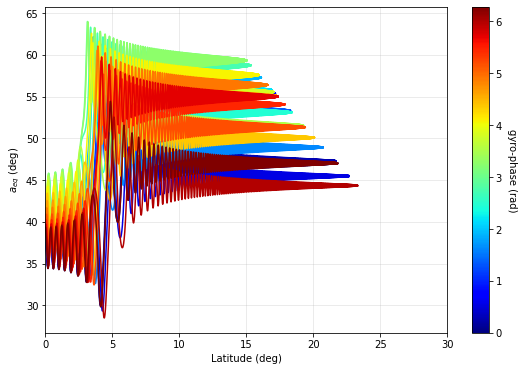

In [25]:
from matplotlib import cm

# for r in range(0,len(eta0)):
#     for i in range(0,len(aeq)-1):
#         print(r,i,np.rad2deg(lamda[r,i]),np.rad2deg(aeq[r,i]))

# for i in range(0,len(lamda[1,:])):
#     print(np.rad2deg(aeq[1,i]))
# from matplotlib import cm
# mask=np.isnan(aeq)

aeq = np.ma.array(aeq, mask=np.isnan(aeq))
print(np.max(aeq[1,-1]))
# print(np.shape(aeq[1,:]))
# dalpha=[]
# for r in range(0,len(eta0)):
#     ls=aeq[r,:].shape[1] - (~np.isnan(aeq[r,:]))[:, ::-1].argmax(1) - 1
#     print(ls)
#     ls=(~np.isnan(aeq[r,:])).cumsum(2).argmax(1)
#     dalphaf=np.rad2deg(aeq[r,ls])-aeq0_deg
#     print(eta0[r],np.rad2deg(aeq[r,-1]))
#     dalpha.append(dalphaf)
    

dalpha=[]
for r in range(0,len(eta0)):
    ls=np.max(np.nonzero(aeq[r,:]))
    dalphaf=np.rad2deg(aeq[r,ls])-aeq0_deg
    dalpha.append(dalphaf)
# # print(dalpha)
norm = cm.colors.Normalize(vmin=eta0.min(), vmax=eta0.max())
cmap = cm.ScalarMappable(norm=norm, cmap=cm.jet)
cmap.set_array([])
#################
fig, ax = plt.subplots(figsize=(9,6))
s=5


for r in range(0,len(eta0)):
    ax.plot(np.rad2deg(lamda[r,:-1]),np.rad2deg(aeq[r,:-1]),c=cmap.to_rgba(eta0[r]))
ax.grid(alpha=.3)
ax.set_xlim(0,30)
ax.set_xlabel('Latitude (deg)')
ax.set_ylabel(r'$a_{eq}$ (deg)')

# ax.set_ylim(40,65)
ticks=np.arange(0,2*np.pi,1)
cbar=fig.colorbar(cmap, ticks=ticks)
cbar.set_label('gyro-phase (rad)', rotation=270,labelpad=15)
#     ax.axvline(x=-5,color="black", linestyle="--")
plt.show()

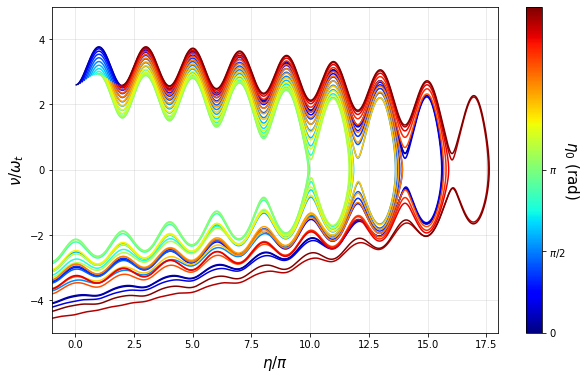

In [26]:
fonts=15
wtr=np.sqrt(wtrsq_out)

nplot=deta_dt/wtr
# print(wtr)


fig, ax = plt.subplots(figsize=(10,6))
s=5
last=1

for r in range(0,len(eta0)):
    ax.plot(eta[r,2:-last]/np.pi,nplot[r,2:-last],c=cmap.to_rgba(eta0[r]))

ax.grid(alpha=.3)
ax.set_xlim(-1,18)
ax.set_xlabel(r'$\eta/\pi$',fontsize=fonts)
ax.set_ylabel(r'$\nu/\omega_t$',fontsize=fonts)

ax.set_ylim(-5,5)

cbar=fig.colorbar(cmap, ticks=[-np.pi,-np.pi/2,0,np.pi/2,np.pi])
cbar.ax.set_yticklabels([r'$-\pi$',r'$-\pi/2$', '0',r'$\pi/2$', r'$\pi$'])  # horizontal colorbar
cbar.set_label(r'$\eta_0$ (rad)', rotation=270,labelpad=15,fontsize=fonts)
# ax.axvline(x=-5,color="black", linestyle="--")
plt.show()


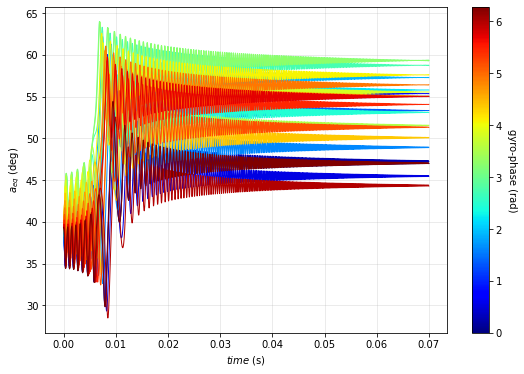

In [27]:
######################
fig, ax = plt.subplots(figsize=(9,6))
s=5


for r in range(0,len(eta0)):
    ax.plot(time[r,:-1],np.rad2deg(aeq[r,:-1]),c=cmap.to_rgba(eta0[r]), linewidth=1)
ax.grid(alpha=.3)
# ax.set_xlim(0,30)
ax.set_ylabel(r'$a_{eq}$ (deg)')
ax.set_xlabel(r'$time$ (s)')

# ax.set_ylim(40,65)
ticks=np.arange(0,2*np.pi,1)
cbar=fig.colorbar(cmap, ticks=ticks)
cbar.set_label('gyro-phase (rad)', rotation=270,labelpad=15)
#     ax.axvline(x=-5,color="black", linestyle="--")
plt.show()
#####################################################

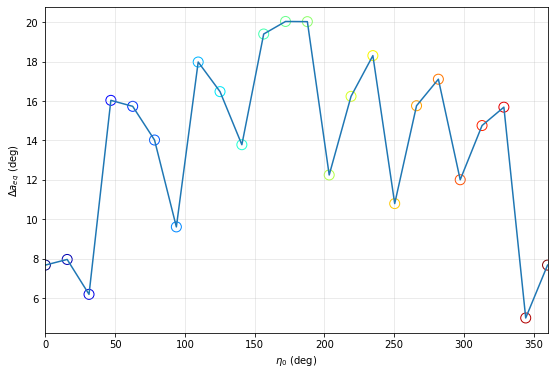

In [28]:
#####################################################
fig, ax = plt.subplots(figsize=(9,6))
s=5

colors=eta0[:]
# for r in range(0,len(eta0)):
#     ax.plot(np.rad2deg(lamda[r,:-1]),np.rad2deg(aeq[r,:-1]),c=cmap.to_rgba(eta0[r]))
ax.grid(alpha=.3)
ax.plot(np.rad2deg(eta0),dalpha)
ax.scatter(np.rad2deg(eta0),dalpha,marker='o',facecolors='none', edgecolors=cmap.to_rgba(eta0[:]),s=100)
ax.set_xlim(0,360)
ax.set_xlabel(r'$\eta_0$ (deg)')
ax.set_ylabel(r'$\Delta a_{eq}$ (deg)')

# ax.set_ylim(-10,10)
ticks=np.arange(0,2*np.pi,1)
# cbar=fig.colorbar(cmap, ticks=ticks)
# cbar.set_label('gyro-phase (rad)', rotation=270,labelpad=15)
#     ax.axvline(x=-5,color="black", linestyle="--")
plt.show()
#################

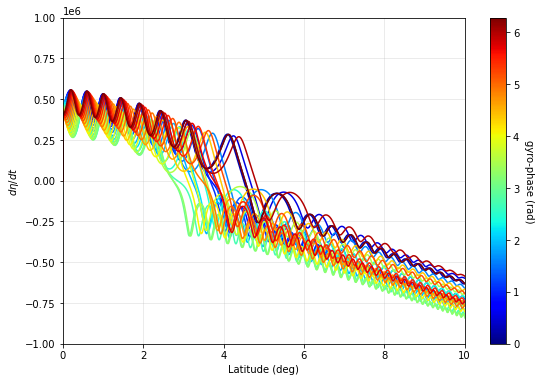

In [29]:

fig, ax = plt.subplots(figsize=(9,6))
s=5


for r in range(0,len(eta0)):
    ax.plot(np.rad2deg(lamda[r,:-1]),np.rad2deg(deta_dt[r,:-1]),c=cmap.to_rgba(eta0[r]))
ax.grid(alpha=.3)
ax.set_xlim(0,10)
ax.set_xlabel('Latitude (deg)')
ax.set_ylabel(r'$d\eta/dt$ ')

ax.set_ylim(-1*10**6,1*10**6)
ticks=np.arange(0,2*np.pi,1)
cbar=fig.colorbar(cmap, ticks=ticks)
cbar.set_label('gyro-phase (rad)', rotation=270,labelpad=15)
#     ax.axvline(x=-5,color="black", linestyle="--")
plt.show()
#####################################################

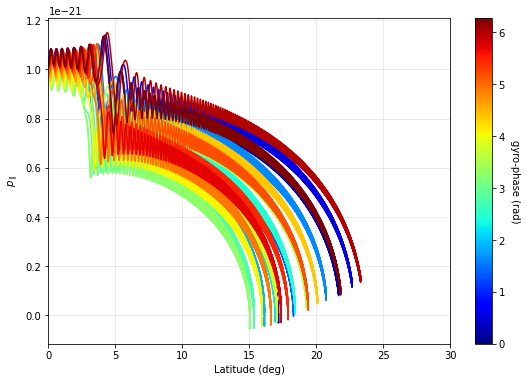

In [30]:
#################
fig, ax = plt.subplots(figsize=(9,6))
s=5


for r in range(0,len(eta0)):
    ax.plot(np.rad2deg(lamda[r,:-1]),ppar[r,:-1],c=cmap.to_rgba(eta0[r]))
ax.grid(alpha=.3)
ax.set_xlim(0,30)
ax.set_xlabel('Latitude (deg)')
ax.set_ylabel(r'$p_{\parallel}$')

# ax.set_ylim(-2,2)
ticks=np.arange(0,2*np.pi,1)
cbar=fig.colorbar(cmap, ticks=ticks)
cbar.set_label('gyro-phase (rad)', rotation=270,labelpad=15)
#     ax.axvline(x=-5,color="black", linestyle="--")
plt.show()
#####################################################

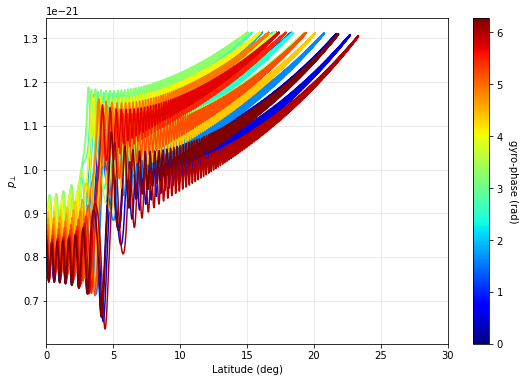

In [31]:

#################
fig, ax = plt.subplots(figsize=(9,6))
s=5


for r in range(0,len(eta0)):
    ax.plot(np.rad2deg(lamda[r,:-1]),pper[r,:-1],c=cmap.to_rgba(eta0[r]))
ax.grid(alpha=.3)
ax.set_xlim(0,30)
ax.set_xlabel('Latitude (deg)')
ax.set_ylabel(r'$p_{\perp}$')

# ax.set_ylim(-2,2)
ticks=np.arange(0,2*np.pi,1)
cbar=fig.colorbar(cmap, ticks=ticks)
cbar.set_label('gyro-phase (rad)', rotation=270,labelpad=15)
#     ax.axvline(x=-5,color="black", linestyle="--")
plt.show()

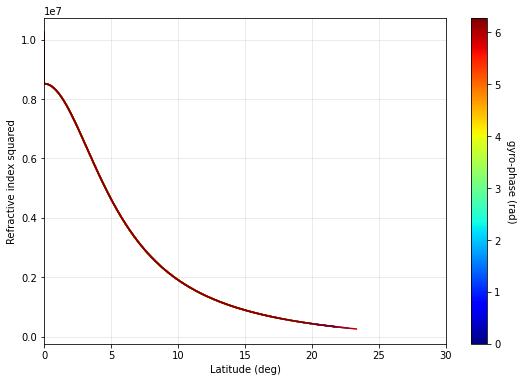

In [32]:
#################
fig, ax = plt.subplots(figsize=(9,6))
s=5


for r in range(0,len(eta0)):
    ax.plot(np.rad2deg(lamda[r,:-1]),ref_sq[r,:-1],c=cmap.to_rgba(eta0[r]))
ax.grid(alpha=.3)
ax.set_xlim(0,30)
ax.set_xlabel('Latitude (deg)')
ax.set_ylabel('Refractive index squared')

# ax.set_ylim(-2,2)
ticks=np.arange(0,2*np.pi,1)
cbar=fig.colorbar(cmap, ticks=ticks)
cbar.set_label('gyro-phase (rad)', rotation=270,labelpad=15)
#     ax.axvline(x=-5,color="black", linestyle="--")
plt.show()
#####################################################

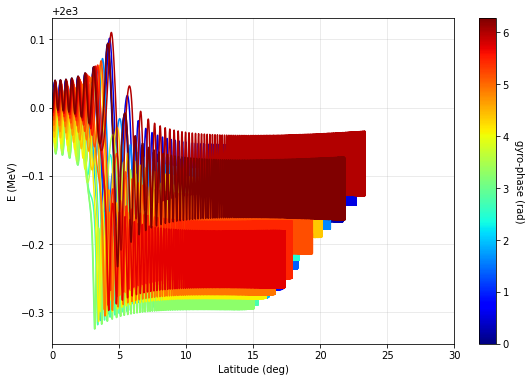

In [33]:

#################
fig, ax = plt.subplots(figsize=(9,6))
s=5


for r in range(0,len(eta0)):
    ax.plot(np.rad2deg(lamda[r,:-1]),E_kin[r,:-1]*6.2415e15,c=cmap.to_rgba(eta0[r]))
ax.grid(alpha=.3)
ax.set_xlim(0,30)
ax.set_xlabel('Latitude (deg)')
ax.set_ylabel('E (MeV)')

# ax.set_ylim(-1,2.5)
ticks=np.arange(0,2*np.pi,1)
cbar=fig.colorbar(cmap, ticks=ticks)
cbar.set_label('gyro-phase (rad)', rotation=270,labelpad=15)
#     ax.axvline(x=-5,color="black", linestyle="--")
plt.show()
#####################################################


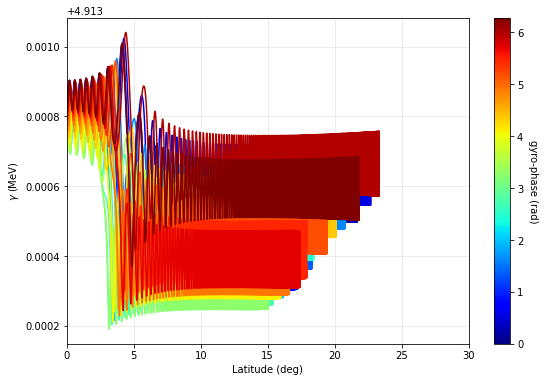

In [34]:

##############
fig, ax = plt.subplots(figsize=(9,6))
s=5


for r in range(0,len(eta0)):
    ax.plot(np.rad2deg(lamda[r,:-1]),gamma[r,:-1],c=cmap.to_rgba(eta0[r]))
ax.grid(alpha=.3)
ax.set_xlim(0,30)
ax.set_xlabel('Latitude (deg)')
ax.set_ylabel(r'$\gamma$ (MeV)')

# ax.set_ylim(-1,2.5)
ticks=np.arange(0,2*np.pi,1)
cbar=fig.colorbar(cmap, ticks=ticks)
cbar.set_label('gyro-phase (rad)', rotation=270,labelpad=15)
#     ax.axvline(x=-5,color="black", linestyle="--")
plt.show()

